# CZ4046 Assignment 1 Part 2

## Experiment 2

### Import required libraries

In [1]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt

### Define grid

In [2]:
class Grid:
    def __init__(self, width, height, start):
        self.width = width
        self.height = height
        self.i = start[0]
        self.j = start[1]
        
    def set(self, rewards, actions):  
        self.rewards = rewards
        self.actions = actions 
    
    def set_state(self, s):
        self.i = s[0]
        self.j = s[1]
        
    def current_state(self):
        return (self.i, self.j)

    def is_terminal(self, s):
        return s not in self.actions
    
    def move(self, action):
        if action in self.actions[(self.i, self.j)]:
            if action == 'U':
                self.i -= 1
            elif action == 'D':
                self.i += 1
            elif action == 'R':
                self.j += 1
            elif action == 'L':
                self.j -= 1
        
        else:
            pass
        
        return self.rewards.get((self.i, self.j), 0)
    
    def undo_move(self, action):
        if action == 'U':
            self.i += 1
        elif action == 'D':
            self.i -= 1
        elif action == 'R':
            self.j -= 1
        elif action == 'L':
            self.j += 1
            
        assert(self.current_state() in self.all_states())
    
    def end_game(self):
        return (self.i, self.j) not in self.actions
    
    def all_states(self):
        return set(list(self.actions.keys()) + list(self.rewards.keys()))
    
def stand_grid():    
    grid = Grid(7, 7, (3, 2))
    rewards = {(0,0):1, (0,2):1, (0,5):1, (0,6):1, (1,3):1, (2,4):1, (3,5):1, (6,0):1, (6,2):1, (6,5):1, (6,6):1, (1,1):-1, (1,5):-1, (2,2):-1, (3,3):-1, (4,4):-1}
    actions = {
        (0,0): ('D'),
        (0,2): ('R', 'D'),
        (0,3): ('R', 'D', 'L'),
        (0,4): ('R', 'L'),
        (0,5): ('R', 'D', 'L'),
        (0,6): ('D', 'L'),
        (1,0): ('U', 'R', 'D'),
        (1,1): ('R', 'D', 'L'),
        (1,2): ('U', 'R', 'D', 'L'),
        (1,3): ('U', 'D', 'L'),
        (1,5): ('U', 'D', 'R'),
        (1,6): ('U', 'D', 'L'),
        (2,0): ('U', 'R', 'D'),
        (2,1): ('U', 'R', 'D', 'L'),
        (2,2): ('U', 'R', 'D', 'L'),
        (2,3): ('U', 'R', 'D', 'L'),
        (2,4): ('R', 'D', 'L'),
        (2,5): ('U', 'R', 'D', 'L'),
        (2,6): ('U', 'D', 'L'),
        (3,0): ('U', 'R', 'D'),
        (3,1): ('U', 'R', 'L'),
        (3,2): ('U', 'R', 'L'),
        (3,3): ('U', 'R', 'L'),
        (3,4): ('U', 'R', 'D', 'L'),
        (3,5): ('U', 'R', 'D', 'L'),
        (3,6): ('U', 'D', 'L'),
        (4,0): ('U', 'D'),
        (4,4): ('U', 'R', 'D'),
        (4,5): ('U', 'R', 'D', 'L'),
        (4,6): ('U', 'D', 'L'),
        (5,0): ('U', 'R', 'D'),
        (5,1): ('R', 'L'),
        (5,2): ('R', 'L'),
        (5,3): ('R', 'L'),
        (5,4): ('U', 'R', 'D', 'L'),
        (5,5): ('U', 'R', 'D', 'L'),
        (5,6): ('U', 'D', 'L'),
        (6,0): ('U'),
        (6,2): ('U', 'R'),
        (6,3): ('U', 'R', 'L'),
        (6,4): ('U', 'R', 'L'),
        (6,5): ('U', 'R', 'L'),
        (6,6): ('U', 'L'),
        
    }
    grid.set(rewards, actions)
    return grid

def negative_grid(step_cost=-0.04):
    grid = stand_grid()
    grid.rewards.update({
        (0,3): step_cost,
        (0,4): step_cost,
        (1,0): step_cost,
        (1,2): step_cost,
        (1,6): step_cost,
        (2,0): step_cost,
        (2,1): step_cost,
        (2,3): step_cost,
        (2,5): step_cost,
        (2,6): step_cost,
        (3,0): step_cost,
        (3,1): step_cost,
        (3,2): step_cost,
        (3,4): step_cost,
        (3,6): step_cost,
        (4,0): step_cost,
        (4,5): step_cost,
        (4,6): step_cost,
        (5,0): step_cost,
        (5,1): step_cost,
        (5,2): step_cost,
        (5,3): step_cost,
        (5,4): step_cost,
        (5,5): step_cost,     
        (5,6): step_cost,
        (6,3): step_cost,     
        (6,4): step_cost,     
    })
    return grid

def start_game(agent, env):
    pass

### Print utility values

In [3]:
hist = []

def print_values(f, V, g):
    for i in range(g.width):
        
        if f == True:
            print("+----------+------------+------------+------------+------------+------------+------------+")
        
        for j in range(g.height):
            v = V.get((i,j), 0)
            
            if f == True:
                print(f' {v:^9.5f} |', end = ' ')
                    
            hist.append(v)
        
        if f == True:        
            print ("")
    if f == True:
        print("+----------+------------+------------+------------+------------+------------+------------+")

### Print policy

In [4]:
def print_policy(P, g):
    for i in range(g.width):
        print("+------+--------+--------+--------+--------+--------+--------+")
        
        for j in range(g.height):
            a = P.get((i,j), ' ')
            print('   {}   |'.format(a), end = ' ')

        print ("")
    print("+------+--------+--------+--------+--------+--------+--------+")

### Value Iteration

In [5]:
SMALL_ENOUGH = 10e-4
GAMMA = 0.99
ALL_POSSIBLE_ACTIONS = ('U', 'D', 'L', 'R')

In [6]:
if __name__ == '__main__':
    grid = negative_grid()

    policy = {}
    for s in grid.actions.keys():
        policy[s] = np.random.choice(ALL_POSSIBLE_ACTIONS)
    
    hist = []
    
    V = {}
    states = grid.all_states()
    
    for s in states:
        
        if s in grid.actions:
            V[s] = 0
        
        else:
            V[s] = 0

    iter_no = 0
    
    while True:
        iter_no = iter_no + 1
        print("Iteration " + str(iter_no) + " :: ")
        biggest_change = 0
        
        for s in states: 
            old_v = V[s]
            
            if s in policy: 
                new_v = float('-inf')
                
                for a in ALL_POSSIBLE_ACTIONS:
                    grid.set_state(s)
                    r = grid.rewards.get(grid.current_state(), 0)
                    _ = grid.move(a)
                    v_correct = V[grid.current_state()]
                    grid.set_state(s)
                    
                    if a == 'U':
                        r_clockwise = grid.move('R')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('L')
                    
                    elif a == 'R':
                        r_clockwise = grid.move('D')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('U')
                    
                    elif a == 'D':
                        r_clockwise = grid.move('L')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('R')
                    
                    elif a == 'L':
                        r_clockwise = grid.move('U')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('D')
                        
                    v_anticlockwise = V[grid.current_state()]  
                    v = r + GAMMA * (0.8*v_correct + 0.1*v_clockwise + 0.1*v_anticlockwise)
                    
                    if v > new_v:
                        new_v = v
                
                V[s] = new_v
                biggest_change = max(biggest_change, np.abs(old_v - V[s]))
                
                print('Utilities:')
                print_values(True, V, grid)
                print('\n')
                                
        if biggest_change < SMALL_ENOUGH:
            break
               
    for s in policy.keys():
        best_a = None
        best_value = float('-inf')
        
        for a in ALL_POSSIBLE_ACTIONS:
            
            grid.set_state(s)
            r = grid.rewards.get(grid.current_state(), 0)    
            _ = grid.move(a)
            v_correct = V[grid.current_state()]      
            grid.set_state(s)
            
            if a == 'U':
                r_clockwise = grid.move('R')
                v_clockwise = V[grid.current_state()]
                grid.set_state(s)
                r_anticlockwise = grid.move('L')
                
            elif a == 'R':
                r_clockwise = grid.move('D')
                v_clockwise = V[grid.current_state()]
                grid.set_state(s)
                r_anticlockwise = grid.move('U')
                
            elif a == 'D':
                r_clockwise = grid.move('L')
                v_clockwise = V[grid.current_state()]
                grid.set_state(s)
                r_anticlockwise = grid.move('R')
                
            elif a == 'L':
                r_clockwise = grid.move('U')
                v_clockwise = V[grid.current_state()]
                grid.set_state(s)
                r_anticlockwise = grid.move('D')
                        
            v_anticlockwise = V[grid.current_state()] 
            v = r + GAMMA * (0.8*v_correct + 0.1*v_clockwise + 0.1*v_anticlockwise)
            
            if v > best_value:
                best_value = v
                best_a = a
        
        policy[s] = best_a
        
    print('Optimal Utilities:')
    print_values(True, V, grid)
    print('\n')
    print('Optimal Policy:')
    print_policy(policy, grid)
    print('\n')

Iteration 1 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+------------+
  0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  | 
+----------+------------+------------+------------+------------+------------+------------+
  0.00000  |   0.00000  |   0.00000  |   1.00000  |   0.00000  |   0.00000  |   0.00000  | 
+----------+------------+------------+------------+------------+------------+------------+
  0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  | 
+----------+------------+------------+------------+------------+------------+------------+
  0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  | 
+----------+------------+------------+------------+------------+------------+------------+
  0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  | 
+----------+------------+------------+------------+-------

 -0.04000  |   0.00000  |   0.00000  |   0.00000  |  -1.00000  |   0.30102  |   0.00000  | 
+----------+------------+------------+------------+------------+------------+------------+
 -0.04396  |  -0.04000  |  -0.04000  |   0.00000  |   0.45503  |   0.55558  |   0.75200  | 
+----------+------------+------------+------------+------------+------------+------------+
  0.00000  |   0.00000  |   1.00000  |   0.75200  |   0.55558  |   0.00000  |   1.00000  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
  1.00000  |   0.00000  |   1.00000  |   0.85100  |   0.63399  |   0.00000  |   0.00000  | 
+----------+------------+------------+------------+------------+------------+------------+
  0.00000  |  -0.32997  |   0.85100  |   1.00000  |   0.00000  |  -1.00396  |  -0.04000  | 
+----------+------------+------------+------------+------------+--------

  0.52575  |   0.33866  |  -0.32997  |   0.71933  |   1.73149  |  -0.04000  |  -0.04792  | 
+----------+------------+------------+------------+------------+------------+------------+
  0.36737  |  -0.05115  |  -0.07267  |  -1.00000  |   0.83868  |   1.23445  |  -0.04000  | 
+----------+------------+------------+------------+------------+------------+------------+
 -0.04000  |   0.00000  |   0.00000  |   0.00000  |  -1.00000  |   0.30102  |   0.58539  | 
+----------+------------+------------+------------+------------+------------+------------+
 -0.04396  |  -0.07960  |  -0.04000  |   0.32038  |   0.45503  |   0.55558  |   2.17738  | 
+----------+------------+------------+------------+------------+------------+------------+
  1.00000  |   0.00000  |   1.96545  |   0.75200  |   0.55558  |   1.84700  |   2.63627  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

  1.99000  |   0.00000  |   1.97525  |   1.80145  |   1.51227  |   2.85524  |   2.10700  | 
+----------+------------+------------+------------+------------+------------+------------+
  0.71933  |   0.33501  |   1.68453  |   1.94746  |   0.00000  |   0.48104  |   1.52539  | 
+----------+------------+------------+------------+------------+------------+------------+
  0.52575  |   0.33866  |   0.43889  |   1.71726  |   1.73149  |   1.35416  |   1.29743  | 
+----------+------------+------------+------------+------------+------------+------------+
  0.36737  |  -0.05115  |   0.26744  |  -0.35445  |   0.83868  |   1.23445  |   0.99089  | 
+----------+------------+------------+------------+------------+------------+------------+
  0.24304  |   0.00000  |   0.00000  |   0.00000  |  -0.40496  |   1.48040  |   0.58539  | 
+----------+------------+------------+------------+------------+------------+------------+
  0.73977  |  -0.07960  |   0.20582  |   0.32038  |   1.57321  |   1.89714  |   2.177

  0.73977  |   0.53014  |   0.20582  |   1.26942  |   1.57321  |   1.89714  |   3.70226  | 
+----------+------------+------------+------------+------------+------------+------------+
  1.99000  |   0.00000  |   2.91187  |   1.62280  |   1.52288  |   3.45860  |   4.21576  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
  1.99000  |   0.00000  |   2.93829  |   2.75165  |   1.51227  |   2.85524  |   3.62096  | 
+----------+------------+------------+------------+------------+------------+------------+
  1.64046  |   0.33501  |   2.60647  |   2.89074  |   0.00000  |   0.48104  |   3.02643  | 
+----------+------------+------------+------------+------------+------------+------------+
  1.34482  |   1.08708  |   0.43889  |   1.71726  |   2.85273  |   2.49999  |   1.29743  | 
+----------+------------+------------+------------+------------+--------

  0.87163  |   0.00000  |   0.00000  |   0.00000  |   0.65513  |   2.88974  |   1.88900  | 
+----------+------------+------------+------------+------------+------------+------------+
  1.66180  |   0.53014  |   1.00613  |   2.58758  |   3.00030  |   3.38115  |   3.70226  | 
+----------+------------+------------+------------+------------+------------+------------+
  2.97010  |   0.00000  |   2.91187  |   2.55253  |   3.00572  |   5.01602  |   4.21576  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
  2.97010  |   0.00000  |   2.93829  |   2.75165  |   2.52078  |   4.34125  |   3.62096  | 
+----------+------------+------------+------------+------------+------------+------------+
  2.59403  |   1.20511  |   2.60647  |   2.89074  |   0.00000  |   1.92710  |   3.02643  | 
+----------+------------+------------+------------+------------+--------

  2.59403  |   1.20511  |   3.53927  |   3.82569  |   0.00000  |   1.92710  |   4.48672  | 
+----------+------------+------------+------------+------------+------------+------------+
  2.25523  |   1.96838  |   1.34196  |   2.66474  |   4.07183  |   3.74138  |   2.73288  | 
+----------+------------+------------+------------+------------+------------+------------+
  1.95701  |   1.03972  |   1.11932  |   1.89200  |   3.23298  |   3.69407  |   2.13951  | 
+----------+------------+------------+------------+------------+------------+------------+
  1.68254  |   0.00000  |   0.00000  |   0.00000  |   0.65513  |   2.88974  |   3.36529  | 
+----------+------------+------------+------------+------------+------------+------------+
  1.66180  |   1.38111  |   1.00613  |   2.58758  |   3.00030  |   4.87728  |   5.22046  | 
+----------+------------+------------+------------+------------+------------+------------+
  2.97010  |   0.00000  |   3.84718  |   2.55253  |   3.00572  |   5.01602  |   5.756

  3.94040  |   0.00000  |   3.84718  |   3.51584  |   4.52728  |   6.53864  |   5.75657  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
  3.94040  |   0.00000  |   3.89043  |   3.69238  |   3.89738  |   5.79811  |   5.09636  | 
+----------+------------+------------+------------+------------+------------+------------+
  3.54722  |   2.11728  |   3.53927  |   3.82569  |   0.00000  |   3.35366  |   4.48672  | 
+----------+------------+------------+------------+------------+------------+------------+
  2.25523  |   1.96838  |   2.26178  |   3.75094  |   4.07183  |   3.74138  |   4.15443  | 
+----------+------------+------------+------------+------------+------------+------------+
  1.95701  |   1.03972  |   2.04157  |   1.89200  |   3.23298  |   5.10692  |   3.48942  | 
+----------+------------+------------+------------+------------+--------

  3.54722  |   3.03408  |   4.46841  |   4.76684  |   0.00000  |   4.76091  |   5.91654  | 
+----------+------------+------------+------------+------------+------------+------------+
  3.18753  |   2.88370  |   3.19581  |   3.75094  |   5.38258  |   5.06060  |   4.15443  | 
+----------+------------+------------+------------+------------+------------+------------+
  2.86784  |   1.91482  |   3.01250  |   3.19949  |   4.59702  |   5.10692  |   4.89690  | 
+----------+------------+------------+------------+------------+------------+------------+
  2.56447  |   0.00000  |   0.00000  |   0.00000  |   3.33807  |   4.34520  |   4.85794  | 
+----------+------------+------------+------------+------------+------------+------------+
  3.56758  |   2.30341  |   2.20858  |   4.00485  |   4.46024  |   6.35484  |   6.71382  | 
+----------+------------+------------+------------+------------+------------+------------+
  3.94040  |   0.00000  |   4.77590  |   4.48706  |   6.02837  |   6.53864  |   7.265

  3.78643  |   2.82605  |   3.01250  |   3.19949  |   6.00066  |   6.53702  |   4.89690  | 
+----------+------------+------------+------------+------------+------------+------------+
  3.46662  |   0.00000  |   0.00000  |   0.00000  |   3.33807  |   5.80444  |   6.33292  | 
+----------+------------+------------+------------+------------+------------+------------+
  3.56758  |   3.24283  |   3.56914  |   5.44185  |   5.92031  |   6.35484  |   8.17918  | 
+----------+------------+------------+------------+------------+------------+------------+
  4.90100  |   0.00000  |   5.69955  |   4.48706  |   6.02837  |   8.03060  |   8.74417  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
  4.90100  |   0.00000  |   5.76305  |   5.71736  |   5.32379  |   7.22568  |   7.95602  | 
+----------+------------+------------+------------+------------+--------

  4.51582  |   3.24283  |   4.97663  |   6.86610  |   7.35937  |   7.80758  |   8.17918  | 
+----------+------------+------------+------------+------------+------------+------------+
  5.85199  |   0.00000  |   5.69955  |   5.71743  |   7.50315  |   9.49336  |   8.74417  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
  5.85199  |   0.00000  |   5.76305  |   5.71736  |   6.73685  |   8.62510  |   9.34323  | 
+----------+------------+------------+------------+------------+------------+------------+
  5.43937  |   4.03815  |   5.50669  |   5.88353  |   0.00000  |   6.14738  |   7.31823  | 
+----------+------------+------------+------------+------------+------------+------------+
  5.05231  |   3.80289  |   4.23394  |   6.34019  |   8.12636  |   6.42424  |   6.94230  | 
+----------+------------+------------+------------+------------+--------

  5.43937  |   4.03815  |   6.70461  |   7.14906  |   0.00000  |   7.51013  |   8.69294  | 
+----------+------------+------------+------------+------------+------------+------------+
  5.05231  |   4.75884  |   5.40885  |   6.34019  |   8.12636  |   7.79232  |   6.94230  | 
+----------+------------+------------+------------+------------+------------+------------+
  4.73392  |   4.01649  |   4.29322  |   5.94234  |   7.40238  |   7.95607  |   7.71891  | 
+----------+------------+------------+------------+------------+------------+------------+
  4.39565  |   0.00000  |   0.00000  |   0.00000  |   6.19827  |   7.24351  |   7.78198  | 
+----------+------------+------------+------------+------------+------------+------------+
  5.49165  |   4.54357  |   4.97663  |   6.86610  |   7.35937  |   9.23318  |   9.61646  | 
+----------+------------+------------+------------+------------+------------+------------+
  5.85199  |   0.00000  |   6.64432  |   7.14827  |   7.50315  |   9.49336  |  10.194

  6.39184  |   5.18095  |   6.70461  |   8.46368  |   0.00000  |   7.51013  |   8.69294  | 
+----------+------------+------------+------------+------------+------------+------------+
  5.99364  |   4.75884  |   5.40885  |   7.69213  |   9.49133  |   7.79232  |   8.30353  | 
+----------+------------+------------+------------+------------+------------+------------+
  4.73392  |   5.28521  |   5.62684  |   5.94234  |   8.78582  |   9.35314  |   7.71891  | 
+----------+------------+------------+------------+------------+------------+------------+
  4.39565  |   0.00000  |   0.00000  |   0.00000  |   6.19827  |   8.65673  |   9.20367  | 
+----------+------------+------------+------------+------------+------------+------------+
  5.49165  |   4.54357  |   6.38333  |   8.26721  |   8.77237  |   9.23318  |   9.61646  | 
+----------+------------+------------+------------+------------+------------+------------+
  6.79347  |   0.00000  |   6.64432  |   7.14827  |   8.95013  |  10.92770  |  11.615

  5.69886  |   5.28521  |   6.96306  |   7.30818  |   8.78582  |   9.35314  |   9.10090  | 
+----------+------------+------------+------------+------------+------------+------------+
  5.34383  |   0.00000  |   0.00000  |   0.00000  |   7.59439  |  10.04310  |   9.20367  | 
+----------+------------+------------+------------+------------+------------+------------+
  6.46971  |   5.91522  |   7.77153  |   8.26721  |  10.15849  |  10.63143  |  11.02598  | 
+----------+------------+------------+------------+------------+------------+------------+
  7.72553  |   0.00000  |   7.95116  |   8.57464  |  10.36926  |  10.92770  |  11.61599  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
  7.72553  |   0.00000  |   7.83344  |   8.24312  |   9.48655  |  11.34274  |  10.70338  | 
+----------+------------+------------+------------+------------+--------

  7.34472  |   6.39706  |   9.26860  |   9.78588  |   0.00000  |   8.84786  |  11.36345  | 
+----------+------------+------------+------------+------------+------------+------------+
  6.93896  |   6.73905  |   6.64567  |   9.03855  |  10.83566  |  10.48125  |   9.64018  | 
+----------+------------+------------+------------+------------+------------+------------+
  6.66993  |   6.56655  |   6.96306  |   7.30818  |  10.14562  |  10.72492  |   9.10090  | 
+----------+------------+------------+------------+------------+------------+------------+
  6.30066  |   0.00000  |   0.00000  |   0.00000  |   7.59439  |  10.04310  |  10.59800  | 
+----------+------------+------------+------------+------------+------------+------------+
  6.46971  |   7.28626  |   7.77153  |   9.64244  |  10.15849  |  10.63143  |  12.40820  | 
+----------+------------+------------+------------+------------+------------+------------+
  7.72553  |   0.00000  |   9.34766  |   8.57464  |  10.36926  |  12.33421  |  13.010

  6.66993  |   7.83930  |   8.28541  |   8.65366  |  11.48020  |  12.07072  |  10.45772  | 
+----------+------------+------------+------------+------------+------------+------------+
  6.30066  |   0.00000  |   0.00000  |   0.00000  |   8.96424  |  11.40276  |  11.96537  | 
+----------+------------+------------+------------+------------+------------+------------+
  7.44046  |   7.28626  |   9.13557  |  10.99137  |  11.51789  |  12.00265  |  12.40820  | 
+----------+------------+------------+------------+------------+------------+------------+
  8.64828  |   0.00000  |   9.34766  |   9.97595  |  11.76095  |  13.71347  |  13.01025  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
  8.64828  |   0.00000  |   9.09351  |   9.54984  |  10.82179  |  12.66225  |  13.34516  | 
+----------+------------+------------+------------+------------+--------

  7.25772  |   0.00000  |   0.00000  |   0.00000  |  10.30780  |  11.40276  |  11.96537  | 
+----------+------------+------------+------------+------------+------------+------------+
  8.40121  |   8.63805  |   9.13557  |  10.99137  |  11.51789  |  13.34732  |  13.76365  | 
+----------+------------+------------+------------+------------+------------+------------+
  8.64828  |   0.00000  |  10.73079  |  11.35043  |  13.12567  |  13.71347  |  14.37750  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
  9.56179  |   0.00000  |  10.38132  |  10.84820  |  12.13122  |  12.66225  |  13.34516  | 
+----------+------------+------------+------------+------------+------------+------------+
  8.29304  |   8.88678  |  10.55921  |  11.09734  |   0.00000  |  11.44943  |  12.66023  | 
+----------+------------+------------+------------+------------+--------

  8.82086  |   8.99244  |   9.15667  |  11.67401  |  13.45385  |  11.80772  |  12.24010  | 
+----------+------------+------------+------------+------------+------------+------------+
  8.75630  |   9.09662  |   9.58728  |   9.97540  |  12.78934  |  13.39064  |  11.78882  | 
+----------+------------+------------+------------+------------+------------+------------+
  7.25772  |   0.00000  |   0.00000  |   0.00000  |  10.30780  |  12.73612  |  13.30626  | 
+----------+------------+------------+------------+------------+------------+------------+
  8.40121  |   8.63805  |  10.47401  |  12.31428  |  12.85099  |  13.34732  |  15.09283  | 
+----------+------------+------------+------------+------------+------------+------------+
  9.56179  |   0.00000  |  12.08882  |  11.35043  |  13.12567  |  15.06599  |  15.71824  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

  9.62436  |   9.96575  |  10.47401  |  12.31428  |  14.15826  |  14.66593  |  15.09283  | 
+----------+------------+------------+------------+------------+------------+------------+
  9.56179  |   0.00000  |  12.08882  |  12.69834  |  14.46396  |  15.06599  |  15.71824  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 10.46617  |   0.00000  |  11.66489  |  12.12855  |  13.41547  |  13.95642  |  14.62802  | 
+----------+------------+------------+------------+------------+------------+------------+
  9.23374  |  10.14263  |  11.83407  |  12.38982  |   0.00000  |  12.71383  |  13.93225  | 
+----------+------------+------------+------------+------------+------------+------------+
  8.82086  |   8.99244  |  10.41856  |  11.67401  |  13.45385  |  13.10909  |  13.50391  | 
+----------+------------+------------+------------+------------+--------

  8.82086  |   8.99244  |  10.41856  |  12.95801  |  13.45385  |  13.10909  |  13.50391  | 
+----------+------------+------------+------------+------------+------------+------------+
  8.75630  |   9.09662  |  10.86836  |  11.27245  |  12.78934  |  14.68507  |  13.09448  | 
+----------+------------+------------+------------+------------+------------+------------+
  8.33202  |   0.00000  |   0.00000  |   0.00000  |  11.62540  |  14.04365  |  14.62116  | 
+----------+------------+------------+------------+------------+------------+------------+
  9.62436  |   9.96575  |  11.78676  |  13.61157  |  14.15826  |  14.66593  |  15.09283  | 
+----------+------------+------------+------------+------------+------------+------------+
 10.51573  |   0.00000  |  12.08882  |  12.69834  |  14.46396  |  16.39231  |  15.71824  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

  9.49543  |   0.00000  |   0.00000  |   0.00000  |  12.91751  |  14.04365  |  14.62116  | 
+----------+------------+------------+------------+------------+------------+------------+
  9.62436  |  11.26833  |  11.78676  |  13.61157  |  14.15826  |  15.96761  |  16.39626  | 
+----------+------------+------------+------------+------------+------------+------------+
 10.51573  |   0.00000  |  13.42077  |  14.02014  |  14.46396  |  16.39231  |  17.03300  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 10.46617  |   0.00000  |  12.93221  |  13.38786  |  13.41547  |  15.22575  |  15.88626  | 
+----------+------------+------------+------------+------------+------------+------------+
 10.16747  |  10.14263  |  13.09117  |  13.66091  |   0.00000  |  13.95397  |  15.17988  | 
+----------+------------+------------+------------+------------+--------

  9.95668  |  10.35855  |  12.12641  |  12.54496  |  14.07342  |  15.95987  |  14.37496  | 
+----------+------------+------------+------------+------------+------------+------------+
  9.49543  |   0.00000  |   0.00000  |   0.00000  |  12.91751  |  15.33267  |  14.62116  | 
+----------+------------+------------+------------+------------+------------+------------+
 10.86563  |  11.26833  |  13.07414  |  13.61157  |  15.44703  |  15.96761  |  16.39626  | 
+----------+------------+------------+------------+------------+------------+------------+
 11.68769  |   0.00000  |  13.42077  |  14.02014  |  15.77631  |  17.69377  |  17.03300  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 11.36151  |   0.00000  |  12.93221  |  13.38786  |  14.67506  |  16.47071  |  15.88626  | 
+----------+------------+------------+------------+------------+--------

 10.72668  |  11.47459  |  12.89025  |  14.21800  |  15.97864  |  15.64171  |  14.74351  | 
+----------+------------+------------+------------+------------+------------+------------+
 11.15195  |  11.60348  |  12.12641  |  13.79644  |  15.33700  |  15.95987  |  15.63504  | 
+----------+------------+------------+------------+------------+------------+------------+
 10.67244  |   0.00000  |   0.00000  |   0.00000  |  14.19110  |  15.33267  |  15.91127  | 
+----------+------------+------------+------------+------------+------------+------------+
 10.86563  |  12.54585  |  13.07414  |  14.88914  |  15.44703  |  17.25263  |  17.67581  | 
+----------+------------+------------+------------+------------+------------+------------+
 11.68769  |   0.00000  |  14.72694  |  15.31685  |  15.77631  |  17.69377  |  18.32296  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 12.22152  |  12.60990  |  14.32661  |  16.13623  |   0.00000  |  15.17076  |  16.40357  | 
+----------+------------+------------+------------+------------+------------+------------+
 11.83737  |  11.47459  |  12.89025  |  15.45693  |  17.21209  |  15.64171  |  15.95976  | 
+----------+------------+------------+------------+------------+------------+------------+
 11.15195  |  12.82856  |  13.36343  |  13.79644  |  16.58249  |  17.21677  |  15.63504  | 
+----------+------------+------------+------------+------------+------------+------------+
 10.67244  |   0.00000  |   0.00000  |   0.00000  |  14.19110  |  16.60421  |  17.17827  | 
+----------+------------+------------+------------+------------+------------+------------+
 12.10997  |  12.54585  |  14.34088  |  16.14902  |  16.71839  |  17.25263  |  17.67581  | 
+----------+------------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 13.34233  |  13.80206  |  14.34088  |  16.14902  |  16.71839  |  18.51486  |  18.93263  | 
+----------+------------+------------+------------+------------+------------+------------+
 12.90526  |   0.00000  |  16.00866  |  16.59027  |  17.06458  |  18.97148  |  19.58929  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 12.24790  |   0.00000  |  15.40480  |  15.84010  |  17.12219  |  17.69182  |  18.33079  | 
+----------+------------+------------+------------+------------+------------+------------+
 12.22152  |  13.81299  |  15.54110  |  16.13623  |   0.00000  |  16.36483  |  17.60384  | 
+----------+------------+------------+------------+------------+------------+------------+
 11.83737  |  12.68748  |  14.10344  |  15.45693  |  17.21209  |  16.8797

 12.34869  |  14.03544  |  14.58251  |  15.02941  |  16.58249  |  18.45256  |  16.87635  | 
+----------+------------+------------+------------+------------+------------+------------+
 11.85331  |   0.00000  |   0.00000  |   0.00000  |  15.44732  |  17.85371  |  18.42281  | 
+----------+------------+------------+------------+------------+------------+------------+
 13.34233  |  13.80206  |  15.58952  |  17.38794  |  17.96772  |  18.51486  |  18.93263  | 
+----------+------------+------------+------------+------------+------------+------------+
 14.12236  |   0.00000  |  16.00866  |  16.59027  |  18.32993  |  20.22587  |  19.58929  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 13.12542  |   0.00000  |  15.40480  |  15.84010  |  17.12219  |  18.88959  |  19.51809  | 
+----------+------------+------------+------------+------------+--------

 14.55915  |  15.03970  |  15.58952  |  17.38794  |  17.96772  |  19.75419  |  20.16669  | 
+----------+------------+------------+------------+------------+------------+------------+
 14.12236  |   0.00000  |  17.26771  |  17.84114  |  18.32993  |  20.22587  |  20.83256  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 13.12542  |   0.00000  |  16.60901  |  17.03626  |  18.31075  |  18.88959  |  19.51809  | 
+----------+------------+------------+------------+------------+------------+------------+
 13.37121  |  14.99832  |  16.73741  |  17.34454  |   0.00000  |  17.53638  |  18.78122  | 
+----------+------------+------------+------------+------------+------------+------------+
 12.97796  |  13.88692  |  15.30915  |  16.67738  |  18.42586  |  18.09677  |  17.15335  | 
+----------+------------+------------+------------+------------+--------

 13.53436  |  15.22483  |  15.78348  |  16.24268  |  19.01147  |  19.66642  |  18.09647  | 
+----------+------------+------------+------------+------------+------------+------------+
 13.02617  |   0.00000  |   0.00000  |   0.00000  |  16.68190  |  19.08069  |  19.64486  | 
+----------+------------+------------+------------+------------+------------+------------+
 14.55915  |  15.03970  |  16.81797  |  18.60485  |  19.19449  |  19.75419  |  20.16669  | 
+----------+------------+------------+------------+------------+------------+------------+
 15.32707  |   0.00000  |  17.26771  |  17.84114  |  19.57235  |  21.45741  |  22.05319  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 14.18883  |   0.00000  |  16.60901  |  17.03626  |  18.31075  |  20.06450  |  20.68271  | 
+----------+------------+------------+------------+------------+--------

 14.70612  |  15.22483  |  15.78348  |  17.43507  |  19.01147  |  19.66642  |  19.29477  | 
+----------+------------+------------+------------+------------+------------+------------+
 14.18643  |   0.00000  |   0.00000  |   0.00000  |  17.89429  |  19.08069  |  19.64486  | 
+----------+------------+------------+------------+------------+------------+------------+
 15.75793  |  16.25769  |  16.81797  |  18.60485  |  19.19449  |  20.97098  |  21.37830  | 
+----------+------------+------------+------------+------------+------------+------------+
 15.32707  |   0.00000  |  18.50467  |  19.06946  |  19.57235  |  21.45741  |  22.05319  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 14.18883  |   0.00000  |  17.79402  |  18.21315  |  19.47661  |  20.06450  |  20.68271  | 
+----------+------------+------------+------------+------------+--------

 15.67892  |  16.16692  |  17.91600  |  19.70316  |   0.00000  |  18.68574  |  19.93615  | 
+----------+------------+------------+------------+------------+------------+------------+
 15.26879  |  15.07694  |  16.49595  |  19.05887  |  20.79008  |  19.29217  |  19.47348  | 
+----------+------------+------------+------------+------------+------------+------------+
 14.70612  |  16.39555  |  16.96424  |  17.43507  |  20.19359  |  20.85835  |  19.29477  | 
+----------+------------+------------+------------+------------+------------+------------+
 14.18643  |   0.00000  |   0.00000  |   0.00000  |  17.89429  |  20.28539  |  20.84471  | 
+----------+------------+------------+------------+------------+------------+------------+
 15.75793  |  16.25769  |  18.02500  |  19.79975  |  20.39897  |  20.97098  |  21.37830  | 
+----------+------------+------------+------------+------------+------------+------------+
 16.51504  |   0.00000  |  18.50467  |  19.06946  |  20.79219  |  22.66654  |  22.053

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 15.31571  |   0.00000  |  18.96011  |  19.37014  |  20.62022  |  21.21698  |  21.82512  | 
+----------+------------+------------+------------+------------+------------+------------+
 15.67892  |  17.31657  |  19.07505  |  19.70316  |   0.00000  |  19.81330  |  21.06906  | 
+----------+------------+------------+------------+------------+------------+------------+
 15.26879  |  16.24848  |  17.66252  |  19.05887  |  20.79008  |  20.46590  |  19.47348  | 
+----------+------------+------------+------------+------------+------------+------------+
 15.86135  |  16.39555  |  16.96424  |  18.60622  |  20.19359  |  20.85835  |  20.47131  | 
+----------+------------+------------+------------+------------+------------+------------+
 15.33110  |   0.00000  |   0.00000  |   0.00000  |  19.08469  |  20.28539  |  20.84471  | 
+----------+------------+------------+------------+------------+----------

 15.33110  |   0.00000  |   0.00000  |   0.00000  |  19.08469  |  21.46818  |  22.02272  | 
+----------+------------+------------+------------+------------+------------+------------+
 16.93699  |  17.45482  |  19.21035  |  20.97293  |  21.58154  |  22.16562  |  23.73577  | 
+----------+------------+------------+------------+------------+------------+------------+
 17.68407  |   0.00000  |  20.91222  |  20.27546  |  21.98982  |  23.85366  |  24.42823  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 16.45022  |   0.00000  |  20.10663  |  19.37014  |  20.62022  |  22.34749  |  22.94574  | 
+----------+------------+------------+------------+------------+------------+------------+
 16.81490  |  17.31657  |  19.07505  |  20.85199  |   0.00000  |  19.81330  |  22.18038  | 
+----------+------------+------------+------------+------------+--------

 16.81490  |  18.44638  |  20.21392  |  20.85199  |   0.00000  |  20.91947  |  22.18038  | 
+----------+------------+------------+------------+------------+------------+------------+
 16.39761  |  17.40012  |  18.80842  |  20.21837  |  21.94033  |  21.61823  |  20.60070  | 
+----------+------------+------------+------------+------------+------------+------------+
 16.99766  |  17.54611  |  18.12418  |  19.75622  |  21.35427  |  22.02862  |  21.62639  | 
+----------+------------+------------+------------+------------+------------+------------+
 16.45770  |   0.00000  |   0.00000  |   0.00000  |  20.25344  |  21.46818  |  22.02272  | 
+----------+------------+------------+------------+------------+------------+------------+
 18.09551  |  18.63065  |  19.21035  |  20.97293  |  21.58154  |  23.33852  |  23.73577  | 
+----------+------------+------------+------------+------------+------------+------------+
 17.68407  |   0.00000  |  20.91222  |  21.45953  |  23.16567  |  23.85366  |  24.428

 18.09551  |  18.63065  |  20.37421  |  22.12478  |  22.74260  |  23.33852  |  23.73577  | 
+----------+------------+------------+------------+------------+------------+------------+
 18.83309  |   0.00000  |  20.91222  |  21.45953  |  23.16567  |  25.01918  |  24.42823  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 17.57454  |   0.00000  |  20.10663  |  20.50673  |  21.74202  |  23.45645  |  24.04500  | 
+----------+------------+------------+------------+------------+------------+------------+
 17.93278  |  18.44638  |  20.21392  |  20.85199  |   0.00000  |  20.91947  |  22.18038  | 
+----------+------------+------------+------------+------------+------------+------------+
 16.39761  |  17.40012  |  18.80842  |  21.35695  |  21.94033  |  21.61823  |  21.70653  | 
+----------+------------+------------+------------+------------+--------

 17.93278  |  18.44638  |  21.33245  |  21.98023  |   0.00000  |  22.00464  |  23.27052  | 
+----------+------------+------------+------------+------------+------------+------------+
 17.50873  |  18.53140  |  19.93368  |  21.35695  |  23.06967  |  22.74951  |  21.70653  | 
+----------+------------+------------+------------+------------+------------+------------+
 18.11420  |  18.67617  |  19.26325  |  20.88533  |  22.49385  |  23.17761  |  22.76036  | 
+----------+------------+------------+------------+------------+------------+------------+
 17.56508  |   0.00000  |   0.00000  |   0.00000  |  21.40093  |  22.62945  |  23.17930  | 
+----------+------------+------------+------------+------------+------------+------------+
 18.09551  |  19.78525  |  20.37421  |  22.12478  |  22.74260  |  24.49007  |  24.88243  | 
+----------+------------+------------+------------+------------+------------+------------+
 18.83309  |   0.00000  |  22.08331  |  22.62206  |  23.16567  |  25.01918  |  25.583


Iteration 20 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 18.68252  |   0.00000  |  21.23307  |  21.62288  |  22.84243  |  24.54429  |  25.12331  | 
+----------+------------+------------+------------+------------+------------+------------+
 19.03137  |  19.55610  |  21.33245  |  23.08805  |   0.00000  |  22.00464  |  23.27052  | 
+----------+------------+------------+------------+------------+------------+------------+
 18.60081  |  18.53140  |  19.93368  |  22.47487  |  24.17846  |  22.74951  |  22.79140  | 
+----------+------------+------------+------------+------------+------------+------------+
 18.11420  |  19.78584  |  20.38168  |  20.88533  |  23.61268  |  24.30567  |  22.76036  | 
+----------+------------+------------+------------+------------+------------+------------+
 17.56508  |   0.00000  |   0.00000  |   0.00000  |  21.40093  |  23.76958  |  24.31482  | 
+----------+------------+------------+------------+-----

+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 18.68252  |   0.00000  |  22.33930  |  22.71873  |  23.92187  |  24.54429  |  25.12331  | 
+----------+------------+------------+------------+------------+------------+------------+
 19.03137  |  20.64581  |  22.43076  |  23.08805  |   0.00000  |  23.06924  |  24.33990  | 
+----------+------------+------------+------------+------------+------------+------------+
 18.60081  |  19.64233  |  21.03853  |  22.47487  |  24.17846  |  23.86011  |  22.79140  | 
+----------+------------+------------+------------+------------+------------+------------+
 19.21081  |  19.78584  |  20.38168  |  21.99390  |  23.61268  |  24.30567  |  23.87688  | 
+----------+------------+------------+------------+------------+------------+------------+
 18.67068  |   0.00000  |   0.00000  |   0.00000  |  22.52753  |  23.7695

 19.21081  |  20.87537  |  21.47977  |  21.99390  |  24.71141  |  25.41353  |  23.87688  | 
+----------+------------+------------+------------+------------+------------+------------+
 18.67068  |   0.00000  |   0.00000  |   0.00000  |  22.52753  |  24.88896  |  25.42969  | 
+----------+------------+------------+------------+------------+------------+------------+
 20.35236  |  20.91888  |  22.63883  |  24.36597  |  25.00170  |  25.62067  |  26.00822  | 
+----------+------------+------------+------------+------------+------------+------------+
 21.07150  |   0.00000  |  23.23309  |  23.76342  |  25.45355  |  27.28698  |  26.71761  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 19.77198  |   0.00000  |  22.33930  |  22.71873  |  23.92187  |  25.61140  |  26.18109  | 
+----------+------------+------------+------------+------------+--------

 21.07150  |   0.00000  |  24.36195  |  24.88402  |  25.45355  |  27.28698  |  27.83114  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 19.77198  |   0.00000  |  23.42547  |  23.79458  |  23.92187  |  25.61140  |  26.18109  | 
+----------+------------+------------+------------+------------+------------+------------+
 20.11039  |  20.64581  |  23.50913  |  24.17574  |   0.00000  |  24.11368  |  25.38893  | 
+----------+------------+------------+------------+------------+------------+------------+
 19.67350  |  20.73311  |  21.03853  |  23.57245  |  25.26726  |  24.95069  |  23.85570  | 
+----------+------------+------------+------------+------------+------------+------------+
 20.28937  |  20.87537  |  21.47977  |  23.08250  |  24.71141  |  25.41353  |  24.98006  | 
+----------+------------+------------+------------+------------+--------

 19.67350  |  20.73311  |  22.12328  |  24.65023  |  25.26726  |  24.95069  |  24.89986  | 
+----------+------------+------------+------------+------------+------------+------------+
 20.28937  |  21.94521  |  22.55804  |  23.08250  |  24.71141  |  26.50194  |  24.98006  | 
+----------+------------+------------+------------+------------+------------+------------+
 19.77587  |   0.00000  |   0.00000  |   0.00000  |  23.63366  |  25.98798  |  26.52426  | 
+----------+------------+------------+------------+------------+------------+------------+
 21.45315  |  22.03189  |  23.74033  |  25.45606  |  26.10051  |  26.73069  |  27.11353  | 
+----------+------------+------------+------------+------------+------------+------------+
 22.16305  |   0.00000  |  24.36195  |  24.88402  |  26.56635  |  28.39001  |  27.83114  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 20.84228  |   0.00000  |  24.49183  |  24.85087  |  24.98076  |  26.65820  |  27.21873  | 
+----------+------------+------------+------------+------------+------------+------------+
 21.16993  |  21.71574  |  23.50913  |  25.24379  |   0.00000  |  24.11368  |  26.41799  | 
+----------+------------+------------+------------+------------+------------+------------+
 20.72684  |  21.80407  |  22.12328  |  24.65023  |  26.33674  |  26.02196  |  24.89986  | 
+----------+------------+------------+------------+------------+------------+------------+
 21.35037  |  21.94521  |  22.55804  |  23.08250  |  25.79072  |  26.50194  |  24.98006  | 
+----------+------------+------------+------------+------------+------------+------------+
 20.86652  |   0.00000  |   0.00000  |   0.00000  |  23.63366  |  25.98798  |  26.52426  | 
+----------+------------+------------+------------+------------+------------+--------

 20.86652  |   0.00000  |   0.00000  |   0.00000  |  24.71971  |  27.06700  |  26.52426  | 
+----------+------------+------------+------------+------------+------------+------------+
 22.53466  |  23.12466  |  24.82179  |  26.52633  |  27.17933  |  27.82051  |  28.19871  | 
+----------+------------+------------+------------+------------+------------+------------+
 23.23573  |   0.00000  |  25.47027  |  25.98422  |  27.65891  |  29.47298  |  28.92441  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 21.89335  |   0.00000  |  24.49183  |  24.85087  |  26.01949  |  27.68510  |  27.21873  | 
+----------+------------+------------+------------+------------+------------+------------+
 22.21031  |  22.76630  |  24.56798  |  25.24379  |   0.00000  |  25.13838  |  26.41799  | 
+----------+------------+------------+------------+------------+--------

 21.76112  |  22.85572  |  23.18846  |  25.70886  |  27.38700  |  27.07379  |  25.92431  | 
+----------+------------+------------+------------+------------+------------+------------+
 22.39292  |  22.99594  |  23.61712  |  24.15179  |  26.85056  |  27.57068  |  26.06393  | 
+----------+------------+------------+------------+------------+------------+------------+
 20.86652  |   0.00000  |   0.00000  |   0.00000  |  24.71971  |  27.06700  |  27.59892  | 
+----------+------------+------------+------------+------------+------------+------------+
 22.53466  |  24.19754  |  24.82179  |  26.52633  |  27.17933  |  27.82051  |  29.26415  | 
+----------+------------+------------+------------+------------+------------+------------+
 23.23573  |   0.00000  |  26.55842  |  25.98422  |  27.65891  |  29.47298  |  29.99779  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 22.21031  |  23.79802  |  25.60788  |  26.29278  |   0.00000  |  26.14370  |  27.42749  | 
+----------+------------+------------+------------+------------+------------+------------+
 21.76112  |  22.85572  |  24.23470  |  25.70886  |  27.38700  |  27.07379  |  26.92939  | 
+----------+------------+------------+------------+------------+------------+------------+
 22.39292  |  22.99594  |  24.65720  |  25.20185  |  26.85056  |  27.57068  |  27.12817  | 
+----------+------------+------------+------------+------------+------------+------------+
 21.93902  |   0.00000  |   0.00000  |   0.00000  |  25.78602  |  27.06700  |  27.59892  | 
+----------+------------+------------+------------+------------+------------+------------+
 23.59675  |  24.19754  |  24.82179  |  26.52633  |  28.23852  |  28.89050  |  29.26415  | 
+----------+------------+------------+------------+------------+------------+------------+
 23.23573  |   0.00000  |  26.55842  |  27.06440  |  28.73158  |  29.47298  |  29.997

 21.93902  |   0.00000  |   0.00000  |   0.00000  |  25.78602  |  28.12639  |  28.65401  | 
+----------+------------+------------+------------+------------+------------+------------+
 23.59675  |  24.19754  |  25.88357  |  27.57712  |  28.23852  |  28.89050  |  29.26415  | 
+----------+------------+------------+------------+------------+------------+------------+
 24.28930  |   0.00000  |  26.55842  |  27.06440  |  28.73158  |  30.53623  |  29.99779  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 22.92545  |   0.00000  |  25.53881  |  25.88816  |  27.03845  |  28.69246  |  29.23518  | 
+----------+------------+------------+------------+------------+------------+------------+
 23.23201  |  23.79802  |  25.60788  |  27.32296  |   0.00000  |  26.14370  |  27.42749  | 
+----------+------------+------------+------------+------------+--------

 24.28930  |   0.00000  |  27.62676  |  27.06440  |  28.73158  |  30.53623  |  31.05163  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 22.92545  |   0.00000  |  26.56694  |  26.90671  |  27.03845  |  28.69246  |  29.23518  | 
+----------+------------+------------+------------+------------+------------+------------+
 23.23201  |  23.79802  |  26.62914  |  27.32296  |   0.00000  |  26.14370  |  28.41781  | 
+----------+------------+------------+------------+------------+------------+------------+
 22.77682  |  23.88864  |  24.23470  |  26.74847  |  28.41821  |  28.10645  |  26.92939  | 
+----------+------------+------------+------------+------------+------------+------------+
 23.41690  |  24.02781  |  24.65720  |  26.23288  |  27.89116  |  28.61999  |  27.12817  | 
+----------+------------+------------+------------+------------+--------

 25.32386  |   0.00000  |  27.62676  |  28.12493  |  29.78474  |  31.58014  |  31.05163  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 23.93899  |   0.00000  |  26.56694  |  26.90671  |  28.03804  |  29.68068  |  29.23518  | 
+----------+------------+------------+------------+------------+------------+------------+
 24.23538  |  24.81126  |  26.62914  |  27.32296  |   0.00000  |  27.13000  |  28.41781  | 
+----------+------------+------------+------------+------------+------------+------------+
 22.77682  |  23.88864  |  25.26214  |  27.76925  |  28.41821  |  28.10645  |  27.91545  | 
+----------+------------+------------+------------+------------+------------+------------+
 23.41690  |  25.04107  |  25.67846  |  26.23288  |  27.89116  |  29.65022  |  28.17305  | 
+----------+------------+------------+------------+------------+--------

 24.02710  |   0.00000  |   0.00000  |   0.00000  |  27.86080  |  29.16650  |  29.68991  | 
+----------+------------+------------+------------+------------+------------+------------+
 24.63962  |  26.28509  |  26.92603  |  28.60879  |  29.27844  |  30.97242  |  31.33721  | 
+----------+------------+------------+------------+------------+------------+------------+
 25.32386  |   0.00000  |  28.67567  |  29.16615  |  29.78474  |  31.58014  |  32.08629  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 23.93899  |   0.00000  |  27.57653  |  27.90677  |  29.01864  |  29.68068  |  30.21475  | 
+----------+------------+------------+------------+------------+------------+------------+
 24.23538  |  24.81126  |  27.63195  |  28.33450  |   0.00000  |  28.10251  |  29.38931  | 
+----------+------------+------------+------------+------------+--------

 24.93434  |   0.00000  |  27.57653  |  27.90677  |  29.01864  |  30.65062  |  30.21475  | 
+----------+------------+------------+------------+------------+------------+------------+
 25.22068  |  25.80622  |  27.63195  |  28.33450  |   0.00000  |  28.10251  |  29.38931  | 
+----------+------------+------------+------------+------------+------------+------------+
 23.77430  |  24.90299  |  26.27097  |  28.77147  |  29.43066  |  29.12024  |  28.88287  | 
+----------+------------+------------+------------+------------+------------+------------+
 24.42244  |  25.04107  |  26.68118  |  27.24518  |  28.91284  |  30.66170  |  29.19891  | 
+----------+------------+------------+------------+------------+------------+------------+
 24.02710  |   0.00000  |   0.00000  |   0.00000  |  27.86080  |  30.18768  |  29.68991  | 
+----------+------------+------------+------------+------------+------------+------------+
 25.66354  |  26.28509  |  27.94952  |  28.60879  |  30.29943  |  30.97242  |  31.337

 25.40979  |  26.03595  |  26.68118  |  28.23906  |  29.91592  |  30.66170  |  29.19891  | 
+----------+------------+------------+------------+------------+------------+------------+
 25.04289  |   0.00000  |   0.00000  |   0.00000  |  27.86080  |  30.18768  |  30.70695  | 
+----------+------------+------------+------------+------------+------------+------------+
 25.66354  |  27.30047  |  27.94952  |  29.62169  |  30.29943  |  31.98505  |  32.34553  | 
+----------+------------+------------+------------+------------+------------+------------+
 26.33965  |   0.00000  |  29.70548  |  29.16615  |  30.81872  |  32.60504  |  33.10212  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 24.93434  |   0.00000  |  28.56780  |  28.88858  |  29.01864  |  30.65062  |  31.17609  | 
+----------+------------+------------+------------+------------+--------

 26.18814  |  26.78314  |  28.61657  |  29.32769  |   0.00000  |  29.06141  |  30.34316  | 
+----------+------------+------------+------------+------------+------------+------------+
 25.71563  |  25.89899  |  27.26148  |  29.75546  |  31.40062  |  30.11552  |  29.83262  | 
+----------+------------+------------+------------+------------+------------+------------+
 25.40979  |  27.01276  |  27.66566  |  28.23906  |  30.90075  |  31.65478  |  30.20611  | 
+----------+------------+------------+------------+------------+------------+------------+
 25.04289  |   0.00000  |   0.00000  |   0.00000  |  28.86996  |  31.19027  |  31.70549  | 
+----------+------------+------------+------------+------------+------------+------------+
 26.66884  |  27.30047  |  28.95438  |  30.61615  |  31.30184  |  31.98505  |  32.34553  | 
+----------+------------+------------+------------+------------+------------+------------+
 27.33697  |   0.00000  |  29.70548  |  30.18842  |  31.83389  |  33.61130  |  33.102

 26.18814  |  27.74229  |  29.58327  |  30.30281  |   0.00000  |  30.00334  |  31.28005  | 
+----------+------------+------------+------------+------------+------------+------------+
 25.71563  |  26.87689  |  28.23397  |  29.75546  |  31.40062  |  31.09267  |  29.83262  | 
+----------+------------+------------+------------+------------+------------+------------+
 26.37920  |  27.01276  |  28.63223  |  29.21485  |  30.90075  |  31.65478  |  31.19497  | 
+----------+------------+------------+------------+------------+------------+------------+
 26.04021  |   0.00000  |   0.00000  |   0.00000  |  29.86075  |  31.19027  |  31.70549  | 
+----------+------------+------------+------------+------------+------------+------------+
 27.65585  |  28.29736  |  28.95438  |  30.61615  |  31.30184  |  32.97925  |  33.33551  | 
+----------+------------+------------+------------+------------+------------+------------+
 27.33697  |   0.00000  |  30.71656  |  31.19210  |  32.83059  |  33.61130  |  34.099

 27.13803  |  27.74229  |  29.58327  |  31.26018  |   0.00000  |  30.00334  |  31.28005  | 
+----------+------------+------------+------------+------------+------------+------------+
 26.65998  |  26.87689  |  28.23397  |  30.72154  |  32.35879  |  31.09267  |  30.77042  | 
+----------+------------+------------+------------+------------+------------+------------+
 27.33098  |  27.97180  |  28.63223  |  29.21485  |  31.86766  |  32.62978  |  31.19497  | 
+----------+------------+------------+------------+------------+------------+------------+
 26.04021  |   0.00000  |   0.00000  |   0.00000  |  29.86075  |  32.17462  |  32.68585  | 
+----------+------------+------------+------------+------------+------------+------------+
 27.65585  |  28.29736  |  29.94096  |  31.59251  |  32.28601  |  32.97925  |  34.30746  | 
+----------+------------+------------+------------+------------+------------+------------+
 28.31616  |   0.00000  |  30.71656  |  31.19210  |  32.83059  |  34.59924  |  35.078

 28.31616  |   0.00000  |  31.70923  |  32.17750  |  33.80914  |  34.59924  |  35.07866  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 27.81388  |   0.00000  |  30.49648  |  30.79887  |  31.85342  |  32.53802  |  33.04671  | 
+----------+------------+------------+------------+------------+------------+------------+
 27.13803  |  28.68399  |  30.53238  |  31.26018  |   0.00000  |  30.92825  |  32.20005  | 
+----------+------------+------------+------------+------------+------------+------------+
 26.65998  |  27.83700  |  29.18876  |  30.72154  |  32.35879  |  32.05258  |  31.71786  | 
+----------+------------+------------+------------+------------+------------+------------+
 27.33098  |  27.97180  |  29.58121  |  30.17289  |  31.86766  |  32.62978  |  32.16584  | 
+----------+------------+------------+------------+------------+--------

 27.01940  |   0.00000  |   0.00000  |   0.00000  |  30.83351  |  33.14106  |  33.64837  | 
+----------+------------+------------+------------+------------+------------+------------+
 28.62490  |  29.27612  |  30.90958  |  32.55111  |  33.25226  |  33.95535  |  35.26173  | 
+----------+------------+------------+------------+------------+------------+------------+
 29.27752  |   0.00000  |  32.68384  |  32.17750  |  33.80914  |  35.56921  |  36.04004  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 27.81388  |   0.00000  |  31.43456  |  30.79887  |  31.85342  |  33.45616  |  33.95671  | 
+----------+------------+------------+------------+------------+------------+------------+
 28.07064  |  28.68399  |  30.53238  |  32.20013  |   0.00000  |  30.92825  |  33.10341  | 
+----------+------------+------------+------------+------------+--------

 27.58714  |  28.77964  |  30.12617  |  31.67004  |  33.29958  |  32.99766  |  32.65017  | 
+----------+------------+------------+------------+------------+------------+------------+
 28.26545  |  28.91339  |  30.51291  |  31.11349  |  32.81697  |  33.58703  |  33.11905  | 
+----------+------------+------------+------------+------------+------------+------------+
 27.98076  |   0.00000  |   0.00000  |   0.00000  |  31.78857  |  34.08990  |  33.64837  | 
+----------+------------+------------+------------+------------+------------+------------+
 29.57632  |  30.23706  |  31.86058  |  32.55111  |  34.20093  |  34.91370  |  35.26173  | 
+----------+------------+------------+------------+------------+------------+------------+
 29.27752  |   0.00000  |  32.68384  |  33.14497  |  34.76989  |  35.56921  |  36.04004  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 29.18291  |  29.83784  |  30.51291  |  31.11349  |  33.74901  |  34.52687  |  33.11905  | 
+----------+------------+------------+------------+------------+------------+------------+
 27.98076  |   0.00000  |   0.00000  |   0.00000  |  31.78857  |  34.08990  |  34.59338  | 
+----------+------------+------------+------------+------------+------------+------------+
 29.57632  |  30.23706  |  31.86058  |  33.49226  |  34.20093  |  34.91370  |  36.19863  | 
+----------+------------+------------+------------+------------+------------+------------+
 30.22140  |   0.00000  |  33.64072  |  33.14497  |  34.76989  |  36.52152  |  36.98392  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 28.73909  |   0.00000  |  32.35557  |  31.72802  |  32.76425  |  34.35767  |  34.85023  | 
+----------+------------+------------+------------+------------+--------

 30.51042  |  31.18051  |  32.79426  |  33.49226  |  35.13234  |  35.85460  |  36.19863  | 
+----------+------------+------------+------------+------------+------------+------------+
 31.14809  |   0.00000  |  33.64072  |  34.09484  |  35.71315  |  36.52152  |  36.98392  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 29.64747  |   0.00000  |  32.35557  |  32.64029  |  33.65860  |  35.24288  |  34.85023  | 
+----------+------------+------------+------------+------------+------------+------------+
 28.98628  |  30.51631  |  32.37912  |  33.12301  |   0.00000  |  32.72814  |  33.99042  | 
+----------+------------+------------+------------+------------+------------+------------+
 28.49744  |  29.70512  |  31.04655  |  33.51586  |  34.22351  |  33.92578  |  33.56570  | 
+----------+------------+------------+------------+------------+--------

 30.08368  |  30.74547  |  31.42767  |  32.03698  |  34.66411  |  35.44960  |  34.05490  | 
+----------+------------+------------+------------+------------+------------+------------+
 29.85133  |   0.00000  |   0.00000  |   0.00000  |  32.72625  |  35.02148  |  35.52118  | 
+----------+------------+------------+------------+------------+------------+------------+
 30.51042  |  32.10680  |  32.79426  |  34.41628  |  35.13234  |  35.85460  |  37.11848  | 
+----------+------------+------------+------------+------------+------------+------------+
 31.14809  |   0.00000  |  34.58018  |  34.09484  |  35.71315  |  37.45650  |  37.91062  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 29.64747  |   0.00000  |  33.25984  |  33.53611  |  33.65860  |  35.24288  |  35.72758  | 
+----------+------------+------------+------------+------------+--------

 29.39119  |  30.61379  |  31.95038  |  33.51586  |  35.13070  |  34.83703  |  34.46460  | 
+----------+------------+------------+------------+------------+------------+------------+
 30.08368  |  30.74547  |  32.32584  |  32.94371  |  34.66411  |  35.44960  |  34.97372  | 
+----------+------------+------------+------------+------------+------------+------------+
 29.85133  |   0.00000  |   0.00000  |   0.00000  |  33.64686  |  35.02148  |  35.52118  | 
+----------+------------+------------+------------+------------+------------+------------+
 31.42753  |  32.10680  |  32.79426  |  34.41628  |  35.13234  |  36.77838  |  37.11848  | 
+----------+------------+------------+------------+------------+------------+------------+
 31.14809  |   0.00000  |  34.58018  |  35.02742  |  36.63925  |  37.45650  |  37.91062  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 31.42753  |  32.10680  |  33.71096  |  35.32349  |  36.04680  |  36.77838  |  37.11848  | 
+----------+------------+------------+------------+------------+------------+------------+
 32.05792  |   0.00000  |  34.58018  |  35.02742  |  36.63925  |  38.37446  |  37.91062  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 30.53933  |   0.00000  |  33.25984  |  33.53611  |  34.53676  |  36.11206  |  36.58906  | 
+----------+------------+------------+------------+------------+------------+------------+
 30.76800  |  31.40767  |  33.27752  |  34.02927  |   0.00000  |  33.60372  |  34.86138  | 
+----------+------------+------------+------------+------------+------------+------------+
 30.26875  |  30.61379  |  31.95038  |  34.41384  |  36.02139  |  34.83703  |  34.46460  | 
+----------+------------+------------+------------+------------+--------

 31.42753  |  33.01623  |  33.71096  |  35.32349  |  36.04680  |  37.68534  |  38.02159  | 
+----------+------------+------------+------------+------------+------------+------------+
 32.05792  |   0.00000  |  35.50254  |  35.02742  |  36.63925  |  38.37446  |  38.82045  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 30.53933  |   0.00000  |  34.14780  |  34.41572  |  34.53676  |  36.11206  |  36.58906  | 
+----------+------------+------------+------------+------------+------------+------------+
 30.76800  |  31.40767  |  34.15967  |  34.91913  |   0.00000  |  33.60372  |  35.71658  | 
+----------+------------+------------+------------+------------+------------+------------+
 30.26875  |  31.50608  |  31.95038  |  34.41384  |  36.02139  |  35.73171  |  34.46460  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 32.05792  |   0.00000  |  35.50254  |  35.94303  |  36.63925  |  38.37446  |  38.82045  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 30.53933  |   0.00000  |  34.14780  |  34.41572  |  35.39903  |  36.11206  |  36.58906  | 
+----------+------------+------------+------------+------------+------------+------------+
 30.76800  |  32.28292  |  34.15967  |  34.91913  |   0.00000  |  34.46346  |  35.71658  | 
+----------+------------+------------+------------+------------+------------+------------+
 30.26875  |  31.50608  |  32.83783  |  34.41384  |  36.02139  |  35.73171  |  34.46460  | 
+----------+------------+------------+------------+------------+------------+------------+
 30.96810  |  31.63663  |  32.32584  |  33.83395  |  35.56257  |  36.3555

 31.63477  |  32.28292  |  34.15967  |  35.79284  |   0.00000  |  34.46346  |  35.71658  | 
+----------+------------+------------+------------+------------+------------+------------+
 31.13045  |  31.50608  |  32.83783  |  35.29550  |  36.89588  |  35.73171  |  35.34716  | 
+----------+------------+------------+------------+------------+------------+------------+
 30.96810  |  32.51162  |  33.20769  |  33.83395  |  36.44468  |  37.24500  |  35.87583  | 
+----------+------------+------------+------------+------------+------------+------------+
 30.76117  |   0.00000  |   0.00000  |   0.00000  |  34.55073  |  36.83409  |  37.32645  | 
+----------+------------+------------+------------+------------+------------+------------+
 32.32794  |  33.01623  |  34.61097  |  36.21419  |  36.94461  |  37.68534  |  38.02159  | 
+----------+------------+------------+------------+------------+------------+------------+
 32.95120  |   0.00000  |  35.50254  |  35.94303  |  37.54849  |  39.27572  |  39.713



Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 32.27492  |   0.00000  |  35.01969  |  35.27938  |  36.24569  |  36.96551  |  37.43494  | 
+----------+------------+------------+------------+------------+------------+------------+
 31.63477  |  33.14230  |  35.02582  |  35.79284  |   0.00000  |  35.30764  |  36.55630  | 
+----------+------------+------------+------------+------------+------------+------------+
 31.13045  |  32.38222  |  33.70915  |  35.29550  |  36.89588  |  36.61010  |  36.21366  | 
+----------+------------+------------+------------+------------+------------+------------+
 31.83647  |  32.51162  |  34.07351  |  34.70800  |  36.44468  |  37.24500  |  36.76151  | 
+----------+------------+------------+------------+------------+------------+------------+
 31.65444  |   0.00000  |   0.00000  |   0.00000  |  35.43814  |  37.71573  |  37.32645  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 31.97653  |  33.24244  |  33.70915  |  36.16112  |  37.75446  |  36.61010  |  36.21366  | 
+----------+------------+------------+------------+------------+------------+------------+
 32.68907  |  33.37071  |  34.07351  |  34.70800  |  37.31074  |  38.11827  |  36.76151  | 
+----------+------------+------------+------------+------------+------------+------------+
 31.65444  |   0.00000  |   0.00000  |   0.00000  |  35.43814  |  37.71573  |  38.20452  | 
+----------+------------+------------+------------+------------+------------+------------+
 33.21197  |  33.90910  |  35.49461  |  37.08867  |  37.82609  |  38.57581  |  39.77880  | 
+----------+------------+------------+------------+------------+------------+------------+
 33.82822  |   0.00000  |  36.40811  |  36.84197  |  38.44119  |  40.16058  |  40.59075  | 
+----------+------------+------------+------------+------------+------------+--------

 32.48583  |  33.98606  |  35.87623  |  36.65065  |   0.00000  |  36.13654  |  37.38082  | 
+----------+------------+------------+------------+------------+------------+------------+
 31.97653  |  33.24244  |  34.56463  |  36.16112  |  37.75446  |  37.47252  |  36.21366  | 
+----------+------------+------------+------------+------------+------------+------------+
 32.68907  |  33.37071  |  34.07351  |  35.56615  |  37.31074  |  38.11827  |  37.63108  | 
+----------+------------+------------+------------+------------+------------+------------+
 32.53146  |   0.00000  |   0.00000  |   0.00000  |  36.30941  |  37.71573  |  38.20452  | 
+----------+------------+------------+------------+------------+------------+------------+
 34.07991  |  34.78573  |  35.49461  |  37.08867  |  37.82609  |  39.45006  |  39.77880  | 
+----------+------------+------------+------------+------------+------------+------------+
 33.82822  |   0.00000  |  37.29721  |  37.72455  |  38.44119  |  40.16058  |  40.590

+----------+------------+------------+------------+------------+------------+------------+
 33.32144  |  33.98606  |  35.87623  |  37.49287  |   0.00000  |  36.13654  |  37.38082  | 
+----------+------------+------------+------------+------------+------------+------------+
 32.82305  |  33.24244  |  34.56463  |  37.01099  |  38.59741  |  37.47252  |  37.06441  | 
+----------+------------+------------+------------+------------+------------+------------+
 33.52772  |  34.21417  |  34.92357  |  35.56615  |  38.16104  |  38.97565  |  37.63108  | 
+----------+------------+------------+------------+------------+------------+------------+
 32.53146  |   0.00000  |   0.00000  |   0.00000  |  36.30941  |  38.58133  |  39.06661  | 
+----------+------------+------------+------------+------------+------------+------------+
 34.07991  |  34.78573  |  36.36216  |  37.94725  |  38.69153  |  39.45006  |  39.77880  | 
+----------+------------+------------+------------+------------+------------+--------

 33.32144  |  33.98606  |  36.71116  |  37.49287  |   0.00000  |  36.95044  |  38.19042  | 
+----------+------------+------------+------------+------------+------------+------------+
 32.82305  |  34.08701  |  35.40455  |  37.01099  |  38.59741  |  38.31924  |  37.06441  | 
+----------+------------+------------+------------+------------+------------+------------+
 33.52772  |  34.21417  |  34.92357  |  36.40868  |  38.16104  |  38.97565  |  38.48482  | 
+----------+------------+------------+------------+------------+------------+------------+
 33.39252  |   0.00000  |   0.00000  |   0.00000  |  37.16481  |  38.58133  |  39.06661  | 
+----------+------------+------------+------------+------------+------------+------------+
 34.93205  |  35.64641  |  36.36216  |  37.94725  |  38.69153  |  40.30841  |  40.63350  | 
+----------+------------+------------+------------+------------+------------+------------+
 34.68927  |   0.00000  |  38.17012  |  38.59108  |  39.31764  |  41.02933  |  41.451

 32.82305  |  34.08701  |  35.40455  |  37.84540  |  38.59741  |  38.31924  |  37.90296  | 
+----------+------------+------------+------------+------------+------------+------------+
 33.52772  |  35.04228  |  35.75816  |  36.40868  |  38.16104  |  39.81743  |  38.48482  | 
+----------+------------+------------+------------+------------+------------+------------+
 33.39252  |   0.00000  |   0.00000  |   0.00000  |  37.16481  |  39.43117  |  39.91301  | 
+----------+------------+------------+------------+------------+------------+------------+
 34.93205  |  35.64641  |  37.21393  |  38.79019  |  39.54121  |  40.30841  |  40.63350  | 
+----------+------------+------------+------------+------------+------------+------------+
 35.53466  |   0.00000  |  38.17012  |  38.59108  |  40.17814  |  41.88227  |  41.45182  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 33.94818  |   0.00000  |  37.54155  |  37.77730  |  37.89333  |  39.43430  |  39.88185  | 
+----------+------------+------------+------------+------------+------------+------------+
 34.14342  |  34.81448  |  37.53091  |  38.31976  |   0.00000  |  37.74961  |  38.98537  | 
+----------+------------+------------+------------+------------+------------+------------+
 33.65635  |  34.91622  |  36.22918  |  37.84540  |  39.42502  |  39.15087  |  37.90296  | 
+----------+------------+------------+------------+------------+------------+------------+
 34.35132  |  35.04228  |  35.75816  |  37.23588  |  38.99586  |  39.81743  |  39.32302  | 
+----------+------------+------------+------------+------------+------------+------------+
 34.23790  |   0.00000  |   0.00000  |   0.00000  |  38.00466  |  39.43117  |  39.91301  | 
+----------+------------+------------+------------+------------+------------+------------+
 34.93205  |  36.49142  |  37.21393  |  38.79019  |  39.54121  |  41.15113  |  41.472

+----------+------------+------------+------------+------------+------------+------------+
 34.35132  |  35.04228  |  36.57756  |  37.23588  |  38.99586  |  39.81743  |  39.32302  | 
+----------+------------+------------+------------+------------+------------+------------+
 34.23790  |   0.00000  |   0.00000  |   0.00000  |  38.00466  |  40.26555  |  39.91301  | 
+----------+------------+------------+------------+------------+------------+------------+
 35.76869  |  36.49142  |  38.05019  |  38.79019  |  40.37543  |  41.15113  |  41.47264  | 
+----------+------------+------------+------------+------------+------------+------------+
 36.36466  |   0.00000  |  39.02715  |  39.44183  |  41.02298  |  41.88227  |  42.29721  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 34.76333  |   0.00000  |  37.54155  |  37.77730  |  38.69485  |  40.2276

+----------+------------+------------+------------+------------+------------+------------+
 35.15995  |  35.85532  |  36.57756  |  38.04802  |  39.81549  |  40.64388  |  40.14598  | 
+----------+------------+------------+------------+------------+------------+------------+
 35.06790  |   0.00000  |   0.00000  |   0.00000  |  38.82921  |  40.26555  |  40.74400  | 
+----------+------------+------------+------------+------------+------------+------------+
 35.76869  |  37.32105  |  38.05019  |  39.61780  |  40.37543  |  41.97852  |  42.29651  | 
+----------+------------+------------+------------+------------+------------+------------+
 36.36466  |   0.00000  |  39.86859  |  40.27710  |  41.02298  |  42.71970  |  43.12721  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 34.76333  |   0.00000  |  38.35180  |  38.57984  |  38.69485  |  40.2276

 35.74351  |  36.42637  |  38.33574  |  39.13160  |   0.00000  |  38.53432  |  39.76593  | 
+----------+------------+------------+------------+------------+------------+------------+
 35.27787  |  35.73034  |  37.03880  |  39.46896  |  40.23760  |  39.96796  |  39.54693  | 
+----------+------------+------------+------------+------------+------------+------------+
 35.15995  |  36.65356  |  37.38205  |  38.04802  |  39.81549  |  41.45530  |  40.14598  | 
+----------+------------+------------+------------+------------+------------+------------+
 35.06790  |   0.00000  |   0.00000  |   0.00000  |  38.82921  |  41.08474  |  41.55988  | 
+----------+------------+------------+------------+------------+------------+------------+
 36.59010  |  37.32105  |  38.87124  |  40.43035  |  41.19447  |  41.97852  |  42.29651  | 
+----------+------------+------------+------------+------------+------------+------------+
 37.17956  |   0.00000  |  39.86859  |  40.27710  |  41.85244  |  43.54188  |  43.127

 35.88280  |   0.00000  |   0.00000  |   0.00000  |  39.63876  |  41.08474  |  41.55988  | 
+----------+------------+------------+------------+------------+------------+------------+
 36.59010  |  38.13559  |  38.87124  |  40.43035  |  41.19447  |  42.79085  |  43.10538  | 
+----------+------------+------------+------------+------------+------------+------------+
 37.17956  |   0.00000  |  40.69471  |  41.09717  |  41.85244  |  43.54188  |  43.94211  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 35.56416  |   0.00000  |  39.14730  |  39.36781  |  39.48186  |  41.00660  |  41.44020  | 
+----------+------------+------------+------------+------------+------------+------------+
 35.74351  |  36.42637  |  39.12594  |  39.92869  |   0.00000  |  39.30483  |  40.53236  | 
+----------+------------+------------+------------+------------+--------

 36.35057  |   0.00000  |  39.14730  |  39.36781  |  40.25463  |  41.77147  |  41.44020  | 
+----------+------------+------------+------------+------------+------------+------------+
 36.52185  |  37.21039  |  39.12594  |  39.92869  |   0.00000  |  39.30483  |  40.53236  | 
+----------+------------+------------+------------+------------+------------+------------+
 35.27787  |  36.52964  |  37.83371  |  40.25872  |  41.03546  |  40.77025  |  40.34693  | 
+----------+------------+------------+------------+------------+------------+------------+
 35.95385  |  37.43729  |  38.17191  |  38.84539  |  40.62021  |  42.25195  |  40.95395  | 
+----------+------------+------------+------------+------------+------------+------------+
 35.88280  |   0.00000  |   0.00000  |   0.00000  |  39.63876  |  41.88902  |  42.36090  | 
+----------+------------+------------+------------+------------+------------+------------+
 37.39656  |  38.13559  |  39.67734  |  41.22810  |  41.99861  |  42.79085  |  43.105

+----------+------------+------------+------------+------------+------------+------------+
 37.39656  |  38.93530  |  39.67734  |  41.22810  |  41.99861  |  43.58840  |  43.89954  | 
+----------+------------+------------+------------+------------+------------+------------+
 37.97963  |   0.00000  |  41.50579  |  41.09717  |  42.66681  |  44.34909  |  44.74218  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 36.35057  |   0.00000  |  39.92835  |  40.14148  |  40.25463  |  41.77147  |  42.19829  | 
+----------+------------+------------+------------+------------+------------+------------+
 36.52185  |  37.21039  |  39.90181  |  40.71131  |   0.00000  |  39.30483  |  41.28492  | 
+----------+------------+------------+------------+------------+------------+------------+
 36.06657  |  37.31442  |  37.83371  |  40.25872  |  41.81882  |  41.5579

 37.12271  |   0.00000  |  39.92835  |  40.14148  |  41.01342  |  42.52249  |  42.19829  | 
+----------+------------+------------+------------+------------+------------+------------+
 36.52185  |  37.98019  |  39.90181  |  40.71131  |   0.00000  |  40.06139  |  41.28492  | 
+----------+------------+------------+------------+------------+------------+------------+
 36.06657  |  37.31442  |  38.61420  |  40.25872  |  41.81882  |  41.55795  |  41.13238  | 
+----------+------------+------------+------------+------------+------------+------------+
 36.73332  |  37.43729  |  38.94740  |  39.62826  |  41.41029  |  42.25195  |  41.74722  | 
+----------+------------+------------+------------+------------+------------+------------+
 36.68287  |   0.00000  |   0.00000  |   0.00000  |  40.43358  |  42.67867  |  42.36090  | 
+----------+------------+------------+------------+------------+------------+------------+
 38.18834  |  38.93530  |  40.46877  |  41.22810  |  42.78811  |  43.58840  |  43.899

 36.84094  |  37.31442  |  38.61420  |  41.03412  |  42.58792  |  41.55795  |  41.13238  | 
+----------+------------+------------+------------+------------+------------+------------+
 36.73332  |  38.20676  |  38.94740  |  39.62826  |  42.18599  |  43.03410  |  41.74722  | 
+----------+------------+------------+------------+------------+------------+------------+
 36.68287  |   0.00000  |   0.00000  |   0.00000  |  40.43358  |  42.67867  |  43.14735  | 
+----------+------------+------------+------------+------------+------------+------------+
 38.18834  |  38.93530  |  40.46877  |  42.01134  |  42.78811  |  43.58840  |  43.89954  | 
+----------+------------+------------+------------+------------+------------+------------+
 38.76513  |   0.00000  |  41.50579  |  41.90232  |  43.46636  |  45.14162  |  44.74218  | 
+----------+------------+------------+------------+------------+------------+------------+


Iteration 40 :: 
Utilities:
+----------+------------+------------+------------+----

 37.12271  |   0.00000  |  40.69524  |  40.90110  |  41.01342  |  42.52249  |  42.94265  | 
+----------+------------+------------+------------+------------+------------+------------+
 37.28605  |  37.98019  |  40.66357  |  41.47972  |   0.00000  |  40.80426  |  42.02387  | 
+----------+------------+------------+------------+------------+------------+------------+
 36.84094  |  38.08496  |  38.61420  |  41.03412  |  42.58792  |  42.33131  |  41.13238  | 
+----------+------------+------------+------------+------------+------------+------------+
 37.49861  |  38.20676  |  38.94740  |  40.39688  |  42.18599  |  43.03410  |  42.52605  | 
+----------+------------+------------+------------+------------+------------+------------+
 37.46838  |   0.00000  |   0.00000  |   0.00000  |  41.21394  |  42.67867  |  43.14735  | 
+----------+------------+------------+------------+------------+------------+------------+
 38.18834  |  39.72046  |  40.46877  |  42.01134  |  42.78811  |  44.37143  |  44.679

 38.03637  |  38.73600  |  40.66357  |  41.47972  |   0.00000  |  40.80426  |  42.02387  | 
+----------+------------+------------+------------+------------+------------+------------+
 37.60125  |  38.08496  |  39.38051  |  41.79542  |  42.58792  |  42.33131  |  41.90354  | 
+----------+------------+------------+------------+------------+------------+------------+
 37.49861  |  38.96224  |  39.70879  |  40.39688  |  42.18599  |  43.80201  |  42.52605  | 
+----------+------------+------------+------------+------------+------------+------------+
 37.46838  |   0.00000  |   0.00000  |   0.00000  |  41.21394  |  43.45394  |  43.91949  | 
+----------+------------+------------+------------+------------+------------+------------+
 38.96572  |  39.72046  |  41.24580  |  42.78033  |  43.56324  |  44.37143  |  44.67924  | 
+----------+------------+------------+------------+------------+------------+------------+
 39.53635  |   0.00000  |  42.30212  |  42.69281  |  44.25136  |  45.91973  |  45.527

+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 37.88085  |   0.00000  |  41.44819  |  41.64691  |  41.75847  |  43.25993  |  43.67355  | 
+----------+------------+------------+------------+------------+------------+------------+
 38.03637  |  38.73600  |  41.41149  |  42.23416  |   0.00000  |  40.80426  |  42.74944  | 
+----------+------------+------------+------------+------------+------------+------------+
 37.60125  |  38.84149  |  39.38051  |  41.79542  |  43.34303  |  43.09061  |  41.90354  | 
+----------+------------+------------+------------+------------+------------+------------+
 38.24999  |  38.96224  |  39.70879  |  41.15152  |  42.94758  |  43.80201  |  42.52605  | 
+----------+------------+------------+------------+------------+------------+------------+
 38.23959  |   0.00000  |   0.00000  |   0.00000  |  41.21394  |  43.4539

 38.23959  |   0.00000  |   0.00000  |   0.00000  |  41.98009  |  44.21511  |  43.91949  | 
+----------+------------+------------+------------+------------+------------+------------+
 39.72895  |  40.49133  |  42.00869  |  42.78033  |  44.32426  |  45.14021  |  45.44475  | 
+----------+------------+------------+------------+------------+------------+------------+
 40.29352  |   0.00000  |  43.08395  |  43.46892  |  45.02207  |  46.68367  |  46.29891  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 38.62521  |   0.00000  |  41.44819  |  41.64691  |  42.49004  |  43.98402  |  43.67355  | 
+----------+------------+------------+------------+------------+------------+------------+
 38.77305  |  39.47807  |  41.41149  |  42.23416  |   0.00000  |  41.53368  |  42.74944  | 
+----------+------------+------------+------------+------------+--------

 38.34774  |  39.58426  |  40.13288  |  42.54286  |  44.08440  |  43.83608  |  42.66066  | 
+----------+------------+------------+------------+------------+------------+------------+
 38.98770  |  39.70398  |  40.45633  |  41.89243  |  43.69531  |  44.55596  |  43.29071  | 
+----------+------------+------------+------------+------------+------------+------------+
 38.99676  |   0.00000  |   0.00000  |   0.00000  |  42.73230  |  44.21511  |  44.67757  | 
+----------+------------+------------+------------+------------+------------+------------+
 39.72895  |  41.24817  |  42.00869  |  43.53532  |  44.32426  |  45.89501  |  46.19634  | 
+----------+------------+------------+------------+------------+------------+------------+
 40.29352  |   0.00000  |  43.85155  |  43.46892  |  45.02207  |  46.68367  |  47.05609  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 39.08066  |  39.58426  |  40.87156  |  43.27670  |  44.81227  |  43.83608  |  43.40401  | 
+----------+------------+------------+------------+------------+------------+------------+
 38.98770  |  40.43222  |  41.19026  |  41.89243  |  44.42943  |  45.29618  |  44.04146  | 
+----------+------------+------------+------------+------------+------------+------------+
 38.99676  |   0.00000  |   0.00000  |   0.00000  |  42.73230  |  44.96242  |  45.42186  | 
+----------+------------+------------+------------+------------+------------+------------+
 40.47829  |  41.24817  |  42.75770  |  44.27657  |  45.07144  |  45.89501  |  46.19634  | 
+----------+------------+------------+------------+------------+------------+------------+
 41.03692  |   0.00000  |  43.85155  |  44.23090  |  45.77875  |  47.43371  |  47.79949  | 
+----------+------------+------------+------------+------------+------------+--------

 40.47829  |  41.99123  |  42.75770  |  44.27657  |  45.07144  |  46.63606  |  46.93424  | 
+----------+------------+------------+------------+------------+------------+------------+
 41.03692  |   0.00000  |  44.60519  |  44.97901  |  45.77875  |  47.43371  |  47.79949  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 39.35605  |   0.00000  |  42.91329  |  43.09810  |  43.20837  |  44.69500  |  45.09590  | 
+----------+------------+------------+------------+------------+------------+------------+
 39.49634  |  40.20665  |  42.86676  |  43.70210  |   0.00000  |  42.95316  |  44.16142  | 
+----------+------------+------------+------------+------------+------------+------------+
 39.08066  |  40.31352  |  40.87156  |  43.27670  |  44.81227  |  44.56799  |  43.40401  | 
+----------+------------+------------+------------+------------+--------

 40.07360  |   0.00000  |  43.62592  |  43.09810  |  43.91370  |  45.39312  |  45.78783  | 
+----------+------------+------------+------------+------------+------------+------------+
 40.20647  |  40.92197  |  42.86676  |  44.41609  |   0.00000  |  42.95316  |  44.16142  | 
+----------+------------+------------+------------+------------+------------+------------+
 39.80024  |  41.02951  |  41.59679  |  43.99719  |  45.52690  |  44.56799  |  44.13383  | 
+----------+------------+------------+------------+------------+------------+------------+
 40.42309  |  41.14721  |  41.91084  |  42.61985  |  45.15019  |  46.02293  |  44.77854  | 
+----------+------------+------------+------------+------------+------------+------------+
 39.74016  |   0.00000  |   0.00000  |   0.00000  |  43.47082  |  45.69614  |  46.15260  | 
+----------+------------+------------+------------+------------+------------+------------+
 41.21399  |  41.99123  |  43.49307  |  45.00473  |  45.80551  |  46.63606  |  47.658

 41.93630  |  42.72078  |  43.49307  |  45.00473  |  46.52735  |  47.36368  |  47.65871  | 
+----------+------------+------------+------------+------------+------------+------------+
 41.76679  |   0.00000  |  45.34511  |  45.71355  |  47.25111  |  48.17010  |  48.52936  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 40.77810  |   0.00000  |  43.62592  |  43.80397  |  44.60626  |  45.39312  |  45.78783  | 
+----------+------------+------------+------------+------------+------------+------------+
 40.20647  |  41.62428  |  43.57459  |  44.41609  |   0.00000  |  43.64370  |  44.84830  | 
+----------+------------+------------+------------+------------+------------+------------+
 39.80024  |  41.02951  |  42.30883  |  43.99719  |  45.52690  |  45.28657  |  44.85036  | 
+----------+------------+------------+------------+------------+--------

 40.50672  |  41.73247  |  42.30883  |  44.70457  |  46.22855  |  45.99211  |  44.85036  | 
+----------+------------+------------+------------+------------+------------+------------+
 41.12126  |  41.84919  |  42.61830  |  43.33403  |  45.85786  |  46.73649  |  45.50220  | 
+----------+------------+------------+------------+------------+------------+------------+
 40.47003  |   0.00000  |   0.00000  |   0.00000  |  44.19595  |  46.41654  |  46.87005  | 
+----------+------------+------------+------------+------------+------------+------------+
 41.93630  |  43.43729  |  44.21537  |  45.72060  |  46.52735  |  47.36368  |  48.37001  | 
+----------+------------+------------+------------+------------+------------+------------+
 42.48337  |   0.00000  |  46.07162  |  45.71355  |  47.25111  |  48.89310  |  49.24595  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 42.64566  |  43.43729  |  44.92536  |  46.42380  |  47.23626  |  48.07817  |  48.37001  | 
+----------+------------+------------+------------+------------+------------+------------+
 43.18707  |   0.00000  |  46.07162  |  46.43486  |  47.96740  |  49.60295  |  49.24595  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 41.46978  |   0.00000  |  44.32559  |  44.49699  |  45.28629  |  46.75168  |  46.46723  | 
+----------+------------+------------+------------+------------+------------+------------+
 41.58820  |  42.31380  |  44.26955  |  45.11710  |   0.00000  |  44.32173  |  45.52275  | 
+----------+------------+------------+------------+------------+------------+------------+
 40.50672  |  41.73247  |  43.00791  |  45.39909  |  46.22855  |  45.99211  |  45.55387  | 
+----------+------------+------------+------------+------------+--------

 41.80673  |  42.53841  |  43.31291  |  44.72377  |  46.55275  |  47.43715  |  46.91030  | 
+----------+------------+------------+------------+------------+------------+------------+
 41.89031  |   0.00000  |   0.00000  |   0.00000  |  45.60728  |  47.12394  |  47.57446  | 
+----------+------------+------------+------------+------------+------------+------------+
 42.64566  |  44.14147  |  44.92536  |  46.42380  |  47.23626  |  48.77970  |  49.06839  | 
+----------+------------+------------+------------+------------+------------+------------+
 43.18707  |   0.00000  |  46.78511  |  47.14319  |  47.96740  |  49.60295  |  49.94952  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 41.46978  |   0.00000  |  45.01254  |  45.17743  |  45.95402  |  46.75168  |  47.13434  | 
+----------+------------+------------+------------+------------+--------

 42.26028  |  42.99079  |  44.95187  |  45.80536  |   0.00000  |  44.98750  |  46.18500  | 
+----------+------------+------------+------------+------------+------------+------------+
 41.88136  |  42.42264  |  43.69429  |  46.08105  |  46.91750  |  46.68489  |  46.24460  | 
+----------+------------+------------+------------+------------+------------+------------+
 41.80673  |  43.21514  |  43.99494  |  44.72377  |  46.55275  |  48.12510  |  46.91030  | 
+----------+------------+------------+------------+------------+------------+------------+
 41.89031  |   0.00000  |   0.00000  |   0.00000  |  45.60728  |  47.81851  |  48.26607  | 
+----------+------------+------------+------------+------------+------------+------------+
 43.34270  |  44.14147  |  45.62287  |  47.11433  |  47.93234  |  48.77970  |  49.06839  | 
+----------+------------+------------+------------+------------+------------+------------+
 43.87846  |   0.00000  |  46.78511  |  47.14319  |  48.67070  |  50.29990  |  49.949

 43.87846  |   0.00000  |  47.48580  |  47.83869  |  48.67070  |  50.29990  |  50.64029  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 42.14887  |   0.00000  |  45.68700  |  45.84554  |  46.60965  |  47.41257  |  47.78937  | 
+----------+------------+------------+------------+------------+------------+------------+
 42.26028  |  42.99079  |  45.62182  |  46.48115  |   0.00000  |  45.64121  |  46.83526  | 
+----------+------------+------------+------------+------------+------------+------------+
 41.88136  |  43.10027  |  44.36825  |  46.08105  |  47.59398  |  47.36510  |  46.24460  | 
+----------+------------+------------+------------+------------+------------+------------+
 42.47979  |  43.21514  |  43.99494  |  45.39983  |  47.23504  |  48.12510  |  47.59523  | 
+----------+------------+------------+------------+------------+--------

 42.58170  |   0.00000  |   0.00000  |   0.00000  |  46.29383  |  48.50046  |  48.94511  | 
+----------+------------+------------+------------+------------+------------+------------+
 44.02755  |  44.83332  |  46.30787  |  47.79234  |  48.61579  |  49.46848  |  49.75407  | 
+----------+------------+------------+------------+------------+------------+------------+
 44.55775  |   0.00000  |  47.48580  |  47.83869  |  49.36122  |  50.98418  |  50.64029  | 
+----------+------------+------------+------------+------------+------------+------------+


Iteration 48 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 42.81562  |   0.00000  |  45.68700  |  45.84554  |  46.60965  |  48.06151  |  48.43255  | 
+----------+------------+------------+------------+------------+------------+------------+
 42.92016  |  43.65550  |  45.62182  |  47.14471  |   0.00000  |  45.64121  |  46.83526  | 
+----------+------------+------------+------------+----

 44.55775  |   0.00000  |  48.17382  |  48.52156  |  50.03920  |  50.98418  |  51.31852  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 43.47026  |   0.00000  |  46.34924  |  46.50154  |  47.25343  |  48.06151  |  48.43255  | 
+----------+------------+------------+------------+------------+------------+------------+
 42.92016  |  44.30817  |  46.27964  |  47.14471  |   0.00000  |  46.28310  |  47.47375  | 
+----------+------------+------------+------------+------------+------------+------------+
 42.55001  |  43.76563  |  45.02999  |  46.75065  |  48.25817  |  48.03296  |  47.58865  | 
+----------+------------+------------+------------+------------+------------+------------+
 43.14068  |  43.87960  |  45.32214  |  46.06361  |  47.90494  |  48.80056  |  48.26771  | 
+----------+------------+------------+------------+------------+--------

 43.26100  |   0.00000  |   0.00000  |   0.00000  |  46.96792  |  49.17002  |  49.61182  | 
+----------+------------+------------+------------+------------+------------+------------+
 44.70022  |  46.18009  |  46.98049  |  48.45804  |  49.28681  |  50.14474  |  51.08828  | 
+----------+------------+------------+------------+------------+------------+------------+
 45.22501  |   0.00000  |  48.84935  |  48.52156  |  50.03920  |  51.65603  |  51.98441  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 43.47026  |   0.00000  |  46.99948  |  47.14564  |  47.25343  |  48.69870  |  49.06409  | 
+----------+------------+------------+------------+------------+------------+------------+
 43.56807  |  44.30817  |  46.27964  |  47.79622  |   0.00000  |  46.28310  |  48.10069  | 
+----------+------------+------------+------------+------------+--------

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 44.11302  |   0.00000  |  46.99948  |  47.14564  |  47.88555  |  49.32436  |  49.06409  | 
+----------+------------+------------+------------+------------+------------+------------+
 44.20424  |  44.94900  |  46.92552  |  47.79622  |   0.00000  |  46.91336  |  48.10069  | 
+----------+------------+------------+------------+------------+------------+------------+
 43.20654  |  44.41893  |  45.67973  |  48.05360  |  48.91030  |  48.68869  |  48.24241  | 
+----------+------------+------------+------------+------------+------------+------------+
 43.78964  |  45.17259  |  45.96773  |  46.71534  |  48.56267  |  50.11489  |  48.92797  | 
+----------+------------+------------+------------+------------+------------+------------+
 43.92825  |   0.00000  |   0.00000  |   0.00000  |  47.62976  |  49.82741  |  50.26640  | 
+----------+------------+------------+------------+------------+----------

 44.58355  |   0.00000  |   0.00000  |   0.00000  |  48.27957  |  49.82741  |  50.26640  | 
+----------+------------+------------+------------+------------+------------+------------+
 45.36080  |  46.83525  |  47.64091  |  49.11165  |  49.94565  |  51.46061  |  51.73726  | 
+----------+------------+------------+------------+------------+------------+------------+
 45.88031  |   0.00000  |  49.51262  |  49.85030  |  50.70485  |  52.31566  |  52.63820  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 44.11302  |   0.00000  |  47.63793  |  47.77806  |  48.50623  |  49.32436  |  49.68420  | 
+----------+------------+------------+------------+------------+------------+------------+
 44.20424  |  44.94900  |  47.55969  |  48.43591  |   0.00000  |  47.53867  |  48.71628  | 
+----------+------------+------------+------------+------------+--------

 44.58355  |   0.00000  |   0.00000  |   0.00000  |  48.27957  |  50.47285  |  50.90909  | 
+----------+------------+------------+------------+------------+------------+------------+
 46.00944  |  46.83525  |  48.28932  |  49.75337  |  50.59251  |  51.46061  |  51.73726  | 
+----------+------------+------------+------------+------------+------------+------------+
 46.52378  |   0.00000  |  49.51262  |  49.85030  |  51.35840  |  52.96331  |  53.28011  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 44.74414  |   0.00000  |  47.63793  |  47.77806  |  48.50623  |  49.93933  |  50.29360  | 
+----------+------------+------------+------------+------------+------------+------------+
 44.82887  |  45.57820  |  47.55969  |  49.06397  |   0.00000  |  47.53867  |  48.71628  | 
+----------+------------+------------+------------+------------+--------

 45.05251  |  45.80152  |  47.22393  |  47.98348  |  49.84250  |  50.75419  |  50.21271  | 
+----------+------------+------------+------------+------------+------------+------------+
 45.22702  |   0.00000  |   0.00000  |   0.00000  |  48.91757  |  51.10657  |  50.90909  | 
+----------+------------+------------+------------+------------+------------+------------+
 46.64632  |  47.47852  |  48.28932  |  49.75337  |  51.22761  |  52.10066  |  52.37443  | 
+----------+------------+------------+------------+------------+------------+------------+
 46.52378  |   0.00000  |  50.16383  |  50.49662  |  52.00008  |  52.96331  |  53.28011  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 45.36381  |   0.00000  |  48.26479  |  48.39900  |  49.11618  |  49.93933  |  50.29360  | 
+----------+------------+------------+------------+------------+--------

 45.10560  |  46.30855  |  46.94402  |  49.30965  |  50.79645  |  49.96460  |  49.51451  | 
+----------+------------+------------+------------+------------+------------+------------+
 45.66680  |  46.41903  |  47.22393  |  47.98348  |  50.46502  |  51.38187  |  50.21271  | 
+----------+------------+------------+------------+------------+------------+------------+
 45.22702  |   0.00000  |   0.00000  |   0.00000  |  48.91757  |  51.10657  |  51.54010  | 
+----------+------------+------------+------------+------------+------------+------------+
 46.64632  |  48.11011  |  48.92596  |  50.38344  |  51.22761  |  52.10066  |  53.00003  | 
+----------+------------+------------+------------+------------+------------+------------+
 47.15559  |   0.00000  |  50.80321  |  50.49662  |  52.00008  |  53.59918  |  53.91035  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 45.97222  |   0.00000  |  48.88027  |  49.00870  |  49.71623  |  51.13984  |  50.89315  | 
+----------+------------+------------+------------+------------+------------+------------+
 46.04430  |  46.80252  |  48.79366  |  49.68062  |   0.00000  |  48.77335  |  49.91818  | 
+----------+------------+------------+------------+------------+------------+------------+
 45.10560  |  46.30855  |  47.55898  |  49.92060  |  50.79645  |  50.58522  |  50.13327  | 
+----------+------------+------------+------------+------------+------------+------------+
 45.66680  |  46.41903  |  47.83496  |  48.60032  |  50.46502  |  51.99814  |  50.83762  | 
+----------+------------+------------+------------+------------+------------+------------+
 45.85884  |   0.00000  |   0.00000  |   0.00000  |  49.54397  |  51.72876  |  51.54010  | 
+----------+------------+------------+------------+------------+----------

 46.26994  |  47.02532  |  47.83496  |  49.20594  |  51.07623  |  51.99814  |  50.83762  | 
+----------+------------+------------+------------+------------+------------+------------+
 46.47918  |   0.00000  |   0.00000  |   0.00000  |  50.15899  |  51.72876  |  52.15964  | 
+----------+------------+------------+------------+------------+------------+------------+
 47.27163  |  48.73021  |  49.55102  |  51.00205  |  51.85117  |  53.34609  |  53.61426  | 
+----------+------------+------------+------------+------------+------------+------------+
 47.77594  |   0.00000  |  51.43097  |  51.75422  |  52.63009  |  54.22349  |  54.52914  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 45.97222  |   0.00000  |  49.48461  |  49.60745  |  49.71623  |  51.13984  |  51.48307  | 
+----------+------------+------------+------------+------------+--------

 46.56959  |   0.00000  |  49.48461  |  49.60745  |  50.30656  |  51.72553  |  52.06344  | 
+----------+------------+------------+------------+------------+------------+------------+
 46.63551  |  47.39806  |  49.39388  |  50.28607  |   0.00000  |  49.37466  |  50.50505  | 
+----------+------------+------------+------------+------------+------------+------------+
 46.31485  |  46.91567  |  48.16277  |  50.52045  |  51.99744  |  51.19456  |  50.74079  | 
+----------+------------+------------+------------+------------+------------+------------+
 46.26994  |  47.62058  |  48.43488  |  49.20594  |  51.67633  |  52.60321  |  51.45118  | 
+----------+------------+------------+------------+------------+------------+------------+
 46.47918  |   0.00000  |   0.00000  |   0.00000  |  50.15899  |  52.33964  |  52.76792  | 
+----------+------------+------------+------------+------------+------------+------------+
 47.88558  |  48.73021  |  50.16472  |  51.60942  |  52.46340  |  53.34609  |  53.614

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 47.15610  |   0.00000  |  50.07807  |  50.19544  |  50.88732  |  51.72553  |  52.06344  | 
+----------+------------+------------+------------+------------+------------+------------+
 46.63551  |  47.98277  |  49.98321  |  50.88051  |   0.00000  |  49.96516  |  51.08234  | 
+----------+------------+------------+------------+------------+------------+------------+
 46.31485  |  47.51176  |  48.75559  |  50.52045  |  51.99744  |  51.79283  |  51.33726  | 
+----------+------------+------------+------------+------------+------------+------------+
 46.86211  |  47.62058  |  49.02390  |  49.80056  |  51.67633  |  52.60321  |  52.05358  | 
+----------+------------+------------+------------+------------+------------+------------+
 47.08826  |   0.00000  |   0.00000  |   0.00000  |  50.76283  |  52.33964  |  52.76792  | 
+----------+------------+------------+------------+------------+----------

 47.08826  |   0.00000  |   0.00000  |   0.00000  |  50.76283  |  52.93943  |  53.36515  | 
+----------+------------+------------+------------+------------+------------+------------+
 48.48838  |  49.33904  |  50.76727  |  52.20575  |  53.06450  |  53.95187  |  54.80942  | 
+----------+------------+------------+------------+------------+------------+------------+
 48.98303  |   0.00000  |  52.65246  |  52.36593  |  53.85597  |  55.43829  |  55.73317  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 47.15610  |   0.00000  |  50.66086  |  50.19544  |  50.88732  |  52.30162  |  52.63432  | 
+----------+------------+------------+------------+------------+------------+------------+
 47.21598  |  47.98277  |  49.98321  |  51.46415  |   0.00000  |  49.96516  |  51.65008  | 
+----------+------------+------------+------------+------------+--------

 46.90304  |  48.09702  |  49.33763  |  51.68764  |  52.58161  |  52.38022  |  51.92289  | 
+----------+------------+------------+------------+------------+------------+------------+
 47.44352  |  48.20503  |  49.60222  |  50.38438  |  52.26552  |  53.19729  |  52.64503  | 
+----------+------------+------------+------------+------------+------------+------------+
 47.68627  |   0.00000  |   0.00000  |   0.00000  |  51.35570  |  53.52831  |  53.36515  | 
+----------+------------+------------+------------+------------+------------+------------+
 49.08021  |  49.93681  |  51.35887  |  52.20575  |  53.65467  |  54.54665  |  54.80942  | 
+----------+------------+------------+------------+------------+------------+------------+
 49.57017  |   0.00000  |  52.65246  |  52.96653  |  54.45225  |  55.43829  |  55.73317  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 48.01437  |  48.77886  |  49.60222  |  50.95758  |  52.84400  |  53.78056  |  52.64503  | 
+----------+------------+------------+------------+------------+------------+------------+
 48.27341  |   0.00000  |   0.00000  |   0.00000  |  51.35570  |  53.52831  |  53.95151  | 
+----------+------------+------------+------------+------------+------------+------------+
 49.08021  |  50.52371  |  51.35887  |  52.79124  |  53.65467  |  55.13061  |  55.39076  | 
+----------+------------+------------+------------+------------+------------+------------+
 49.57017  |   0.00000  |  53.24661  |  52.96653  |  54.45225  |  56.02918  |  56.31883  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 47.73196  |   0.00000  |  51.23316  |  51.33993  |  51.45858  |  52.86820  |  53.19577  | 
+----------+------------+------------+------------+------------+--------

 50.14664  |   0.00000  |  53.24661  |  53.55620  |  55.03770  |  56.60933  |  56.31883  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 48.29737  |   0.00000  |  51.23316  |  51.33993  |  52.02041  |  53.42534  |  53.74788  | 
+----------+------------+------------+------------+------------+------------+------------+
 48.34549  |  49.12055  |  51.12996  |  52.03718  |   0.00000  |  51.11448  |  52.20837  | 
+----------+------------+------------+------------+------------+------------+------------+
 47.48055  |  48.67164  |  49.90909  |  52.25537  |  53.15517  |  52.95693  |  52.49788  | 
+----------+------------+------------+------------+------------+------------+------------+
 48.01437  |  49.34226  |  50.17002  |  50.95758  |  52.84400  |  54.35324  |  53.22573  | 
+----------+------------+------------+------------+------------+--------

 50.23182  |  51.09995  |  51.93972  |  53.36609  |  54.23412  |  55.70396  |  55.96154  | 
+----------+------------+------------+------------+------------+------------+------------+
 50.14664  |   0.00000  |  53.82996  |  54.13516  |  55.03770  |  56.60933  |  56.89384  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 48.29737  |   0.00000  |  51.79517  |  51.89679  |  52.57291  |  53.42534  |  53.74788  | 
+----------+------------+------------+------------+------------+------------+------------+
 48.34549  |  49.67399  |  51.68777  |  52.59980  |   0.00000  |  51.67365  |  52.75728  | 
+----------+------------+------------+------------+------------+------------+------------+
 48.04756  |  49.23582  |  50.47018  |  52.25537  |  53.71830  |  53.52317  |  52.49788  | 
+----------+------------+------------+------------+------------+--------

 48.84988  |   0.00000  |   0.00000  |   0.00000  |  52.50930  |  54.67415  |  55.09247  | 
+----------+------------+------------+------------+------------+------------+------------+
 50.23182  |  51.09995  |  52.51001  |  53.93049  |  54.80304  |  55.70396  |  56.52194  | 
+----------+------------+------------+------------+------------+------------+------------+
 50.71263  |   0.00000  |  53.82996  |  54.13516  |  55.61250  |  57.17894  |  57.45840  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 48.85251  |   0.00000  |  52.34707  |  51.89679  |  52.57291  |  53.97312  |  54.29072  | 
+----------+------------+------------+------------+------------+------------+------------+
 48.89491  |  49.67399  |  51.68777  |  53.15220  |   0.00000  |  51.67365  |  52.75728  | 
+----------+------------+------------+------------+------------+--------

 49.12513  |  49.89541  |  51.27486  |  52.07291  |  53.96961  |  54.91551  |  54.35567  | 
+----------+------------+------------+------------+------------+------------+------------+
 49.41588  |   0.00000  |   0.00000  |   0.00000  |  53.07042  |  55.23150  |  55.09247  | 
+----------+------------+------------+------------+------------+------------+------------+
 50.79197  |  51.66571  |  52.51001  |  53.93049  |  55.36161  |  56.26689  |  56.52194  | 
+----------+------------+------------+------------+------------+------------+------------+
 50.71263  |   0.00000  |  54.40271  |  54.70360  |  56.17686  |  57.17894  |  57.45840  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 49.39756  |   0.00000  |  52.34707  |  52.44362  |  53.11614  |  53.97312  |  54.29072  | 
+----------+------------+------------+------------+------------+--------

 49.66541  |  50.43852  |  51.27486  |  52.07291  |  54.51712  |  55.46755  |  54.35567  | 
+----------+------------+------------+------------+------------+------------+------------+
 49.97158  |   0.00000  |   0.00000  |   0.00000  |  53.07042  |  55.23150  |  55.64745  | 
+----------+------------+------------+------------+------------+------------+------------+
 50.79197  |  52.22119  |  53.06993  |  54.48463  |  55.36161  |  56.26689  |  57.07215  | 
+----------+------------+------------+------------+------------+------------+------------+
 51.26834  |   0.00000  |  54.96504  |  54.70360  |  56.17686  |  57.73819  |  58.01270  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 49.39756  |   0.00000  |  52.88901  |  52.98060  |  53.11614  |  54.51164  |  54.82439  | 
+----------+------------+------------+------------+------------+--------

 49.93272  |   0.00000  |  52.88901  |  52.98060  |  53.65022  |  55.04100  |  54.82439  | 
+----------+------------+------------+------------+------------+------------+------------+
 49.96400  |  50.75091  |  52.77318  |  53.69455  |   0.00000  |  52.76192  |  53.82737  | 
+----------+------------+------------+------------+------------+------------+------------+
 49.15087  |  50.33361  |  51.56193  |  53.89741  |  54.81404  |  54.62495  |  54.16090  | 
+----------+------------+------------+------------+------------+------------+------------+
 49.66541  |  50.43852  |  51.81226  |  52.61543  |  54.51712  |  56.00957  |  54.90528  | 
+----------+------------+------------+------------+------------+------------+------------+
 49.97158  |   0.00000  |   0.00000  |   0.00000  |  53.62135  |  55.77873  |  56.19234  | 
+----------+------------+------------+------------+------------+------------+------------+
 51.34194  |  52.22119  |  53.61967  |  55.02870  |  55.91003  |  56.81959  |  57.072

 50.51719  |   0.00000  |   0.00000  |   0.00000  |  54.16226  |  55.77873  |  56.19234  | 
+----------+------------+------------+------------+------------+------------+------------+
 51.34194  |  52.76658  |  53.61967  |  55.02870  |  55.91003  |  57.36224  |  57.61237  | 
+----------+------------+------------+------------+------------+------------+------------+
 51.81395  |   0.00000  |  55.51716  |  55.80967  |  56.73096  |  58.28728  |  58.55693  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 49.93272  |   0.00000  |  53.42119  |  53.50789  |  54.17522  |  55.04100  |  55.34900  | 
+----------+------------+------------+------------+------------+------------+------------+
 49.96400  |  50.75091  |  53.30115  |  54.22705  |   0.00000  |  53.29136  |  54.34875  | 
+----------+------------+------------+------------+------------+--------

 50.48402  |  51.27475  |  53.30115  |  54.74988  |   0.00000  |  53.29136  |  54.34875  | 
+----------+------------+------------+------------+------------+------------+------------+
 50.21444  |  50.86759  |  52.09297  |  54.42498  |  55.87031  |  55.16086  |  54.69522  | 
+----------+------------+------------+------------+------------+------------+------------+
 50.71670  |  51.49529  |  52.33990  |  53.14808  |  55.58247  |  56.54173  |  55.44490  | 
+----------+------------+------------+------------+------------+------------+------------+
 50.51719  |   0.00000  |   0.00000  |   0.00000  |  54.16226  |  56.31600  |  56.72732  | 
+----------+------------+------------+------------+------------+------------+------------+
 51.88191  |  52.76658  |  54.15943  |  55.56289  |  56.44849  |  57.36224  |  57.61237  | 
+----------+------------+------------+------------+------------+------------+------------+
 52.34964  |   0.00000  |  55.51716  |  55.80967  |  57.27498  |  58.82639  |  59.091

 50.45816  |   0.00000  |  53.94376  |  54.02568  |  54.69125  |  55.56131  |  55.86463  | 
+----------+------------+------------+------------+------------+------------+------------+
 50.48402  |  51.78907  |  53.81954  |  54.74988  |   0.00000  |  53.81123  |  54.86116  | 
+----------+------------+------------+------------+------------+------------+------------+
 50.21444  |  51.39187  |  52.61437  |  54.42498  |  55.87031  |  55.68704  |  54.69522  | 
+----------+------------+------------+------------+------------+------------+------------+
 50.71670  |  51.49529  |  52.85794  |  53.67105  |  55.58247  |  56.54173  |  55.97471  | 
+----------+------------+------------+------------+------------+------------+------------+
 51.05288  |   0.00000  |   0.00000  |   0.00000  |  54.69334  |  56.31600  |  56.72732  | 
+----------+------------+------------+------------+------------+------------+------------+
 52.41207  |  53.30205  |  54.15943  |  55.56289  |  56.44849  |  57.89503  |  58.142

 52.41207  |  53.30205  |  54.68937  |  56.08736  |  56.97716  |  57.89503  |  58.14276  | 
+----------+------------+------------+------------+------------+------------+------------+
 52.87559  |   0.00000  |  56.05924  |  56.34767  |  57.80912  |  59.35570  |  59.61588  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 50.97406  |   0.00000  |  54.45691  |  54.02568  |  54.69125  |  56.07267  |  56.37141  | 
+----------+------------+------------+------------+------------+------------+------------+
 50.99460  |  51.78907  |  53.81954  |  55.26320  |   0.00000  |  53.81123  |  54.86116  | 
+----------+------------+------------+------------+------------+------------+------------+
 50.73178  |  51.39187  |  52.61437  |  54.94296  |  56.38410  |  55.68704  |  55.21982  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 51.48059  |   0.00000  |  54.45691  |  54.53412  |  55.19842  |  56.07267  |  56.37141  | 
+----------+------------+------------+------------+------------+------------+------------+
 50.99460  |  52.29405  |  54.32851  |  55.26320  |   0.00000  |  54.32171  |  55.36472  | 
+----------+------------+------------+------------+------------+------------+------------+
 50.73178  |  51.90662  |  53.12628  |  54.94296  |  56.38410  |  56.20365  |  55.73488  | 
+----------+------------+------------+------------+------------+------------+------------+
 51.22806  |  52.00932  |  53.36657  |  54.18451  |  56.10067  |  57.06422  |  56.49490  | 
+----------+------------+------------+------------+------------+------------+------------+
 51.57883  |   0.00000  |   0.00000  |   0.00000  |  55.21477  |  57.36143  |  57.25258  | 
+----------+------------+------------+------------+------------+------------+--------

 51.49591  |  52.29405  |  54.82823  |  55.76719  |   0.00000  |  54.82296  |  55.85955  | 
+----------+------------+------------+------------+------------+------------+------------+
 51.23972  |  52.41201  |  53.62890  |  55.45153  |  56.88854  |  56.71087  |  55.73488  | 
+----------+------------+------------+------------+------------+------------+------------+
 51.73013  |  52.51400  |  53.36657  |  54.68865  |  56.60944  |  57.57722  |  57.00563  | 
+----------+------------+------------+------------+------------+------------+------------+
 52.09523  |   0.00000  |   0.00000  |   0.00000  |  55.72672  |  57.36143  |  57.76829  | 
+----------+------------+------------+------------+------------+------------+------------+
 52.93260  |  54.34397  |  55.20969  |  56.60230  |  57.49622  |  58.93174  |  59.17481  | 
+----------+------------+------------+------------+------------+------------+------------+
 53.39198  |   0.00000  |  57.11402  |  57.39452  |  58.33355  |  59.87539  |  60.130

 51.97792  |   0.00000  |  54.96078  |  55.03337  |  55.69685  |  57.06901  |  56.86944  | 
+----------+------------+------------+------------+------------+------------+------------+
 51.98812  |  52.78986  |  54.82823  |  55.76719  |   0.00000  |  54.82296  |  55.85955  | 
+----------+------------+------------+------------+------------+------------+------------+
 51.23972  |  52.41201  |  53.62890  |  55.95085  |  56.88854  |  56.71087  |  56.24059  | 
+----------+------------+------------+------------+------------+------------+------------+
 51.73013  |  52.51400  |  53.86596  |  54.68865  |  56.60944  |  58.08089  |  57.00563  | 
+----------+------------+------------+------------+------------+------------+------------+
 52.09523  |   0.00000  |   0.00000  |   0.00000  |  55.72672  |  57.86994  |  57.76829  | 
+----------+------------+------------+------------+------------+------------+------------+
 53.44366  |  54.34397  |  55.72054  |  57.10789  |  58.00585  |  58.93174  |  59.174

 53.44366  |  54.85078  |  55.72054  |  57.10789  |  58.00585  |  59.43600  |  59.67681  | 
+----------+------------+------------+------------+------------+------------+------------+
 53.89899  |   0.00000  |  57.62708  |  57.39452  |  58.84845  |  60.38563  |  60.63669  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 51.97792  |   0.00000  |  55.45554  |  55.52361  |  55.69685  |  57.06901  |  57.35883  | 
+----------+------------+------------+------------+------------+------------+------------+
 51.98812  |  52.78986  |  55.31888  |  56.26202  |   0.00000  |  54.82296  |  56.34576  | 
+----------+------------+------------+------------+------------+------------+------------+
 51.73842  |  52.90822  |  53.62890  |  55.95085  |  57.38382  |  57.20888  |  56.24059  | 
+----------+------------+------------+------------+------------+--------

 52.22307  |  53.49602  |  54.35627  |  55.18362  |  57.10897  |  58.57540  |  57.50708  | 
+----------+------------+------------+------------+------------+------------+------------+
 52.60223  |   0.00000  |   0.00000  |   0.00000  |  56.22936  |  58.36921  |  58.77177  | 
+----------+------------+------------+------------+------------+------------+------------+
 53.94544  |  54.85078  |  56.22211  |  57.60428  |  58.50621  |  59.43600  |  59.67681  | 
+----------+------------+------------+------------+------------+------------+------------+
 54.39679  |   0.00000  |  57.62708  |  57.90371  |  59.35400  |  60.88660  |  60.63669  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 52.46622  |   0.00000  |  55.45554  |  55.52361  |  56.18663  |  57.55422  |  57.83970  | 
+----------+------------+------------+------------+------------+--------

 52.47138  |  53.27666  |  55.80062  |  56.74786  |   0.00000  |  55.79840  |  56.82347  | 
+----------+------------+------------+------------+------------+------------+------------+
 52.22806  |  53.39542  |  54.12237  |  56.44110  |  57.87009  |  57.69783  |  56.73710  | 
+----------+------------+------------+------------+------------+------------+------------+
 52.70705  |  53.49602  |  54.35627  |  55.66959  |  57.59942  |  58.57540  |  57.99941  | 
+----------+------------+------------+------------+------------+------------+------------+
 53.10003  |   0.00000  |   0.00000  |   0.00000  |  56.72287  |  58.36921  |  58.77177  | 
+----------+------------+------------+------------+------------+------------+------------+
 53.94544  |  55.34837  |  56.22211  |  57.60428  |  58.50621  |  59.93110  |  60.16968  | 
+----------+------------+------------+------------+------------+------------+------------+
 54.39679  |   0.00000  |  58.13081  |  58.40366  |  59.35400  |  60.88660  |  61.133

 54.43809  |  55.34837  |  56.71457  |  58.09165  |  58.99748  |  59.93110  |  60.16968  | 
+----------+------------+------------+------------+------------+------------+------------+
 54.88553  |   0.00000  |  58.13081  |  58.40366  |  59.85035  |  61.37847  |  61.13323  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 52.94564  |   0.00000  |  55.94137  |  56.00498  |  56.66790  |  58.03095  |  58.31217  | 
+----------+------------+------------+------------+------------+------------+------------+
 52.94586  |  53.75462  |  55.80062  |  56.74786  |   0.00000  |  55.79840  |  56.82347  | 
+----------+------------+------------+------------+------------+------------+------------+
 52.70881  |  53.39542  |  54.60688  |  56.92244  |  58.34753  |  57.69783  |  57.22459  | 
+----------+------------+------------+------------+------------+--------

 53.58877  |   0.00000  |   0.00000  |   0.00000  |  57.20741  |  58.85940  |  59.25988  | 
+----------+------------+------------+------------+------------+------------+------------+
 54.43809  |  55.83691  |  56.71457  |  58.09165  |  58.99748  |  60.41720  |  60.65360  | 
+----------+------------+------------+------------+------------+------------+------------+
 54.88553  |   0.00000  |  58.62539  |  58.89451  |  59.85035  |  61.37847  |  61.62073  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 52.94564  |   0.00000  |  56.41840  |  56.47764  |  57.14076  |  58.03095  |  58.31217  | 
+----------+------------+------------+------------+------------+------------+------------+
 52.94586  |  53.75462  |  56.27360  |  57.22487  |   0.00000  |  56.27292  |  57.29280  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 53.18082  |  53.87376  |  55.08259  |  57.39503  |  58.81629  |  58.17790  |  57.70322  | 
+----------+------------+------------+------------+------------+------------+------------+
 53.18223  |  54.44267  |  55.31032  |  56.14673  |  58.55375  |  59.53764  |  58.48280  | 
+----------+------------+------------+------------+------------+------------+------------+
 53.58877  |   0.00000  |   0.00000  |   0.00000  |  57.20741  |  59.34069  |  59.73911  | 
+----------+------------+------------+------------+------------+------------+------------+
 54.92179  |  55.83691  |  57.19807  |  58.57016  |  59.47982  |  60.41720  |  60.65360  | 
+----------+------------+------------+------------+------------+------------+------------+
 55.36540  |   0.00000  |  58.62539  |  58.89451  |  60.33768  |  61.86139  |  61.62073  | 
+----------+------------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 53.41636  |   0.00000  |  56.88680  |  56.94175  |  57.60533  |  58.49932  |  58.77635  | 
+----------+------------+------------+------------+------------+------------+------------+
 53.41172  |  54.68466  |  56.73799  |  57.69321  |   0.00000  |  56.73885  |  57.75388  | 
+----------+------------+------------+------------+------------+------------+------------+
 53.18082  |  54.34340  |  55.54965  |  57.39503  |  58.81629  |  58.64924  |  57.70322  | 
+----------+------------+------------+------------+------------+------------+------------+
 53.64878  |  54.44267  |  55.31032  |  56.61520  |  58.55375  |  59.53764  |  58.95739  | 
+----------+------------+------------+------------+------------+------------+------------+
 54.06864  |   0.00000  |   0.00000  |   0.00000  |  57.68315  |  59.34069  |  59.73911  | 
+----------+------------+------------+------------+------------+------------+--------

 55.39670  |  56.31658  |  57.67279  |  59.03998  |  59.95339  |  60.89447  |  61.12872  | 
+----------+------------+------------+------------+------------+------------+------------+
 55.83654  |   0.00000  |  59.11098  |  59.37645  |  60.81616  |  62.33554  |  62.56933  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 53.88219  |   0.00000  |  57.34672  |  56.94175  |  57.60533  |  58.95945  |  59.23238  | 
+----------+------------+------------+------------+------------+------------+------------+
 53.86948  |  54.68466  |  56.73799  |  58.15304  |   0.00000  |  56.73885  |  57.75388  | 
+----------+------------+------------+------------+------------+------------+------------+
 53.64428  |  54.34340  |  55.54965  |  57.85903  |  59.27653  |  58.64924  |  58.17315  | 
+----------+------------+------------+------------+------------+--------

 55.86298  |  56.78753  |  57.67279  |  59.03998  |  59.95339  |  61.36306  |  61.59521  | 
+----------+------------+------------+------------+------------+------------+------------+
 55.83654  |   0.00000  |  59.58774  |  59.84962  |  61.28593  |  62.33554  |  62.56933  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 54.34337  |   0.00000  |  57.34672  |  57.39746  |  58.06174  |  58.95945  |  59.23238  | 
+----------+------------+------------+------------+------------+------------+------------+
 53.86948  |  55.13704  |  57.19395  |  58.15304  |   0.00000  |  57.19634  |  58.20682  | 
+----------+------------+------------+------------+------------+------------+------------+
 53.64428  |  54.80451  |  56.00822  |  57.85903  |  59.27653  |  59.11201  |  58.63454  | 
+----------+------------+------------+------------+------------+--------

 54.34337  |   0.00000  |  57.79832  |  57.39746  |  58.06174  |  59.41147  |  59.68036  | 
+----------+------------+------------+------------+------------+------------+------------+
 54.31931  |  55.13704  |  57.19395  |  58.60452  |   0.00000  |  57.19634  |  58.20682  | 
+----------+------------+------------+------------+------------+------------+------------+
 54.09936  |  55.25724  |  56.00822  |  58.31460  |  59.72840  |  59.11201  |  58.63454  | 
+----------+------------+------------+------------+------------+------------+------------+
 54.55661  |  55.35522  |  56.23000  |  57.07516  |  59.47369  |  60.46521  |  59.42337  | 
+----------+------------+------------+------------+------------+------------+------------+
 54.53978  |   0.00000  |   0.00000  |   0.00000  |  58.15023  |  60.27717  |  60.67160  | 
+----------+------------+------------+------------+------------+------------+------------+
 55.86298  |  56.78753  |  58.13888  |  59.50126  |  60.41836  |  61.36306  |  62.053

 54.55661  |  55.35522  |  56.67734  |  57.52675  |  59.47369  |  60.46521  |  59.88087  | 
+----------+------------+------------+------------+------------+------------+------------+
 55.00236  |   0.00000  |   0.00000  |   0.00000  |  58.60883  |  60.73268  |  60.67160  | 
+----------+------------+------------+------------+------------+------------+------------+
 56.32078  |  57.24992  |  58.59649  |  59.50126  |  60.87488  |  61.82313  |  62.05321  | 
+----------+------------+------------+------------+------------+------------+------------+
 56.75329  |   0.00000  |  60.05584  |  60.31420  |  61.74717  |  62.80107  |  63.03074  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 54.79994  |   0.00000  |  57.79832  |  57.84492  |  58.51010  |  59.85549  |  59.68036  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 55.00236  |   0.00000  |   0.00000  |   0.00000  |  58.60883  |  60.73268  |  61.12517  | 
+----------+------------+------------+------------+------------+------------+------------+
 56.32078  |  57.24992  |  58.59649  |  59.95415  |  60.87488  |  61.82313  |  62.50289  | 
+----------+------------+------------+------------+------------+------------+------------+
 56.75329  |   0.00000  |  60.51542  |  60.31420  |  61.74717  |  63.25814  |  63.48376  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 54.79994  |   0.00000  |  58.24173  |  57.84492  |  58.51010  |  59.85549  |  60.12043  | 
+----------+------------+------------+------------+------------+------------+------------+
 54.76134  |  55.58120  |  57.64162  |  59.04778  |   0.00000  |  57.6455

+----------+------------+------------+------------+------------+------------+------------+
 54.54621  |  55.70174  |  56.90051  |  58.76189  |  60.17206  |  60.01248  |  59.53231  | 
+----------+------------+------------+------------+------------+------------+------------+
 54.99819  |  55.79909  |  57.11656  |  57.97014  |  59.92117  |  60.91639  |  60.33006  | 
+----------+------------+------------+------------+------------+------------+------------+
 55.45653  |   0.00000  |   0.00000  |   0.00000  |  59.05909  |  61.17992  |  61.12517  | 
+----------+------------+------------+------------+------------+------------+------------+
 56.77027  |  57.70391  |  59.04579  |  59.95415  |  61.32309  |  62.27485  |  62.50289  | 
+----------+------------+------------+------------+------------+------------+------------+
 57.19920  |   0.00000  |  60.51542  |  60.77033  |  62.20003  |  63.25814  |  63.48376  | 
+----------+------------+------------+------------+------------+------------+--------


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 55.25194  |   0.00000  |  58.67711  |  58.71567  |  58.95055  |  60.29164  |  60.55270  | 
+----------+------------+------------+------------+------------+------------+------------+
 55.19571  |  56.01729  |  58.08116  |  59.48299  |   0.00000  |  58.08658  |  59.51810  | 
+----------+------------+------------+------------+------------+------------+------------+
 54.98498  |  56.13817  |  56.90051  |  59.20105  |  60.60766  |  60.45048  |  59.53231  | 
+----------+------------+------------+------------+------------+------------+------------+
 55.43175  |  56.23490  |  57.11656  |  57.97014  |  60.36050  |  61.35937  |  60.33006  | 
+----------+------------+------------+------------+------------+------------+------------+
 55.45653  |   0.00000  |   0.00000  |   0.00000  |  59.05909  |  61.17992  |  61.57050  | 
+----------+------------+------------+------------+------------+---------

 57.21158  |  58.14964  |  59.48693  |  60.39881  |  61.76317  |  62.71835  |  62.94440  | 
+----------+------------+------------+------------+------------+------------+------------+
 57.63701  |   0.00000  |  60.96666  |  61.21817  |  62.64466  |  63.70690  |  63.92855  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 55.69942  |   0.00000  |  58.67711  |  58.71567  |  59.38319  |  60.72005  |  60.55270  | 
+----------+------------+------------+------------+------------+------------+------------+
 55.62256  |  56.44546  |  58.51272  |  59.48299  |   0.00000  |  58.51964  |  59.51810  | 
+----------+------------+------------+------------+------------+------------+------------+
 54.98498  |  56.13817  |  57.33453  |  59.63222  |  60.60766  |  60.45048  |  59.96900  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 55.85743  |  56.66278  |  57.54779  |  58.83288  |  60.79186  |  61.79430  |  60.77109  | 
+----------+------------+------------+------------+------------+------------+------------+
 56.34025  |   0.00000  |   0.00000  |   0.00000  |  59.93522  |  61.61903  |  62.00773  | 
+----------+------------+------------+------------+------------+------------+------------+
 57.21158  |  58.58728  |  59.48693  |  60.83539  |  61.76317  |  63.15379  |  63.37789  | 
+----------+------------+------------+------------+------------+------------+------------+
 57.63701  |   0.00000  |  61.40969  |  61.65787  |  62.64466  |  64.14751  |  64.36525  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 55.69942  |   0.00000  |  59.10460  |  59.13925  |  59.38319  |  60.7200

 56.04202  |  56.86585  |  58.93643  |  59.91030  |   0.00000  |  58.94485  |  59.93975  | 
+----------+------------+------------+------------+------------+------------+------------+
 55.41581  |  56.56666  |  57.76066  |  60.05556  |  61.03534  |  60.88051  |  60.39775  | 
+----------+------------+------------+------------+------------+------------+------------+
 55.85743  |  56.66278  |  57.97118  |  58.83288  |  60.79186  |  62.22132  |  61.20410  | 
+----------+------------+------------+------------+------------+------------+------------+
 56.34025  |   0.00000  |   0.00000  |   0.00000  |  59.93522  |  62.05015  |  62.43702  | 
+----------+------------+------------+------------+------------+------------+------------+
 57.64487  |  58.58728  |  59.92004  |  61.26404  |  62.19524  |  63.15379  |  63.37789  | 
+----------+------------+------------+------------+------------+------------+------------+
 58.06687  |   0.00000  |  61.40969  |  61.65787  |  63.08120  |  64.58010  |  64.365

 58.06687  |   0.00000  |  61.84468  |  62.08958  |  63.08120  |  64.58010  |  64.79401  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 56.14243  |   0.00000  |  59.52435  |  59.55514  |  60.22556  |  61.14084  |  61.39433  | 
+----------+------------+------------+------------+------------+------------+------------+
 56.04202  |  56.86585  |  59.35244  |  60.32983  |   0.00000  |  59.36234  |  60.35389  | 
+----------+------------+------------+------------+------------+------------+------------+
 55.83884  |  56.98737  |  58.17904  |  60.05556  |  61.45525  |  61.30273  |  60.39775  | 
+----------+------------+------------+------------+------------+------------+------------+
 56.27538  |  57.08289  |  57.97118  |  59.25253  |  61.21537  |  62.22132  |  61.62924  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 56.77011  |   0.00000  |   0.00000  |   0.00000  |  60.36137  |  62.47344  |  62.85850  | 
+----------+------------+------------+------------+------------+------------+------------+
 58.07029  |  59.01695  |  60.34529  |  61.68489  |  62.61946  |  63.58132  |  63.80350  | 
+----------+------------+------------+------------+------------+------------+------------+
 58.48891  |   0.00000  |  61.84468  |  62.08958  |  63.50981  |  65.00484  |  64.79401  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 56.58100  |   0.00000  |  59.52435  |  59.55514  |  60.22556  |  61.55412  |  61.39433  | 
+----------+------------+------------+------------+------------+------------+------------+
 56.45422  |  57.27860  |  59.35244  |  60.32983  |   0.00000  |  59.3623

+----------+------------+------------+------------+------------+------------+------------+
 56.58100  |   0.00000  |  59.93648  |  59.96350  |  60.63553  |  61.55412  |  61.80394  | 
+----------+------------+------------+------------+------------+------------+------------+
 56.45422  |  57.27860  |  59.76090  |  60.74174  |   0.00000  |  59.77226  |  60.76063  | 
+----------+------------+------------+------------+------------+------------+------------+
 56.25422  |  57.40043  |  58.58983  |  60.47121  |  61.86752  |  61.71728  |  60.81870  | 
+----------+------------+------------+------------+------------+------------+------------+
 56.68574  |  57.49536  |  58.38688  |  59.66455  |  61.63119  |  62.64058  |  62.04665  | 
+----------+------------+------------+------------+------------+------------+------------+
 57.19215  |   0.00000  |   0.00000  |   0.00000  |  60.77978  |  62.47344  |  62.85850  | 
+----------+------------+------------+------------+------------+------------+--------

 57.01519  |   0.00000  |  59.93648  |  59.96350  |  60.63553  |  61.96003  |  62.20624  | 
+----------+------------+------------+------------+------------+------------+------------+
 56.85928  |  57.68385  |  59.76090  |  61.14617  |   0.00000  |  59.77226  |  60.76063  | 
+----------+------------+------------+------------+------------+------------+------------+
 56.66209  |  57.40043  |  58.58983  |  60.87930  |  62.27230  |  61.71728  |  61.23201  | 
+----------+------------+------------+------------+------------+------------+------------+
 57.08864  |  57.90034  |  58.79502  |  59.66455  |  62.03945  |  63.05223  |  62.04665  | 
+----------+------------+------------+------------+------------+------------+------------+
 57.19215  |   0.00000  |   0.00000  |   0.00000  |  60.77978  |  62.88904  |  63.27233  | 
+----------+------------+------------+------------+------------+------------+------------+
 58.48797  |  59.43882  |  60.76280  |  62.09810  |  63.03597  |  64.00107  |  64.221

 56.85928  |  58.08174  |  60.16193  |  61.14617  |   0.00000  |  60.17474  |  61.16010  | 
+----------+------------+------------+------------+------------+------------+------------+
 56.66209  |  57.80598  |  58.99314  |  60.87930  |  62.27230  |  62.12429  |  61.63780  | 
+----------+------------+------------+------------+------------+------------+------------+
 57.08864  |  57.90034  |  59.19574  |  60.06908  |  62.03945  |  63.05223  |  62.45647  | 
+----------+------------+------------+------------+------------+------------+------------+
 57.60652  |   0.00000  |   0.00000  |   0.00000  |  61.19059  |  62.88904  |  63.27233  | 
+----------+------------+------------+------------+------------+------------+------------+
 58.89814  |  59.85303  |  60.76280  |  62.09810  |  63.44491  |  64.41320  |  64.63164  | 
+----------+------------+------------+------------+------------+------------+------------+
 58.90402  |   0.00000  |  62.69107  |  62.92960  |  64.34380  |  65.42185  |  65.628

 59.31498  |   0.00000  |  62.69107  |  62.92960  |  64.34380  |  65.83129  |  66.03412  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 57.44504  |   0.00000  |  60.74003  |  60.36445  |  61.03818  |  62.35868  |  62.60134  | 
+----------+------------+------------+------------+------------+------------+------------+
 57.25735  |  58.08174  |  60.16193  |  61.54324  |   0.00000  |  60.17474  |  61.16010  | 
+----------+------------+------------+------------+------------+------------+------------+
 57.06259  |  58.20416  |  58.99314  |  61.27997  |  62.66973  |  62.12429  |  61.63780  | 
+----------+------------+------------+------------+------------+------------+------------+
 57.48422  |  58.29795  |  59.19574  |  60.06908  |  62.44028  |  63.45639  |  62.45647  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 57.87059  |   0.00000  |  60.74003  |  60.75829  |  61.43364  |  62.75020  |  62.60134  | 
+----------+------------+------------+------------+------------+------------+------------+
 57.25735  |  58.47252  |  60.55583  |  61.54324  |   0.00000  |  60.56992  |  61.55241  | 
+----------+------------+------------+------------+------------+------------+------------+
 57.06259  |  58.20416  |  59.38914  |  61.67337  |  62.66973  |  62.52390  |  62.03622  | 
+----------+------------+------------+------------+------------+------------+------------+
 57.48422  |  58.29795  |  59.58918  |  60.46626  |  62.44028  |  63.45639  |  62.85885  | 
+----------+------------+------------+------------+------------+------------+------------+
 58.01342  |   0.00000  |   0.00000  |   0.00000  |  61.59393  |  63.69771  |  63.67863  | 
+----------+------------+------------+------------+------------+------------+--------

 59.72183  |   0.00000  |  63.50697  |  63.33820  |  64.74946  |  66.23328  |  66.43255  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 57.87059  |   0.00000  |  61.13444  |  61.14527  |  61.43364  |  62.75020  |  62.99007  | 
+----------+------------+------------+------------+------------+------------+------------+
 57.64862  |  58.47252  |  60.55583  |  61.93311  |   0.00000  |  60.56992  |  61.93824  | 
+----------+------------+------------+------------+------------+------------+------------+
 57.45585  |  58.59513  |  59.38914  |  61.67337  |  63.05993  |  62.91625  |  62.03622  | 
+----------+------------+------------+------------+------------+------------+------------+
 57.87262  |  58.68834  |  59.58918  |  60.46626  |  62.83384  |  63.85320  |  62.85885  | 
+----------+------------+------------+------------+------------+--------

 58.03333  |  58.85644  |  60.94286  |  61.93311  |   0.00000  |  60.95798  |  61.93824  | 
+----------+------------+------------+------------+------------+------------+------------+
 57.45585  |  58.59513  |  59.77798  |  62.05961  |  63.05993  |  62.91625  |  62.42739  | 
+----------+------------+------------+------------+------------+------------+------------+
 57.87262  |  58.68834  |  59.97548  |  60.85622  |  62.83384  |  64.24281  |  63.25391  | 
+----------+------------+------------+------------+------------+------------+------------+
 58.41320  |   0.00000  |   0.00000  |   0.00000  |  61.98993  |  64.09106  |  64.46922  | 
+----------+------------+------------+------------+------------+------------+------------+
 59.69728  |  60.65898  |  61.97036  |  63.29320  |  64.24063  |  65.21512  |  65.42996  | 
+----------+------------+------------+------------+------------+------------+------------+
 60.12461  |   0.00000  |  63.50697  |  63.73937  |  65.14775  |  66.62797  |  66.432

 57.84203  |  58.97904  |  60.15977  |  62.05961  |  63.44304  |  63.30147  |  62.42739  | 
+----------+------------+------------+------------+------------+------------+------------+
 58.25401  |  59.07164  |  59.97548  |  61.23910  |  63.22024  |  64.24281  |  63.64180  | 
+----------+------------+------------+------------+------------+------------+------------+
 58.80606  |   0.00000  |   0.00000  |   0.00000  |  62.37874  |  64.09106  |  64.46922  | 
+----------+------------+------------+------------+------------+------------+------------+
 59.69728  |  61.05101  |  61.97036  |  63.29320  |  64.24063  |  65.60518  |  65.81827  | 
+----------+------------+------------+------------+------------+------------+------------+
 60.12461  |   0.00000  |  63.90383  |  64.13324  |  65.14775  |  66.62797  |  66.82374  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 58.70896  |   0.00000  |  61.52417  |  61.52549  |  62.20387  |  63.51561  |  63.75476  | 
+----------+------------+------------+------------+------------+------------+------------+
 58.41158  |  59.23363  |  61.32313  |  62.69182  |   0.00000  |  61.33922  |  62.31936  | 
+----------+------------+------------+------------+------------+------------+------------+
 58.22129  |  58.97904  |  60.15977  |  62.43883  |  63.81919  |  63.30147  |  62.81146  | 
+----------+------------+------------+------------+------------+------------+------------+
 58.62851  |  59.44798  |  60.35475  |  61.23910  |  63.59962  |  64.62533  |  63.64180  | 
+----------+------------+------------+------------+------------+------------+------------+
 58.80606  |   0.00000  |   0.00000  |   0.00000  |  62.37874  |  64.47725  |  64.85377  | 
+----------+------------+------------+------------+------------+------------+------------+
 60.08653  |  61.05101  |  62.35834  |  63.67717  |  64.62767  |  65.60518  |  65.818

 60.52336  |   0.00000  |  64.29349  |  64.51996  |  65.92275  |  67.01549  |  67.20782  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 59.12187  |   0.00000  |  61.90905  |  61.89910  |  62.58073  |  63.51561  |  63.75476  | 
+----------+------------+------------+------------+------------+------------+------------+
 58.41158  |  59.60419  |  61.69674  |  62.69182  |   0.00000  |  61.71380  |  62.69597  | 
+----------+------------+------------+------------+------------+------------+------------+
 58.22129  |  59.35602  |  60.53465  |  62.43883  |  63.81919  |  63.67969  |  63.18855  | 
+----------+------------+------------+------------+------------+------------+------------+
 58.62851  |  59.44798  |  60.72714  |  61.61501  |  63.59962  |  64.62533  |  64.02263  | 
+----------+------------+------------+------------+------------+--------

 59.19213  |   0.00000  |   0.00000  |   0.00000  |  62.76049  |  64.85643  |  65.23133  | 
+----------+------------+------------+------------+------------+------------+------------+
 60.46907  |  61.81381  |  62.73927  |  64.05416  |  65.00768  |  65.98816  |  66.57384  | 
+----------+------------+------------+------------+------------+------------+------------+
 60.91813  |   0.00000  |  64.67605  |  64.51996  |  65.92275  |  67.39596  |  67.58493  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 59.12187  |   0.00000  |  62.28898  |  62.26635  |  62.58073  |  63.89148  |  64.13075  | 
+----------+------------+------------+------------+------------+------------+------------+
 58.78349  |  59.60419  |  61.69674  |  63.06092  |   0.00000  |  61.71380  |  63.06812  | 
+----------+------------+------------+------------+------------+--------

 58.59376  |  59.72619  |  60.90275  |  62.81117  |  64.18850  |  64.05104  |  63.55878  | 
+----------+------------+------------+------------+------------+------------+------------+
 58.99626  |  59.81749  |  61.09276  |  61.98409  |  63.97210  |  65.00090  |  64.39654  | 
+----------+------------+------------+------------+------------+------------+------------+
 59.57155  |   0.00000  |   0.00000  |   0.00000  |  63.13529  |  65.22872  |  65.23133  | 
+----------+------------+------------+------------+------------+------------+------------+
 60.84502  |  61.81381  |  63.11327  |  64.05416  |  65.38079  |  66.36417  |  66.57384  | 
+----------+------------+------------+------------+------------+------------+------------+
 61.30895  |   0.00000  |  64.67605  |  64.89965  |  66.29971  |  67.39596  |  67.58493  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 58.95954  |  59.72619  |  60.90275  |  63.17675  |  64.55110  |  64.05104  |  63.55878  | 
+----------+------------+------------+------------+------------+------------+------------+
 59.35737  |  60.18029  |  61.09276  |  61.98409  |  64.33781  |  65.36964  |  64.39654  | 
+----------+------------+------------+------------+------------+------------+------------+
 59.57155  |   0.00000  |   0.00000  |   0.00000  |  63.13529  |  65.22872  |  65.60203  | 
+----------+------------+------------+------------+------------+------------+------------+
 60.84502  |  61.81381  |  63.11327  |  64.42431  |  65.38079  |  66.36417  |  66.94136  | 
+----------+------------+------------+------------+------------+------------+------------+
 61.30895  |   0.00000  |  64.67605  |  64.89965  |  66.29971  |  67.76951  |  67.95517  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 59.53066  |   0.00000  |  62.66385  |  62.62735  |  63.32093  |  64.26291  |  64.50252  | 
+----------+------------+------------+------------+------------+------------+------------+
 59.14915  |  60.32583  |  62.42437  |  63.42333  |   0.00000  |  62.44343  |  63.43584  | 
+----------+------------+------------+------------+------------+------------+------------+
 58.95954  |  60.08968  |  61.26418  |  63.17675  |  64.55110  |  64.41563  |  63.55878  | 
+----------+------------+------------+------------+------------+------------+------------+
 59.35737  |  60.18029  |  61.09276  |  62.34647  |  64.33781  |  65.36964  |  64.76366  | 
+----------+------------+------------+------------+------------+------------+------------+
 59.94442  |   0.00000  |   0.00000  |   0.00000  |  63.50329  |  65.22872  |  65.60203  | 
+----------+------------+------------+------------+------------+------------+------------+
 61.21448  |  62.18485  |  63.11327  |  64.42431  |  65.38079  |  66.73335  |  66.941

+----------+------------+------------+------------+------------+------------+------------+
 59.94442  |   0.00000  |   0.00000  |   0.00000  |  63.50329  |  65.59424  |  65.96599  | 
+----------+------------+------------+------------+------------+------------+------------+
 61.21448  |  62.18485  |  63.48048  |  64.78772  |  65.74711  |  66.73335  |  66.94136  | 
+----------+------------+------------+------------+------------+------------+------------+
 61.69586  |   0.00000  |  65.05167  |  65.27244  |  66.66982  |  68.13628  |  67.95517  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 59.93535  |   0.00000  |  62.66385  |  62.62735  |  63.32093  |  64.62993  |  64.87011  | 
+----------+------------+------------+------------+------------+------------+------------+
 59.50865  |  60.32583  |  62.42437  |  63.42333  |   0.00000  |  62.4434

 59.31876  |  60.44660  |  61.26418  |  63.53568  |  64.90710  |  64.77360  |  63.92228  | 
+----------+------------+------------+------------+------------+------------+------------+
 59.71197  |  60.53651  |  61.45174  |  62.70226  |  64.69687  |  65.73168  |  65.12410  | 
+----------+------------+------------+------------+------------+------------+------------+
 60.31087  |   0.00000  |   0.00000  |   0.00000  |  63.86459  |  65.59424  |  65.96599  | 
+----------+------------+------------+------------+------------+------------+------------+
 61.21448  |  62.54914  |  63.48048  |  64.78772  |  65.74711  |  67.09581  |  67.30220  | 
+----------+------------+------------+------------+------------+------------+------------+
 61.69586  |   0.00000  |  65.42301  |  65.63846  |  66.66982  |  68.13628  |  68.31869  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 59.71197  |  60.88625  |  61.80420  |  62.70226  |  65.04941  |  66.08714  |  65.12410  | 
+----------+------------+------------+------------+------------+------------+------------+
 60.31087  |   0.00000  |   0.00000  |   0.00000  |  63.86459  |  65.95311  |  66.32333  | 
+----------+------------+------------+------------+------------+------------+------------+
 61.57758  |  62.54914  |  63.84101  |  65.14453  |  66.10677  |  67.09581  |  67.30220  | 
+----------+------------+------------+------------+------------+------------+------------+
 62.07890  |   0.00000  |  65.42301  |  65.63846  |  67.03321  |  68.49638  |  68.31869  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 60.33600  |   0.00000  |  63.03360  |  62.98221  |  63.68444  |  64.99256  |  65.23353  | 
+----------+------------+------------+------------+------------+--------

 60.67100  |   0.00000  |   0.00000  |   0.00000  |  63.86459  |  65.95311  |  66.32333  | 
+----------+------------+------------+------------+------------+------------+------------+
 61.57758  |  62.90681  |  63.84101  |  65.14453  |  66.10677  |  67.09581  |  67.65648  | 
+----------+------------+------------+------------+------------+------------+------------+
 62.07890  |   0.00000  |  65.79011  |  65.63846  |  67.03321  |  68.49638  |  68.67560  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 60.33600  |   0.00000  |  63.39817  |  63.33102  |  63.68444  |  64.99256  |  65.23353  | 
+----------+------------+------------+------------+------------+------------+------------+
 59.86210  |  60.67711  |  63.12655  |  64.12859  |   0.00000  |  62.79871  |  64.15815  | 
+----------+------------+------------+------------+------------+--------

 60.73264  |   0.00000  |  63.39817  |  63.33102  |  64.04363  |  65.35085  |  65.23353  | 
+----------+------------+------------+------------+------------+------------+------------+
 60.20957  |  61.02217  |  63.12655  |  64.12859  |   0.00000  |  63.14778  |  64.15815  | 
+----------+------------+------------+------------+------------+------------+------------+
 59.67154  |  60.79707  |  61.96751  |  64.23410  |  65.25664  |  65.12506  |  64.62959  | 
+----------+------------+------------+------------+------------+------------+------------+
 60.06017  |  60.88625  |  62.15025  |  63.05158  |  65.04941  |  66.08714  |  65.47799  | 
+----------+------------+------------+------------+------------+------------+------------+
 60.67100  |   0.00000  |   0.00000  |   0.00000  |  64.21933  |  66.30547  |  66.32333  | 
+----------+------------+------------+------------+------------+------------+------------+
 61.93443  |  62.90681  |  64.19499  |  65.14453  |  66.45990  |  67.45169  |  67.656

 60.20957  |  61.02217  |  63.12655  |  64.47166  |   0.00000  |  63.14778  |  64.51279  | 
+----------+------------+------------+------------+------------+------------+------------+
 60.01798  |  61.14120  |  61.96751  |  64.23410  |  65.59983  |  65.47014  |  64.62959  | 
+----------+------------+------------+------------+------------+------------+------------+
 60.40209  |  61.22965  |  62.15025  |  63.05158  |  65.39555  |  66.43614  |  65.47799  | 
+----------+------------+------------+------------+------------+------------+------------+
 61.02493  |   0.00000  |   0.00000  |   0.00000  |  64.21933  |  66.30547  |  66.67418  | 
+----------+------------+------------+------------+------------+------------+------------+
 61.93443  |  63.25798  |  64.19499  |  65.49486  |  66.45990  |  67.45169  |  68.00432  | 
+----------+------------+------------+------------+------------+------------+------------+
 62.45811  |   0.00000  |  66.15277  |  65.99782  |  67.38999  |  68.84994  |  69.026

 62.45811  |   0.00000  |  66.15277  |  66.35065  |  67.74029  |  68.84994  |  69.02602  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 61.12531  |   0.00000  |  63.75754  |  63.67387  |  64.39851  |  65.35085  |  65.59281  | 
+----------+------------+------------+------------+------------+------------+------------+
 60.20957  |  61.36110  |  63.46834  |  64.47166  |   0.00000  |  63.49075  |  64.51279  | 
+----------+------------+------------+------------+------------+------------+------------+
 60.01798  |  61.14120  |  62.30965  |  64.23410  |  65.59983  |  65.47014  |  64.62959  | 
+----------+------------+------------+------------+------------+------------+------------+
 60.40209  |  61.22965  |  62.49002  |  63.39455  |  65.39555  |  66.43614  |  65.82545  | 
+----------+------------+------------+------------+------------+--------

 60.40209  |  61.56681  |  62.49002  |  63.39455  |  65.73539  |  66.77880  |  65.82545  | 
+----------+------------+------------+------------+------------+------------+------------+
 61.02493  |   0.00000  |   0.00000  |   0.00000  |  64.56762  |  66.65141  |  67.01866  | 
+----------+------------+------------+------------+------------+------------+------------+
 62.28514  |  63.25798  |  64.54254  |  65.83882  |  66.80661  |  67.80111  |  68.00432  | 
+----------+------------+------------+------------+------------+------------+------------+
 62.83353  |   0.00000  |  66.15277  |  66.35065  |  67.74029  |  69.19706  |  69.02602  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 61.12531  |   0.00000  |  63.75754  |  63.67387  |  64.39851  |  65.70483  |  65.94797  | 
+----------+------------+------------+------------+------------+--------

 60.55117  |  61.36110  |  63.80406  |  64.80853  |   0.00000  |  63.49075  |  64.86315  | 
+----------+------------+------------+------------+------------+------------+------------+
 60.35820  |  61.47910  |  62.30965  |  64.57382  |  65.93678  |  65.80894  |  64.97363  | 
+----------+------------+------------+------------+------------+------------+------------+
 60.73784  |  61.56681  |  62.49002  |  63.73129  |  65.73539  |  66.77880  |  65.82545  | 
+----------+------------+------------+------------+------------+------------+------------+
 61.37277  |   0.00000  |   0.00000  |   0.00000  |  64.90958  |  66.65141  |  67.01866  | 
+----------+------------+------------+------------+------------+------------+------------+
 62.28514  |  63.60277  |  64.54254  |  65.83882  |  66.80661  |  68.14417  |  68.34584  | 
+----------+------------+------------+------------+------------+------------+------------+
 62.83353  |   0.00000  |  66.51083  |  66.35065  |  67.74029  |  69.19706  |  69.370

 62.62982  |  63.60277  |  64.88376  |  65.83882  |  67.14702  |  68.14417  |  68.34584  | 
+----------+------------+------------+------------+------------+------------+------------+
 63.20520  |   0.00000  |  66.51083  |  66.69707  |  68.08422  |  69.19706  |  69.37008  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 61.51406  |   0.00000  |  64.11168  |  64.01086  |  64.74913  |  66.05452  |  65.94797  | 
+----------+------------+------------+------------+------------+------------+------------+
 60.88700  |  61.69400  |  63.80406  |  64.80853  |   0.00000  |  63.82772  |  64.86315  | 
+----------+------------+------------+------------+------------+------------+------------+
 60.35820  |  61.47910  |  62.64558  |  64.90737  |  65.93678  |  65.80894  |  65.31142  | 
+----------+------------+------------+------------+------------+--------

 63.20520  |   0.00000  |  66.86416  |  66.69707  |  68.08422  |  69.53789  |  69.70788  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 61.51406  |   0.00000  |  64.46059  |  64.34207  |  64.74913  |  66.05452  |  66.29904  | 
+----------+------------+------------+------------+------------+------------+------------+
 60.88700  |  61.69400  |  63.80406  |  65.13928  |   0.00000  |  63.82772  |  65.20924  | 
+----------+------------+------------+------------+------------+------------+------------+
 60.69231  |  61.81089  |  62.64558  |  64.90737  |  66.26760  |  66.14158  |  65.31142  | 
+----------+------------+------------+------------+------------+------------+------------+
 61.06753  |  61.89784  |  62.82361  |  63.73129  |  66.06905  |  67.11523  |  66.16660  | 
+----------+------------+------------+------------+------------+--------

 61.06753  |  61.89784  |  63.15114  |  64.06192  |  66.06905  |  67.11523  |  66.50154  | 
+----------+------------+------------+------------+------------+------------+------------+
 61.71462  |   0.00000  |   0.00000  |   0.00000  |  65.24532  |  67.32456  |  67.35687  | 
+----------+------------+------------+------------+------------+------------+------------+
 62.96856  |  63.94129  |  65.21879  |  66.17652  |  67.48124  |  68.48099  |  68.68115  | 
+----------+------------+------------+------------+------------+------------+------------+
 63.57314  |   0.00000  |  66.86416  |  67.03719  |  68.42190  |  69.53789  |  69.70788  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 61.89892  |   0.00000  |  64.46059  |  64.34207  |  65.09550  |  66.39996  |  66.29904  | 
+----------+------------+------------+------------+------------+--------

 61.39128  |  62.22287  |  63.15114  |  64.06192  |  66.39665  |  67.44554  |  66.50154  | 
+----------+------------+------------+------------+------------+------------+------------+
 61.71462  |   0.00000  |   0.00000  |   0.00000  |  65.24532  |  67.32456  |  67.68893  | 
+----------+------------+------------+------------+------------+------------+------------+
 62.96856  |  64.27366  |  65.21879  |  66.50809  |  67.48124  |  68.48099  |  69.01037  | 
+----------+------------+------------+------------+------------+------------+------------+
 63.57314  |   0.00000  |  67.21265  |  67.03719  |  68.42190  |  69.87251  |  70.03954  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 61.89892  |   0.00000  |  64.80425  |  64.66760  |  65.09550  |  66.39996  |  66.64604  | 
+----------+------------+------------+------------+------------+--------

 61.02041  |  62.13668  |  63.29929  |  65.23486  |  66.59241  |  66.46818  |  65.96869  | 
+----------+------------+------------+------------+------------+------------+------------+
 61.39128  |  62.22287  |  63.47272  |  64.38653  |  66.39665  |  67.44554  |  66.83040  | 
+----------+------------+------------+------------+------------+------------+------------+
 62.05060  |   0.00000  |   0.00000  |   0.00000  |  65.57497  |  67.32456  |  67.68893  | 
+----------+------------+------------+------------+------------+------------+------------+
 63.30149  |  64.27366  |  65.21879  |  66.50809  |  67.48124  |  68.81170  |  69.01037  | 
+----------+------------+------------+------------+------------+------------+------------+
 63.57314  |   0.00000  |  67.21265  |  67.37112  |  68.75344  |  69.87251  |  70.03954  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 61.54169  |  62.34212  |  64.45771  |  65.78292  |   0.00000  |  64.48408  |  65.55110  | 
+----------+------------+------------+------------+------------+------------+------------+
 61.34261  |  62.45656  |  63.29929  |  65.55640  |  66.91132  |  66.46818  |  65.96869  | 
+----------+------------+------------+------------+------------+------------+------------+
 61.70918  |  62.54199  |  63.47272  |  64.38653  |  66.71830  |  67.76985  |  66.83040  | 
+----------+------------+------------+------------+------------+------------+------------+
 62.05060  |   0.00000  |   0.00000  |   0.00000  |  65.57497  |  67.65199  |  68.01496  | 
+----------+------------+------------+------------+------------+------------+------------+
 63.30149  |  64.27366  |  65.54773  |  66.83363  |  67.80938  |  68.81170  |  69.33360  | 
+----------+------------+------------+------------+------------+------------+------------+
 63.93741  |   0.00000  |  67.55621  |  67.37112  |  68.75344  |  70.20105  |  70.365

 61.70918  |  62.54199  |  63.78846  |  64.70524  |  66.71830  |  67.76985  |  67.15328  | 
+----------+------------+------------+------------+------------+------------+------------+
 62.38080  |   0.00000  |   0.00000  |   0.00000  |  65.89862  |  67.97347  |  68.01496  | 
+----------+------------+------------+------------+------------+------------+------------+
 63.62869  |  64.59999  |  65.54773  |  66.83363  |  68.13156  |  69.13639  |  69.33360  | 
+----------+------------+------------+------------+------------+------------+------------+
 63.93741  |   0.00000  |  67.55621  |  67.69899  |  69.07895  |  70.20105  |  70.36518  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 62.65713  |   0.00000  |  65.14268  |  64.98753  |  65.77568  |  66.74118  |  66.98900  | 
+----------+------------+------------+------------+------------+--------

 61.88017  |  62.65753  |  64.77583  |  66.09602  |   0.00000  |  64.80368  |  66.22228  | 
+----------+------------+------------+------------+------------+------------+------------+
 61.66094  |  62.77065  |  63.61727  |  65.87210  |  67.22444  |  66.78885  |  66.28839  | 
+----------+------------+------------+------------+------------+------------+------------+
 62.02154  |  62.85532  |  63.78846  |  64.70524  |  67.03409  |  68.08827  |  67.15328  | 
+----------+------------+------------+------------+------------+------------+------------+
 62.38080  |   0.00000  |   0.00000  |   0.00000  |  65.89862  |  67.97347  |  68.33507  | 
+----------+------------+------------+------------+------------+------------+------------+
 63.62869  |  64.92038  |  65.87069  |  67.15326  |  68.13156  |  69.13639  |  69.65096  | 
+----------+------------+------------+------------+------------+------------+------------+
 64.29804  |   0.00000  |  67.89479  |  67.69899  |  69.07895  |  70.52363  |  70.684

 62.02154  |  62.85532  |  64.09846  |  65.01816  |  67.03409  |  68.08827  |  67.47029  | 
+----------+------------+------------+------------+------------+------------+------------+
 62.70532  |   0.00000  |   0.00000  |   0.00000  |  66.21639  |  68.28910  |  68.33507  | 
+----------+------------+------------+------------+------------+------------+------------+
 63.95027  |  64.92038  |  66.18778  |  67.15326  |  68.44789  |  69.45518  |  69.65096  | 
+----------+------------+------------+------------+------------+------------+------------+
 64.65506  |   0.00000  |  67.89479  |  68.02090  |  69.39855  |  70.52363  |  70.68489  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 63.03056  |   0.00000  |  65.47589  |  65.30195  |  66.10954  |  67.41113  |  67.32794  | 
+----------+------------+------------+------------+------------+--------

 62.70532  |   0.00000  |   0.00000  |   0.00000  |  66.21639  |  68.28910  |  68.64936  | 
+----------+------------+------------+------------+------------+------------+------------+
 63.95027  |  65.23495  |  66.18778  |  67.46707  |  68.44789  |  69.45518  |  69.96256  | 
+----------+------------+------------+------------+------------+------------+------------+
 64.65506  |   0.00000  |  68.22832  |  68.02090  |  69.39855  |  70.84034  |  70.99880  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 63.03056  |   0.00000  |  65.80391  |  65.61095  |  66.10954  |  67.41113  |  67.66290  | 
+----------+------------+------------+------------+------------+------------+------------+
 62.24010  |  62.96730  |  65.08827  |  66.40343  |   0.00000  |  65.11769  |  66.55167  | 
+----------+------------+------------+------------+------------+--------

 61.97626  |  63.07906  |  64.23605  |  66.48639  |  67.53186  |  67.41279  |  66.91047  | 
+----------+------------+------------+------------+------------+------------+------------+
 62.32853  |  63.16295  |  64.40283  |  65.32539  |  67.34415  |  68.40090  |  67.78154  | 
+----------+------------+------------+------------+------------+------------+------------+
 63.02427  |   0.00000  |   0.00000  |   0.00000  |  66.52838  |  68.59899  |  68.64936  | 
+----------+------------+------------+------------+------------+------------+------------+
 64.26634  |  65.23495  |  66.49910  |  67.46707  |  68.75847  |  69.76818  |  69.96256  | 
+----------+------------+------------+------------+------------+------------+------------+
 65.00851  |   0.00000  |  68.22832  |  68.33696  |  69.71234  |  70.84034  |  70.99880  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 63.40025  |   0.00000  |  66.12677  |  65.91462  |  66.43930  |  67.73991  |  67.99390  | 
+----------+------------+------------+------------+------------+------------+------------+
 62.59865  |  63.27153  |  65.69650  |  66.70527  |   0.00000  |  65.42620  |  66.87697  | 
+----------+------------+------------+------------+------------+------------+------------+
 62.28640  |  63.38187  |  64.23605  |  66.48639  |  67.83369  |  67.71629  |  66.91047  | 
+----------+------------+------------+------------+------------+------------+------------+
 62.63003  |  63.46500  |  64.40283  |  65.62704  |  67.64858  |  68.70785  |  67.78154  | 
+----------+------------+------------+------------+------------+------------+------------+
 63.33775  |   0.00000  |   0.00000  |   0.00000  |  66.52838  |  68.59899  |  68.95793  | 
+----------+------------+------------+------------+------------+------------+--------

 64.57698  |  65.54381  |  66.80477  |  67.77519  |  69.06340  |  70.07549  |  70.26848  | 
+----------+------------+------------+------------+------------+------------+------------+
 65.35842  |   0.00000  |  68.55680  |  68.64728  |  70.02043  |  71.45659  |  71.30700  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 63.76625  |   0.00000  |  66.12677  |  65.91462  |  66.76499  |  68.06647  |  67.99390  | 
+----------+------------+------------+------------+------------+------------+------------+
 62.95360  |  63.57031  |  65.69650  |  66.70527  |   0.00000  |  65.74802  |  66.87697  | 
+----------+------------+------------+------------+------------+------------+------------+
 62.28640  |  63.38187  |  64.53705  |  66.78518  |  67.83369  |  67.71629  |  67.21306  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 63.76625  |   0.00000  |  66.44450  |  66.21304  |  67.08811  |  68.06647  |  68.32114  | 
+----------+------------+------------+------------+------------+------------+------------+
 62.95360  |  63.86374  |  65.99247  |  67.00164  |   0.00000  |  66.07052  |  67.20022  | 
+----------+------------+------------+------------+------------+------------+------------+
 62.59122  |  63.67920  |  64.83259  |  66.78518  |  68.13004  |  68.01427  |  67.21306  | 
+----------+------------+------------+------------+------------+------------+------------+
 62.92612  |  63.76156  |  64.70166  |  65.92321  |  67.94747  |  69.00922  |  68.38717  | 
+----------+------------+------------+------------+------------+------------+------------+
 63.64584  |   0.00000  |   0.00000  |   0.00000  |  67.13627  |  68.90326  |  69.26090  | 
+----------+------------+------------+------------+------------+------------+--------

 62.89078  |  63.97114  |  64.83259  |  67.07855  |  68.42111  |  68.30689  |  67.51014  | 
+----------+------------+------------+------------+------------+------------+------------+
 63.21689  |  64.05273  |  64.99507  |  65.92321  |  68.24106  |  69.30517  |  68.38717  | 
+----------+------------+------------+------------+------------+------------+------------+
 63.64584  |   0.00000  |   0.00000  |   0.00000  |  67.13627  |  69.20207  |  69.55836  | 
+----------+------------+------------+------------+------------+------------+------------+
 64.88229  |  66.14478  |  67.10488  |  68.37471  |  69.36279  |  70.37721  |  70.86482  | 
+----------+------------+------------+------------+------------+------------+------------+
 65.70484  |   0.00000  |  69.19849  |  68.95195  |  70.32292  |  71.75634  |  71.90803  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 63.94865  |   0.00000  |   0.00000  |   0.00000  |  67.43282  |  69.49559  |  69.85128  | 
+----------+------------+------------+------------+------------+------------+------------+
 65.18236  |  66.14478  |  67.39954  |  68.66634  |  69.65675  |  70.67356  |  70.86482  | 
+----------+------------+------------+------------+------------+------------+------------+
 66.04779  |   0.00000  |  69.19849  |  69.25109  |  70.61991  |  72.05172  |  71.90803  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 64.48730  |   0.00000  |  66.75714  |  66.50644  |  67.40825  |  68.70987  |  68.96474  | 
+----------+------------+------------+------------+------------+------------+------------+
 63.65215  |  64.15191  |  66.28315  |  67.29263  |   0.00000  |  66.39031  |  67.52044  | 
+----------+------------+------------+------------+------------+--------

 63.18518  |  64.25779  |  65.40775  |  67.36668  |  68.70702  |  68.59430  |  67.80184  | 
+----------+------------+------------+------------+------------+------------+------------+
 63.50248  |  64.33868  |  65.28323  |  66.49983  |  68.52946  |  69.59586  |  68.97170  | 
+----------+------------+------------+------------+------------+------------+------------+
 64.24626  |   0.00000  |   0.00000  |   0.00000  |  67.72406  |  69.49559  |  69.85128  | 
+----------+------------+------------+------------+------------+------------+------------+
 65.18236  |  66.43710  |  67.39954  |  68.66634  |  69.65675  |  70.96554  |  71.15721  | 
+----------+------------+------------+------------+------------+------------+------------+
 66.04779  |   0.00000  |  69.51171  |  69.54479  |  70.61991  |  72.05172  |  72.20317  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 64.24626  |   0.00000  |   0.00000  |   0.00000  |  67.72406  |  69.78467  |  70.14047  | 
+----------+------------+------------+------------+------------+------------+------------+
 65.47730  |  66.43710  |  67.68885  |  68.95327  |  69.94614  |  70.96554  |  71.44623  | 
+----------+------------+------------+------------+------------+------------+------------+
 66.38731  |   0.00000  |  69.81987  |  69.54479  |  70.91235  |  72.34362  |  72.49504  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 64.84243  |   0.00000  |  67.36739  |  66.79493  |  67.72505  |  69.02632  |  69.28119  | 
+----------+------------+------------+------------+------------+------------+------------+
 63.99582  |  64.43495  |  66.56867  |  67.85913  |   0.00000  |  66.70675  |  68.15055  | 
+----------+------------+------------+------------+------------+--------

 63.78303  |  64.61954  |  65.84463  |  66.78092  |  68.81328  |  69.88207  |  69.25777  | 
+----------+------------+------------+------------+------------+------------+------------+
 64.53878  |   0.00000  |   0.00000  |   0.00000  |  68.01070  |  70.07013  |  70.14047  | 
+----------+------------+------------+------------+------------+------------+------------+
 65.76718  |  66.72411  |  67.97339  |  68.95327  |  70.23182  |  71.25399  |  71.44623  | 
+----------+------------+------------+------------+------------+------------+------------+
 66.72344  |   0.00000  |  69.81987  |  69.83389  |  71.20114  |  72.34362  |  72.49504  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 65.19400  |   0.00000  |  67.36739  |  67.07858  |  68.03840  |  69.33926  |  69.28119  | 
+----------+------------+------------+------------+------------+--------

 64.82629  |   0.00000  |   0.00000  |   0.00000  |  68.29360  |  70.07013  |  70.42626  | 
+----------+------------+------------+------------+------------+------------+------------+
 65.76718  |  67.00630  |  67.97339  |  69.23635  |  70.23182  |  71.53915  |  71.73199  | 
+----------+------------+------------+------------+------------+------------+------------+
 66.72344  |   0.00000  |  70.12306  |  70.11925  |  71.20114  |  72.63224  |  72.78368  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 65.19400  |   0.00000  |  67.66512  |  67.35769  |  68.03840  |  69.33926  |  69.59412  | 
+----------+------------+------------+------------+------------+------------+------------+
 64.33582  |  64.71299  |  67.12497  |  68.13516  |   0.00000  |  67.32922  |  68.46040  | 
+----------+------------+------------+------------+------------+--------

 64.05885  |  64.89568  |  66.11892  |  67.05804  |  69.09324  |  70.44373  |  69.54041  | 
+----------+------------+------------+------------+------------+------------+------------+
 64.82629  |   0.00000  |   0.00000  |   0.00000  |  68.29360  |  70.35227  |  70.70881  | 
+----------+------------+------------+------------+------------+------------+------------+
 66.05241  |  67.00630  |  68.25392  |  69.51601  |  70.51416  |  71.53915  |  71.73199  | 
+----------+------------+------------+------------+------------+------------+------------+
 67.05620  |   0.00000  |  70.12306  |  70.11925  |  71.48659  |  72.91764  |  72.78368  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 65.54206  |   0.00000  |  67.66512  |  67.35769  |  68.34830  |  69.64873  |  69.59412  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 64.33039  |  65.16763  |  66.11892  |  67.05804  |  69.36979  |  70.44373  |  69.54041  | 
+----------+------------+------------+------------+------------+------------+------------+
 65.10911  |   0.00000  |   0.00000  |   0.00000  |  68.29360  |  70.35227  |  70.70881  | 
+----------+------------+------------+------------+------------+------------+------------+
 66.05241  |  67.28435  |  68.25392  |  69.51601  |  70.51416  |  71.53915  |  72.01457  | 
+----------+------------+------------+------------+------------+------------+------------+
 67.05620  |   0.00000  |  70.42145  |  70.11925  |  71.48659  |  72.91764  |  73.06910  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 65.54206  |   0.00000  |  67.95804  |  67.63275  |  68.34830  |  69.6487

+----------+------------+------------+------------+------------+------------+------------+
 65.00506  |  65.25547  |  67.39661  |  68.40710  |   0.00000  |  67.63530  |  68.76682  | 
+----------+------------+------------+------------+------------+------------+------------+
 64.03858  |  65.08796  |  66.23439  |  68.47335  |  69.53941  |  69.43232  |  68.92757  | 
+----------+------------+------------+------------+------------+------------+------------+
 64.33039  |  65.16763  |  66.38966  |  67.33167  |  69.36979  |  70.71971  |  69.81981  | 
+----------+------------+------------+------------+------------+------------+------------+
 65.10911  |   0.00000  |   0.00000  |   0.00000  |  68.57315  |  70.63124  |  70.70881  | 
+----------+------------+------------+------------+------------+------------+------------+
 66.33357  |  67.28435  |  68.53096  |  69.51601  |  70.79330  |  71.82111  |  72.01457  | 
+----------+------------+------------+------------+------------+------------+--------

 65.00506  |  65.25547  |  67.39661  |  68.67546  |   0.00000  |  67.63530  |  69.06983  | 
+----------+------------+------------+------------+------------+------------+------------+
 64.31387  |  65.35608  |  66.23439  |  68.47335  |  69.81004  |  69.43232  |  68.92757  | 
+----------+------------+------------+------------+------------+------------+------------+
 64.59812  |  65.43591  |  66.38966  |  67.33167  |  69.64315  |  70.71971  |  69.81981  | 
+----------+------------+------------+------------+------------+------------+------------+
 65.10911  |   0.00000  |   0.00000  |   0.00000  |  68.57315  |  70.63124  |  70.98820  | 
+----------+------------+------------+------------+------------+------------+------------+
 66.33357  |  67.28435  |  68.53096  |  69.79246  |  70.79330  |  71.82111  |  72.29401  | 
+----------+------------+------------+------------+------------+------------+------------+
 67.38564  |   0.00000  |  70.71524  |  70.40127  |  71.76884  |  73.19986  |  73.351

 67.38564  |   0.00000  |  70.71524  |  70.68010  |  72.04794  |  73.19986  |  73.35136  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 66.22778  |   0.00000  |  68.24625  |  67.90416  |  68.95781  |  69.95476  |  70.20962  | 
+----------+------------+------------+------------+------------+------------+------------+
 65.00506  |  65.52087  |  67.66455  |  68.67546  |   0.00000  |  67.93798  |  69.06983  | 
+----------+------------+------------+------------+------------+------------+------------+
 64.31387  |  65.35608  |  66.50226  |  68.47335  |  69.81004  |  69.70503  |  69.20072  | 
+----------+------------+------------+------------+------------+------------+------------+
 64.59812  |  65.43591  |  66.65714  |  67.60207  |  69.64315  |  70.71971  |  70.09607  | 
+----------+------------+------------+------------+------------+--------

 66.61115  |  67.55882  |  68.80476  |  70.06581  |  71.06932  |  72.09994  |  72.29401  | 
+----------+------------+------------+------------+------------+------------+------------+
 67.71179  |   0.00000  |  70.71524  |  70.68010  |  72.04794  |  73.47895  |  73.63047  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 66.22778  |   0.00000  |  68.24625  |  67.90416  |  68.95781  |  70.25740  |  70.51225  | 
+----------+------------+------------+------------+------------+------------+------------+
 65.33446  |  65.52087  |  67.66455  |  68.94055  |   0.00000  |  67.93798  |  69.06983  | 
+----------+------------+------------+------------+------------+------------+------------+
 64.58534  |  65.35608  |  66.50226  |  68.74103  |  70.07760  |  69.70503  |  69.20072  | 
+----------+------------+------------+------------+------------+--------

 65.33446  |  65.52087  |  67.92910  |  68.94055  |   0.00000  |  68.23730  |  69.36948  | 
+----------+------------+------------+------------+------------+------------+------------+
 64.58534  |  65.62074  |  66.50226  |  68.74103  |  70.07760  |  69.97469  |  69.20072  | 
+----------+------------+------------+------------+------------+------------+------------+
 64.86242  |  65.70086  |  66.65714  |  67.86940  |  69.91343  |  70.99259  |  70.09607  | 
+----------+------------+------------+------------+------------+------------+------------+
 65.66282  |   0.00000  |   0.00000  |   0.00000  |  69.12281  |  70.90708  |  71.26449  | 
+----------+------------+------------+------------+------------+------------+------------+
 66.61115  |  67.83002  |  68.80476  |  70.06581  |  71.06932  |  72.37566  |  72.57034  | 
+----------+------------+------------+------------+------------+------------+------------+
 67.71179  |   0.00000  |  71.00461  |  70.95582  |  72.04794  |  73.47895  |  73.630


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 66.56550  |   0.00000  |  68.52992  |  68.17220  |  69.25751  |  70.55668  |  70.81153  | 
+----------+------------+------------+------------+------------+------------+------------+
 65.66049  |  65.78287  |  67.92910  |  68.94055  |   0.00000  |  68.23730  |  69.36948  | 
+----------+------------+------------+------------+------------+------------+------------+
 64.85351  |  65.62074  |  66.76693  |  69.00564  |  70.07760  |  69.97469  |  69.47081  | 
+----------+------------+------------+------------+------------+------------+------------+
 64.86242  |  65.96271  |  66.92155  |  67.86940  |  69.91343  |  71.26244  |  70.36925  | 
+----------+------------+------------+------------+------------+------------+------------+
 65.66282  |   0.00000  |   0.00000  |   0.00000  |  69.12281  |  71.17986  |  71.53770  | 
+----------+------------+------------+------------+------------+---------

 65.94399  |   0.00000  |   0.00000  |   0.00000  |  69.12281  |  71.17986  |  71.53770  | 
+----------+------------+------------+------------+------------+------------+------------+
 66.89741  |  68.09811  |  69.07546  |  70.33610  |  71.34227  |  72.37566  |  72.84359  | 
+----------+------------+------------+------------+------------+------------+------------+
 68.03467  |   0.00000  |  71.28973  |  70.95582  |  72.32394  |  73.75494  |  73.90649  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 66.56550  |   0.00000  |  68.80921  |  68.43704  |  69.25751  |  70.55668  |  70.81153  | 
+----------+------------+------------+------------+------------+------------+------------+
 65.66049  |  65.78287  |  68.19047  |  69.20257  |   0.00000  |  68.23730  |  69.66580  | 
+----------+------------+------------+------------+------------+--------

 65.12358  |  65.96271  |  67.18298  |  68.13374  |  70.18069  |  71.26244  |  70.63939  | 
+----------+------------+------------+------------+------------+------------+------------+
 65.94399  |   0.00000  |   0.00000  |   0.00000  |  69.39304  |  71.44961  |  71.53770  | 
+----------+------------+------------+------------+------------+------------+------------+
 67.20801  |  68.09811  |  69.34314  |  70.33610  |  71.61218  |  72.64831  |  72.84359  | 
+----------+------------+------------+------------+------------+------------+------------+
 68.35432  |   0.00000  |  71.28973  |  71.22846  |  72.59687  |  73.75494  |  73.90649  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 66.89984  |   0.00000  |  68.80921  |  68.43704  |  69.55388  |  70.85264  |  70.81153  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 66.89984  |   0.00000  |  69.08427  |  68.43704  |  69.55388  |  70.85264  |  71.10748  | 
+----------+------------+------------+------------+------------+------------+------------+
 65.98319  |  66.04170  |  68.19047  |  69.46160  |   0.00000  |  68.53330  |  69.95884  | 
+----------+------------+------------+------------+------------+------------+------------+
 65.16153  |  66.14068  |  67.02856  |  69.26728  |  70.60377  |  70.24133  |  69.73790  | 
+----------+------------+------------+------------+------------+------------+------------+
 65.38693  |  66.22157  |  67.18298  |  68.13374  |  70.44497  |  71.52928  |  70.63939  | 
+----------+------------+------------+------------+------------+------------+------------+
 65.94399  |   0.00000  |   0.00000  |   0.00000  |  69.39304  |  71.4496

 65.38693  |  66.22157  |  67.44149  |  68.39512  |  70.44497  |  71.52928  |  70.90653  | 
+----------+------------+------------+------------+------------+------------+------------+
 66.24566  |   0.00000  |   0.00000  |   0.00000  |  69.66027  |  71.44961  |  71.80787  | 
+----------+------------+------------+------------+------------+------------+------------+
 67.51817  |  68.36319  |  69.34314  |  70.60339  |  71.61218  |  72.91794  |  73.11382  | 
+----------+------------+------------+------------+------------+------------+------------+
 68.35432  |   0.00000  |  71.57077  |  71.49807  |  72.86676  |  74.02786  |  74.17944  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 67.23084  |   0.00000  |  69.08427  |  68.69876  |  69.84696  |  70.85264  |  71.10748  | 
+----------+------------+------------+------------+------------+--------

 67.51817  |  68.36319  |  69.60783  |  70.86771  |  71.87909  |  72.91794  |  73.11382  | 
+----------+------------+------------+------------+------------+------------+------------+
 68.67078  |   0.00000  |  71.57077  |  71.49807  |  72.86676  |  74.29775  |  74.44936  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 67.23084  |   0.00000  |  69.08427  |  68.69876  |  69.84696  |  71.14531  |  71.40015  | 
+----------+------------+------------+------------+------------+------------+------------+
 66.30261  |  66.29747  |  68.44876  |  69.71772  |   0.00000  |  68.82601  |  69.95884  | 
+----------+------------+------------+------------+------------+------------+------------+
 65.47059  |  66.14068  |  67.28723  |  69.52600  |  70.86247  |  70.50501  |  70.00202  | 
+----------+------------+------------+------------+------------+--------

 65.47059  |  66.39621  |  67.28723  |  69.52600  |  70.86247  |  70.76576  |  70.00202  | 
+----------+------------+------------+------------+------------+------------+------------+
 65.65010  |  66.47752  |  67.44149  |  68.65359  |  70.70632  |  71.79315  |  71.17070  | 
+----------+------------+------------+------------+------------+------------+------------+
 66.55103  |   0.00000  |   0.00000  |   0.00000  |  69.92452  |  71.71636  |  72.07504  | 
+----------+------------+------------+------------+------------+------------+------------+
 67.51817  |  68.62531  |  69.60783  |  70.86771  |  71.87909  |  73.18457  |  73.38104  | 
+----------+------------+------------+------------+------------+------------+------------+
 68.67078  |   0.00000  |  71.84786  |  71.76469  |  72.86676  |  74.29775  |  74.44936  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 66.55103  |   0.00000  |   0.00000  |   0.00000  |  69.92452  |  71.98014  |  72.07504  | 
+----------+------------+------------+------------+------------+------------+------------+
 67.82546  |  68.62531  |  69.86958  |  70.86771  |  72.14303  |  73.18457  |  73.38104  | 
+----------+------------+------------+------------+------------+------------+------------+
 68.98407  |   0.00000  |  71.84786  |  71.76469  |  73.13366  |  74.56464  |  74.44936  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 67.55854  |   0.00000  |  69.35526  |  68.98202  |  70.13679  |  71.43474  |  71.40015  | 
+----------+------------+------------+------------+------------+------------+------------+
 66.61880  |  66.55027  |  68.70404  |  69.71772  |   0.00000  |  69.11548  |  70.24862  | 
+----------+------------+------------+------------+------------+--------

 67.82546  |  68.88452  |  69.86958  |  71.12909  |  72.14303  |  73.18457  |  73.64529  | 
+----------+------------+------------+------------+------------+------------+------------+
 68.98407  |   0.00000  |  72.12115  |  71.76469  |  73.13366  |  74.56464  |  74.71628  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 67.55854  |   0.00000  |  69.62476  |  69.26468  |  70.13679  |  71.43474  |  71.68958  | 
+----------+------------+------------+------------+------------+------------+------------+
 66.61880  |  66.55027  |  68.95662  |  69.97097  |   0.00000  |  69.11548  |  70.53519  | 
+----------+------------+------------+------------+------------+------------+------------+
 65.77690  |  66.64886  |  67.54300  |  69.78184  |  71.11830  |  71.02361  |  70.26321  | 
+----------+------------+------------+------------+------------+--------

 66.85487  |   0.00000  |   0.00000  |   0.00000  |  70.18584  |  72.24099  |  72.33924  | 
+----------+------------+------------+------------+------------+------------+------------+
 68.12967  |  68.88452  |  70.12842  |  71.12909  |  72.40405  |  73.44824  |  73.64529  | 
+----------+------------+------------+------------+------------+------------+------------+
 69.29423  |   0.00000  |  72.12115  |  72.02834  |  73.39759  |  74.56464  |  74.71628  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 67.88295  |   0.00000  |  69.62476  |  69.26468  |  70.42340  |  71.72095  |  71.68958  | 
+----------+------------+------------+------------+------------+------------+------------+
 66.61880  |  66.80036  |  68.95662  |  69.97097  |   0.00000  |  69.40173  |  70.53519  | 
+----------+------------+------------+------------+------------+--------

 68.12967  |  69.14084  |  70.12842  |  71.38757  |  72.40405  |  73.44824  |  73.90660  | 
+----------+------------+------------+------------+------------+------------+------------+
 69.29423  |   0.00000  |  72.39075  |  72.02834  |  73.39759  |  74.82857  |  74.98023  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 67.88295  |   0.00000  |  69.89287  |  69.54445  |  70.42340  |  71.72095  |  71.97579  | 
+----------+------------+------------+------------+------------+------------+------------+
 66.93179  |  66.80036  |  69.20655  |  70.22142  |   0.00000  |  69.40173  |  70.81858  | 
+----------+------------+------------+------------+------------+------------+------------+
 66.08013  |  66.89872  |  67.79593  |  70.03483  |  71.37128  |  71.27860  |  70.52149  | 
+----------+------------+------------+------------+------------+--------

 67.15596  |   0.00000  |   0.00000  |   0.00000  |  70.44426  |  72.49895  |  72.60051  | 
+----------+------------+------------+------------+------------+------------+------------+
 68.43081  |  69.14084  |  70.38438  |  71.38757  |  72.66216  |  73.70898  |  73.90660  | 
+----------+------------+------------+------------+------------+------------+------------+
 69.60129  |   0.00000  |  72.39075  |  72.28907  |  73.65859  |  74.82857  |  74.98023  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 68.20412  |   0.00000  |  69.89287  |  69.54445  |  70.70683  |  72.00399  |  71.97579  | 
+----------+------------+------------+------------+------------+------------+------------+
 67.24164  |  67.04780  |  69.20655  |  70.22142  |   0.00000  |  69.68481  |  70.81858  | 
+----------+------------+------------+------------+------------+--------

 69.60129  |   0.00000  |  72.65678  |  72.28907  |  73.65859  |  75.08956  |  75.24126  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 68.20412  |   0.00000  |  70.15944  |  69.82115  |  70.70683  |  72.00399  |  72.25882  | 
+----------+------------+------------+------------+------------+------------+------------+
 67.24164  |  67.04780  |  69.45387  |  70.46910  |   0.00000  |  69.68481  |  71.09882  | 
+----------+------------+------------+------------+------------+------------+------------+
 66.38029  |  67.14583  |  68.04607  |  70.28501  |  71.62145  |  71.53075  |  70.77690  | 
+----------+------------+------------+------------+------------+------------+------------+
 66.42496  |  67.22838  |  68.19987  |  69.16195  |  71.47305  |  72.56731  |  71.69027  | 
+----------+------------+------------+------------+------------+--------

 66.38029  |  67.14583  |  68.29345  |  70.53241  |  71.62145  |  71.53075  |  71.02948  | 
+----------+------------+------------+------------+------------+------------+------------+
 66.42496  |  67.47312  |  68.44707  |  69.41191  |  71.47305  |  72.81966  |  71.94573  | 
+----------+------------+------------+------------+------------+------------+------------+
 67.45408  |   0.00000  |   0.00000  |   0.00000  |  70.69981  |  72.75403  |  73.11437  | 
+----------+------------+------------+------------+------------+------------+------------+
 68.72891  |  69.39431  |  70.63750  |  71.89593  |  72.91741  |  73.96682  |  74.16502  | 
+----------+------------+------------+------------+------------+------------+------------+
 69.90527  |   0.00000  |  72.65678  |  72.54689  |  73.91669  |  75.34766  |  75.24126  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 66.67740  |  67.39022  |  68.29345  |  70.53241  |  71.86885  |  71.78010  |  71.02948  | 
+----------+------------+------------+------------+------------+------------+------------+
 66.67773  |  67.47312  |  68.44707  |  69.65908  |  71.72297  |  72.81966  |  71.94573  | 
+----------+------------+------------+------------+------------+------------+------------+
 67.74920  |   0.00000  |   0.00000  |   0.00000  |  70.95252  |  72.75403  |  73.11437  | 
+----------+------------+------------+------------+------------+------------+------------+
 68.72891  |  69.64497  |  70.63750  |  71.89593  |  72.91741  |  74.22180  |  74.42056  | 
+----------+------------+------------+------------+------------+------------+------------+
 69.90527  |   0.00000  |  72.91933  |  72.54689  |  73.91669  |  75.34766  |  75.49938  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 70.20622  |   0.00000  |  72.91933  |  72.80186  |  74.17192  |  75.60288  |  75.49938  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 68.83686  |   0.00000  |  70.42436  |  70.09478  |  71.26429  |  72.56068  |  72.53872  | 
+----------+------------+------------+------------+------------+------------+------------+
 67.85204  |  67.53488  |  69.69858  |  70.71404  |   0.00000  |  70.24157  |  71.37596  | 
+----------+------------+------------+------------+------------+------------+------------+
 66.67740  |  67.39022  |  68.53809  |  70.77707  |  71.86885  |  71.78010  |  71.27925  | 
+----------+------------+------------+------------+------------+------------+------------+
 66.67773  |  67.47312  |  68.69152  |  69.65908  |  71.72297  |  73.06919  |  72.19836  | 
+----------+------------+------------+------------+------------+--------

 70.20622  |   0.00000  |  73.17851  |  72.80186  |  74.17192  |  75.60288  |  75.75463  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 68.83686  |   0.00000  |  70.68749  |  70.36537  |  71.26429  |  72.56068  |  72.81550  | 
+----------+------------+------------+------------+------------+------------+------------+
 67.85204  |  67.53488  |  69.94071  |  70.95629  |   0.00000  |  70.24157  |  71.65001  | 
+----------+------------+------------+------------+------------+------------+------------+
 66.97151  |  67.63192  |  68.53809  |  70.77707  |  72.11349  |  72.02668  |  71.27925  | 
+----------+------------+------------+------------+------------+------------+------------+
 66.92775  |  67.71516  |  68.69152  |  69.90351  |  71.97012  |  73.06919  |  72.19836  | 
+----------+------------+------------+------------+------------+--------

 66.92775  |  67.71516  |  68.93326  |  69.90351  |  71.97012  |  73.31596  |  72.44817  | 
+----------+------------+------------+------------+------------+------------+------------+
 68.04134  |   0.00000  |   0.00000  |   0.00000  |  71.20242  |  73.25574  |  73.61688  | 
+----------+------------+------------+------------+------------+------------+------------+
 69.31609  |  69.89284  |  71.13533  |  72.39307  |  73.41942  |  74.47395  |  74.67326  | 
+----------+------------+------------+------------+------------+------------+------------+
 70.50416  |   0.00000  |  73.17851  |  73.05399  |  74.42431  |  75.85527  |  75.75463  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 69.14849  |   0.00000  |  70.68749  |  70.36537  |  71.53839  |  72.83440  |  72.81550  | 
+----------+------------+------------+------------+------------+--------

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 69.14849  |   0.00000  |  70.94872  |  70.63297  |  71.80945  |  72.83440  |  73.08922  | 
+----------+------------+------------+------------+------------+------------+------------+
 68.15264  |  67.77456  |  70.18026  |  71.19585  |   0.00000  |  70.78605  |  71.92103  | 
+----------+------------+------------+------------+------------+------------+------------+
 67.26263  |  67.87096  |  69.01929  |  71.01900  |  72.35542  |  72.27052  |  71.52624  | 
+----------+------------+------------+------------+------------+------------+------------+
 67.20209  |  67.95451  |  68.93326  |  70.14522  |  72.21451  |  73.31596  |  72.69522  | 
+----------+------------+------------+------------+------------+------------+------------+
 68.33053  |   0.00000  |   0.00000  |   0.00000  |  71.44954  |  73.25574  |  73.61688  | 
+----------+------------+------------+------------+------------+----------

 69.45701  |   0.00000  |  70.94872  |  70.63297  |  71.80945  |  73.10509  |  73.35990  | 
+----------+------------+------------+------------+------------+------------+------------+
 68.45022  |  68.01167  |  70.18026  |  71.43435  |   0.00000  |  70.78605  |  71.92103  | 
+----------+------------+------------+------------+------------+------------+------------+
 67.55080  |  67.87096  |  69.01929  |  71.25826  |  72.59466  |  72.27052  |  71.77049  | 
+----------+------------+------------+------------+------------+------------+------------+
 67.20209  |  68.19120  |  69.17232  |  70.14522  |  72.45620  |  73.55998  |  72.69522  | 
+----------+------------+------------+------------+------------+------------+------------+
 68.33053  |   0.00000  |   0.00000  |   0.00000  |  71.44954  |  73.50242  |  73.86395  | 
+----------+------------+------------+------------+------------+------------+------------+
 69.60525  |  70.13796  |  71.38010  |  72.63750  |  73.66625  |  74.72329  |  74.923

 71.09113  |   0.00000  |  73.68707  |  73.54987  |  74.92072  |  76.10486  |  76.25666  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 69.76244  |   0.00000  |  71.20798  |  70.89775  |  72.07750  |  73.37276  |  73.35990  | 
+----------+------------+------------+------------+------------+------------+------------+
 68.74490  |  68.24724  |  70.41850  |  71.43435  |   0.00000  |  71.05376  |  72.18904  | 
+----------+------------+------------+------------+------------+------------+------------+
 67.55080  |  68.10736  |  69.25603  |  71.49501  |  72.59466  |  72.51165  |  72.01203  | 
+----------+------------+------------+------------+------------+------------+------------+
 67.48172  |  68.19120  |  69.40873  |  70.38425  |  72.45620  |  73.55998  |  72.93951  | 
+----------+------------+------------+------------+------------+--------

 68.90018  |   0.00000  |   0.00000  |   0.00000  |  71.69392  |  73.74636  |  74.10828  | 
+----------+------------+------------+------------+------------+------------+------------+
 69.89148  |  70.62006  |  71.62216  |  72.87922  |  73.91034  |  74.96986  |  75.41465  | 
+----------+------------+------------+------------+------------+------------+------------+
 71.09113  |   0.00000  |  73.93662  |  73.54987  |  74.92072  |  76.35167  |  76.50350  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 69.76244  |   0.00000  |  71.46518  |  71.15987  |  72.07750  |  73.37276  |  73.62757  | 
+----------+------------+------------+------------+------------+------------+------------+
 68.74490  |  68.24724  |  70.65633  |  71.67289  |   0.00000  |  71.05376  |  72.45407  | 
+----------+------------+------------+------------+------------+--------

 67.83612  |  68.34136  |  69.49049  |  71.72941  |  72.83125  |  72.75011  |  72.25088  | 
+----------+------------+------------+------------+------------+------------+------------+
 67.75930  |  68.42527  |  69.64257  |  70.62064  |  72.69519  |  74.03992  |  73.18110  | 
+----------+------------+------------+------------+------------+------------+------------+
 68.90018  |   0.00000  |   0.00000  |   0.00000  |  71.93558  |  73.98759  |  74.34989  | 
+----------+------------+------------+------------+------------+------------+------------+
 70.17481  |  70.62006  |  71.86153  |  73.11825  |  74.15172  |  75.21370  |  75.41465  | 
+----------+------------+------------+------------+------------+------------+------------+
 71.38022  |   0.00000  |  73.93662  |  73.79369  |  75.16480  |  76.59574  |  76.50350  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 69.18069  |   0.00000  |   0.00000  |   0.00000  |  72.17456  |  73.98759  |  74.34989  | 
+----------+------------+------------+------------+------------+------------+------------+
 70.17481  |  70.85710  |  71.86153  |  73.11825  |  74.15172  |  75.45482  |  75.65630  | 
+----------+------------+------------+------------+------------+------------+------------+
 71.38022  |   0.00000  |  74.18310  |  74.03480  |  75.16480  |  76.59574  |  76.74760  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 70.06481  |   0.00000  |  71.72031  |  71.41933  |  72.34257  |  73.63747  |  73.89228  | 
+----------+------------+------------+------------+------------+------------+------------+
 69.03680  |  68.48208  |  70.89335  |  71.91097  |   0.00000  |  71.58031  |  72.71617  | 
+----------+------------+------------+------------+------------+--------

 70.45529  |  70.85710  |  72.09823  |  73.35462  |  74.39042  |  75.45482  |  75.65630  | 
+----------+------------+------------+------------+------------+------------+------------+
 71.66641  |   0.00000  |  74.18310  |  74.03480  |  75.40616  |  76.83710  |  76.74760  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 70.36416  |   0.00000  |  71.72031  |  71.41933  |  72.60471  |  73.89924  |  74.15404  | 
+----------+------------+------------+------------+------------+------------+------------+
 69.32595  |  68.71601  |  70.89335  |  71.91097  |   0.00000  |  71.58031  |  72.71617  | 
+----------+------------+------------+------------+------------+------------+------------+
 68.11872  |  68.57322  |  69.72275  |  71.96145  |  73.06525  |  72.98592  |  72.48708  | 
+----------+------------+------------+------------+------------+--------

 68.30619  |  68.88588  |  69.87388  |  71.08566  |  73.16526  |  74.27590  |  73.65624  | 
+----------+------------+------------+------------+------------+------------+------------+
 69.45837  |   0.00000  |   0.00000  |   0.00000  |  72.41088  |  74.22614  |  74.58882  | 
+----------+------------+------------+------------+------------+------------+------------+
 70.45529  |  71.09151  |  72.09823  |  73.35462  |  74.39042  |  75.69327  |  75.89528  | 
+----------+------------+------------+------------+------------+------------+------------+
 71.66641  |   0.00000  |  74.42659  |  74.27324  |  75.40616  |  76.83710  |  76.98898  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 70.36416  |   0.00000  |  71.97331  |  71.67611  |  72.60471  |  73.89924  |  74.15404  | 
+----------+------------+------------+------------+------------+--------

 69.61233  |  68.94876  |  71.12927  |  72.14818  |   0.00000  |  71.83921  |  72.97535  | 
+----------+------------+------------+------------+------------+------------+------------+
 68.67593  |  68.80301  |  69.95278  |  72.19112  |  73.29667  |  73.21911  |  72.72065  | 
+----------+------------+------------+------------+------------+------------+------------+
 68.30619  |  69.11252  |  70.10268  |  71.08566  |  73.39638  |  74.50926  |  73.65624  | 
+----------+------------+------------+------------+------------+------------+------------+
 69.45837  |   0.00000  |   0.00000  |   0.00000  |  72.41088  |  74.46204  |  74.82509  | 
+----------+------------+------------+------------+------------+------------+------------+
 70.73293  |  71.09151  |  72.33231  |  73.58837  |  74.62646  |  75.69327  |  75.89528  | 
+----------+------------+------------+------------+------------+------------+------------+
 71.94975  |   0.00000  |  74.42659  |  74.27324  |  75.64485  |  77.07578  |  76.988

 71.94975  |   0.00000  |  74.66714  |  74.50902  |  75.64485  |  77.07578  |  77.22769  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 70.66052  |   0.00000  |  72.22415  |  71.93021  |  73.12028  |  74.15811  |  74.41291  | 
+----------+------------+------------+------------+------------+------------+------------+
 69.61233  |  68.94876  |  71.36382  |  72.38422  |   0.00000  |  72.09524  |  73.23166  | 
+----------+------------+------------+------------+------------+------------+------------+
 68.67593  |  69.03067  |  70.18055  |  72.19112  |  73.52555  |  73.44971  |  72.72065  | 
+----------+------------+------------+------------+------------+------------+------------+
 68.57548  |  69.11252  |  70.10268  |  71.31434  |  73.39638  |  74.50926  |  73.88986  | 
+----------+------------+------------+------------+------------+--------

 69.73324  |   0.00000  |   0.00000  |   0.00000  |  72.64458  |  74.69532  |  75.05874  | 
+----------+------------+------------+------------+------------+------------+------------+
 71.00777  |  71.32331  |  72.56379  |  73.81952  |  74.85988  |  75.92907  |  76.13159  | 
+----------+------------+------------+------------+------------+------------+------------+
 72.23025  |   0.00000  |  74.66714  |  74.50902  |  75.88088  |  77.31181  |  77.22769  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 70.95392  |   0.00000  |  72.22415  |  71.93021  |  73.12028  |  74.41410  |  74.66890  | 
+----------+------------+------------+------------+------------+------------+------------+
 69.89595  |  69.18011  |  71.36382  |  72.61881  |   0.00000  |  72.09524  |  73.23166  | 
+----------+------------+------------+------------+------------+--------

 71.27983  |  71.55254  |  72.56379  |  73.81952  |  74.85988  |  76.16224  |  76.36528  | 
+----------+------------+------------+------------+------------+------------+------------+
 72.23025  |   0.00000  |  74.90482  |  74.74218  |  75.88088  |  77.31181  |  77.46374  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 70.95392  |   0.00000  |  72.47281  |  72.18162  |  73.37379  |  74.41410  |  74.66890  | 
+----------+------------+------------+------------+------------+------------+------------+
 69.89595  |  69.40984  |  71.59678  |  72.61881  |   0.00000  |  72.34843  |  73.48513  | 
+----------+------------+------------+------------+------------+------------+------------+
 68.95055  |  69.25616  |  70.40602  |  72.41839  |  73.75190  |  73.67775  |  72.95163  | 
+----------+------------+------------+------------+------------+--------

 71.24438  |   0.00000  |  72.71925  |  72.18162  |  73.37379  |  74.66726  |  74.92204  | 
+----------+------------+------------+------------+------------+------------+------------+
 70.17682  |  69.40984  |  71.59678  |  72.85176  |   0.00000  |  72.34843  |  73.48513  | 
+----------+------------+------------+------------+------------+------------+------------+
 69.22251  |  69.25616  |  70.40602  |  72.64327  |  73.97575  |  73.67775  |  73.18005  | 
+----------+------------+------------+------------+------------+------------+------------+
 69.10588  |  69.55855  |  70.55284  |  71.54050  |  73.85097  |  74.96823  |  74.12088  | 
+----------+------------+------------+------------+------------+------------+------------+
 70.00533  |   0.00000  |   0.00000  |   0.00000  |  72.87568  |  74.92600  |  75.28979  | 
+----------+------------+------------+------------+------------+------------+------------+
 71.27983  |  71.55254  |  72.79269  |  74.04811  |  75.09071  |  76.16224  |  76.365

 71.54914  |  71.77921  |  72.79269  |  74.04811  |  75.09071  |  76.39283  |  76.59638  | 
+----------+------------+------------+------------+------------+------------+------------+
 72.50795  |   0.00000  |  75.13967  |  74.97275  |  76.34510  |  77.54521  |  77.69716  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 71.53193  |   0.00000  |  72.71925  |  72.43034  |  73.62448  |  74.66726  |  74.92204  | 
+----------+------------+------------+------------+------------+------------+------------+
 70.17682  |  69.63781  |  71.82800  |  72.85176  |   0.00000  |  72.59880  |  73.73578  | 
+----------+------------+------------+------------+------------+------------+------------+
 69.22251  |  69.47944  |  70.62918  |  72.64327  |  73.97575  |  73.90326  |  73.40592  | 
+----------+------------+------------+------------+------------+--------

 71.54914  |  71.77921  |  73.01905  |  74.27415  |  75.31897  |  76.39283  |  76.82491  | 
+----------+------------+------------+------------+------------+------------+------------+
 72.78287  |   0.00000  |  75.13967  |  74.97275  |  76.34510  |  77.77602  |  77.92800  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 71.53193  |   0.00000  |  72.96346  |  72.43034  |  73.62448  |  74.91760  |  75.17238  | 
+----------+------------+------------+------------+------------+------------+------------+
 70.45494  |  69.63781  |  71.82800  |  73.08291  |   0.00000  |  72.59880  |  73.73578  | 
+----------+------------+------------+------------+------------+------------+------------+
 69.49180  |  69.70047  |  70.62918  |  72.86577  |  74.19712  |  73.90326  |  73.40592  | 
+----------+------------+------------+------------+------------+--------

 71.81573  |  72.00338  |  73.01905  |  74.27415  |  75.31897  |  76.62085  |  76.82491  | 
+----------+------------+------------+------------+------------+------------+------------+
 72.78287  |   0.00000  |  75.37175  |  75.20076  |  76.57335  |  77.77602  |  77.92800  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 71.81661  |   0.00000  |  72.96346  |  72.67640  |  73.87238  |  74.91760  |  75.17238  | 
+----------+------------+------------+------------+------------+------------+------------+
 70.45494  |  69.86390  |  72.05734  |  73.08291  |   0.00000  |  72.84640  |  73.98365  | 
+----------+------------+------------+------------+------------+------------+------------+
 69.49180  |  69.70047  |  70.85002  |  72.86577  |  74.19712  |  74.12627  |  73.62929  | 
+----------+------------+------------+------------+------------+--------

 69.75845  |  69.70047  |  70.85002  |  73.08588  |  74.41605  |  74.12627  |  73.62929  | 
+----------+------------+------------+------------+------------+------------+------------+
 69.36705  |  69.99498  |  70.99320  |  71.98535  |  74.29552  |  75.41706  |  74.57526  | 
+----------+------------+------------+------------+------------+------------+------------+
 70.54131  |   0.00000  |   0.00000  |   0.00000  |  73.33020  |  75.37971  |  75.74423  | 
+----------+------------+------------+------------+------------+------------+------------+
 71.81573  |  72.00338  |  73.24290  |  74.49768  |  75.54470  |  76.62085  |  76.82491  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.05504  |   0.00000  |  75.37175  |  75.20076  |  76.57335  |  78.00427  |  77.92800  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 71.81661  |   0.00000  |  73.20540  |  72.91979  |  74.11754  |  75.16516  |  75.41995  | 
+----------+------------+------------+------------+------------+------------+------------+
 70.73032  |  70.08801  |  72.28469  |  73.31213  |   0.00000  |  73.09125  |  74.22877  | 
+----------+------------+------------+------------+------------+------------+------------+
 69.75845  |  69.91924  |  71.06853  |  73.08588  |  74.41605  |  74.34680  |  73.62929  | 
+----------+------------+------------+------------+------------+------------+------------+
 69.62556  |  69.99498  |  70.99320  |  72.20410  |  74.29552  |  75.41706  |  74.79867  | 
+----------+------------+------------+------------+------------+------------+------------+
 70.80524  |   0.00000  |   0.00000  |   0.00000  |  73.55368  |  75.37971  |  75.74423  | 
+----------+------------+------------+------------+------------+------------+------------+
 72.07963  |  72.22505  |  73.24290  |  74.49768  |  75.54470  |  76.84634  |  77.050

 73.32449  |   0.00000  |  75.82778  |  75.42624  |  76.79907  |  78.22998  |  78.38200  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 72.09845  |   0.00000  |  73.44508  |  72.91979  |  74.11754  |  75.40998  |  75.66476  | 
+----------+------------+------------+------------+------------+------------+------------+
 71.00299  |  70.08801  |  72.28469  |  73.53933  |   0.00000  |  73.09125  |  74.47117  | 
+----------+------------+------------+------------+------------+------------+------------+
 70.02246  |  70.13574  |  71.06853  |  73.30362  |  74.63255  |  74.34680  |  73.85018  | 
+----------+------------+------------+------------+------------+------------+------------+
 69.88143  |  70.20964  |  71.20976  |  72.20410  |  74.51409  |  75.63774  |  74.79867  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 72.34086  |  72.44425  |  73.46426  |  74.71873  |  75.98866  |  77.06933  |  77.27437  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.32449  |   0.00000  |  75.82778  |  75.64921  |  77.02227  |  78.22998  |  78.38200  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 72.37746  |   0.00000  |  73.44508  |  73.16055  |  74.35998  |  75.40998  |  75.66476  | 
+----------+------------+------------+------------+------------+------------+------------+
 71.00299  |  70.31007  |  72.50999  |  73.53933  |   0.00000  |  73.33339  |  74.47117  | 
+----------+------------+------------+------------+------------+------------+------------+
 70.02246  |  70.13574  |  71.28472  |  73.30362  |  74.63255  |  74.5648

 70.13471  |  70.42195  |  71.42393  |  72.42043  |  74.73024  |  75.85597  |  75.01960  | 
+----------+------------+------------+------------+------------+------------+------------+
 71.06650  |   0.00000  |   0.00000  |   0.00000  |  73.77468  |  75.82340  |  76.18862  | 
+----------+------------+------------+------------+------------+------------+------------+
 72.34086  |  72.44425  |  73.68316  |  74.93733  |  75.98866  |  77.06933  |  77.49537  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.59125  |   0.00000  |  76.05182  |  75.64921  |  77.02227  |  78.45318  |  78.60523  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 72.37746  |   0.00000  |  73.68246  |  73.16055  |  74.35998  |  75.65208  |  75.90686  | 
+----------+------------+------------+------------+------------+--------

 70.13471  |  70.42195  |  71.63574  |  72.63436  |  74.73024  |  75.85597  |  75.23807  | 
+----------+------------+------------+------------+------------+------------+------------+
 71.32513  |   0.00000  |   0.00000  |   0.00000  |  73.99323  |  76.04155  |  76.18862  | 
+----------+------------+------------+------------+------------+------------+------------+
 72.59945  |  72.66102  |  73.89963  |  74.93733  |  76.20694  |  77.28984  |  77.49537  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.85533  |   0.00000  |  76.05182  |  75.86971  |  77.24300  |  78.45318  |  78.60523  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 72.65369  |   0.00000  |  73.68246  |  73.39867  |  74.59973  |  75.89150  |  75.90686  | 
+----------+------------+------------+------------+------------+--------

 72.59945  |  72.66102  |  73.89963  |  75.15349  |  76.20694  |  77.28984  |  77.71391  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.85533  |   0.00000  |  76.27328  |  75.86971  |  77.24300  |  78.67390  |  78.82598  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 72.65369  |   0.00000  |  73.91754  |  73.39867  |  74.59973  |  75.89150  |  76.14627  | 
+----------+------------+------------+------------+------------+------------+------------+
 71.54021  |  70.53002  |  72.73317  |  73.98736  |   0.00000  |  73.57283  |  74.94793  | 
+----------+------------+------------+------------+------------+------------+------------+
 70.54260  |  70.56192  |  71.49860  |  73.73203  |  75.05839  |  74.78054  |  74.28462  | 
+----------+------------+------------+------------+------------+--------

 70.54260  |  70.56192  |  71.71017  |  73.73203  |  75.05839  |  74.99380  |  74.49822  | 
+----------+------------+------------+------------+------------+------------+------------+
 70.38540  |  70.63193  |  71.84521  |  72.84591  |  74.94399  |  76.07177  |  75.45411  | 
+----------+------------+------------+------------+------------+------------+------------+
 71.58114  |   0.00000  |   0.00000  |   0.00000  |  74.20934  |  76.25728  |  76.40712  | 
+----------+------------+------------+------------+------------+------------+------------+
 72.85543  |  72.87539  |  74.11369  |  75.15349  |  76.42281  |  77.50789  |  77.71391  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.11678  |   0.00000  |  76.27328  |  76.08775  |  77.46127  |  78.67390  |  78.82598  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 70.63354  |  70.83960  |  71.84521  |  73.05513  |  75.15537  |  76.28518  |  75.45411  | 
+----------+------------+------------+------------+------------+------------+------------+
 71.83457  |   0.00000  |   0.00000  |   0.00000  |  74.20934  |  76.25728  |  76.62319  | 
+----------+------------+------------+------------+------------+------------+------------+
 72.85543  |  73.08737  |  74.11369  |  75.36725  |  76.42281  |  77.72353  |  77.93002  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.11678  |   0.00000  |  76.49218  |  76.08775  |  77.46127  |  78.89217  |  79.04427  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 72.92715  |   0.00000  |  74.15031  |  73.86714  |  74.83681  |  76.12825  |  76.38302  | 
+----------+------------+------------+------------+------------+--------

 70.79876  |  70.77161  |  71.91945  |  73.94274  |  75.26777  |  75.20470  |  74.70945  | 
+----------+------------+------------+------------+------------+------------+------------+
 70.63354  |  70.83960  |  72.05236  |  73.05513  |  75.15537  |  76.28518  |  75.66776  | 
+----------+------------+------------+------------+------------+------------+------------+
 71.83457  |   0.00000  |   0.00000  |   0.00000  |  74.42306  |  76.47061  |  76.62319  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.10883  |  73.08737  |  74.32538  |  75.36725  |  76.63627  |  77.72353  |  77.93002  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.37561  |   0.00000  |  76.49218  |  76.30337  |  77.67712  |  78.89217  |  79.04427  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 71.05236  |  70.97904  |  71.91945  |  74.15113  |  75.47483  |  75.20470  |  74.70945  | 
+----------+------------+------------+------------+------------+------------+------------+
 70.87915  |  71.04498  |  72.05236  |  73.05513  |  75.36439  |  76.49622  |  75.66776  | 
+----------+------------+------------+------------+------------+------------+------------+
 71.83457  |   0.00000  |   0.00000  |   0.00000  |  74.42306  |  76.47061  |  76.83686  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.10883  |  73.08737  |  74.32538  |  75.57864  |  76.63627  |  77.72353  |  78.14373  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.37561  |   0.00000  |  76.70856  |  76.30337  |  77.67712  |  79.10802  |  79.26014  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 72.08544  |   0.00000  |   0.00000  |   0.00000  |  74.63440  |  76.47061  |  76.83686  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.35966  |  73.29700  |  74.32538  |  75.57864  |  76.84736  |  77.93677  |  78.14373  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.37561  |   0.00000  |  76.70856  |  76.51660  |  77.89057  |  79.10802  |  79.26014  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 73.46590  |   0.00000  |  74.38077  |  74.09753  |  75.30312  |  76.36238  |  76.61715  | 
+----------+------------+------------+------------+------------+------------+------------+
 72.06678  |  71.17688  |  73.38961  |  74.42663  |   0.00000  |  74.27535  |  75.41417  | 
+----------+------------+------------+------------+------------+--------

 72.32612  |  71.17688  |  73.38961  |  74.64291  |   0.00000  |  74.27535  |  75.64341  | 
+----------+------------+------------+------------+------------+------------+------------+
 71.30339  |  71.18422  |  72.12645  |  74.35724  |  75.68084  |  75.41325  |  74.91834  | 
+----------+------------+------------+------------+------------+------------+------------+
 71.12226  |  71.24810  |  72.25722  |  73.26202  |  75.57110  |  76.70491  |  75.87903  | 
+----------+------------+------------+------------+------------+------------+------------+
 72.08544  |   0.00000  |   0.00000  |   0.00000  |  74.63440  |  76.68158  |  77.04816  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.35966  |  73.29700  |  74.53471  |  75.78768  |  76.84736  |  77.93677  |  78.35507  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.63186  |   0.00000  |  76.92247  |  76.51660  |  77.89057  |  79.32146  |  79.473

 73.73124  |   0.00000  |  74.60893  |  74.32537  |  75.53240  |  76.59392  |  76.84868  | 
+----------+------------+------------+------------+------------+------------+------------+
 72.32612  |  71.38811  |  73.60399  |  74.64291  |   0.00000  |  74.50434  |  75.64341  | 
+----------+------------+------------+------------+------------+------------+------------+
 71.30339  |  71.18422  |  72.33119  |  74.35724  |  75.68084  |  75.61960  |  75.12491  | 
+----------+------------+------------+------------+------------+------------+------------+
 71.12226  |  71.24810  |  72.45981  |  73.46662  |  75.57110  |  76.70491  |  76.08795  | 
+----------+------------+------------+------------+------------+------------+------------+
 72.33377  |   0.00000  |   0.00000  |   0.00000  |  74.84339  |  76.89019  |  77.04816  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.60796  |  73.50429  |  74.53471  |  75.78768  |  77.05611  |  78.14764  |  78.355

 73.60796  |  73.70929  |  74.74172  |  75.99440  |  77.05611  |  78.14764  |  78.56406  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.88554  |   0.00000  |  77.13394  |  76.72746  |  78.10165  |  79.53254  |  79.68471  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 73.73124  |   0.00000  |  74.83476  |  74.55072  |  75.53240  |  76.82288  |  77.07764  | 
+----------+------------+------------+------------+------------+------------+------------+
 72.58285  |  71.38811  |  73.60399  |  74.85704  |   0.00000  |  74.50434  |  75.87012  | 
+----------+------------+------------+------------+------------+------------+------------+
 71.55189  |  71.38718  |  72.33119  |  74.56207  |  75.88492  |  75.82371  |  75.12491  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 71.36290  |  71.44897  |  72.66039  |  73.66914  |  75.77563  |  76.91128  |  76.29456  | 
+----------+------------+------------+------------+------------+------------+------------+
 72.57959  |   0.00000  |   0.00000  |   0.00000  |  75.05006  |  77.09649  |  77.25711  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.85375  |  73.70929  |  74.94642  |  75.99440  |  77.26253  |  78.35617  |  78.56406  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.13668  |   0.00000  |  77.13394  |  76.93597  |  78.31039  |  79.53254  |  79.68471  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 73.99393  |   0.00000  |  74.83476  |  74.55072  |  75.75914  |  77.0493

 73.99393  |   0.00000  |  75.05830  |  74.77359  |  75.75914  |  77.04930  |  77.30405  | 
+----------+------------+------------+------------+------------+------------+------------+
 72.83702  |  71.59719  |  74.02636  |  75.06903  |   0.00000  |  74.73079  |  76.09430  | 
+----------+------------+------------+------------+------------+------------+------------+
 71.79789  |  71.58857  |  72.53448  |  74.76495  |  76.08680  |  76.02556  |  75.32920  | 
+----------+------------+------------+------------+------------+------------+------------+
 71.60110  |  71.64781  |  72.66039  |  73.66914  |  75.97794  |  77.11537  |  76.29456  | 
+----------+------------+------------+------------+------------+------------+------------+
 72.82293  |   0.00000  |   0.00000  |   0.00000  |  75.05006  |  77.09649  |  77.46374  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.85375  |  73.91201  |  74.94642  |  76.19882  |  77.26253  |  78.35617  |  78.770

 74.25399  |   0.00000  |  75.05830  |  74.77359  |  75.98336  |  77.27321  |  77.30405  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.08865  |  71.80426  |  74.02636  |  75.06903  |   0.00000  |  74.95473  |  76.09430  | 
+----------+------------+------------+------------+------------+------------+------------+
 71.79789  |  71.58857  |  72.73583  |  74.96566  |  76.08680  |  76.02556  |  75.53122  | 
+----------+------------+------------+------------+------------+------------+------------+
 71.60110  |  71.64781  |  72.85887  |  73.86950  |  75.97794  |  77.31720  |  76.49886  | 
+----------+------------+------------+------------+------------+------------+------------+
 72.82293  |   0.00000  |   0.00000  |   0.00000  |  75.25444  |  77.30050  |  77.66807  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.09706  |  73.91201  |  75.14886  |  76.40097  |  77.46667  |  78.56238  |  78.770

 71.83689  |  71.84463  |  72.85887  |  74.06766  |  76.17801  |  77.31720  |  76.49886  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.06381  |   0.00000  |   0.00000  |   0.00000  |  75.25444  |  77.30050  |  77.66807  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.09706  |  74.11247  |  75.14886  |  76.40097  |  77.46667  |  78.76630  |  78.97509  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.38532  |   0.00000  |  77.54969  |  77.14217  |  78.51680  |  79.94768  |  80.09989  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 74.25399  |   0.00000  |  75.27953  |  74.99401  |  75.98336  |  77.27321  |  77.52796  | 
+----------+------------+------------+------------+------------+--------

 72.04147  |  71.78801  |  72.93503  |  75.16418  |  76.28646  |  76.22517  |  75.73100  | 
+----------+------------+------------+------------+------------+------------+------------+
 71.83689  |  71.84463  |  73.05518  |  74.06766  |  76.17801  |  77.51679  |  76.70090  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.06381  |   0.00000  |   0.00000  |   0.00000  |  75.45654  |  77.50224  |  77.66807  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.33791  |  74.11247  |  75.34904  |  76.40097  |  77.66853  |  78.76630  |  78.97509  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.63146  |   0.00000  |  77.54969  |  77.34608  |  78.72093  |  80.15180  |  80.09989  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 74.51145  |   0.00000  |  75.49847  |  75.21200  |  76.20509  |  77.49463  |  77.74938  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.33776  |  72.00926  |  74.44024  |  75.48652  |   0.00000  |  75.17618  |  76.53524  | 
+----------+------------+------------+------------+------------+------------+------------+
 72.28263  |  71.98536  |  72.93503  |  75.16418  |  76.48391  |  76.42257  |  75.73100  | 
+----------+------------+------------+------------+------------+------------+------------+
 72.07029  |  72.03934  |  73.05518  |  74.26363  |  76.37585  |  77.51679  |  76.70090  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.30226  |   0.00000  |   0.00000  |   0.00000  |  75.45654  |  77.50224  |  77.87013  | 
+----------+------------+------------+------------+------------+------------+--------

 72.07029  |  72.23192  |  73.24933  |  74.26363  |  76.37585  |  77.71416  |  76.90070  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.30226  |   0.00000  |   0.00000  |   0.00000  |  75.65640  |  77.70174  |  78.06995  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.57633  |  74.31071  |  75.54700  |  76.79855  |  77.86816  |  78.96795  |  79.17719  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.87515  |   0.00000  |  77.75404  |  77.54772  |  78.92278  |  80.35365  |  80.30403  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 74.76634  |   0.00000  |  75.49847  |  75.21200  |  76.42436  |  77.71360  |  77.96835  | 
+----------+------------+------------+------------+------------+--------

 72.30131  |  72.23192  |  73.24933  |  74.45742  |  76.57150  |  77.71416  |  77.09827  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.53830  |   0.00000  |   0.00000  |   0.00000  |  75.85404  |  77.70174  |  78.06995  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.81234  |  74.50674  |  75.54700  |  76.79855  |  77.86816  |  79.16736  |  79.37704  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.87515  |   0.00000  |  77.95607  |  77.74712  |  78.92278  |  80.35365  |  80.50590  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 74.76634  |   0.00000  |  75.71512  |  75.42759  |  76.64120  |  77.71360  |  77.96835  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 76.11640  |   0.00000  |  77.95607  |  77.74712  |  79.12239  |  80.55326  |  80.50590  | 
+----------+------------+------------+------------+------------+------------+------------+


Iteration 129 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 75.01867  |   0.00000  |  75.71512  |  75.42759  |  76.64120  |  77.93014  |  78.18488  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.82852  |  72.41288  |  74.64394  |  75.89531  |   0.00000  |  75.61175  |  76.75204  | 
+----------+------------+------------+------------+------------+------------+------------+
 72.75768  |  72.18057  |  73.32696  |  75.55469  |  76.87225  |  76.61778  |  76.12392  | 
+----------+------------+------------+------------+------------+------------+------------+
 72.30131  |  72.42237  |  73.44133  |  74.45742  |  76

 75.04597  |  74.70060  |  75.74276  |  76.99404  |  78.06556  |  79.36456  |  79.57468  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.11640  |   0.00000  |  78.15583  |  77.94431  |  79.31979  |  80.55326  |  80.70553  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 75.01867  |   0.00000  |  75.92950  |  75.64079  |  76.85563  |  77.93014  |  78.18488  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.82852  |  72.61148  |  74.84548  |  75.89531  |   0.00000  |  75.82591  |  76.96644  | 
+----------+------------+------------+------------+------------+------------+------------+
 72.75768  |  72.37364  |  73.51971  |  75.55469  |  76.87225  |  76.81082  |  76.12392  | 
+----------+------------+------------+------------+------------+--------

 72.75632  |  72.61072  |  73.63120  |  74.64906  |  76.95631  |  78.10235  |  77.29365  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.77196  |   0.00000  |   0.00000  |   0.00000  |  76.04948  |  78.09412  |  78.46295  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.04597  |  74.70060  |  75.93634  |  77.18735  |  78.26077  |  79.36456  |  79.77012  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.35523  |   0.00000  |  78.35333  |  77.94431  |  79.31979  |  80.75065  |  80.90294  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 75.26849  |   0.00000  |  76.14163  |  75.64079  |  76.85563  |  78.14427  |  78.39901  | 
+----------+------------+------------+------------+------------+--------

 74.00325  |   0.00000  |   0.00000  |   0.00000  |  76.24275  |  78.09412  |  78.46295  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.27723  |  74.89230  |  75.93634  |  77.18735  |  78.26077  |  79.55957  |  79.77012  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.35523  |   0.00000  |  78.35333  |  78.13930  |  79.51499  |  80.75065  |  80.90294  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 75.51580  |   0.00000  |  76.14163  |  75.85164  |  77.06768  |  78.14427  |  78.39901  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.07020  |  72.80796  |  75.04486  |  76.09645  |   0.00000  |  76.03770  |  77.17846  | 
+----------+------------+------------+------------+------------+--------

 76.59168  |   0.00000  |  78.35333  |  78.13930  |  79.51499  |  80.94584  |  81.09816  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 75.51580  |   0.00000  |  76.35150  |  75.85164  |  77.06768  |  78.35603  |  78.61077  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.30945  |  72.80796  |  75.04486  |  76.29542  |   0.00000  |  76.03770  |  77.17846  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.22315  |  72.75347  |  73.71033  |  75.93662  |  77.25202  |  77.00171  |  76.50816  | 
+----------+------------+------------+------------+------------+------------+------------+
 72.98035  |  72.79698  |  73.81897  |  74.83858  |  77.14551  |  78.29321  |  77.48686  | 
+----------+------------+------------+------------+------------+--------

 75.50616  |  75.08188  |  76.12778  |  77.37852  |  78.64471  |  79.75241  |  79.96338  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.59168  |   0.00000  |  78.54861  |  78.33213  |  79.70802  |  80.94584  |  81.09816  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 75.76064  |   0.00000  |  76.35150  |  76.06016  |  77.27738  |  78.35603  |  78.61077  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.30945  |  73.00232  |  75.24210  |  76.29542  |   0.00000  |  76.24713  |  77.38813  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.22315  |  72.75347  |  73.89885  |  75.93662  |  77.25202  |  77.19048  |  76.69708  | 
+----------+------------+------------+------------+------------+--------

 76.82576  |   0.00000  |  78.74169  |  78.33213  |  79.70802  |  81.13887  |  81.29121  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 75.76064  |   0.00000  |  76.55914  |  76.06016  |  77.27738  |  78.56544  |  78.82017  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.54630  |  73.00232  |  75.24210  |  76.49225  |   0.00000  |  76.24713  |  77.59547  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.45235  |  72.94025  |  73.89885  |  76.12442  |  77.43874  |  77.19048  |  76.69708  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.20210  |  72.98118  |  74.00465  |  75.02599  |  77.33261  |  78.48196  |  77.67792  | 
+----------+------------+------------+------------+------------+--------

 74.45886  |   0.00000  |   0.00000  |   0.00000  |  76.62287  |  78.66648  |  78.84727  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.73278  |  75.26934  |  76.50429  |  77.56756  |  78.83349  |  79.94311  |  80.15450  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.05751  |   0.00000  |  78.74169  |  78.52282  |  79.89891  |  81.13887  |  81.29121  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 76.00304  |   0.00000  |  76.55914  |  76.26637  |  77.48475  |  78.77252  |  78.82017  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.54630  |  73.19458  |  75.43720  |  76.49225  |   0.00000  |  76.45425  |  77.59547  | 
+----------+------------+------------+------------+------------+--------

 74.45886  |   0.00000  |   0.00000  |   0.00000  |  76.62287  |  78.66648  |  79.03623  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.73278  |  75.45473  |  76.50429  |  77.75450  |  78.83349  |  79.94311  |  80.34350  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.05751  |   0.00000  |  78.93260  |  78.52282  |  79.89891  |  81.32975  |  81.48211  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 76.00304  |   0.00000  |  76.76457  |  76.47030  |  77.48475  |  78.77252  |  79.02725  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.78075  |  73.19458  |  75.43720  |  76.68694  |   0.00000  |  76.45425  |  77.80051  | 
+----------+------------+------------+------------+------------+--------

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 76.24301  |   0.00000  |  76.76457  |  76.47030  |  77.68982  |  78.97731  |  79.02725  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.78075  |  73.38475  |  75.63019  |  76.68694  |   0.00000  |  76.65906  |  77.80051  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.67922  |  73.12498  |  74.26965  |  76.31013  |  77.62339  |  77.56176  |  77.06865  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.42159  |  73.16333  |  74.36985  |  75.39459  |  77.51763  |  78.66860  |  78.05370  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.68322  |   0.00000  |   0.00000  |   0.00000  |  76.80977  |  78.85305  |  79.03623  | 
+----------+------------+------------+------------+------------+----------

 75.01285  |  73.38475  |  75.63019  |  76.87950  |   0.00000  |  76.65906  |  78.00327  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.90379  |  73.30766  |  74.26965  |  76.49379  |  77.80599  |  77.74431  |  77.06865  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.63885  |  73.34346  |  74.36985  |  75.39459  |  77.70060  |  78.85318  |  78.05370  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.90531  |   0.00000  |   0.00000  |   0.00000  |  76.80977  |  78.85305  |  79.22309  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.95711  |  75.63805  |  76.68941  |  77.93936  |  79.02017  |  80.13169  |  80.53039  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.28693  |   0.00000  |  79.12138  |  78.71139  |  80.08767  |  81.51852  |  81.670

 74.90531  |   0.00000  |   0.00000  |   0.00000  |  76.99459  |  79.03754  |  79.22309  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.17917  |  75.63805  |  76.87248  |  77.93936  |  79.20477  |  80.31817  |  80.53039  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.51406  |   0.00000  |  79.12138  |  78.89786  |  80.27434  |  81.51852  |  81.67090  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 76.48058  |   0.00000  |  76.96779  |  76.67197  |  77.89261  |  79.17982  |  79.23204  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.01285  |  73.57284  |  75.82107  |  76.87950  |   0.00000  |  76.86160  |  78.00327  | 
+----------+------------+------------+------------+------------+--------

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 76.48058  |   0.00000  |  77.16883  |  76.67197  |  77.89261  |  79.17982  |  79.43455  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.24260  |  73.57284  |  75.82107  |  77.06995  |   0.00000  |  76.86160  |  78.00327  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.12607  |  73.48832  |  74.45199  |  76.67542  |  77.98655  |  77.74431  |  77.25135  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.85389  |  73.52160  |  74.54941  |  75.57582  |  77.88153  |  79.03570  |  78.23847  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.90531  |   0.00000  |   0.00000  |   0.00000  |  76.99459  |  79.03754  |  79.40787  | 
+----------+------------+------------+------------+------------+----------

 77.51406  |   0.00000  |  79.30804  |  79.08226  |  80.27434  |  81.70518  |  81.85758  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 76.48058  |   0.00000  |  77.16883  |  76.87140  |  78.09316  |  79.17982  |  79.43455  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.24260  |  73.57284  |  76.00986  |  77.06995  |   0.00000  |  77.06189  |  78.20378  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.12607  |  73.48832  |  74.63230  |  76.67542  |  77.98655  |  77.92483  |  77.25135  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.85389  |  73.52160  |  74.54941  |  75.75505  |  77.88153  |  79.03570  |  78.42118  | 
+----------+------------+------------+------------+------------+--------

 74.12607  |  73.48832  |  74.63230  |  76.85503  |  77.98655  |  77.92483  |  77.43201  | 
+----------+------------+------------+------------+------------+------------+------------+
 73.85389  |  73.69776  |  74.72699  |  75.75505  |  77.88153  |  79.21620  |  78.42118  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.12515  |   0.00000  |   0.00000  |   0.00000  |  77.17736  |  79.21998  |  79.59061  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.39899  |  75.81934  |  77.05351  |  78.30296  |  79.38733  |  80.50258  |  80.71521  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.73892  |   0.00000  |  79.30804  |  79.08226  |  80.45894  |  81.88977  |  81.85758  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 75.12515  |   0.00000  |   0.00000  |   0.00000  |  77.17736  |  79.21998  |  79.59061  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.39899  |  75.99861  |  77.05351  |  78.30296  |  79.38733  |  80.50258  |  80.89798  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.73892  |   0.00000  |  79.49260  |  79.08226  |  80.45894  |  81.88977  |  82.04219  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 76.71577  |   0.00000  |  77.36769  |  77.06862  |  78.09316  |  79.38009  |  79.63481  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.47004  |  73.75887  |  76.00986  |  77.25832  |   0.00000  |  77.06189  |  78.40207  | 
+----------+------------+------------+------------+------------+--------

 76.94861  |   0.00000  |  77.36769  |  77.06862  |  78.29148  |  79.38009  |  79.63481  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.47004  |  73.94286  |  76.19659  |  77.25832  |   0.00000  |  77.25996  |  78.40207  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.34609  |  73.66699  |  74.81061  |  76.85503  |  78.16512  |  78.10334  |  77.61067  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.06673  |  73.69776  |  74.90259  |  75.93228  |  78.06045  |  79.21620  |  78.60186  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.34278  |   0.00000  |   0.00000  |   0.00000  |  77.35810  |  79.40040  |  79.59061  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.61659  |  75.99861  |  77.23254  |  78.30296  |  79.56785  |  80.68495  |  80.897

 75.34278  |   0.00000  |   0.00000  |   0.00000  |  77.35810  |  79.40040  |  79.77131  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.61659  |  76.17589  |  77.23254  |  78.48173  |  79.56785  |  80.68495  |  81.07871  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.96153  |   0.00000  |  79.67511  |  79.26461  |  80.64148  |  82.07231  |  82.22475  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 76.94861  |   0.00000  |  77.56441  |  77.26366  |  78.29148  |  79.57813  |  79.83285  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.69518  |  73.94286  |  76.19659  |  77.44461  |   0.00000  |  77.25996  |  78.59816  | 
+----------+------------+------------+------------+------------+--------

 74.27741  |  73.87196  |  74.90259  |  76.10754  |  78.23739  |  79.39469  |  78.78053  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.55821  |   0.00000  |   0.00000  |   0.00000  |  77.53683  |  79.40040  |  79.77131  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.83199  |  76.17589  |  77.23254  |  78.48173  |  79.56785  |  80.86528  |  81.07871  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.96153  |   0.00000  |  79.67511  |  79.44494  |  80.64148  |  82.07231  |  82.22475  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 76.94861  |   0.00000  |  77.56441  |  77.26366  |  78.48760  |  79.57813  |  79.83285  | 
+----------+------------+------------+------------+------------+--------

 76.83199  |  76.17589  |  77.40957  |  78.65851  |  79.74638  |  80.86528  |  81.25744  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.18192  |   0.00000  |  79.67511  |  79.44494  |  80.82200  |  82.25283  |  82.40528  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 77.17913  |   0.00000  |  77.75899  |  77.26366  |  78.48760  |  79.77398  |  80.02869  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.91805  |  74.12483  |  76.38126  |  77.62886  |   0.00000  |  77.45584  |  78.59816  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.77944  |  74.01840  |  74.98695  |  77.20829  |  78.51631  |  78.27988  |  77.78735  | 
+----------+------------+------------+------------+------------+--------

 74.48594  |  74.04423  |  75.24800  |  76.28085  |  78.41236  |  79.57119  |  78.95722  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.77146  |   0.00000  |   0.00000  |   0.00000  |  77.71358  |  79.75524  |  79.95000  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.04521  |  76.35121  |  77.40957  |  78.65851  |  79.92291  |  81.04362  |  81.25744  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.18192  |   0.00000  |  79.85557  |  79.62326  |  81.00051  |  82.25283  |  82.40528  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 77.40734  |   0.00000  |  77.75899  |  77.45653  |  78.68154  |  79.77398  |  80.02869  | 
+----------+------------+------------+------------+------------+--------

 75.77146  |   0.00000  |   0.00000  |   0.00000  |  77.71358  |  79.75524  |  80.12671  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.04521  |  76.35121  |  77.58464  |  78.83333  |  79.92291  |  81.04362  |  81.25744  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.40010  |   0.00000  |  79.85557  |  79.62326  |  81.00051  |  82.43133  |  82.40528  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 77.40734  |   0.00000  |  77.75899  |  77.45653  |  78.68154  |  79.96765  |  80.22236  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.13905  |  74.30862  |  76.56873  |  77.81107  |   0.00000  |  77.64954  |  78.79207  | 
+----------+------------+------------+------------+------------+--------

 77.63326  |   0.00000  |  77.95146  |  77.64727  |  78.87333  |  79.96765  |  80.22236  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.13905  |  74.49342  |  76.75740  |  77.81107  |   0.00000  |  77.84109  |  78.98383  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.99311  |  74.19196  |  75.33506  |  77.38198  |  78.68899  |  78.62708  |  78.13483  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.69235  |  74.21462  |  75.41790  |  76.45224  |  78.58538  |  79.74574  |  79.13195  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.98256  |   0.00000  |   0.00000  |   0.00000  |  77.88836  |  79.75524  |  80.12671  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.25629  |  76.52457  |  77.58464  |  78.83333  |  80.09749  |  81.21997  |  81.434

 78.61610  |   0.00000  |  80.03402  |  79.79960  |  81.17703  |  82.60786  |  82.76035  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 77.63326  |   0.00000  |  78.14183  |  77.64727  |  78.87333  |  80.15918  |  80.41389  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.35816  |  74.49342  |  76.75740  |  77.99127  |   0.00000  |  77.84109  |  78.98383  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.20498  |  74.19196  |  75.33506  |  77.55375  |  78.85975  |  78.62708  |  78.13483  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.89667  |  74.38323  |  75.41790  |  76.45224  |  78.75649  |  79.91834  |  79.13195  | 
+----------+------------+------------+------------+------------+--------

 76.35816  |  74.67680  |  76.94431  |  77.99127  |   0.00000  |  78.03051  |  79.17346  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.20498  |  74.36416  |  75.50643  |  77.55375  |  78.85975  |  78.79779  |  78.13483  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.89667  |  74.38323  |  75.58592  |  76.62173  |  78.75649  |  79.91834  |  79.30473  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.19152  |   0.00000  |   0.00000  |   0.00000  |  78.06120  |  79.92971  |  80.30146  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.46522  |  76.69601  |  77.75776  |  79.00621  |  80.09749  |  81.39436  |  81.60896  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.61610  |   0.00000  |  80.21047  |  79.97399  |  81.35160  |  82.60786  |  82.760

 78.82993  |   0.00000  |  80.21047  |  79.97399  |  81.35160  |  82.78242  |  82.76035  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 77.85693  |   0.00000  |  78.14183  |  77.83589  |  79.06299  |  80.34858  |  80.60328  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.57515  |  74.67680  |  76.94431  |  77.99127  |   0.00000  |  78.03051  |  79.17346  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.41486  |  74.36416  |  75.50643  |  77.72361  |  78.85975  |  78.79779  |  78.30568  | 
+----------+------------+------------+------------+------------+------------+------------+
 74.89667  |  74.55004  |  75.58592  |  76.62173  |  78.92569  |  80.08903  |  79.30473  | 
+----------+------------+------------+------------+------------+--------

 76.39838  |   0.00000  |   0.00000  |   0.00000  |  78.23212  |  80.10224  |  80.47426  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.46522  |  76.86554  |  77.92895  |  79.17717  |  80.27012  |  81.56682  |  81.78180  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.82993  |   0.00000  |  80.38495  |  80.14643  |  81.35160  |  82.78242  |  82.93493  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 77.85693  |   0.00000  |  78.33012  |  78.02242  |  79.25054  |  80.34858  |  80.60328  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.57515  |  74.67680  |  77.12924  |  78.16947  |   0.00000  |  78.21783  |  79.36099  | 
+----------+------------+------------+------------+------------+--------

 75.62265  |  74.53455  |  75.67590  |  77.89158  |  79.19559  |  78.96661  |  78.47463  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.09891  |  74.71501  |  75.75207  |  76.78933  |  79.09301  |  80.25782  |  79.47560  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.39838  |   0.00000  |   0.00000  |   0.00000  |  78.23212  |  80.27285  |  80.64515  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.67205  |  76.86554  |  78.09825  |  79.34623  |  80.44084  |  81.56682  |  81.78180  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.04164  |   0.00000  |  80.38495  |  80.14643  |  81.52423  |  82.95504  |  82.93493  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 79.04164  |   0.00000  |  80.55749  |  80.31696  |  81.69494  |  82.95504  |  83.10758  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 78.29758  |   0.00000  |  78.51636  |  78.20688  |  79.43602  |  80.53587  |  80.79057  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.78997  |  75.03780  |  77.31215  |  78.34571  |   0.00000  |  78.40307  |  79.54644  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.62265  |  74.70307  |  75.84349  |  77.89158  |  79.19559  |  79.13355  |  78.64171  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.29910  |  74.71501  |  75.91638  |  76.95507  |  79.09301  |  80.25782  |  79.64457  | 
+----------+------------+------------+------------+------------+--------

 75.82833  |  74.86972  |  75.84349  |  78.05769  |  79.36072  |  79.29864  |  78.64171  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.49724  |  74.87816  |  75.91638  |  76.95507  |  79.25847  |  80.42474  |  79.64457  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.60315  |   0.00000  |   0.00000  |   0.00000  |  78.40114  |  80.44157  |  80.81413  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.87679  |  77.19898  |  78.26566  |  79.51341  |  80.60966  |  81.73736  |  82.12173  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.25122  |   0.00000  |  80.72810  |  80.31696  |  81.69494  |  83.12575  |  83.27830  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 77.21314  |  75.21535  |  77.49306  |  78.51999  |   0.00000  |  78.58626  |  79.72983  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.82833  |  74.86972  |  76.00922  |  78.22195  |  79.36072  |  79.29864  |  78.80692  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.49724  |  74.87816  |  76.07886  |  77.11897  |  79.25847  |  80.42474  |  79.81165  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.80584  |   0.00000  |   0.00000  |   0.00000  |  78.56828  |  80.60841  |  80.81413  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.07947  |  77.19898  |  78.43122  |  79.51341  |  80.77661  |  81.90600  |  82.12173  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.45871  |   0.00000  |  80.72810  |  80.48559  |  81.86375  |  83.12575  |  83.278

 77.00649  |   0.00000  |   0.00000  |   0.00000  |  78.73357  |  80.60841  |  80.98124  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.07947  |  77.36292  |  78.43122  |  79.67873  |  80.77661  |  82.07277  |  82.28887  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.45871  |   0.00000  |  80.89681  |  80.65236  |  81.86375  |  83.29456  |  83.44713  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 78.51460  |   0.00000  |  78.88273  |  78.56967  |  79.80082  |  80.90425  |  81.15895  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.21314  |  75.21535  |  77.67199  |  78.69235  |   0.00000  |  78.76742  |  79.91118  | 
+----------+------------+------------+------------+------------+--------

 76.03192  |  75.05251  |  76.17312  |  78.38439  |  79.52402  |  79.46189  |  78.97031  | 
+----------+------------+------------+------------+------------+------------+------------+
 75.69337  |  75.03950  |  76.23954  |  77.28105  |  79.42210  |  80.75303  |  79.97689  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.00649  |   0.00000  |   0.00000  |   0.00000  |  78.73357  |  80.77340  |  81.14649  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.28009  |  77.36292  |  78.59493  |  79.84221  |  80.94170  |  82.07277  |  82.28887  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.66412  |   0.00000  |  80.89681  |  80.65236  |  82.03068  |  83.46149  |  83.44713  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 78.47869  |  77.52505  |  78.59493  |  79.84221  |  80.94170  |  82.23769  |  82.45415  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.66412  |   0.00000  |  81.06364  |  80.81726  |  82.03068  |  83.46149  |  83.61408  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 78.72945  |   0.00000  |  79.06291  |  78.74806  |  79.98019  |  81.08538  |  81.34008  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.42171  |  75.56986  |  77.84912  |  78.86279  |   0.00000  |  78.94656  |  80.09052  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.23535  |  75.24716  |  76.33521  |  78.38439  |  79.68550  |  79.62333  |  78.97031  | 
+----------+------------+------------+------------+------------+--------

 78.94216  |   0.00000  |  79.24111  |  78.74806  |  79.98019  |  81.26450  |  81.51919  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.62836  |  75.56986  |  77.84912  |  79.03135  |   0.00000  |  78.94656  |  80.09052  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.43843  |  75.24716  |  76.33521  |  78.54502  |  79.84519  |  79.62333  |  79.13188  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.08016  |  75.36191  |  76.39843  |  77.44133  |  79.74391  |  80.91445  |  80.14028  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.20512  |   0.00000  |   0.00000  |   0.00000  |  78.89702  |  80.93656  |  81.30991  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.47869  |  77.52505  |  78.75683  |  80.00388  |  81.10496  |  82.23769  |  82.617

 77.40174  |   0.00000  |   0.00000  |   0.00000  |  79.05865  |  80.93656  |  81.30991  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.47869  |  77.68537  |  78.75683  |  80.00388  |  81.10496  |  82.40077  |  82.61760  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.86748  |   0.00000  |  81.22862  |  80.98034  |  82.19576  |  83.62657  |  83.77917  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 78.94216  |   0.00000  |  79.24111  |  78.92447  |  80.15756  |  81.26450  |  81.51919  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.62836  |  75.56986  |  78.02448  |  79.03135  |   0.00000  |  79.12372  |  80.26787  | 
+----------+------------+------------+------------+------------+--------

 77.83298  |  75.74551  |  78.02448  |  79.03135  |   0.00000  |  79.12372  |  80.26787  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.43843  |  75.44148  |  76.49553  |  78.70387  |  79.84519  |  79.78297  |  79.29165  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.08016  |  75.52154  |  76.55556  |  77.59983  |  79.74391  |  81.07407  |  80.30187  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.40174  |   0.00000  |   0.00000  |   0.00000  |  79.05865  |  81.09790  |  81.47151  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.67529  |  77.68537  |  78.91693  |  80.16376  |  81.26640  |  82.40077  |  82.61760  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.06880  |   0.00000  |  81.22862  |  80.98034  |  82.35901  |  83.78981  |  83.779

+----------+------------+------------+------------+------------+------------+------------+
 76.27074  |  75.52154  |  76.55556  |  77.59983  |  79.90214  |  81.07407  |  80.30187  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.59637  |   0.00000  |   0.00000  |   0.00000  |  79.05865  |  81.09790  |  81.47151  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.67529  |  77.84391  |  78.91693  |  80.16376  |  81.26640  |  82.40077  |  82.77923  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.06880  |   0.00000  |  81.39175  |  80.98034  |  82.35901  |  83.78981  |  83.94243  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 79.15274  |   0.00000  |  79.41736  |  79.09892  |  80.15756  |  81.4416

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 79.36121  |   0.00000  |  79.41736  |  79.09892  |  80.33297  |  81.61680  |  81.69632  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.83298  |  75.91937  |  78.19796  |  79.19803  |   0.00000  |  79.29891  |  80.44326  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.63983  |  75.63419  |  76.65407  |  78.70387  |  80.00310  |  79.94084  |  79.44965  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.27074  |  75.52154  |  76.71095  |  77.75656  |  79.90214  |  81.07407  |  80.46165  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.59637  |   0.00000  |   0.00000  |   0.00000  |  79.21849  |  81.25745  |  81.47151  | 
+----------+------------+------------+------------+------------+----------

 80.26812  |   0.00000  |  81.55307  |  81.14160  |  82.52045  |  83.95124  |  84.10388  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 79.36121  |   0.00000  |  79.59166  |  79.27143  |  80.33297  |  81.61680  |  81.87149  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.03556  |  75.91937  |  78.36953  |  79.36287  |   0.00000  |  79.29891  |  80.61669  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.83929  |  75.82501  |  76.65407  |  78.86096  |  80.15926  |  80.09696  |  79.44965  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.45940  |  75.67949  |  76.71095  |  77.91156  |  80.05861  |  81.23192  |  80.46165  | 
+----------+------------+------------+------------+------------+--------

 76.45940  |  75.67949  |  76.86461  |  77.91156  |  80.05861  |  81.38801  |  80.61966  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.78904  |   0.00000  |   0.00000  |   0.00000  |  79.37655  |  81.41523  |  81.78934  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.06254  |  78.00069  |  79.23181  |  80.47819  |  81.58392  |  82.72153  |  82.93906  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.46543  |   0.00000  |  81.55307  |  81.30108  |  82.68009  |  84.11088  |  84.10388  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 79.56760  |   0.00000  |  79.59166  |  79.27143  |  80.50644  |  81.79003  |  81.87149  | 
+----------+------------+------------+------------+------------+--------

 76.64613  |  75.83572  |  76.86461  |  78.06483  |  80.21335  |  81.38801  |  80.61966  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.97976  |   0.00000  |   0.00000  |   0.00000  |  79.37655  |  81.41523  |  81.78934  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.06254  |  78.15573  |  79.23181  |  80.47819  |  81.58392  |  82.72153  |  83.09712  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.46543  |   0.00000  |  81.71259  |  81.30108  |  82.68009  |  84.11088  |  84.26353  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 79.56760  |   0.00000  |  79.76404  |  79.44203  |  80.50644  |  81.79003  |  82.04471  | 
+----------+------------+------------+------------+------------+--------

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 79.77192  |   0.00000  |  79.76404  |  79.44203  |  80.67797  |  81.96133  |  82.21601  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.43462  |  76.26149  |  78.53922  |  79.52588  |   0.00000  |  79.64348  |  80.78821  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.23224  |  76.01390  |  76.96589  |  79.16991  |  80.31368  |  80.25134  |  79.77012  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.64613  |  75.99023  |  77.01657  |  78.06483  |  80.21335  |  81.54237  |  80.77592  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.97976  |   0.00000  |   0.00000  |   0.00000  |  79.53285  |  81.57125  |  81.94562  | 
+----------+------------+------------+------------+------------+----------

 77.23224  |  76.20085  |  77.11921  |  79.16991  |  80.46639  |  80.40497  |  79.77012  | 
+----------+------------+------------+------------+------------+------------+------------+
 76.83097  |  75.99023  |  77.16683  |  78.21640  |  80.36636  |  81.54237  |  80.93044  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.16855  |   0.00000  |   0.00000  |   0.00000  |  79.68742  |  81.57125  |  81.94562  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.44200  |  78.30904  |  79.38663  |  80.63280  |  81.74004  |  83.03520  |  83.25342  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.66078  |   0.00000  |  81.87034  |  81.61472  |  82.99406  |  84.26874  |  84.42141  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------



Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 79.97420  |   0.00000  |  80.10312  |  79.61074  |  80.84761  |  82.13073  |  82.38540  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.63114  |  76.42975  |  78.70705  |  79.84649  |   0.00000  |  79.81290  |  81.12554  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.42574  |  76.38589  |  77.11921  |  79.32182  |  80.61816  |  80.40497  |  79.93592  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.01392  |  76.14305  |  77.16683  |  78.21640  |  80.51768  |  81.69502  |  80.93044  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.16855  |   0.00000  |   0.00000  |   0.00000  |  79.68742  |  81.72555  |  82.10015  | 
+----------+------------+------------+------------+------------+--------

 80.85417  |   0.00000  |  82.02633  |  81.76894  |  83.14844  |  84.42485  |  84.57754  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 80.17446  |   0.00000  |  80.10312  |  79.77757  |  81.01536  |  82.13073  |  82.38540  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.63114  |  76.59618  |  78.87302  |  79.84649  |   0.00000  |  79.98044  |  81.12554  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.42574  |  76.38589  |  77.27083  |  79.32182  |  80.61816  |  80.55731  |  80.10026  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.01392  |  76.14305  |  77.31543  |  78.36629  |  80.51768  |  81.69502  |  81.08324  | 
+----------+------------+------------+------------+------------+--------

 79.62887  |  78.46065  |  79.69113  |  80.93687  |  82.04710  |  83.18942  |  83.40799  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.04563  |   0.00000  |  82.02633  |  81.76894  |  83.14844  |  84.57922  |  84.73193  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 80.17446  |   0.00000  |  80.10312  |  79.77757  |  81.01536  |  82.29825  |  82.55292  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.82568  |  76.59618  |  78.87302  |  80.00419  |   0.00000  |  79.98044  |  81.12554  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.61729  |  76.38589  |  77.27083  |  79.47265  |  80.76866  |  80.55731  |  80.10026  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 79.81385  |  78.61058  |  79.69113  |  80.93687  |  82.04710  |  83.34193  |  83.56083  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.04563  |   0.00000  |  82.18058  |  81.92144  |  83.30111  |  84.57922  |  84.73193  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 80.37272  |   0.00000  |  80.26986  |  79.94256  |  81.18125  |  82.29825  |  82.55292  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.82568  |  76.76079  |  79.03716  |  80.00419  |   0.00000  |  80.14612  |  81.29141  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.61729  |  76.56904  |  77.42124  |  79.47265  |  80.76866  |  80.7080

 80.37272  |   0.00000  |  80.43476  |  79.94256  |  81.18125  |  82.46391  |  82.71858  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.01825  |  76.76079  |  79.03716  |  80.16022  |   0.00000  |  80.14612  |  81.45543  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.80690  |  76.75032  |  77.42124  |  79.62214  |  80.91759  |  80.70803  |  80.26281  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.37427  |  76.44377  |  77.46251  |  78.51463  |  80.81548  |  81.99524  |  81.23435  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.54044  |   0.00000  |   0.00000  |   0.00000  |  79.99143  |  82.02901  |  82.40410  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.81385  |  78.75884  |  79.84084  |  81.08638  |  82.19808  |  83.34193  |  83.711

 79.99695  |  78.75884  |  79.84084  |  81.08638  |  82.19808  |  83.49275  |  83.71198  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.23517  |   0.00000  |  82.33312  |  82.07225  |  83.45207  |  84.73188  |  84.88461  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 80.56899  |   0.00000  |  80.43476  |  80.10573  |  81.34530  |  82.46391  |  82.71858  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.01825  |  76.92361  |  79.19951  |  80.16022  |   0.00000  |  80.30997  |  81.45543  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.80690  |  76.75032  |  77.57027  |  79.62214  |  80.91759  |  80.85709  |  80.42357  | 
+----------+------------+------------+------------+------------+--------

 78.72357  |   0.00000  |   0.00000  |   0.00000  |  80.14090  |  82.17821  |  82.55354  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.99695  |  78.75884  |  79.98890  |  81.23422  |  82.34737  |  83.49275  |  83.71198  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.42282  |   0.00000  |  82.33312  |  82.07225  |  83.45207  |  84.88285  |  84.88461  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 80.56899  |   0.00000  |  80.43476  |  80.10573  |  81.34530  |  82.62773  |  82.88240  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.20888  |  76.92361  |  79.19951  |  80.16022  |   0.00000  |  80.30997  |  81.45543  | 
+----------+------------+------------+------------+------------+--------

 79.99695  |  78.91184  |  79.98890  |  81.23422  |  82.34737  |  83.64189  |  83.86145  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.42282  |   0.00000  |  82.48396  |  82.07225  |  83.45207  |  84.88285  |  85.03559  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 80.56899  |   0.00000  |  80.59784  |  80.26709  |  81.34530  |  82.62773  |  82.88240  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.20888  |  76.92361  |  79.36007  |  80.31460  |   0.00000  |  80.30997  |  81.61763  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.99460  |  76.92975  |  77.57027  |  79.77007  |  81.06489  |  81.00451  |  80.42357  | 
+----------+------------+------------+------------+------------+--------

 80.76330  |   0.00000  |  80.59784  |  80.26709  |  81.50753  |  82.78973  |  82.88240  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.39759  |  77.08466  |  79.36007  |  80.31460  |   0.00000  |  80.47199  |  81.61763  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.99460  |  76.92975  |  77.71774  |  79.91639  |  81.06489  |  81.00451  |  80.58255  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.55171  |  76.59181  |  77.75206  |  78.80657  |  80.96194  |  82.28886  |  81.53154  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.90486  |   0.00000  |   0.00000  |   0.00000  |  80.28871  |  82.32576  |  82.55354  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.17885  |  78.91184  |  80.13531  |  81.23422  |  82.49501  |  83.64189  |  83.861

 77.55171  |  76.73827  |  77.75206  |  78.80657  |  81.10678  |  82.28886  |  81.53154  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.90486  |   0.00000  |   0.00000  |   0.00000  |  80.28871  |  82.32576  |  82.70132  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.17885  |  78.91184  |  80.13531  |  81.38043  |  82.49501  |  83.64189  |  83.86145  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.60859  |   0.00000  |  82.48396  |  82.22138  |  83.60136  |  85.03213  |  85.18489  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 80.76330  |   0.00000  |  80.59784  |  80.26709  |  81.50753  |  82.78973  |  83.04440  | 
+----------+------------+------------+------------+------------+--------

 80.76330  |   0.00000  |  80.75911  |  80.42667  |  81.50753  |  82.78973  |  83.04440  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.39759  |  77.08466  |  79.36007  |  80.46733  |   0.00000  |  80.47199  |  81.77804  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.18041  |  77.10735  |  77.71774  |  79.91639  |  81.21057  |  81.15029  |  80.58255  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.72735  |  76.73827  |  77.75206  |  78.80657  |  81.10678  |  82.28886  |  81.53154  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.90486  |   0.00000  |   0.00000  |   0.00000  |  80.28871  |  82.32576  |  82.70132  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.17885  |  79.08619  |  80.13531  |  81.38043  |  82.49501  |  83.64189  |  84.009

 79.08481  |   0.00000  |   0.00000  |   0.00000  |  80.43488  |  82.32576  |  82.70132  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.17885  |  79.08619  |  80.13531  |  81.38043  |  82.49501  |  83.78937  |  84.00926  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.60859  |   0.00000  |  82.63313  |  82.36886  |  83.60136  |  85.03213  |  85.18489  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 80.76330  |   0.00000  |  80.75911  |  80.42667  |  81.50753  |  82.78973  |  83.04440  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.39759  |  77.08466  |  79.51886  |  80.46733  |   0.00000  |  80.63222  |  81.77804  | 
+----------+------------+------------+------------+------------+--------

 79.39759  |  77.24395  |  79.51886  |  80.46733  |   0.00000  |  80.63222  |  81.77804  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.18041  |  77.10735  |  77.86360  |  79.91639  |  81.21057  |  81.15029  |  80.58255  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.72735  |  76.73827  |  77.89446  |  78.95014  |  81.10678  |  82.28886  |  81.67767  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.08481  |   0.00000  |   0.00000  |   0.00000  |  80.43488  |  82.32576  |  82.70132  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.36125  |  79.08619  |  80.13531  |  81.38043  |  82.49501  |  83.78937  |  84.00926  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.60859  |   0.00000  |  82.63313  |  82.36886  |  83.74899  |  85.03213  |  85.184

 78.18041  |  77.10735  |  77.86360  |  80.06110  |  81.21057  |  81.15029  |  80.73976  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.72735  |  76.88313  |  77.89446  |  78.95014  |  81.10678  |  82.43322  |  81.67767  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.08481  |   0.00000  |   0.00000  |   0.00000  |  80.43488  |  82.47167  |  82.84746  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.36125  |  79.08619  |  80.28009  |  81.52501  |  82.64101  |  83.78937  |  84.00926  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.79251  |   0.00000  |  82.63313  |  82.36886  |  83.74899  |  85.17976  |  85.18489  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 77.90161  |  76.88313  |  77.89446  |  78.95014  |  81.25001  |  82.43322  |  81.67767  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.26490  |   0.00000  |   0.00000  |   0.00000  |  80.43488  |  82.47167  |  82.84746  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.36125  |  79.26517  |  80.28009  |  81.52501  |  82.64101  |  83.78937  |  84.15543  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.79251  |   0.00000  |  82.78063  |  82.36886  |  83.74899  |  85.17976  |  85.33253  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 80.95567  |   0.00000  |  80.91861  |  80.58449  |  81.66796  |  82.94994  |  83.20461  | 
+----------+------------+------------+------------+------------+--------

 79.26490  |   0.00000  |   0.00000  |   0.00000  |  80.57943  |  82.47167  |  82.84746  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.54268  |  79.26517  |  80.28009  |  81.52501  |  82.64101  |  83.93522  |  84.15543  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.79251  |   0.00000  |  82.78063  |  82.51469  |  83.74899  |  85.17976  |  85.33253  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 80.95567  |   0.00000  |  80.91861  |  80.58449  |  81.82661  |  82.94994  |  83.20461  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.58440  |  77.40151  |  79.67591  |  80.61841  |   0.00000  |  80.79067  |  81.93666  | 
+----------+------------+------------+------------+------------+--------

 79.58440  |  77.40151  |  79.67591  |  80.61841  |   0.00000  |  80.79067  |  81.93666  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.36433  |  77.28313  |  78.00786  |  80.06110  |  81.35463  |  81.29446  |  80.89522  | 
+----------+------------+------------+------------+------------+------------+------------+
 77.90161  |  76.88313  |  78.03529  |  79.09212  |  81.25001  |  82.43322  |  81.82217  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.26490  |   0.00000  |   0.00000  |   0.00000  |  80.57943  |  82.61596  |  82.84746  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.54268  |  79.26517  |  80.42326  |  81.52501  |  82.78539  |  83.93522  |  84.15543  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.97458  |   0.00000  |  82.78063  |  82.51469  |  83.89498  |  85.17976  |  85.332

 80.54268  |  79.26517  |  80.42326  |  81.66798  |  82.78539  |  83.93522  |  84.15543  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.97458  |   0.00000  |  82.78063  |  82.51469  |  83.89498  |  85.32575  |  85.33253  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 81.14611  |   0.00000  |  80.91861  |  80.58449  |  81.82661  |  83.10837  |  83.36303  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.76932  |  77.40151  |  79.67591  |  80.61841  |   0.00000  |  80.79067  |  81.93666  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.54640  |  77.28313  |  78.00786  |  80.20421  |  81.49709  |  81.29446  |  80.89522  | 
+----------+------------+------------+------------+------------+--------

 79.44425  |   0.00000  |   0.00000  |   0.00000  |  80.72237  |  82.61596  |  82.99198  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.54268  |  79.44431  |  80.42326  |  81.66798  |  82.78539  |  84.07944  |  84.29998  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.97458  |   0.00000  |  82.92650  |  82.65891  |  83.89498  |  85.32575  |  85.47854  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 81.14611  |   0.00000  |  81.07635  |  80.74056  |  81.82661  |  83.10837  |  83.36303  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.76932  |  77.40151  |  79.83123  |  80.76786  |   0.00000  |  80.94736  |  82.09353  | 
+----------+------------+------------+------------+------------+--------

 79.44425  |   0.00000  |   0.00000  |   0.00000  |  80.72237  |  82.75864  |  82.99198  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.72258  |  79.44431  |  80.56484  |  81.80936  |  82.92816  |  84.07944  |  84.29998  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.15484  |   0.00000  |  82.92650  |  82.65891  |  84.03935  |  85.47012  |  85.47854  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 81.33465  |   0.00000  |  81.07635  |  80.74056  |  81.98350  |  83.26504  |  83.36303  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.95238  |  77.55734  |  79.83123  |  80.76786  |   0.00000  |  80.94736  |  82.09353  | 
+----------+------------+------------+------------+------------+--------

 78.72664  |  77.62932  |  78.15052  |  80.34573  |  81.63797  |  81.43702  |  81.04897  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.24898  |  77.16812  |  78.17455  |  79.23252  |  81.53172  |  82.71716  |  81.96507  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.44425  |   0.00000  |   0.00000  |   0.00000  |  80.72237  |  82.75864  |  83.13489  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.72258  |  79.44431  |  80.56484  |  81.80936  |  82.92816  |  84.07944  |  84.44291  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.15484  |   0.00000  |  82.92650  |  82.65891  |  84.03935  |  85.47012  |  85.62292  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 78.72664  |  77.62932  |  78.15052  |  80.34573  |  81.63797  |  81.57800  |  81.04897  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.24898  |  77.16812  |  78.17455  |  79.37137  |  81.53172  |  82.71716  |  81.96507  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.62225  |   0.00000  |   0.00000  |   0.00000  |  80.86372  |  82.75864  |  83.13489  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.72258  |  79.62226  |  80.56484  |  81.80936  |  82.92816  |  84.22207  |  84.44291  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.15484  |   0.00000  |  83.07074  |  82.80152  |  84.03935  |  85.47012  |  85.62292  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 82.15484  |   0.00000  |  83.07074  |  82.80152  |  84.18211  |  85.47012  |  85.62292  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 81.52130  |   0.00000  |  81.23234  |  80.89490  |  82.13864  |  83.26504  |  83.51970  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.95238  |  77.71148  |  79.98484  |  80.91569  |   0.00000  |  81.10232  |  82.24865  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.72664  |  77.62932  |  78.29160  |  80.34573  |  81.63797  |  81.57800  |  81.20100  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.24898  |  77.16812  |  78.31227  |  79.37137  |  81.53172  |  82.71716  |  82.10637  | 
+----------+------------+------------+------------+------------+--------

 80.13359  |  77.71148  |  79.98484  |  80.91569  |   0.00000  |  81.10232  |  82.24865  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.72664  |  77.62932  |  78.29160  |  80.48569  |  81.63797  |  81.57800  |  81.20100  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.24898  |  77.16812  |  78.31227  |  79.37137  |  81.53172  |  82.85677  |  82.10637  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.62225  |   0.00000  |   0.00000  |   0.00000  |  80.86372  |  82.89974  |  83.27622  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.90077  |  79.62226  |  80.70485  |  81.94918  |  83.06935  |  84.22207  |  84.44291  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.33329  |   0.00000  |  83.07074  |  82.80152  |  84.18211  |  85.61288  |  85.622

 79.62225  |   0.00000  |   0.00000  |   0.00000  |  80.86372  |  82.89974  |  83.27622  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.90077  |  79.62226  |  80.70485  |  81.94918  |  83.06935  |  84.22207  |  84.44291  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.33329  |   0.00000  |  83.07074  |  82.80152  |  84.18211  |  85.61288  |  85.76569  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 81.52130  |   0.00000  |  81.38661  |  80.89490  |  82.13864  |  83.41997  |  83.67463  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.13359  |  77.71148  |  79.98484  |  81.06191  |   0.00000  |  81.10232  |  82.24865  | 
+----------+------------+------------+------------+------------+--------

 80.90077  |  79.79862  |  80.70485  |  81.94918  |  83.06935  |  84.36311  |  84.58426  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.33329  |   0.00000  |  83.21338  |  82.94255  |  84.18211  |  85.61288  |  85.76569  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 81.52130  |   0.00000  |  81.38661  |  81.04753  |  82.13864  |  83.41997  |  83.67463  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.13359  |  77.71148  |  80.13676  |  81.06191  |   0.00000  |  81.25555  |  82.40205  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.90505  |  77.79975  |  78.43112  |  80.48569  |  81.77728  |  81.71741  |  81.20100  | 
+----------+------------+------------+------------+------------+--------

 78.42099  |  77.30827  |  78.44846  |  79.50867  |  81.67023  |  82.85677  |  82.24611  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.79862  |   0.00000  |   0.00000  |   0.00000  |  81.00351  |  83.03927  |  83.27622  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.07720  |  79.79862  |  80.84331  |  81.94918  |  83.20896  |  84.36311  |  84.58426  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.50996  |   0.00000  |  83.21338  |  82.94255  |  84.32329  |  85.61288  |  85.76569  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 81.70609  |   0.00000  |  81.38661  |  81.04753  |  82.29207  |  83.57318  |  83.67463  | 
+----------+------------+------------+------------+------------+--------


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 81.70609  |   0.00000  |  81.38661  |  81.04753  |  82.29207  |  83.57318  |  83.82784  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.31298  |  77.86392  |  80.13676  |  81.20652  |   0.00000  |  81.25555  |  82.40205  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.08165  |  77.79975  |  78.43112  |  80.62410  |  81.91505  |  81.71741  |  81.35135  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.42099  |  77.44687  |  78.44846  |  79.50867  |  81.80720  |  82.99482  |  82.24611  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.79862  |   0.00000  |   0.00000  |   0.00000  |  81.00351  |  83.03927  |  83.41597  | 
+----------+------------+------------+------------+------------+---------

 81.25188  |  79.97327  |  80.84331  |  82.08744  |  83.34703  |  84.50258  |  84.72404  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.50996  |   0.00000  |  83.35444  |  83.08202  |  84.46290  |  85.75405  |  85.90688  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 81.88903  |   0.00000  |  81.53917  |  81.19847  |  82.44379  |  83.57318  |  83.82784  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.31298  |  78.03528  |  80.28700  |  81.20652  |   0.00000  |  81.40708  |  82.55375  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.08165  |  77.96844  |  78.56909  |  80.62410  |  81.91505  |  81.85527  |  81.50003  | 
+----------+------------+------------+------------+------------+--------

 82.68486  |   0.00000  |  83.49392  |  83.08202  |  84.46290  |  85.89366  |  86.04651  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 81.88903  |   0.00000  |  81.69005  |  81.19847  |  82.44379  |  83.72470  |  83.97935  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.49259  |  78.03528  |  80.28700  |  81.34955  |   0.00000  |  81.40708  |  82.70377  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.25809  |  78.13936  |  78.56909  |  80.76097  |  82.05129  |  81.85527  |  81.50003  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.76084  |  77.59052  |  78.58314  |  79.64444  |  81.94265  |  83.13134  |  82.38430  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 80.49259  |  78.03528  |  80.43762  |  81.34955  |   0.00000  |  81.55693  |  82.70377  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.25809  |  78.13936  |  78.56909  |  80.76097  |  82.05129  |  81.99160  |  81.50003  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.76084  |  77.59052  |  78.58314  |  79.77871  |  81.94265  |  83.13134  |  82.38430  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.14620  |   0.00000  |   0.00000  |   0.00000  |  81.27843  |  83.17725  |  83.55417  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.25188  |  80.14620  |  80.98022  |  82.22416  |  83.34703  |  84.64050  |  84.86227  | 
+----------+------------+------------+------------+------------+------------+--------

 81.42482  |  80.14620  |  81.11562  |  82.35937  |  83.48356  |  84.64050  |  84.86227  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.85801  |   0.00000  |  83.49392  |  83.21993  |  84.60096  |  86.03171  |  86.04651  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 82.07014  |   0.00000  |  81.69005  |  81.34774  |  82.59383  |  83.87453  |  84.12918  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.67125  |  78.21142  |  80.43762  |  81.34955  |   0.00000  |  81.55693  |  82.70377  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.25809  |  78.13936  |  78.70574  |  80.89632  |  82.05129  |  81.99160  |  81.64706  | 
+----------+------------+------------+------------+------------+--------

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 82.24944  |   0.00000  |  81.83926  |  81.49535  |  82.74220  |  83.87453  |  84.12918  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.67125  |  78.38749  |  80.58724  |  81.49100  |   0.00000  |  81.70512  |  82.85212  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.43398  |  78.31247  |  78.84094  |  80.89632  |  82.18601  |  82.12642  |  81.79245  | 
+----------+------------+------------+------------+------------+------------+------------+
 78.93094  |  77.75585  |  78.84807  |  79.91149  |  82.07659  |  83.26635  |  82.65608  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.31740  |   0.00000  |   0.00000  |   0.00000  |  81.41360  |  83.31370  |  83.69084  | 
+----------+------------+------------+------------+------------+----------

+----------+------------+------------+------------+------------+------------+------------+
 82.24944  |   0.00000  |  81.98682  |  81.49535  |  82.74220  |  84.02270  |  84.27735  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.84837  |  78.38749  |  80.58724  |  81.63090  |   0.00000  |  81.70512  |  82.99883  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.60881  |  78.48502  |  78.84094  |  81.03017  |  82.31924  |  82.12642  |  81.79245  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.10003  |  77.92407  |  78.84807  |  79.91149  |  82.20905  |  83.39985  |  82.65608  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.31740  |   0.00000  |   0.00000  |   0.00000  |  81.41360  |  83.44863  |  83.82598  | 
+----------+------------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 81.02379  |  78.56229  |  80.73538  |  81.63090  |   0.00000  |  81.85167  |  82.99883  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.60881  |  78.48502  |  78.97465  |  81.16253  |  82.31924  |  82.25974  |  81.93624  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.10003  |  77.92407  |  78.97834  |  80.04279  |  82.20905  |  83.53188  |  82.78972  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.48690  |   0.00000  |   0.00000  |   0.00000  |  81.54728  |  83.58207  |  83.82598  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.76552  |  80.48690  |  81.38191  |  82.49307  |  83.75209  |  84.91176  |  85.13413  | 
+----------+------------+------------+------------+------------+------------+--------

 79.26760  |  78.09172  |  78.97834  |  80.17263  |  82.34003  |  83.53188  |  82.78972  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.65469  |   0.00000  |   0.00000  |   0.00000  |  81.67946  |  83.58207  |  83.95963  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.76552  |  80.65469  |  81.38191  |  82.62529  |  83.75209  |  85.04514  |  85.26780  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.19913  |   0.00000  |  83.90315  |  83.49118  |  84.87249  |  86.30324  |  86.45613  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 82.42694  |   0.00000  |  82.13275  |  81.78568  |  82.88893  |  84.16922  |  84.42387  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 79.26760  |  78.25799  |  79.10716  |  80.17263  |  82.34003  |  83.66243  |  82.92186  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.65469  |   0.00000  |   0.00000  |   0.00000  |  81.67946  |  83.71402  |  84.09179  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.93331  |  80.65469  |  81.51284  |  82.75603  |  83.88413  |  85.04514  |  85.26780  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.36714  |   0.00000  |  83.90315  |  83.62454  |  85.00600  |  86.43675  |  86.45613  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 82.60267  |   0.00000  |  82.13275  |  81.78568  |  83.03403  |  84.3141

 83.36714  |   0.00000  |  84.03653  |  83.75643  |  85.00600  |  86.43675  |  86.58965  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 82.60267  |   0.00000  |  82.27706  |  81.92844  |  83.17752  |  84.31412  |  84.56876  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.19749  |  78.73547  |  81.02695  |  81.90608  |   0.00000  |  82.13989  |  83.28737  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.95380  |  78.82576  |  79.23767  |  81.29342  |  82.58126  |  82.52195  |  82.07842  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.43355  |  78.25799  |  79.10716  |  80.30103  |  82.46956  |  83.66243  |  83.05254  | 
+----------+------------+------------+------------+------------+--------

 80.12378  |  78.99367  |  79.23767  |  81.42287  |  82.71010  |  82.52195  |  82.21903  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.59785  |  78.42266  |  79.23455  |  80.30103  |  82.59765  |  83.79153  |  83.05254  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.82081  |   0.00000  |   0.00000  |   0.00000  |  81.81018  |  83.84450  |  84.22248  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.09944  |  80.82081  |  81.64232  |  82.88533  |  84.01469  |  85.17703  |  85.53070  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.53347  |   0.00000  |  84.03653  |  83.75643  |  85.13803  |  86.56877  |  86.72169  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 82.94888  |   0.00000  |  82.41978  |  82.06961  |  83.31942  |  84.45741  |  84.71205  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.36945  |  79.07676  |  81.17035  |  82.04140  |   0.00000  |  82.28161  |  83.42924  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.12378  |  78.99367  |  79.36700  |  81.42287  |  82.71010  |  82.65088  |  82.35808  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.59785  |  78.42266  |  79.36053  |  80.42800  |  82.59765  |  83.79153  |  83.18177  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.98527  |   0.00000  |   0.00000  |   0.00000  |  81.93945  |  83.97354  |  84.22248  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.26390  |  80.98527  |  81.64232  |  82.88533  |  84.14380  |  85.30746  |  85.530

 82.26390  |  80.98527  |  81.77036  |  83.01319  |  84.14380  |  85.30746  |  85.65997  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.69814  |   0.00000  |  84.29888  |  83.88685  |  85.26858  |  86.69932  |  86.85226  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 82.94888  |   0.00000  |  82.56091  |  82.06961  |  83.31942  |  84.59911  |  84.85375  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.53969  |  79.07676  |  81.17035  |  82.17521  |   0.00000  |  82.28161  |  83.56955  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.29206  |  79.15990  |  79.36700  |  81.55087  |  82.83750  |  82.65088  |  82.35808  | 
+----------+------------+------------+------------+------------+--------

 81.14809  |   0.00000  |   0.00000  |   0.00000  |  82.06728  |  84.10114  |  84.35172  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.42671  |  81.14809  |  81.77036  |  83.01319  |  84.27148  |  85.43644  |  85.65997  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.69814  |   0.00000  |  84.29888  |  84.01582  |  85.39769  |  86.69932  |  86.85226  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 83.11939  |   0.00000  |  82.56091  |  82.20922  |  83.45974  |  84.59911  |  84.85375  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.53969  |  79.24486  |  81.31219  |  82.17521  |   0.00000  |  82.42176  |  83.56955  | 
+----------+------------+------------+------------+------------+--------

 83.86115  |   0.00000  |  84.29888  |  84.01582  |  85.39769  |  86.82843  |  86.85226  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 83.11939  |   0.00000  |  82.56091  |  82.20922  |  83.45974  |  84.73924  |  84.99388  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.70823  |  79.24486  |  81.31219  |  82.17521  |   0.00000  |  82.42176  |  83.56955  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.29206  |  79.15990  |  79.49489  |  81.67745  |  82.83750  |  82.77837  |  82.49559  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.76051  |  78.74714  |  79.48511  |  80.55357  |  82.72432  |  84.04546  |  83.30956  | 
+----------+------------+------------+------------+------------+--------

 81.70823  |  79.24486  |  81.31219  |  82.30755  |   0.00000  |  82.42176  |  83.70829  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.45866  |  79.32447  |  79.49489  |  81.67745  |  82.96349  |  82.90445  |  82.49559  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.92154  |  78.74714  |  79.48511  |  80.55357  |  82.84957  |  84.04546  |  83.30956  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.14809  |   0.00000  |   0.00000  |   0.00000  |  82.06728  |  84.10114  |  84.47953  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.42671  |  81.30928  |  81.89698  |  83.13963  |  84.27148  |  85.43644  |  85.78779  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.86115  |   0.00000  |  84.42787  |  84.01582  |  85.39769  |  86.82843  |  86.981

 80.45866  |  79.32447  |  79.62136  |  81.67745  |  82.96349  |  82.90445  |  82.49559  | 
+----------+------------+------------+------------+------------+------------+------------+
 79.92154  |  78.74714  |  79.60831  |  80.67773  |  82.84957  |  84.04546  |  83.43593  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.30928  |   0.00000  |   0.00000  |   0.00000  |  82.19369  |  84.10114  |  84.47953  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.58790  |  81.30928  |  81.89698  |  83.13963  |  84.27148  |  85.56398  |  85.78779  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.86115  |   0.00000  |  84.42787  |  84.14336  |  85.52536  |  86.82843  |  86.98138  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 79.92154  |  78.90695  |  79.60831  |  80.67773  |  82.84957  |  84.17031  |  83.43593  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.30928  |   0.00000  |   0.00000  |   0.00000  |  82.19369  |  84.22732  |  84.60591  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.58790  |  81.30928  |  82.02219  |  83.26466  |  84.39775  |  85.56398  |  85.78779  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.02254  |   0.00000  |  84.42787  |  84.14336  |  85.52536  |  86.95610  |  86.98138  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 83.28820  |   0.00000  |  82.70049  |  82.34727  |  83.59850  |  84.87781  |  85.13245  | 
+----------+------------+------------+------------+------------+--------

 81.87508  |  79.41128  |  81.45247  |  82.43842  |   0.00000  |  82.56035  |  83.84549  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.62360  |  79.48739  |  79.62136  |  81.80263  |  83.08808  |  83.02913  |  82.63157  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.08097  |  78.90695  |  79.60831  |  80.67773  |  82.97344  |  84.17031  |  83.43593  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.30928  |   0.00000  |   0.00000  |   0.00000  |  82.19369  |  84.22732  |  84.60591  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.58790  |  81.46885  |  82.02219  |  83.26466  |  84.39775  |  85.56398  |  85.91420  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.02254  |   0.00000  |  84.55542  |  84.14336  |  85.52536  |  86.95610  |  87.109

 81.87508  |  79.41128  |  81.59122  |  82.43842  |   0.00000  |  82.69740  |  83.84549  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.62360  |  79.48739  |  79.74644  |  81.80263  |  83.08808  |  83.02913  |  82.63157  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.08097  |  78.90695  |  79.60831  |  80.80052  |  82.97344  |  84.17031  |  83.56090  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.46885  |   0.00000  |   0.00000  |   0.00000  |  82.31869  |  84.22732  |  84.60591  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.58790  |  81.46885  |  82.02219  |  83.26466  |  84.39775  |  85.69011  |  85.91420  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.02254  |   0.00000  |  84.55542  |  84.26948  |  85.52536  |  86.95610  |  87.109

 80.62360  |  79.48739  |  79.74644  |  81.92642  |  83.08808  |  83.02913  |  82.76604  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.08097  |  78.90695  |  79.73013  |  80.80052  |  82.97344  |  84.29377  |  83.56090  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.46885  |   0.00000  |   0.00000  |   0.00000  |  82.31869  |  84.35211  |  84.60591  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.74747  |  81.46885  |  82.14600  |  83.26466  |  84.52260  |  85.69011  |  85.91420  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.18232  |   0.00000  |  84.55542  |  84.26948  |  85.65162  |  87.08235  |  87.10906  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 83.45532  |   0.00000  |  82.83851  |  82.48380  |  83.73573  |  85.01484  |  85.26948  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.04027  |  79.57604  |  81.59122  |  82.56784  |   0.00000  |  82.69740  |  83.84549  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.78688  |  79.48739  |  79.74644  |  81.92642  |  83.21129  |  83.02913  |  82.76604  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.08097  |  79.06517  |  79.73013  |  80.80052  |  83.09593  |  84.29377  |  83.56090  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.46885  |   0.00000  |   0.00000  |   0.00000  |  82.31869  |  84.35211  |  84.73089  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.74747  |  81.46885  |  82.14600  |  83.38831  |  84.52260  |  85.69011  |  85.914

 82.74747  |  81.62683  |  82.14600  |  83.38831  |  84.52260  |  85.81484  |  86.03920  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.18232  |   0.00000  |  84.68156  |  84.39420  |  85.65162  |  87.08235  |  87.23532  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 83.45532  |   0.00000  |  82.97501  |  82.61881  |  83.73573  |  85.01484  |  85.26948  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.04027  |  79.57604  |  81.72845  |  82.56784  |   0.00000  |  82.83294  |  83.98117  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.78688  |  79.64869  |  79.74644  |  81.92642  |  83.21129  |  83.15242  |  82.76604  | 
+----------+------------+------------+------------+------------+--------

 82.04027  |  79.73914  |  81.72845  |  82.56784  |   0.00000  |  82.83294  |  83.98117  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.78688  |  79.64869  |  79.87012  |  81.92642  |  83.21129  |  83.15242  |  82.89902  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.23880  |  79.06517  |  79.85061  |  80.92195  |  83.09593  |  84.29377  |  83.68448  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.62683  |   0.00000  |   0.00000  |   0.00000  |  82.44231  |  84.47550  |  84.73089  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.90545  |  81.62683  |  82.26845  |  83.38831  |  84.64608  |  85.81484  |  86.03920  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.34049  |   0.00000  |  84.68156  |  84.39420  |  85.77647  |  87.08235  |  87.235

 80.94854  |  79.80837  |  79.87012  |  82.04883  |  83.33312  |  83.15242  |  82.89902  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.39505  |  79.22180  |  79.85061  |  80.92195  |  83.21707  |  84.41586  |  83.68448  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.62683  |   0.00000  |   0.00000  |   0.00000  |  82.44231  |  84.47550  |  84.85448  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.90545  |  81.62683  |  82.26845  |  83.51058  |  84.64608  |  85.81484  |  86.16282  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.34049  |   0.00000  |  84.80630  |  84.39420  |  85.77647  |  87.20720  |  87.36019  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 83.78455  |   0.00000  |  83.11000  |  82.75268  |  84.00563  |  85.15036  |  85.40499  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.20381  |  79.90062  |  81.86454  |  82.69943  |   0.00000  |  82.96696  |  84.11535  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.94854  |  79.80837  |  79.99247  |  82.04883  |  83.33312  |  83.27434  |  82.89902  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.39505  |  79.22180  |  79.96975  |  81.04202  |  83.21707  |  84.41586  |  83.80668  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.78323  |   0.00000  |   0.00000  |   0.00000  |  82.56455  |  84.47550  |  84.85448  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.06185  |  81.78323  |  82.26845  |  83.51058  |  84.64608  |  85.93818  |  86.162

 82.36571  |  79.90062  |  81.86454  |  82.69943  |   0.00000  |  82.96696  |  84.11535  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.10857  |  79.80837  |  79.99247  |  82.17024  |  83.33312  |  83.27434  |  83.03052  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.39505  |  79.37687  |  79.96975  |  81.04202  |  83.21707  |  84.53659  |  83.80668  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.78323  |   0.00000  |   0.00000  |   0.00000  |  82.56455  |  84.59752  |  84.97670  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.06185  |  81.78323  |  82.38953  |  83.63149  |  84.76817  |  85.93818  |  86.16282  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.49709  |   0.00000  |  84.80630  |  84.51754  |  85.89993  |  87.33066  |  87.360

 81.10857  |  79.96646  |  79.99247  |  82.17024  |  83.45361  |  83.39491  |  83.03052  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.54974  |  79.37687  |  79.96975  |  81.04202  |  83.33685  |  84.53659  |  83.80668  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.93807  |   0.00000  |   0.00000  |   0.00000  |  82.56455  |  84.59752  |  84.97670  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.06185  |  81.93807  |  82.38953  |  83.63149  |  84.76817  |  85.93818  |  86.28506  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.49709  |   0.00000  |  84.92965  |  84.51754  |  85.89993  |  87.33066  |  87.48366  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 82.36571  |  80.06048  |  81.99939  |  82.83195  |   0.00000  |  83.09950  |  84.24804  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.10857  |  79.96646  |  80.11377  |  82.17024  |  83.45361  |  83.39491  |  83.16056  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.54974  |  79.37687  |  80.08762  |  81.16080  |  83.33685  |  84.53659  |  83.92753  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.93807  |   0.00000  |   0.00000  |   0.00000  |  82.68544  |  84.71819  |  84.97670  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.21669  |  81.93807  |  82.38953  |  83.63149  |  84.88892  |  86.06015  |  86.28506  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.49709  |   0.00000  |  84.92965  |  84.63950  |  86.02203  |  87.33066  |  87.483

 81.93807  |   0.00000  |   0.00000  |   0.00000  |  82.68544  |  84.71819  |  85.09756  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.21669  |  81.93807  |  82.50927  |  83.75106  |  84.88892  |  86.06015  |  86.40594  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.65212  |   0.00000  |  85.05162  |  84.63950  |  86.02203  |  87.45275  |  87.60577  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 83.94671  |   0.00000  |  83.37563  |  82.88533  |  84.13833  |  85.41689  |  85.67152  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.52599  |  80.06048  |  81.99939  |  82.96349  |   0.00000  |  83.09950  |  84.37925  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 84.10724  |   0.00000  |  83.37563  |  83.01659  |  84.26957  |  85.41689  |  85.67152  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.52599  |  80.21874  |  82.13287  |  82.96349  |   0.00000  |  83.23057  |  84.37925  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.26701  |  80.12297  |  80.23393  |  82.29054  |  83.57275  |  83.51414  |  83.28916  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.70288  |  79.53038  |  80.20423  |  81.27828  |  83.45530  |  84.65598  |  84.04704  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.09135  |   0.00000  |   0.00000  |   0.00000  |  82.80498  |  84.83752  |  85.09756  | 
+----------+------------+------------+------------+------------+------------+--------

 84.10724  |   0.00000  |  83.50633  |  83.01659  |  84.26957  |  85.54794  |  85.80257  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.68466  |  80.21874  |  82.13287  |  83.09368  |   0.00000  |  83.23057  |  84.37925  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.42386  |  80.12297  |  80.23393  |  82.40955  |  83.69057  |  83.51414  |  83.28916  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.85449  |  79.68236  |  80.20423  |  81.27828  |  83.57244  |  84.77405  |  84.04704  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.09135  |   0.00000  |   0.00000  |   0.00000  |  82.80498  |  84.83752  |  85.21708  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.36997  |  82.09135  |  82.62767  |  83.86930  |  85.00832  |  86.18077  |  86.405

 82.24311  |   0.00000  |   0.00000  |   0.00000  |  82.80498  |  84.83752  |  85.21708  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.36997  |  82.24311  |  82.62767  |  83.86930  |  85.00832  |  86.30005  |  86.52548  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.80560  |   0.00000  |  85.17225  |  84.76011  |  86.14276  |  87.57348  |  87.72651  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 84.10724  |   0.00000  |  83.50633  |  83.14642  |  84.26957  |  85.54794  |  85.80257  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.68466  |  80.21874  |  82.26494  |  83.09368  |   0.00000  |  83.23057  |  84.50901  | 
+----------+------------+------------+------------+------------+--------

 84.95754  |   0.00000  |  85.17225  |  84.87938  |  86.26216  |  87.69288  |  87.72651  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 84.26617  |   0.00000  |  83.50633  |  83.14642  |  84.39935  |  85.67754  |  85.93217  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.84176  |  80.37542  |  82.26494  |  83.09368  |   0.00000  |  83.36019  |  84.50901  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.57915  |  80.27791  |  80.35281  |  82.52726  |  83.69057  |  83.63204  |  83.41633  | 
+----------+------------+------------+------------+------------+------------+------------+
 80.85449  |  79.83282  |  80.31957  |  81.39447  |  83.57244  |  84.89080  |  84.16521  | 
+----------+------------+------------+------------+------------+--------

 84.95754  |   0.00000  |  85.29153  |  84.87938  |  86.26216  |  87.69288  |  87.84592  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 84.26617  |   0.00000  |  83.63563  |  83.27480  |  84.39935  |  85.67754  |  85.93217  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.84176  |  80.37542  |  82.39561  |  83.22246  |   0.00000  |  83.36019  |  84.63733  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.57915  |  80.43130  |  80.35281  |  82.52726  |  83.80708  |  83.74863  |  83.41633  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.00459  |  79.83282  |  80.31957  |  81.50937  |  83.68828  |  84.89080  |  84.16521  | 
+----------+------------+------------+------------+------------+--------

 85.10797  |   0.00000  |  85.29153  |  84.99732  |  86.38023  |  87.81094  |  87.84592  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 84.42351  |   0.00000  |  83.63563  |  83.27480  |  84.52768  |  85.80570  |  85.93217  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.99728  |  80.53054  |  82.39561  |  83.22246  |   0.00000  |  83.48837  |  84.63733  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.57915  |  80.43130  |  80.47039  |  82.64366  |  83.80708  |  83.74863  |  83.54210  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.00459  |  79.83282  |  80.43363  |  81.50937  |  83.68828  |  85.00626  |  84.28208  | 
+----------+------------+------------+------------+------------+--------

 84.42351  |   0.00000  |  83.76355  |  83.40176  |  84.52768  |  85.80570  |  86.06033  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.99728  |  80.53054  |  82.52489  |  83.34983  |   0.00000  |  83.48837  |  84.76422  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.73288  |  80.58316  |  80.47039  |  82.64366  |  83.92230  |  83.86393  |  83.54210  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.15318  |  79.98178  |  80.43363  |  81.62299  |  83.80283  |  85.00626  |  84.28208  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.54208  |   0.00000  |   0.00000  |   0.00000  |  83.04010  |  85.07222  |  85.45215  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.67197  |  82.54208  |  82.86055  |  84.10185  |  85.24316  |  86.53464  |  86.760

+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 84.57927  |   0.00000  |  83.76355  |  83.40176  |  84.65460  |  85.93244  |  86.06033  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.15124  |  80.68410  |  82.52489  |  83.34983  |   0.00000  |  83.61512  |  84.76422  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.73288  |  80.58316  |  80.58667  |  82.75877  |  83.92230  |  83.86393  |  83.66646  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.15318  |  79.98178  |  80.54642  |  81.62299  |  83.80283  |  85.12043  |  84.39765  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.54208  |   0.00000  |   0.00000  |   0.00000  |  83.15570  |  85.1876

 85.25689  |   0.00000  |  85.52614  |  85.22929  |  86.49698  |  87.92770  |  88.08076  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 84.57927  |   0.00000  |  83.89010  |  83.52732  |  84.65460  |  85.93244  |  86.18706  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.15124  |  80.68410  |  82.65279  |  83.47579  |   0.00000  |  83.74047  |  84.88971  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.88507  |  80.73350  |  80.58667  |  82.75877  |  84.03624  |  83.97795  |  83.66646  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.30029  |  80.12925  |  80.54642  |  81.73535  |  83.91611  |  85.12043  |  84.39765  | 
+----------+------------+------------+------------+------------+--------

 82.68933  |   0.00000  |   0.00000  |   0.00000  |  83.27002  |  85.30172  |  85.68202  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.96795  |  82.68933  |  83.08829  |  84.32927  |  85.47280  |  86.64998  |  86.87619  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.40432  |   0.00000  |  85.52614  |  85.22929  |  86.61244  |  88.04315  |  88.08076  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 84.73348  |   0.00000  |  83.89010  |  83.52732  |  84.78010  |  86.05777  |  86.31239  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.30367  |  80.83612  |  82.65279  |  83.47579  |   0.00000  |  83.74047  |  84.88971  | 
+----------+------------+------------+------------+------------+--------

 84.73348  |   0.00000  |  84.01528  |  83.65148  |  84.90422  |  86.05777  |  86.31239  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.30367  |  80.98663  |  82.77932  |  83.60037  |   0.00000  |  83.86443  |  85.01380  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.03574  |  80.88233  |  80.81539  |  82.87260  |  84.14891  |  84.09070  |  83.78945  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.44592  |  80.27524  |  80.65796  |  81.84646  |  84.02812  |  85.23334  |  84.62494  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.83510  |   0.00000  |   0.00000  |   0.00000  |  83.38306  |  85.30172  |  85.68202  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.11372  |  82.83510  |  83.08829  |  84.32927  |  85.47280  |  86.76405  |  86.990

 81.44592  |  80.27524  |  80.76826  |  81.84646  |  84.02812  |  85.23334  |  84.62494  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.83510  |   0.00000  |   0.00000  |   0.00000  |  83.38306  |  85.41457  |  85.68202  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.11372  |  82.83510  |  83.20026  |  84.32927  |  85.58572  |  86.76405  |  86.99051  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.55027  |   0.00000  |  85.64149  |  85.34335  |  86.72662  |  88.15733  |  88.19623  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 84.88615  |   0.00000  |  84.01528  |  83.65148  |  84.90422  |  86.18171  |  86.31239  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 83.45457  |  80.98663  |  82.90449  |  83.72356  |   0.00000  |  83.86443  |  85.13652  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.18491  |  81.02968  |  80.81539  |  82.98517  |  84.26033  |  84.20220  |  83.91107  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.59010  |  80.41977  |  80.76826  |  81.95634  |  84.13890  |  85.34499  |  84.62494  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.97942  |   0.00000  |   0.00000  |   0.00000  |  83.38306  |  85.41457  |  85.79504  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.11372  |  82.97942  |  83.20026  |  84.44108  |  85.58572  |  86.87684  |  87.10355  | 
+----------+------------+------------+------------+------------+------------+--------

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 85.03728  |   0.00000  |  84.13912  |  83.77427  |  85.02695  |  86.30428  |  86.55889  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.60396  |  81.13563  |  82.90449  |  83.72356  |   0.00000  |  83.98701  |  85.13652  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.33258  |  81.02968  |  80.92786  |  83.09649  |  84.26033  |  84.20220  |  84.03134  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.59010  |  80.56286  |  80.87734  |  81.95634  |  84.13890  |  85.45540  |  84.73670  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.97942  |   0.00000  |   0.00000  |   0.00000  |  83.49485  |  85.52616  |  85.90681  | 
+----------+------------+------------+------------+------------+----------

 85.03728  |   0.00000  |  84.26160  |  83.89569  |  85.02695  |  86.30428  |  86.55889  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.60396  |  81.13563  |  83.02831  |  83.84540  |   0.00000  |  83.98701  |  85.25787  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.33258  |  81.17555  |  80.92786  |  83.09649  |  84.37051  |  84.31246  |  84.03134  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.73284  |  80.56286  |  80.87734  |  82.06500  |  84.24844  |  85.45540  |  84.73670  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.12229  |   0.00000  |   0.00000  |   0.00000  |  83.49485  |  85.52616  |  85.90681  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.25804  |  83.12229  |  83.31099  |  84.55166  |  85.69738  |  86.98838  |  87.215

 84.40091  |  83.12229  |  83.42049  |  84.55166  |  85.80780  |  86.98838  |  87.21534  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.83782  |   0.00000  |  85.86836  |  85.56768  |  86.95118  |  88.27023  |  88.42333  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 85.18691  |   0.00000  |  84.26160  |  83.89569  |  85.14832  |  86.42548  |  86.55889  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.60396  |  81.28314  |  83.02831  |  83.84540  |   0.00000  |  84.10823  |  85.25787  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.33258  |  81.17555  |  81.03908  |  83.20657  |  84.37051  |  84.31246  |  84.15027  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 81.87415  |  80.70451  |  80.98520  |  82.06500  |  84.35677  |  85.56458  |  84.84721  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.26374  |   0.00000  |   0.00000  |   0.00000  |  83.60540  |  85.63651  |  86.01734  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.40091  |  83.26374  |  83.42049  |  84.66100  |  85.80780  |  86.98838  |  87.32589  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.83782  |   0.00000  |  85.97991  |  85.56768  |  86.95118  |  88.38188  |  88.53500  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 85.18691  |   0.00000  |  84.38276  |  84.01577  |  85.14832  |  86.4254

 85.33504  |   0.00000  |  84.38276  |  84.01577  |  85.26835  |  86.54534  |  86.68010  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.89828  |  81.42918  |  83.15080  |  83.96589  |   0.00000  |  84.22811  |  85.37788  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.47878  |  81.31997  |  81.14907  |  83.31543  |  84.47947  |  84.42150  |  84.26789  | 
+----------+------------+------------+------------+------------+------------+------------+
 81.87415  |  80.70451  |  81.09187  |  82.17244  |  84.35677  |  85.56458  |  84.95650  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.26374  |   0.00000  |   0.00000  |   0.00000  |  83.71472  |  85.74563  |  86.01734  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.54236  |  83.26374  |  83.52877  |  84.66100  |  85.91699  |  87.09869  |  87.325

 83.89828  |  81.42918  |  83.15080  |  84.08504  |   0.00000  |  84.22811  |  85.37788  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.62351  |  81.46294  |  81.14907  |  83.31543  |  84.58722  |  84.42150  |  84.26789  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.01405  |  80.84475  |  81.09187  |  82.17244  |  84.46389  |  85.67256  |  84.95650  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.26374  |   0.00000  |   0.00000  |   0.00000  |  83.71472  |  85.74563  |  86.12664  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.54236  |  83.26374  |  83.52877  |  84.76913  |  85.91699  |  87.09869  |  87.43521  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.97945  |   0.00000  |  86.09022  |  85.67797  |  87.06159  |  88.49229  |  88.645

 82.62351  |  81.46294  |  81.26446  |  83.31543  |  84.58722  |  84.52932  |  84.26789  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.01405  |  80.84475  |  81.09187  |  82.27870  |  84.46389  |  85.67256  |  85.06457  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.40377  |   0.00000  |   0.00000  |   0.00000  |  83.82283  |  85.74563  |  86.12664  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.68239  |  83.40377  |  83.52877  |  84.76913  |  85.91699  |  87.20776  |  87.43521  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.97945  |   0.00000  |  86.09022  |  85.78704  |  87.06159  |  88.49229  |  88.64542  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 83.40377  |   0.00000  |   0.00000  |   0.00000  |  83.82283  |  85.85355  |  86.12664  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.68239  |  83.40377  |  83.63585  |  84.87606  |  86.02497  |  87.20776  |  87.43521  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.11965  |   0.00000  |  86.09022  |  85.78704  |  87.17078  |  88.60148  |  88.64542  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 85.48169  |   0.00000  |  84.50260  |  84.13451  |  85.38704  |  86.66387  |  86.79996  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.04323  |  81.57375  |  83.27197  |  84.08504  |   0.00000  |  84.3466

 83.40377  |   0.00000  |   0.00000  |   0.00000  |  83.82283  |  85.85355  |  86.23472  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.68239  |  83.54240  |  83.63585  |  84.87606  |  86.02497  |  87.20776  |  87.54331  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.11965  |   0.00000  |  86.19930  |  85.78704  |  87.17078  |  88.60148  |  88.75462  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 85.48169  |   0.00000  |  84.62114  |  84.25194  |  85.38704  |  86.66387  |  86.91848  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.04323  |  81.57375  |  83.27197  |  84.20288  |   0.00000  |  84.34665  |  85.61392  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 86.11965  |   0.00000  |  86.19930  |  85.89490  |  87.27875  |  88.60148  |  88.75462  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 85.48169  |   0.00000  |  84.62114  |  84.25194  |  85.50442  |  86.66387  |  86.91848  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.04323  |  81.71688  |  83.39183  |  84.20288  |   0.00000  |  84.46388  |  85.61392  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.76680  |  81.60448  |  81.38406  |  83.42309  |  84.69377  |  84.63595  |  84.38420  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.15255  |  80.98359  |  81.30357  |  82.38378  |  84.56982  |  85.7793

+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 85.62687  |   0.00000  |  84.62114  |  84.25194  |  85.50442  |  86.78109  |  87.03570  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.18674  |  81.71688  |  83.39183  |  84.20288  |   0.00000  |  84.46388  |  85.61392  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.76680  |  81.60448  |  81.38406  |  83.52954  |  84.69377  |  84.63595  |  84.49922  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.15255  |  81.12104  |  81.30357  |  82.38378  |  84.56982  |  85.88491  |  85.17145  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.54240  |   0.00000  |   0.00000  |   0.00000  |  83.92974  |  85.9602

 85.62687  |   0.00000  |  84.73837  |  84.36807  |  85.50442  |  86.78109  |  87.03570  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.18674  |  81.71688  |  83.39183  |  84.31941  |   0.00000  |  84.46388  |  85.72997  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.90865  |  81.74461  |  81.38406  |  83.52954  |  84.79914  |  84.74139  |  84.49922  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.28966  |  81.12104  |  81.30357  |  82.38378  |  84.67458  |  85.88491  |  85.17145  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.67964  |   0.00000  |   0.00000  |   0.00000  |  83.92974  |  85.96026  |  86.34160  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.82102  |  83.67964  |  83.74174  |  84.98180  |  86.13175  |  87.31563  |  87.650

 85.77061  |   0.00000  |  84.73837  |  84.36807  |  85.62050  |  86.78109  |  87.03570  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.18674  |  81.85858  |  83.51039  |  84.31941  |   0.00000  |  84.57981  |  85.72997  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.90865  |  81.74461  |  81.50237  |  83.52954  |  84.79914  |  84.74139  |  84.61296  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.28966  |  81.12104  |  81.40803  |  82.48768  |  84.67458  |  85.88491  |  85.27713  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.67964  |   0.00000  |   0.00000  |   0.00000  |  84.03545  |  86.06579  |  86.34160  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.95826  |  83.67964  |  83.84645  |  84.98180  |  86.23734  |  87.42230  |  87.650

 84.95826  |  83.67964  |  83.84645  |  85.08637  |  86.23734  |  87.42230  |  87.75593  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.39587  |   0.00000  |  86.41385  |  86.00156  |  87.38552  |  88.81622  |  88.96938  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 85.77061  |   0.00000  |  84.85433  |  84.36807  |  85.62050  |  86.89700  |  87.15161  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.32881  |  81.85858  |  83.51039  |  84.43466  |   0.00000  |  84.57981  |  85.84474  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.04909  |  81.88333  |  81.50237  |  83.63482  |  84.90333  |  84.74139  |  84.61296  | 
+----------+------------+------------+------------+------------+--------



Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 85.91290  |   0.00000  |  84.85433  |  84.48290  |  85.73528  |  87.01163  |  87.15161  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.32881  |  81.99886  |  83.62766  |  84.43466  |   0.00000  |  84.69446  |  85.84474  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.04909  |  81.88333  |  81.61940  |  83.63482  |  84.90333  |  84.84566  |  84.72544  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.42541  |  81.25711  |  81.51134  |  82.59044  |  84.77817  |  85.98932  |  85.38164  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.81551  |   0.00000  |   0.00000  |   0.00000  |  84.14000  |  86.17014  |  86.44730  | 
+----------+------------+------------+------------+------------+--------

 85.09413  |  83.81551  |  83.95000  |  85.18978  |  86.34176  |  87.52778  |  87.86047  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.53191  |   0.00000  |  86.51933  |  86.10704  |  87.49111  |  88.92181  |  89.07498  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 85.91290  |   0.00000  |  84.96902  |  84.48290  |  85.73528  |  87.01163  |  87.26623  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.46946  |  81.99886  |  83.62766  |  84.54863  |   0.00000  |  84.69446  |  85.95824  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.18812  |  82.02067  |  81.61940  |  83.73892  |  85.00637  |  84.84566  |  84.72544  | 
+----------+------------+------------+------------+------------+--------

 83.18812  |  82.02067  |  81.73518  |  83.73892  |  85.00637  |  84.94877  |  84.83667  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.55979  |  81.39183  |  81.61351  |  82.69205  |  84.88061  |  86.09258  |  85.48499  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.95002  |   0.00000  |   0.00000  |   0.00000  |  84.24338  |  86.17014  |  86.55182  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.22865  |  83.95002  |  83.95000  |  85.18978  |  86.44502  |  87.63209  |  87.86047  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.53191  |   0.00000  |  86.51933  |  86.21134  |  87.59552  |  88.92181  |  89.07498  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 84.60870  |  82.13774  |  83.74366  |  84.66134  |   0.00000  |  84.80783  |  85.95824  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.32576  |  82.02067  |  81.73518  |  83.84187  |  85.10827  |  84.94877  |  84.83667  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.69283  |  81.52519  |  81.61351  |  82.69205  |  84.98191  |  86.19468  |  85.48499  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.95002  |   0.00000  |   0.00000  |   0.00000  |  84.24338  |  86.27334  |  86.65518  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.22865  |  83.95002  |  84.05240  |  85.29203  |  86.44502  |  87.63209  |  87.86047  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.66659  |   0.00000  |  86.51933  |  86.21134  |  87.59552  |  89.02622  |  89.179

 83.32576  |  82.15663  |  81.73518  |  83.84187  |  85.10827  |  85.05074  |  84.83667  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.69283  |  81.52519  |  81.61351  |  82.79253  |  84.98191  |  86.19468  |  85.58719  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.08319  |   0.00000  |   0.00000  |   0.00000  |  84.34561  |  86.27334  |  86.65518  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.22865  |  84.08319  |  84.05240  |  85.29203  |  86.44502  |  87.73524  |  87.96385  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.66659  |   0.00000  |  86.62365  |  86.31449  |  87.59552  |  89.02622  |  89.17940  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 82.69283  |  81.52519  |  81.71454  |  82.79253  |  84.98191  |  86.19468  |  85.58719  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.08319  |   0.00000  |   0.00000  |   0.00000  |  84.34561  |  86.37539  |  86.65518  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.36181  |  84.08319  |  84.15366  |  85.29203  |  86.54713  |  87.73524  |  87.96385  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.79993  |   0.00000  |  86.62365  |  86.31449  |  87.69878  |  89.02622  |  89.17940  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 86.19323  |   0.00000  |  85.08244  |  84.70877  |  85.96105  |  87.23708  |  87.37959  | 
+----------+------------+------------+------------+------------+--------

 85.36181  |  84.08319  |  84.15366  |  85.39315  |  86.54713  |  87.73524  |  87.96385  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.79993  |   0.00000  |  86.62365  |  86.31449  |  87.69878  |  89.12947  |  89.17940  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 86.19323  |   0.00000  |  85.08244  |  84.70877  |  85.96105  |  87.23708  |  87.49168  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.74655  |  82.27523  |  83.85840  |  84.66134  |   0.00000  |  84.91994  |  86.07047  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.32576  |  82.15663  |  81.84971  |  83.94368  |  85.10827  |  85.05074  |  84.94667  | 
+----------+------------+------------+------------+------------+--------

 84.08319  |   0.00000  |   0.00000  |   0.00000  |  84.34561  |  86.37539  |  86.75739  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.36181  |  84.08319  |  84.15366  |  85.39315  |  86.54713  |  87.73524  |  88.06608  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.79993  |   0.00000  |  86.62365  |  86.31449  |  87.69878  |  89.12947  |  89.28266  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 86.19323  |   0.00000  |  85.19462  |  84.70877  |  85.96105  |  87.23708  |  87.49168  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.74655  |  82.27523  |  83.85840  |  84.77280  |   0.00000  |  84.91994  |  86.07047  | 
+----------+------------+------------+------------+------------+--------

 83.46202  |  82.29124  |  81.96300  |  83.94368  |  85.20903  |  85.15157  |  85.05545  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.82454  |  81.65722  |  81.81446  |  82.89190  |  85.08209  |  86.29565  |  85.68826  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.21503  |   0.00000  |   0.00000  |   0.00000  |  84.44671  |  86.47631  |  86.75739  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.49365  |  84.21503  |  84.25380  |  85.39315  |  86.64811  |  87.83725  |  88.06608  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.79993  |   0.00000  |  86.72681  |  86.41649  |  87.80089  |  89.12947  |  89.28266  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 86.33130  |   0.00000  |  85.30557  |  84.92965  |  86.07206  |  87.34794  |  87.60254  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.88302  |  82.41135  |  83.97190  |  84.88303  |   0.00000  |  85.03081  |  86.29122  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.59693  |  82.42449  |  81.96300  |  84.04436  |  85.30867  |  85.15157  |  85.05545  | 
+----------+------------+------------+------------+------------+------------+------------+
 82.95494  |  81.78794  |  81.81446  |  82.89190  |  85.18115  |  86.39550  |  85.68826  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.21503  |   0.00000  |   0.00000  |   0.00000  |  84.44671  |  86.47631  |  86.85847  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.49365  |  84.34555  |  84.25380  |  85.49315  |  86.64811  |  87.83725  |  88.167

+----------+------------+------------+------------+------------+------------+------------+
 85.62417  |  84.34555  |  84.25380  |  85.49315  |  86.64811  |  87.93812  |  88.16717  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.93193  |   0.00000  |  86.82882  |  86.51735  |  87.90186  |  89.23157  |  89.38478  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 86.46799  |   0.00000  |  85.30557  |  84.92965  |  86.18183  |  87.34794  |  87.60254  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.88302  |  82.54610  |  84.08416  |  84.88303  |   0.00000  |  85.14045  |  86.29122  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.59693  |  82.42449  |  82.07507  |  84.04436  |  85.30867  |  85.2512

 84.34555  |   0.00000  |   0.00000  |   0.00000  |  84.54668  |  86.57610  |  86.95842  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.62417  |  84.34555  |  84.35283  |  85.59203  |  86.74797  |  87.93812  |  88.16717  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.06261  |   0.00000  |  86.82882  |  86.51735  |  87.90186  |  89.33254  |  89.38478  | 
+----------+------------+------------+------------+------------+------------+------------+


Iteration 190 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 86.46799  |   0.00000  |  85.30557  |  84.92965  |  86.18183  |  87.45756  |  87.71216  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.01813  |  82.54610  |  84.08416  |  84.99204  |   0.00000  |  85.14045  |  86.29122  | 
+----------+------------+------------+------------+---

 87.06261  |   0.00000  |  86.92969  |  86.51735  |  87.90186  |  89.33254  |  89.48576  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 86.46799  |   0.00000  |  85.41530  |  84.92965  |  86.18183  |  87.45756  |  87.71216  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.01813  |  82.54610  |  84.08416  |  84.99204  |   0.00000  |  85.14045  |  86.39976  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.73048  |  82.55642  |  82.07507  |  84.14391  |  85.40721  |  85.25128  |  85.16302  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.08403  |  81.91734  |  81.91327  |  82.99016  |  85.27912  |  86.49424  |  85.78820  | 
+----------+------------+------------+------------+------------+--------

 84.47476  |   0.00000  |   0.00000  |   0.00000  |  84.64554  |  86.57610  |  86.95842  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.75338  |  84.47476  |  84.35283  |  85.59203  |  86.74797  |  88.03787  |  88.26715  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.06261  |   0.00000  |  86.92969  |  86.61710  |  88.00171  |  89.33254  |  89.48576  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 86.60331  |   0.00000  |  85.41530  |  85.03826  |  86.29039  |  87.45756  |  87.71216  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.01813  |  82.67951  |  84.19519  |  84.99204  |   0.00000  |  85.24887  |  86.39976  | 
+----------+------------+------------+------------+------------+--------

 83.86270  |  82.68703  |  82.18593  |  84.24237  |  85.50465  |  85.34989  |  85.26939  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.21183  |  82.04545  |  82.01099  |  83.08733  |  85.37599  |  86.59188  |  85.88703  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.47476  |   0.00000  |   0.00000  |   0.00000  |  84.64554  |  86.67479  |  87.05727  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.75338  |  84.47476  |  84.45075  |  85.68982  |  86.84671  |  88.03787  |  88.36601  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.19198  |   0.00000  |  86.92969  |  86.61710  |  88.00171  |  89.43239  |  89.58562  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 86.73727  |   0.00000  |  85.52382  |  85.14566  |  86.39774  |  87.56597  |  87.82056  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.15189  |  82.81158  |  84.30502  |  85.09984  |   0.00000  |  85.35609  |  86.50710  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.86270  |  82.68703  |  82.29559  |  84.24237  |  85.50465  |  85.44740  |  85.37459  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.21183  |  82.04545  |  82.10762  |  83.18343  |  85.37599  |  86.59188  |  85.98477  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.60268  |   0.00000  |   0.00000  |   0.00000  |  84.74331  |  86.77238  |  87.05727  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.88130  |  84.60268  |  84.45075  |  85.68982  |  86.94436  |  88.13651  |  88.366

 85.88130  |  84.60268  |  84.54759  |  85.78652  |  86.94436  |  88.13651  |  88.46377  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.32006  |   0.00000  |  87.12810  |  86.71574  |  88.10045  |  89.53113  |  89.68437  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 86.73727  |   0.00000  |  85.63114  |  85.14566  |  86.39774  |  87.67317  |  87.92777  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.28430  |  82.81158  |  84.30502  |  85.20644  |   0.00000  |  85.35609  |  86.61325  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.99359  |  82.81633  |  82.29559  |  84.33972  |  85.60101  |  85.44740  |  85.37459  | 
+----------+------------+------------+------------+------------+--------

 83.33835  |  82.17228  |  82.20319  |  83.27845  |  85.47179  |  86.68844  |  86.08142  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.72932  |   0.00000  |   0.00000  |   0.00000  |  84.83999  |  86.86888  |  87.15501  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.00794  |  84.72932  |  84.64335  |  85.78652  |  87.04093  |  88.23406  |  88.46377  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.44686  |   0.00000  |  87.12810  |  86.81328  |  88.19809  |  89.53113  |  89.68437  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 86.86990  |   0.00000  |  85.63114  |  85.25187  |  86.50390  |  87.77918  |  87.92777  | 
+----------+------------+------------+------------+------------+--------

 84.12318  |  82.94433  |  82.40406  |  84.43600  |  85.69630  |  85.63918  |  85.47861  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.46360  |  82.29784  |  82.20319  |  83.27845  |  85.56652  |  86.78392  |  86.08142  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.85469  |   0.00000  |   0.00000  |   0.00000  |  84.83999  |  86.86888  |  87.25167  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.00794  |  84.85469  |  84.64335  |  85.88214  |  87.04093  |  88.23406  |  88.56045  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.44686  |   0.00000  |  87.22565  |  86.81328  |  88.19809  |  89.62877  |  89.78202  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 84.25147  |  82.94433  |  82.51136  |  84.53121  |  85.69630  |  85.63918  |  85.58149  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.46360  |  82.42215  |  82.29770  |  83.37242  |  85.56652  |  86.87835  |  86.17699  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.85469  |   0.00000  |   0.00000  |   0.00000  |  84.93559  |  86.96431  |  87.34726  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.13332  |  84.85469  |  84.73804  |  85.97671  |  87.13642  |  88.33052  |  88.56045  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.57239  |   0.00000  |  87.22565  |  86.90974  |  88.29465  |  89.72533  |  89.78202  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 85.54518  |  83.07178  |  84.62737  |  85.41613  |   0.00000  |  85.67065  |  86.82202  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.25147  |  83.07106  |  82.61750  |  84.53121  |  85.79053  |  85.73348  |  85.58149  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.58761  |  82.42215  |  82.29770  |  83.46534  |  85.66021  |  86.87835  |  86.27150  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.97882  |   0.00000  |   0.00000  |   0.00000  |  85.03013  |  86.96431  |  87.34726  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.13332  |  84.97882  |  84.73804  |  85.97671  |  87.13642  |  88.42592  |  88.65605  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.57239  |   0.00000  |  87.32212  |  87.00512  |  88.29465  |  89.72533  |  89.878

 87.69667  |   0.00000  |  87.32212  |  87.00512  |  88.39014  |  89.82082  |  89.87859  | 
+----------+------------+------------+------------+------------+------------+------------+


Iteration 195 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 87.13119  |   0.00000  |  85.84225  |  85.46077  |  86.71270  |  87.98770  |  88.24229  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.67367  |  83.19993  |  84.62737  |  85.51923  |   0.00000  |  85.67065  |  86.82202  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.37848  |  83.07106  |  82.61750  |  84.62536  |  85.88371  |  85.73348  |  85.68322  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.58761  |  82.54521  |  82.39116  |  83.46534  |  85.75285  |  86.97172  |  86.27150  | 
+----------+------------+------------+------------+---

 85.67367  |  83.32679  |  84.73248  |  85.51923  |   0.00000  |  85.77319  |  86.92467  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.37848  |  83.19652  |  82.72249  |  84.62536  |  85.88371  |  85.82673  |  85.78382  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.71037  |  82.54521  |  82.48358  |  83.55724  |  85.75285  |  86.97172  |  86.36497  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.10169  |   0.00000  |   0.00000  |   0.00000  |  85.12363  |  87.15201  |  87.44178  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.38032  |  85.10169  |  84.92429  |  86.07022  |  87.32423  |  88.52025  |  88.75059  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.81970  |   0.00000  |  87.41751  |  87.09945  |  88.48456  |  89.82082  |  89.974

 87.81970  |   0.00000  |  87.51185  |  87.09945  |  88.48456  |  89.91524  |  90.06852  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 87.25988  |   0.00000  |  86.04873  |  85.66506  |  86.81537  |  88.09022  |  88.34481  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.80087  |  83.32679  |  84.73248  |  85.62120  |   0.00000  |  85.77319  |  87.02618  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.50421  |  83.32073  |  82.72249  |  84.71847  |  85.97586  |  85.91894  |  85.78382  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.83191  |  82.66705  |  82.48358  |  83.55724  |  85.84446  |  87.06406  |  86.36497  | 
+----------+------------+------------+------------+------------+--------

 85.22335  |   0.00000  |   0.00000  |   0.00000  |  85.21608  |  87.24430  |  87.53525  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.50197  |  85.22335  |  85.01586  |  86.16269  |  87.41657  |  88.61353  |  88.84408  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.94151  |   0.00000  |  87.51185  |  87.19273  |  88.57794  |  89.91524  |  90.06852  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 87.38728  |   0.00000  |  86.04873  |  85.66506  |  86.91690  |  88.19161  |  88.34481  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.92680  |  83.45239  |  84.83644  |  85.62120  |   0.00000  |  85.87459  |  87.02618  | 
+----------+------------+------------+------------+------------+--------

 85.92680  |  83.45239  |  84.93927  |  85.72203  |   0.00000  |  85.87459  |  87.12656  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.62869  |  83.44369  |  82.82634  |  84.81054  |  86.06698  |  86.01013  |  85.88331  | 
+----------+------------+------------+------------+------------+------------+------------+
 83.95223  |  82.78766  |  82.57498  |  83.73797  |  85.93505  |  87.15537  |  86.45739  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.34378  |   0.00000  |   0.00000  |   0.00000  |  85.30750  |  87.24430  |  87.62769  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.50197  |  85.34378  |  85.01586  |  86.25414  |  87.41657  |  88.70578  |  88.93653  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.94151  |   0.00000  |  87.60514  |  87.28497  |  88.57794  |  90.00861  |  90.161

 83.95223  |  82.78766  |  82.66537  |  83.73797  |  85.93505  |  87.15537  |  86.54879  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.34378  |   0.00000  |   0.00000  |   0.00000  |  85.30750  |  87.24430  |  87.62769  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.62240  |  85.34378  |  85.01586  |  86.25414  |  87.50789  |  88.70578  |  88.93653  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.94151  |   0.00000  |  87.60514  |  87.28497  |  88.67028  |  90.00861  |  90.16190  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 87.51341  |   0.00000  |  86.15026  |  85.76550  |  87.01730  |  88.19161  |  88.44620  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 86.05147  |  83.57674  |  84.93927  |  85.82175  |   0.00000  |  85.97487  |  87.12656  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.75193  |  83.44369  |  82.92907  |  84.90159  |  86.15709  |  86.01013  |  85.98169  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.07134  |  82.90707  |  82.66537  |  83.73797  |  86.02464  |  87.24566  |  86.54879  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.34378  |   0.00000  |   0.00000  |   0.00000  |  85.30750  |  87.33556  |  87.71909  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.62240  |  85.34378  |  85.10642  |  86.34457  |  87.50789  |  88.70578  |  89.02795  | 
+----------+------------+------------+------------+------------+------------+--------

 84.75193  |  83.56542  |  83.03069  |  84.90159  |  86.15709  |  86.10031  |  85.98169  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.07134  |  82.90707  |  82.66537  |  83.82683  |  86.02464  |  87.24566  |  86.63917  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.46301  |   0.00000  |   0.00000  |   0.00000  |  85.39791  |  87.33556  |  87.71909  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.74163  |  85.46301  |  85.10642  |  86.34457  |  87.50789  |  88.79700  |  89.02795  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.06209  |   0.00000  |  87.69739  |  87.37619  |  88.67028  |  90.10095  |  90.25425  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 84.07134  |  83.02528  |  82.75476  |  83.82683  |  86.11323  |  87.33496  |  86.63917  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.46301  |   0.00000  |   0.00000  |   0.00000  |  85.39791  |  87.42581  |  87.80948  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.74163  |  85.46301  |  85.19597  |  86.43400  |  87.59820  |  88.79700  |  89.02795  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.18147  |   0.00000  |  87.69739  |  87.37619  |  88.76159  |  90.19226  |  90.25425  | 
+----------+------------+------------+------------+------------+------------+------------+


Iteration 199 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 87.63827  |   0.00000  |  86.25066  |  85.86484  |  87.11658  |  88.39102  |  88.64560  | 
+----------+------------+------------+------------+---

 86.74163  |  85.58105  |  85.19597  |  86.43400  |  87.59820  |  88.88721  |  89.11836  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.18147  |   0.00000  |  87.78862  |  87.46639  |  88.76159  |  90.19226  |  90.34557  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 87.63827  |   0.00000  |  86.34996  |  85.96307  |  87.11658  |  88.39102  |  88.64560  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.17489  |  83.69984  |  85.14157  |  85.92036  |   0.00000  |  86.17209  |  87.32400  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.87393  |  83.68594  |  83.03069  |  84.99163  |  86.24620  |  86.18948  |  86.07898  | 
+----------+------------+------------+------------+------------+--------

 84.87393  |  83.68594  |  83.13120  |  85.08067  |  86.24620  |  86.18948  |  86.17519  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.18927  |  83.02528  |  82.84316  |  83.91471  |  86.11323  |  87.33496  |  86.72855  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.58105  |   0.00000  |   0.00000  |   0.00000  |  85.48732  |  87.51505  |  87.80948  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.85967  |  85.58105  |  85.28453  |  86.43400  |  87.68750  |  88.88721  |  89.11836  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.29965  |   0.00000  |  87.78862  |  87.46639  |  88.85189  |  90.28256  |  90.34557  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 88.29965  |   0.00000  |  87.87883  |  87.46639  |  88.85189  |  90.28256  |  90.43588  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 87.76189  |   0.00000  |  86.44816  |  86.06021  |  87.21477  |  88.48906  |  88.74365  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.29708  |  83.82171  |  85.24106  |  86.01788  |   0.00000  |  86.17209  |  87.42108  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.99472  |  83.80525  |  83.13120  |  85.08067  |  86.33433  |  86.27766  |  86.17519  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.30602  |  83.14231  |  82.84316  |  84.00161  |  86.20084  |  87.42326  |  86.72855  | 
+----------+------------+------------+------------+------------+--------

 86.41805  |  83.94236  |  85.24106  |  86.01788  |   0.00000  |  86.26906  |  87.42108  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.99472  |  83.80525  |  83.23063  |  85.16872  |  86.33433  |  86.27766  |  86.27033  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.30602  |  83.25817  |  82.93058  |  84.00161  |  86.20084  |  87.51058  |  86.81694  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.69791  |   0.00000  |   0.00000  |   0.00000  |  85.57573  |  87.60331  |  87.98727  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.97653  |  85.69791  |  85.37210  |  86.60988  |  87.77580  |  88.97642  |  89.20776  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.41666  |   0.00000  |  87.87883  |  87.55559  |  88.94119  |  90.37185  |  90.435

 85.11429  |  83.92337  |  83.23063  |  85.16872  |  86.42147  |  86.36487  |  86.27033  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.42160  |  83.25817  |  82.93058  |  84.08754  |  86.28747  |  87.51058  |  86.81694  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.81359  |   0.00000  |   0.00000  |   0.00000  |  85.57573  |  87.60331  |  87.98727  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.97653  |  85.81359  |  85.37210  |  86.60988  |  87.77580  |  89.06463  |  89.29617  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.41666  |   0.00000  |  87.96804  |  87.55559  |  88.94119  |  90.37185  |  90.52518  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 86.53780  |  84.06180  |  85.33947  |  86.11432  |   0.00000  |  86.36496  |  87.51709  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.23267  |  83.92337  |  83.32897  |  85.25579  |  86.42147  |  86.36487  |  86.36442  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.42160  |  83.37288  |  83.01703  |  84.08754  |  86.28747  |  87.59693  |  86.90434  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.81359  |   0.00000  |   0.00000  |   0.00000  |  85.66316  |  87.69058  |  88.07468  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.09222  |  85.81359  |  85.45870  |  86.69636  |  87.86313  |  89.06463  |  89.29617  | 
+----------+------------+------------+------------+------------+------------+--------

 86.53780  |  84.18005  |  85.43679  |  86.20969  |   0.00000  |  86.45979  |  87.61202  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.23267  |  84.04031  |  83.42625  |  85.25579  |  86.50764  |  86.45110  |  86.36442  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.53602  |  83.37288  |  83.01703  |  84.17252  |  86.37315  |  87.59693  |  86.99077  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.92813  |   0.00000  |   0.00000  |   0.00000  |  85.74962  |  87.69058  |  88.07468  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.20675  |  85.92813  |  85.45870  |  86.69636  |  87.86313  |  89.15187  |  89.38360  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.53249  |   0.00000  |  88.05626  |  87.73103  |  89.11681  |  90.46015  |  90.613

 88.12537  |   0.00000  |  86.73628  |  86.25127  |  87.50283  |  88.77673  |  89.03131  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.65636  |  84.18005  |  85.43679  |  86.30401  |   0.00000  |  86.45979  |  87.61202  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.34987  |  84.04031  |  83.42625  |  85.34189  |  86.59286  |  86.45110  |  86.45746  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.64930  |  83.48643  |  83.10252  |  84.17252  |  86.45787  |  87.68232  |  86.99077  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.92813  |   0.00000  |   0.00000  |   0.00000  |  85.74962  |  87.77688  |  88.16112  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.20675  |  85.92813  |  85.54434  |  86.78187  |  87.94949  |  89.15187  |  89.470

 86.65636  |  84.18005  |  85.53306  |  86.30401  |   0.00000  |  86.55357  |  87.70591  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.34987  |  84.15608  |  83.52248  |  85.34189  |  86.59286  |  86.53638  |  86.45746  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.64930  |  83.48643  |  83.10252  |  84.25656  |  86.45787  |  87.68232  |  87.07624  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.04151  |   0.00000  |   0.00000  |   0.00000  |  85.83512  |  87.77688  |  88.16112  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.20675  |  86.04151  |  85.54434  |  86.78187  |  87.94949  |  89.23813  |  89.47006  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.64717  |   0.00000  |  88.14350  |  87.81729  |  89.11681  |  90.54747  |  90.700

 85.34987  |  84.15608  |  83.52248  |  85.42704  |  86.59286  |  86.53638  |  86.54947  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.64930  |  83.48643  |  83.18707  |  84.25656  |  86.45787  |  87.76676  |  87.07624  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.04151  |   0.00000  |   0.00000  |   0.00000  |  85.83512  |  87.86223  |  88.24660  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.32013  |  86.04151  |  85.62902  |  86.86644  |  88.03489  |  89.23813  |  89.47006  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.76069  |   0.00000  |  88.14350  |  87.81729  |  89.20316  |  90.63382  |  90.70082  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 88.24412  |   0.00000  |  86.83020  |  86.43812  |  87.59673  |  88.87050  |  89.12508  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.77374  |  84.29712  |  85.62827  |  86.39728  |   0.00000  |  86.55357  |  87.79875  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.46589  |  84.27069  |  83.52248  |  85.42704  |  86.67713  |  86.62071  |  86.54947  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.76145  |  83.59885  |  83.18707  |  84.33966  |  86.54165  |  87.76676  |  87.07624  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.15377  |   0.00000  |   0.00000  |   0.00000  |  85.91967  |  87.86223  |  88.24660  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.32013  |  86.15377  |  85.62902  |  86.86644  |  88.03489  |  89.32344  |  89.555

 84.76145  |  83.71015  |  83.27068  |  84.33966  |  86.54165  |  87.85027  |  87.16076  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.15377  |   0.00000  |   0.00000  |   0.00000  |  85.91967  |  87.94663  |  88.33113  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.43239  |  86.15377  |  85.71277  |  86.95007  |  88.11933  |  89.32344  |  89.55556  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.87309  |   0.00000  |  88.22977  |  87.90259  |  89.28855  |  90.71921  |  90.78718  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 88.36168  |   0.00000  |  86.83020  |  86.43812  |  87.68959  |  88.96322  |  89.21780  | 
+----------+------------+------------+------------+------------+--------

 86.26490  |   0.00000  |   0.00000  |   0.00000  |  86.00328  |  87.94663  |  88.33113  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.43239  |  86.26490  |  85.71277  |  86.95007  |  88.11933  |  89.40780  |  89.64010  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.87309  |   0.00000  |  88.31508  |  87.98695  |  89.28855  |  90.71921  |  90.87258  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 88.36168  |   0.00000  |  86.92308  |  86.52999  |  87.68959  |  88.96322  |  89.21780  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.88994  |  84.41301  |  85.72243  |  86.48952  |   0.00000  |  86.73802  |  87.89056  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 85.69447  |  84.38415  |  83.71181  |  85.59451  |  86.76046  |  86.70410  |  86.73043  | 
+----------+------------+------------+------------+------------+------------+------------+
 84.87247  |  83.82033  |  83.35336  |  84.42184  |  86.62449  |  87.93284  |  87.24435  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.26490  |   0.00000  |   0.00000  |   0.00000  |  86.00328  |  88.03008  |  88.41472  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.54352  |  86.26490  |  85.79558  |  87.03277  |  88.20284  |  89.40780  |  89.64010  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.98436  |   0.00000  |  88.31508  |  87.98695  |  89.37300  |  90.80366  |  90.87258  | 
+----------+------------+------------+------------+------------+------------+--------

 87.54352  |  86.37491  |  85.79558  |  87.03277  |  88.20284  |  89.49122  |  89.72371  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.98436  |   0.00000  |  88.39945  |  88.07037  |  89.37300  |  90.80366  |  90.95703  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 88.47806  |   0.00000  |  87.01494  |  86.62084  |  87.87222  |  89.05492  |  89.30950  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.00498  |  84.52775  |  85.81557  |  86.58073  |   0.00000  |  86.82872  |  87.98135  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.69447  |  84.49648  |  83.80494  |  85.59451  |  86.84287  |  86.78657  |  86.73043  | 
+----------+------------+------------+------------+------------+--------

 86.37491  |   0.00000  |   0.00000  |   0.00000  |  86.08595  |  88.11262  |  88.49738  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.65354  |  86.37491  |  85.87748  |  87.11454  |  88.28543  |  89.49122  |  89.72371  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.09451  |   0.00000  |  88.39945  |  88.07037  |  89.45650  |  90.88716  |  90.95703  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 88.59328  |   0.00000  |  87.01494  |  86.62084  |  87.87222  |  89.14560  |  89.40018  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.11887  |  84.64134  |  85.81557  |  86.58073  |   0.00000  |  86.82872  |  87.98135  | 
+----------+------------+------------+------------+------------+--------

 87.11887  |  84.64134  |  85.90769  |  86.67094  |   0.00000  |  86.82872  |  88.07114  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.80704  |  84.60768  |  83.80494  |  85.67685  |  86.92436  |  86.86812  |  86.81941  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.09120  |  83.92941  |  83.43513  |  84.58347  |  86.78744  |  88.01450  |  87.32700  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.48383  |   0.00000  |   0.00000  |   0.00000  |  86.16772  |  88.11262  |  88.49738  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.65354  |  86.48383  |  85.87748  |  87.11454  |  88.28543  |  89.57372  |  89.80639  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.09451  |   0.00000  |  88.48287  |  88.15286  |  89.45650  |  90.88716  |  91.040

 85.09120  |  83.92941  |  83.51599  |  84.58347  |  86.78744  |  88.09525  |  87.40874  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.48383  |   0.00000  |   0.00000  |   0.00000  |  86.16772  |  88.19423  |  88.49738  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.76245  |  86.48383  |  85.95846  |  87.19542  |  88.36709  |  89.57372  |  89.80639  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.20357  |   0.00000  |  88.48287  |  88.15286  |  89.53908  |  90.96974  |  91.04054  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 88.70735  |   0.00000  |  87.10577  |  86.71068  |  87.96202  |  89.23528  |  89.40018  | 
+----------+------------+------------+------------+------------+--------

 87.76245  |  86.59166  |  85.95846  |  87.19542  |  88.36709  |  89.57372  |  89.88815  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.20357  |   0.00000  |  88.56537  |  88.15286  |  89.53908  |  90.96974  |  91.12313  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 88.70735  |   0.00000  |  87.19560  |  86.79953  |  87.96202  |  89.23528  |  89.48985  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.23161  |  84.75379  |  85.99880  |  86.76014  |   0.00000  |  86.91840  |  88.15993  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.91850  |  84.71778  |  83.89706  |  85.75828  |  87.00495  |  86.94876  |  86.90741  | 
+----------+------------+------------+------------+------------+--------

 85.19893  |  84.03740  |  83.59596  |  84.66294  |  86.86756  |  88.09525  |  87.48956  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.59166  |   0.00000  |   0.00000  |   0.00000  |  86.24857  |  88.27494  |  88.57913  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.87028  |  86.59166  |  85.95846  |  87.19542  |  88.44785  |  89.65530  |  89.88815  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.20357  |   0.00000  |  88.56537  |  88.23443  |  89.62074  |  90.96974  |  91.12313  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 88.82028  |   0.00000  |  87.19560  |  86.79953  |  88.05082  |  89.23528  |  89.48985  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 85.30558  |  84.14431  |  83.59596  |  84.66294  |  86.94678  |  88.17511  |  87.48956  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.59166  |   0.00000  |   0.00000  |   0.00000  |  86.24857  |  88.27494  |  88.65996  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.87028  |  86.59166  |  86.03854  |  87.27539  |  88.44785  |  89.65530  |  89.96900  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.31153  |   0.00000  |  88.64696  |  88.23443  |  89.62074  |  91.05139  |  91.20479  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 88.82028  |   0.00000  |  87.28443  |  86.79953  |  88.05082  |  89.3239

 86.69841  |   0.00000  |   0.00000  |   0.00000  |  86.32852  |  88.35475  |  88.65996  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.97704  |  86.69841  |  86.11774  |  87.27539  |  88.52771  |  89.73597  |  89.96900  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.41842  |   0.00000  |  88.64696  |  88.31510  |  89.70149  |  91.05139  |  91.20479  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 88.93207  |   0.00000  |  87.28443  |  86.88739  |  88.13864  |  89.41165  |  89.57853  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.45374  |  84.97534  |  86.08891  |  86.84836  |   0.00000  |  87.09480  |  88.24773  | 
+----------+------------+------------+------------+------------+--------

 86.80410  |   0.00000  |   0.00000  |   0.00000  |  86.32852  |  88.35475  |  88.73990  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.97704  |  86.80410  |  86.11774  |  87.35447  |  88.52771  |  89.73597  |  90.04895  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.41842  |   0.00000  |  88.72763  |  88.31510  |  89.70149  |  91.13215  |  91.28555  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 88.93207  |   0.00000  |  87.37228  |  86.97428  |  88.13864  |  89.41165  |  89.66622  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.45374  |  84.97534  |  86.17803  |  86.93560  |   0.00000  |  87.09480  |  88.33456  | 
+----------+------------+------------+------------+------------+--------

 86.80410  |   0.00000  |   0.00000  |   0.00000  |  86.40759  |  88.43367  |  88.73990  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.08272  |  86.80410  |  86.11774  |  87.35447  |  88.60668  |  89.81575  |  90.04895  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.41842  |   0.00000  |  88.72763  |  88.39487  |  89.78135  |  91.13215  |  91.28555  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 89.04275  |   0.00000  |  87.37228  |  86.97428  |  88.22548  |  89.41165  |  89.66622  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.45374  |  85.08445  |  86.17803  |  86.93560  |   0.00000  |  87.18153  |  88.33456  | 
+----------+------------+------------+------------+------------+--------

 87.56314  |  85.08445  |  86.17803  |  87.02188  |   0.00000  |  87.18153  |  88.33456  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.24621  |  84.93467  |  84.16746  |  85.99718  |  87.24138  |  87.10737  |  87.16557  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.51569  |  84.35494  |  83.75324  |  84.81924  |  87.10261  |  88.33216  |  87.64854  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.80410  |   0.00000  |   0.00000  |   0.00000  |  86.40759  |  88.43367  |  88.81895  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.08272  |  86.80410  |  86.19605  |  87.43268  |  88.60668  |  89.81575  |  90.12801  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.52423  |   0.00000  |  88.72763  |  88.39487  |  89.78135  |  91.21200  |  91.365

 88.18735  |  86.90872  |  86.19605  |  87.43268  |  88.60668  |  89.89464  |  90.12801  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.52423  |   0.00000  |  88.80741  |  88.47376  |  89.78135  |  91.21200  |  91.36542  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 89.04275  |   0.00000  |  87.45916  |  87.06020  |  88.31136  |  89.49837  |  89.75294  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.56314  |  85.19248  |  86.26618  |  87.02188  |   0.00000  |  87.26731  |  88.42042  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.24621  |  85.04150  |  84.25564  |  85.99718  |  87.24138  |  87.18536  |  87.16557  | 
+----------+------------+------------+------------+------------+--------

 86.90872  |   0.00000  |   0.00000  |   0.00000  |  86.48578  |  88.51172  |  88.89712  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.18735  |  86.90872  |  86.27350  |  87.51001  |  88.68478  |  89.89464  |  90.12801  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.62899  |   0.00000  |  88.80741  |  88.47376  |  89.86032  |  91.29097  |  91.36542  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 89.15233  |   0.00000  |  87.45916  |  87.06020  |  88.31136  |  89.58413  |  89.83870  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.67145  |  85.19248  |  86.26618  |  87.02188  |   0.00000  |  87.26731  |  88.42042  | 
+----------+------------+------------+------------+------------+--------

 87.67145  |  85.19248  |  86.35336  |  87.10719  |   0.00000  |  87.26731  |  88.50534  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.35327  |  85.14725  |  84.25564  |  86.07505  |  87.31845  |  87.26248  |  87.24972  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.61917  |  84.45867  |  83.83058  |  84.89609  |  87.17922  |  88.40938  |  87.72670  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.01231  |   0.00000  |   0.00000  |   0.00000  |  86.48578  |  88.51172  |  88.89712  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.18735  |  87.01231  |  86.27350  |  87.51001  |  88.68478  |  89.89464  |  90.20620  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.62899  |   0.00000  |  88.88631  |  88.47376  |  89.86032  |  91.29097  |  91.444

 85.61917  |  84.45867  |  83.90706  |  84.97209  |  87.17922  |  88.40938  |  87.80399  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.01231  |   0.00000  |   0.00000  |   0.00000  |  86.56310  |  88.51172  |  88.89712  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.29093  |  87.01231  |  86.27350  |  87.51001  |  88.76200  |  89.97265  |  90.20620  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.62899  |   0.00000  |  88.88631  |  88.55177  |  89.93841  |  91.29097  |  91.44439  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 89.26080  |   0.00000  |  87.54507  |  87.14517  |  88.39628  |  89.58413  |  89.83870  | 
+----------+------------+------------+------------+------------+--------

 88.29093  |  87.01231  |  86.35008  |  87.58649  |  88.76200  |  89.97265  |  90.20620  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.73270  |   0.00000  |  88.88631  |  88.55177  |  89.93841  |  91.36906  |  91.44439  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 89.26080  |   0.00000  |  87.54507  |  87.14517  |  88.39628  |  89.66894  |  89.92351  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.77867  |  85.29942  |  86.35336  |  87.19157  |   0.00000  |  87.35212  |  88.50534  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.45926  |  85.14725  |  84.34287  |  86.15206  |  87.39465  |  87.26248  |  87.33293  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 87.11485  |   0.00000  |   0.00000  |   0.00000  |  86.63956  |  88.58890  |  88.97443  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.29093  |  87.11485  |  86.35008  |  87.58649  |  88.76200  |  90.04980  |  90.28352  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.73270  |   0.00000  |  88.96432  |  88.62891  |  89.93841  |  91.36906  |  91.52249  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 89.26080  |   0.00000  |  87.63003  |  87.22919  |  88.48027  |  89.66894  |  89.92351  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.77867  |  85.29942  |  86.43959  |  87.19157  |   0.00000  |  87.4360

 87.88482  |  85.40529  |  86.43959  |  87.19157  |   0.00000  |  87.43600  |  88.58931  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.45926  |  85.25195  |  84.42915  |  86.22821  |  87.39465  |  87.33874  |  87.41523  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.72162  |  84.56137  |  83.98270  |  85.04724  |  87.25499  |  88.56126  |  87.88043  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.11485  |   0.00000  |   0.00000  |   0.00000  |  86.63956  |  88.66523  |  88.97443  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.39347  |  87.11485  |  86.42582  |  87.66212  |  88.83837  |  90.04980  |  90.28352  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.83537  |   0.00000  |  88.96432  |  88.62891  |  90.01563  |  91.44628  |  91.522

 89.36819  |   0.00000  |  87.71404  |  87.31229  |  88.48027  |  89.75281  |  90.00737  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.88482  |  85.40529  |  86.43959  |  87.27500  |   0.00000  |  87.43600  |  88.67235  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.56419  |  85.35560  |  84.42915  |  86.22821  |  87.47002  |  87.33874  |  87.41523  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.82304  |  84.66304  |  83.98270  |  85.04724  |  87.32991  |  88.56126  |  87.88043  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.11485  |   0.00000  |   0.00000  |   0.00000  |  86.63956  |  88.66523  |  89.05087  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.39347  |  87.21637  |  86.42582  |  87.66212  |  88.83837  |  90.04980  |  90.359

 87.88482  |  85.51011  |  86.52487  |  87.27500  |   0.00000  |  87.51895  |  88.67235  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.56419  |  85.35560  |  84.51450  |  86.22821  |  87.47002  |  87.41416  |  87.49661  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.82304  |  84.66304  |  84.05750  |  85.12156  |  87.32991  |  88.56126  |  87.95602  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.21637  |   0.00000  |   0.00000  |   0.00000  |  86.71517  |  88.66523  |  89.05087  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.49499  |  87.21637  |  86.42582  |  87.66212  |  88.91390  |  90.12609  |  90.35998  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.83537  |   0.00000  |  89.04147  |  88.70519  |  90.09200  |  91.44628  |  91.599

 85.92345  |  84.76370  |  84.05750  |  85.12156  |  87.40400  |  88.63594  |  87.95602  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.21637  |   0.00000  |   0.00000  |   0.00000  |  86.71517  |  88.74070  |  89.12647  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.49499  |  87.31687  |  86.50071  |  87.73690  |  88.91390  |  90.12609  |  90.43558  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.93702  |   0.00000  |  89.11777  |  88.70519  |  90.09200  |  91.52264  |  91.67609  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 89.47451  |   0.00000  |  87.79713  |  87.39446  |  88.56332  |  89.83574  |  90.09031  | 
+----------+------------+------------+------------+------------+--------

 86.66807  |  85.45822  |  84.59891  |  86.30351  |  87.54454  |  87.48874  |  87.57708  | 
+----------+------------+------------+------------+------------+------------+------------+
 85.92345  |  84.76370  |  84.13146  |  85.19505  |  87.40400  |  88.63594  |  88.03077  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.31687  |   0.00000  |   0.00000  |   0.00000  |  86.78994  |  88.81534  |  89.12647  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.59549  |  87.31687  |  86.57477  |  87.73690  |  88.98858  |  90.20153  |  90.43558  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.03765  |   0.00000  |  89.11777  |  88.78063  |  90.16752  |  91.52264  |  91.67609  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 86.77091  |  85.55981  |  84.59891  |  86.37798  |  87.61824  |  87.48874  |  87.57708  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.02286  |  84.86334  |  84.13146  |  85.19505  |  87.47727  |  88.70979  |  88.03077  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.31687  |   0.00000  |   0.00000  |   0.00000  |  86.78994  |  88.81534  |  89.20122  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.59549  |  87.31687  |  86.57477  |  87.81086  |  88.98858  |  90.20153  |  90.51035  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.03765  |   0.00000  |  89.19321  |  88.78063  |  90.16752  |  91.59816  |  91.75162  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 89.68397  |   0.00000  |  87.87929  |  87.47572  |  88.72666  |  89.91776  |  90.17232  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.09395  |  85.71660  |  86.69265  |  87.43912  |   0.00000  |  87.68209  |  88.83567  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.77091  |  85.55981  |  84.68242  |  86.37798  |  87.61824  |  87.56249  |  87.65667  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.02286  |  84.86334  |  84.20461  |  85.26772  |  87.47727  |  88.70979  |  88.10468  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.41637  |   0.00000  |   0.00000  |   0.00000  |  86.86388  |  88.88914  |  89.20122  | 
+----------+------------+------------+------------+------------+----------

 88.69499  |  87.41637  |  86.64801  |  87.88400  |  89.06243  |  90.27613  |  90.58429  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.13727  |   0.00000  |  89.26782  |  88.85523  |  90.24219  |  91.67283  |  91.82630  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 89.68397  |   0.00000  |  87.96055  |  87.47572  |  88.72666  |  89.99887  |  90.25343  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.19695  |  85.71660  |  86.69265  |  87.51981  |   0.00000  |  87.68209  |  88.91597  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.87272  |  85.66038  |  84.68242  |  86.45162  |  87.69112  |  87.56249  |  87.65667  | 
+----------+------------+------------+------------+------------+--------

 89.78713  |   0.00000  |  87.96055  |  87.55608  |  88.80698  |  90.07907  |  90.25343  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.29892  |  85.81830  |  86.77516  |  87.51981  |   0.00000  |  87.76231  |  88.91597  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.87272  |  85.66038  |  84.76501  |  86.52445  |  87.69112  |  87.63542  |  87.73537  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.12127  |  85.05966  |  84.27695  |  85.33959  |  87.54972  |  88.85503  |  88.17778  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.51488  |   0.00000  |   0.00000  |   0.00000  |  86.93699  |  88.96213  |  89.34825  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.79350  |  87.51488  |  86.72043  |  87.95632  |  89.13546  |  90.34991  |  90.584

 86.21869  |  85.05966  |  84.34849  |  85.41066  |  87.62137  |  88.85503  |  88.25006  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.61240  |   0.00000  |   0.00000  |   0.00000  |  87.00930  |  88.96213  |  89.34825  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.89102  |  87.61240  |  86.72043  |  87.95632  |  89.13546  |  90.42287  |  90.65741  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.23590  |   0.00000  |  89.34160  |  89.00195  |  90.38907  |  91.74668  |  91.90015  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 89.88926  |   0.00000  |  88.04090  |  87.63554  |  88.88641  |  90.07907  |  90.33363  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 89.88926  |   0.00000  |  88.12036  |  87.63554  |  88.88641  |  90.15839  |  90.41295  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.39987  |  85.91899  |  86.85677  |  87.67853  |   0.00000  |  87.84164  |  88.99539  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.07331  |  85.85852  |  84.84671  |  86.59646  |  87.83446  |  87.70754  |  87.81319  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.31515  |  85.15635  |  84.34849  |  85.41066  |  87.69222  |  88.92644  |  88.25006  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.61240  |   0.00000  |   0.00000  |   0.00000  |  87.00930  |  89.03431  |  89.42054  | 
+----------+------------+------------+------------+------------+------------+--------

 87.07331  |  85.85852  |  84.92753  |  86.66768  |  87.83446  |  87.77886  |  87.89016  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.31515  |  85.15635  |  84.41923  |  85.48094  |  87.69222  |  88.99706  |  88.32154  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.70894  |   0.00000  |   0.00000  |   0.00000  |  87.08080  |  89.10568  |  89.42054  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.98756  |  87.70894  |  86.86287  |  88.02784  |  89.27910  |  90.49501  |  90.72971  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.43021  |   0.00000  |  89.41456  |  89.07409  |  90.46129  |  91.89192  |  91.97319  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 86.41063  |  85.25207  |  84.41923  |  85.55044  |  87.76228  |  88.99706  |  88.32154  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.80452  |   0.00000  |   0.00000  |   0.00000  |  87.15151  |  89.10568  |  89.49203  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.98756  |  87.80452  |  86.86287  |  88.09856  |  89.27910  |  90.56635  |  90.80121  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.43021  |   0.00000  |  89.48671  |  89.07409  |  90.46129  |  91.89192  |  92.04541  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 89.99037  |   0.00000  |  88.19894  |  87.79184  |  88.96495  |  90.23682  |  90.49138  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 87.80452  |   0.00000  |   0.00000  |   0.00000  |  87.15151  |  89.17626  |  89.56272  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.08314  |  87.80452  |  86.93291  |  88.16850  |  89.34973  |  90.56635  |  90.80121  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.52590  |   0.00000  |  89.48671  |  89.14543  |  90.53270  |  91.96334  |  92.04541  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 90.09046  |   0.00000  |  88.19894  |  87.79184  |  89.04262  |  90.31439  |  90.56894  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.59874  |  86.11735  |  87.01731  |  87.75657  |   0.00000  |  87.9976

 87.89914  |   0.00000  |   0.00000  |   0.00000  |  87.22143  |  89.17626  |  89.56272  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.08314  |  87.89914  |  86.93291  |  88.16850  |  89.34973  |  90.63690  |  90.87192  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.52590  |   0.00000  |  89.55805  |  89.21598  |  90.53270  |  91.96334  |  92.11683  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 90.09046  |   0.00000  |  88.27665  |  87.86869  |  89.04262  |  90.31439  |  90.56894  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.59874  |  86.11735  |  87.09626  |  87.83375  |   0.00000  |  88.07437  |  89.22838  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 88.69669  |  86.21504  |  87.09626  |  87.83375  |   0.00000  |  88.07437  |  89.22838  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.36672  |  86.05271  |  85.08653  |  86.80774  |  87.97463  |  87.91913  |  88.04153  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.50517  |  85.44065  |  84.55838  |  85.61917  |  87.83157  |  89.13596  |  88.46213  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.89914  |   0.00000  |   0.00000  |   0.00000  |  87.22143  |  89.24606  |  89.63263  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.17776  |  87.89914  |  87.00217  |  88.23766  |  89.41957  |  90.63690  |  90.87192  | 
+----------+------------+------------+------------+------------+------------+--------

 89.27144  |  87.99282  |  87.00217  |  88.23766  |  89.41957  |  90.70667  |  90.94184  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.62065  |   0.00000  |  89.62861  |  89.28574  |  90.67316  |  92.03395  |  92.18746  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 90.18956  |   0.00000  |  88.35349  |  87.94469  |  89.19539  |  90.39109  |  90.64565  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.69669  |  86.31176  |  87.17435  |  87.91007  |   0.00000  |  88.15024  |  89.30433  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.36672  |  86.14836  |  85.16474  |  86.80774  |  88.04355  |  87.98810  |  88.04153  | 
+----------+------------+------------+------------+------------+--------

 87.99282  |   0.00000  |   0.00000  |   0.00000  |  87.29058  |  89.31508  |  89.70176  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.27144  |  87.99282  |  87.07065  |  88.30605  |  89.48863  |  90.70667  |  90.94184  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.71444  |   0.00000  |  89.62861  |  89.28574  |  90.67316  |  92.10379  |  92.18746  | 
+----------+------------+------------+------------+------------+------------+------------+


Iteration 223 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 90.28766  |   0.00000  |  88.35349  |  87.94469  |  89.19539  |  90.46694  |  90.72150  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.79366  |  86.31176  |  87.17435  |  87.98555  |   0.00000  |  88.15024  |  89.30433  | 
+----------+------------+------------+------------+---

 87.46258  |  86.24304  |  85.24210  |  86.87661  |  88.11170  |  88.05630  |  88.11596  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.69141  |  85.53353  |  84.62680  |  85.75434  |  87.96784  |  89.20425  |  88.59961  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.08556  |   0.00000  |   0.00000  |   0.00000  |  87.35895  |  89.31508  |  89.70176  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.36418  |  88.08556  |  87.07065  |  88.30605  |  89.48863  |  90.77566  |  91.01098  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.71444  |   0.00000  |  89.69838  |  89.35473  |  90.67316  |  92.10379  |  92.25730  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 90.38479  |   0.00000  |  88.42949  |  88.01984  |  89.27051  |  90.54196  |  90.79651  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.88967  |  86.40751  |  87.25159  |  88.06019  |   0.00000  |  88.22526  |  89.37943  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.55747  |  86.24304  |  85.24210  |  86.94472  |  88.17910  |  88.05630  |  88.18956  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.78313  |  85.62547  |  84.69446  |  85.75434  |  88.03484  |  89.27178  |  88.59961  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.08556  |   0.00000  |   0.00000  |   0.00000  |  87.35895  |  89.38334  |  89.77012  | 
+----------+------------+------------+------------+------------+---------

 90.48094  |   0.00000  |  88.50464  |  88.09417  |  89.34479  |  90.54196  |  90.79651  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.88967  |  86.50230  |  87.32797  |  88.06019  |   0.00000  |  88.29945  |  89.45370  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.55747  |  86.33678  |  85.31862  |  86.94472  |  88.17910  |  88.12375  |  88.26235  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.78313  |  85.62547  |  84.76137  |  85.82080  |  88.03484  |  89.27178  |  88.66721  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.17737  |   0.00000  |   0.00000  |   0.00000  |  87.42657  |  89.38334  |  89.77012  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.45599  |  88.17737  |  87.13838  |  88.37368  |  89.55693  |  90.84389  |  91.079

+----------+------------+------------+------------+------------+------------+------------+
 87.65142  |  86.42959  |  85.31862  |  87.01207  |  88.24575  |  88.12375  |  88.26235  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.87394  |  85.71650  |  84.76137  |  85.82080  |  88.10110  |  89.33856  |  88.66721  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.17737  |   0.00000  |   0.00000  |   0.00000  |  87.42657  |  89.45083  |  89.83773  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.45599  |  88.17737  |  87.20536  |  88.44056  |  89.62446  |  90.84389  |  91.14698  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.89922  |   0.00000  |  89.76737  |  89.42295  |  90.81051  |  92.24114  |  92.39467  | 
+----------+------------+------------+------------+------------+------------+--------

 90.57613  |   0.00000  |  88.57895  |  88.16766  |  89.41825  |  90.61613  |  90.87069  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.98471  |  86.59614  |  87.40353  |  88.13401  |   0.00000  |  88.37281  |  89.52715  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.65142  |  86.42959  |  85.39432  |  87.01207  |  88.24575  |  88.19044  |  88.33433  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.87394  |  85.71650  |  84.82754  |  85.88653  |  88.10110  |  89.33856  |  88.73405  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.26826  |   0.00000  |   0.00000  |   0.00000  |  87.49344  |  89.45083  |  89.83773  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.54688  |  88.26826  |  87.20536  |  88.44056  |  89.69125  |  90.91136  |  91.146

 89.07880  |  86.59614  |  87.40353  |  88.20700  |   0.00000  |  88.37281  |  89.52715  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.74443  |  86.42959  |  85.39432  |  87.07867  |  88.31166  |  88.19044  |  88.33433  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.87394  |  85.80662  |  84.82754  |  85.88653  |  88.16662  |  89.40460  |  88.73405  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.26826  |   0.00000  |   0.00000  |   0.00000  |  87.49344  |  89.51758  |  89.90458  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.54688  |  88.26826  |  87.27159  |  88.50670  |  89.69125  |  90.91136  |  91.14698  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.99023  |   0.00000  |  89.83560  |  89.49041  |  90.87804  |  92.30867  |  92.462

 87.74443  |  86.52146  |  85.46919  |  87.07867  |  88.31166  |  88.25640  |  88.33433  | 
+----------+------------+------------+------------+------------+------------+------------+
 86.96384  |  85.80662  |  84.89298  |  85.95152  |  88.16662  |  89.40460  |  88.80015  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.35825  |   0.00000  |   0.00000  |   0.00000  |  87.55956  |  89.51758  |  89.90458  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.63687  |  88.35825  |  87.27159  |  88.50670  |  89.69125  |  90.97807  |  91.21384  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.99023  |   0.00000  |  89.90307  |  89.55713  |  90.94483  |  92.30867  |  92.46221  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 87.83651  |  86.52146  |  85.46919  |  87.14453  |  88.37683  |  88.25640  |  88.40550  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.05284  |  85.89584  |  84.89298  |  85.95152  |  88.23142  |  89.46991  |  88.80015  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.35825  |   0.00000  |   0.00000  |   0.00000  |  87.55956  |  89.58358  |  89.97069  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.63687  |  88.35825  |  87.33708  |  88.57211  |  89.75730  |  90.97807  |  91.21384  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.08033  |   0.00000  |  89.90307  |  89.55713  |  90.94483  |  92.37545  |  92.52900  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 90.76366  |   0.00000  |  88.72512  |  88.31222  |  89.56273  |  90.76203  |  91.01658  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.17195  |  86.78103  |  87.55215  |  88.27919  |   0.00000  |  88.51711  |  89.67160  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.83651  |  86.61242  |  85.54324  |  87.14453  |  88.37683  |  88.32162  |  88.47589  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.05284  |  85.89584  |  84.95769  |  86.01579  |  88.23142  |  89.46991  |  88.86552  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.44733  |   0.00000  |   0.00000  |   0.00000  |  87.62495  |  89.64886  |  89.97069  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.72596  |  88.44733  |  87.33708  |  88.57211  |  89.82261  |  91.04405  |  91.279

 87.14095  |  85.98417  |  84.95769  |  86.01579  |  88.29549  |  89.53449  |  88.86552  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.44733  |   0.00000  |   0.00000  |   0.00000  |  87.62495  |  89.64886  |  90.03607  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.72596  |  88.53553  |  87.40185  |  88.63678  |  89.82261  |  91.04405  |  91.34535  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.16952  |   0.00000  |  90.03577  |  89.62310  |  91.01087  |  92.44150  |  92.59504  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 90.76366  |   0.00000  |  88.79699  |  88.38330  |  89.56273  |  90.83377  |  91.08832  | 
+----------+------------+------------+------------+------------+--------

 87.92766  |  86.70246  |  85.61650  |  87.27406  |  88.44128  |  88.38612  |  88.54550  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.14095  |  85.98417  |  85.02169  |  86.07935  |  88.29549  |  89.53449  |  88.93017  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.53553  |   0.00000  |   0.00000  |   0.00000  |  87.68961  |  89.71340  |  90.03607  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.81415  |  88.53553  |  87.46590  |  88.63678  |  89.88719  |  91.10929  |  91.34535  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.25783  |   0.00000  |  90.03577  |  89.68834  |  91.07618  |  92.50680  |  92.59504  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 87.22818  |  86.07161  |  85.02169  |  86.07935  |  88.35886  |  89.59835  |  88.93017  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.53553  |   0.00000  |   0.00000  |   0.00000  |  87.68961  |  89.71340  |  90.10072  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.81415  |  88.53553  |  87.46590  |  88.70074  |  89.88719  |  91.10929  |  91.41001  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.25783  |   0.00000  |  90.03577  |  89.68834  |  91.07618  |  92.50680  |  92.66036  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 90.85603  |   0.00000  |  88.86807  |  88.38330  |  89.63376  |  90.90471  |  91.15926  | 
+----------+------------+------------+------------+------------+--------

 88.62284  |   0.00000  |   0.00000  |   0.00000  |  87.75356  |  89.71340  |  90.10072  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.90146  |  88.62284  |  87.46590  |  88.70074  |  89.88719  |  91.17381  |  91.41001  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.25783  |   0.00000  |  90.10102  |  89.75285  |  91.07618  |  92.50680  |  92.66036  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 90.85603  |   0.00000  |  88.86807  |  88.45358  |  89.70401  |  90.90471  |  91.15926  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.35546  |  86.96223  |  87.69754  |  88.42118  |   0.00000  |  88.65822  |  89.81287  | 
+----------+------------+------------+------------+------------+--------

 89.90146  |  88.62284  |  87.52924  |  88.76399  |  89.95106  |  91.17381  |  91.41001  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.34525  |   0.00000  |  90.10102  |  89.75285  |  91.14076  |  92.57138  |  92.66036  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 90.94747  |   0.00000  |  88.86807  |  88.45358  |  89.70401  |  90.97486  |  91.15926  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.44584  |  86.96223  |  87.69754  |  88.42118  |   0.00000  |  88.65822  |  89.81287  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.01791  |  86.79161  |  85.68896  |  87.33775  |  88.50502  |  88.44990  |  88.61434  | 
+----------+------------+------------+------------+------------+--------

 90.94747  |   0.00000  |  88.93835  |  88.52309  |  89.70401  |  90.97486  |  91.22941  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.44584  |  86.96223  |  87.69754  |  88.49099  |   0.00000  |  88.65822  |  89.88233  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.10725  |  86.87986  |  85.68896  |  87.33775  |  88.56805  |  88.51297  |  88.61434  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.31454  |  86.15818  |  85.08498  |  86.14220  |  88.42151  |  89.66151  |  88.99409  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.70928  |   0.00000  |   0.00000  |   0.00000  |  87.75356  |  89.77723  |  90.16465  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.90146  |  88.70928  |  87.52924  |  88.76399  |  89.95106  |  91.17381  |  91.473

 91.34525  |   0.00000  |  90.16554  |  89.81665  |  91.14076  |  92.57138  |  92.72494  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 90.94747  |   0.00000  |  88.93835  |  88.52309  |  89.77349  |  90.97486  |  91.22941  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.44584  |  87.05148  |  87.76905  |  88.49099  |   0.00000  |  88.72761  |  89.88233  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.10725  |  86.87986  |  85.76063  |  87.33775  |  88.56805  |  88.51297  |  88.61434  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.31454  |  86.15818  |  85.08498  |  86.20435  |  88.42151  |  89.66151  |  89.05730  | 
+----------+------------+------------+------------+------------+--------

 91.43180  |   0.00000  |  90.16554  |  89.81665  |  91.20463  |  92.63525  |  92.72494  | 
+----------+------------+------------+------------+------------+------------+------------+


Iteration 231 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 91.03799  |   0.00000  |  88.93835  |  88.52309  |  89.77349  |  91.04424  |  91.29878  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.53532  |  87.05148  |  87.76905  |  88.56003  |   0.00000  |  88.72761  |  89.88233  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.19570  |  86.87986  |  85.76063  |  87.40073  |  88.63037  |  88.51297  |  88.68241  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.31454  |  86.24388  |  85.14756  |  86.20435  |  88.48348  |  89.72396  |  89.05730  | 
+----------+------------+------------+------------+---

 91.43180  |   0.00000  |  90.22934  |  89.87974  |  91.20463  |  92.63525  |  92.78881  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 91.03799  |   0.00000  |  89.00786  |  88.59183  |  89.77349  |  91.04424  |  91.29878  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.53532  |  87.05148  |  87.83976  |  88.56003  |   0.00000  |  88.79622  |  89.95102  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.19570  |  86.96724  |  85.83152  |  87.40073  |  88.63037  |  88.57534  |  88.68241  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.40003  |  86.24388  |  85.14756  |  86.26582  |  88.48348  |  89.72396  |  89.11982  | 
+----------+------------+------------+------------+------------+--------

 88.79486  |   0.00000  |   0.00000  |   0.00000  |  87.87932  |  89.90277  |  90.22787  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.07348  |  88.79486  |  87.65380  |  88.82653  |  90.07668  |  91.30070  |  91.53719  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.51748  |   0.00000  |  90.22934  |  89.87974  |  91.26778  |  92.69840  |  92.78881  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 91.12761  |   0.00000  |  89.00786  |  88.59183  |  89.84219  |  91.11284  |  91.29878  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.62391  |  87.13983  |  87.83976  |  88.56003  |   0.00000  |  88.79622  |  89.95102  | 
+----------+------------+------------+------------+------------+--------

 88.28327  |  87.05373  |  85.83152  |  87.46301  |  88.69201  |  88.57534  |  88.74973  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.48467  |  86.32873  |  85.20946  |  86.26582  |  88.54475  |  89.78572  |  89.11982  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.79486  |   0.00000  |   0.00000  |   0.00000  |  87.87932  |  89.90277  |  90.29038  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.07348  |  88.87958  |  87.65380  |  88.88838  |  90.07668  |  91.30070  |  91.59972  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.51748  |   0.00000  |  90.29244  |  89.87974  |  91.26778  |  92.69840  |  92.85198  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 88.28327  |  87.05373  |  85.90165  |  87.52461  |  88.69201  |  88.63702  |  88.81629  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.48467  |  86.32873  |  85.27235  |  86.32660  |  88.54475  |  89.78572  |  89.18163  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.87958  |   0.00000  |   0.00000  |   0.00000  |  87.94116  |  89.96450  |  90.29038  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.15820  |  88.87958  |  87.71505  |  88.88838  |  90.13844  |  91.36310  |  91.59972  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.60230  |   0.00000  |  90.29244  |  89.94213  |  91.33023  |  92.69840  |  92.85198  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 90.15820  |  88.96345  |  87.71505  |  88.94955  |  90.13844  |  91.42479  |  91.66155  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.60230  |   0.00000  |  90.35483  |  90.00382  |  91.33023  |  92.76085  |  92.91443  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 91.21634  |   0.00000  |  89.14457  |  88.72703  |  89.91012  |  91.18069  |  91.43523  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.71161  |  87.22730  |  87.97889  |  88.69583  |   0.00000  |  88.93117  |  90.08612  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.36996  |  87.13937  |  85.90165  |  87.52461  |  88.75296  |  88.69802  |  88.81629  | 
+----------+------------+------------+------------+------------+--------

 91.30417  |   0.00000  |  89.14457  |  88.72703  |  89.97731  |  91.24778  |  91.50232  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.79843  |  87.31389  |  87.97889  |  88.76260  |   0.00000  |  88.93117  |  90.08612  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.45578  |  87.13937  |  85.97101  |  87.58551  |  88.81323  |  88.69802  |  88.88212  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.56847  |  86.49588  |  85.35197  |  86.38670  |  88.66526  |  89.90719  |  89.24276  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.96345  |   0.00000  |   0.00000  |   0.00000  |  88.00231  |  90.02553  |  90.41334  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.24207  |  88.96345  |  87.78663  |  89.01003  |  90.19952  |  91.42479  |  91.661

 89.79843  |  87.39962  |  88.04731  |  88.76260  |   0.00000  |  88.99753  |  90.15255  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.45578  |  87.22414  |  86.03962  |  87.58551  |  88.81323  |  88.75833  |  88.88212  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.65142  |  86.49588  |  85.35197  |  86.44614  |  88.66526  |  89.90719  |  89.30321  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.04648  |   0.00000  |   0.00000  |   0.00000  |  88.06278  |  90.02553  |  90.41334  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.32510  |  89.04648  |  87.78663  |  89.01003  |  90.19952  |  91.48581  |  91.72270  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.68628  |   0.00000  |  90.41654  |  90.06483  |  91.45307  |  92.82261  |  92.976

 90.32510  |  89.04648  |  87.86657  |  89.06984  |  90.25992  |  91.48581  |  91.78317  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.76942  |   0.00000  |  90.41654  |  90.06483  |  91.45307  |  92.88368  |  93.03728  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 91.39113  |   0.00000  |  89.27826  |  88.79350  |  90.04375  |  91.31412  |  91.56867  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.88438  |  87.39962  |  88.04731  |  88.82863  |   0.00000  |  88.99753  |  90.15255  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.54074  |  87.30807  |  86.03962  |  87.64574  |  88.87284  |  88.75833  |  88.94722  | 
+----------+------------+------------+------------+------------+--------

 91.47722  |   0.00000  |  89.27826  |  88.85924  |  90.10945  |  91.31412  |  91.56867  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.88438  |  87.48449  |  88.11498  |  88.82863  |   0.00000  |  89.06315  |  90.21824  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.54074  |  87.30807  |  86.10749  |  87.64574  |  88.87284  |  88.81798  |  89.01160  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.73355  |  86.57821  |  85.51240  |  86.50491  |  88.72452  |  89.96691  |  89.36299  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.12868  |   0.00000  |   0.00000  |   0.00000  |  88.12257  |  90.14559  |  90.47380  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.40730  |  89.12868  |  87.94750  |  89.06984  |  90.31965  |  91.54614  |  91.783

 91.85172  |   0.00000  |  90.53789  |  90.12516  |  91.51346  |  92.94408  |  93.09768  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 91.47722  |   0.00000  |  89.34399  |  88.92425  |  90.10945  |  91.37973  |  91.63427  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.96948  |  87.48449  |  88.11498  |  88.89393  |   0.00000  |  89.06315  |  90.28320  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.62486  |  87.39116  |  86.10749  |  87.70531  |  88.93178  |  88.87696  |  89.01160  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.81485  |  86.65971  |  85.51240  |  86.50491  |  88.78311  |  90.02597  |  89.36299  | 
+----------+------------+------------+------------+------------+--------

 87.81485  |  86.65971  |  85.59151  |  86.56304  |  88.78311  |  90.08437  |  89.42211  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.21006  |   0.00000  |   0.00000  |   0.00000  |  88.18171  |  90.20461  |  90.53359  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.48869  |  89.21006  |  88.02798  |  89.12899  |  90.37871  |  91.60581  |  91.84296  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.93321  |   0.00000  |  90.53789  |  90.18482  |  91.57319  |  93.00380  |  93.09768  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 91.56245  |   0.00000  |  89.34399  |  88.92425  |  90.17442  |  91.44461  |  91.63427  | 
+----------+------------+------------+------------+------------+--------

 89.29063  |   0.00000  |   0.00000  |   0.00000  |  88.24018  |  90.20461  |  90.59271  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.48869  |  89.29063  |  88.02798  |  89.18748  |  90.37871  |  91.66481  |  91.90210  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.93321  |   0.00000  |  90.59756  |  90.24382  |  91.57319  |  93.00380  |  93.15741  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 91.56245  |   0.00000  |  89.40900  |  88.98853  |  90.17442  |  91.44461  |  91.69916  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.05372  |  87.56851  |  88.24810  |  88.95851  |   0.00000  |  89.19221  |  90.34744  | 
+----------+------------+------------+------------+------------+--------

 89.29063  |   0.00000  |   0.00000  |   0.00000  |  88.24018  |  90.26299  |  90.65117  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.56925  |  89.29063  |  88.10772  |  89.24532  |  90.43712  |  91.66481  |  91.96057  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.01388  |   0.00000  |  90.59756  |  90.24382  |  91.63225  |  93.06286  |  93.21647  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 91.64682  |   0.00000  |  89.47328  |  88.98853  |  90.23867  |  91.50878  |  91.76332  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.13712  |  87.65170  |  88.24810  |  89.02237  |   0.00000  |  89.19221  |  90.34744  | 
+----------+------------+------------+------------+------------+--------

 88.79057  |  87.55486  |  86.30670  |  87.82245  |  89.04770  |  88.99297  |  89.20048  | 
+----------+------------+------------+------------+------------+------------+------------+
 87.97503  |  86.82028  |  85.74734  |  86.67735  |  88.89836  |  90.14213  |  89.53838  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.37039  |   0.00000  |   0.00000  |   0.00000  |  88.29801  |  90.32071  |  90.65117  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.64901  |  89.37039  |  88.10772  |  89.24532  |  90.49488  |  91.72316  |  91.96057  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.01388  |   0.00000  |  90.65656  |  90.30217  |  91.69065  |  93.06286  |  93.21647  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 91.73035  |   0.00000  |  89.53685  |  89.05211  |  90.30221  |  91.57223  |  91.82676  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.21969  |  87.73405  |  88.31357  |  89.08553  |   0.00000  |  89.25567  |  90.47379  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.87219  |  87.63548  |  86.30670  |  87.88005  |  89.10470  |  88.99297  |  89.20048  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.05392  |  86.89936  |  85.74734  |  86.67735  |  88.95502  |  90.19924  |  89.53838  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.37039  |   0.00000  |   0.00000  |   0.00000  |  88.29801  |  90.32071  |  90.70899  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.64901  |  89.44936  |  88.18668  |  89.30251  |  90.49488  |  91.72316  |  92.018

 90.72798  |  89.44936  |  88.26485  |  89.35908  |  90.55199  |  91.78085  |  92.01840  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.17280  |   0.00000  |  90.71491  |  90.35986  |  91.74841  |  93.17902  |  93.27488  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 91.81305  |   0.00000  |  89.53685  |  89.11497  |  90.36504  |  91.63497  |  91.82676  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.30143  |  87.81557  |  88.37832  |  89.08553  |   0.00000  |  89.31842  |  90.47379  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.87219  |  87.63548  |  86.37167  |  87.93701  |  89.10470  |  89.05001  |  89.26204  | 
+----------+------------+------------+------------+------------+--------

 91.81305  |   0.00000  |  89.59972  |  89.17714  |  90.36504  |  91.63497  |  91.88951  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.30143  |  87.81557  |  88.44237  |  89.14798  |   0.00000  |  89.38048  |  90.53592  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.95299  |  87.71530  |  86.37167  |  87.93701  |  89.16107  |  89.10642  |  89.26204  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.13202  |  86.97765  |  85.82407  |  86.78914  |  89.01106  |  90.25572  |  89.65207  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.52753  |   0.00000  |   0.00000  |   0.00000  |  88.41174  |  90.37779  |  90.76616  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.72798  |  89.52753  |  88.26485  |  89.35908  |  90.55199  |  91.83791  |  92.075

 88.20934  |  87.05516  |  85.90004  |  86.78914  |  89.06647  |  90.31157  |  89.65207  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.52753  |   0.00000  |   0.00000  |   0.00000  |  88.41174  |  90.43424  |  90.82270  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.80615  |  89.52753  |  88.34225  |  89.41501  |  90.60847  |  91.83791  |  92.07558  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.25107  |   0.00000  |  90.77261  |  90.41691  |  91.80552  |  93.23613  |  93.38976  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 91.89492  |   0.00000  |  89.66188  |  89.17714  |  90.42718  |  91.69702  |  91.95156  | 
+----------+------------+------------+------------+------------+--------

 91.97597  |   0.00000  |  89.66188  |  89.23862  |  90.48862  |  91.69702  |  91.95156  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.38235  |  87.97619  |  88.50571  |  89.20974  |   0.00000  |  89.44185  |  90.59736  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.03298  |  87.79431  |  86.49950  |  87.99334  |  89.21681  |  89.16219  |  89.38313  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.20934  |  87.05516  |  85.97524  |  86.84411  |  89.06647  |  90.31157  |  89.70798  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.60492  |   0.00000  |   0.00000  |   0.00000  |  88.46766  |  90.49006  |  90.82270  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.88355  |  89.60492  |  88.34225  |  89.41501  |  90.66433  |  91.89433  |  92.132

 89.11217  |  87.87254  |  86.49950  |  88.04904  |  89.27193  |  89.21735  |  89.38313  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.28588  |  87.13189  |  85.97524  |  86.89846  |  89.12127  |  90.36680  |  89.70798  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.68154  |   0.00000  |   0.00000  |   0.00000  |  88.52296  |  90.49006  |  90.87861  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.88355  |  89.68154  |  88.41886  |  89.47032  |  90.66433  |  91.95013  |  92.18805  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.32856  |   0.00000  |  90.88610  |  90.47333  |  91.86200  |  93.29261  |  93.44625  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 89.68154  |   0.00000  |   0.00000  |   0.00000  |  88.52296  |  90.54526  |  90.93390  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.96016  |  89.68154  |  88.49472  |  89.52502  |  90.71956  |  91.95013  |  92.18805  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.40528  |   0.00000  |  90.88610  |  90.52913  |  91.91785  |  93.34846  |  93.50210  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 92.05621  |   0.00000  |  89.78416  |  89.29942  |  90.54939  |  91.81906  |  92.07360  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.54178  |  88.05530  |  88.56836  |  89.33122  |   0.00000  |  89.50253  |  90.65811  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 92.13565  |   0.00000  |  89.78416  |  89.35955  |  90.60948  |  91.87907  |  92.07360  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.54178  |  88.13361  |  88.63032  |  89.33122  |   0.00000  |  89.56255  |  90.71819  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.19057  |  87.94999  |  86.62457  |  88.10413  |  89.32644  |  89.27190  |  89.50155  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.36166  |  87.20786  |  86.12337  |  86.95222  |  89.17545  |  90.42141  |  89.81793  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.75740  |   0.00000  |   0.00000  |   0.00000  |  88.57765  |  90.5998

 92.13565  |   0.00000  |  89.84428  |  89.35955  |  90.60948  |  91.87907  |  92.13360  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.62030  |  88.13361  |  88.63032  |  89.39095  |   0.00000  |  89.56255  |  90.71819  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.26819  |  88.02666  |  86.62457  |  88.15860  |  89.38034  |  89.27190  |  89.50155  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.43668  |  87.28306  |  86.12337  |  86.95222  |  89.22904  |  90.47542  |  89.81793  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.75740  |   0.00000  |   0.00000  |   0.00000  |  88.57765  |  90.59985  |  90.98857  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.03602  |  89.75740  |  88.56981  |  89.57911  |  90.77418  |  92.00531  |  92.298

 91.11111  |  89.83249  |  88.56981  |  89.57911  |  90.82820  |  92.05987  |  92.29803  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.48122  |   0.00000  |  90.99708  |  90.63886  |  92.02770  |  93.40369  |  93.55734  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 92.21429  |   0.00000  |  89.84428  |  89.41900  |  90.66890  |  91.87907  |  92.13360  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.62030  |  88.21114  |  88.69160  |  89.39095  |   0.00000  |  89.62190  |  90.77761  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.26819  |  88.02666  |  86.68609  |  88.15860  |  89.38034  |  89.32584  |  89.55978  | 
+----------+------------+------------+------------+------------+--------

 92.55641  |   0.00000  |  91.05164  |  90.63886  |  92.02770  |  93.45830  |  93.61196  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 92.21429  |   0.00000  |  89.90374  |  89.47780  |  90.66890  |  91.93841  |  92.19294  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.69803  |  88.21114  |  88.69160  |  89.45002  |   0.00000  |  89.62190  |  90.83636  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.34503  |  88.10256  |  86.68609  |  88.21246  |  89.43364  |  89.37918  |  89.55978  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.51096  |  87.35752  |  86.19632  |  87.00537  |  89.28203  |  90.52883  |  89.87199  | 
+----------+------------+------------+------------+------------+--------

 90.69803  |  88.28790  |  88.75221  |  89.45002  |   0.00000  |  89.68059  |  90.83636  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.34503  |  88.10256  |  86.74694  |  88.21246  |  89.43364  |  89.37918  |  89.61736  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.51096  |  87.35752  |  86.26854  |  87.05793  |  89.28203  |  90.52883  |  89.92545  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.90683  |   0.00000  |   0.00000  |   0.00000  |  88.68520  |  90.70721  |  91.04264  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.18545  |  89.90683  |  88.71775  |  89.63260  |  90.88161  |  92.11383  |  92.35211  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.63085  |   0.00000  |  91.05164  |  90.69281  |  92.08171  |  93.45830  |  93.611

 92.63085  |   0.00000  |  91.10560  |  90.69281  |  92.08171  |  93.51231  |  93.66598  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 92.29215  |   0.00000  |  89.96253  |  89.53595  |  90.72766  |  91.99709  |  92.25162  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.77499  |  88.28790  |  88.75221  |  89.50844  |   0.00000  |  89.68059  |  90.89446  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.42110  |  88.17771  |  86.74694  |  88.26573  |  89.48635  |  89.43193  |  89.61736  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.58449  |  87.43123  |  86.26854  |  87.05793  |  89.33443  |  90.58165  |  89.92545  | 
+----------+------------+------------+------------+------------+--------

 89.98043  |   0.00000  |   0.00000  |   0.00000  |  88.73808  |  90.76000  |  91.09610  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.25905  |  89.98043  |  88.79062  |  89.68549  |  90.93443  |  92.16719  |  92.40558  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.70454  |   0.00000  |  91.10560  |  90.74617  |  92.13512  |  93.51231  |  93.66598  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 92.36923  |   0.00000  |  89.96253  |  89.53595  |  90.78577  |  92.05512  |  92.25162  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.85118  |  88.36389  |  88.81216  |  89.50844  |   0.00000  |  89.73863  |  90.89446  | 
+----------+------------+------------+------------+------------+--------

 90.05330  |   0.00000  |   0.00000  |   0.00000  |  88.73808  |  90.76000  |  91.14897  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.25905  |  90.05330  |  88.79062  |  89.73780  |  90.93443  |  92.21995  |  92.45846  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.70454  |   0.00000  |  91.15896  |  90.74617  |  92.13512  |  93.56572  |  93.71939  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 92.36923  |   0.00000  |  90.02067  |  89.59345  |  90.78577  |  92.05512  |  92.30965  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.85118  |  88.36389  |  88.87145  |  89.56621  |   0.00000  |  89.73863  |  90.95192  | 
+----------+------------+------------+------------+------------+--------

 89.49641  |  88.25210  |  86.86667  |  88.37050  |  89.53848  |  89.48410  |  89.73060  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.65728  |  87.57644  |  86.41079  |  87.16131  |  89.38625  |  90.68553  |  90.03059  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.05330  |   0.00000  |   0.00000  |   0.00000  |  88.79038  |  90.81220  |  91.20126  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.33192  |  90.05330  |  88.86275  |  89.78952  |  90.98666  |  92.21995  |  92.45846  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.77749  |   0.00000  |  91.15896  |  90.79893  |  92.18794  |  93.61854  |  93.71939  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 92.77749  |   0.00000  |  91.21173  |  90.85110  |  92.18794  |  93.61854  |  93.77221  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 92.44554  |   0.00000  |  90.07817  |  89.65031  |  90.84324  |  92.11251  |  92.36704  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.92660  |  88.43912  |  88.93009  |  89.62334  |   0.00000  |  89.85278  |  91.00874  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.57097  |  88.32575  |  86.92556  |  88.37050  |  89.59003  |  89.53568  |  89.73060  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.72935  |  87.57644  |  86.41079  |  87.21215  |  89.43749  |  90.68553  |  90.08229  | 
+----------+------------+------------+------------+------------+--------

 92.52108  |   0.00000  |  90.07817  |  89.65031  |  90.90007  |  92.16926  |  92.36704  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.92660  |  88.51359  |  88.93009  |  89.62334  |   0.00000  |  89.85278  |  91.00874  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.57097  |  88.32575  |  86.92556  |  88.42201  |  89.59003  |  89.53568  |  89.78629  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.72935  |  87.57644  |  86.48084  |  87.21215  |  89.43749  |  90.68553  |  90.08229  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.12543  |   0.00000  |   0.00000  |   0.00000  |  88.84209  |  90.86382  |  91.20126  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.40405  |  90.12543  |  88.93417  |  89.78952  |  91.03832  |  92.27213  |  92.510

 90.12543  |   0.00000  |   0.00000  |   0.00000  |  88.84209  |  90.86382  |  91.25296  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.40405  |  90.19684  |  88.93417  |  89.84067  |  91.03832  |  92.27213  |  92.56247  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.84972  |   0.00000  |  91.26391  |  90.85110  |  92.24017  |  93.67077  |  93.82445  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 92.52108  |   0.00000  |  90.13503  |  89.70654  |  90.90007  |  92.16926  |  92.42379  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.00128  |  88.51359  |  88.93009  |  89.67983  |   0.00000  |  89.85278  |  91.06493  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 89.64479  |  88.39866  |  86.98382  |  88.47295  |  89.64100  |  89.58669  |  89.84135  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.80069  |  87.64796  |  86.55019  |  87.26241  |  89.48817  |  90.73660  |  90.13342  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.19684  |   0.00000  |   0.00000  |   0.00000  |  88.89323  |  90.91487  |  91.25296  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.47546  |  90.19684  |  89.00486  |  89.84067  |  91.08940  |  92.32373  |  92.56247  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.92122  |   0.00000  |  91.26391  |  90.90270  |  92.29182  |  93.67077  |  93.82445  | 
+----------+------------+------------+------------+------------+------------+--------

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 92.59587  |   0.00000  |  90.19126  |  89.76215  |  90.95627  |  92.22538  |  92.47991  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.07520  |  88.58732  |  89.04546  |  89.73570  |   0.00000  |  89.90891  |  91.12050  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.71786  |  88.47085  |  86.98382  |  88.47295  |  89.69141  |  89.63713  |  89.84135  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.87133  |  87.71877  |  86.55019  |  87.26241  |  89.53828  |  90.78711  |  90.13342  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.26754  |   0.00000  |   0.00000  |   0.00000  |  88.89323  |  90.91487  |  91.30409  | 
+----------+------------+------------+------------+------------+----------

 91.54616  |  90.26754  |  89.07486  |  89.89126  |  91.13991  |  92.37475  |  92.61361  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.99201  |   0.00000  |  91.31551  |  90.95372  |  92.34290  |  93.77349  |  93.87610  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 92.66991  |   0.00000  |  90.19126  |  89.76215  |  91.01184  |  92.28088  |  92.47991  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.14839  |  88.66032  |  89.04546  |  89.73570  |   0.00000  |  89.96441  |  91.12050  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.71786  |  88.47085  |  87.04144  |  88.52723  |  89.69141  |  89.63713  |  89.89580  | 
+----------+------------+------------+------------+------------+--------

 92.99201  |   0.00000  |  91.36654  |  90.95372  |  92.34290  |  93.77349  |  93.92718  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 92.66991  |   0.00000  |  90.24687  |  89.76215  |  91.01184  |  92.28088  |  92.53541  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.14839  |  88.66032  |  89.04546  |  89.79095  |   0.00000  |  89.96441  |  91.17545  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.79020  |  88.54231  |  87.04144  |  88.52723  |  89.74126  |  89.63713  |  89.89580  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.94125  |  87.78886  |  86.61883  |  87.31212  |  89.58783  |  90.83706  |  90.18397  | 
+----------+------------+------------+------------+------------+--------


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 92.66991  |   0.00000  |  90.24687  |  89.81714  |  91.06680  |  92.28088  |  92.53541  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.14839  |  88.73258  |  89.10219  |  89.79095  |   0.00000  |  90.01930  |  91.17545  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.79020  |  88.54231  |  87.09882  |  88.52723  |  89.74126  |  89.68702  |  89.89580  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.94125  |  87.78886  |  86.61883  |  87.36166  |  89.58783  |  90.83706  |  90.23397  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.33754  |   0.00000  |   0.00000  |   0.00000  |  88.99381  |  90.96535  |  91.35465  | 
+----------+------------+------------+------------+------------+---------

 93.06209  |   0.00000  |  91.36654  |  91.00418  |  92.39340  |  93.82400  |  93.92718  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 92.74321  |   0.00000  |  90.24687  |  89.81714  |  91.06680  |  92.33576  |  92.53541  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.22084  |  88.73258  |  89.10219  |  89.79095  |   0.00000  |  90.01930  |  91.17545  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.79020  |  88.54231  |  87.09882  |  88.58160  |  89.74126  |  89.68702  |  89.94965  | 
+----------+------------+------------+------------+------------+------------+------------+
 88.94125  |  87.78886  |  86.68683  |  87.36166  |  89.58783  |  90.88645  |  90.23397  | 
+----------+------------+------------+------------+------------+--------

 89.86182  |  88.61306  |  87.09882  |  88.58160  |  89.79055  |  89.73635  |  89.94965  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.01048  |  87.85826  |  86.68683  |  87.36166  |  89.63684  |  90.88645  |  90.23397  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.33754  |   0.00000  |   0.00000  |   0.00000  |  88.99381  |  91.01527  |  91.40465  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.61616  |  90.40683  |  89.14415  |  89.99074  |  91.18986  |  92.42521  |  92.71419  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.06209  |   0.00000  |  91.41700  |  91.00418  |  92.39340  |  93.82400  |  93.97770  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 91.68545  |  90.40683  |  89.21275  |  89.99074  |  91.23925  |  92.47511  |  92.71419  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.13147  |   0.00000  |  91.41700  |  91.05407  |  92.44335  |  93.82400  |  93.97770  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 92.81578  |   0.00000  |  90.30185  |  89.87152  |  91.12115  |  92.39003  |  92.59029  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.22084  |  88.80412  |  89.15831  |  89.84559  |   0.00000  |  90.07358  |  91.22979  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.86182  |  88.61306  |  87.15565  |  88.63538  |  89.79055  |  89.73635  |  90.00291  | 
+----------+------------+------------+------------+------------+--------

 90.40683  |   0.00000  |   0.00000  |   0.00000  |  89.04327  |  91.06463  |  91.45409  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.68545  |  90.40683  |  89.21275  |  90.03966  |  91.23925  |  92.47511  |  92.76364  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.13147  |   0.00000  |  91.41700  |  91.05407  |  92.44335  |  93.87395  |  94.02765  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 92.81578  |   0.00000  |  90.35623  |  89.87152  |  91.12115  |  92.39003  |  92.64456  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.29257  |  88.80412  |  89.15831  |  89.89963  |   0.00000  |  90.07358  |  91.22979  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 91.75405  |  90.47543  |  89.21275  |  90.03966  |  91.23925  |  92.52445  |  92.76364  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.13147  |   0.00000  |  91.46690  |  91.10341  |  92.44335  |  93.87395  |  94.02765  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 92.81578  |   0.00000  |  90.35623  |  89.92529  |  91.17489  |  92.39003  |  92.64456  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.29257  |  88.87495  |  89.21381  |  89.89963  |   0.00000  |  90.12726  |  91.28352  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.93273  |  88.68310  |  87.21186  |  88.63538  |  89.83930  |  89.7851

 89.93273  |  88.68310  |  87.21186  |  88.68857  |  89.83930  |  89.78513  |  90.05557  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.07901  |  87.92696  |  86.82079  |  87.45932  |  89.68530  |  90.98359  |  90.33229  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.47543  |   0.00000  |   0.00000  |   0.00000  |  89.09217  |  91.11345  |  91.50299  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.75405  |  90.47543  |  89.28066  |  90.08803  |  91.28810  |  92.52445  |  92.76364  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.20015  |   0.00000  |  91.46690  |  91.10341  |  92.49274  |  93.92334  |  94.02765  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 89.14686  |  87.99498  |  86.82079  |  87.45932  |  89.73322  |  90.98359  |  90.33229  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.54334  |   0.00000  |   0.00000  |   0.00000  |  89.09217  |  91.11345  |  91.50299  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.75405  |  90.54334  |  89.28066  |  90.08803  |  91.28810  |  92.52445  |  92.81254  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.20015  |   0.00000  |  91.51625  |  91.10341  |  92.49274  |  93.92334  |  94.07705  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 92.88762  |   0.00000  |  90.41001  |  89.97847  |  91.17489  |  92.44370  |  92.69823  | 
+----------+------------+------------+------------+------------+--------

 90.54334  |   0.00000  |   0.00000  |   0.00000  |  89.14053  |  91.11345  |  91.50299  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.82196  |  90.54334  |  89.28066  |  90.08803  |  91.28810  |  92.57325  |  92.81254  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.20015  |   0.00000  |  91.51625  |  91.15221  |  92.54159  |  93.92334  |  94.07705  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 92.95875  |   0.00000  |  90.41001  |  89.97847  |  91.22804  |  92.44370  |  92.69823  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.36358  |  88.94507  |  89.26870  |  89.95306  |   0.00000  |  90.18034  |  91.33666  | 
+----------+------------+------------+------------+------------+--------

 91.82196  |  90.54334  |  89.34790  |  90.13586  |  91.33640  |  92.57325  |  92.81254  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.26815  |   0.00000  |  91.51625  |  91.15221  |  92.54159  |  93.97218  |  94.07705  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 92.95875  |   0.00000  |  90.41001  |  89.97847  |  91.22804  |  92.49678  |  92.69823  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.43388  |  88.94507  |  89.26870  |  89.95306  |   0.00000  |  90.18034  |  91.33666  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.00292  |  88.75244  |  87.26747  |  88.74117  |  89.88750  |  89.83337  |  90.10764  | 
+----------+------------+------------+------------+------------+--------

 93.26815  |   0.00000  |  91.51625  |  91.15221  |  92.54159  |  93.97218  |  94.12589  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 92.95875  |   0.00000  |  90.46318  |  89.97847  |  91.22804  |  92.49678  |  92.75130  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.43388  |  88.94507  |  89.26870  |  90.00590  |   0.00000  |  90.18034  |  91.33666  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.07242  |  88.82108  |  87.26747  |  88.74117  |  89.93517  |  89.83337  |  90.10764  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.21403  |  88.06231  |  86.88676  |  87.50735  |  89.78061  |  91.03136  |  90.38064  | 
+----------+------------+------------+------------+------------+--------

 90.61058  |   0.00000  |   0.00000  |   0.00000  |  89.18836  |  91.20946  |  91.55134  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.88920  |  90.61058  |  89.41446  |  90.13586  |  91.38417  |  92.62150  |  92.86090  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.33547  |   0.00000  |  91.56504  |  91.20046  |  92.58989  |  93.97218  |  94.12589  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 93.02916  |   0.00000  |  90.46318  |  90.03106  |  91.28060  |  92.54926  |  92.75130  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.43388  |  89.01448  |  89.32299  |  90.00590  |   0.00000  |  90.23283  |  91.38921  | 
+----------+------------+------------+------------+------------+--------

 90.14121  |  88.88904  |  87.32247  |  88.79318  |  89.98231  |  89.92825  |  90.15914  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.28053  |  88.12897  |  86.95206  |  87.55485  |  89.82747  |  91.07859  |  90.42845  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.67714  |   0.00000  |   0.00000  |   0.00000  |  89.18836  |  91.20946  |  91.59915  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.88920  |  90.67714  |  89.41446  |  90.18316  |  91.38417  |  92.62150  |  92.90872  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.33547  |   0.00000  |  91.61330  |  91.20046  |  92.58989  |  94.02048  |  94.17420  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 93.09887  |   0.00000  |  90.51577  |  90.08307  |  91.33257  |  92.60117  |  92.80379  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.57238  |  89.08321  |  89.37668  |  90.05816  |   0.00000  |  90.28474  |  91.44118  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.14121  |  88.88904  |  87.37687  |  88.84462  |  89.98231  |  89.92825  |  90.21007  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.28053  |  88.12897  |  87.01671  |  87.60181  |  89.82747  |  91.07859  |  90.47573  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.67714  |   0.00000  |   0.00000  |   0.00000  |  89.23565  |  91.25667  |  91.59915  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.95576  |  90.67714  |  89.48036  |  90.18316  |  91.43141  |  92.66922  |  92.908

 91.95576  |  90.74303  |  89.48036  |  90.22994  |  91.43141  |  92.66922  |  92.95601  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.40211  |   0.00000  |  91.66102  |  91.24817  |  92.63765  |  94.06825  |  94.22197  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 93.09887  |   0.00000  |  90.56778  |  90.13450  |  91.33257  |  92.60117  |  92.85569  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.57238  |  89.08321  |  89.42979  |  90.10984  |   0.00000  |  90.28474  |  91.49257  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.20932  |  88.95632  |  87.37687  |  88.84462  |  90.02893  |  89.97489  |  90.21007  | 
+----------+------------+------------+------------+------------+--------

 89.34637  |  88.19497  |  87.08071  |  87.64826  |  89.87381  |  91.17149  |  90.52248  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.74303  |   0.00000  |   0.00000  |   0.00000  |  89.28241  |  91.30335  |  91.64643  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.02166  |  90.74303  |  89.54559  |  90.27620  |  91.47812  |  92.71641  |  92.95601  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.46809  |   0.00000  |  91.66102  |  91.29536  |  92.68489  |  94.11548  |  94.22197  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 93.16788  |   0.00000  |  90.56778  |  90.13450  |  91.38397  |  92.65249  |  92.85569  | 
+----------+------------+------------+------------+------------+--------

 91.64060  |  89.15124  |  89.48232  |  90.16095  |   0.00000  |  90.33608  |  91.54339  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.27675  |  89.02293  |  87.43069  |  88.89549  |  90.07502  |  90.02103  |  90.26043  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.41154  |  88.26030  |  87.08071  |  87.69419  |  89.91964  |  91.17149  |  90.52248  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.80827  |   0.00000  |   0.00000  |   0.00000  |  89.32866  |  91.30335  |  91.69319  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.02166  |  90.80827  |  89.54559  |  90.27620  |  91.47812  |  92.76307  |  93.00278  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.46809  |   0.00000  |  91.70821  |  91.34202  |  92.68489  |  94.11548  |  94.269

 93.53341  |   0.00000  |  91.70821  |  91.34202  |  92.73160  |  94.16219  |  94.26921  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 93.23620  |   0.00000  |  90.61920  |  90.18536  |  91.43480  |  92.70325  |  92.95777  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.70813  |  89.21860  |  89.48232  |  90.16095  |   0.00000  |  90.38684  |  91.54339  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.27675  |  89.02293  |  87.48392  |  88.94580  |  90.07502  |  90.02103  |  90.31023  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.41154  |  88.32498  |  87.14406  |  87.69419  |  89.91964  |  91.21716  |  90.56871  | 
+----------+------------+------------+------------+------------+--------

 93.53341  |   0.00000  |  91.75487  |  91.34202  |  92.73160  |  94.16219  |  94.31592  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 93.23620  |   0.00000  |  90.67006  |  90.23565  |  91.43480  |  92.70325  |  92.95777  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.70813  |  89.21860  |  89.53427  |  90.21148  |   0.00000  |  90.38684  |  91.59365  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.34351  |  89.08887  |  87.48392  |  88.94580  |  90.12061  |  90.06665  |  90.31023  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.47607  |  88.32498  |  87.14406  |  87.73960  |  89.96496  |  91.21716  |  90.56871  | 
+----------+------------+------------+------------+------------+--------

 92.15148  |  90.87286  |  89.67412  |  90.32194  |  91.56999  |  92.80921  |  93.04903  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.59808  |   0.00000  |  91.75487  |  91.38816  |  92.77779  |  94.16219  |  94.31592  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 93.30384  |   0.00000  |  90.67006  |  90.23565  |  91.48507  |  92.75345  |  92.95777  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.77499  |  89.28528  |  89.53427  |  90.21148  |   0.00000  |  90.43704  |  91.59365  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.34351  |  89.08887  |  87.53657  |  88.99556  |  90.12061  |  90.06665  |  90.35948  | 
+----------+------------+------------+------------+------------+--------

 89.53995  |  88.38902  |  87.20677  |  87.78452  |  90.00977  |  91.26233  |  90.61443  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.93680  |   0.00000  |   0.00000  |   0.00000  |  89.37439  |  91.39517  |  91.78515  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.15148  |  90.93680  |  89.67412  |  90.36718  |  91.56999  |  92.80921  |  93.09476  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.59808  |   0.00000  |  91.80102  |  91.38816  |  92.77779  |  94.20838  |  94.36211  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 93.30384  |   0.00000  |  90.72035  |  90.28539  |  91.48507  |  92.75345  |  93.00797  | 
+----------+------------+------------+------------+------------+--------

 91.84117  |  89.35129  |  89.58565  |  90.26146  |   0.00000  |  90.48669  |  91.64335  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.40960  |  89.15415  |  87.58865  |  89.04476  |  90.16569  |  90.11176  |  90.40819  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.53995  |  88.38902  |  87.26885  |  87.78452  |  90.00977  |  91.30700  |  90.65964  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.93680  |   0.00000  |   0.00000  |   0.00000  |  89.41962  |  91.44031  |  91.78515  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.21542  |  90.93680  |  89.73742  |  90.41191  |  91.61516  |  92.85484  |  93.09476  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.66210  |   0.00000  |  91.80102  |  91.43379  |  92.82346  |  94.25405  |  94.362

 93.66210  |   0.00000  |  91.84665  |  91.43379  |  92.82346  |  94.25405  |  94.40779  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 93.37080  |   0.00000  |  90.77009  |  90.33457  |  91.53477  |  92.80308  |  93.05760  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.84117  |  89.35129  |  89.63647  |  90.31089  |   0.00000  |  90.48669  |  91.69250  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.47502  |  89.21878  |  87.58865  |  89.04476  |  90.21027  |  90.15637  |  90.40819  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.60319  |  88.45241  |  87.26885  |  87.82894  |  90.05409  |  91.30700  |  90.65964  | 
+----------+------------+------------+------------+------------+--------

 91.00010  |   0.00000  |   0.00000  |   0.00000  |  89.46434  |  91.48495  |  91.87508  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.27872  |  91.00010  |  89.80008  |  90.45615  |  91.65983  |  92.89997  |  93.13998  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.72548  |   0.00000  |  91.84665  |  91.47891  |  92.86863  |  94.29922  |  94.40779  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 93.43709  |   0.00000  |  90.77009  |  90.33457  |  91.58393  |  92.85217  |  93.10669  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.90670  |  89.41665  |  89.63647  |  90.31089  |   0.00000  |  90.53578  |  91.69250  | 
+----------+------------+------------+------------+------------+--------

 91.06276  |   0.00000  |   0.00000  |   0.00000  |  89.46434  |  91.48495  |  91.87508  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.27872  |  91.06276  |  89.80008  |  90.45615  |  91.65983  |  92.89997  |  93.18471  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.72548  |   0.00000  |  91.89178  |  91.47891  |  92.86863  |  94.29922  |  94.45297  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 93.43709  |   0.00000  |  90.81927  |  90.38321  |  91.58393  |  92.85217  |  93.10669  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.90670  |  89.41665  |  89.68673  |  90.35977  |   0.00000  |  90.53578  |  91.74110  | 
+----------+------------+------------+------------+------------+--------

 92.34138  |  91.06276  |  89.86213  |  90.45615  |  91.70401  |  92.94459  |  93.18471  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.78822  |   0.00000  |  91.89178  |  91.52353  |  92.91330  |  94.29922  |  94.45297  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 93.50272  |   0.00000  |  90.81927  |  90.38321  |  91.63254  |  92.90071  |  93.10669  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.90670  |  89.48135  |  89.68673  |  90.35977  |   0.00000  |  90.58433  |  91.74110  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.53979  |  89.28277  |  87.69113  |  89.14154  |  90.25435  |  90.20048  |  90.50398  | 
+----------+------------+------------+------------+------------+--------

 89.72777  |  88.57730  |  87.39114  |  87.87286  |  90.14125  |  91.39485  |  90.74856  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.06276  |   0.00000  |   0.00000  |   0.00000  |  89.50857  |  91.52910  |  91.91930  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.34138  |  91.12480  |  89.86213  |  90.49989  |  91.70401  |  92.94459  |  93.22893  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.78822  |   0.00000  |  91.93640  |  91.52353  |  92.91330  |  94.34389  |  94.49764  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 93.50272  |   0.00000  |  90.86791  |  90.43131  |  91.63254  |  92.90071  |  93.15523  | 
+----------+------------+------------+------------+------------+--------

 90.60392  |  89.34611  |  87.74154  |  89.14154  |  90.29795  |  90.24411  |  90.55108  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.72777  |  88.57730  |  87.45136  |  87.91629  |  90.14125  |  91.39485  |  90.79228  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.12480  |   0.00000  |   0.00000  |   0.00000  |  89.55230  |  91.57275  |  91.91930  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.40342  |  91.12480  |  89.86213  |  90.49989  |  91.74769  |  92.98872  |  93.22893  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.78822  |   0.00000  |  91.93640  |  91.56765  |  92.95747  |  94.34389  |  94.49764  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 92.40342  |  91.18622  |  89.92354  |  90.54315  |  91.74769  |  92.98872  |  93.27266  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.85034  |   0.00000  |  91.98053  |  91.56765  |  92.95747  |  94.38806  |  94.54181  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 93.56769  |   0.00000  |  90.91601  |  90.47887  |  91.68061  |  92.94872  |  93.20323  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.03579  |  89.54540  |  89.73644  |  90.45591  |   0.00000  |  90.63234  |  91.83669  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.66740  |  89.40882  |  87.74154  |  89.18913  |  90.34106  |  90.28725  |  90.55108  | 
+----------+------------+------------+------------+------------+--------

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 93.63202  |   0.00000  |  90.91601  |  90.47887  |  91.72814  |  92.94872  |  93.20323  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.03579  |  89.60882  |  89.78561  |  90.45591  |   0.00000  |  90.67982  |  91.83669  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.66740  |  89.40882  |  87.79140  |  89.18913  |  90.34106  |  90.28725  |  90.59765  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.78914  |  88.63882  |  87.51097  |  87.95925  |  90.18410  |  91.43804  |  90.83552  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.18622  |   0.00000  |   0.00000  |   0.00000  |  89.59555  |  91.57275  |  91.96303  | 
+----------+------------+------------+------------+------------+----------

 93.91184  |   0.00000  |  91.98053  |  91.61129  |  93.00115  |  94.43174  |  94.58550  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 93.63202  |   0.00000  |  90.96357  |  90.47887  |  91.72814  |  92.99619  |  93.25070  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.09937  |  89.60882  |  89.78561  |  90.50318  |   0.00000  |  90.67982  |  91.83669  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.73025  |  89.40882  |  87.79140  |  89.23619  |  90.38369  |  90.28725  |  90.59765  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.84988  |  88.69971  |  87.51097  |  87.95925  |  90.22648  |  91.48076  |  90.83552  | 
+----------+------------+------------+------------+------------+--------

 92.52565  |  91.24703  |  89.98435  |  90.58593  |  91.79089  |  93.07551  |  93.31591  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.91184  |   0.00000  |  92.02417  |  91.65444  |  93.04435  |  94.43174  |  94.58550  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 93.69570  |   0.00000  |  90.96357  |  90.52591  |  91.77515  |  92.99619  |  93.25070  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.09937  |  89.67160  |  89.83424  |  90.50318  |   0.00000  |  90.72677  |  91.88369  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.73025  |  89.47090  |  87.84072  |  89.23619  |  90.38369  |  90.32991  |  90.59765  | 
+----------+------------+------------+------------+------------+--------

 92.52565  |  91.24703  |  90.04455  |  90.62823  |  91.83361  |  93.07551  |  93.31591  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.97272  |   0.00000  |  92.02417  |  91.65444  |  93.04435  |  94.47493  |  94.58550  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 93.69570  |   0.00000  |  90.96357  |  90.52591  |  91.77515  |  93.04313  |  93.29765  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.16232  |  89.67160  |  89.83424  |  90.50318  |   0.00000  |  90.72677  |  91.88369  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.79247  |  89.47090  |  87.84072  |  89.28273  |  90.38369  |  90.32991  |  90.64371  | 
+----------+------------+------------+------------+------------+--------

 90.79247  |  89.53236  |  87.84072  |  89.28273  |  90.42585  |  90.37210  |  90.64371  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.91003  |  88.76000  |  87.56999  |  88.04373  |  90.26839  |  91.52300  |  90.87827  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.30723  |   0.00000  |   0.00000  |   0.00000  |  89.68061  |  91.65862  |  92.04903  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.52565  |  91.30723  |  90.04455  |  90.62823  |  91.83361  |  93.11818  |  93.35868  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.97272  |   0.00000  |  92.06733  |  91.65444  |  93.04435  |  94.47493  |  94.62870  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 91.30723  |   0.00000  |   0.00000  |   0.00000  |  89.68061  |  91.70083  |  92.04903  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.58585  |  91.30723  |  90.10414  |  90.62823  |  91.87585  |  93.11818  |  93.35868  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.03299  |   0.00000  |  92.06733  |  91.69711  |  93.08706  |  94.51765  |  94.62870  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 93.75874  |   0.00000  |  91.01061  |  90.57243  |  91.82164  |  93.08955  |  93.29765  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.22463  |  89.73375  |  89.88233  |  90.54993  |   0.00000  |  90.77320  |  91.93017  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 90.85407  |  89.59321  |  87.88950  |  89.32876  |  90.46753  |  90.37210  |  90.68926  | 
+----------+------------+------------+------------+------------+------------+------------+
 89.96956  |  88.81968  |  87.62841  |  88.04373  |  90.30983  |  91.56477  |  90.92055  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.30723  |   0.00000  |   0.00000  |   0.00000  |  89.68061  |  91.70083  |  92.09131  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.58585  |  91.36682  |  90.10414  |  90.67006  |  91.87585  |  93.11818  |  93.40097  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.03299  |   0.00000  |  92.11000  |  91.69711  |  93.08706  |  94.51765  |  94.67142  | 
+----------+------------+------------+------------+------------+------------+--------

 89.96956  |  88.81968  |  87.68624  |  88.08527  |  90.30983  |  91.56477  |  90.96236  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.36682  |   0.00000  |   0.00000  |   0.00000  |  89.72244  |  91.70083  |  92.09131  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.64544  |  91.36682  |  90.10414  |  90.67006  |  91.87585  |  93.16038  |  93.40097  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.03299  |   0.00000  |  92.11000  |  91.73930  |  93.12930  |  94.51765  |  94.67142  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 93.82115  |   0.00000  |  91.05712  |  90.61843  |  91.86761  |  93.08955  |  93.34407  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 92.28632  |  89.79528  |  89.92990  |  90.64187  |   0.00000  |  90.81911  |  92.02159  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.91505  |  89.65345  |  87.93776  |  89.37428  |  90.50876  |  90.45507  |  90.73430  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.02851  |  88.87877  |  87.68624  |  88.08527  |  90.35082  |  91.60607  |  90.96236  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.36682  |   0.00000  |   0.00000  |   0.00000  |  89.72244  |  91.74258  |  92.13312  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.64544  |  91.42582  |  90.16314  |  90.71143  |  91.91762  |  93.16038  |  93.44279  | 
+----------+------------+------------+------------+------------+------------+--------

 94.15173  |   0.00000  |  92.15220  |  91.78103  |  93.17108  |  94.55989  |  94.71366  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 93.88294  |   0.00000  |  91.10312  |  90.66392  |  91.91307  |  93.18086  |  93.38998  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.34740  |  89.85619  |  89.97695  |  90.64187  |   0.00000  |  90.86451  |  92.02159  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.91505  |  89.65345  |  87.98549  |  89.41930  |  90.50876  |  90.45507  |  90.77885  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.02851  |  88.87877  |  87.74349  |  88.12634  |  90.35082  |  91.60607  |  91.00371  | 
+----------+------------+------------+------------+------------+--------

 91.48423  |   0.00000  |   0.00000  |   0.00000  |  89.76379  |  91.78387  |  92.17447  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.70444  |  91.48423  |  90.22155  |  90.75234  |  91.95893  |  93.20211  |  93.48415  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.15173  |   0.00000  |  92.19394  |  91.78103  |  93.17108  |  94.60166  |  94.75544  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 93.88294  |   0.00000  |  91.14861  |  90.70890  |  91.91307  |  93.18086  |  93.43537  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.34740  |  89.85619  |  90.02348  |  90.68709  |   0.00000  |  90.86451  |  92.06654  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 90.97542  |  89.71309  |  88.03270  |  89.46381  |  90.54953  |  90.49587  |  90.82290  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.08686  |  88.93727  |  87.80016  |  88.16696  |  90.39134  |  91.68731  |  91.04460  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.48423  |   0.00000  |   0.00000  |   0.00000  |  89.80469  |  91.82469  |  92.17447  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.76285  |  91.48423  |  90.27938  |  90.75234  |  91.99978  |  93.24338  |  93.48415  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.21022  |   0.00000  |  92.19394  |  91.82230  |  93.21238  |  94.64296  |  94.75544  | 
+----------+------------+------------+------------+------------+------------+--------

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 93.94411  |   0.00000  |  91.19359  |  90.75339  |  91.95803  |  93.22575  |  93.48027  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.40786  |  89.91650  |  90.06950  |  90.73180  |   0.00000  |  90.90941  |  92.11099  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.03519  |  89.77212  |  88.03270  |  89.46381  |  90.58984  |  90.53621  |  90.82290  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.14463  |  88.99518  |  87.80016  |  88.20713  |  90.43142  |  91.68731  |  91.04460  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.54206  |   0.00000  |   0.00000  |   0.00000  |  89.84514  |  91.82469  |  92.21536  | 
+----------+------------+------------+------------+------------+----------

 92.82068  |  91.54206  |  90.33663  |  90.83279  |  92.04018  |  93.28419  |  93.52505  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.26811  |   0.00000  |  92.23520  |  91.86310  |  93.25323  |  94.68381  |  94.79675  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.00467  |   0.00000  |  91.19359  |  90.75339  |  92.00249  |  93.27015  |  93.48027  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.46772  |  89.97620  |  90.06950  |  90.73180  |   0.00000  |  90.95382  |  92.11099  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.03519  |  89.77212  |  88.07941  |  89.50784  |  90.58984  |  90.53621  |  90.86646  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 90.20183  |  89.05251  |  87.85626  |  88.24686  |  90.47105  |  91.72726  |  91.08503  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.59930  |   0.00000  |   0.00000  |   0.00000  |  89.88513  |  91.86506  |  92.25580  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.82068  |  91.59930  |  90.33663  |  90.83279  |  92.04018  |  93.32454  |  93.56549  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.26811  |   0.00000  |  92.27601  |  91.90345  |  93.25323  |  94.68381  |  94.83760  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.00467  |   0.00000  |  91.23807  |  90.79738  |  92.00249  |  93.2701

 94.06462  |   0.00000  |  91.23807  |  90.79738  |  92.04645  |  93.31405  |  93.56857  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.52698  |  90.03530  |  90.11502  |  90.77601  |   0.00000  |  90.99773  |  92.15495  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.15294  |  89.83057  |  88.12560  |  89.55138  |  90.62971  |  90.57611  |  90.90953  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.20183  |  89.10927  |  87.91179  |  88.24686  |  90.47105  |  91.76676  |  91.12501  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.59930  |   0.00000  |   0.00000  |   0.00000  |  89.88513  |  91.90499  |  92.29579  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.87792  |  91.59930  |  90.39330  |  90.87235  |  92.08013  |  93.32454  |  93.565

 94.32543  |   0.00000  |  92.31637  |  91.94336  |  93.29363  |  94.72420  |  94.87800  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.06462  |   0.00000  |  91.28206  |  90.84088  |  92.08993  |  93.31405  |  93.56857  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.52698  |  90.03530  |  90.16004  |  90.81974  |   0.00000  |  91.04115  |  92.19842  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.15294  |  89.88844  |  88.17130  |  89.55138  |  90.66913  |  90.61556  |  90.90953  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.25845  |  89.10927  |  87.91179  |  88.28614  |  90.51024  |  91.76676  |  91.16455  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 91.65598  |   0.00000  |   0.00000  |   0.00000  |  89.92468  |  91.94447  |  92.33533  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.93460  |  91.65598  |  90.44941  |  90.91147  |  92.11963  |  93.36445  |  93.60549  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.38218  |   0.00000  |  92.31637  |  91.94336  |  93.33357  |  94.76415  |  94.87800  | 
+----------+------------+------------+------------+------------+------------+------------+


Iteration 273 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.12398  |   0.00000  |  91.28206  |  90.84088  |  92.08993  |  93.35747  |  93.61198  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.58565  |  90.09382  |  90.16004  |  90.86298  |   0

 92.58565  |  90.15175  |  90.20457  |  90.86298  |   0.00000  |  91.08409  |  92.24141  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.21093  |  89.94573  |  88.21650  |  89.59443  |  90.70812  |  90.65458  |  90.95213  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.31450  |  89.16546  |  87.96677  |  88.32498  |  90.54900  |  91.80582  |  91.20365  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.71209  |   0.00000  |   0.00000  |   0.00000  |  89.96379  |  91.94447  |  92.33533  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.99071  |  91.71209  |  90.44941  |  90.91147  |  92.11963  |  93.40391  |  93.64504  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.38218  |   0.00000  |  92.35628  |  91.98282  |  93.33357  |  94.76415  |  94.917

+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.18274  |   0.00000  |  91.32557  |  90.88390  |  92.13292  |  93.40040  |  93.65492  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.64373  |  90.15175  |  90.20457  |  90.90574  |   0.00000  |  91.08409  |  92.24141  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.26834  |  89.94573  |  88.21650  |  89.63702  |  90.74667  |  90.65458  |  90.99426  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.37000  |  89.22109  |  88.02119  |  88.32498  |  90.58732  |  91.84445  |  91.20365  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.71209  |   0.00000  |   0.00000  |   0.00000  |  89.96379  |  91.9835

 92.64373  |  90.15175  |  90.24861  |  90.90574  |   0.00000  |  91.12655  |  92.28392  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.26834  |  90.00244  |  88.26121  |  89.63702  |  90.74667  |  90.69316  |  90.99426  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.37000  |  89.22109  |  88.02119  |  88.36340  |  90.58732  |  91.84445  |  91.24231  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.76763  |   0.00000  |   0.00000  |   0.00000  |  90.00247  |  91.98351  |  92.37443  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.04625  |  91.76763  |  90.50496  |  90.95016  |  92.15870  |  93.44293  |  93.68415  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.43836  |   0.00000  |  92.39574  |  92.02184  |  93.37307  |  94.80365  |  94.957

+----------+------------+------------+------------+------------+------------+------------+
 94.49397  |   0.00000  |  92.39574  |  92.02184  |  93.41214  |  94.84271  |  94.95745  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.24091  |   0.00000  |  91.36859  |  90.92645  |  92.17544  |  93.44286  |  93.69737  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.70123  |  90.20910  |  90.24861  |  90.90574  |   0.00000  |  91.12655  |  92.28392  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.32518  |  90.00244  |  88.26121  |  89.67913  |  90.74667  |  90.69316  |  91.03592  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.37000  |  89.27617  |  88.07506  |  88.36340  |  90.58732  |  91.8826

 93.04625  |  91.82263  |  90.55995  |  90.98842  |  92.19733  |  93.48152  |  93.72282  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.49397  |   0.00000  |  92.43477  |  92.06043  |  93.41214  |  94.84271  |  94.99652  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.24091  |   0.00000  |  91.41113  |  90.96852  |  92.17544  |  93.44286  |  93.69737  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.70123  |  90.20910  |  90.29217  |  90.94803  |   0.00000  |  91.16855  |  92.32596  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.32518  |  90.05859  |  88.26121  |  89.67913  |  90.78480  |  90.73131  |  91.03592  | 
+----------+------------+------------+------------+------------+--------

 91.82263  |   0.00000  |   0.00000  |   0.00000  |  90.04072  |  92.06029  |  92.41310  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.10125  |  91.82263  |  90.61439  |  90.98842  |  92.23553  |  93.48152  |  93.72282  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.54903  |   0.00000  |  92.43477  |  92.06043  |  93.45077  |  94.88134  |  94.99652  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.29850  |   0.00000  |  91.41113  |  90.96852  |  92.21748  |  93.48485  |  93.69737  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.75816  |  90.26587  |  90.29217  |  90.94803  |   0.00000  |  91.16855  |  92.32596  | 
+----------+------------+------------+------------+------------+--------

 94.29850  |   0.00000  |  91.45320  |  91.01013  |  92.21748  |  93.48485  |  93.73936  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.75816  |  90.26587  |  90.33525  |  90.98985  |   0.00000  |  91.16855  |  92.36753  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.38145  |  90.11417  |  88.30543  |  89.72077  |  90.82250  |  90.76904  |  91.07711  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.47933  |  89.33069  |  88.12839  |  88.40139  |  90.66270  |  91.92042  |  91.28055  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.87707  |   0.00000  |   0.00000  |   0.00000  |  90.04072  |  92.06029  |  92.45134  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.10125  |  91.87707  |  90.61439  |  91.02625  |  92.23553  |  93.48152  |  93.761

 90.47933  |  89.33069  |  88.18119  |  88.43895  |  90.66270  |  91.92042  |  91.31836  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.87707  |   0.00000  |   0.00000  |   0.00000  |  90.07854  |  92.09805  |  92.45134  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.15569  |  91.87707  |  90.66829  |  91.02625  |  92.27331  |  93.51969  |  93.76107  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.54903  |   0.00000  |  92.47336  |  92.09859  |  93.48897  |  94.88134  |  95.03515  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.35552  |   0.00000  |  91.45320  |  91.01013  |  92.25906  |  93.48485  |  93.73936  | 
+----------+------------+------------+------------+------------+--------

 91.87707  |   0.00000  |   0.00000  |   0.00000  |  90.07854  |  92.09805  |  92.48916  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.15569  |  91.93096  |  90.66829  |  91.06366  |  92.27331  |  93.51969  |  93.79889  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.60354  |   0.00000  |  92.51152  |  92.09859  |  93.48897  |  94.91954  |  95.07335  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.35552  |   0.00000  |  91.49480  |  91.05127  |  92.25906  |  93.52637  |  93.78088  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.81451  |  90.32208  |  90.33525  |  91.03120  |   0.00000  |  91.21007  |  92.40864  | 
+----------+------------+------------+------------+------------+--------

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.35552  |   0.00000  |  91.49480  |  91.05127  |  92.30018  |  93.52637  |  93.78088  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.81451  |  90.37773  |  90.37786  |  91.03120  |   0.00000  |  91.25114  |  92.40864  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.43716  |  90.16920  |  88.39245  |  89.76196  |  90.85978  |  90.80635  |  91.11785  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.53317  |  89.38467  |  88.18119  |  88.47610  |  90.69976  |  91.95778  |  91.35575  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.93096  |   0.00000  |   0.00000  |   0.00000  |  90.11594  |  92.09805  |  92.48916  | 
+----------+------------+------------+------------+------------+----------

 90.53317  |  89.43811  |  88.23345  |  88.47610  |  90.73641  |  91.99472  |  91.35575  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.93096  |   0.00000  |   0.00000  |   0.00000  |  90.11594  |  92.13538  |  92.52655  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.20959  |  91.93096  |  90.72164  |  91.10065  |  92.31067  |  93.55742  |  93.79889  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.65751  |   0.00000  |  92.51152  |  92.13632  |  93.52674  |  94.95731  |  95.11113  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.41196  |   0.00000  |  91.49480  |  91.05127  |  92.30018  |  93.56743  |  93.82194  | 
+----------+------------+------------+------------+------------+--------

 91.49231  |  90.22368  |  88.43525  |  89.80268  |  90.89665  |  90.84324  |  91.15814  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.58648  |  89.43811  |  88.23345  |  88.51284  |  90.73641  |  91.99472  |  91.39272  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.98432  |   0.00000  |   0.00000  |   0.00000  |  90.15293  |  92.13538  |  92.52655  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.26294  |  91.98432  |  90.72164  |  91.10065  |  92.31067  |  93.59474  |  93.83629  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.65751  |   0.00000  |  92.54926  |  92.17364  |  93.52674  |  94.95731  |  95.11113  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 90.63925  |  89.49101  |  88.28518  |  88.51284  |  90.77266  |  92.03125  |  91.39272  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.98432  |   0.00000  |   0.00000  |   0.00000  |  90.15293  |  92.17230  |  92.56353  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.26294  |  91.98432  |  90.77447  |  91.13723  |  92.34761  |  93.59474  |  93.87328  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.71093  |   0.00000  |  92.58658  |  92.17364  |  93.56410  |  94.99467  |  95.14849  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.46784  |   0.00000  |  91.57663  |  91.09196  |  92.34084  |  93.60804  |  93.86254  | 
+----------+------------+------------+------------+------------+--------

 93.31577  |  92.03715  |  90.77447  |  91.13723  |  92.34761  |  93.63165  |  93.87328  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.71093  |   0.00000  |  92.58658  |  92.21054  |  93.60104  |  94.99467  |  95.14849  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.52316  |   0.00000  |  91.57663  |  91.13219  |  92.38105  |  93.60804  |  93.86254  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.92554  |  90.48736  |  90.46168  |  91.11255  |   0.00000  |  91.33191  |  92.48950  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.54691  |  90.27761  |  88.47759  |  89.84296  |  90.93311  |  90.87973  |  91.23738  | 
+----------+------------+------------+------------+------------+--------

 92.98022  |  90.48736  |  90.46168  |  91.15254  |   0.00000  |  91.33191  |  92.48950  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.60096  |  90.27761  |  88.47759  |  89.88280  |  90.96916  |  90.87973  |  91.23738  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.63925  |  89.54338  |  88.33639  |  88.54917  |  90.80850  |  92.06737  |  91.42929  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.03715  |   0.00000  |   0.00000  |   0.00000  |  90.18950  |  92.20881  |  92.60010  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.31577  |  92.03715  |  90.82677  |  91.17341  |  92.38414  |  93.63165  |  93.87328  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.76382  |   0.00000  |  92.58658  |  92.21054  |  93.60104  |  95.03161  |  95.148

 92.98022  |  90.48736  |  90.50291  |  91.15254  |   0.00000  |  91.33191  |  92.52926  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.60096  |  90.33101  |  88.47759  |  89.88280  |  90.96916  |  90.91581  |  91.23738  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.69150  |  89.54338  |  88.33639  |  88.58510  |  90.80850  |  92.06737  |  91.42929  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.08944  |   0.00000  |   0.00000  |   0.00000  |  90.22567  |  92.20881  |  92.60010  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.31577  |  92.08944  |  90.82677  |  91.17341  |  92.38414  |  93.66814  |  93.90985  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.76382  |   0.00000  |  92.62349  |  92.21054  |  93.60104  |  95.03161  |  95.185

 94.76382  |   0.00000  |  92.62349  |  92.24703  |  93.63757  |  95.03161  |  95.18543  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.57793  |   0.00000  |  91.61687  |  91.17198  |  92.42081  |  93.64819  |  93.90270  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.98022  |  90.54135  |  90.50291  |  91.15254  |   0.00000  |  91.37162  |  92.52926  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.60096  |  90.33101  |  88.51947  |  89.88280  |  90.96916  |  90.91581  |  91.27634  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.69150  |  89.54338  |  88.38709  |  88.58510  |  90.80850  |  92.06737  |  91.46545  | 
+----------+------------+------------+------------+------------+--------

 92.08944  |   0.00000  |   0.00000  |   0.00000  |  90.22567  |  92.24492  |  92.63626  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.36806  |  92.08944  |  90.87854  |  91.20919  |  92.42027  |  93.66814  |  93.90985  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.81619  |   0.00000  |  92.62349  |  92.24703  |  93.63757  |  95.06814  |  95.18543  | 
+----------+------------+------------+------------+------------+------------+------------+


Iteration 281 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.57793  |   0.00000  |  91.61687  |  91.17198  |  92.42081  |  93.68790  |  93.94241  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.03436  |  90.54135  |  90.50291  |  91.19210  |   0.00000  |  91.37162  |  92.52926  | 
+----------+------------+------------+------------+---

 93.03436  |  90.54135  |  90.50291  |  91.19210  |   0.00000  |  91.37162  |  92.56857  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.65448  |  90.38387  |  88.51947  |  89.92219  |  91.00482  |  90.95149  |  91.27634  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.74323  |  89.59523  |  88.38709  |  88.58510  |  90.84394  |  92.10310  |  91.46545  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.14122  |   0.00000  |   0.00000  |   0.00000  |  90.22567  |  92.24492  |  92.63626  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.36806  |  92.14122  |  90.87854  |  91.20919  |  92.42027  |  93.66814  |  93.94602  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.81619  |   0.00000  |  92.65999  |  92.24703  |  93.63757  |  95.06814  |  95.221

 94.81619  |   0.00000  |  92.65999  |  92.28312  |  93.67369  |  95.06814  |  95.22197  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.63215  |   0.00000  |  91.65665  |  91.21133  |  92.46014  |  93.68790  |  93.94241  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.03436  |  90.59481  |  90.54368  |  91.19210  |   0.00000  |  91.41089  |  92.56857  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.65448  |  90.38387  |  88.56089  |  89.92219  |  91.00482  |  90.95149  |  91.31486  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.74323  |  89.59523  |  88.43728  |  88.62062  |  90.84394  |  92.10310  |  91.50120  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 93.41984  |  92.14122  |  90.92979  |  91.24456  |  92.45599  |  93.70423  |  93.98179  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.86802  |   0.00000  |  92.65999  |  92.28312  |  93.67369  |  95.10426  |  95.25810  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.63215  |   0.00000  |  91.69600  |  91.21133  |  92.46014  |  93.72717  |  93.98167  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.08795  |  90.59481  |  90.54368  |  91.23121  |   0.00000  |  91.41089  |  92.56857  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.70745  |  90.43620  |  88.56089  |  89.96115  |  91.04007  |  90.9514

 91.70745  |  90.43620  |  88.60187  |  89.96115  |  91.04007  |  90.98677  |  91.31486  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.79443  |  89.64657  |  88.43728  |  88.65575  |  90.87899  |  92.13842  |  91.53656  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.19247  |   0.00000  |   0.00000  |   0.00000  |  90.29681  |  92.28062  |  92.67202  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.47109  |  92.19247  |  90.92979  |  91.24456  |  92.45599  |  93.73992  |  93.98179  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.86802  |   0.00000  |  92.69608  |  92.31880  |  93.67369  |  95.10426  |  95.25810  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.68583  |   0.00000  |  91.69600  |  91.25024  |  92.49902  |  93.76600  |  93.98167  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.14101  |  90.64773  |  90.58401  |  91.23121  |   0.00000  |  91.44973  |  92.60745  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.70745  |  90.43620  |  88.60187  |  89.99967  |  91.04007  |  90.98677  |  91.35296  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.79443  |  89.69738  |  88.48696  |  88.65575  |  90.87899  |  92.17335  |  91.53656  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.19247  |   0.00000  |   0.00000  |   0.00000  |  90.29681  |  92.31593  |  92.70738  | 
+----------+------------+------------+------------+------------+----------

 92.19247  |   0.00000  |   0.00000  |   0.00000  |  90.29681  |  92.31593  |  92.70738  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.47109  |  92.24322  |  90.98054  |  91.27955  |  92.49132  |  93.73992  |  94.01716  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.91934  |   0.00000  |  92.73177  |  92.31880  |  93.70941  |  95.13999  |  95.29382  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.68583  |   0.00000  |  91.73491  |  91.28872  |  92.49902  |  93.76600  |  94.02050  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.14101  |  90.64773  |  90.58401  |  91.26990  |   0.00000  |  91.44973  |  92.64590  | 
+----------+------------+------------+------------+------------+--------

 93.52184  |  92.24322  |  90.98054  |  91.27955  |  92.49132  |  93.77521  |  94.01716  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.91934  |   0.00000  |  92.73177  |  92.35409  |  93.74474  |  95.13999  |  95.29382  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.68583  |   0.00000  |  91.73491  |  91.28872  |  92.53748  |  93.76600  |  94.02050  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.14101  |  90.70012  |  90.62389  |  91.26990  |   0.00000  |  91.48814  |  92.64590  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.75990  |  90.48801  |  88.64240  |  89.99967  |  91.07494  |  91.02166  |  91.35296  | 
+----------+------------+------------+------------+------------+--------

 90.89532  |  89.74770  |  88.53614  |  88.69050  |  90.94792  |  92.20790  |  91.57153  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.24322  |   0.00000  |   0.00000  |   0.00000  |  90.33179  |  92.35084  |  92.74235  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.52184  |  92.24322  |  91.03077  |  91.31415  |  92.52626  |  93.77521  |  94.01716  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.97015  |   0.00000  |  92.73177  |  92.35409  |  93.74474  |  95.17531  |  95.32915  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.73897  |   0.00000  |  91.77339  |  91.28872  |  92.53748  |  93.80440  |  94.05890  | 
+----------+------------+------------+------------+------------+--------

 92.29345  |   0.00000  |   0.00000  |   0.00000  |  90.36637  |  92.35084  |  92.74235  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.52184  |  92.29345  |  91.03077  |  91.31415  |  92.52626  |  93.81011  |  94.05213  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.97015  |   0.00000  |  92.76706  |  92.38899  |  93.74474  |  95.17531  |  95.32915  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.73897  |   0.00000  |  91.77339  |  91.32677  |  92.53748  |  93.80440  |  94.05890  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.19354  |  90.70012  |  90.66334  |  91.30815  |   0.00000  |  91.52612  |  92.68392  | 
+----------+------------+------------+------------+------------+--------

 91.86323  |  90.53930  |  88.68250  |  90.07545  |  91.10942  |  91.05616  |  91.42790  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.89532  |  89.79750  |  88.58482  |  88.72485  |  90.98182  |  92.24206  |  91.60611  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.29345  |   0.00000  |   0.00000  |   0.00000  |  90.36637  |  92.38537  |  92.77693  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.57207  |  92.29345  |  91.08051  |  91.34836  |  92.56080  |  93.81011  |  94.05213  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.02045  |   0.00000  |  92.76706  |  92.38899  |  93.77967  |  95.21024  |  95.32915  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 94.79158  |   0.00000  |  91.81144  |  91.36440  |  92.61311  |  93.84237  |  94.09688  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.24554  |  90.75198  |  90.70236  |  91.34598  |   0.00000  |  91.56368  |  92.72152  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.86323  |  90.59008  |  88.72215  |  90.07545  |  91.14351  |  91.09028  |  91.42790  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.94500  |  89.79750  |  88.58482  |  88.75883  |  90.98182  |  92.24206  |  91.64030  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.34318  |   0.00000  |   0.00000  |   0.00000  |  90.40058  |  92.38537  |  92.77693  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.62181  |  92.34318  |  91.08051  |  91.34836  |  92.56080  |  93.84462  |  94.086

 90.94500  |  89.79750  |  88.63301  |  88.75883  |  90.98182  |  92.27584  |  91.64030  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.34318  |   0.00000  |   0.00000  |   0.00000  |  90.40058  |  92.41951  |  92.77693  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.62181  |  92.34318  |  91.12974  |  91.34836  |  92.59497  |  93.84462  |  94.08672  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.07024  |   0.00000  |  92.80196  |  92.42350  |  93.81422  |  95.24479  |  95.36409  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.84367  |   0.00000  |  91.81144  |  91.36440  |  92.61311  |  93.87993  |  94.09688  | 
+----------+------------+------------+------------+------------+--------

 93.62181  |  92.34318  |  91.12974  |  91.38219  |  92.59497  |  93.84462  |  94.08672  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.07024  |   0.00000  |  92.80196  |  92.42350  |  93.81422  |  95.24479  |  95.36409  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.84367  |   0.00000  |  91.81144  |  91.36440  |  92.61311  |  93.87993  |  94.13443  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.29702  |  90.80333  |  90.70236  |  91.38339  |   0.00000  |  91.56368  |  92.72152  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.91412  |  90.59008  |  88.72215  |  90.11272  |  91.17723  |  91.09028  |  91.46475  | 
+----------+------------+------------+------------+------------+--------

 91.91412  |  90.64035  |  88.72215  |  90.11272  |  91.17723  |  91.12402  |  91.46475  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.99419  |  89.84681  |  88.63301  |  88.75883  |  91.01533  |  92.27584  |  91.64030  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.39242  |   0.00000  |   0.00000  |   0.00000  |  90.40058  |  92.41951  |  92.81113  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.62181  |  92.39242  |  91.12974  |  91.38219  |  92.59497  |  93.84462  |  94.12092  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.07024  |   0.00000  |  92.83647  |  92.42350  |  93.81422  |  95.24479  |  95.39864  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 94.89523  |   0.00000  |  91.84907  |  91.40161  |  92.65030  |  93.91706  |  94.13443  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.29702  |  90.85416  |  90.74095  |  91.38339  |   0.00000  |  91.60082  |  92.75870  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.91412  |  90.64035  |  88.76138  |  90.11272  |  91.17723  |  91.12402  |  91.50118  | 
+----------+------------+------------+------------+------------+------------+------------+
 90.99419  |  89.84681  |  88.68072  |  88.79243  |  91.01533  |  92.27584  |  91.67411  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.39242  |   0.00000  |   0.00000  |   0.00000  |  90.43440  |  92.45327  |  92.81113  | 
+----------+------------+------------+------------+------------+------------+--------

 93.67104  |  92.44116  |  91.17849  |  91.41564  |  92.62875  |  93.87875  |  94.15475  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.11954  |   0.00000  |  92.87060  |  92.45763  |  93.84838  |  95.27895  |  95.43280  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.89523  |   0.00000  |  91.88628  |  91.43841  |  92.65030  |  93.91706  |  94.17157  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.34799  |  90.85416  |  90.74095  |  91.42039  |   0.00000  |  91.60082  |  92.79547  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.96450  |  90.69011  |  88.76138  |  90.14957  |  91.21057  |  91.15739  |  91.50118  | 
+----------+------------+------------+------------+------------+--------

 93.34799  |  90.90449  |  90.77911  |  91.42039  |   0.00000  |  91.63755  |  92.79547  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.96450  |  90.69011  |  88.80019  |  90.14957  |  91.21057  |  91.15739  |  91.53721  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.04289  |  89.89563  |  88.72795  |  88.82565  |  91.04848  |  92.30925  |  91.70755  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.44116  |   0.00000  |   0.00000  |   0.00000  |  90.46785  |  92.48666  |  92.84495  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.71979  |  92.44116  |  91.22674  |  91.41564  |  92.66216  |  93.91249  |  94.15475  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.16835  |   0.00000  |  92.87060  |  92.49137  |  93.88216  |  95.27895  |  95.432

+----------+------------+------------+------------+------------+------------+------------+
 92.44116  |   0.00000  |   0.00000  |   0.00000  |  90.46785  |  92.48666  |  92.87839  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.71979  |  92.44116  |  91.22674  |  91.44873  |  92.66216  |  93.91249  |  94.18819  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.16835  |   0.00000  |  92.87060  |  92.49137  |  93.88216  |  95.31273  |  95.46659  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.94628  |   0.00000  |  91.92308  |  91.43841  |  92.68707  |  93.95379  |  94.20829  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.39845  |  90.90449  |  90.77911  |  91.45697  |   0.00000  |  91.6375

 95.16835  |   0.00000  |  92.90435  |  92.52474  |  93.91557  |  95.31273  |  95.46659  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.94628  |   0.00000  |  91.92308  |  91.47481  |  92.72344  |  93.95379  |  94.20829  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.39845  |  90.95431  |  90.81686  |  91.45697  |   0.00000  |  91.67387  |  92.83184  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.01438  |  90.73938  |  88.83857  |  90.18601  |  91.24354  |  91.19038  |  91.53721  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.09110  |  89.94396  |  88.77470  |  88.85851  |  91.08125  |  92.34228  |  91.74062  | 
+----------+------------+------------+------------+------------+--------

 92.06375  |  90.73938  |  88.83857  |  90.22205  |  91.27615  |  91.19038  |  91.57285  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.09110  |  89.99180  |  88.77470  |  88.85851  |  91.11366  |  92.37495  |  91.74062  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.48942  |   0.00000  |   0.00000  |   0.00000  |  90.50093  |  92.51968  |  92.91146  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.76804  |  92.48942  |  91.27452  |  91.48144  |  92.69520  |  93.94587  |  94.18819  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.21666  |   0.00000  |  92.90435  |  92.52474  |  93.91557  |  95.34614  |  95.50000  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 95.21666  |   0.00000  |  92.93773  |  92.55774  |  93.91557  |  95.34614  |  95.50000  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 94.99681  |   0.00000  |  91.95947  |  91.51079  |  92.72344  |  93.99011  |  94.24461  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.44840  |  90.95431  |  90.85420  |  91.49316  |   0.00000  |  91.70979  |  92.86780  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.06375  |  90.78816  |  88.83857  |  90.22205  |  91.27615  |  91.22301  |  91.57285  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.13883  |  89.99180  |  88.77470  |  88.89100  |  91.11366  |  92.37495  |  91.77332  | 
+----------+------------+------------+------------+------------+--------

 91.13883  |  89.99180  |  88.82098  |  88.89100  |  91.11366  |  92.40726  |  91.77332  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.53719  |   0.00000  |   0.00000  |   0.00000  |  90.53364  |  92.55233  |  92.94416  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.81582  |  92.53719  |  91.32181  |  91.51380  |  92.72787  |  93.97887  |  94.22127  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.26450  |   0.00000  |  92.93773  |  92.55774  |  93.94861  |  95.37917  |  95.50000  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.04685  |   0.00000  |  91.95947  |  91.51079  |  92.75940  |  94.02602  |  94.24461  | 
+----------+------------+------------+------------+------------+--------

 95.26450  |   0.00000  |  92.97073  |  92.55774  |  93.94861  |  95.37917  |  95.53303  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.04685  |   0.00000  |  91.99545  |  91.54638  |  92.75940  |  94.02602  |  94.28052  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.49785  |  91.00364  |  90.89112  |  91.52894  |   0.00000  |  91.70979  |  92.90335  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.11264  |  90.83645  |  88.87654  |  90.25770  |  91.30839  |  91.25528  |  91.60808  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.18608  |  90.03917  |  88.82098  |  88.92313  |  91.14572  |  92.40726  |  91.77332  | 
+----------+------------+------------+------------+------------+--------

 93.49785  |  91.05247  |  90.89112  |  91.52894  |   0.00000  |  91.74531  |  92.90335  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.11264  |  90.83645  |  88.91409  |  90.25770  |  91.30839  |  91.25528  |  91.64293  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.18608  |  90.03917  |  88.86679  |  88.92313  |  91.14572  |  92.40726  |  91.80565  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.58449  |   0.00000  |   0.00000  |   0.00000  |  90.56598  |  92.58462  |  92.94416  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.86311  |  92.58449  |  91.36863  |  91.51380  |  92.76018  |  94.01151  |  94.25398  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.31185  |   0.00000  |  92.97073  |  92.59038  |  93.98128  |  95.37917  |  95.533

 93.54681  |  91.05247  |  90.89112  |  91.56432  |   0.00000  |  91.74531  |  92.90335  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.16104  |  90.83645  |  88.91409  |  90.29294  |  91.34027  |  91.25528  |  91.64293  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.23286  |  90.08606  |  88.86679  |  88.92313  |  91.17741  |  92.43920  |  91.80565  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.58449  |   0.00000  |   0.00000  |   0.00000  |  90.56598  |  92.58462  |  92.97650  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.86311  |  92.58449  |  91.36863  |  91.54579  |  92.76018  |  94.01151  |  94.28632  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.31185  |   0.00000  |  92.97073  |  92.59038  |  93.98128  |  95.41184  |  95.565


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.09638  |   0.00000  |  92.03104  |  91.58158  |  92.79497  |  94.06154  |  94.31604  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.54681  |  91.05247  |  90.92765  |  91.56432  |   0.00000  |  91.78043  |  92.93852  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.16104  |  90.88425  |  88.91409  |  90.29294  |  91.34027  |  91.28719  |  91.64293  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.23286  |  90.08606  |  88.86679  |  88.95490  |  91.17741  |  92.43920  |  91.80565  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.63131  |   0.00000  |   0.00000  |   0.00000  |  90.59797  |  92.58462  |  92.97650  | 
+----------+------------+------------+------------+------------+---------

 95.31185  |   0.00000  |  93.00337  |  92.62265  |  94.01358  |  95.41184  |  95.56571  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.14541  |   0.00000  |  92.03104  |  91.58158  |  92.83014  |  94.06154  |  94.31604  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.54681  |  91.10081  |  90.92765  |  91.56432  |   0.00000  |  91.78043  |  92.93852  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.16104  |  90.88425  |  88.95124  |  90.29294  |  91.34027  |  91.28719  |  91.67739  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.23286  |  90.08606  |  88.91215  |  88.95490  |  91.17741  |  92.43920  |  91.83763  | 
+----------+------------+------------+------------+------------+--------

 92.63131  |   0.00000  |   0.00000  |   0.00000  |  90.59797  |  92.61655  |  93.00848  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.90993  |  92.63131  |  91.41499  |  91.57743  |  92.79212  |  94.04378  |  94.31831  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.35873  |   0.00000  |  93.03564  |  92.62265  |  94.01358  |  95.44415  |  95.59801  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.14541  |   0.00000  |  92.06623  |  91.58158  |  92.83014  |  94.09666  |  94.35116  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.59528  |  91.10081  |  90.92765  |  91.59931  |   0.00000  |  91.78043  |  92.97329  | 
+----------+------------+------------+------------+------------+--------

 92.20895  |  90.93158  |  88.98798  |  90.32780  |  91.37180  |  91.31874  |  91.71147  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.27917  |  90.13248  |  88.95704  |  88.98632  |  91.20875  |  92.47079  |  91.86925  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.67767  |   0.00000  |   0.00000  |   0.00000  |  90.62960  |  92.64812  |  93.00848  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.95629  |  92.67767  |  91.46088  |  91.57743  |  92.82372  |  94.07570  |  94.31831  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.40515  |   0.00000  |  93.03564  |  92.65456  |  94.04553  |  95.44415  |  95.59801  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 93.64327  |  91.14867  |  90.96377  |  91.63392  |   0.00000  |  91.81517  |  92.97329  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.25638  |  90.93158  |  88.98798  |  90.36227  |  91.40298  |  91.31874  |  91.71147  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.32502  |  90.17844  |  88.95704  |  88.98632  |  91.23975  |  92.50203  |  91.86925  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.67767  |   0.00000  |   0.00000  |   0.00000  |  90.62960  |  92.64812  |  93.04010  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.95629  |  92.67767  |  91.46088  |  91.60871  |  92.82372  |  94.07570  |  94.31831  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.40515  |   0.00000  |  93.03564  |  92.65456  |  94.04553  |  95.47609  |  95.629

 92.72356  |   0.00000  |   0.00000  |   0.00000  |  90.66088  |  92.64812  |  93.04010  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.00218  |  92.72356  |  91.46088  |  91.60871  |  92.82372  |  94.10726  |  94.34994  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.40515  |   0.00000  |  93.06756  |  92.68612  |  94.04553  |  95.47609  |  95.62996  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.19396  |   0.00000  |  92.10104  |  91.65080  |  92.89931  |  94.13139  |  94.38589  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.64327  |  91.19605  |  90.99950  |  91.63392  |   0.00000  |  91.84952  |  93.00768  | 
+----------+------------+------------+------------+------------+--------

 94.00218  |  92.72356  |  91.50631  |  91.60871  |  92.85496  |  94.10726  |  94.34994  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.45109  |   0.00000  |  93.06756  |  92.68612  |  94.07712  |  95.50768  |  95.62996  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.24202  |   0.00000  |  92.10104  |  91.65080  |  92.89931  |  94.16573  |  94.38589  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.69077  |  91.19605  |  90.99950  |  91.63392  |   0.00000  |  91.84952  |  93.00768  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.25638  |  90.97844  |  89.02433  |  90.39637  |  91.40298  |  91.34994  |  91.74516  | 
+----------+------------+------------+------------+------------+--------

 93.69077  |  91.19605  |  90.99950  |  91.66814  |   0.00000  |  91.84952  |  93.00768  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.30334  |  90.97844  |  89.02433  |  90.39637  |  91.43382  |  91.34994  |  91.74516  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.37041  |  90.22394  |  89.00148  |  89.01739  |  91.27040  |  92.53293  |  91.90052  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.72356  |   0.00000  |   0.00000  |   0.00000  |  90.66088  |  92.67934  |  93.07138  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.00218  |  92.72356  |  91.50631  |  91.63965  |  92.85496  |  94.10726  |  94.34994  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.45109  |   0.00000  |  93.06756  |  92.68612  |  94.07712  |  95.50768  |  95.661

 92.30334  |  91.02482  |  89.02433  |  90.39637  |  91.43382  |  91.38080  |  91.74516  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.37041  |  90.22394  |  89.00148  |  89.04812  |  91.27040  |  92.53293  |  91.90052  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.76899  |   0.00000  |   0.00000  |   0.00000  |  90.69181  |  92.67934  |  93.07138  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.00218  |  92.76899  |  91.50631  |  91.63965  |  92.85496  |  94.13847  |  94.38122  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.45109  |   0.00000  |  93.09912  |  92.71733  |  94.07712  |  95.50768  |  95.66156  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 92.76899  |   0.00000  |   0.00000  |   0.00000  |  90.69181  |  92.67934  |  93.07138  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.04761  |  92.76899  |  91.50631  |  91.63965  |  92.88586  |  94.13847  |  94.38122  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.45109  |   0.00000  |  93.09912  |  92.71733  |  94.10836  |  95.50768  |  95.66156  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.28960  |   0.00000  |  92.13545  |  91.68483  |  92.93333  |  94.16573  |  94.42024  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.69077  |  91.24296  |  91.03483  |  91.66814  |   0.00000  |  91.88349  |  93.04169  | 
+----------+------------+------------+------------+------------+--------

 94.04761  |  92.76899  |  91.55129  |  91.67025  |  92.88586  |  94.13847  |  94.38122  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.49658  |   0.00000  |  93.09912  |  92.71733  |  94.10836  |  95.53892  |  95.66156  | 
+----------+------------+------------+------------+------------+------------+------------+


Iteration 295 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.28960  |   0.00000  |  92.13545  |  91.68483  |  92.93333  |  94.19970  |  94.45420  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.73780  |  91.24296  |  91.03483  |  91.70198  |   0.00000  |  91.88349  |  93.04169  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.34983  |  91.02482  |  89.06029  |  90.43008  |  91.46431  |  91.38080  |  91.77849  | 
+----------+------------+------------+------------+---

 93.73780  |  91.28940  |  91.06978  |  91.70198  |   0.00000  |  91.91708  |  93.07532  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.34983  |  91.07075  |  89.09585  |  90.43008  |  91.46431  |  91.41131  |  91.77849  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.41534  |  90.26899  |  89.04548  |  89.07850  |  91.30071  |  92.56348  |  91.96202  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.81397  |   0.00000  |   0.00000  |   0.00000  |  90.72240  |  92.71022  |  93.10230  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.09259  |  92.81397  |  91.55129  |  91.67025  |  92.88586  |  94.16933  |  94.41215  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.49658  |   0.00000  |  93.13033  |  92.74819  |  94.10836  |  95.53892  |  95.692

 95.54162  |   0.00000  |  93.13033  |  92.74819  |  94.13925  |  95.53892  |  95.69280  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.33670  |   0.00000  |  92.16949  |  91.71849  |  92.96696  |  94.23329  |  94.45420  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.73780  |  91.28940  |  91.06978  |  91.70198  |   0.00000  |  91.91708  |  93.07532  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.34983  |  91.07075  |  89.09585  |  90.43008  |  91.46431  |  91.41131  |  91.81144  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.41534  |  90.26899  |  89.08903  |  89.07850  |  91.30071  |  92.56348  |  91.96202  | 
+----------+------------+------------+------------+------------+--------

 93.78436  |  91.28940  |  91.06978  |  91.73545  |   0.00000  |  91.91708  |  93.07532  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.39585  |  91.07075  |  89.09585  |  90.46342  |  91.49446  |  91.41131  |  91.81144  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.45983  |  90.31358  |  89.08903  |  89.07850  |  91.33068  |  92.59369  |  91.96202  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.81397  |   0.00000  |   0.00000  |   0.00000  |  90.72240  |  92.74075  |  93.13288  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.09259  |  92.81397  |  91.59582  |  91.70050  |  92.91641  |  94.16933  |  94.41215  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.54162  |   0.00000  |  93.13033  |  92.74819  |  94.13925  |  95.56982  |  95.723

 92.85850  |   0.00000  |   0.00000  |   0.00000  |  90.72240  |  92.74075  |  93.13288  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.09259  |  92.85850  |  91.59582  |  91.70050  |  92.91641  |  94.16933  |  94.44273  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.54162  |   0.00000  |  93.16120  |  92.74819  |  94.13925  |  95.56982  |  95.72370  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.33670  |   0.00000  |  92.20314  |  91.75177  |  92.96696  |  94.23329  |  94.48779  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.78436  |  91.28940  |  91.10435  |  91.73545  |   0.00000  |  91.91708  |  93.10858  | 
+----------+------------+------------+------------+------------+--------

 91.45983  |  90.31358  |  89.13214  |  89.10855  |  91.33068  |  92.59369  |  91.99226  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.85850  |   0.00000  |   0.00000  |   0.00000  |  90.75265  |  92.77095  |  93.13288  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.13712  |  92.85850  |  91.63990  |  91.70050  |  92.94662  |  94.19985  |  94.44273  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.58620  |   0.00000  |  93.16120  |  92.77871  |  94.16980  |  95.56982  |  95.72370  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.38334  |   0.00000  |  92.20314  |  91.75177  |  93.00022  |  94.26650  |  94.48779  | 
+----------+------------+------------+------------+------------+--------

 92.85850  |   0.00000  |   0.00000  |   0.00000  |  90.75265  |  92.77095  |  93.16313  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.13712  |  92.85850  |  91.63990  |  91.73042  |  92.94662  |  94.19985  |  94.47298  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.58620  |   0.00000  |  93.16120  |  92.77871  |  94.16980  |  95.60037  |  95.75425  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.38334  |   0.00000  |  92.23643  |  91.75177  |  93.00022  |  94.26650  |  94.52100  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.83046  |  91.33537  |  91.10435  |  91.76854  |   0.00000  |  91.95030  |  93.10858  | 
+----------+------------+------------+------------+------------+--------

 95.58620  |   0.00000  |  93.19172  |  92.80889  |  94.16980  |  95.60037  |  95.75425  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.38334  |   0.00000  |  92.23643  |  91.78469  |  93.03311  |  94.26650  |  94.52100  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.83046  |  91.33537  |  91.13854  |  91.76854  |   0.00000  |  91.98316  |  93.14146  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.44142  |  91.16122  |  89.16582  |  90.49640  |  91.52428  |  91.47132  |  91.84403  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.50387  |  90.35773  |  89.13214  |  89.13827  |  91.36032  |  92.62356  |  92.02216  | 
+----------+------------+------------+------------+------------+--------

 95.63034  |   0.00000  |  93.19172  |  92.80889  |  94.20002  |  95.63058  |  95.75425  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.42950  |   0.00000  |  92.23643  |  91.78469  |  93.03311  |  94.29935  |  94.52100  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.87609  |  91.38088  |  91.13854  |  91.76854  |   0.00000  |  91.98316  |  93.14146  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.44142  |  91.16122  |  89.16582  |  90.52901  |  91.52428  |  91.47132  |  91.87626  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.50387  |  90.35773  |  89.17482  |  89.13827  |  91.36032  |  92.65310  |  92.02216  | 
+----------+------------+------------+------------+------------+--------

 95.42950  |   0.00000  |  92.26934  |  91.78469  |  93.03311  |  94.29935  |  94.55385  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.87609  |  91.38088  |  91.13854  |  91.80127  |   0.00000  |  91.98316  |  93.17399  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.48652  |  91.20578  |  89.16582  |  90.52901  |  91.55377  |  91.47132  |  91.87626  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.54747  |  90.40144  |  89.17482  |  89.13827  |  91.38964  |  92.65310  |  92.02216  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.90258  |   0.00000  |   0.00000  |   0.00000  |  90.78256  |  92.80081  |  93.19303  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.18120  |  92.90258  |  91.68354  |  91.76001  |  92.97650  |  94.23003  |  94.502

 91.54747  |  90.40144  |  89.21707  |  89.16765  |  91.38964  |  92.65310  |  92.05173  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.94622  |   0.00000  |   0.00000  |   0.00000  |  90.81214  |  92.80081  |  93.19303  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.22484  |  92.94622  |  91.68354  |  91.76001  |  93.00604  |  94.25988  |  94.50289  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.63034  |   0.00000  |  93.22190  |  92.83873  |  94.22989  |  95.63058  |  95.78446  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.47521  |   0.00000  |  92.26934  |  91.81724  |  93.06564  |  94.29935  |  94.55385  | 
+----------+------------+------------+------------+------------+--------

 95.67404  |   0.00000  |  93.22190  |  92.83873  |  94.22989  |  95.66045  |  95.81434  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.47521  |   0.00000  |  92.26934  |  91.81724  |  93.06564  |  94.33183  |  94.58633  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.92127  |  91.42594  |  91.17235  |  91.83364  |   0.00000  |  92.01564  |  93.17399  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.53118  |  91.20578  |  89.20024  |  90.56126  |  91.58293  |  91.50083  |  91.90813  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.59063  |  90.44471  |  89.21707  |  89.16765  |  91.41862  |  92.68232  |  92.05173  | 
+----------+------------+------------+------------+------------+--------

 92.98943  |   0.00000  |   0.00000  |   0.00000  |  90.84139  |  92.83033  |  93.22261  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.26805  |  92.98943  |  91.72675  |  91.78927  |  93.00604  |  94.28939  |  94.53247  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.67404  |   0.00000  |  93.25175  |  92.86825  |  94.25943  |  95.66045  |  95.81434  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.47521  |   0.00000  |  92.30189  |  91.84943  |  93.09781  |  94.33183  |  94.58633  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.92127  |  91.47055  |  91.20579  |  91.83364  |   0.00000  |  92.04777  |  93.20615  | 
+----------+------------+------------+------------+------------+--------

 94.26805  |  92.98943  |  91.76952  |  91.81820  |  93.03526  |  94.28939  |  94.53247  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.71730  |   0.00000  |  93.25175  |  92.86825  |  94.25943  |  95.68999  |  95.81434  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.52046  |   0.00000  |  92.30189  |  91.84943  |  93.09781  |  94.36395  |  94.61845  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.96599  |  91.47055  |  91.20579  |  91.83364  |   0.00000  |  92.04777  |  93.20615  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.57539  |  91.24989  |  89.23429  |  90.59315  |  91.58293  |  91.53001  |  91.93964  | 
+----------+------------+------------+------------+------------+--------

 91.63337  |  90.48755  |  89.25890  |  89.22545  |  91.44729  |  92.71121  |  92.10989  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.03220  |   0.00000  |   0.00000  |   0.00000  |  90.87032  |  92.85953  |  93.25185  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.26805  |  93.03220  |  91.76952  |  91.81820  |  93.03526  |  94.31858  |  94.56172  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.71730  |   0.00000  |  93.28127  |  92.89743  |  94.25943  |  95.68999  |  95.84389  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.52046  |   0.00000  |  92.33407  |  91.88126  |  93.12962  |  94.36395  |  94.61845  | 
+----------+------------+------------+------------+------------+--------

 93.03220  |   0.00000  |   0.00000  |   0.00000  |  90.87032  |  92.88841  |  93.25185  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.31082  |  93.03220  |  91.81187  |  91.81820  |  93.06415  |  94.31858  |  94.56172  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.76012  |   0.00000  |  93.28127  |  92.89743  |  94.28865  |  95.71921  |  95.84389  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.56525  |   0.00000  |  92.33407  |  91.88126  |  93.12962  |  94.39572  |  94.61845  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.01027  |  91.51471  |  91.23887  |  91.86565  |   0.00000  |  92.07954  |  93.23795  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 92.61916  |  91.33680  |  89.26797  |  90.62469  |  91.64027  |  91.58740  |  91.97081  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.67567  |  90.52996  |  89.30030  |  89.25386  |  91.47563  |  92.73978  |  92.10989  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.07455  |   0.00000  |   0.00000  |   0.00000  |  90.87032  |  92.88841  |  93.28077  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.31082  |  93.07455  |  91.81187  |  91.84681  |  93.06415  |  94.34744  |  94.59065  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.76012  |   0.00000  |  93.31045  |  92.89743  |  94.28865  |  95.71921  |  95.87311  | 
+----------+------------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 93.07455  |   0.00000  |   0.00000  |   0.00000  |  90.89892  |  92.91696  |  93.28077  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.35317  |  93.07455  |  91.85379  |  91.84681  |  93.09272  |  94.34744  |  94.59065  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.76012  |   0.00000  |  93.31045  |  92.92629  |  94.31754  |  95.71921  |  95.87311  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.60960  |   0.00000  |  92.36591  |  91.91274  |  93.16107  |  94.39572  |  94.65022  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.01027  |  91.55843  |  91.27159  |  91.89730  |   0.00000  |  92.1109

+----------+------------+------------+------------+------------+------------+------------+
 93.07455  |   0.00000  |   0.00000  |   0.00000  |  90.89892  |  92.91696  |  93.30937  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.35317  |  93.07455  |  91.85379  |  91.87510  |  93.09272  |  94.34744  |  94.59065  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.80252  |   0.00000  |  93.31045  |  92.92629  |  94.31754  |  95.74810  |  95.90200  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.60960  |   0.00000  |  92.36591  |  91.91274  |  93.16107  |  94.42713  |  94.68163  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.05410  |  91.55843  |  91.27159  |  91.92861  |   0.00000  |  92.1109

 95.80252  |   0.00000  |  93.33932  |  92.92629  |  94.31754  |  95.74810  |  95.90200  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.60960  |   0.00000  |  92.39738  |  91.94386  |  93.16107  |  94.42713  |  94.68163  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.05410  |  91.55843  |  91.27159  |  91.92861  |   0.00000  |  92.11096  |  93.30051  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.66249  |  91.37960  |  89.30128  |  90.65588  |  91.66847  |  91.61562  |  92.00163  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.71756  |  90.57194  |  89.34128  |  89.25386  |  91.50366  |  92.76803  |  92.13849  | 
+----------+------------+------------+------------+------------+--------

 95.60960  |   0.00000  |  92.39738  |  91.94386  |  93.19218  |  94.42713  |  94.68163  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.05410  |  91.60172  |  91.30394  |  91.92861  |   0.00000  |  92.14202  |  93.30051  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.66249  |  91.37960  |  89.33424  |  90.65588  |  91.66847  |  91.61562  |  92.00163  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.71756  |  90.57194  |  89.34128  |  89.28196  |  91.50366  |  92.76803  |  92.16677  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.11647  |   0.00000  |   0.00000  |   0.00000  |  90.92721  |  92.91696  |  93.30937  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.39509  |  93.11647  |  91.85379  |  91.87510  |  93.09272  |  94.37598  |  94.619

+----------+------------+------------+------------+------------+------------+------------+
 91.71756  |  90.61351  |  89.38185  |  89.28196  |  91.50366  |  92.79597  |  92.16677  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.11647  |   0.00000  |   0.00000  |   0.00000  |  90.92721  |  92.94520  |  93.33765  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.39509  |  93.11647  |  91.89529  |  91.90308  |  93.12098  |  94.37598  |  94.61925  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.84450  |   0.00000  |  93.33932  |  92.95483  |  94.34611  |  95.77667  |  95.90200  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.65350  |   0.00000  |  92.39738  |  91.94386  |  93.19218  |  94.4582

 91.75902  |  90.61351  |  89.38185  |  89.28196  |  91.53138  |  92.79597  |  92.16677  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.15797  |   0.00000  |   0.00000  |   0.00000  |  90.92721  |  92.94520  |  93.33765  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.39509  |  93.15797  |  91.89529  |  91.90308  |  93.12098  |  94.37598  |  94.64754  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.84450  |   0.00000  |  93.36786  |  92.95483  |  94.34611  |  95.77667  |  95.93057  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.65350  |   0.00000  |  92.42851  |  91.97465  |  93.19218  |  94.45820  |  94.71269  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 94.43659  |  93.15797  |  91.89529  |  91.90308  |  93.12098  |  94.40420  |  94.64754  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.84450  |   0.00000  |  93.36786  |  92.98305  |  94.37436  |  95.77667  |  95.93057  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.69697  |   0.00000  |  92.42851  |  91.97465  |  93.22294  |  94.45820  |  94.71269  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.09750  |  91.64457  |  91.33595  |  91.95956  |   0.00000  |  92.17275  |  93.33126  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.70539  |  91.42197  |  89.36683  |  90.68672  |  91.69636  |  91.6435

 94.14046  |  91.64457  |  91.33595  |  91.95956  |   0.00000  |  92.17275  |  93.33126  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.70539  |  91.42197  |  89.36683  |  90.71723  |  91.69636  |  91.64353  |  92.06225  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.75902  |  90.61351  |  89.42202  |  89.30975  |  91.53138  |  92.79597  |  92.19473  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.15797  |   0.00000  |   0.00000  |   0.00000  |  90.95518  |  92.97312  |  93.33765  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.43659  |  93.15797  |  91.93638  |  91.90308  |  93.14892  |  94.40420  |  94.64754  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.88605  |   0.00000  |  93.36786  |  92.98305  |  94.37436  |  95.80492  |  95.930

 92.74786  |  91.46392  |  89.36683  |  90.71723  |  91.72393  |  91.64353  |  92.06225  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.80007  |  90.65466  |  89.42202  |  89.30975  |  91.55879  |  92.82360  |  92.19473  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.15797  |   0.00000  |   0.00000  |   0.00000  |  90.95518  |  92.97312  |  93.36562  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.43659  |  93.15797  |  91.93638  |  91.93075  |  93.14892  |  94.40420  |  94.67551  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.88605  |   0.00000  |  93.39608  |  92.98305  |  94.37436  |  95.80492  |  95.95883  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 91.80007  |  90.65466  |  89.42202  |  89.33723  |  91.55879  |  92.82360  |  92.22238  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.19906  |   0.00000  |   0.00000  |   0.00000  |  90.98284  |  92.97312  |  93.36562  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.47768  |  93.19906  |  91.93638  |  91.93075  |  93.14892  |  94.43211  |  94.67551  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.88605  |   0.00000  |  93.39608  |  93.01096  |  94.37436  |  95.80492  |  95.95883  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.69697  |   0.00000  |  92.45929  |  92.00509  |  93.25337  |  94.48892  |  94.74341  | 
+----------+------------+------------+------------+------------+--------

 93.19906  |   0.00000  |   0.00000  |   0.00000  |  90.98284  |  93.00073  |  93.36562  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.47768  |  93.19906  |  91.97706  |  91.95811  |  93.17655  |  94.43211  |  94.67551  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.92719  |   0.00000  |  93.39608  |  93.01096  |  94.40230  |  95.83286  |  95.95883  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.74000  |   0.00000  |  92.45929  |  92.00509  |  93.25337  |  94.51930  |  94.74341  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.18300  |  91.68699  |  91.36760  |  91.99018  |   0.00000  |  92.20313  |  93.36168  | 
+----------+------------+------------+------------+------------+--------

 94.47768  |  93.23974  |  91.97706  |  91.95811  |  93.17655  |  94.43211  |  94.70317  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.92719  |   0.00000  |  93.42400  |  93.01096  |  94.40230  |  95.83286  |  95.98677  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.74000  |   0.00000  |  92.48973  |  92.03519  |  93.25337  |  94.51930  |  94.77379  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.18300  |  91.68699  |  91.36760  |  92.02045  |   0.00000  |  92.20313  |  93.39176  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.78990  |  91.50546  |  89.39907  |  90.74740  |  91.75120  |  91.67112  |  92.09205  | 
+----------+------------+------------+------------+------------+--------

 92.78990  |  91.50546  |  89.39907  |  90.74740  |  91.75120  |  91.69841  |  92.09205  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.84071  |  90.69539  |  89.46178  |  89.36441  |  91.58590  |  92.85092  |  92.22238  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.23974  |   0.00000  |   0.00000  |   0.00000  |  91.01020  |  93.00073  |  93.39328  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.47768  |  93.23974  |  91.97706  |  91.95811  |  93.17655  |  94.45971  |  94.70317  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.92719  |   0.00000  |  93.42400  |  93.03856  |  94.40230  |  95.83286  |  95.98677  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 91.84071  |  90.69539  |  89.50113  |  89.36441  |  91.58590  |  92.85092  |  92.24973  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.23974  |   0.00000  |   0.00000  |   0.00000  |  91.01020  |  93.02804  |  93.39328  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.51836  |  93.23974  |  92.01733  |  91.95811  |  93.20387  |  94.45971  |  94.70317  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.96792  |   0.00000  |  93.42400  |  93.03856  |  94.42993  |  95.83286  |  95.98677  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.78260  |   0.00000  |  92.48973  |  92.03519  |  93.28345  |  94.54934  |  94.77379  | 
+----------+------------+------------+------------+------------+--------

 93.23974  |   0.00000  |   0.00000  |   0.00000  |  91.01020  |  93.02804  |  93.42062  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.51836  |  93.23974  |  92.01733  |  91.98517  |  93.20387  |  94.45971  |  94.70317  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.96792  |   0.00000  |  93.42400  |  93.03856  |  94.42993  |  95.86048  |  96.01440  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.78260  |   0.00000  |  92.51984  |  92.03519  |  93.28345  |  94.54934  |  94.80383  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.22510  |  91.72899  |  91.39891  |  92.05039  |   0.00000  |  92.23318  |  93.39176  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 95.78260  |   0.00000  |  92.51984  |  92.06496  |  93.28345  |  94.54934  |  94.80383  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.22510  |  91.72899  |  91.42987  |  92.05039  |   0.00000  |  92.26289  |  93.42150  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.83152  |  91.54657  |  89.43097  |  90.77723  |  91.77817  |  91.72539  |  92.12153  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.88094  |  90.73572  |  89.50113  |  89.39128  |  91.61270  |  92.87793  |  92.24973  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.28001  |   0.00000  |   0.00000  |   0.00000  |  91.03725  |  93.02804  |  93.42062  | 
+----------+------------+------------+------------+------------+------------+--------

 95.96792  |   0.00000  |  93.45160  |  93.06585  |  94.45725  |  95.86048  |  96.01440  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.82477  |   0.00000  |  92.51984  |  92.06496  |  93.31320  |  94.54934  |  94.80383  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.22510  |  91.77056  |  91.42987  |  92.05039  |   0.00000  |  92.26289  |  93.42150  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.83152  |  91.54657  |  89.46251  |  90.77723  |  91.77817  |  91.72539  |  92.15068  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.88094  |  90.73572  |  89.54009  |  89.39128  |  91.61270  |  92.87793  |  92.27677  | 
+----------+------------+------------+------------+------------+--------

 95.82477  |   0.00000  |  92.54961  |  92.06496  |  93.31320  |  94.57905  |  94.83354  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.26679  |  91.77056  |  91.42987  |  92.08000  |   0.00000  |  92.26289  |  93.42150  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.87273  |  91.58728  |  89.46251  |  90.80674  |  91.80483  |  91.72539  |  92.15068  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.92077  |  90.77565  |  89.54009  |  89.39128  |  91.63921  |  92.90465  |  92.27677  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.28001  |   0.00000  |   0.00000  |   0.00000  |  91.03725  |  93.05504  |  93.44767  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.55863  |  93.28001  |  92.05720  |  92.01193  |  93.23089  |  94.48701  |  94.757

 94.26679  |  91.77056  |  91.46049  |  92.08000  |   0.00000  |  92.29227  |  93.45092  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.87273  |  91.58728  |  89.49372  |  90.80674  |  91.80483  |  91.75208  |  92.15068  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.92077  |  90.77565  |  89.54009  |  89.41786  |  91.63921  |  92.90465  |  92.30352  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.31988  |   0.00000  |   0.00000  |   0.00000  |  91.06400  |  93.05504  |  93.44767  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.59850  |  93.31988  |  92.05720  |  92.01193  |  93.23089  |  94.51400  |  94.75758  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.00824  |   0.00000  |  93.47889  |  93.09284  |  94.45725  |  95.88780  |  96.041

 96.04816  |   0.00000  |  93.47889  |  93.09284  |  94.48427  |  95.91482  |  96.04172  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.86652  |   0.00000  |  92.54961  |  92.09440  |  93.34262  |  94.60842  |  94.86292  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.30806  |  91.81172  |  91.46049  |  92.10928  |   0.00000  |  92.29227  |  93.45092  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.91352  |  91.58728  |  89.49372  |  90.83591  |  91.83120  |  91.75208  |  92.17950  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.92077  |  90.81518  |  89.57866  |  89.41786  |  91.66542  |  92.93107  |  92.30352  | 
+----------+------------+------------+------------+------------+--------

 93.35935  |   0.00000  |   0.00000  |   0.00000  |  91.09045  |  93.08174  |  93.47441  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.63797  |  93.35935  |  92.09667  |  92.03839  |  93.25761  |  94.54069  |  94.78433  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.04816  |   0.00000  |  93.50589  |  93.11953  |  94.51098  |  95.91482  |  96.06874  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.86652  |   0.00000  |  92.57905  |  92.12352  |  93.37171  |  94.60842  |  94.86292  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.30806  |  91.85247  |  91.49078  |  92.10928  |   0.00000  |  92.32133  |  93.48001  | 
+----------+------------+------------+------------+------------+--------

 92.95391  |  91.62758  |  89.52459  |  90.86477  |  91.85728  |  91.77847  |  92.20800  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.99924  |  90.85431  |  89.61684  |  89.44414  |  91.69134  |  92.95720  |  92.32996  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.35935  |   0.00000  |   0.00000  |   0.00000  |  91.09045  |  93.10815  |  93.50086  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.63797  |  93.35935  |  92.13574  |  92.06455  |  93.28403  |  94.54069  |  94.78433  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.08768  |   0.00000  |  93.50589  |  93.11953  |  94.51098  |  95.94154  |  96.09546  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 94.34892  |  91.85247  |  91.52074  |  92.13823  |   0.00000  |  92.35006  |  93.50877  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.95391  |  91.66747  |  89.52459  |  90.86477  |  91.85728  |  91.80456  |  92.20800  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.99924  |  90.85431  |  89.61684  |  89.47013  |  91.69134  |  92.95720  |  92.35611  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.39842  |   0.00000  |   0.00000  |   0.00000  |  91.11661  |  93.10815  |  93.50086  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.63797  |  93.39842  |  92.13574  |  92.06455  |  93.28403  |  94.56708  |  94.81078  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.08768  |   0.00000  |  93.53258  |  93.14592  |  94.51098  |  95.94154  |  96.095

 95.94878  |   0.00000  |  92.60816  |  92.15231  |  93.40048  |  94.63748  |  94.89197  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.34892  |  91.89282  |  91.52074  |  92.13823  |   0.00000  |  92.35006  |  93.50877  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.95391  |  91.66747  |  89.55512  |  90.86477  |  91.85728  |  91.80456  |  92.23619  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.99924  |  90.85431  |  89.65464  |  89.47013  |  91.69134  |  92.95720  |  92.35611  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.39842  |   0.00000  |   0.00000  |   0.00000  |  91.11661  |  93.10815  |  93.50086  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.67704  |  93.39842  |  92.13574  |  92.06455  |  93.28403  |  94.56708  |  94.810

 95.94878  |   0.00000  |  92.60816  |  92.15231  |  93.40048  |  94.66621  |  94.89197  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.38937  |  91.89282  |  91.52074  |  92.13823  |   0.00000  |  92.35006  |  93.50877  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.95391  |  91.66747  |  89.55512  |  90.89331  |  91.85728  |  91.80456  |  92.23619  | 
+----------+------------+------------+------------+------------+------------+------------+
 91.99924  |  90.85431  |  89.65464  |  89.47013  |  91.69134  |  92.98303  |  92.35611  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.39842  |   0.00000  |   0.00000  |   0.00000  |  91.11661  |  93.13426  |  93.50086  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.67704  |  93.39842  |  92.17443  |  92.09042  |  93.31016  |  94.56708  |  94.810

 94.38937  |  91.89282  |  91.52074  |  92.16687  |   0.00000  |  92.35006  |  93.53722  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.99389  |  91.70697  |  89.55512  |  90.89331  |  91.88306  |  91.83037  |  92.23619  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.03789  |  90.89305  |  89.65464  |  89.47013  |  91.71698  |  92.98303  |  92.35611  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.43710  |   0.00000  |   0.00000  |   0.00000  |  91.11661  |  93.13426  |  93.52702  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.67704  |  93.43710  |  92.17443  |  92.09042  |  93.31016  |  94.56708  |  94.83694  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.12680  |   0.00000  |  93.55897  |  93.14592  |  94.53740  |  95.96796  |  96.121

 92.03789  |  90.89305  |  89.69205  |  89.49583  |  91.71698  |  92.98303  |  92.38197  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.43710  |   0.00000  |   0.00000  |   0.00000  |  91.14248  |  93.16008  |  93.52702  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.71572  |  93.43710  |  92.17443  |  92.09042  |  93.33599  |  94.59319  |  94.83694  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.12680  |   0.00000  |  93.55897  |  93.17202  |  94.56353  |  95.96796  |  96.12188  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.98929  |   0.00000  |  92.63695  |  92.18078  |  93.42893  |  94.66621  |  94.92070  | 
+----------+------------+------------+------------+------------+--------

 92.03789  |  90.93141  |  89.69205  |  89.49583  |  91.71698  |  93.00858  |  92.38197  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.43710  |   0.00000  |   0.00000  |   0.00000  |  91.14248  |  93.16008  |  93.55288  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.71572  |  93.43710  |  92.21272  |  92.11601  |  93.33599  |  94.59319  |  94.83694  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.16553  |   0.00000  |  93.55897  |  93.17202  |  94.56353  |  95.99408  |  96.12188  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 95.98929  |   0.00000  |  92.63695  |  92.18078  |  93.42893  |  94.69462  |  94.94911  | 
+----------+------------+------------+------------+------------+--------

 94.42941  |  91.93276  |  91.55037  |  92.19518  |   0.00000  |  92.37848  |  93.56535  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.03348  |  91.74607  |  89.58532  |  90.92153  |  91.90857  |  91.83037  |  92.26407  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.07615  |  90.93141  |  89.69205  |  89.49583  |  91.74233  |  93.00858  |  92.38197  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.43710  |   0.00000  |   0.00000  |   0.00000  |  91.14248  |  93.16008  |  93.55288  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.71572  |  93.47540  |  92.21272  |  92.11601  |  93.33599  |  94.59319  |  94.86281  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.16553  |   0.00000  |  93.58508  |  93.17202  |  94.56353  |  95.99408  |  96.148

 93.03348  |  91.74607  |  89.61520  |  90.92153  |  91.90857  |  91.85589  |  92.26407  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.07615  |  90.93141  |  89.69205  |  89.52124  |  91.74233  |  93.00858  |  92.40754  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.47540  |   0.00000  |   0.00000  |   0.00000  |  91.16806  |  93.16008  |  93.55288  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.75402  |  93.47540  |  92.21272  |  92.11601  |  93.33599  |  94.61900  |  94.86281  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.16553  |   0.00000  |  93.58508  |  93.19783  |  94.58937  |  95.99408  |  96.14801  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 96.02940  |   0.00000  |  92.69357  |  92.20893  |  93.45707  |  94.72271  |  94.97721  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.46905  |  91.97230  |  91.57968  |  92.22319  |   0.00000  |  92.40658  |  93.56535  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.07267  |  91.74607  |  89.61520  |  90.94944  |  91.93378  |  91.85589  |  92.29163  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.11402  |  90.96938  |  89.72909  |  89.52124  |  91.76739  |  93.03385  |  92.40754  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.47540  |   0.00000  |   0.00000  |   0.00000  |  91.16806  |  93.18562  |  93.57845  | 
+----------+------------+------------+------------+------------+------------+--------

 94.79194  |  93.51331  |  92.25064  |  92.14131  |  93.36154  |  94.64452  |  94.88839  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.20388  |   0.00000  |  93.61089  |  93.22335  |  94.61492  |  96.01992  |  96.17385  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.06911  |   0.00000  |  92.69357  |  92.23678  |  93.48489  |  94.72271  |  94.97721  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.46905  |  92.01144  |  91.60866  |  92.22319  |   0.00000  |  92.43436  |  93.59317  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.07267  |  91.78478  |  89.64598  |  90.94944  |  91.93378  |  91.88112  |  92.31889  | 
+----------+------------+------------+------------+------------+--------

 96.24184  |   0.00000  |  93.61089  |  93.22335  |  94.61492  |  96.04547  |  96.17385  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.06911  |   0.00000  |  92.69357  |  92.23678  |  93.48489  |  94.75050  |  95.00499  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.50830  |  92.01144  |  91.60866  |  92.22319  |   0.00000  |  92.43436  |  93.59317  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.11146  |  91.78478  |  89.64598  |  90.97716  |  91.93378  |  91.88112  |  92.31889  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.11402  |  91.00697  |  89.76588  |  89.54637  |  91.79218  |  93.05883  |  92.43283  | 
+----------+------------+------------+------------+------------+--------

 96.24184  |   0.00000  |  93.63641  |  93.24859  |  94.61492  |  96.04547  |  96.19940  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.06911  |   0.00000  |  92.72141  |  92.26431  |  93.48489  |  94.75050  |  95.00499  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.50830  |  92.01144  |  91.63733  |  92.25088  |   0.00000  |  92.46184  |  93.62068  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.11146  |  91.82310  |  89.64598  |  90.97716  |  91.95872  |  91.90608  |  92.31889  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.15152  |  91.00697  |  89.76588  |  89.57124  |  91.79218  |  93.05883  |  92.43283  | 
+----------+------------+------------+------------+------------+--------

 92.15152  |  91.00697  |  89.80294  |  89.57124  |  91.79218  |  93.05883  |  92.45784  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.55085  |   0.00000  |   0.00000  |   0.00000  |  91.21837  |  93.23584  |  93.60375  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.82947  |  93.55085  |  92.32533  |  92.16634  |  93.41180  |  94.66976  |  94.91368  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.27942  |   0.00000  |  93.63641  |  93.24859  |  94.64018  |  96.04547  |  96.19940  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.10842  |   0.00000  |  92.72141  |  92.26431  |  93.51240  |  94.77797  |  95.00499  | 
+----------+------------+------------+------------+------------+--------

 94.54716  |  92.05019  |  91.63733  |  92.27827  |   0.00000  |  92.46184  |  93.62068  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.14987  |  91.82310  |  89.68281  |  91.00521  |  91.98338  |  91.90608  |  92.34585  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.15152  |  91.04418  |  89.80294  |  89.57124  |  91.81669  |  93.08354  |  92.45784  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.55085  |   0.00000  |   0.00000  |   0.00000  |  91.21837  |  93.23584  |  93.62876  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.82947  |  93.55085  |  92.32533  |  92.19108  |  93.41180  |  94.66976  |  94.91368  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.27942  |   0.00000  |  93.63641  |  93.24859  |  94.64018  |  96.07073  |  96.199

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.10842  |   0.00000  |  92.74894  |  92.29154  |  93.53961  |  94.77797  |  95.03247  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.54716  |  92.08856  |  91.66568  |  92.27827  |   0.00000  |  92.48902  |  93.64788  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.14987  |  91.86104  |  89.71934  |  91.00521  |  91.98338  |  91.93076  |  92.34585  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.18865  |  91.04418  |  89.80294  |  89.59589  |  91.81669  |  93.08354  |  92.48257  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.58801  |   0.00000  |   0.00000  |   0.00000  |  91.24311  |  93.23584  |  93.62876  | 
+----------+------------+------------+------------+------------+----------

 93.58801  |   0.00000  |   0.00000  |   0.00000  |  91.24311  |  93.26053  |  93.62876  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.86663  |  93.58801  |  92.36212  |  92.19108  |  93.43651  |  94.69472  |  94.93870  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.31662  |   0.00000  |  93.66165  |  93.27355  |  94.66517  |  96.07073  |  96.22467  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.14733  |   0.00000  |  92.74894  |  92.29154  |  93.53961  |  94.80515  |  95.03247  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.58562  |  92.08856  |  91.66568  |  92.27827  |   0.00000  |  92.48902  |  93.64788  | 
+----------+------------+------------+------------+------------+--------

 96.31662  |   0.00000  |  93.66165  |  93.27355  |  94.66517  |  96.09572  |  96.24966  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.14733  |   0.00000  |  92.77617  |  92.29154  |  93.53961  |  94.80515  |  95.05964  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.58562  |  92.08856  |  91.66568  |  92.30535  |   0.00000  |  92.48902  |  93.64788  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.18789  |  91.89860  |  89.71934  |  91.03296  |  92.00777  |  91.93076  |  92.37251  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.22540  |  91.08103  |  89.83970  |  89.59589  |  91.84094  |  93.10797  |  92.48257  | 
+----------+------------+------------+------------+------------+--------



Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.14733  |   0.00000  |  92.77617  |  92.31846  |  93.53961  |  94.80515  |  95.05964  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.58562  |  92.08856  |  91.69373  |  92.30535  |   0.00000  |  92.51589  |  93.67479  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.18789  |  91.89860  |  89.71934  |  91.03296  |  92.00777  |  91.95516  |  92.37251  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.22540  |  91.08103  |  89.83970  |  89.62028  |  91.84094  |  93.10797  |  92.48257  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.62480  |   0.00000  |   0.00000  |   0.00000  |  91.26757  |  93.26053  |  93.65349  | 
+----------+------------+------------+------------+------------+--------

 93.18789  |  91.89860  |  89.75550  |  91.03296  |  92.00777  |  91.95516  |  92.37251  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.22540  |  91.08103  |  89.87610  |  89.62028  |  91.84094  |  93.10797  |  92.50703  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.62480  |   0.00000  |   0.00000  |   0.00000  |  91.26757  |  93.26053  |  93.65349  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.90342  |  93.62480  |  92.36212  |  92.21555  |  93.43651  |  94.71940  |  94.96344  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.31662  |   0.00000  |  93.68662  |  93.29823  |  94.68988  |  96.09572  |  96.24966  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 92.26179  |  91.11750  |  89.87610  |  89.62028  |  91.86491  |  93.13213  |  92.50703  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.62480  |   0.00000  |   0.00000  |   0.00000  |  91.26757  |  93.28495  |  93.67795  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.90342  |  93.62480  |  92.39854  |  92.23974  |  93.46094  |  94.71940  |  94.96344  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.35346  |   0.00000  |  93.68662  |  93.29823  |  94.68988  |  96.12043  |  96.27437  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.18586  |   0.00000  |  92.80310  |  92.31846  |  93.56652  |  94.83201  |  95.08651  | 
+----------+------------+------------+------------+------------+--------

 93.22554  |  91.93578  |  89.79130  |  91.06040  |  92.03188  |  91.97929  |  92.39887  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.26179  |  91.11750  |  89.87610  |  89.64439  |  91.86491  |  93.13213  |  92.53121  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.66122  |   0.00000  |   0.00000  |   0.00000  |  91.29177  |  93.28495  |  93.67795  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.90342  |  93.66122  |  92.39854  |  92.23974  |  93.46094  |  94.74381  |  94.98790  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.35346  |   0.00000  |  93.71130  |  93.32264  |  94.68988  |  96.12043  |  96.27437  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 93.22554  |  91.93578  |  89.79130  |  91.08754  |  92.03188  |  91.97929  |  92.42494  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.26179  |  91.11750  |  89.91213  |  89.64439  |  91.86491  |  93.15602  |  92.53121  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.66122  |   0.00000  |   0.00000  |   0.00000  |  91.29177  |  93.30910  |  93.67795  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.93984  |  93.66122  |  92.43459  |  92.23974  |  93.48510  |  94.74381  |  94.98790  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.38992  |   0.00000  |  93.71130  |  93.32264  |  94.71431  |  96.14486  |  96.27437  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.22400  |   0.00000  |  92.82972  |  92.34509  |  93.59313  |  94.85859  |  95.11308  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.66140  |  92.16414  |  91.72146  |  92.35862  |   0.00000  |  92.54247  |  93.70139  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.26280  |  91.93578  |  89.79130  |  91.08754  |  92.05573  |  91.97929  |  92.42494  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.29781  |  91.15361  |  89.91213  |  89.64439  |  91.88861  |  93.15602  |  92.53121  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.66122  |   0.00000  |   0.00000  |   0.00000  |  91.29177  |  93.3091

 93.69727  |   0.00000  |   0.00000  |   0.00000  |  91.31569  |  93.30910  |  93.70213  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.97589  |  93.69727  |  92.43459  |  92.26367  |  93.48510  |  94.76795  |  95.01209  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.38992  |   0.00000  |  93.73571  |  93.34678  |  94.71431  |  96.14486  |  96.29880  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.22400  |   0.00000  |  92.82972  |  92.37142  |  93.61944  |  94.85859  |  95.11308  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.66140  |  92.20137  |  91.74889  |  92.35862  |   0.00000  |  92.56875  |  93.72770  | 
+----------+------------+------------+------------+------------+--------

 93.69727  |   0.00000  |   0.00000  |   0.00000  |  91.31569  |  93.33298  |  93.72605  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.97589  |  93.69727  |  92.47029  |  92.28733  |  93.50900  |  94.76795  |  95.01209  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.42602  |   0.00000  |  93.73571  |  93.34678  |  94.73847  |  96.16902  |  96.29880  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.26176  |   0.00000  |  92.82972  |  92.37142  |  93.61944  |  94.88486  |  95.13935  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.69873  |  92.20137  |  91.74889  |  92.35862  |   0.00000  |  92.56875  |  93.72770  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 96.26176  |   0.00000  |  92.85605  |  92.39746  |  93.61944  |  94.88486  |  95.13935  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.69873  |  92.20137  |  91.74889  |  92.38481  |   0.00000  |  92.56875  |  93.75372  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.29970  |  92.00904  |  89.82674  |  91.11439  |  92.07931  |  92.02676  |  92.45072  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.33347  |  91.18936  |  89.94781  |  89.66824  |  91.91205  |  93.17965  |  92.55513  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.73297  |   0.00000  |   0.00000  |   0.00000  |  91.31569  |  93.33298  |  93.72605  | 
+----------+------------+------------+------------+------------+------------+--------

 93.73297  |   0.00000  |   0.00000  |   0.00000  |  91.33934  |  93.35660  |  93.72605  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.01159  |  93.73297  |  92.50563  |  92.28733  |  93.53263  |  94.79182  |  95.03601  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.46176  |   0.00000  |  93.75985  |  93.37064  |  94.76236  |  96.16902  |  96.32297  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.29914  |   0.00000  |  92.85605  |  92.39746  |  93.64546  |  94.91085  |  95.13935  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.73568  |  92.23822  |  91.77603  |  92.38481  |   0.00000  |  92.59473  |  93.75372  | 
+----------+------------+------------+------------+------------+--------

 93.33622  |  92.04512  |  89.86182  |  91.14094  |  92.10263  |  92.05009  |  92.47621  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.36877  |  91.22475  |  89.98312  |  89.69183  |  91.93524  |  93.20302  |  92.57878  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.76831  |   0.00000  |   0.00000  |   0.00000  |  91.33934  |  93.35660  |  93.74970  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.01159  |  93.76831  |  92.50563  |  92.31073  |  93.53263  |  94.79182  |  95.05967  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.46176  |   0.00000  |  93.78372  |  93.37064  |  94.76236  |  96.19291  |  96.34686  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 96.33615  |   0.00000  |  92.88209  |  92.42321  |  93.67119  |  94.93654  |  95.16534  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.77226  |  92.27471  |  91.80286  |  92.41071  |   0.00000  |  92.62043  |  93.77944  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.33622  |  92.04512  |  89.89655  |  91.16720  |  92.10263  |  92.05009  |  92.50142  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.36877  |  91.22475  |  90.01809  |  89.71515  |  91.93524  |  93.22612  |  92.60216  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.76831  |   0.00000  |   0.00000  |   0.00000  |  91.36274  |  93.37995  |  93.74970  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.04693  |  93.76831  |  92.54061  |  92.31073  |  93.55599  |  94.81542  |  95.059

+----------+------------+------------+------------+------------+------------+------------+
 94.77226  |  92.27471  |  91.80286  |  92.43633  |   0.00000  |  92.62043  |  93.77944  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.37238  |  92.04512  |  89.89655  |  91.16720  |  92.12569  |  92.05009  |  92.50142  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.40373  |  91.25979  |  90.01809  |  89.71515  |  91.95816  |  93.22612  |  92.60216  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.76831  |   0.00000  |   0.00000  |   0.00000  |  91.36274  |  93.37995  |  93.77309  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.04693  |  93.76831  |  92.54061  |  92.33387  |  93.55599  |  94.81542  |  95.08306  | 
+----------+------------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 92.40373  |  91.25979  |  90.01809  |  89.73822  |  91.95816  |  93.22612  |  92.60216  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.80329  |   0.00000  |   0.00000  |   0.00000  |  91.38587  |  93.37995  |  93.77309  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.04693  |  93.80329  |  92.54061  |  92.33387  |  93.55599  |  94.83876  |  95.08306  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.49715  |   0.00000  |  93.80732  |  93.41759  |  94.78599  |  96.21654  |  96.37049  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.33615  |   0.00000  |  92.90784  |  92.44868  |  93.67119  |  94.9365

+----------+------------+------------+------------+------------+------------+------------+
 92.40373  |  91.25979  |  90.05270  |  89.73822  |  91.95816  |  93.22612  |  92.62529  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.80329  |   0.00000  |   0.00000  |   0.00000  |  91.38587  |  93.40304  |  93.77309  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.08191  |  93.80329  |  92.57525  |  92.33387  |  93.57910  |  94.83876  |  95.08306  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.53217  |   0.00000  |  93.80732  |  93.41759  |  94.80935  |  96.21654  |  96.37049  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.37279  |   0.00000  |  92.90784  |  92.44868  |  93.69664  |  94.9619

 93.80329  |   0.00000  |   0.00000  |   0.00000  |  91.38587  |  93.40304  |  93.79622  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.08191  |  93.83793  |  92.57525  |  92.35675  |  93.57910  |  94.83876  |  95.10620  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.53217  |   0.00000  |  93.83067  |  93.41759  |  94.80935  |  96.23990  |  96.39386  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.37279  |   0.00000  |  92.93331  |  92.47386  |  93.69664  |  94.96196  |  95.21644  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.80847  |  92.31083  |  91.82940  |  92.46166  |   0.00000  |  92.64585  |  93.83005  | 
+----------+------------+------------+------------+------------+--------

 93.40818  |  92.11620  |  89.96496  |  91.21887  |  92.14850  |  92.09599  |  92.55101  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.43833  |  91.29447  |  90.08697  |  89.76102  |  91.98083  |  93.24897  |  92.64816  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.83793  |   0.00000  |   0.00000  |   0.00000  |  91.40875  |  93.42588  |  93.79622  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.11655  |  93.83793  |  92.60954  |  92.35675  |  93.60195  |  94.86185  |  95.10620  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.56685  |   0.00000  |  93.83067  |  93.44067  |  94.83246  |  96.23990  |  96.39386  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 96.40906  |   0.00000  |  92.95849  |  92.49876  |  93.72180  |  94.98708  |  95.24157  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.84433  |  92.34659  |  91.88162  |  92.48671  |   0.00000  |  92.67098  |  93.85493  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.44362  |  92.15121  |  89.96496  |  91.21887  |  92.17105  |  92.11856  |  92.55101  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.47258  |  91.32881  |  90.08697  |  89.76102  |  92.00325  |  93.27156  |  92.64816  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.87221  |   0.00000  |   0.00000  |   0.00000  |  91.40875  |  93.42588  |  93.81909  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.11655  |  93.87221  |  92.60954  |  92.37938  |  93.60195  |  94.86185  |  95.129

 95.15083  |  93.87221  |  92.64348  |  92.37938  |  93.62455  |  94.88467  |  95.12907  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.60118  |   0.00000  |  93.85375  |  93.46349  |  94.85531  |  96.28586  |  96.41696  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.44497  |   0.00000  |  92.95849  |  92.49876  |  93.74669  |  95.01193  |  95.24157  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.87982  |  92.38199  |  91.88162  |  92.48671  |   0.00000  |  92.69584  |  93.85493  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.44362  |  92.15121  |  89.99865  |  91.24428  |  92.17105  |  92.11856  |  92.57539  | 
+----------+------------+------------+------------+------------+--------

 92.50650  |  91.36281  |  90.12090  |  89.80589  |  92.02541  |  93.29391  |  92.67078  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.90616  |   0.00000  |   0.00000  |   0.00000  |  91.43137  |  93.44846  |  93.84171  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.15083  |  93.90616  |  92.64348  |  92.40176  |  93.62455  |  94.90725  |  95.15169  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.60118  |   0.00000  |  93.87658  |  93.46349  |  94.85531  |  96.28586  |  96.43981  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.44497  |   0.00000  |  92.98339  |  92.52339  |  93.74669  |  95.01193  |  95.26642  | 
+----------+------------+------------+------------+------------+--------

 94.91496  |  92.41704  |  91.90730  |  92.51149  |   0.00000  |  92.72041  |  93.87953  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.47871  |  92.18587  |  90.03200  |  91.26941  |  92.19335  |  92.14088  |  92.59950  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.50650  |  91.36281  |  90.15448  |  89.80589  |  92.02541  |  93.31600  |  92.69314  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.90616  |   0.00000  |   0.00000  |   0.00000  |  91.45374  |  93.47079  |  93.86408  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.18478  |  93.90616  |  92.67709  |  92.42389  |  93.64689  |  94.90725  |  95.15169  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.63517  |   0.00000  |  93.87658  |  93.48606  |  94.87790  |  96.30845  |  96.439

 96.63517  |   0.00000  |  93.89915  |  93.50838  |  94.87790  |  96.30845  |  96.46241  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.48052  |   0.00000  |  93.00802  |  92.54775  |  93.77130  |  95.03651  |  95.29100  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.91496  |  92.41704  |  91.93270  |  92.53599  |   0.00000  |  92.74472  |  93.90386  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.51344  |  92.22018  |  90.03200  |  91.26941  |  92.21540  |  92.16295  |  92.59950  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.54007  |  91.39646  |  90.15448  |  89.82794  |  92.04734  |  93.31600  |  92.69314  | 
+----------+------------+------------+------------+------------+--------

 93.93977  |   0.00000  |   0.00000  |   0.00000  |  91.47587  |  93.49287  |  93.88620  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.21839  |  93.93977  |  92.71036  |  92.44577  |  93.66899  |  94.92957  |  95.17407  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.66882  |   0.00000  |  93.89915  |  93.50838  |  94.90025  |  96.33079  |  96.46241  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.51572  |   0.00000  |  93.00802  |  92.54775  |  93.79563  |  95.06081  |  95.31530  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.94975  |  92.45173  |  91.93270  |  92.53599  |   0.00000  |  92.74472  |  93.90386  | 
+----------+------------+------------+------------+------------+--------

 93.54783  |  92.25415  |  90.09770  |  91.29426  |  92.23721  |  92.18477  |  92.62334  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.57331  |  91.42978  |  90.18773  |  89.84976  |  92.06901  |  93.33785  |  92.73713  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.97304  |   0.00000  |   0.00000  |   0.00000  |  91.49774  |  93.49287  |  93.88620  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.21839  |  93.97304  |  92.71036  |  92.44577  |  93.66899  |  94.95164  |  95.19619  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.66882  |   0.00000  |  93.92147  |  93.53046  |  94.90025  |  96.33079  |  96.48476  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 96.55056  |   0.00000  |  93.03237  |  92.57183  |  93.81970  |  95.08484  |  95.33933  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.98419  |  92.48608  |  91.95782  |  92.56021  |   0.00000  |  92.76875  |  93.92793  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.58187  |  92.25415  |  90.09770  |  91.31885  |  92.25878  |  92.18477  |  92.64692  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.57331  |  91.46277  |  90.22065  |  89.84976  |  92.09045  |  93.35946  |  92.73713  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.97304  |   0.00000  |   0.00000  |   0.00000  |  91.49774  |  93.51471  |  93.90807  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.25166  |  93.97304  |  92.74330  |  92.46741  |  93.69084  |  94.95164  |  95.196

 95.28459  |  94.00597  |  92.74330  |  92.46741  |  93.69084  |  94.97347  |  95.21806  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.70213  |   0.00000  |  93.94355  |  93.55228  |  94.92234  |  96.35289  |  96.50685  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.55056  |   0.00000  |  93.05645  |  92.59565  |  93.84350  |  95.08484  |  95.33933  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.98419  |  92.52009  |  91.98267  |  92.58417  |   0.00000  |  92.79252  |  93.95172  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.58187  |  92.28778  |  90.13005  |  91.31885  |  92.25878  |  92.20636  |  92.64692  | 
+----------+------------+------------+------------+------------+--------

 92.60622  |  91.49543  |  90.25323  |  89.87133  |  92.11165  |  93.38082  |  92.75875  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.00597  |   0.00000  |   0.00000  |   0.00000  |  91.51938  |  93.53631  |  93.92970  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.28459  |  94.00597  |  92.77590  |  92.48881  |  93.71245  |  94.97347  |  95.21806  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.73511  |   0.00000  |  93.94355  |  93.55228  |  94.94419  |  96.37474  |  96.52871  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.58505  |   0.00000  |  93.05645  |  92.59565  |  93.84350  |  95.10861  |  95.36310  | 
+----------+------------+------------+------------+------------+--------

 95.01829  |  92.55376  |  92.00724  |  92.60787  |   0.00000  |  92.81603  |  93.97525  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.61558  |  92.32107  |  90.16208  |  91.34316  |  92.28011  |  92.22770  |  92.67024  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.63879  |  91.49543  |  90.28549  |  89.89266  |  92.11165  |  93.38082  |  92.78014  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.03858  |   0.00000  |   0.00000  |   0.00000  |  91.54077  |  93.53631  |  93.92970  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.31720  |  94.03858  |  92.77590  |  92.48881  |  93.71245  |  94.99506  |  95.23970  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.73511  |   0.00000  |  93.96538  |  93.57387  |  94.96580  |  96.37474  |  96.528

+----------+------------+------------+------------+------------+------------+------------+
 96.76776  |   0.00000  |  93.96538  |  93.57387  |  94.96580  |  96.39635  |  96.55032  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.61920  |   0.00000  |  93.10382  |  92.61920  |  93.86703  |  95.13211  |  95.38660  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.05204  |  92.55376  |  92.00724  |  92.63130  |   0.00000  |  92.81603  |  93.97525  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.64894  |  92.32107  |  90.16208  |  91.36721  |  92.30120  |  92.22770  |  92.69330  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.67105  |  91.52776  |  90.28549  |  89.89266  |  92.13261  |  93.4019

 94.07086  |   0.00000  |   0.00000  |   0.00000  |  91.56193  |  93.55766  |  93.95109  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.34948  |  94.07086  |  92.80819  |  92.50997  |  93.73382  |  95.01640  |  95.26109  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.76776  |   0.00000  |  93.98696  |  93.59521  |  94.98717  |  96.39635  |  96.55032  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.65301  |   0.00000  |  93.10382  |  92.64249  |  93.89030  |  95.13211  |  95.38660  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.05204  |  92.58709  |  92.03155  |  92.63130  |   0.00000  |  92.83927  |  93.99852  | 
+----------+------------+------------+------------+------------+--------

 93.68198  |  92.38666  |  90.19378  |  91.39099  |  92.32205  |  92.24880  |  92.71610  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.70297  |  91.55977  |  90.31743  |  89.91376  |  92.15335  |  93.42285  |  92.80129  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.07086  |   0.00000  |   0.00000  |   0.00000  |  91.56193  |  93.57878  |  93.97224  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.34948  |  94.07086  |  92.84014  |  92.53089  |  93.75495  |  95.01640  |  95.28225  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.80008  |   0.00000  |  94.00831  |  93.59521  |  94.98717  |  96.41771  |  96.57168  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 96.80008  |   0.00000  |  94.00831  |  93.61632  |  95.00830  |  96.41771  |  96.57168  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.68648  |   0.00000  |  93.12711  |  92.66552  |  93.91332  |  95.15535  |  95.40984  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.08546  |  92.62008  |  92.05559  |  92.65447  |   0.00000  |  92.86226  |  94.02153  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.68198  |  92.38666  |  90.22517  |  91.39099  |  92.32205  |  92.26967  |  92.73865  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.70297  |  91.55977  |  90.34905  |  89.93462  |  92.15335  |  93.42285  |  92.82220  | 
+----------+------------+------------+------------+------------+--------

 93.71468  |  92.38666  |  90.22517  |  91.41452  |  92.34268  |  92.26967  |  92.73865  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.73458  |  91.59145  |  90.34905  |  89.93462  |  92.17385  |  93.44351  |  92.82220  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.10282  |   0.00000  |   0.00000  |   0.00000  |  91.58285  |  93.59966  |  93.99316  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.38144  |  94.10282  |  92.87178  |  92.55158  |  93.77584  |  95.03751  |  95.28225  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.83208  |   0.00000  |  94.00831  |  93.61632  |  95.00830  |  96.43884  |  96.59282  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 96.83208  |   0.00000  |  94.02942  |  93.63719  |  95.00830  |  96.43884  |  96.59282  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.68648  |   0.00000  |  93.15014  |  92.68830  |  93.93608  |  95.17834  |  95.43282  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.11854  |  92.62008  |  92.07936  |  92.67739  |   0.00000  |  92.88499  |  94.04429  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.71468  |  92.41897  |  90.25624  |  91.41452  |  92.34268  |  92.29031  |  92.73865  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.73458  |  91.59145  |  90.34905  |  89.95525  |  92.17385  |  93.44351  |  92.84289  | 
+----------+------------+------------+------------+------------+--------

 95.15129  |  92.65275  |  92.07936  |  92.67739  |   0.00000  |  92.88499  |  94.04429  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.71468  |  92.41897  |  90.25624  |  91.43778  |  92.34268  |  92.29031  |  92.76094  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.73458  |  91.62282  |  90.38035  |  89.95525  |  92.17385  |  93.46394  |  92.84289  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.13446  |   0.00000  |   0.00000  |   0.00000  |  91.60354  |  93.62031  |  94.01384  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.41308  |  94.13446  |  92.90311  |  92.57205  |  93.79651  |  95.05838  |  95.30317  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.86376  |   0.00000  |  94.02942  |  93.63719  |  95.02919  |  96.45974  |  96.592



Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.71962  |   0.00000  |  93.17292  |  92.71082  |  93.93608  |  95.20106  |  95.45555  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.15129  |  92.65275  |  92.10288  |  92.70005  |   0.00000  |  92.88499  |  94.06679  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.74706  |  92.45095  |  90.25624  |  91.43778  |  92.36307  |  92.31072  |  92.76094  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.76588  |  91.62282  |  90.38035  |  89.97565  |  92.19412  |  93.46394  |  92.84289  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.16579  |   0.00000  |   0.00000  |   0.00000  |  91.62399  |  93.62031  |  94.01384  | 
+----------+------------+------------+------------+------------+--------

 92.76588  |  91.62282  |  90.41134  |  89.97565  |  92.19412  |  93.46394  |  92.86334  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.16579  |   0.00000  |   0.00000  |   0.00000  |  91.62399  |  93.64074  |  94.01384  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.44441  |  94.16579  |  92.93412  |  92.57205  |  93.81694  |  95.07903  |  95.32385  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.89512  |   0.00000  |  94.05030  |  93.65784  |  95.04986  |  96.45974  |  96.61371  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.75242  |   0.00000  |  93.17292  |  92.71082  |  93.95859  |  95.22354  |  95.45555  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 92.79686  |  91.65388  |  90.41134  |  89.97565  |  92.21417  |  93.48415  |  92.86334  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.16579  |   0.00000  |   0.00000  |   0.00000  |  91.62399  |  93.64074  |  94.03430  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.44441  |  94.19680  |  92.93412  |  92.59228  |  93.81694  |  95.07903  |  95.34431  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.89512  |   0.00000  |  94.07094  |  93.65784  |  95.04986  |  96.48040  |  96.63438  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.75242  |   0.00000  |  93.19544  |  92.73310  |  93.95859  |  95.2235

 96.78489  |   0.00000  |  93.19544  |  92.73310  |  93.98084  |  95.22354  |  95.47802  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.18372  |  92.71711  |  92.12614  |  92.72246  |   0.00000  |  92.92970  |  94.08905  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.77911  |  92.48261  |  90.31744  |  91.46080  |  92.38324  |  92.33090  |  92.78300  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.79686  |  91.65388  |  90.44202  |  89.99583  |  92.21417  |  93.48415  |  92.88356  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.19680  |   0.00000  |   0.00000  |   0.00000  |  91.64423  |  93.64074  |  94.03430  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.47542  |  94.19680  |  92.93412  |  92.59228  |  93.81694  |  95.09944  |  95.344

+----------+------------+------------+------------+------------+------------+------------+
 92.82753  |  91.68462  |  90.44202  |  89.99583  |  92.23399  |  93.50413  |  92.88356  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.19680  |   0.00000  |   0.00000  |   0.00000  |  91.64423  |  93.66093  |  94.05452  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.47542  |  94.22750  |  92.96482  |  92.61229  |  93.83715  |  95.09944  |  95.36454  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.92617  |   0.00000  |  94.09135  |  93.67825  |  95.07029  |  96.50083  |  96.65481  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.78489  |   0.00000  |  93.21771  |  92.75512  |  93.98084  |  95.2457

 96.81705  |   0.00000  |  93.21771  |  92.75512  |  94.00285  |  95.26775  |  95.50025  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.21582  |  92.74880  |  92.14914  |  92.74462  |   0.00000  |  92.95168  |  94.11105  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.81084  |  92.51396  |  90.34758  |  91.48356  |  92.40318  |  92.35086  |  92.82637  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.82753  |  91.68462  |  90.47239  |  90.01578  |  92.23399  |  93.50413  |  92.90356  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.22750  |   0.00000  |   0.00000  |   0.00000  |  91.66423  |  93.68090  |  94.05452  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.50612  |  94.22750  |  92.99521  |  92.61229  |  93.85713  |  95.11963  |  95.364

 96.95691  |   0.00000  |  94.11154  |  93.69843  |  95.09049  |  96.52104  |  96.67502  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.81705  |   0.00000  |  93.23974  |  92.77690  |  94.00285  |  95.26775  |  95.52223  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.24760  |  92.74880  |  92.14914  |  92.76654  |   0.00000  |  92.95168  |  94.13282  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.84225  |  92.54499  |  90.34758  |  91.50607  |  92.42290  |  92.37060  |  92.82637  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.85789  |  91.71506  |  90.47239  |  90.01578  |  92.25360  |  93.52389  |  92.90356  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 94.25789  |   0.00000  |   0.00000  |   0.00000  |  91.68402  |  93.70065  |  94.07453  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.53651  |  94.25789  |  93.02530  |  92.63208  |  93.87689  |  95.13959  |  95.38455  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.98734  |   0.00000  |  94.11154  |  93.71839  |  95.11048  |  96.52104  |  96.67502  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.84888  |   0.00000  |  93.23974  |  92.77690  |  94.02462  |  95.28948  |  95.52223  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.27906  |  92.78018  |  92.17189  |  92.76654  |   0.00000  |  92.9734

 95.27906  |  92.78018  |  92.19440  |  92.78821  |   0.00000  |  92.97342  |  94.15434  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.87335  |  92.57571  |  90.37741  |  91.52833  |  92.44241  |  92.39012  |  92.84769  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.88795  |  91.74520  |  90.50246  |  90.05502  |  92.27298  |  93.54343  |  92.92334  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.28798  |   0.00000  |   0.00000  |   0.00000  |  91.68402  |  93.70065  |  94.09431  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.53651  |  94.28798  |  93.02530  |  92.65165  |  93.87689  |  95.13959  |  95.40433  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.98734  |   0.00000  |  94.13150  |  93.71839  |  95.11048  |  96.54102  |  96.695


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.88039  |   0.00000  |  93.26152  |  92.79845  |  94.04614  |  95.31098  |  95.54397  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.31021  |  92.81125  |  92.19440  |  92.78821  |   0.00000  |  92.99492  |  94.15434  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.87335  |  92.57571  |  90.40695  |  91.55035  |  92.44241  |  92.39012  |  92.86878  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.88795  |  91.74520  |  90.53223  |  90.05502  |  92.27298  |  93.56275  |  92.94290  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.28798  |   0.00000  |   0.00000  |   0.00000  |  91.70358  |  93.72018  |  94.09431  | 
+----------+------------+------------+------------+------------+---------

+----------+------------+------------+------------+------------+------------+------------+
 95.56660  |  94.31777  |  93.05509  |  92.67100  |  93.89643  |  95.17885  |  95.42390  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.01747  |   0.00000  |  94.15125  |  93.73813  |  95.13024  |  96.56078  |  96.71477  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.88039  |   0.00000  |  93.28306  |  92.81975  |  94.04614  |  95.31098  |  95.56546  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.31021  |  92.81125  |  92.21665  |  92.80965  |   0.00000  |  92.99492  |  94.17562  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.90414  |  92.60612  |  90.40695  |  91.55035  |  92.46169  |  92.4094

 93.90414  |  92.60612  |  90.43619  |  91.57213  |  92.46169  |  92.40942  |  92.88963  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.91771  |  91.80456  |  90.56170  |  90.07432  |  92.29215  |  93.58186  |  92.96224  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.31777  |   0.00000  |   0.00000  |   0.00000  |  91.72293  |  93.73949  |  94.13321  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.59639  |  94.31777  |  93.08458  |  92.69014  |  93.91576  |  95.17885  |  95.42390  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.04729  |   0.00000  |  94.15125  |  93.75765  |  95.14978  |  96.58032  |  96.71477  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 96.91158  |   0.00000  |  93.30436  |  92.84081  |  94.06743  |  95.33223  |  95.58672  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.34104  |  92.84200  |  92.23867  |  92.83084  |   0.00000  |  93.03720  |  94.19667  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.93462  |  92.63623  |  90.43619  |  91.57213  |  92.48077  |  92.42850  |  92.88963  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.94718  |  91.80456  |  90.56170  |  90.09340  |  92.31111  |  93.58186  |  92.98137  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.34726  |   0.00000  |   0.00000  |   0.00000  |  91.74206  |  93.73949  |  94.13321  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.59639  |  94.34726  |  93.08458  |  92.69014  |  93.91576  |  95.19815  |  95.443

+----------+------------+------------+------------+------------+------------+------------+
 97.07682  |   0.00000  |  94.17077  |  93.77695  |  95.16910  |  96.59964  |  96.73431  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.94247  |   0.00000  |  93.30436  |  92.84081  |  94.08848  |  95.35325  |  95.60774  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.37157  |  92.87245  |  92.23867  |  92.83084  |   0.00000  |  93.03720  |  94.19667  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.96480  |  92.63623  |  90.46513  |  91.59367  |  92.48077  |  92.42850  |  92.91026  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.94718  |  91.83380  |  90.59087  |  90.09340  |  92.32986  |  93.6007

 92.97634  |  91.83380  |  90.59087  |  90.11227  |  92.32986  |  93.60076  |  93.00028  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.37645  |   0.00000  |   0.00000  |   0.00000  |  91.76098  |  93.75859  |  94.15234  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.62588  |  94.37645  |  93.11377  |  92.70906  |  93.93487  |  95.21724  |  95.46238  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.07682  |   0.00000  |  94.19007  |  93.79604  |  95.16910  |  96.59964  |  96.75363  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 96.94247  |   0.00000  |  93.32543  |  92.86165  |  94.10930  |  95.35325  |  95.60774  | 
+----------+------------+------------+------------+------------+--------

 95.40179  |  92.90259  |  92.26044  |  92.87254  |   0.00000  |  93.05799  |  94.21748  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.99467  |  92.66604  |  90.49378  |  91.61498  |  92.51828  |  92.44738  |  92.93065  | 
+----------+------------+------------+------------+------------+------------+------------+
 92.97634  |  91.86275  |  90.61975  |  90.11227  |  92.34840  |  93.61944  |  93.00028  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.37645  |   0.00000  |   0.00000  |   0.00000  |  91.76098  |  93.77747  |  94.17125  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.65507  |  94.37645  |  93.14268  |  92.72778  |  93.95377  |  95.21724  |  95.46238  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.10605  |   0.00000  |  94.19007  |  93.79604  |  95.18821  |  96.61875  |  96.753

 95.40179  |  92.90259  |  92.28198  |  92.87254  |   0.00000  |  93.07855  |  94.23806  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.99467  |  92.69555  |  90.52215  |  91.61498  |  92.51828  |  92.46604  |  92.93065  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.00522  |  91.86275  |  90.61975  |  90.13093  |  92.34840  |  93.61944  |  93.01899  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.40535  |   0.00000  |   0.00000  |   0.00000  |  91.77969  |  93.77747  |  94.17125  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.68398  |  94.40535  |  93.14268  |  92.72778  |  93.95377  |  95.23612  |  95.48129  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.10605  |   0.00000  |  94.20916  |  93.81492  |  95.18821  |  96.61875  |  96.772

 93.00522  |  91.89140  |  90.64834  |  90.13093  |  92.34840  |  93.63792  |  93.01899  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.40535  |   0.00000  |   0.00000  |   0.00000  |  91.77969  |  93.79615  |  94.18996  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.68398  |  94.40535  |  93.17129  |  92.74628  |  93.97245  |  95.23612  |  95.48129  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.13499  |   0.00000  |  94.20916  |  93.81492  |  95.20710  |  96.63764  |  96.77274  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.00331  |   0.00000  |  93.34626  |  92.88225  |  94.12988  |  95.39460  |  95.64908  | 
+----------+------------+------------+------------+------------+--------

 95.43171  |  92.93243  |  92.30327  |  92.89304  |   0.00000  |  93.07855  |  94.25842  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.02425  |  92.72476  |  90.52215  |  91.63605  |  92.53672  |  92.48450  |  92.95082  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.03381  |  91.89140  |  90.64834  |  90.14938  |  92.36673  |  93.63792  |  93.01899  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.43397  |   0.00000  |   0.00000  |   0.00000  |  91.77969  |  93.79615  |  94.18996  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.68398  |  94.43397  |  93.17129  |  92.74628  |  93.97245  |  95.25479  |  95.50000  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.13499  |   0.00000  |  94.22804  |  93.81492  |  95.20710  |  96.63764  |  96.791

+----------+------------+------------+------------+------------+------------+------------+
 93.03381  |  91.89140  |  90.67665  |  90.14938  |  92.36673  |  93.65620  |  93.03748  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.43397  |   0.00000  |   0.00000  |   0.00000  |  91.79819  |  93.81462  |  94.18996  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.71259  |  94.43397  |  93.19962  |  92.74628  |  93.99093  |  95.25479  |  95.50000  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.16364  |   0.00000  |  94.22804  |  93.83359  |  95.22579  |  96.65633  |  96.79164  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.03328  |   0.00000  |  93.36686  |  92.90262  |  94.15024  |  95.4149

 94.46230  |   0.00000  |   0.00000  |   0.00000  |  91.79819  |  93.81462  |  94.20846  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.71259  |  94.46230  |  93.19962  |  92.76458  |  93.99093  |  95.25479  |  95.51850  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.16364  |   0.00000  |  94.24671  |  93.83359  |  95.22579  |  96.65633  |  96.81033  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.03328  |   0.00000  |  93.38723  |  92.92276  |  94.15024  |  95.41492  |  95.66941  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.46133  |  92.96198  |  92.32434  |  92.91331  |   0.00000  |  93.09888  |  94.27854  | 
+----------+------------+------------+------------+------------+--------

 95.74092  |  94.46230  |  93.22766  |  92.76458  |  94.00921  |  95.27325  |  95.51850  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.19201  |   0.00000  |  94.24671  |  93.85204  |  95.24427  |  96.65633  |  96.81033  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.06295  |   0.00000  |  93.38723  |  92.92276  |  94.17037  |  95.43503  |  95.66941  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.46133  |  92.99123  |  92.32434  |  92.91331  |   0.00000  |  93.11899  |  94.27854  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.05353  |  92.75369  |  90.57802  |  91.67751  |  92.55496  |  92.50275  |  92.99048  | 
+----------+------------+------------+------------+------------+--------

 95.74092  |  94.46230  |  93.22766  |  92.78268  |  94.00921  |  95.27325  |  95.53680  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.19201  |   0.00000  |  94.24671  |  93.85204  |  95.24427  |  96.67481  |  96.82881  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.06295  |   0.00000  |  93.40738  |  92.92276  |  94.17037  |  95.43503  |  95.68951  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.49066  |  92.99123  |  92.32434  |  92.93336  |   0.00000  |  93.11899  |  94.27854  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.08251  |  92.78232  |  90.57802  |  91.67751  |  92.57300  |  92.50275  |  92.99048  | 
+----------+------------+------------+------------+------------+--------

 97.19201  |   0.00000  |  94.26517  |  93.87030  |  95.26254  |  96.67481  |  96.82881  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.09232  |   0.00000  |  93.40738  |  92.94269  |  94.19027  |  95.43503  |  95.68951  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.49066  |  93.02018  |  92.34518  |  92.93336  |   0.00000  |  93.13887  |  94.29845  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.08251  |  92.78232  |  90.60553  |  91.67751  |  92.57300  |  92.52080  |  92.99048  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.09013  |  91.94786  |  90.73242  |  90.18568  |  92.40279  |  93.67427  |  93.07386  | 
+----------+------------+------------+------------+------------+--------

 95.51969  |  93.02018  |  92.34518  |  92.93336  |   0.00000  |  93.13887  |  94.29845  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.11121  |  92.78232  |  90.60553  |  91.69789  |  92.57300  |  92.52080  |  93.00999  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.09013  |  91.97567  |  90.73242  |  90.18568  |  92.42052  |  93.69213  |  93.07386  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.49034  |   0.00000  |   0.00000  |   0.00000  |  91.83458  |  93.85094  |  94.24484  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.76896  |  94.49034  |  93.25543  |  92.80057  |  94.02728  |  95.29150  |  95.53680  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.22009  |   0.00000  |  94.26517  |  93.87030  |  95.26254  |  96.69308  |  96.828

 95.76896  |  94.51811  |  93.25543  |  92.80057  |  94.02728  |  95.30956  |  95.55489  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.22009  |   0.00000  |  94.28343  |  93.88835  |  95.26254  |  96.69308  |  96.84708  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.09232  |   0.00000  |  93.42730  |  92.96239  |  94.19027  |  95.45491  |  95.70939  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.51969  |  93.02018  |  92.36578  |  92.95318  |   0.00000  |  93.15853  |  94.31813  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.11121  |  92.81067  |  90.60553  |  91.69789  |  92.59083  |  92.53865  |  93.00999  | 
+----------+------------+------------+------------+------------+--------

 95.79673  |  94.51811  |  93.28291  |  92.80057  |  94.04515  |  95.30956  |  95.55489  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.24788  |   0.00000  |  94.28343  |  93.88835  |  95.28061  |  96.71115  |  96.84708  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.12139  |   0.00000  |  93.42730  |  92.96239  |  94.20996  |  95.47457  |  95.70939  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.54843  |  93.04885  |  92.36578  |  92.95318  |   0.00000  |  93.15853  |  94.31813  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.11121  |  92.81067  |  90.63277  |  91.71806  |  92.59083  |  92.53865  |  93.02927  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 95.79673  |  94.54559  |  93.28291  |  92.81827  |  94.04515  |  95.30956  |  95.57278  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.24788  |   0.00000  |  94.30148  |  93.88835  |  95.28061  |  96.71115  |  96.86516  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.12139  |   0.00000  |  93.44700  |  92.98187  |  94.20996  |  95.47457  |  95.72905  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.54843  |  93.04885  |  92.36578  |  92.97279  |   0.00000  |  93.15853  |  94.33759  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.13962  |  92.83873  |  90.63277  |  91.71806  |  92.60847  |  92.5386

 95.54843  |  93.07723  |  92.38617  |  92.97279  |   0.00000  |  93.17797  |  94.33759  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.13962  |  92.83873  |  90.65973  |  91.71806  |  92.60847  |  92.55630  |  93.04835  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.14533  |  92.00320  |  90.78707  |  90.22117  |  92.43805  |  93.70981  |  93.10943  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.54559  |   0.00000  |   0.00000  |   0.00000  |  91.87016  |  93.86880  |  94.26273  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.82421  |  94.54559  |  93.28291  |  92.81827  |  94.04515  |  95.32741  |  95.57278  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.24788  |   0.00000  |  94.30148  |  93.90620  |  95.29848  |  96.71115  |  96.865

+----------+------------+------------+------------+------------+------------+------------+


Iteration 345 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.15018  |   0.00000  |  93.44700  |  92.98187  |  94.22943  |  95.49401  |  95.74849  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.57688  |  93.07723  |  92.38617  |  92.99218  |   0.00000  |  93.17797  |  94.33759  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.16775  |  92.83873  |  90.65973  |  91.73800  |  92.62591  |  92.55630  |  93.04835  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.14533  |  92.03045  |  90.78707  |  90.22117  |  92.45539  |  93.72728  |  93.10943  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.54559  |   0.00000  |   0.00000  |   0.00000  |  91

 93.17251  |  92.03045  |  90.78707  |  90.23863  |  92.45539  |  93.72728  |  93.10943  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.57280  |   0.00000  |   0.00000  |   0.00000  |  91.88766  |  93.88646  |  94.28041  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.82421  |  94.57280  |  93.31013  |  92.83577  |  94.06282  |  95.34506  |  95.59048  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.27541  |   0.00000  |  94.31933  |  93.90620  |  95.29848  |  96.72902  |  96.88303  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.15018  |   0.00000  |  93.46648  |  93.00114  |  94.22943  |  95.49401  |  95.74849  | 
+----------+------------+------------+------------+------------+--------

 93.17251  |  92.03045  |  90.81399  |  90.23863  |  92.45539  |  93.74456  |  93.12692  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.57280  |   0.00000  |   0.00000  |   0.00000  |  91.88766  |  93.90393  |  94.29791  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.85143  |  94.57280  |  93.33707  |  92.85308  |  94.08030  |  95.34506  |  95.59048  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.30265  |   0.00000  |  94.31933  |  93.92385  |  95.31615  |  96.74669  |  96.88303  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.17868  |   0.00000  |  93.46648  |  93.00114  |  94.24868  |  95.51323  |  95.74849  | 
+----------+------------+------------+------------+------------+--------

 95.60505  |  93.10532  |  92.42626  |  93.01135  |   0.00000  |  93.21621  |  94.37588  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.19559  |  92.89402  |  90.68643  |  91.75773  |  92.64316  |  92.59102  |  93.06721  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.19943  |  92.05743  |  90.81399  |  90.25589  |  92.47254  |  93.74456  |  93.12692  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.59974  |   0.00000  |   0.00000  |   0.00000  |  91.90496  |  93.90393  |  94.29791  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.85143  |  94.59974  |  93.33707  |  92.85308  |  94.08030  |  95.36252  |  95.60797  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.30265  |   0.00000  |  94.33699  |  93.94131  |  95.31615  |  96.74669  |  96.900

 97.32962  |   0.00000  |  94.33699  |  93.94131  |  95.33363  |  96.76417  |  96.90070  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.20689  |   0.00000  |  93.48575  |  93.02019  |  94.26772  |  95.53224  |  95.78672  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.63294  |  93.13313  |  92.42626  |  93.01135  |   0.00000  |  93.21621  |  94.37588  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.22316  |  92.89402  |  90.71285  |  91.77724  |  92.64316  |  92.59102  |  93.08586  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.19943  |  92.08414  |  90.84064  |  90.25589  |  92.47254  |  93.76165  |  93.14422  | 
+----------+------------+------------+------------+------------+--------

 94.62642  |   0.00000  |   0.00000  |   0.00000  |  91.92207  |  93.92120  |  94.31521  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.87837  |  94.62642  |  93.36374  |  92.87019  |  94.09758  |  95.37978  |  95.62527  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.32962  |   0.00000  |  94.35444  |  93.95857  |  95.33363  |  96.76417  |  96.91818  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.20689  |   0.00000  |  93.50480  |  93.03903  |  94.28655  |  95.53224  |  95.78672  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.63294  |  93.13313  |  92.44598  |  93.03032  |   0.00000  |  93.23502  |  94.39470  | 
+----------+------------+------------+------------+------------+--------

 94.25045  |  92.92125  |  90.73901  |  91.79653  |  92.67709  |  92.60809  |  93.10431  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.22607  |  92.11058  |  90.86702  |  90.27295  |  92.50626  |  93.77855  |  93.16132  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.62642  |   0.00000  |   0.00000  |   0.00000  |  91.92207  |  93.93828  |  94.33231  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.90504  |  94.62642  |  93.39014  |  92.88711  |  94.11467  |  95.37978  |  95.62527  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.35633  |   0.00000  |  94.35444  |  93.95857  |  95.35091  |  96.78145  |  96.91818  | 
+----------+------------+------------+------------+------------+------------+------------+


Iteration 348 :: 
Utilities:
+----------+------------+------------+------------+---

 97.23482  |   0.00000  |  93.52364  |  93.05767  |  94.30516  |  95.55104  |  95.80552  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.66055  |  93.18793  |  92.46549  |  93.04907  |   0.00000  |  93.25361  |  94.41332  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.25045  |  92.94821  |  90.76490  |  91.79653  |  92.67709  |  92.62497  |  93.10431  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.25245  |  92.11058  |  90.86702  |  90.28983  |  92.50626  |  93.77855  |  93.17824  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.65282  |   0.00000  |   0.00000  |   0.00000  |  91.93899  |  93.93828  |  94.33231  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.93144  |  94.65282  |  93.39014  |  92.88711  |  94.11467  |  95.39685  |  95.642

 95.93144  |  94.65282  |  93.41628  |  92.90385  |  94.13157  |  95.39685  |  95.64238  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.38277  |   0.00000  |  94.37171  |  93.97564  |  95.36800  |  96.79853  |  96.95255  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.26247  |   0.00000  |  93.52364  |  93.05767  |  94.30516  |  95.56964  |  95.82412  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.68788  |  93.18793  |  92.46549  |  93.06761  |   0.00000  |  93.25361  |  94.41332  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.27747  |  92.94821  |  90.76490  |  91.81562  |  92.69377  |  92.62497  |  93.12255  | 
+----------+------------+------------+------------+------------+--------

 93.27856  |  92.13676  |  90.91900  |  90.30652  |  92.52283  |  93.79526  |  93.19496  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.67896  |   0.00000  |   0.00000  |   0.00000  |  91.95572  |  93.95517  |  94.34923  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.95758  |  94.67896  |  93.41628  |  92.90385  |  94.13157  |  95.41373  |  95.65930  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.38277  |   0.00000  |  94.38878  |  93.99252  |  95.38490  |  96.79853  |  96.95255  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.28985  |   0.00000  |  93.54227  |  93.07609  |  94.32357  |  95.56964  |  95.82412  | 
+----------+------------+------------+------------+------------+--------

 95.71494  |  93.21492  |  92.48478  |  93.08595  |   0.00000  |  93.27200  |  94.43173  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.30421  |  92.97490  |  90.79053  |  91.83449  |  92.71026  |  92.64166  |  93.14058  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.30442  |  92.16268  |  90.91900  |  90.30652  |  92.53923  |  93.81178  |  93.19496  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.67896  |   0.00000  |   0.00000  |   0.00000  |  91.95572  |  93.97187  |  94.36596  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.95758  |  94.67896  |  93.44216  |  92.92040  |  94.14828  |  95.41373  |  95.67603  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.40894  |   0.00000  |  94.38878  |  93.99252  |  95.38490  |  96.81543  |  96.969

 97.40894  |   0.00000  |  94.40566  |  94.00922  |  95.40161  |  96.81543  |  96.96945  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.31695  |   0.00000  |  93.56070  |  93.09431  |  94.34178  |  95.58802  |  95.84250  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.71494  |  93.24164  |  92.50386  |  93.08595  |   0.00000  |  93.29018  |  94.44993  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.30421  |  93.00132  |  90.81591  |  91.83449  |  92.71026  |  92.65816  |  93.15842  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.30442  |  92.16268  |  90.94460  |  90.32303  |  92.53923  |  93.81178  |  93.21150  | 
+----------+------------+------------+------------+------------+--------

 95.98346  |  94.70484  |  93.46778  |  92.93676  |  94.16480  |  95.43043  |  95.69258  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.43485  |   0.00000  |  94.40566  |  94.00922  |  95.40161  |  96.83214  |  96.98616  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.31695  |   0.00000  |  93.57892  |  93.09431  |  94.34178  |  95.60620  |  95.86068  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.74173  |  93.24164  |  92.50386  |  93.10409  |   0.00000  |  93.29018  |  94.44993  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.33069  |  93.02748  |  90.81591  |  91.85316  |  92.72657  |  92.65816  |  93.15842  | 
+----------+------------+------------+------------+------------+--------

 94.33069  |  93.02748  |  90.84103  |  91.85316  |  92.72657  |  92.67449  |  93.15842  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.33001  |  92.18833  |  90.94460  |  90.33935  |  92.55544  |  93.82812  |  93.22786  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.73046  |   0.00000  |   0.00000  |   0.00000  |  91.98863  |  93.98838  |  94.38250  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.00908  |  94.73046  |  93.46778  |  92.93676  |  94.16480  |  95.44694  |  95.69258  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.43485  |   0.00000  |  94.42236  |  94.02572  |  95.40161  |  96.83214  |  96.98616  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 97.46050  |   0.00000  |  94.42236  |  94.02572  |  95.41813  |  96.84867  |  96.98616  | 
+----------+------------+------------+------------+------------+------------+------------+


Iteration 352 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.34378  |   0.00000  |  93.57892  |  93.11233  |  94.35979  |  95.62418  |  95.87866  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.76825  |  93.26809  |  92.52273  |  93.12202  |   0.00000  |  93.30817  |  94.46793  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.35691  |  93.02748  |  90.84103  |  91.87163  |  92.74270  |  92.67449  |  93.17606  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.33001  |  92.21374  |  90.96994  |  90.33935  |  92

 94.75582  |   0.00000  |   0.00000  |   0.00000  |  92.00481  |  94.00472  |  94.39886  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.00908  |  94.75582  |  93.49314  |  92.95295  |  94.18115  |  95.46326  |  95.70894  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.46050  |   0.00000  |  94.43887  |  94.04205  |  95.41813  |  96.84867  |  97.00269  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.34378  |   0.00000  |  93.59694  |  93.13015  |  94.35979  |  95.62418  |  95.87866  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.76825  |  93.26809  |  92.54140  |  93.12202  |   0.00000  |  93.32595  |  94.48574  | 
+----------+------------+------------+------------+------------+--------

 95.79450  |  93.29428  |  92.54140  |  93.12202  |   0.00000  |  93.32595  |  94.48574  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.35691  |  93.05337  |  90.86589  |  91.88989  |  92.74270  |  92.69063  |  93.19350  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.35535  |  92.23888  |  90.99503  |  90.35550  |  92.57148  |  93.86026  |  93.24404  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.75582  |   0.00000  |   0.00000  |   0.00000  |  92.00481  |  94.02087  |  94.41503  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.03444  |  94.75582  |  93.51825  |  92.96895  |  94.19731  |  95.46326  |  95.70894  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.48589  |   0.00000  |  94.43887  |  94.04205  |  95.43447  |  96.86501  |  97.002

 93.38044  |  92.23888  |  90.99503  |  90.37146  |  92.58733  |  93.86026  |  93.24404  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.78093  |   0.00000  |   0.00000  |   0.00000  |  92.00481  |  94.02087  |  94.41503  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.03444  |  94.78093  |  93.51825  |  92.96895  |  94.19731  |  95.46326  |  95.72512  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.48589  |   0.00000  |  94.45519  |  94.04205  |  95.43447  |  96.86501  |  97.01903  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.37034  |   0.00000  |  93.61476  |  93.14777  |  94.37759  |  95.64196  |  95.89644  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 95.82049  |  93.32020  |  92.55986  |  93.13976  |   0.00000  |  93.34354  |  94.50334  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.38286  |  93.07901  |  90.89051  |  91.90796  |  92.75865  |  92.70659  |  93.21075  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.38044  |  92.23888  |  91.01986  |  90.37146  |  92.58733  |  93.86026  |  93.26003  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.78093  |   0.00000  |   0.00000  |   0.00000  |  92.02081  |  94.03684  |  94.41503  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.05955  |  94.78093  |  93.54311  |  92.96895  |  94.21329  |  95.47941  |  95.72512  | 
+----------+------------+------------+------------+------------+------------+--------

 96.05955  |  94.80579  |  93.54311  |  92.98478  |  94.21329  |  95.47941  |  95.74112  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.51104  |   0.00000  |  94.47134  |  94.05819  |  95.45063  |  96.88117  |  97.03519  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.39664  |   0.00000  |  93.63238  |  93.16520  |  94.39520  |  95.65955  |  95.91403  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.82049  |  93.32020  |  92.55986  |  93.15730  |   0.00000  |  93.34354  |  94.52075  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.40856  |  93.10439  |  90.89051  |  91.90796  |  92.77443  |  92.72238  |  93.21075  | 
+----------+------------+------------+------------+------------+--------

 96.08441  |  94.80579  |  93.56772  |  92.98478  |  94.22909  |  95.49537  |  95.74112  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.51104  |   0.00000  |  94.47134  |  94.07416  |  95.46661  |  96.88117  |  97.03519  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.42267  |   0.00000  |  93.63238  |  93.16520  |  94.41261  |  95.65955  |  95.91403  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.82049  |  93.34587  |  92.57812  |  93.15730  |   0.00000  |  93.36093  |  94.52075  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.40856  |  93.10439  |  90.91488  |  91.90796  |  92.77443  |  92.72238  |  93.22781  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 95.84623  |  93.34587  |  92.57812  |  93.17464  |   0.00000  |  93.36093  |  94.52075  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.43399  |  93.12952  |  90.91488  |  91.92582  |  92.79002  |  92.72238  |  93.22781  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.42986  |  92.28843  |  91.04445  |  90.38725  |  92.61852  |  93.89169  |  93.27585  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.80579  |   0.00000  |   0.00000  |   0.00000  |  92.03663  |  94.05263  |  94.44685  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.08441  |  94.80579  |  93.56772  |  93.00043  |  94.22909  |  95.49537  |  95.75694  | 
+----------+------------+------------+------------+------------+------------+--------

 95.84623  |  93.37127  |  92.59617  |  93.17464  |   0.00000  |  93.37812  |  94.53797  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.43399  |  93.12952  |  90.93900  |  91.92582  |  92.79002  |  92.73799  |  93.22781  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.42986  |  92.28843  |  91.04445  |  90.40286  |  92.61852  |  93.89169  |  93.29149  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.83040  |   0.00000  |   0.00000  |   0.00000  |  92.05228  |  94.05263  |  94.44685  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.10902  |  94.83040  |  93.56772  |  93.00043  |  94.22909  |  95.51116  |  95.75694  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.53593  |   0.00000  |  94.48730  |  94.08994  |  95.46661  |  96.89715  |  97.051

 96.10902  |  94.83040  |  93.59208  |  93.01590  |  94.24472  |  95.51116  |  95.75694  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.56057  |   0.00000  |  94.48730  |  94.08994  |  95.48242  |  96.91295  |  97.05117  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.44845  |   0.00000  |  93.64980  |  93.18243  |  94.42983  |  95.69413  |  95.94861  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.87170  |  93.37127  |  92.59617  |  93.17464  |   0.00000  |  93.37812  |  94.53797  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.45918  |  93.12952  |  90.93900  |  91.94349  |  92.80545  |  92.73799  |  93.24468  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 97.56057  |   0.00000  |  94.50309  |  94.10555  |  95.48242  |  96.91295  |  97.06698  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.44845  |   0.00000  |  93.66704  |  93.19947  |  94.42983  |  95.69413  |  95.94861  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.87170  |  93.37127  |  92.61404  |  93.19180  |   0.00000  |  93.39513  |  94.55499  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.45918  |  93.15439  |  90.93900  |  91.94349  |  92.80545  |  92.75342  |  93.24468  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.45420  |  92.31283  |  91.06879  |  90.41830  |  92.63385  |  93.9071

+----------+------------+------------+------------+------------+------------+------------+
 93.45420  |  92.31283  |  91.09289  |  90.41830  |  92.63385  |  93.90715  |  93.30696  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.85476  |   0.00000  |   0.00000  |   0.00000  |  92.06775  |  94.08370  |  94.46249  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.13338  |  94.85476  |  93.61620  |  93.01590  |  94.26018  |  95.52677  |  95.77259  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.58496  |   0.00000  |  94.50309  |  94.10555  |  95.49804  |  96.91295  |  97.06698  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.47396  |   0.00000  |  93.66704  |  93.19947  |  94.44686  |  95.7111

 97.58496  |   0.00000  |  94.51871  |  94.10555  |  95.49804  |  96.92858  |  97.08261  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.47396  |   0.00000  |  93.68408  |  93.21633  |  94.44686  |  95.71113  |  95.96561  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.89692  |  93.39643  |  92.61404  |  93.20876  |   0.00000  |  93.39513  |  94.57183  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.48411  |  93.17902  |  90.96288  |  91.96097  |  92.82070  |  92.75342  |  93.26137  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.47830  |  92.33698  |  91.09289  |  90.41830  |  92.64901  |  93.92243  |  93.30696  | 
+----------+------------+------------+------------+------------+--------

 95.92189  |  93.42133  |  92.63170  |  93.20876  |   0.00000  |  93.41195  |  94.57183  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.48411  |  93.17902  |  90.98652  |  91.97825  |  92.82070  |  92.76869  |  93.27786  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.47830  |  92.33698  |  91.11675  |  90.43356  |  92.64901  |  93.93754  |  93.32226  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.87888  |   0.00000  |   0.00000  |   0.00000  |  92.08305  |  94.09897  |  94.47796  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.15750  |  94.87888  |  93.64008  |  93.04634  |  94.27546  |  95.54221  |  95.78806  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.60911  |   0.00000  |  94.51871  |  94.12099  |  95.51350  |  96.94403  |  97.082

+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.49922  |   0.00000  |  93.70093  |  93.23299  |  94.46370  |  95.72795  |  95.98243  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.92189  |  93.42133  |  92.64918  |  93.22554  |   0.00000  |  93.41195  |  94.58848  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.50879  |  93.20340  |  90.98652  |  91.97825  |  92.83579  |  92.78378  |  93.27786  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.50215  |  92.36090  |  91.11675  |  90.44866  |  92.66400  |  93.93754  |  93.32226  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.90276  |   0.00000  |   0.00000  |   0.00000  |  92.09818  |  94.0989

+----------+------------+------------+------------+------------+------------+------------+
 96.18138  |  94.90276  |  93.66372  |  93.06131  |  94.29057  |  95.55748  |  95.80336  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.63302  |   0.00000  |  94.53414  |  94.13626  |  95.52878  |  96.95931  |  97.09806  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.52423  |   0.00000  |  93.70093  |  93.23299  |  94.48035  |  95.74458  |  95.99906  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.94661  |  93.44599  |  92.64918  |  93.22554  |   0.00000  |  93.42858  |  94.58848  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.50879  |  93.20340  |  91.00992  |  91.99535  |  92.83579  |  92.7837

 96.18138  |  94.92640  |  93.66372  |  93.06131  |  94.29057  |  95.55748  |  95.81849  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.63302  |   0.00000  |  94.54941  |  94.13626  |  95.52878  |  96.95931  |  97.11334  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.52423  |   0.00000  |  93.71759  |  93.24947  |  94.48035  |  95.74458  |  95.99906  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.94661  |  93.44599  |  92.64918  |  93.24213  |   0.00000  |  93.42858  |  94.60494  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.53322  |  93.22754  |  91.00992  |  91.99535  |  92.85070  |  92.79871  |  93.29418  | 
+----------+------------+------------+------------+------------+--------

 96.20502  |  94.92640  |  93.68713  |  93.06131  |  94.30552  |  95.57257  |  95.81849  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.65669  |   0.00000  |  94.54941  |  94.15135  |  95.54389  |  96.95931  |  97.11334  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.54899  |   0.00000  |  93.71759  |  93.24947  |  94.49682  |  95.76102  |  95.99906  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.94661  |  93.47039  |  92.66646  |  93.24213  |   0.00000  |  93.44503  |  94.60494  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.53322  |  93.22754  |  91.03309  |  92.01226  |  92.85070  |  92.79871  |  93.31031  | 
+----------+------------+------------+------------+------------+--------

 94.55741  |  93.22754  |  91.03309  |  92.01226  |  92.86545  |  92.79871  |  93.31031  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.52577  |  92.40801  |  91.16375  |  90.46359  |  92.69349  |  93.96726  |  93.35234  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.92640  |   0.00000  |   0.00000  |   0.00000  |  92.11315  |  94.12901  |  94.52335  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.20502  |  94.92640  |  93.68713  |  93.07611  |  94.30552  |  95.57257  |  95.81849  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.65669  |   0.00000  |  94.54941  |  94.15135  |  95.54389  |  96.97443  |  97.11334  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 96.20502  |  94.94981  |  93.68713  |  93.07611  |  94.30552  |  95.58750  |  95.83345  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.65669  |   0.00000  |  94.56451  |  94.16628  |  95.54389  |  96.97443  |  97.12846  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.54899  |   0.00000  |  93.73407  |  93.26577  |  94.51310  |  95.76102  |  96.01550  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.97108  |  93.47039  |  92.68355  |  93.25853  |   0.00000  |  93.46129  |  94.62122  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.55741  |  93.25143  |  91.05602  |  92.01226  |  92.86545  |  92.81347  |  93.31031  | 
+----------+------------+------------+------------+------------+--------

 93.54915  |  92.43122  |  91.18690  |  90.47836  |  92.70799  |  93.98188  |  93.36713  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.94981  |   0.00000  |   0.00000  |   0.00000  |  92.12794  |  94.14378  |  94.53814  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.22843  |  94.94981  |  93.71030  |  93.09074  |  94.32030  |  95.58750  |  95.83345  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.68012  |   0.00000  |  94.56451  |  94.16628  |  95.55884  |  96.98937  |  97.12846  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.57350  |   0.00000  |  93.73407  |  93.26577  |  94.51310  |  95.77729  |  96.03176  | 
+----------+------------+------------+------------+------------+--------

 93.57230  |  92.43122  |  91.18690  |  90.49296  |  92.70799  |  93.98188  |  93.38176  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.97297  |   0.00000  |   0.00000  |   0.00000  |  92.14258  |  94.14378  |  94.53814  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.25160  |  94.97297  |  93.71030  |  93.09074  |  94.32030  |  95.60227  |  95.84825  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.68012  |   0.00000  |  94.57944  |  94.18104  |  95.55884  |  96.98937  |  97.14340  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.57350  |   0.00000  |  93.75037  |  93.28189  |  94.52920  |  95.77729  |  96.03176  | 
+----------+------------+------------+------------+------------+--------

 94.58136  |  93.27509  |  91.07872  |  92.04552  |  92.88004  |  92.82807  |  93.34204  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.57230  |  92.45419  |  91.20982  |  90.49296  |  92.70799  |  93.99633  |  93.38176  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.97297  |   0.00000  |   0.00000  |   0.00000  |  92.14258  |  94.15839  |  94.55277  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.25160  |  94.97297  |  93.73323  |  93.10522  |  94.33491  |  95.60227  |  95.84825  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.70332  |   0.00000  |  94.57944  |  94.18104  |  95.57362  |  97.00415  |  97.14340  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 97.59776  |   0.00000  |  93.76649  |  93.29783  |  94.52920  |  95.79337  |  96.04784  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.01929  |  93.51848  |  92.71718  |  93.29080  |   0.00000  |  93.49328  |  94.65325  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.60507  |  93.29851  |  91.07872  |  92.04552  |  92.89447  |  92.84251  |  93.34204  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.59522  |  92.45419  |  91.20982  |  90.50740  |  92.72233  |  93.99633  |  93.39623  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.99591  |   0.00000  |   0.00000  |   0.00000  |  92.15705  |  94.15839  |  94.55277  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.25160  |  94.99591  |  93.73323  |  93.10522  |  94.33491  |  95.61687  |  95.862

 96.27453  |  94.99591  |  93.75594  |  93.11953  |  94.34936  |  95.61687  |  95.86288  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.72629  |   0.00000  |  94.59421  |  94.19564  |  95.58823  |  97.01876  |  97.15818  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.62179  |   0.00000  |  93.76649  |  93.29783  |  94.54513  |  95.80927  |  96.06375  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.04304  |  93.54216  |  92.71718  |  93.29080  |   0.00000  |  93.49328  |  94.65325  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.62854  |  93.29851  |  91.10119  |  92.06188  |  92.89447  |  92.84251  |  93.35764  | 
+----------+------------+------------+------------+------------+--------

 95.01862  |   0.00000  |   0.00000  |   0.00000  |  92.17135  |  94.17283  |  94.56724  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.27453  |  95.01862  |  93.75594  |  93.11953  |  94.34936  |  95.63130  |  95.87735  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.72629  |   0.00000  |  94.60881  |  94.21008  |  95.58823  |  97.01876  |  97.17280  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.62179  |   0.00000  |  93.78243  |  93.31359  |  94.54513  |  95.80927  |  96.06375  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.04304  |  93.54216  |  92.73371  |  93.30667  |   0.00000  |  93.50901  |  94.66899  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 95.01862  |   0.00000  |   0.00000  |   0.00000  |  92.17135  |  94.18711  |  94.58154  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.29724  |  95.01862  |  93.77843  |  93.13368  |  94.36366  |  95.63130  |  95.87735  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.74903  |   0.00000  |  94.60881  |  94.21008  |  95.60268  |  97.03321  |  97.17280  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.64557  |   0.00000  |  93.78243  |  93.31359  |  94.56088  |  95.82500  |  96.06375  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.06655  |  93.56561  |  92.73371  |  93.30667  |   0.00000  |  93.5090

 94.65178  |  93.34465  |  91.12344  |  92.07807  |  92.92284  |  92.87090  |  93.37307  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.64037  |  92.49945  |  91.25497  |  90.53579  |  92.75053  |  94.02475  |  93.41053  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.04110  |   0.00000  |   0.00000  |   0.00000  |  92.18550  |  94.18711  |  94.58154  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.29724  |  95.04110  |  93.77843  |  93.13368  |  94.36366  |  95.64558  |  95.89166  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.74903  |   0.00000  |  94.62324  |  94.21008  |  95.60268  |  97.03321  |  97.18725  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 97.66911  |   0.00000  |  93.79819  |  93.32917  |  94.57645  |  95.84055  |  96.07947  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.08982  |  93.58882  |  92.75007  |  93.32236  |   0.00000  |  93.52456  |  94.68456  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.65178  |  93.34465  |  91.14546  |  92.09407  |  92.92284  |  92.87090  |  93.38833  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.64037  |  92.52174  |  91.27720  |  90.53579  |  92.75053  |  94.03873  |  93.42468  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.04110  |   0.00000  |   0.00000  |   0.00000  |  92.18550  |  94.20124  |  94.59569  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.31972  |  95.04110  |  93.80068  |  93.14768  |  94.37779  |  95.64558  |  95.891

+----------+------------+------------+------------+------------+------------+------------+
 97.66911  |   0.00000  |  93.81377  |  93.34459  |  94.57645  |  95.84055  |  96.09502  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.08982  |  93.58882  |  92.76625  |  93.33788  |   0.00000  |  93.52456  |  94.69996  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.67478  |  93.36737  |  91.14546  |  92.09407  |  92.93679  |  92.88486  |  93.38833  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.66260  |  92.52174  |  91.27720  |  90.54976  |  92.76440  |  94.03873  |  93.42468  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.06336  |   0.00000  |   0.00000  |   0.00000  |  92.18550  |  94.20124  |  94.59569  | 
+----------+------------+------------+------------+------------+------------+--------

 97.79382  |   0.00000  |  94.63752  |  94.23847  |  95.63110  |  97.04750  |  97.20154  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.69242  |   0.00000  |  93.81377  |  93.34459  |  94.59185  |  95.85593  |  96.09502  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.11286  |  93.61180  |  92.76625  |  93.33788  |   0.00000  |  93.53994  |  94.69996  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.67478  |  93.36737  |  91.16726  |  92.10990  |  92.93679  |  92.88486  |  93.40342  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.66260  |  92.52174  |  91.29922  |  90.54976  |  92.76440  |  94.03873  |  93.43866  | 
+----------+------------+------------+------------+------------+--------

 96.11286  |  93.61180  |  92.76625  |  93.35322  |   0.00000  |  93.53994  |  94.71519  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.69756  |  93.38987  |  91.16726  |  92.10990  |  92.95058  |  92.88486  |  93.40342  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.68462  |  92.54380  |  91.29922  |  90.54976  |  92.77811  |  94.05255  |  93.43866  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.06336  |   0.00000  |   0.00000  |   0.00000  |  92.19950  |  94.21521  |  94.60968  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.34198  |  95.08539  |  93.82272  |  93.16152  |  94.39177  |  95.65970  |  95.91980  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.79382  |   0.00000  |  94.65164  |  94.23847  |  95.63110  |  97.06164  |  97.215

 96.36402  |  95.08539  |  93.82272  |  93.16152  |  94.40559  |  95.67366  |  95.91980  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.79382  |   0.00000  |  94.65164  |  94.25243  |  95.64508  |  97.06164  |  97.21568  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.71550  |   0.00000  |  93.82918  |  93.35983  |  94.60708  |  95.85593  |  96.11040  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.11286  |  93.63455  |  92.78225  |  93.35322  |   0.00000  |  93.55515  |  94.71519  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.69756  |  93.38987  |  91.18884  |  92.10990  |  92.95058  |  92.89866  |  93.41834  | 
+----------+------------+------------+------------+------------+--------

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.71550  |   0.00000  |  93.82918  |  93.35983  |  94.60708  |  95.87114  |  96.12561  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.13567  |  93.63455  |  92.78225  |  93.36840  |   0.00000  |  93.55515  |  94.71519  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.72010  |  93.38987  |  91.18884  |  92.12555  |  92.96422  |  92.89866  |  93.41834  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.68462  |  92.56565  |  91.32101  |  90.56357  |  92.79167  |  94.06621  |  93.45250  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.08539  |   0.00000  |   0.00000  |   0.00000  |  92.21333  |  94.22902  |  94.62351  | 
+----------+------------+------------+------------+------------+----------

 96.13567  |  93.63455  |  92.79808  |  93.36840  |   0.00000  |  93.55515  |  94.73025  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.72010  |  93.41214  |  91.18884  |  92.12555  |  92.96422  |  92.91231  |  93.41834  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.70641  |  92.56565  |  91.32101  |  90.57722  |  92.79167  |  94.06621  |  93.45250  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.10721  |   0.00000  |   0.00000  |   0.00000  |  92.22702  |  94.22902  |  94.62351  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.36402  |  95.10721  |  93.84453  |  93.17521  |  94.40559  |  95.68747  |  95.93364  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.81588  |   0.00000  |  94.66560  |  94.26624  |  95.64508  |  97.07561  |  97.229

 96.38583  |  95.10721  |  93.86613  |  93.17521  |  94.41925  |  95.68747  |  95.93364  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.83772  |   0.00000  |  94.66560  |  94.26624  |  95.65890  |  97.08943  |  97.22965  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.73834  |   0.00000  |  93.84443  |  93.37490  |  94.62214  |  95.88618  |  96.12561  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.15825  |  93.65707  |  92.79808  |  93.36840  |   0.00000  |  93.57020  |  94.73025  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.72010  |  93.41214  |  91.21021  |  92.14104  |  92.96422  |  92.91231  |  93.43309  | 
+----------+------------+------------+------------+------------+--------

 97.83772  |   0.00000  |  94.67941  |  94.26624  |  95.65890  |  97.08943  |  97.24348  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.73834  |   0.00000  |  93.85950  |  93.38981  |  94.62214  |  95.88618  |  96.14065  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.15825  |  93.65707  |  92.81373  |  93.38340  |   0.00000  |  93.57020  |  94.74514  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.74242  |  93.43419  |  91.21021  |  92.14104  |  92.97771  |  92.92581  |  93.43309  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.72798  |  92.58728  |  91.34258  |  90.59073  |  92.80508  |  94.07973  |  93.46618  | 
+----------+------------+------------+------------+------------+--------

 96.15825  |  93.67937  |  92.81373  |  93.38340  |   0.00000  |  93.58507  |  94.74514  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.74242  |  93.43419  |  91.23135  |  92.14104  |  92.97771  |  92.92581  |  93.44768  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.72798  |  92.58728  |  91.36394  |  90.59073  |  92.80508  |  94.07973  |  93.47970  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.12880  |   0.00000  |   0.00000  |   0.00000  |  92.24055  |  94.25618  |  94.63720  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.40743  |  95.12880  |  93.86613  |  93.18874  |  94.43277  |  95.70112  |  95.94732  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.83772  |   0.00000  |  94.67941  |  94.27989  |  95.67257  |  97.08943  |  97.243

 96.40743  |  95.12880  |  93.88751  |  93.20212  |  94.43277  |  95.70112  |  95.94732  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.85935  |   0.00000  |  94.67941  |  94.27989  |  95.67257  |  97.10310  |  97.25714  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.76096  |   0.00000  |  93.85950  |  93.38981  |  94.63704  |  95.90105  |  96.15553  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.18060  |  93.67937  |  92.81373  |  93.39825  |   0.00000  |  93.58507  |  94.74514  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.76452  |  93.43419  |  91.23135  |  92.15635  |  92.99105  |  92.92581  |  93.44768  | 
+----------+------------+------------+------------+------------+--------

 96.40743  |  95.15018  |  93.88751  |  93.20212  |  94.43277  |  95.71462  |  95.96085  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.85935  |   0.00000  |  94.69306  |  94.29339  |  95.67257  |  97.10310  |  97.25714  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.76096  |   0.00000  |  93.87441  |  93.40455  |  94.65176  |  95.90105  |  96.15553  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.18060  |  93.67937  |  92.82921  |  93.39825  |   0.00000  |  93.59978  |  94.75987  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.76452  |  93.45602  |  91.25229  |  92.15635  |  92.99105  |  92.93916  |  93.44768  | 
+----------+------------+------------+------------+------------+--------

 94.76452  |  93.45602  |  91.25229  |  92.17150  |  92.99105  |  92.93916  |  93.46211  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.74934  |  92.62989  |  91.38509  |  90.60408  |  92.81834  |  94.10631  |  93.49308  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.15018  |   0.00000  |   0.00000  |   0.00000  |  92.25393  |  94.26954  |  94.66410  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.42880  |  95.15018  |  93.90867  |  93.21536  |  94.44613  |  95.71462  |  95.96085  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.88075  |   0.00000  |  94.69306  |  94.29339  |  95.68608  |  97.11661  |  97.25714  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 97.88075  |   0.00000  |  94.70657  |  94.29339  |  95.68608  |  97.11661  |  97.27066  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.78335  |   0.00000  |  93.88915  |  93.41913  |  94.65176  |  95.91576  |  96.17023  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.20273  |  93.70144  |  92.84453  |  93.41292  |   0.00000  |  93.59978  |  94.77443  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.78640  |  93.47763  |  91.25229  |  92.17150  |  93.00424  |  92.95236  |  93.46211  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.77049  |  92.62989  |  91.38509  |  90.60408  |  92.83145  |  94.10631  |  93.49308  | 
+----------+------------+------------+------------+------------+--------

 94.78640  |  93.47763  |  91.27301  |  92.17150  |  93.00424  |  92.95236  |  93.47638  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.77049  |  92.62989  |  91.40602  |  90.61729  |  92.83145  |  94.10631  |  93.50631  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.17135  |   0.00000  |   0.00000  |   0.00000  |  92.26716  |  94.28275  |  94.66410  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.44997  |  95.17135  |  93.92963  |  93.21536  |  94.45935  |  95.72797  |  95.97423  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.90194  |   0.00000  |  94.70657  |  94.30674  |  95.69945  |  97.11661  |  97.27066  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 95.17135  |   0.00000  |   0.00000  |   0.00000  |  92.26716  |  94.28275  |  94.67733  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.44997  |  95.19230  |  93.92963  |  93.22845  |  94.45935  |  95.72797  |  95.98747  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.90194  |   0.00000  |  94.71992  |  94.30674  |  95.69945  |  97.12998  |  97.28403  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.80552  |   0.00000  |  93.90372  |  93.43354  |  94.66633  |  95.93030  |  96.18478  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.22464  |  93.72329  |  92.84453  |  93.42744  |   0.00000  |  93.61433  |  94.78883  | 
+----------+------------+------------+------------+------------+--------

 94.80806  |  93.49902  |  91.29353  |  92.20130  |  93.01729  |  92.96542  |  93.49049  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.79142  |  92.65087  |  91.42675  |  90.63035  |  92.84442  |  94.11938  |  93.51939  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.19230  |   0.00000  |   0.00000  |   0.00000  |  92.28025  |  94.29581  |  94.67733  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.47093  |  95.19230  |  93.95037  |  93.22845  |  94.47242  |  95.74118  |  95.98747  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.92293  |   0.00000  |  94.71992  |  94.31995  |  95.71266  |  97.12998  |  97.28403  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 97.82746  |   0.00000  |  93.91814  |  93.44780  |  94.68073  |  95.94469  |  96.19916  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.24634  |  93.74493  |  92.87465  |  93.44179  |   0.00000  |  93.62871  |  94.80307  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.82950  |  93.52020  |  91.29353  |  92.20130  |  93.03019  |  92.97833  |  93.49049  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.81215  |  92.67165  |  91.42675  |  90.63035  |  92.85724  |  94.13230  |  93.51939  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.21305  |   0.00000  |   0.00000  |   0.00000  |  92.28025  |  94.29581  |  94.69042  | 
+----------+------------+------------+------------+------------+------------+--------

 96.49167  |  95.21305  |  93.97091  |  93.24139  |  94.48535  |  95.75423  |  96.00055  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.94370  |   0.00000  |  94.73312  |  94.33300  |  95.72573  |  97.15626  |  97.29724  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.84919  |   0.00000  |  93.91814  |  93.44780  |  94.69498  |  95.95891  |  96.19916  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.26781  |  93.76635  |  92.87465  |  93.44179  |   0.00000  |  93.64294  |  94.80307  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.82950  |  93.52020  |  91.31384  |  92.21596  |  93.03019  |  92.97833  |  93.50445  | 
+----------+------------+------------+------------+------------+--------

 94.85073  |  93.54117  |  91.31384  |  92.21596  |  93.04295  |  92.99110  |  93.50445  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.83267  |  92.69222  |  91.44726  |  90.64327  |  92.86992  |  94.14508  |  93.53233  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.23359  |   0.00000  |   0.00000  |   0.00000  |  92.29319  |  94.30873  |  94.70335  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.49167  |  95.23359  |  93.97091  |  93.25419  |  94.48535  |  95.75423  |  96.01349  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.94370  |   0.00000  |  94.74618  |  94.33300  |  95.72573  |  97.15626  |  97.31031  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 95.23359  |   0.00000  |   0.00000  |   0.00000  |  92.30598  |  94.32150  |  94.70335  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.51221  |  95.23359  |  93.99124  |  93.25419  |  94.49813  |  95.76714  |  96.01349  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.94370  |   0.00000  |  94.74618  |  94.34591  |  95.73866  |  97.15626  |  97.31031  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.87069  |   0.00000  |  93.93239  |  93.46190  |  94.70906  |  95.95891  |  96.21338  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.26781  |  93.78755  |  92.88947  |  93.45598  |   0.00000  |  93.65701  |  94.81716  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 94.87174  |  93.56193  |  91.33395  |  92.23045  |  93.05556  |  92.99110  |  93.51825  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.85298  |  92.71258  |  91.46757  |  90.65604  |  92.88246  |  94.15772  |  93.54512  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.23359  |   0.00000  |   0.00000  |   0.00000  |  92.30598  |  94.32150  |  94.71615  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.51221  |  95.25392  |  93.99124  |  93.26685  |  94.49813  |  95.76714  |  96.02629  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.96426  |   0.00000  |  94.75909  |  94.34591  |  95.73866  |  97.16919  |  97.32324  | 
+----------+------------+------------+------------+------------+------------+--------

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.89199  |   0.00000  |  93.94649  |  93.47584  |  94.72299  |  95.98689  |  96.22745  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.28907  |  93.80854  |  92.90412  |  93.47002  |   0.00000  |  93.67092  |  94.83108  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.87174  |  93.56193  |  91.35385  |  92.24479  |  93.05556  |  93.00372  |  93.53189  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.85298  |  92.71258  |  91.48768  |  90.66867  |  92.88246  |  94.15772  |  93.55777  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.25392  |   0.00000  |   0.00000  |   0.00000  |  92.31864  |  94.33413  |  94.71615  | 
+----------+------------+------------+------------+------------+----------

 96.53254  |  95.27405  |  94.01137  |  93.27936  |  94.51077  |  95.77991  |  96.03894  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.98462  |   0.00000  |  94.77186  |  94.35868  |  95.75144  |  97.18197  |  97.33602  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.89199  |   0.00000  |  93.96043  |  93.48962  |  94.72299  |  95.98689  |  96.24136  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.31012  |  93.80854  |  92.91861  |  93.48390  |   0.00000  |  93.67092  |  94.84485  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.89255  |  93.58248  |  91.35385  |  92.24479  |  93.06804  |  93.01620  |  93.53189  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 93.87309  |  92.73274  |  91.50759  |  90.68116  |  92.89486  |  94.17022  |  93.57028  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.27405  |   0.00000  |   0.00000  |   0.00000  |  92.33115  |  94.34662  |  94.72880  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.55267  |  95.27405  |  94.03130  |  93.27936  |  94.52327  |  95.79254  |  96.03894  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.00477  |   0.00000  |  94.77186  |  94.37130  |  95.76407  |  97.19460  |  97.33602  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.91307  |   0.00000  |  93.96043  |  93.48962  |  94.73677  |  96.0006

 97.91307  |   0.00000  |  93.97422  |  93.50326  |  94.73677  |  96.00064  |  96.25511  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.33095  |  93.82932  |  92.93295  |  93.49763  |   0.00000  |  93.68468  |  94.85847  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.91314  |  93.60283  |  91.37355  |  92.25897  |  93.08037  |  93.02855  |  93.54539  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.89300  |  92.75269  |  91.50759  |  90.69351  |  92.90712  |  94.18258  |  93.57028  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.29397  |   0.00000  |   0.00000  |   0.00000  |  92.33115  |  94.34662  |  94.74131  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.55267  |  95.29397  |  94.03130  |  93.29174  |  94.52327  |  95.80502  |  96.051

 98.02472  |   0.00000  |  94.78448  |  94.38379  |  95.77657  |  97.20710  |  97.34866  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.93394  |   0.00000  |  93.97422  |  93.50326  |  94.75039  |  96.01424  |  96.25511  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.35158  |  93.84990  |  92.93295  |  93.49763  |   0.00000  |  93.69828  |  94.85847  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.91314  |  93.60283  |  91.39305  |  92.27299  |  93.08037  |  93.02855  |  93.55873  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.89300  |  92.75269  |  91.52730  |  90.69351  |  92.90712  |  94.19480  |  93.58265  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 93.91271  |  92.77245  |  91.52730  |  90.70573  |  92.91925  |  94.19480  |  93.58265  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.31370  |   0.00000  |   0.00000  |   0.00000  |  92.34353  |  94.35898  |  94.75368  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.57260  |  95.31370  |  94.05102  |  93.30398  |  94.53563  |  95.80502  |  96.06383  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.02472  |   0.00000  |  94.79697  |  94.38379  |  95.77657  |  97.20710  |  97.36116  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.93394  |   0.00000  |  93.98785  |  93.51674  |  94.75039  |  96.0142

 95.31370  |   0.00000  |   0.00000  |   0.00000  |  92.35576  |  94.37119  |  94.75368  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.59232  |  95.31370  |  94.07056  |  93.30398  |  94.54785  |  95.81737  |  96.06383  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.04448  |   0.00000  |  94.79697  |  94.39613  |  95.78893  |  97.20710  |  97.36116  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.95460  |   0.00000  |  93.98785  |  93.51674  |  94.76386  |  96.02770  |  96.26872  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.37200  |  93.87027  |  92.94713  |  93.51121  |   0.00000  |  93.71173  |  94.87194  | 
+----------+------------+------------+------------+------------+--------

 98.04448  |   0.00000  |  94.80932  |  94.39613  |  95.78893  |  97.21946  |  97.37352  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.95460  |   0.00000  |  94.00133  |  93.51674  |  94.76386  |  96.02770  |  96.28217  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.37200  |  93.87027  |  92.94713  |  93.52463  |   0.00000  |  93.71173  |  94.88526  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.95372  |  93.64291  |  91.41236  |  92.28686  |  93.10464  |  93.04076  |  93.57193  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.93222  |  92.79201  |  91.54681  |  90.70573  |  92.93124  |  94.20688  |  93.59488  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 93.93222  |  92.79201  |  91.56612  |  90.71781  |  92.93124  |  94.20688  |  93.60698  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.33323  |   0.00000  |   0.00000  |   0.00000  |  92.36786  |  94.37119  |  94.76592  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.61185  |  95.33323  |  94.07056  |  93.31608  |  94.55993  |  95.82958  |  96.07607  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.04448  |   0.00000  |  94.80932  |  94.40834  |  95.80115  |  97.21946  |  97.37352  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.97505  |   0.00000  |  94.00133  |  93.53007  |  94.77718  |  96.0277

 98.06403  |   0.00000  |  94.80932  |  94.40834  |  95.80115  |  97.23168  |  97.38574  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.97505  |   0.00000  |  94.01466  |  93.53007  |  94.77718  |  96.04100  |  96.29547  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.39222  |  93.89043  |  92.96115  |  93.53791  |   0.00000  |  93.72504  |  94.88526  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.97371  |  93.64291  |  91.43147  |  92.30058  |  93.11657  |  93.05283  |  93.58498  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.95154  |  92.81138  |  91.56612  |  90.71781  |  92.94309  |  94.21883  |  93.60698  | 
+----------+------------+------------+------------+------------+--------

 93.95154  |  92.81138  |  91.56612  |  90.72975  |  92.94309  |  94.21883  |  93.61894  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.35257  |   0.00000  |   0.00000  |   0.00000  |  92.37983  |  94.38327  |  94.77801  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.63119  |  95.35257  |  94.08989  |  93.32805  |  94.55993  |  95.84165  |  96.08817  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.06403  |   0.00000  |  94.82153  |  94.42042  |  95.81324  |  97.23168  |  97.38574  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.97505  |   0.00000  |  94.01466  |  93.54326  |  94.79035  |  96.04100  |  96.29547  | 
+----------+------------+------------+------------+------------+--------

 93.95154  |  92.83055  |  91.58524  |  90.72975  |  92.95482  |  94.23065  |  93.61894  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.35257  |   0.00000  |   0.00000  |   0.00000  |  92.37983  |  94.39522  |  94.78998  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.63119  |  95.35257  |  94.10903  |  93.33989  |  94.57189  |  95.84165  |  96.08817  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.08339  |   0.00000  |  94.82153  |  94.42042  |  95.81324  |  97.24377  |  97.38574  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.99530  |   0.00000  |  94.01466  |  93.54326  |  94.79035  |  96.05415  |  96.30863  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 95.37171  |   0.00000  |   0.00000  |   0.00000  |  92.39166  |  94.39522  |  94.78998  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.63119  |  95.37171  |  94.10903  |  93.33989  |  94.57189  |  95.85359  |  96.10013  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.08339  |   0.00000  |  94.83360  |  94.42042  |  95.81324  |  97.24377  |  97.39783  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 97.99530  |   0.00000  |  94.02785  |  93.55629  |  94.79035  |  96.05415  |  96.30863  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.41224  |  93.91039  |  92.98874  |  93.55104  |   0.00000  |  93.7381

 94.99349  |  93.68220  |  91.46912  |  92.32757  |  93.12837  |  93.07658  |  93.61065  | 
+----------+------------+------------+------------+------------+------------+------------+
 93.97066  |  92.83055  |  91.60418  |  90.74156  |  92.95482  |  94.24234  |  93.63077  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.37171  |   0.00000  |   0.00000  |   0.00000  |  92.39166  |  94.40703  |  94.78998  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.65033  |  95.37171  |  94.12798  |  93.33989  |  94.58371  |  95.85359  |  96.10013  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.10256  |   0.00000  |  94.83360  |  94.43236  |  95.82519  |  97.25572  |  97.39783  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 96.65033  |  95.39066  |  94.12798  |  93.35159  |  94.58371  |  95.85359  |  96.11197  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.10256  |   0.00000  |  94.84554  |  94.43236  |  95.82519  |  97.25572  |  97.40978  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.01535  |   0.00000  |  94.04088  |  93.56919  |  94.80338  |  96.06716  |  96.32164  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.43205  |  93.93016  |  93.00230  |  93.56402  |   0.00000  |  93.75121  |  94.92434  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.01308  |  93.70155  |  91.46912  |  92.32757  |  93.14003  |  93.08825  |  93.61065  | 
+----------+------------+------------+------------+------------+--------

 96.66928  |  95.39066  |  94.14675  |  93.35159  |  94.59540  |  95.86540  |  96.11197  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.12153  |   0.00000  |  94.84554  |  94.44416  |  95.83701  |  97.25572  |  97.40978  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.03519  |   0.00000  |  94.04088  |  93.56919  |  94.81626  |  96.08003  |  96.32164  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.45167  |  93.94972  |  93.00230  |  93.56402  |   0.00000  |  93.76407  |  94.92434  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.01308  |  93.70155  |  91.48767  |  92.34085  |  93.14003  |  93.08825  |  93.62327  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 95.39066  |   0.00000  |   0.00000  |   0.00000  |  92.40337  |  94.41871  |  94.81351  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.66928  |  95.40942  |  94.14675  |  93.36317  |  94.59540  |  95.86540  |  96.12367  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.12153  |   0.00000  |  94.85735  |  94.44416  |  95.83701  |  97.26754  |  97.42160  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.03519  |   0.00000  |  94.05378  |  93.58194  |  94.81626  |  96.08003  |  96.33450  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.45167  |  93.94972  |  93.00230  |  93.57686  |   0.00000  |  93.7640

 95.03247  |  93.72070  |  91.50602  |  92.34085  |  93.15157  |  93.09980  |  93.62327  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.00834  |  92.86831  |  91.62292  |  90.76480  |  92.97788  |  94.25390  |  93.65404  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.40942  |   0.00000  |   0.00000  |   0.00000  |  92.41494  |  94.41871  |  94.81351  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.68804  |  95.40942  |  94.14675  |  93.36317  |  94.59540  |  95.87708  |  96.12367  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.12153  |   0.00000  |  94.85735  |  94.45584  |  95.84870  |  97.26754  |  97.42160  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 94.00834  |  92.88692  |  91.64147  |  90.76480  |  92.98922  |  94.26533  |  93.65404  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.40942  |   0.00000  |   0.00000  |   0.00000  |  92.41494  |  94.43026  |  94.82508  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.68804  |  95.40942  |  94.16532  |  93.37461  |  94.60695  |  95.87708  |  96.12367  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.14032  |   0.00000  |  94.85735  |  94.45584  |  95.84870  |  97.27923  |  97.42160  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.05484  |   0.00000  |  94.05378  |  93.58194  |  94.82900  |  96.09275  |  96.34722  | 
+----------+------------+------------+------------+------------+--------

 95.42800  |   0.00000  |   0.00000  |   0.00000  |  92.42638  |  94.43026  |  94.82508  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.68804  |  95.42800  |  94.16532  |  93.37461  |  94.60695  |  95.88862  |  96.13524  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.14032  |   0.00000  |  94.86903  |  94.46738  |  95.84870  |  97.27923  |  97.43329  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.05484  |   0.00000  |  94.06653  |  93.59455  |  94.82900  |  96.09275  |  96.34722  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.47109  |  93.96909  |  93.02900  |  93.58956  |   0.00000  |  93.78938  |  94.94967  | 
+----------+------------+------------+------------+------------+--------



Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.07429  |   0.00000  |  94.06653  |  93.59455  |  94.84160  |  96.10533  |  96.34722  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.49032  |  93.98827  |  93.02900  |  93.58956  |   0.00000  |  93.78938  |  94.94967  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.05167  |  93.73967  |  91.52419  |  92.36696  |  93.16298  |  93.11121  |  93.64809  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.02689  |  92.88692  |  91.65984  |  90.77622  |  92.98922  |  94.27663  |  93.66548  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.42800  |   0.00000  |   0.00000  |   0.00000  |  92.42638  |  94.44168  |  94.82508  | 
+----------+------------+------------+------------+------------+--------

 95.07067  |  93.75844  |  91.52419  |  92.36696  |  93.17426  |  93.12250  |  93.64809  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.04526  |  92.90533  |  91.65984  |  90.78752  |  93.00044  |  94.27663  |  93.67679  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.44638  |   0.00000  |   0.00000  |   0.00000  |  92.43770  |  94.44168  |  94.83652  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.70662  |  95.44638  |  94.18371  |  93.38593  |  94.61838  |  95.90004  |  96.14668  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.15891  |   0.00000  |  94.88058  |  94.47880  |  95.86026  |  97.29078  |  97.44485  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 98.09355  |   0.00000  |  94.07914  |  93.60702  |  94.85406  |  96.11777  |  96.37224  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.50935  |  94.00726  |  93.04212  |  93.60212  |   0.00000  |  93.80182  |  94.96213  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.08949  |  93.75844  |  91.54218  |  92.37981  |  93.17426  |  93.12250  |  93.66030  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.04526  |  92.92356  |  91.67802  |  90.78752  |  93.01153  |  94.28781  |  93.67679  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.44638  |   0.00000  |   0.00000  |   0.00000  |  92.43770  |  94.45298  |  94.84783  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.72501  |  95.44638  |  94.20191  |  93.39713  |  94.62969  |  95.90004  |  96.146

 96.72501  |  95.46459  |  94.20191  |  93.39713  |  94.62969  |  95.91133  |  96.15800  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.17732  |   0.00000  |  94.89199  |  94.49009  |  95.87169  |  97.30221  |  97.45628  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.09355  |   0.00000  |  94.09161  |  93.61935  |  94.86638  |  96.11777  |  96.37224  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.50935  |  94.00726  |  93.05511  |  93.61454  |   0.00000  |  93.81413  |  94.97445  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.08949  |  93.77703  |  91.55998  |  92.37981  |  93.18542  |  93.13367  |  93.66030  | 
+----------+------------+------------+------------+------------+--------

 94.06345  |  92.94161  |  91.69602  |  90.79869  |  93.02249  |  94.29886  |  93.68798  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.46459  |   0.00000  |   0.00000  |   0.00000  |  92.44889  |  94.46415  |  94.85902  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.74321  |  95.46459  |  94.21993  |  93.40820  |  94.64086  |  95.91133  |  96.15800  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.19555  |   0.00000  |  94.89199  |  94.49009  |  95.88299  |  97.31351  |  97.45628  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.11261  |   0.00000  |  94.09161  |  93.61935  |  94.86638  |  96.13007  |  96.38455  | 
+----------+------------+------------+------------+------------+--------

 96.52820  |  94.04466  |  93.06795  |  93.62682  |   0.00000  |  93.82629  |  94.98663  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.10812  |  93.79543  |  91.57761  |  92.39251  |  93.19645  |  93.14471  |  93.67236  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.08146  |  92.94161  |  91.69602  |  90.80974  |  93.02249  |  94.29886  |  93.69904  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.48261  |   0.00000  |   0.00000  |   0.00000  |  92.45996  |  94.46415  |  94.85902  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.76123  |  95.48261  |  94.21993  |  93.40820  |  94.64086  |  95.92250  |  96.16919  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.19555  |   0.00000  |  94.90329  |  94.50126  |  95.89417  |  97.31351  |  97.467

 98.21359  |   0.00000  |  94.90329  |  94.50126  |  95.89417  |  97.32469  |  97.47876  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.13149  |   0.00000  |  94.11613  |  93.63154  |  94.87856  |  96.14224  |  96.39671  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.54685  |  94.04466  |  93.06795  |  93.63896  |   0.00000  |  93.82629  |  94.98663  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.12656  |  93.79543  |  91.57761  |  92.40507  |  93.20736  |  93.14471  |  93.68430  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.09928  |  92.95948  |  91.71385  |  90.80974  |  93.03334  |  94.30979  |  93.69904  | 
+----------+------------+------------+------------+------------+--------

 95.50045  |   0.00000  |   0.00000  |   0.00000  |  92.47090  |  94.47520  |  94.87009  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.77907  |  95.50045  |  94.23777  |  93.41914  |  94.65192  |  95.93354  |  96.18026  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.21359  |   0.00000  |  94.91445  |  94.51230  |  95.90522  |  97.32469  |  97.47876  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.15017  |   0.00000  |  94.11613  |  93.64360  |  94.89061  |  96.14224  |  96.39671  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.54685  |  94.06308  |  93.08065  |  93.63896  |   0.00000  |  93.83833  |  94.99868  | 
+----------+------------+------------+------------+------------+--------

 95.14481  |  93.83168  |  91.59506  |  92.41750  |  93.21815  |  93.15563  |  93.69610  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.11693  |  92.97717  |  91.73149  |  90.82067  |  93.04406  |  94.32060  |  93.70998  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.50045  |   0.00000  |   0.00000  |   0.00000  |  92.47090  |  94.48612  |  94.88103  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.77907  |  95.50045  |  94.25544  |  93.42997  |  94.66285  |  95.93354  |  96.19120  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.23146  |   0.00000  |  94.91445  |  94.51230  |  95.90522  |  97.33574  |  97.48982  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 98.16867  |   0.00000  |  94.12819  |  93.65553  |  94.90252  |  96.15427  |  96.40874  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.56532  |  94.08131  |  93.09322  |  93.65097  |   0.00000  |  93.85023  |  95.01059  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.14481  |  93.83168  |  91.61233  |  92.41750  |  93.21815  |  93.16642  |  93.70778  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.11693  |  92.97717  |  91.74896  |  90.83147  |  93.04406  |  94.32060  |  93.72080  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.51812  |   0.00000  |   0.00000  |   0.00000  |  92.48172  |  94.49692  |  94.88103  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.79674  |  95.51812  |  94.25544  |  93.42997  |  94.67366  |  95.94446  |  96.191

 96.58361  |  94.08131  |  93.09322  |  93.66285  |   0.00000  |  93.85023  |  95.01059  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.16289  |  93.83168  |  91.61233  |  92.42979  |  93.22882  |  93.16642  |  93.70778  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.11693  |  92.99468  |  91.74896  |  90.83147  |  93.05467  |  94.33129  |  93.72080  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.51812  |   0.00000  |   0.00000  |   0.00000  |  92.48172  |  94.49692  |  94.89185  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.79674  |  95.51812  |  94.27292  |  93.44067  |  94.67366  |  95.94446  |  96.19120  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.24914  |   0.00000  |  94.92549  |  94.52322  |  95.91615  |  97.34667  |  97.489

+----------+------------+------------+------------+------------+------------+------------+
 98.16867  |   0.00000  |  94.14011  |  93.66732  |  94.90252  |  96.16617  |  96.42064  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.58361  |  94.08131  |  93.10564  |  93.66285  |   0.00000  |  93.86199  |  95.02237  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.16289  |  93.84953  |  91.61233  |  92.42979  |  93.22882  |  93.17710  |  93.70778  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.13440  |  92.99468  |  91.74896  |  90.84216  |  93.05467  |  94.33129  |  93.73150  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.53560  |   0.00000  |   0.00000  |   0.00000  |  92.49242  |  94.49692  |  94.89185  | 
+----------+------------+------------+------------+------------+------------+--------

 96.81422  |  95.53560  |  94.29024  |  93.44067  |  94.68435  |  95.95526  |  96.20202  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.26665  |   0.00000  |  94.93641  |  94.53401  |  95.92696  |  97.34667  |  97.50075  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.18699  |   0.00000  |  94.14011  |  93.66732  |  94.91431  |  96.17794  |  96.42064  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.58361  |  94.09937  |  93.10564  |  93.66285  |   0.00000  |  93.86199  |  95.02237  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.16289  |  93.84953  |  91.62943  |  92.42979  |  93.22882  |  93.17710  |  93.71932  | 
+----------+------------+------------+------------+------------+--------

 96.60171  |  94.09937  |  93.10564  |  93.67460  |   0.00000  |  93.86199  |  95.03402  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.18078  |  93.86721  |  91.62943  |  92.44194  |  93.23937  |  93.18766  |  93.71932  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.15169  |  93.01202  |  91.76625  |  90.84216  |  93.06515  |  94.34185  |  93.73150  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.53560  |   0.00000  |   0.00000  |   0.00000  |  92.49242  |  94.50761  |  94.90255  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.81422  |  95.55291  |  94.29024  |  93.45125  |  94.68435  |  95.95526  |  96.21272  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.26665  |   0.00000  |  94.94721  |  94.53401  |  95.92696  |  97.35748  |  97.511

 98.28399  |   0.00000  |  94.94721  |  94.54469  |  95.93764  |  97.35748  |  97.51156  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.20512  |   0.00000  |  94.15190  |  93.67898  |  94.92596  |  96.18957  |  96.43241  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.61963  |  94.11724  |  93.11793  |  93.67460  |   0.00000  |  93.87363  |  95.03402  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.18078  |  93.86721  |  91.64636  |  92.45397  |  93.23937  |  93.18766  |  93.73073  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.15169  |  93.01202  |  91.78337  |  90.85273  |  93.06515  |  94.34185  |  93.74208  | 
+----------+------------+------------+------------+------------+--------

 95.57005  |   0.00000  |   0.00000  |   0.00000  |  92.50301  |  94.51817  |  94.91313  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.83154  |  95.57005  |  94.30737  |  93.46172  |  94.69492  |  95.96594  |  96.22330  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.28399  |   0.00000  |  94.95789  |  94.54469  |  95.93764  |  97.36817  |  97.52224  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.20512  |   0.00000  |  94.16357  |  93.69051  |  94.92596  |  96.18957  |  96.44404  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.61963  |  94.11724  |  93.13009  |  93.68621  |   0.00000  |  93.87363  |  95.04554  | 
+----------+------------+------------+------------+------------+--------

 95.19850  |  93.88470  |  91.66312  |  92.46586  |  93.24980  |  93.19810  |  93.74202  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.16881  |  93.02918  |  91.80032  |  90.86318  |  93.07552  |  94.36264  |  93.75254  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.57005  |   0.00000  |   0.00000  |   0.00000  |  92.51347  |  94.52862  |  94.91313  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.84867  |  95.57005  |  94.32434  |  93.46172  |  94.70537  |  95.97649  |  96.22330  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.30115  |   0.00000  |  94.95789  |  94.55525  |  95.94821  |  97.37874  |  97.52224  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 96.84867  |  95.58702  |  94.32434  |  93.47207  |  94.70537  |  95.97649  |  96.23377  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.30115  |   0.00000  |  94.96845  |  94.55525  |  95.94821  |  97.37874  |  97.53282  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.22306  |   0.00000  |  94.17510  |  93.70192  |  94.93748  |  96.20108  |  96.45555  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.63737  |  94.13494  |  93.14211  |  93.69770  |   0.00000  |  93.88514  |  95.05693  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.21603  |  93.90203  |  91.66312  |  92.46586  |  93.26012  |  93.20842  |  93.74202  | 
+----------+------------+------------+------------+------------+--------

 96.63737  |  94.15246  |  93.14211  |  93.69770  |   0.00000  |  93.89652  |  95.05693  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.21603  |  93.90203  |  91.67971  |  92.46586  |  93.26012  |  93.20842  |  93.75318  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.18577  |  93.04618  |  91.81709  |  90.87351  |  93.08578  |  94.36264  |  93.76289  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.58702  |   0.00000  |   0.00000  |   0.00000  |  92.52382  |  94.53895  |  94.92359  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.86564  |  95.58702  |  94.34114  |  93.47207  |  94.71571  |  95.98694  |  96.23377  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.31813  |   0.00000  |  94.96845  |  94.56569  |  95.95867  |  97.37874  |  97.532

 95.23340  |  93.91918  |  91.67971  |  92.47762  |  93.27032  |  93.20842  |  93.75318  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.20255  |  93.06300  |  91.81709  |  90.87351  |  93.09592  |  94.37286  |  93.76289  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.58702  |   0.00000  |   0.00000  |   0.00000  |  92.52382  |  94.53895  |  94.93394  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.86564  |  95.60382  |  94.34114  |  93.48231  |  94.71571  |  95.98694  |  96.24412  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.31813  |   0.00000  |  94.97889  |  94.56569  |  95.95867  |  97.38919  |  97.54327  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 98.31813  |   0.00000  |  94.97889  |  94.57602  |  95.96900  |  97.38919  |  97.54327  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.25843  |   0.00000  |  94.18650  |  93.71320  |  94.96014  |  96.21246  |  96.46693  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.65493  |  94.16980  |  93.15400  |  93.70906  |   0.00000  |  93.90777  |  95.06820  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.23340  |  93.91918  |  91.69613  |  92.47762  |  93.27032  |  93.21864  |  93.76422  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.20255  |  93.06300  |  91.83370  |  90.88373  |  93.09592  |  94.37286  |  93.77312  | 
+----------+------------+------------+------------+------------+--------

 96.67232  |  94.16980  |  93.15400  |  93.72029  |   0.00000  |  93.90777  |  95.06820  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.25058  |  93.91918  |  91.69613  |  92.48925  |  93.28041  |  93.21864  |  93.76422  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.21916  |  93.07965  |  91.83370  |  90.88373  |  93.10595  |  94.38297  |  93.77312  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.60382  |   0.00000  |   0.00000  |   0.00000  |  92.53405  |  94.54916  |  94.94417  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.88244  |  95.60382  |  94.35777  |  93.49243  |  94.72593  |  95.99726  |  96.24412  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.33495  |   0.00000  |  94.97889  |  94.57602  |  95.96900  |  97.39953  |  97.553

 96.88244  |  95.62045  |  94.35777  |  93.49243  |  94.72593  |  96.00747  |  96.25435  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.33495  |   0.00000  |  94.98922  |  94.58623  |  95.96900  |  97.39953  |  97.55361  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.25843  |   0.00000  |  94.19778  |  93.72435  |  94.96014  |  96.22371  |  96.47818  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.67232  |  94.16980  |  93.16576  |  93.72029  |   0.00000  |  93.91890  |  95.07934  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.25058  |  93.93616  |  91.69613  |  92.48925  |  93.28041  |  93.22873  |  93.76422  | 
+----------+------------+------------+------------+------------+--------

 96.68954  |  94.18697  |  93.16576  |  93.72029  |   0.00000  |  93.91890  |  95.07934  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.25058  |  93.93616  |  91.71238  |  92.50076  |  93.28041  |  93.22873  |  93.77514  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.21916  |  93.07965  |  91.85015  |  90.89383  |  93.10595  |  94.39297  |  93.78323  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.62045  |   0.00000  |   0.00000  |   0.00000  |  92.54417  |  94.55926  |  94.94417  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.89907  |  95.62045  |  94.37423  |  93.50244  |  94.73604  |  96.00747  |  96.25435  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.35160  |   0.00000  |  94.98922  |  94.58623  |  95.97922  |  97.40975  |  97.553

 94.23561  |  93.09614  |  91.85015  |  90.90383  |  93.11586  |  94.39297  |  93.78323  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.63691  |   0.00000  |   0.00000  |   0.00000  |  92.55418  |  94.55926  |  94.95429  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.89907  |  95.63691  |  94.37423  |  93.50244  |  94.73604  |  96.01757  |  96.26447  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.35160  |   0.00000  |  94.99943  |  94.59632  |  95.97922  |  97.40975  |  97.56383  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.27584  |   0.00000  |  94.20893  |  93.73538  |  94.97129  |  96.23484  |  96.48931  | 
+----------+------------+------------+------------+------------+--------

 94.23561  |  93.09614  |  91.86643  |  90.90383  |  93.11586  |  94.40285  |  93.79324  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.63691  |   0.00000  |   0.00000  |   0.00000  |  92.55418  |  94.56925  |  94.96429  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.91553  |  95.63691  |  94.39053  |  93.51234  |  94.74603  |  96.01757  |  96.26447  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.36809  |   0.00000  |  94.99943  |  94.59632  |  95.98933  |  97.41986  |  97.56383  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.29308  |   0.00000  |  94.20893  |  93.73538  |  94.98230  |  96.24584  |  96.48931  | 
+----------+------------+------------+------------+------------+--------

 98.29308  |   0.00000  |  94.21996  |  93.74628  |  94.98230  |  96.24584  |  96.50031  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.70658  |  94.20397  |  93.18890  |  93.74239  |   0.00000  |  93.94079  |  95.10125  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.28445  |  93.96961  |  91.72848  |  92.51214  |  93.30025  |  93.24859  |  93.78593  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.25189  |  93.11246  |  91.86643  |  90.91371  |  93.12567  |  94.40285  |  93.79324  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.65321  |   0.00000  |   0.00000  |   0.00000  |  92.56408  |  94.56925  |  94.96429  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.91553  |  95.65321  |  94.39053  |  93.51234  |  94.74603  |  96.02756  |  96.274

 98.38441  |   0.00000  |  95.00953  |  94.60631  |  95.99933  |  97.42985  |  97.57394  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.31015  |   0.00000  |  94.21996  |  93.74628  |  94.99320  |  96.25672  |  96.51119  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.72345  |  94.22079  |  93.18890  |  93.74239  |   0.00000  |  93.94079  |  95.10125  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.30112  |  93.96961  |  91.74441  |  92.52339  |  93.30025  |  93.24859  |  93.79661  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.25189  |  93.12862  |  91.88254  |  90.91371  |  93.12567  |  94.41263  |  93.80313  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 95.66935  |   0.00000  |   0.00000  |   0.00000  |  92.57386  |  94.57913  |  94.97419  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.93183  |  95.66935  |  94.40667  |  93.52213  |  94.75592  |  96.03743  |  96.28438  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.38441  |   0.00000  |  95.01951  |  94.61618  |  95.99933  |  97.42985  |  97.58393  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.31015  |   0.00000  |  94.23087  |  93.75707  |  95.00398  |  96.25672  |  96.51119  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.72345  |  94.22079  |  93.20028  |  93.75325  |   0.00000  |  93.9515

+----------+------------+------------+------------+------------+------------+------------+
 95.31763  |  93.98608  |  91.76018  |  92.53453  |  93.31966  |  93.25835  |  93.80717  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.26801  |  93.14462  |  91.89850  |  90.92348  |  93.14496  |  94.42229  |  93.81292  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.66935  |   0.00000  |   0.00000  |   0.00000  |  92.57386  |  94.58890  |  94.98397  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.94797  |  95.66935  |  94.42264  |  93.53181  |  94.76569  |  96.03743  |  96.28438  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.40056  |   0.00000  |  95.01951  |  94.61618  |  96.00921  |  97.43974  |  97.58393  | 
+----------+------------+------------+------------+------------+------------+--------


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.32705  |   0.00000  |  94.24165  |  93.76774  |  95.01463  |  96.26748  |  96.52195  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.74015  |  94.25395  |  93.21153  |  93.76400  |   0.00000  |  93.96220  |  95.12268  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.31763  |  94.00239  |  91.77579  |  92.53453  |  93.31966  |  93.26801  |  93.80717  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.28397  |  93.14462  |  91.89850  |  90.93315  |  93.14496  |  94.42229  |  93.82259  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.68532  |   0.00000  |   0.00000  |   0.00000  |  92.58354  |  94.58890  |  94.98397  | 
+----------+------------+------------+------------+------------+---------

+----------+------------+------------+------------+------------+------------+------------+
 96.96394  |  95.68532  |  94.43846  |  93.54138  |  94.77536  |  96.04720  |  96.29416  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.41656  |   0.00000  |  95.02939  |  94.62595  |  96.01899  |  97.44951  |  97.60359  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.34378  |   0.00000  |  94.24165  |  93.76774  |  95.01463  |  96.27812  |  96.53259  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.75669  |  94.25395  |  93.21153  |  93.77462  |   0.00000  |  93.96220  |  95.12268  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.33398  |  94.00239  |  91.77579  |  92.54554  |  93.32920  |  93.2680

 95.33398  |  94.01854  |  91.79124  |  92.54554  |  93.32920  |  93.27756  |  93.81761  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.29977  |  93.16046  |  91.92993  |  90.94271  |  93.15444  |  94.43185  |  93.83216  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.70113  |   0.00000  |   0.00000  |   0.00000  |  92.59311  |  94.59856  |  94.99365  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.97976  |  95.70113  |  94.43846  |  93.54138  |  94.77536  |  96.05685  |  96.30384  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.41656  |   0.00000  |  95.03915  |  94.63560  |  96.02865  |  97.44951  |  97.60359  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 98.36034  |   0.00000  |  94.26287  |  93.77828  |  95.02517  |  96.28865  |  96.54312  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.77306  |  94.27027  |  93.22266  |  93.78513  |   0.00000  |  93.97272  |  95.13322  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.35016  |  94.01854  |  91.79124  |  92.55643  |  93.33864  |  93.27756  |  93.82793  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.31541  |  93.17614  |  91.92993  |  90.94271  |  93.16382  |  94.44130  |  93.83216  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.70113  |   0.00000  |   0.00000  |   0.00000  |  92.59311  |  94.60812  |  95.00322  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.97976  |  95.70113  |  94.45411  |  93.55085  |  94.78492  |  96.05685  |  96.313

+----------+------------+------------+------------+------------+------------+------------+
 98.43239  |   0.00000  |  95.04881  |  94.64515  |  96.03821  |  97.45918  |  97.61326  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.37674  |   0.00000  |  94.26287  |  93.78871  |  95.03559  |  96.28865  |  96.54312  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.77306  |  94.28644  |  93.23368  |  93.78513  |   0.00000  |  93.98313  |  95.14364  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.35016  |  94.03452  |  91.80654  |  92.55643  |  93.33864  |  93.28700  |  93.83814  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.31541  |  93.17614  |  91.94541  |  90.95216  |  93.16382  |  94.4413

 94.33090  |  93.19166  |  91.94541  |  90.95216  |  93.17309  |  94.45065  |  93.84162  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.71679  |   0.00000  |   0.00000  |   0.00000  |  92.60258  |  94.61756  |  95.01268  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.99541  |  95.71679  |  94.46961  |  93.56021  |  94.79437  |  96.06640  |  96.32287  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.44807  |   0.00000  |  95.05836  |  94.64515  |  96.03821  |  97.46873  |  97.62282  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.37674  |   0.00000  |  94.27330  |  93.78871  |  95.03559  |  96.29905  |  96.55352  | 
+----------+------------+------------+------------+------------+--------

 96.78927  |  94.30244  |  93.24457  |  93.79552  |   0.00000  |  93.99342  |  95.15394  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.36618  |  94.05035  |  91.82169  |  92.56720  |  93.34797  |  93.29634  |  93.84823  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.33090  |  93.19166  |  91.96074  |  90.96151  |  93.17309  |  94.45065  |  93.85098  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.73229  |   0.00000  |   0.00000  |   0.00000  |  92.61193  |  94.62691  |  95.01268  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.01091  |  95.73229  |  94.48496  |  93.56021  |  94.80372  |  96.07584  |  96.32287  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.44807  |   0.00000  |  95.05836  |  94.65459  |  96.04766  |  97.46873  |  97.622

+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.39297  |   0.00000  |  94.28361  |  93.80923  |  95.04590  |  96.30935  |  96.56382  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.80531  |  94.30244  |  93.24457  |  93.80580  |   0.00000  |  93.99342  |  95.16413  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.38204  |  94.06602  |  91.82169  |  92.57785  |  93.35719  |  93.29634  |  93.84823  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.34623  |  93.20703  |  91.96074  |  90.96151  |  93.18226  |  94.45989  |  93.85098  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.73229  |   0.00000  |   0.00000  |   0.00000  |  92.61193  |  94.6269

 95.74764  |   0.00000  |   0.00000  |   0.00000  |  92.62119  |  94.63614  |  95.02203  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.02626  |  95.74764  |  94.50015  |  93.56947  |  94.81296  |  96.08518  |  96.33223  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.47895  |   0.00000  |  95.06780  |  94.66393  |  96.05701  |  97.47819  |  97.63227  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.40904  |   0.00000  |  94.28361  |  93.80923  |  95.05609  |  96.31952  |  96.56382  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.80531  |  94.31828  |  93.25534  |  93.80580  |   0.00000  |  94.00360  |  95.16413  | 
+----------+------------+------------+------------+------------+--------

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.40904  |   0.00000  |  94.29381  |  93.81932  |  95.05609  |  96.31952  |  96.57399  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.82120  |  94.31828  |  93.25534  |  93.81596  |   0.00000  |  94.00360  |  95.17421  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.39775  |  94.08153  |  91.83668  |  92.58839  |  93.36632  |  93.30557  |  93.85822  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.36141  |  93.22225  |  91.97591  |  90.97075  |  93.19133  |  94.46903  |  93.86023  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.74764  |   0.00000  |   0.00000  |   0.00000  |  92.62119  |  94.63614  |  95.03129  | 
+----------+------------+------------+------------+------------+----------

 98.47895  |   0.00000  |  95.07714  |  94.67316  |  96.05701  |  97.48753  |  97.64162  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.40904  |   0.00000  |  94.29381  |  93.81932  |  95.05609  |  96.31952  |  96.57399  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.82120  |  94.31828  |  93.26599  |  93.81596  |   0.00000  |  94.01367  |  95.17421  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.39775  |  94.08153  |  91.85152  |  92.58839  |  93.36632  |  93.31470  |  93.85822  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.36141  |  93.22225  |  91.97591  |  90.97989  |  93.19133  |  94.46903  |  93.86938  | 
+----------+------------+------------+------------+------------+--------

 98.42495  |   0.00000  |  94.29381  |  93.81932  |  95.06617  |  96.32959  |  96.57399  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.83692  |  94.33397  |  93.26599  |  93.81596  |   0.00000  |  94.01367  |  95.17421  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.39775  |  94.08153  |  91.85152  |  92.59881  |  93.36632  |  93.31470  |  93.86809  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.36141  |  93.22225  |  91.99093  |  90.97989  |  93.19133  |  94.46903  |  93.86938  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.76283  |   0.00000  |   0.00000  |   0.00000  |  92.63034  |  94.64528  |  95.03129  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.04145  |  95.76283  |  94.51519  |  93.57862  |  94.82210  |  96.09442  |  96.341

 96.83692  |  94.33397  |  93.26599  |  93.82601  |   0.00000  |  94.01367  |  95.17421  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.41329  |  94.09688  |  91.85152  |  92.59881  |  93.37534  |  93.31470  |  93.86809  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.37643  |  93.23731  |  91.99093  |  90.97989  |  93.20030  |  94.47807  |  93.86938  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.76283  |   0.00000  |   0.00000  |   0.00000  |  92.63034  |  94.64528  |  95.04044  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.04145  |  95.76283  |  94.51519  |  93.58767  |  94.82210  |  96.09442  |  96.35064  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.49416  |   0.00000  |  95.08638  |  94.67316  |  96.06625  |  97.49678  |  97.650

 95.41329  |  94.09688  |  91.86621  |  92.59881  |  93.37534  |  93.32373  |  93.86809  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.37643  |  93.23731  |  91.99093  |  90.98893  |  93.20030  |  94.47807  |  93.87842  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.77787  |   0.00000  |   0.00000  |   0.00000  |  92.63939  |  94.64528  |  95.04044  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.05649  |  95.77787  |  94.51519  |  93.58767  |  94.82210  |  96.10355  |  96.35064  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.49416  |   0.00000  |  95.08638  |  94.68230  |  96.06625  |  97.49678  |  97.65086  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 95.77787  |   0.00000  |   0.00000  |   0.00000  |  92.63939  |  94.65431  |  95.04949  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.05649  |  95.79276  |  94.53008  |  93.59662  |  94.83114  |  96.10355  |  96.35969  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.50922  |   0.00000  |  95.09551  |  94.68230  |  96.07539  |  97.50592  |  97.66001  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.44070  |   0.00000  |  94.31387  |  93.83916  |  95.07613  |  96.33954  |  96.59401  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.85249  |  94.34950  |  93.27653  |  93.83595  |   0.00000  |  94.02362  |  95.19403  | 
+----------+------------+------------+------------+------------+--------

 95.42868  |  94.11208  |  91.88075  |  92.60912  |  93.38426  |  93.33266  |  93.88751  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.39131  |  93.25222  |  92.02053  |  90.99787  |  93.20917  |  94.48701  |  93.88737  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.79276  |   0.00000  |   0.00000  |   0.00000  |  92.64834  |  94.66325  |  95.04949  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.07138  |  95.79276  |  94.54482  |  93.59662  |  94.84008  |  96.11258  |  96.35969  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.52413  |   0.00000  |  95.09551  |  94.69133  |  96.08443  |  97.50592  |  97.66001  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 94.40603  |  93.26698  |  92.02053  |  90.99787  |  93.21794  |  94.49585  |  93.88737  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.79276  |   0.00000  |   0.00000  |   0.00000  |  92.64834  |  94.66325  |  95.05843  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.07138  |  95.79276  |  94.54482  |  93.60548  |  94.84008  |  96.11258  |  96.35969  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.52413  |   0.00000  |  95.09551  |  94.69133  |  96.08443  |  97.51496  |  97.66905  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.45629  |   0.00000  |  94.32374  |  93.83916  |  95.08599  |  96.34938  |  96.60385  | 
+----------+------------+------------+------------+------------+--------

 98.52413  |   0.00000  |  95.10454  |  94.70025  |  96.08443  |  97.51496  |  97.66905  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.45629  |   0.00000  |  94.32374  |  93.84891  |  95.09574  |  96.34938  |  96.60385  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.86790  |  94.36487  |  93.29725  |  93.84578  |   0.00000  |  94.04320  |  95.20377  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.44392  |  94.12713  |  91.89515  |  92.61931  |  93.39309  |  93.34149  |  93.88751  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.40603  |  93.26698  |  92.02053  |  91.00671  |  93.21794  |  94.49585  |  93.89622  | 
+----------+------------+------------+------------+------------+--------

 95.80750  |   0.00000  |   0.00000  |   0.00000  |  92.65719  |  94.67208  |  95.05843  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.08612  |  95.80750  |  94.55941  |  93.61423  |  94.84892  |  96.12151  |  96.36864  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.53889  |   0.00000  |  95.10454  |  94.70025  |  96.09337  |  97.52389  |  97.66905  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.47173  |   0.00000  |  94.32374  |  93.84891  |  95.09574  |  96.35911  |  96.60385  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.88316  |  94.38009  |  93.29725  |  93.84578  |   0.00000  |  94.04320  |  95.20377  | 
+----------+------------+------------+------------+------------+--------

 98.53889  |   0.00000  |  95.11347  |  94.70025  |  96.09337  |  97.52389  |  97.67799  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.47173  |   0.00000  |  94.33349  |  93.84891  |  95.09574  |  96.35911  |  96.61358  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.88316  |  94.38009  |  93.29725  |  93.85550  |   0.00000  |  94.04320  |  95.21341  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.45900  |  94.14203  |  91.89515  |  92.62939  |  93.40181  |  93.34149  |  93.89706  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.42061  |  93.28160  |  92.03510  |  91.00671  |  93.22661  |  94.50459  |  93.89622  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 98.55350  |   0.00000  |  95.11347  |  94.70908  |  96.10221  |  97.52389  |  97.67799  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.48701  |   0.00000  |  94.33349  |  93.85856  |  95.10537  |  96.36874  |  96.61358  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.88316  |  94.39516  |  93.30745  |  93.85550  |   0.00000  |  94.05282  |  95.21341  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.45900  |  94.14203  |  91.90940  |  92.63937  |  93.40181  |  93.35022  |  93.90650  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.42061  |  93.28160  |  92.04953  |  91.01545  |  93.22661  |  94.5045

 95.47393  |  94.15678  |  91.90940  |  92.63937  |  93.41044  |  93.35022  |  93.90650  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.43505  |  93.29606  |  92.04953  |  91.01545  |  93.23519  |  94.51323  |  93.90497  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.82209  |   0.00000  |   0.00000  |   0.00000  |  92.66594  |  94.68082  |  95.07603  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.10071  |  95.83654  |  94.57386  |  93.62289  |  94.85766  |  96.13034  |  96.38624  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.55350  |   0.00000  |  95.12230  |  94.70908  |  96.10221  |  97.53273  |  97.68683  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 95.83654  |   0.00000  |   0.00000  |   0.00000  |  92.67460  |  94.68946  |  95.07603  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.11516  |  95.83654  |  94.58816  |  93.62289  |  94.86631  |  96.13907  |  96.38624  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.55350  |   0.00000  |  95.12230  |  94.71782  |  96.11095  |  97.53273  |  97.68683  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.50214  |   0.00000  |  94.34314  |  93.86810  |  95.11491  |  96.36874  |  96.62321  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.89827  |  94.41007  |  93.31753  |  93.86511  |   0.00000  |  94.0623

 98.56796  |   0.00000  |  95.12230  |  94.71782  |  96.11095  |  97.54147  |  97.69557  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.50214  |   0.00000  |  94.35268  |  93.86810  |  95.11491  |  96.37826  |  96.63273  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.91322  |  94.41007  |  93.31753  |  93.87462  |   0.00000  |  94.06234  |  95.22294  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.48871  |  94.15678  |  91.92351  |  92.64923  |  93.41897  |  93.35886  |  93.91584  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.44933  |  93.31039  |  92.06381  |  91.02410  |  93.24367  |  94.52178  |  93.91362  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 98.50214  |   0.00000  |  94.35268  |  93.87753  |  95.11491  |  96.37826  |  96.63273  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.91322  |  94.41007  |  93.32751  |  93.87462  |   0.00000  |  94.07176  |  95.23236  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.48871  |  94.17139  |  91.93748  |  92.64923  |  93.41897  |  93.36740  |  93.91584  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.44933  |  93.31039  |  92.06381  |  91.03265  |  93.24367  |  94.52178  |  93.92218  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.85084  |   0.00000  |   0.00000  |   0.00000  |  92.68316  |  94.68946  |  95.08469  | 
+----------+------------+------------+------------+------------+------------+--------

 94.44933  |  93.31039  |  92.07796  |  91.03265  |  93.24367  |  94.52178  |  93.92218  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.85084  |   0.00000  |   0.00000  |   0.00000  |  92.68316  |  94.69800  |  95.08469  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.12946  |  95.85084  |  94.60232  |  93.63145  |  94.87486  |  96.14771  |  96.39490  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.58228  |   0.00000  |  95.13103  |  94.72645  |  96.11960  |  97.54147  |  97.69557  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.51712  |   0.00000  |  94.35268  |  93.87753  |  95.12433  |  96.38767  |  96.63273  | 
+----------+------------+------------+------------+------------+--------

 95.85084  |   0.00000  |   0.00000  |   0.00000  |  92.68316  |  94.69800  |  95.09324  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.12946  |  95.85084  |  94.60232  |  93.63991  |  94.87486  |  96.14771  |  96.40345  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.58228  |   0.00000  |  95.13103  |  94.72645  |  96.11960  |  97.55012  |  97.70421  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.51712  |   0.00000  |  94.36211  |  93.87753  |  95.12433  |  96.38767  |  96.64214  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.92803  |  94.42484  |  93.32751  |  93.88402  |   0.00000  |  94.07176  |  95.23236  | 
+----------+------------+------------+------------+------------+--------

 98.51712  |   0.00000  |  94.36211  |  93.88686  |  95.12433  |  96.38767  |  96.64214  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.92803  |  94.42484  |  93.33737  |  93.88402  |   0.00000  |  94.07176  |  95.24168  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.50335  |  94.18584  |  91.93748  |  92.65899  |  93.42741  |  93.37584  |  93.92507  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.46348  |  93.32457  |  92.07796  |  91.04110  |  93.25206  |  94.53024  |  93.92218  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.86500  |   0.00000  |   0.00000  |   0.00000  |  92.69162  |  94.69800  |  95.09324  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.12946  |  95.86500  |  94.60232  |  93.63991  |  94.87486  |  96.15625  |  96.403

 98.59646  |   0.00000  |  95.13967  |  94.73499  |  96.12814  |  97.55867  |  97.70421  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.53195  |   0.00000  |  94.36211  |  93.88686  |  95.13365  |  96.39698  |  96.64214  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.94269  |  94.43946  |  93.33737  |  93.88402  |   0.00000  |  94.08106  |  95.24168  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.50335  |  94.18584  |  91.95131  |  92.66863  |  93.42741  |  93.37584  |  93.93420  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.46348  |  93.32457  |  92.09196  |  91.04110  |  93.25206  |  94.53859  |  93.93064  | 
+----------+------------+------------+------------+------------+--------

 97.14362  |  95.87902  |  94.61634  |  93.64828  |  94.88331  |  96.16469  |  96.41192  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.59646  |   0.00000  |  95.14821  |  94.73499  |  96.12814  |  97.55867  |  97.71276  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.53195  |   0.00000  |  94.37144  |  93.89609  |  95.13365  |  96.39698  |  96.65145  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.94269  |  94.43946  |  93.34713  |  93.89331  |   0.00000  |  94.08106  |  95.25090  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.51784  |  94.20016  |  91.95131  |  92.66863  |  93.43576  |  93.38419  |  93.93420  | 
+----------+------------+------------+------------+------------+--------

 97.15764  |  95.87902  |  94.63022  |  93.64828  |  94.89167  |  96.16469  |  96.41192  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.61050  |   0.00000  |  95.14821  |  94.74343  |  96.13660  |  97.55867  |  97.71276  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.54663  |   0.00000  |  94.37144  |  93.89609  |  95.14287  |  96.40618  |  96.65145  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.94269  |  94.45393  |  93.34713  |  93.89331  |   0.00000  |  94.09027  |  95.25090  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.51784  |  94.20016  |  91.96499  |  92.66863  |  93.43576  |  93.38419  |  93.94323  | 
+----------+------------+------------+------------+------------+--------

 94.49135  |  93.35251  |  92.10582  |  91.04946  |  93.26855  |  94.54686  |  93.93900  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.87902  |   0.00000  |   0.00000  |   0.00000  |  92.69999  |  94.71480  |  95.11007  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.15764  |  95.89289  |  94.63022  |  93.65656  |  94.89167  |  96.16469  |  96.42029  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.61050  |   0.00000  |  95.15666  |  94.74343  |  96.13660  |  97.56712  |  97.72122  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.54663  |   0.00000  |  94.38067  |  93.90521  |  95.14287  |  96.40618  |  96.66065  | 
+----------+------------+------------+------------+------------+--------

 95.89289  |   0.00000  |   0.00000  |   0.00000  |  92.70827  |  94.71480  |  95.11007  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.17152  |  95.89289  |  94.63022  |  93.65656  |  94.89167  |  96.17304  |  96.42029  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.61050  |   0.00000  |  95.15666  |  94.75179  |  96.14496  |  97.56712  |  97.72122  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.56117  |   0.00000  |  94.38067  |  93.90521  |  95.15198  |  96.40618  |  96.66065  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.95720  |  94.46826  |  93.35678  |  93.90251  |   0.00000  |  94.09937  |  95.26001  | 
+----------+------------+------------+------------+------------+--------

 97.17152  |  95.89289  |  94.64395  |  93.66475  |  94.89994  |  96.17304  |  96.42029  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.62439  |   0.00000  |  95.15666  |  94.75179  |  96.14496  |  97.57548  |  97.72122  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.56117  |   0.00000  |  94.38067  |  93.90521  |  95.15198  |  96.41529  |  96.66975  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.97156  |  94.46826  |  93.35678  |  93.90251  |   0.00000  |  94.09937  |  95.26001  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.54638  |  94.21433  |  91.97854  |  92.68762  |  93.44401  |  93.39245  |  93.95216  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 98.62439  |   0.00000  |  95.16501  |  94.76004  |  96.14496  |  97.57548  |  97.72958  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.56117  |   0.00000  |  94.38979  |  93.91424  |  95.15198  |  96.41529  |  96.66975  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.97156  |  94.46826  |  93.36632  |  93.91160  |   0.00000  |  94.10838  |  95.26902  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.54638  |  94.22835  |  91.99196  |  92.68762  |  93.45217  |  93.40062  |  93.95216  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.50508  |  93.36627  |  92.11954  |  91.06591  |  93.27666  |  94.5550

+----------+------------+------------+------------+------------+------------+------------+
 98.57555  |   0.00000  |  94.38979  |  93.91424  |  95.16100  |  96.41529  |  96.66975  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.97156  |  94.48244  |  93.36632  |  93.91160  |   0.00000  |  94.10838  |  95.26902  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.54638  |  94.22835  |  91.99196  |  92.68762  |  93.45217  |  93.40062  |  93.96099  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.50508  |  93.36627  |  92.13312  |  91.06591  |  93.27666  |  94.55503  |  93.95546  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.90663  |   0.00000  |   0.00000  |   0.00000  |  92.71645  |  94.73124  |  95.11835  | 
+----------+------------+------------+------------+------------+------------+--------

 97.18525  |  95.90663  |  94.65756  |  93.67284  |  94.90811  |  96.18130  |  96.43675  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.63815  |   0.00000  |  95.17327  |  94.76004  |  96.15322  |  97.58374  |  97.73784  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.57555  |   0.00000  |  94.39881  |  93.91424  |  95.16100  |  96.42429  |  96.67875  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.98579  |  94.48244  |  93.36632  |  93.92059  |   0.00000  |  94.10838  |  95.27794  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.56044  |  94.24224  |  91.99196  |  92.69695  |  93.46024  |  93.40062  |  93.96099  | 
+----------+------------+------------+------------+------------+--------

 94.51866  |  93.37989  |  92.14657  |  91.07399  |  93.28468  |  94.56312  |  93.96355  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.92023  |   0.00000  |   0.00000  |   0.00000  |  92.72455  |  94.73931  |  95.12653  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.19886  |  95.92023  |  94.67102  |  93.67284  |  94.91620  |  96.18947  |  96.43675  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.65177  |   0.00000  |  95.17327  |  94.76821  |  96.16140  |  97.58374  |  97.73784  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.58980  |   0.00000  |  94.39881  |  93.92316  |  95.16991  |  96.43319  |  96.67875  | 
+----------+------------+------------+------------+------------+--------

 98.65177  |   0.00000  |  95.18143  |  94.76821  |  96.16140  |  97.59192  |  97.74602  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.58980  |   0.00000  |  94.40774  |  93.92316  |  95.16991  |  96.43319  |  96.68766  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.99987  |  94.49649  |  93.37576  |  93.92948  |   0.00000  |  94.11728  |  95.28675  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.57436  |  94.25599  |  92.00523  |  92.70619  |  93.46822  |  93.40869  |  93.96972  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.53212  |  93.39337  |  92.14657  |  91.07399  |  93.29261  |  94.57111  |  93.96355  | 
+----------+------------+------------+------------+------------+--------

 95.93370  |   0.00000  |   0.00000  |   0.00000  |  92.73255  |  94.73931  |  95.13462  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.21232  |  95.93370  |  94.67102  |  93.68085  |  94.91620  |  96.19754  |  96.44484  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.65177  |   0.00000  |  95.18143  |  94.77628  |  96.16948  |  97.59192  |  97.74602  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.60390  |   0.00000  |  94.40774  |  93.93198  |  95.17873  |  96.43319  |  96.68766  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.99987  |  94.51039  |  93.38510  |  93.92948  |   0.00000  |  94.12608  |  95.28675  | 
+----------+------------+------------+------------+------------+--------


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.60390  |   0.00000  |  94.41656  |  93.93198  |  95.17873  |  96.44199  |  96.69646  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.01380  |  94.51039  |  93.38510  |  93.93827  |   0.00000  |  94.12608  |  95.28675  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.58814  |  94.26960  |  92.01838  |  92.71532  |  93.47611  |  93.41668  |  93.97836  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.54544  |  93.40672  |  92.15988  |  91.08199  |  93.30046  |  94.57902  |  93.97155  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.93370  |   0.00000  |   0.00000  |   0.00000  |  92.73255  |  94.74730  |  95.14262  | 
+----------+------------+------------+------------+------------+---------

 95.94703  |   0.00000  |   0.00000  |   0.00000  |  92.74046  |  94.74730  |  95.14262  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.22565  |  95.94703  |  94.68435  |  93.68877  |  94.92419  |  96.20553  |  96.45284  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.66525  |   0.00000  |  95.18951  |  94.78427  |  96.16948  |  97.60000  |  97.75410  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.60390  |   0.00000  |  94.41656  |  93.94071  |  95.18744  |  96.44199  |  96.69646  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.01380  |  94.52415  |  93.39433  |  93.93827  |   0.00000  |  94.13479  |  95.29547  | 
+----------+------------+------------+------------+------------+--------

 94.54544  |  93.40672  |  92.17306  |  91.08990  |  93.30046  |  94.57902  |  93.97947  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.94703  |   0.00000  |   0.00000  |   0.00000  |  92.74046  |  94.75520  |  95.14262  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.22565  |  95.94703  |  94.69755  |  93.68877  |  94.93210  |  96.20553  |  96.45284  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.67860  |   0.00000  |  95.18951  |  94.78427  |  96.17748  |  97.60000  |  97.75410  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.61786  |   0.00000  |  94.41656  |  93.94071  |  95.18744  |  96.45070  |  96.69646  | 
+----------+------------+------------+------------+------------+--------

 97.02760  |  94.52415  |  93.39433  |  93.94697  |   0.00000  |  94.13479  |  95.29547  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.60178  |  94.26960  |  92.03139  |  92.72435  |  93.48391  |  93.42457  |  93.98690  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.55862  |  93.41994  |  92.17306  |  91.08990  |  93.30821  |  94.58683  |  93.97947  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.94703  |   0.00000  |   0.00000  |   0.00000  |  92.74046  |  94.75520  |  95.15054  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.22565  |  95.94703  |  94.69755  |  93.69660  |  94.93210  |  96.20553  |  96.45284  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.67860  |   0.00000  |  95.18951  |  94.78427  |  96.17748  |  97.60800  |  97.762

 94.55862  |  93.41994  |  92.17306  |  91.09772  |  93.30821  |  94.58683  |  93.98729  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.96023  |   0.00000  |   0.00000  |   0.00000  |  92.74829  |  94.75520  |  95.15054  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.23885  |  95.96023  |  94.69755  |  93.69660  |  94.93210  |  96.21343  |  96.46076  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.67860  |   0.00000  |  95.19749  |  94.79217  |  96.17748  |  97.60800  |  97.76210  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.61786  |   0.00000  |  94.42528  |  93.94934  |  95.19607  |  96.45070  |  96.70516  | 
+----------+------------+------------+------------+------------+--------

 97.04127  |  94.53778  |  93.40347  |  93.95557  |   0.00000  |  94.14340  |  95.30408  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.61528  |  94.28307  |  92.04427  |  92.73329  |  93.49163  |  93.43238  |  93.99534  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.55862  |  93.43303  |  92.18611  |  91.09772  |  93.31588  |  94.59456  |  93.98729  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.96023  |   0.00000  |   0.00000  |   0.00000  |  92.74829  |  94.76302  |  95.15836  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.23885  |  95.96023  |  94.71062  |  93.70434  |  94.93991  |  96.21343  |  96.46076  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.69181  |   0.00000  |  95.19749  |  94.79217  |  96.18538  |  97.61590  |  97.762

 95.61528  |  94.29641  |  92.04427  |  92.73329  |  93.49163  |  93.44010  |  93.99534  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.57167  |  93.43303  |  92.18611  |  91.10545  |  93.31588  |  94.59456  |  93.98729  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.97329  |   0.00000  |   0.00000  |   0.00000  |  92.75603  |  94.76302  |  95.15836  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.23885  |  95.97329  |  94.71062  |  93.70434  |  94.93991  |  96.22123  |  96.46859  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.69181  |   0.00000  |  95.20539  |  94.79998  |  96.18538  |  97.61590  |  97.77000  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 95.61528  |  94.29641  |  92.05702  |  92.73329  |  93.49163  |  93.44010  |  94.00369  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.57167  |  93.43303  |  92.19903  |  91.10545  |  93.31588  |  94.59456  |  93.99503  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.97329  |   0.00000  |   0.00000  |   0.00000  |  92.75603  |  94.77074  |  95.15836  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.25192  |  95.97329  |  94.72355  |  93.70434  |  94.94764  |  96.22123  |  96.46859  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.69181  |   0.00000  |  95.20539  |  94.79998  |  96.19320  |  97.61590  |  97.77000  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 97.05479  |  94.55127  |  93.41250  |  93.95557  |   0.00000  |  94.15191  |  95.31261  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.61528  |  94.29641  |  92.05702  |  92.74213  |  93.49163  |  93.44010  |  94.00369  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.57167  |  93.44598  |  92.19903  |  91.10545  |  93.31588  |  94.60221  |  93.99503  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.97329  |   0.00000  |   0.00000  |   0.00000  |  92.75603  |  94.77074  |  95.16610  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.25192  |  95.97329  |  94.72355  |  93.71199  |  94.94764  |  96.22123  |  96.46859  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.70489  |   0.00000  |  95.20539  |  94.79998  |  96.19320  |  97.62372  |  97.770

+----------+------------+------------+------------+------------+------------+------------+
 97.05479  |  94.55127  |  93.41250  |  93.96407  |   0.00000  |  94.15191  |  95.32104  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.62865  |  94.30962  |  92.05702  |  92.74213  |  93.49926  |  93.44010  |  94.00369  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.58460  |  93.44598  |  92.19903  |  91.10545  |  93.32347  |  94.60221  |  93.99503  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.97329  |   0.00000  |   0.00000  |   0.00000  |  92.75603  |  94.77074  |  95.16610  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.25192  |  95.98623  |  94.72355  |  93.71199  |  94.94764  |  96.22123  |  96.47633  | 
+----------+------------+------------+------------+------------+------------+--------

 94.58460  |  93.44598  |  92.19903  |  91.11310  |  93.32347  |  94.60221  |  94.00268  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.98623  |   0.00000  |   0.00000  |   0.00000  |  92.76368  |  94.77074  |  95.16610  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.26485  |  95.98623  |  94.72355  |  93.71199  |  94.94764  |  96.22896  |  96.47633  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.70489  |   0.00000  |  95.21320  |  94.80770  |  96.19320  |  97.62372  |  97.77782  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.64537  |   0.00000  |  94.44244  |  93.96631  |  95.21302  |  96.46782  |  96.72228  | 
+----------+------------+------------+------------+------------+--------

 94.58460  |  93.45880  |  92.21181  |  91.11310  |  93.33097  |  94.60977  |  94.00268  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.98623  |   0.00000  |   0.00000  |   0.00000  |  92.76368  |  94.77838  |  95.17375  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.26485  |  95.98623  |  94.73636  |  93.71956  |  94.95529  |  96.22896  |  96.47633  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.71784  |   0.00000  |  95.21320  |  94.80770  |  96.20093  |  97.63145  |  97.77782  | 
+----------+------------+------------+------------+------------+------------+------------+


Iteration 420 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.65891  |   0.00000  |  94.44244  |  93.96631  |  95.21302  |  96.47624  |  96.73070  | 
+----------+------------+------------+------------+---

 95.64189  |  94.32269  |  92.06964  |  92.75087  |  93.50680  |  93.45529  |  94.01195  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.59739  |  93.45880  |  92.21181  |  91.12066  |  93.33097  |  94.60977  |  94.00268  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.99903  |   0.00000  |   0.00000  |   0.00000  |  92.76368  |  94.77838  |  95.17375  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.26485  |  95.99903  |  94.73636  |  93.71956  |  94.95529  |  96.22896  |  96.48398  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.71784  |   0.00000  |  95.22092  |  94.80770  |  96.20093  |  97.63145  |  97.78555  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 97.06818  |  94.57784  |  93.43027  |  93.97248  |   0.00000  |  94.16866  |  95.32937  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.64189  |  94.32269  |  92.08214  |  92.75087  |  93.50680  |  93.45529  |  94.01195  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.59739  |  93.45880  |  92.21181  |  91.12066  |  93.33097  |  94.60977  |  94.01025  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.99903  |   0.00000  |   0.00000  |   0.00000  |  92.77125  |  94.77838  |  95.17375  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.27766  |  95.99903  |  94.73636  |  93.71956  |  94.95529  |  96.23659  |  96.48398  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.71784  |   0.00000  |  95.22092  |  94.81533  |  96.20093  |  97.63145  |  97.785

 95.64189  |  94.32269  |  92.08214  |  92.75951  |  93.50680  |  93.45529  |  94.02012  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.59739  |  93.45880  |  92.22448  |  91.12066  |  93.33097  |  94.61724  |  94.01025  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.99903  |   0.00000  |   0.00000  |   0.00000  |  92.77125  |  94.78594  |  95.18132  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.27766  |  95.99903  |  94.74903  |  93.72705  |  94.96285  |  96.23659  |  96.48398  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.73066  |   0.00000  |  95.22092  |  94.81533  |  96.20857  |  97.63909  |  97.78555  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 97.27766  |  96.01171  |  94.74903  |  93.72705  |  94.96285  |  96.23659  |  96.49155  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.73066  |   0.00000  |  95.22856  |  94.81533  |  96.20857  |  97.63909  |  97.79320  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.67232  |   0.00000  |  94.45923  |  93.98290  |  95.22136  |  96.48456  |  96.73903  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.08144  |  94.57784  |  93.43901  |  93.98080  |   0.00000  |  94.16866  |  95.33762  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.65499  |  94.33564  |  92.08214  |  92.75951  |  93.51427  |  93.46276  |  94.02012  | 
+----------+------------+------------+------------+------------+--------

 94.61006  |  93.47150  |  92.22448  |  91.12814  |  93.33838  |  94.61724  |  94.01773  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.01171  |   0.00000  |   0.00000  |   0.00000  |  92.77874  |  94.78594  |  95.18132  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.29033  |  96.01171  |  94.74903  |  93.72705  |  94.96285  |  96.24415  |  96.49155  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.73066  |   0.00000  |  95.22856  |  94.82289  |  96.21613  |  97.63909  |  97.79320  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.67232  |   0.00000  |  94.45923  |  93.98290  |  95.22960  |  96.48456  |  96.73903  | 
+----------+------------+------------+------------+------------+--------

 94.61006  |  93.47150  |  92.23701  |  91.12814  |  93.33838  |  94.61724  |  94.01773  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.01171  |   0.00000  |   0.00000  |   0.00000  |  92.77874  |  94.79341  |  95.18132  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.29033  |  96.01171  |  94.76158  |  93.72705  |  94.97032  |  96.24415  |  96.49155  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.74336  |   0.00000  |  95.22856  |  94.82289  |  96.21613  |  97.63909  |  97.79320  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.68560  |   0.00000  |  94.45923  |  93.98290  |  95.22960  |  96.49279  |  96.73903  | 
+----------+------------+------------+------------+------------+--------

 96.01171  |   0.00000  |   0.00000  |   0.00000  |  92.77874  |  94.79341  |  95.18880  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.29033  |  96.01171  |  94.76158  |  93.73445  |  94.97032  |  96.24415  |  96.49155  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.74336  |   0.00000  |  95.22856  |  94.82289  |  96.21613  |  97.64665  |  97.79320  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.68560  |   0.00000  |  94.45923  |  93.98290  |  95.22960  |  96.49279  |  96.74726  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.09456  |  94.59093  |  93.43901  |  93.98080  |   0.00000  |  94.17689  |  95.33762  | 
+----------+------------+------------+------------+------------+--------

 98.74336  |   0.00000  |  95.23611  |  94.82289  |  96.21613  |  97.64665  |  97.80076  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.68560  |   0.00000  |  94.46748  |  93.99106  |  95.22960  |  96.49279  |  96.74726  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.09456  |  94.59093  |  93.44766  |  93.98902  |   0.00000  |  94.17689  |  95.34577  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.66796  |  94.34845  |  92.09451  |  92.76806  |  93.52165  |  93.47015  |  94.02820  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.62259  |  93.48407  |  92.23701  |  91.12814  |  93.34572  |  94.62464  |  94.01773  | 
+----------+------------+------------+------------+------------+--------

 96.02426  |   0.00000  |   0.00000  |   0.00000  |  92.78614  |  94.80080  |  95.18880  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.30288  |  96.02426  |  94.77401  |  93.73445  |  94.97772  |  96.25161  |  96.49903  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.75592  |   0.00000  |  95.23611  |  94.83035  |  96.22361  |  97.65413  |  97.80076  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.69874  |   0.00000  |  94.46748  |  93.99106  |  95.23775  |  96.50094  |  96.74726  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.10755  |  94.60389  |  93.44766  |  93.98902  |   0.00000  |  94.18504  |  95.34577  | 
+----------+------------+------------+------------+------------+--------

 95.68081  |  94.36114  |  92.10676  |  92.77652  |  93.52894  |  93.47745  |  94.03618  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.63501  |  93.49651  |  92.24942  |  91.14285  |  93.35297  |  94.63195  |  94.02513  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.03669  |   0.00000  |   0.00000  |   0.00000  |  92.78614  |  94.80080  |  95.19620  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.30288  |  96.03669  |  94.77401  |  93.74177  |  94.97772  |  96.25900  |  96.50643  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.75592  |   0.00000  |  95.24358  |  94.83035  |  96.22361  |  97.65413  |  97.80823  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 96.03669  |   0.00000  |   0.00000  |   0.00000  |  92.79346  |  94.80080  |  95.19620  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.31531  |  96.03669  |  94.77401  |  93.74177  |  94.97772  |  96.25900  |  96.50643  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.75592  |   0.00000  |  95.24358  |  94.83774  |  96.23100  |  97.65413  |  97.80823  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.71176  |   0.00000  |  94.47564  |  93.99913  |  95.24582  |  96.50094  |  96.75540  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.10755  |  94.61672  |  93.45621  |  93.99715  |   0.00000  |  94.19309  |  95.35383  | 
+----------+------------+------------+------------+------------+--------

 97.12041  |  94.61672  |  93.45621  |  93.99715  |   0.00000  |  94.19309  |  95.35383  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.69352  |  94.36114  |  92.11888  |  92.78488  |  93.52894  |  93.47745  |  94.04408  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.63501  |  93.50883  |  92.26170  |  91.14285  |  93.35297  |  94.63917  |  94.03244  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.03669  |   0.00000  |   0.00000  |   0.00000  |  92.79346  |  94.80810  |  95.20352  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.31531  |  96.03669  |  94.78631  |  93.74901  |  94.98503  |  96.25900  |  96.50643  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.76836  |   0.00000  |  95.24358  |  94.83774  |  96.23100  |  97.66152  |  97.808

+----------+------------+------------+------------+------------+------------+------------+
 94.64730  |  93.50883  |  92.26170  |  91.15008  |  93.36014  |  94.63917  |  94.03968  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.04899  |   0.00000  |   0.00000  |   0.00000  |  92.80070  |  94.80810  |  95.20352  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.32761  |  96.04899  |  94.78631  |  93.74901  |  94.98503  |  96.26630  |  96.51375  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.76836  |   0.00000  |  95.25097  |  94.84504  |  96.23831  |  97.66152  |  97.81563  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.71176  |   0.00000  |  94.48371  |  94.00712  |  95.25379  |  96.5089

 94.64730  |  93.52103  |  92.27386  |  91.15008  |  93.36014  |  94.64632  |  94.03968  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.04899  |   0.00000  |   0.00000  |   0.00000  |  92.80070  |  94.81533  |  95.21076  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.32761  |  96.04899  |  94.79849  |  93.75617  |  94.99226  |  96.26630  |  96.51375  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.78068  |   0.00000  |  95.25097  |  94.84504  |  96.23831  |  97.66883  |  97.81563  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.72464  |   0.00000  |  94.48371  |  94.00712  |  95.25379  |  96.51695  |  96.77141  | 
+----------+------------+------------+------------+------------+--------

 97.13315  |  94.62942  |  93.47303  |  94.01315  |   0.00000  |  94.20893  |  95.36968  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.70611  |  94.38613  |  92.14276  |  92.79315  |  93.54330  |  93.49181  |  94.05189  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.65946  |  93.52103  |  92.27386  |  91.15723  |  93.36724  |  94.64632  |  94.04684  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.06117  |   0.00000  |   0.00000  |   0.00000  |  92.80786  |  94.81533  |  95.21076  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.32761  |  96.06117  |  94.79849  |  93.75617  |  94.99226  |  96.27352  |  96.52099  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.78068  |   0.00000  |  95.25827  |  94.85226  |  96.23831  |  97.66883  |  97.822

 98.79287  |   0.00000  |  95.25827  |  94.85226  |  96.24554  |  97.67606  |  97.82294  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.73739  |   0.00000  |  94.49169  |  94.01501  |  95.26167  |  96.52482  |  96.77929  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.14575  |  94.64199  |  93.47303  |  94.01315  |   0.00000  |  94.20893  |  95.36968  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.71857  |  94.38613  |  92.14276  |  92.80134  |  93.55035  |  93.49181  |  94.05961  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.65946  |  93.53310  |  92.28590  |  91.15723  |  93.37425  |  94.65339  |  94.04684  | 
+----------+------------+------------+------------+------------+--------

 96.07322  |   0.00000  |   0.00000  |   0.00000  |  92.81493  |  94.82247  |  95.21792  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.35184  |  96.07322  |  94.81055  |  93.76325  |  94.99941  |  96.28067  |  96.52815  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.79287  |   0.00000  |  95.26549  |  94.85940  |  96.24554  |  97.67606  |  97.83017  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.73739  |   0.00000  |  94.49958  |  94.02281  |  95.26947  |  96.52482  |  96.77929  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.14575  |  94.65444  |  93.48131  |  94.02102  |   0.00000  |  94.21671  |  95.37748  | 
+----------+------------+------------+------------+------------+--------

 95.73091  |  94.39844  |  92.15452  |  92.80943  |  93.55733  |  93.49887  |  94.06725  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.67151  |  93.54506  |  92.29782  |  91.16430  |  93.38119  |  94.66038  |  94.05391  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.07322  |   0.00000  |   0.00000  |   0.00000  |  92.81493  |  94.82954  |  95.22499  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.35184  |  96.07322  |  94.82248  |  93.77025  |  95.00648  |  96.28067  |  96.52815  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.80495  |   0.00000  |  95.26549  |  94.85940  |  96.25269  |  97.68321  |  97.83732  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 98.75002  |   0.00000  |  94.50738  |  94.03053  |  95.27718  |  96.53261  |  96.78707  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.15823  |  94.66676  |  93.48949  |  94.02880  |   0.00000  |  94.22441  |  95.38519  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.73091  |  94.41063  |  92.16616  |  92.80943  |  93.55733  |  93.50586  |  94.06725  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.68343  |  93.54506  |  92.30962  |  91.17130  |  93.38119  |  94.66038  |  94.06091  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.08516  |   0.00000  |   0.00000  |   0.00000  |  92.82193  |  94.82954  |  95.22499  | 
+----------+------------+------------+------------+------------+------------+--------

 97.36378  |  96.08516  |  94.83430  |  93.77718  |  95.01347  |  96.28773  |  96.53523  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.81690  |   0.00000  |  95.27264  |  94.86647  |  96.25976  |  97.69028  |  97.84439  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.76252  |   0.00000  |  94.51510  |  94.03053  |  95.27718  |  96.54031  |  96.79477  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.17059  |  94.66676  |  93.48949  |  94.03649  |   0.00000  |  94.22441  |  95.38519  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.74312  |  94.41063  |  92.16616  |  92.81743  |  93.56423  |  93.50586  |  94.07481  | 
+----------+------------+------------+------------+------------+--------

 94.69524  |  93.55689  |  92.32130  |  91.17822  |  93.38805  |  94.66730  |  94.06783  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.09698  |   0.00000  |   0.00000  |   0.00000  |  92.82885  |  94.83653  |  95.23199  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.37560  |  96.09698  |  94.83430  |  93.77718  |  95.01347  |  96.29471  |  96.54223  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.81690  |   0.00000  |  95.27970  |  94.87345  |  96.26675  |  97.69028  |  97.84439  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.77489  |   0.00000  |  94.51510  |  94.03816  |  95.28480  |  96.54031  |  96.79477  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 97.18282  |  94.67896  |  93.49758  |  94.04410  |   0.00000  |  94.23203  |  95.39281  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.75521  |  94.43464  |  92.17768  |  92.82535  |  93.57106  |  93.51276  |  94.08227  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.70692  |  93.56861  |  92.32130  |  91.17822  |  93.39483  |  94.67413  |  94.06783  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.09698  |   0.00000  |   0.00000  |   0.00000  |  92.82885  |  94.84344  |  95.23891  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.37560  |  96.09698  |  94.84600  |  93.78402  |  95.02038  |  96.29471  |  96.54915  | 
+----------+------------+------------+------------+------------+------------+--------

 94.70692  |  93.56861  |  92.32130  |  91.18506  |  93.39483  |  94.67413  |  94.07467  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.10867  |   0.00000  |   0.00000  |   0.00000  |  92.83570  |  94.84344  |  95.23891  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.38729  |  96.10867  |  94.84600  |  93.78402  |  95.02038  |  96.30162  |  96.54915  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.82873  |   0.00000  |  95.28668  |  94.88035  |  96.26675  |  97.69727  |  97.85138  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.77489  |   0.00000  |  94.52273  |  94.04571  |  95.29234  |  96.54792  |  96.80239  | 
+----------+------------+------------+------------+------------+--------

 98.78714  |   0.00000  |  94.52273  |  94.04571  |  95.29234  |  96.55545  |  96.80992  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.19493  |  94.69104  |  93.50559  |  94.04410  |   0.00000  |  94.23956  |  95.40035  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.76718  |  94.43464  |  92.18909  |  92.83318  |  93.57106  |  93.51959  |  94.08966  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.70692  |  93.58021  |  92.33287  |  91.18506  |  93.39483  |  94.68089  |  94.07467  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.10867  |   0.00000  |   0.00000  |   0.00000  |  92.83570  |  94.85027  |  95.24575  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.38729  |  96.10867  |  94.85758  |  93.79079  |  95.02722  |  96.30162  |  96.549

 97.19493  |  94.69104  |  93.50559  |  94.05162  |   0.00000  |  94.23956  |  95.40780  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.76718  |  94.44646  |  92.18909  |  92.83318  |  93.57780  |  93.52635  |  94.08966  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.71850  |  93.58021  |  92.33287  |  91.18506  |  93.40154  |  94.68089  |  94.07467  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.12025  |   0.00000  |   0.00000  |   0.00000  |  92.83570  |  94.85027  |  95.24575  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.38729  |  96.12025  |  94.85758  |  93.79079  |  95.02722  |  96.30162  |  96.55599  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.84044  |   0.00000  |  95.29359  |  94.88035  |  96.27366  |  97.70418  |  97.858

 96.12025  |   0.00000  |   0.00000  |   0.00000  |  92.84247  |  94.85703  |  95.24575  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.39888  |  96.12025  |  94.85758  |  93.79079  |  95.03398  |  96.30845  |  96.55599  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.84044  |   0.00000  |  95.29359  |  94.88718  |  96.28050  |  97.70418  |  97.85829  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.79927  |   0.00000  |  94.53028  |  94.05317  |  95.29980  |  96.55545  |  96.80992  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.19493  |  94.70300  |  93.51351  |  94.05162  |   0.00000  |  94.24701  |  95.40780  | 
+----------+------------+------------+------------+------------+--------

 95.77903  |  94.44646  |  92.20039  |  92.84092  |  93.58448  |  93.52635  |  94.09697  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.71850  |  93.59169  |  92.34431  |  91.19182  |  93.40817  |  94.68758  |  94.08144  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.12025  |   0.00000  |   0.00000  |   0.00000  |  92.84247  |  94.85703  |  95.25252  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.39888  |  96.12025  |  94.86904  |  93.79749  |  95.03398  |  96.30845  |  96.55599  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.85204  |   0.00000  |  95.29359  |  94.88718  |  96.28050  |  97.71102  |  97.86513  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 94.72995  |  93.59169  |  92.34431  |  91.19851  |  93.40817  |  94.68758  |  94.08813  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.13172  |   0.00000  |   0.00000  |   0.00000  |  92.84916  |  94.85703  |  95.25252  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.39888  |  96.13172  |  94.86904  |  93.79749  |  95.03398  |  96.31520  |  96.56276  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.85204  |   0.00000  |  95.30042  |  94.89394  |  96.28050  |  97.71102  |  97.86513  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.79927  |   0.00000  |  94.53774  |  94.06055  |  95.29980  |  96.56290  |  96.81736  | 
+----------+------------+------------+------------+------------+--------

 97.41034  |  96.13172  |  94.88039  |  93.79749  |  95.04066  |  96.31520  |  96.56276  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.86351  |   0.00000  |  95.30042  |  94.89394  |  96.28726  |  97.71102  |  97.86513  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.81128  |   0.00000  |  94.53774  |  94.06055  |  95.30717  |  96.57026  |  96.81736  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.21879  |  94.71484  |  93.52134  |  94.05906  |   0.00000  |  94.25437  |  95.41518  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.77903  |  94.45817  |  92.21157  |  92.84858  |  93.58448  |  93.53302  |  94.10419  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 96.13172  |   0.00000  |   0.00000  |   0.00000  |  92.84916  |  94.86371  |  95.25921  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.41034  |  96.13172  |  94.88039  |  93.80411  |  95.04066  |  96.31520  |  96.56945  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.86351  |   0.00000  |  95.30717  |  94.89394  |  96.28726  |  97.71778  |  97.87189  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.81128  |   0.00000  |  94.54513  |  94.06055  |  95.30717  |  96.57026  |  96.82472  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.21879  |  94.71484  |  93.52134  |  94.06642  |   0.00000  |  94.2543

 98.82317  |   0.00000  |  94.54513  |  94.06785  |  95.31447  |  96.57026  |  96.82472  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.21879  |  94.72655  |  93.52908  |  94.06642  |   0.00000  |  94.26165  |  95.42247  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.79076  |  94.46975  |  92.22263  |  92.84858  |  93.59108  |  93.53963  |  94.10419  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.74129  |  93.60306  |  92.36687  |  91.20513  |  93.41473  |  94.69419  |  94.09475  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.14307  |   0.00000  |   0.00000  |   0.00000  |  92.85578  |  94.86371  |  95.25921  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.42169  |  96.14307  |  94.88039  |  93.80411  |  95.04066  |  96.32188  |  96.569

 94.74129  |  93.61431  |  92.36687  |  91.20513  |  93.42121  |  94.70073  |  94.09475  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.14307  |   0.00000  |   0.00000  |   0.00000  |  92.85578  |  94.87031  |  95.26583  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.42169  |  96.14307  |  94.89163  |  93.81066  |  95.04728  |  96.32188  |  96.56945  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.87488  |   0.00000  |  95.30717  |  94.90062  |  96.29394  |  97.72446  |  97.87189  | 
+----------+------------+------------+------------+------------+------------+------------+


Iteration 433 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.82317  |   0.00000  |  94.54513  |  94.06785  |  95.31447  |  96.57754  |  96.83201  | 
+----------+------------+------------+------------+---

+----------+------------+------------+------------+------------+------------+------------+
 94.75252  |  93.61431  |  92.36687  |  91.21167  |  93.42121  |  94.70073  |  94.09475  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.15431  |   0.00000  |   0.00000  |   0.00000  |  92.86233  |  94.87031  |  95.26583  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.42169  |  96.15431  |  94.89163  |  93.81066  |  95.04728  |  96.32849  |  96.57607  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.87488  |   0.00000  |  95.31385  |  94.90062  |  96.29394  |  97.72446  |  97.87857  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.82317  |   0.00000  |  94.55242  |  94.07507  |  95.31447  |  96.5775

 95.80238  |  94.48123  |  92.23359  |  92.85616  |  93.59760  |  93.54616  |  94.11840  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.75252  |  93.61431  |  92.37798  |  91.21167  |  93.42121  |  94.70073  |  94.10129  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.15431  |   0.00000  |   0.00000  |   0.00000  |  92.86233  |  94.87685  |  95.26583  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.43293  |  96.15431  |  94.90275  |  93.81066  |  95.05381  |  96.32849  |  96.57607  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.88613  |   0.00000  |  95.31385  |  94.90722  |  96.30055  |  97.72446  |  97.87857  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 98.83494  |   0.00000  |  94.55964  |  94.07507  |  95.32168  |  96.58474  |  96.83921  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.24217  |  94.73816  |  93.53674  |  94.08089  |   0.00000  |  94.26885  |  95.42968  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.81388  |  94.48123  |  92.23359  |  92.86365  |  93.60406  |  93.54616  |  94.11840  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.76363  |  93.62545  |  92.37798  |  91.21167  |  93.42763  |  94.70719  |  94.10129  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.15431  |   0.00000  |   0.00000  |   0.00000  |  92.86233  |  94.87685  |  95.27238  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.43293  |  96.15431  |  94.90275  |  93.81713  |  95.05381  |  96.32849  |  96.576

 97.44405  |  96.16543  |  94.90275  |  93.81713  |  95.05381  |  96.33502  |  96.58262  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.88613  |   0.00000  |  95.32046  |  94.91375  |  96.30709  |  97.73107  |  97.88519  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.84659  |   0.00000  |  94.55964  |  94.08221  |  95.32881  |  96.58474  |  96.83921  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.24217  |  94.74964  |  93.54432  |  94.08089  |   0.00000  |  94.27598  |  95.43681  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.81388  |  94.49259  |  92.24444  |  92.86365  |  93.60406  |  93.55262  |  94.12538  | 
+----------+------------+------------+------------+------------+--------

 97.25369  |  94.74964  |  93.54432  |  94.08800  |   0.00000  |  94.27598  |  95.43681  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.82526  |  94.49259  |  92.24444  |  92.87106  |  93.61044  |  93.55262  |  94.12538  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.77463  |  93.63648  |  92.38898  |  91.21814  |  93.43397  |  94.71358  |  94.10776  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.16543  |   0.00000  |   0.00000  |   0.00000  |  92.86880  |  94.88331  |  95.27885  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.44405  |  96.16543  |  94.91377  |  93.82353  |  95.06028  |  96.33502  |  96.58909  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.89727  |   0.00000  |  95.32046  |  94.91375  |  96.30709  |  97.73761  |  97.891

 96.17645  |   0.00000  |   0.00000  |   0.00000  |  92.87520  |  94.88331  |  95.27885  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.44405  |  96.17645  |  94.91377  |  93.82353  |  95.06028  |  96.34147  |  96.58909  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.89727  |   0.00000  |  95.32699  |  94.92021  |  96.30709  |  97.73761  |  97.89172  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.84659  |   0.00000  |  94.56678  |  94.08927  |  95.33586  |  96.59186  |  96.84633  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.25369  |  94.74964  |  93.55182  |  94.08800  |   0.00000  |  94.28302  |  95.44386  | 
+----------+------------+------------+------------+------------+--------

 95.83653  |  94.50383  |  92.25517  |  92.87840  |  93.61675  |  93.55901  |  94.13229  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.77463  |  93.64740  |  92.39986  |  91.22454  |  93.44024  |  94.71991  |  94.11416  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.17645  |   0.00000  |   0.00000  |   0.00000  |  92.87520  |  94.88970  |  95.28525  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.45507  |  96.17645  |  94.92467  |  93.82986  |  95.06667  |  96.34147  |  96.58909  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.90830  |   0.00000  |  95.32699  |  94.92021  |  96.31356  |  97.74407  |  97.89172  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 98.85812  |   0.00000  |  94.57384  |  94.09625  |  95.34283  |  96.59891  |  96.85337  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.26509  |  94.77227  |  93.55923  |  94.09504  |   0.00000  |  94.28998  |  95.45083  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.83653  |  94.51496  |  92.26580  |  92.87840  |  93.61675  |  93.56532  |  94.13229  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.78553  |  93.64740  |  92.39986  |  91.23086  |  93.44024  |  94.71991  |  94.12049  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.18735  |   0.00000  |   0.00000  |   0.00000  |  92.88153  |  94.88970  |  95.28525  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.46597  |  96.18735  |  94.92467  |  93.82986  |  95.06667  |  96.34786  |  96.595

 97.46597  |  96.18735  |  94.93547  |  93.83613  |  95.07300  |  96.34786  |  96.59549  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.91921  |   0.00000  |  95.33389  |  94.92659  |  96.31995  |  97.75047  |  97.90458  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.86954  |   0.00000  |  94.58082  |  94.09625  |  95.34283  |  96.60587  |  96.86033  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.27637  |  94.77227  |  93.55923  |  94.10200  |   0.00000  |  94.28998  |  95.45083  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.84769  |  94.51496  |  92.26580  |  92.88565  |  93.62299  |  93.56532  |  94.13912  | 
+----------+------------+------------+------------+------------+--------

 94.79631  |  93.65821  |  92.42131  |  91.23712  |  93.44645  |  94.72616  |  94.12675  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.19814  |   0.00000  |   0.00000  |   0.00000  |  92.88779  |  94.89602  |  95.29157  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.47676  |  96.19814  |  94.93547  |  93.83613  |  95.07300  |  96.35418  |  96.60182  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.91921  |   0.00000  |  95.34111  |  94.93291  |  96.32627  |  97.75047  |  97.90458  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.88084  |   0.00000  |  94.58082  |  94.10315  |  95.34973  |  96.60587  |  96.86033  | 
+----------+------------+------------+------------+------------+--------

 97.28755  |  94.78342  |  93.56656  |  94.10888  |   0.00000  |  94.29687  |  95.45772  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.85873  |  94.53690  |  92.27632  |  92.89282  |  93.62916  |  93.57157  |  94.14588  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.80699  |  93.66891  |  92.42131  |  91.23712  |  93.45258  |  94.73234  |  94.12675  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.19814  |   0.00000  |   0.00000  |   0.00000  |  92.88779  |  94.90227  |  95.29783  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.47676  |  96.19814  |  94.94615  |  93.84232  |  95.07925  |  96.35418  |  96.60808  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.93002  |   0.00000  |  95.34111  |  94.93291  |  96.32627  |  97.75679  |  97.910

 98.93002  |   0.00000  |  95.34860  |  94.93916  |  96.33252  |  97.75679  |  97.91091  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.89204  |   0.00000  |  94.58772  |  94.10998  |  95.35655  |  96.61276  |  96.86722  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.28755  |  94.79445  |  93.57381  |  94.10888  |   0.00000  |  94.30368  |  95.46454  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.85873  |  94.53690  |  92.28674  |  92.89282  |  93.62916  |  93.57774  |  94.15256  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.80699  |  93.66891  |  92.43188  |  91.24331  |  93.45258  |  94.73234  |  94.13293  | 
+----------+------------+------------+------------+------------+--------

 96.20883  |   0.00000  |   0.00000  |   0.00000  |  92.89398  |  94.90844  |  95.30402  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.48745  |  96.20883  |  94.95673  |  93.84844  |  95.08543  |  96.36042  |  96.61427  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.94072  |   0.00000  |  95.35632  |  94.93916  |  96.33252  |  97.76304  |  97.91716  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.89204  |   0.00000  |  94.59455  |  94.10998  |  95.35655  |  96.61957  |  96.87403  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.29861  |  94.79445  |  93.57381  |  94.11569  |   0.00000  |  94.30368  |  95.47129  | 
+----------+------------+------------+------------+------------+--------

 95.86967  |  94.54770  |  92.29705  |  92.89991  |  93.63527  |  93.58385  |  94.15916  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.81756  |  93.67951  |  92.44233  |  91.24943  |  93.45865  |  94.73845  |  94.13905  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.21941  |   0.00000  |   0.00000  |   0.00000  |  92.90010  |  94.91455  |  95.30402  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.49803  |  96.21941  |  94.96721  |  93.84844  |  95.09154  |  96.36660  |  96.61427  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.95131  |   0.00000  |  95.35632  |  94.94533  |  96.33871  |  97.76304  |  97.91716  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 96.21941  |   0.00000  |   0.00000  |   0.00000  |  92.90010  |  94.91455  |  95.31014  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.49803  |  96.22988  |  94.96721  |  93.85449  |  95.09154  |  96.36660  |  96.62039  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.95131  |   0.00000  |  95.36423  |  94.94533  |  96.33871  |  97.76922  |  97.92334  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.90312  |   0.00000  |  94.60130  |  94.12340  |  95.36329  |  96.62630  |  96.88076  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.30956  |  94.80537  |  93.58098  |  94.12242  |   0.00000  |  94.31042  |  95.47795  | 
+----------+------------+------------+------------+------------+--------

 97.30956  |  94.80537  |  93.58808  |  94.12242  |   0.00000  |  94.31708  |  95.47795  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.88049  |  94.55839  |  92.30726  |  92.90692  |  93.64130  |  93.58989  |  94.15916  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.82802  |  93.69000  |  92.44233  |  91.25548  |  93.46464  |  94.74450  |  94.14510  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.22988  |   0.00000  |   0.00000  |   0.00000  |  92.90615  |  94.91455  |  95.31014  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.49803  |  96.22988  |  94.96721  |  93.85449  |  95.09154  |  96.37271  |  96.62039  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.95131  |   0.00000  |  95.36423  |  94.95144  |  96.33871  |  97.76922  |  97.923

 95.89121  |  94.55839  |  92.30726  |  92.91386  |  93.64130  |  93.58989  |  94.16570  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.82802  |  93.70038  |  92.45269  |  91.25548  |  93.46464  |  94.75048  |  94.14510  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.22988  |   0.00000  |   0.00000  |   0.00000  |  92.90615  |  94.92060  |  95.31619  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.50850  |  96.22988  |  94.97757  |  93.86048  |  95.09759  |  96.37271  |  96.62039  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.96180  |   0.00000  |  95.36423  |  94.95144  |  96.34482  |  97.77534  |  97.92334  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 94.83838  |  93.70038  |  92.45269  |  91.25548  |  93.47058  |  94.75048  |  94.14510  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.24025  |   0.00000  |   0.00000  |   0.00000  |  92.90615  |  94.92060  |  95.31619  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.50850  |  96.24025  |  94.97757  |  93.86048  |  95.09759  |  96.37271  |  96.62645  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.96180  |   0.00000  |  95.37231  |  94.95144  |  96.34482  |  97.77534  |  97.92946  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.91408  |   0.00000  |  94.60797  |  94.13001  |  95.36996  |  96.63296  |  96.88742  | 
+----------+------------+------------+------------+------------+--------

 97.51887  |  96.24025  |  94.97757  |  93.86048  |  95.10357  |  96.37875  |  96.62645  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.96180  |   0.00000  |  95.37231  |  94.95748  |  96.35087  |  97.77534  |  97.92946  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.92494  |   0.00000  |  94.60797  |  94.13001  |  95.37656  |  96.63296  |  96.88742  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.32040  |  94.82689  |  93.59510  |  94.12907  |   0.00000  |  94.32367  |  95.48455  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.89121  |  94.56898  |  92.31736  |  92.91386  |  93.64727  |  93.59586  |  94.17216  | 
+----------+------------+------------+------------+------------+--------

 97.33114  |  94.82689  |  93.59510  |  94.12907  |   0.00000  |  94.32367  |  95.48455  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.90182  |  94.56898  |  92.31736  |  92.92073  |  93.65317  |  93.59586  |  94.17216  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.83838  |  93.71066  |  92.46294  |  91.26146  |  93.47644  |  94.75639  |  94.15109  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.24025  |   0.00000  |   0.00000  |   0.00000  |  92.91214  |  94.92657  |  95.32218  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.51887  |  96.24025  |  94.98784  |  93.86640  |  95.10357  |  96.37875  |  96.62645  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.97218  |   0.00000  |  95.37231  |  94.95748  |  96.35087  |  97.78138  |  97.929

 98.97218  |   0.00000  |  95.38052  |  94.95748  |  96.35087  |  97.78138  |  97.93550  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.92494  |   0.00000  |  94.61457  |  94.13653  |  95.37656  |  96.63955  |  96.89401  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.33114  |  94.82689  |  93.60204  |  94.13566  |   0.00000  |  94.32367  |  95.49107  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.90182  |  94.57946  |  92.31736  |  92.92073  |  93.65317  |  93.60177  |  94.17216  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.84864  |  93.71066  |  92.46294  |  91.26738  |  93.47644  |  94.75639  |  94.15109  | 
+----------+------------+------------+------------+------------+--------

 98.93569  |   0.00000  |  94.61457  |  94.13653  |  95.38308  |  96.64606  |  96.89401  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.34176  |  94.83749  |  93.60204  |  94.13566  |   0.00000  |  94.33018  |  95.49107  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.90182  |  94.57946  |  92.32736  |  92.92751  |  93.65317  |  93.60177  |  94.17855  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.84864  |  93.71066  |  92.47309  |  91.26738  |  93.47644  |  94.75639  |  94.15701  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.25052  |   0.00000  |   0.00000  |   0.00000  |  92.91806  |  94.93248  |  95.32218  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.52914  |  96.25052  |  94.99800  |  93.86640  |  95.10948  |  96.38472  |  96.632

 97.52914  |  96.26068  |  94.99800  |  93.87226  |  95.10948  |  96.38472  |  96.63835  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.98246  |   0.00000  |  95.38885  |  94.96345  |  96.35684  |  97.78736  |  97.94148  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.93569  |   0.00000  |  94.62110  |  94.14299  |  95.38308  |  96.64606  |  96.90052  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.34176  |  94.83749  |  93.60204  |  94.14217  |   0.00000  |  94.33018  |  95.49752  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.91232  |  94.58983  |  92.32736  |  92.92751  |  93.65901  |  93.60761  |  94.17855  | 
+----------+------------+------------+------------+------------+--------

 98.98246  |   0.00000  |  95.38885  |  94.96936  |  96.36276  |  97.78736  |  97.94148  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.94634  |   0.00000  |  94.62110  |  94.14299  |  95.38953  |  96.64606  |  96.90052  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.34176  |  94.84798  |  93.60890  |  94.14217  |   0.00000  |  94.33662  |  95.49752  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.91232  |  94.58983  |  92.33727  |  92.92751  |  93.65901  |  93.60761  |  94.18486  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.85879  |  93.72084  |  92.48313  |  91.27323  |  93.48224  |  94.76224  |  94.16286  | 
+----------+------------+------------+------------+------------+--------

 98.99264  |   0.00000  |  95.38885  |  94.96936  |  96.36276  |  97.79327  |  97.94148  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.94634  |   0.00000  |  94.62110  |  94.14299  |  95.38953  |  96.65250  |  96.90696  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.35228  |  94.84798  |  93.60890  |  94.14217  |   0.00000  |  94.33662  |  95.49752  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.92272  |  94.58983  |  92.33727  |  92.93423  |  93.65901  |  93.60761  |  94.18486  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.85879  |  93.73092  |  92.48313  |  91.27323  |  93.48798  |  94.76802  |  94.16286  | 
+----------+------------+------------+------------+------------+--------

 95.92272  |  94.60011  |  92.33727  |  92.93423  |  93.66478  |  93.61338  |  94.18486  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.86884  |  93.73092  |  92.48313  |  91.27902  |  93.48798  |  94.76802  |  94.16286  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.27074  |   0.00000  |   0.00000  |   0.00000  |  92.92970  |  94.93832  |  95.33395  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.53930  |  96.27074  |  95.00806  |  93.87805  |  95.11533  |  96.39647  |  96.64420  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.99264  |   0.00000  |  95.39726  |  94.97520  |  96.36276  |  97.79327  |  97.94739  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 97.54936  |  96.27074  |  95.01802  |  93.87805  |  95.12111  |  96.39647  |  96.64420  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.99264  |   0.00000  |  95.39726  |  94.97520  |  96.36860  |  97.79327  |  97.94739  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.95687  |   0.00000  |  94.62756  |  94.14937  |  95.39591  |  96.65250  |  96.90696  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.35228  |  94.85837  |  93.61569  |  94.14860  |   0.00000  |  94.34299  |  95.50389  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.92272  |  94.60011  |  92.34707  |  92.93423  |  93.66478  |  93.6133

+----------+------------+------------+------------+------------+------------+------------+
 98.95687  |   0.00000  |  94.63394  |  94.14937  |  95.39591  |  96.65887  |  96.91333  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.36270  |  94.85837  |  93.61569  |  94.15497  |   0.00000  |  94.34299  |  95.51020  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.93302  |  94.61028  |  92.34707  |  92.94087  |  93.67049  |  93.61338  |  94.19111  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.87879  |  93.74089  |  92.49308  |  91.27902  |  93.49365  |  94.77374  |  94.16864  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.27074  |   0.00000  |   0.00000  |   0.00000  |  92.92970  |  94.94410  |  95.33974  | 
+----------+------------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 98.96730  |   0.00000  |  94.63394  |  94.15569  |  95.40221  |  96.65887  |  96.91333  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.36270  |  94.86865  |  93.62240  |  94.15497  |   0.00000  |  94.34929  |  95.51020  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.93302  |  94.61028  |  92.35677  |  92.94087  |  93.67049  |  93.61910  |  94.19729  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.87879  |  93.74089  |  92.50292  |  91.28474  |  93.49365  |  94.77374  |  94.17437  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.28070  |   0.00000  |   0.00000  |   0.00000  |  92.93543  |  94.94982  |  95.33974  | 
+----------+------------+------------+------------+------------+------------+--------

 99.01268  |   0.00000  |  95.40575  |  94.98097  |  96.37438  |  97.80490  |  97.95902  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.96730  |   0.00000  |  94.63394  |  94.15569  |  95.40221  |  96.66517  |  96.91963  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.37301  |  94.86865  |  93.62240  |  94.16126  |   0.00000  |  94.34929  |  95.51020  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.94321  |  94.61028  |  92.35677  |  92.94743  |  93.67613  |  93.61910  |  94.19729  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.88864  |  93.75077  |  92.50292  |  91.28474  |  93.49926  |  94.77939  |  94.17437  | 
+----------+------------+------------+------------+------------+--------

 94.88864  |  93.75077  |  92.50292  |  91.29040  |  93.49926  |  94.77939  |  94.18003  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.29056  |   0.00000  |   0.00000  |   0.00000  |  92.94109  |  94.94982  |  95.34546  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.55932  |  96.29056  |  95.02788  |  93.88943  |  95.12683  |  96.40795  |  96.65572  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.01268  |   0.00000  |  95.41428  |  94.98668  |  96.37438  |  97.80490  |  97.95902  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.96730  |   0.00000  |  94.64026  |  94.16193  |  95.40221  |  96.66517  |  96.91963  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 97.37301  |  94.87883  |  93.62904  |  94.16126  |   0.00000  |  94.35552  |  95.51644  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.94321  |  94.62034  |  92.36638  |  92.95393  |  93.67613  |  93.62474  |  94.20340  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.88864  |  93.75077  |  92.51267  |  91.29040  |  93.49926  |  94.77939  |  94.18003  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.29056  |   0.00000  |   0.00000  |   0.00000  |  92.94109  |  94.95547  |  95.34546  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.56918  |  96.29056  |  95.03765  |  93.88943  |  95.13248  |  96.40795  |  96.65572  | 
+----------+------------+------------+------------+------------+------------+--------

 99.02256  |   0.00000  |  95.42285  |  94.98668  |  96.38010  |  97.81062  |  97.96474  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.97763  |   0.00000  |  94.64650  |  94.16811  |  95.40845  |  96.67140  |  96.92586  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.38322  |  94.87883  |  93.62904  |  94.16749  |   0.00000  |  94.35552  |  95.52260  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.95330  |  94.63031  |  92.36638  |  92.95393  |  93.68171  |  93.62474  |  94.20340  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.89840  |  93.76054  |  92.51267  |  91.29040  |  93.50481  |  94.78498  |  94.18003  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 94.89840  |  93.76054  |  92.51267  |  91.29600  |  93.50481  |  94.78498  |  94.18562  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.30032  |   0.00000  |   0.00000  |   0.00000  |  92.94668  |  94.95547  |  95.35112  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.56918  |  96.30032  |  95.03765  |  93.89503  |  95.13248  |  96.41360  |  96.66138  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.02256  |   0.00000  |  95.42285  |  94.99233  |  96.38010  |  97.81062  |  97.96474  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 98.97763  |   0.00000  |  94.64650  |  94.16811  |  95.41462  |  96.6714

+----------+------------+------------+------------+------------+------------+------------+
 95.96329  |  94.63031  |  92.37589  |  92.96035  |  93.68171  |  93.63033  |  94.20944  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.89840  |  93.77022  |  92.52232  |  91.29600  |  93.51029  |  94.79051  |  94.18562  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.30032  |   0.00000  |   0.00000  |   0.00000  |  92.94668  |  94.96106  |  95.35672  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.57895  |  96.30032  |  95.04731  |  93.90057  |  95.13807  |  96.41360  |  96.66138  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.03233  |   0.00000  |  95.42285  |  94.99233  |  96.38576  |  97.81627  |  97.96474  | 
+----------+------------+------------+------------+------------+------------+--------

 97.39332  |  94.88891  |  93.64211  |  94.17365  |   0.00000  |  94.36168  |  95.52870  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.96329  |  94.64018  |  92.37589  |  92.96035  |  93.68723  |  93.63585  |  94.20944  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.90805  |  93.77022  |  92.52232  |  91.30153  |  93.51029  |  94.79051  |  94.18562  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.30999  |   0.00000  |   0.00000  |   0.00000  |  92.94668  |  94.96106  |  95.35672  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.57895  |  96.30999  |  95.04731  |  93.90057  |  95.13807  |  96.41919  |  96.66698  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.03233  |   0.00000  |  95.43144  |  94.99233  |  96.38576  |  97.81627  |  97.970

 95.96329  |  94.64018  |  92.38530  |  92.96671  |  93.68723  |  93.63585  |  94.21542  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.90805  |  93.77022  |  92.53187  |  91.30153  |  93.51029  |  94.79051  |  94.19116  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.30999  |   0.00000  |   0.00000  |   0.00000  |  92.95222  |  94.96658  |  95.35672  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.58861  |  96.30999  |  95.05688  |  93.90057  |  95.14360  |  96.41919  |  96.66698  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.04201  |   0.00000  |  95.43144  |  94.99792  |  96.39135  |  97.81627  |  97.97039  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 98.99798  |   0.00000  |  94.65878  |  94.17421  |  95.42072  |  96.68365  |  96.93811  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.40333  |  94.89889  |  93.64211  |  94.17974  |   0.00000  |  94.36777  |  95.53473  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.97318  |  94.64995  |  92.38530  |  92.96671  |  93.69269  |  93.63585  |  94.21542  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.91761  |  93.77981  |  92.53187  |  91.30153  |  93.51572  |  94.79598  |  94.19116  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.30999  |   0.00000  |   0.00000  |   0.00000  |  92.95222  |  94.96658  |  95.36225  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.58861  |  96.30999  |  95.05688  |  93.90605  |  95.14360  |  96.41919  |  96.672

 97.40333  |  94.89889  |  93.64854  |  94.17974  |   0.00000  |  94.37380  |  95.53473  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.97318  |  94.64995  |  92.39462  |  92.96671  |  93.69269  |  93.64132  |  94.21542  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.91761  |  93.77981  |  92.53187  |  91.30700  |  93.51572  |  94.79598  |  94.19663  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.31956  |   0.00000  |   0.00000  |   0.00000  |  92.95769  |  94.96658  |  95.36225  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.59818  |  96.31956  |  95.05688  |  93.90605  |  95.14360  |  96.42471  |  96.67251  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.04201  |   0.00000  |  95.44005  |  95.00344  |  96.39135  |  97.82186  |  97.975

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.00800  |   0.00000  |  94.65878  |  94.18025  |  95.42675  |  96.68967  |  96.93811  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.41323  |  94.90877  |  93.64854  |  94.17974  |   0.00000  |  94.37380  |  95.53473  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.97318  |  94.64995  |  92.39462  |  92.97299  |  93.69269  |  93.64132  |  94.22133  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.91761  |  93.77981  |  92.54133  |  91.30700  |  93.51572  |  94.80138  |  94.19663  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.31956  |   0.00000  |   0.00000  |   0.00000  |  92.95769  |  94.97205  |  95.36225  | 
+----------+------------+------------+------------+------------+----------

 94.92707  |  93.78929  |  92.54133  |  91.30700  |  93.52108  |  94.80138  |  94.19663  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.32903  |   0.00000  |   0.00000  |   0.00000  |  92.95769  |  94.97205  |  95.36772  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.59818  |  96.32903  |  95.06635  |  93.91146  |  95.14907  |  96.42471  |  96.67798  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.05159  |   0.00000  |  95.44865  |  95.00344  |  96.39688  |  97.82739  |  97.98152  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.00800  |   0.00000  |  94.66482  |  94.18622  |  95.42675  |  96.68967  |  96.94413  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 97.41323  |  94.91855  |  93.65489  |  94.18576  |   0.00000  |  94.37975  |  95.54070  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.98297  |  94.65962  |  92.40384  |  92.97299  |  93.69808  |  93.64672  |  94.22133  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.92707  |  93.78929  |  92.54133  |  91.31242  |  93.52108  |  94.80138  |  94.20204  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.32903  |   0.00000  |   0.00000  |   0.00000  |  92.96311  |  94.97205  |  95.36772  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.60765  |  96.32903  |  95.06635  |  93.91146  |  95.14907  |  96.43017  |  96.67798  | 
+----------+------------+------------+------------+------------+------------+--------

 95.98297  |  94.65962  |  92.40384  |  92.97921  |  93.69808  |  93.64672  |  94.22717  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.92707  |  93.78929  |  92.55069  |  91.31242  |  93.52108  |  94.80673  |  94.20204  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.32903  |   0.00000  |   0.00000  |   0.00000  |  92.96311  |  94.97745  |  95.36772  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.60765  |  96.32903  |  95.07573  |  93.91682  |  95.15448  |  96.43017  |  96.67798  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.06107  |   0.00000  |  95.44865  |  95.00890  |  96.40234  |  97.83286  |  97.98152  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 95.99266  |  94.66919  |  92.40384  |  92.97921  |  93.70342  |  93.64672  |  94.22717  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.93644  |  93.79868  |  92.55069  |  91.31242  |  93.52639  |  94.80673  |  94.20204  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.32903  |   0.00000  |   0.00000  |   0.00000  |  92.96311  |  94.97745  |  95.37314  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.60765  |  96.32903  |  95.07573  |  93.91682  |  95.15448  |  96.43017  |  96.68340  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.06107  |   0.00000  |  95.45725  |  95.00890  |  96.40234  |  97.83286  |  97.98698  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 96.33841  |   0.00000  |   0.00000  |   0.00000  |  92.96846  |  94.97745  |  95.37314  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.61703  |  96.33841  |  95.07573  |  93.91682  |  95.15982  |  96.43557  |  96.68340  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.06107  |   0.00000  |  95.45725  |  95.01430  |  96.40775  |  97.83286  |  97.98698  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.02774  |   0.00000  |  94.67079  |  94.19212  |  95.43861  |  96.69563  |  96.95009  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.42304  |  94.92823  |  93.66118  |  94.19171  |   0.00000  |  94.38564  |  95.54660  | 
+----------+------------+------------+------------+------------+--------

 96.00226  |  94.66919  |  92.41298  |  92.98536  |  93.70870  |  93.65206  |  94.23295  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.94572  |  93.80798  |  92.55996  |  91.31777  |  93.53163  |  94.81202  |  94.20739  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.33841  |   0.00000  |   0.00000  |   0.00000  |  92.96846  |  94.98279  |  95.37849  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.61703  |  96.33841  |  95.08501  |  93.92211  |  95.15982  |  96.43557  |  96.68340  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.07046  |   0.00000  |  95.45725  |  95.01430  |  96.40775  |  97.83827  |  97.99239  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.02774  |   0.00000  |  94.67669  |  94.19796  |  95.44445  |  96.70152  |  96.95598  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.43274  |  94.93782  |  93.66740  |  94.19760  |   0.00000  |  94.39147  |  95.55243  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.00226  |  94.67867  |  92.42202  |  92.98536  |  93.70870  |  93.65734  |  94.23295  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.94572  |  93.80798  |  92.56914  |  91.32306  |  93.53163  |  94.81202  |  94.21268  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.34769  |   0.00000  |   0.00000  |   0.00000  |  92.97375  |  94.98279  |  95.37849  | 
+----------+------------+------------+------------+------------+----------

 99.03746  |   0.00000  |  94.68253  |  94.19796  |  95.44445  |  96.70734  |  96.96180  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.44235  |  94.93782  |  93.66740  |  94.20342  |   0.00000  |  94.39147  |  95.55243  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.01176  |  94.68806  |  92.42202  |  92.99144  |  93.71392  |  93.65734  |  94.23866  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.95490  |  93.81719  |  92.56914  |  91.32306  |  93.53682  |  94.81724  |  94.21268  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.34769  |   0.00000  |   0.00000  |   0.00000  |  92.97375  |  94.98808  |  95.38378  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.62631  |  96.34769  |  95.09420  |  93.92735  |  95.16511  |  96.44092  |  96.694

 97.63550  |  96.35688  |  95.09420  |  93.92735  |  95.16511  |  96.44620  |  96.69404  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.07976  |   0.00000  |  95.47437  |  95.02492  |  96.41310  |  97.84361  |  97.99774  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.03746  |   0.00000  |  94.68253  |  94.20374  |  95.45021  |  96.70734  |  96.96180  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.44235  |  94.94731  |  93.67410  |  94.20342  |   0.00000  |  94.39723  |  95.55819  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.01176  |  94.68806  |  92.43102  |  92.99144  |  93.71392  |  93.66256  |  94.23866  | 
+----------+------------+------------+------------+------------+--------

 94.96399  |  93.82630  |  92.57823  |  91.32830  |  93.54195  |  94.82241  |  94.21792  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.35688  |   0.00000  |   0.00000  |   0.00000  |  92.97899  |  94.99330  |  95.38901  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.63550  |  96.35688  |  95.10330  |  93.93252  |  95.17034  |  96.44620  |  96.69404  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.08896  |   0.00000  |  95.47437  |  95.02492  |  96.41838  |  97.84890  |  98.00302  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.04709  |   0.00000  |  94.68831  |  94.20374  |  95.45021  |  96.71310  |  96.96756  | 
+----------+------------+------------+------------+------------+--------

 97.64460  |  96.36598  |  95.10330  |  93.93252  |  95.17551  |  96.45142  |  96.69928  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.08896  |   0.00000  |  95.48289  |  95.03015  |  96.42361  |  97.84890  |  98.00302  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.05662  |   0.00000  |  94.68831  |  94.20945  |  95.45592  |  96.71310  |  96.96756  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.45187  |  94.95670  |  93.68308  |  94.20924  |   0.00000  |  94.40293  |  95.56390  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.02116  |  94.69735  |  92.44017  |  92.99746  |  93.71908  |  93.66773  |  94.24990  | 
+----------+------------+------------+------------+------------+--------

 96.03047  |  94.70654  |  92.44017  |  93.00348  |  93.72419  |  93.66773  |  94.24990  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.97299  |  93.83532  |  92.58725  |  91.33347  |  93.54702  |  94.82753  |  94.22309  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.36598  |   0.00000  |   0.00000  |   0.00000  |  92.98417  |  94.99847  |  95.39419  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.64460  |  96.36598  |  95.11231  |  93.93764  |  95.17551  |  96.45142  |  96.70446  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.09807  |   0.00000  |  95.48289  |  95.03015  |  96.42361  |  97.85413  |  98.00825  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 99.09807  |   0.00000  |  95.49138  |  95.03531  |  96.42361  |  97.85413  |  98.00825  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.05662  |   0.00000  |  94.69402  |  94.21513  |  95.46156  |  96.71880  |  96.97326  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.46129  |  94.96600  |  93.69199  |  94.21523  |   0.00000  |  94.40856  |  95.56954  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.03047  |  94.70654  |  92.44923  |  93.00348  |  93.72419  |  93.67284  |  94.24990  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.97299  |  93.83532  |  92.58725  |  91.33860  |  93.54702  |  94.82753  |  94.22821  | 
+----------+------------+------------+------------+------------+--------

 99.10709  |   0.00000  |  95.49138  |  95.03531  |  96.42878  |  97.85930  |  98.01342  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.06605  |   0.00000  |  94.69967  |  94.21513  |  95.46156  |  96.72443  |  96.97889  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.47061  |  94.96600  |  93.69199  |  94.22120  |   0.00000  |  94.40856  |  95.56954  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.03969  |  94.70654  |  92.44923  |  93.00963  |  93.72923  |  93.67284  |  94.25543  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.98190  |  93.84425  |  92.59618  |  91.33860  |  93.55204  |  94.83258  |  94.22821  | 
+----------+------------+------------+------------+------------+--------

 99.07539  |   0.00000  |  94.69967  |  94.22075  |  95.46714  |  96.72443  |  96.97889  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.47061  |  94.97521  |  93.70081  |  94.22120  |   0.00000  |  94.41413  |  95.57512  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.03969  |  94.71565  |  92.45820  |  93.00963  |  93.72923  |  93.67789  |  94.26089  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.98190  |  93.84425  |  92.60503  |  91.34369  |  93.55204  |  94.83258  |  94.23327  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.38391  |   0.00000  |   0.00000  |   0.00000  |  92.99435  |  95.00358  |  95.39931  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.66253  |  96.38391  |  95.12123  |  93.94271  |  95.18062  |  96.46169  |  96.709

 97.66253  |  96.38391  |  95.13006  |  93.94772  |  95.18568  |  96.46169  |  96.71464  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.11602  |   0.00000  |  95.49982  |  95.04042  |  96.43389  |  97.86441  |  98.01854  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.07539  |   0.00000  |  94.70526  |  94.22075  |  95.46714  |  96.73000  |  96.98447  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.47984  |  94.97521  |  93.70081  |  94.22712  |   0.00000  |  94.41413  |  95.57512  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.04881  |  94.72466  |  92.45820  |  93.01574  |  93.73422  |  93.67789  |  94.26089  | 
+----------+------------+------------+------------+------------+--------

 97.67136  |  96.39274  |  95.13880  |  93.94772  |  95.19068  |  96.46674  |  96.71464  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.12486  |   0.00000  |  95.50821  |  95.04547  |  96.43895  |  97.86441  |  98.01854  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.08463  |   0.00000  |  94.70526  |  94.22631  |  95.47266  |  96.73551  |  96.98447  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.47984  |  94.98432  |  93.70955  |  94.22712  |   0.00000  |  94.41964  |  95.58063  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.04881  |  94.72466  |  92.46708  |  93.01574  |  93.73422  |  93.68288  |  94.26629  | 
+----------+------------+------------+------------+------------+--------

 97.48898  |  94.98432  |  93.70955  |  94.23297  |   0.00000  |  94.41964  |  95.58609  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.05785  |  94.73359  |  92.46708  |  93.02180  |  93.73916  |  93.68288  |  94.26629  | 
+----------+------------+------------+------------+------------+------------+------------+
 94.99945  |  93.86185  |  92.61379  |  91.34873  |  93.56191  |  94.84253  |  94.23828  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.39274  |   0.00000  |   0.00000  |   0.00000  |  92.99935  |  95.01363  |  95.40938  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.67136  |  96.40148  |  95.13880  |  93.95267  |  95.19068  |  96.46674  |  96.71964  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.12486  |   0.00000  |  95.51656  |  95.04547  |  96.43895  |  97.86947  |  98.023

 94.99945  |  93.87051  |  92.62246  |  91.35371  |  93.56191  |  94.84742  |  94.24322  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.40148  |   0.00000  |   0.00000  |   0.00000  |  93.00430  |  95.01857  |  95.41432  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.68010  |  96.40148  |  95.14745  |  93.95756  |  95.19563  |  96.47174  |  96.71964  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.13361  |   0.00000  |  95.51656  |  95.05046  |  96.44395  |  97.87447  |  98.02359  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.09379  |   0.00000  |  94.71079  |  94.23181  |  95.47811  |  96.74096  |  96.99542  | 
+----------+------------+------------+------------+------------+--------

 97.49803  |  94.99335  |  93.72675  |  94.23876  |   0.00000  |  94.43048  |  95.59148  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.06679  |  94.74242  |  92.47587  |  93.02780  |  93.74404  |  93.69271  |  94.27164  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.00810  |  93.87051  |  92.62246  |  91.35864  |  93.56676  |  94.84742  |  94.24812  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.41013  |   0.00000  |   0.00000  |   0.00000  |  93.00920  |  95.01857  |  95.41432  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.68010  |  96.41013  |  95.14745  |  93.95756  |  95.19563  |  96.47668  |  96.72459  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.13361  |   0.00000  |  95.52485  |  95.05540  |  96.44395  |  97.87447  |  98.028

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.10285  |   0.00000  |  94.71626  |  94.23725  |  95.48351  |  96.74635  |  97.00081  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.50699  |  95.00228  |  93.72675  |  94.23876  |   0.00000  |  94.43048  |  95.59148  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.07565  |  94.74242  |  92.48457  |  93.03373  |  93.74887  |  93.69271  |  94.27692  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.00810  |  93.87909  |  92.63104  |  91.35864  |  93.57155  |  94.85225  |  94.24812  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.41013  |   0.00000  |   0.00000  |   0.00000  |  93.00920  |  95.02346  |  95.41922  | 
+----------+------------+------------+------------+------------+----------

 96.41870  |   0.00000  |   0.00000  |   0.00000  |  93.01404  |  95.02346  |  95.41922  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.68875  |  96.41870  |  95.15602  |  93.96241  |  95.20052  |  96.48156  |  96.72949  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.14227  |   0.00000  |  95.53309  |  95.06029  |  96.44890  |  97.87941  |  98.03354  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.10285  |   0.00000  |  94.72168  |  94.24263  |  95.48884  |  96.74635  |  97.00081  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.50699  |  95.00228  |  93.73523  |  94.24449  |   0.00000  |  94.43581  |  95.59682  | 
+----------+------------+------------+------------+------------+--------

 96.08441  |  94.75117  |  92.49319  |  93.03960  |  93.75364  |  93.69754  |  94.28215  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.01665  |  93.88759  |  92.63954  |  91.36352  |  93.57630  |  94.85703  |  94.25296  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.41870  |   0.00000  |   0.00000  |   0.00000  |  93.01404  |  95.02829  |  95.42406  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.69732  |  96.41870  |  95.16450  |  93.96719  |  95.20535  |  96.48156  |  96.72949  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.15085  |   0.00000  |  95.53309  |  95.06029  |  96.45378  |  97.88430  |  98.03354  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 96.08441  |  94.75983  |  92.50172  |  93.03960  |  93.75364  |  93.70231  |  94.28732  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.02513  |  93.88759  |  92.64795  |  91.36834  |  93.57630  |  94.85703  |  94.25774  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.42718  |   0.00000  |   0.00000  |   0.00000  |  93.01883  |  95.03307  |  95.42406  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.70580  |  96.42718  |  95.17289  |  93.96719  |  95.21013  |  96.48639  |  96.73433  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.15934  |   0.00000  |  95.54127  |  95.06512  |  96.45862  |  97.88430  |  98.03843  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 99.15934  |   0.00000  |  95.54939  |  95.06512  |  96.45862  |  97.88913  |  98.04327  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.12070  |   0.00000  |  94.73233  |  94.24795  |  95.49412  |  96.75694  |  97.01141  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.52464  |  95.01988  |  93.74361  |  94.25576  |   0.00000  |  94.44108  |  95.60731  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.09309  |  94.76840  |  92.50172  |  93.04540  |  93.75836  |  93.70231  |  94.28732  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.03352  |  93.89599  |  92.64795  |  91.36834  |  93.58099  |  94.86176  |  94.25774  | 
+----------+------------+------------+------------+------------+--------

 95.03352  |  93.89599  |  92.65628  |  91.37310  |  93.58099  |  94.86176  |  94.26248  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.43557  |   0.00000  |   0.00000  |   0.00000  |  93.02356  |  95.03307  |  95.42885  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.71419  |  96.43557  |  95.17289  |  93.97193  |  95.21013  |  96.49117  |  96.73912  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.15934  |   0.00000  |  95.54939  |  95.06989  |  96.46340  |  97.88913  |  98.04327  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.12950  |   0.00000  |  94.73233  |  94.25321  |  95.49933  |  96.75694  |  97.01141  | 
+----------+------------+------------+------------+------------+--------

 97.71419  |  96.43557  |  95.18121  |  93.97661  |  95.21486  |  96.49117  |  96.74385  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.16775  |   0.00000  |  95.54939  |  95.06989  |  96.46340  |  97.89392  |  98.04805  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.12950  |   0.00000  |  94.73758  |  94.25321  |  95.49933  |  96.76215  |  97.01662  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.53333  |  95.02855  |  93.75192  |  94.26130  |   0.00000  |  94.44629  |  95.60731  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.10168  |  94.77689  |  92.51016  |  93.05114  |  93.76303  |  93.70704  |  94.29243  | 
+----------+------------+------------+------------+------------+--------

 99.16775  |   0.00000  |  95.55744  |  95.07462  |  96.46813  |  97.89392  |  98.04805  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.13820  |   0.00000  |  94.73758  |  94.25841  |  95.50449  |  96.76215  |  97.01662  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.53333  |  95.03713  |  93.76014  |  94.26130  |   0.00000  |  94.45144  |  95.61247  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.10168  |  94.77689  |  92.51852  |  93.05114  |  93.76303  |  93.71171  |  94.29748  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.04182  |  93.90432  |  92.66453  |  91.37782  |  93.58563  |  94.86644  |  94.26716  | 
+----------+------------+------------+------------+------------+--------

 95.05004  |  93.91256  |  92.66453  |  91.37782  |  93.59022  |  94.87106  |  94.26716  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.44389  |   0.00000  |   0.00000  |   0.00000  |  93.02824  |  95.04247  |  95.43826  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.72251  |  96.45211  |  95.18944  |  93.98124  |  95.21954  |  96.49589  |  96.74853  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.17607  |   0.00000  |  95.56544  |  95.07462  |  96.46813  |  97.89864  |  98.05278  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.13820  |   0.00000  |  94.74276  |  94.26355  |  95.50449  |  96.76731  |  97.02177  | 
+----------+------------+------------+------------+------------+--------

 97.73074  |  96.45211  |  95.19758  |  93.98124  |  95.22416  |  96.50057  |  96.74853  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.18431  |   0.00000  |  95.56544  |  95.07929  |  96.47281  |  97.89864  |  98.05278  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.14682  |   0.00000  |  94.74276  |  94.26355  |  95.50960  |  96.77240  |  97.02177  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.54193  |  95.04563  |  93.76828  |  94.26678  |   0.00000  |  94.45654  |  95.61757  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.11019  |  94.78529  |  92.52680  |  93.06244  |  93.76764  |  93.71633  |  94.30248  | 
+----------+------------+------------+------------+------------+--------



Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.14682  |   0.00000  |  94.74789  |  94.26864  |  95.50960  |  96.77240  |  97.02686  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.55045  |  95.04563  |  93.77633  |  94.27220  |   0.00000  |  94.45654  |  95.62261  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.11861  |  94.79361  |  92.52680  |  93.06244  |  93.77221  |  93.72090  |  94.30248  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.05818  |  93.92072  |  92.67269  |  91.38248  |  93.59475  |  94.87563  |  94.27178  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.46026  |   0.00000  |   0.00000  |   0.00000  |  93.03287  |  95.04709  |  95.44289  | 
+----------+------------+------------+------------+------------+--------

 97.55045  |  95.05404  |  93.77633  |  94.27220  |   0.00000  |  94.46158  |  95.62261  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.11861  |  94.79361  |  92.53499  |  93.06800  |  93.77221  |  93.72090  |  94.30742  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.05818  |  93.92072  |  92.68077  |  91.38709  |  93.59475  |  94.87563  |  94.27636  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.46026  |   0.00000  |   0.00000  |   0.00000  |  93.03745  |  95.05166  |  95.44289  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.73888  |  96.46026  |  95.20565  |  93.98582  |  95.22873  |  96.50518  |  96.75316  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.19247  |   0.00000  |  95.57336  |  95.08391  |  96.47743  |  97.90332  |  98.057



Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.15535  |   0.00000  |  94.75297  |  94.27367  |  95.51464  |  96.77744  |  97.03190  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.55888  |  95.05404  |  93.77633  |  94.27757  |   0.00000  |  94.46158  |  95.62760  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.12694  |  94.80184  |  92.53499  |  93.06800  |  93.77672  |  93.72090  |  94.30742  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.06624  |  93.92880  |  92.68077  |  91.38709  |  93.59924  |  94.88015  |  94.27636  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.46026  |   0.00000  |   0.00000  |   0.00000  |  93.03745  |  95.05166  |  95.44746  | 
+----------+------------+------------+------------+------------+--------

 95.06624  |  93.92880  |  92.68877  |  91.39165  |  93.59924  |  94.88463  |  94.28089  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.46833  |   0.00000  |   0.00000  |   0.00000  |  93.04198  |  95.05618  |  95.44746  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.74695  |  96.46833  |  95.21363  |  93.99035  |  95.23326  |  96.50975  |  96.75774  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.20054  |   0.00000  |  95.58123  |  95.08848  |  96.48200  |  97.91252  |  98.06208  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.16380  |   0.00000  |  94.75297  |  94.27367  |  95.51963  |  96.78242  |  97.03190  | 
+----------+------------+------------+------------+------------+--------

 97.74695  |  96.47631  |  95.21363  |  93.99483  |  95.23326  |  96.51427  |  96.76227  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.20054  |   0.00000  |  95.58902  |  95.09299  |  96.48200  |  97.91252  |  98.06665  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.16380  |   0.00000  |  94.75799  |  94.27865  |  95.51963  |  96.78242  |  97.03688  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.56723  |  95.06237  |  93.79220  |  94.28287  |   0.00000  |  94.47149  |  95.63253  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.13520  |  94.80999  |  92.55113  |  93.07350  |  93.78119  |  93.72988  |  94.31231  | 
+----------+------------+------------+------------+------------+--------

 96.47631  |   0.00000  |   0.00000  |   0.00000  |  93.04646  |  95.06065  |  95.45647  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.75493  |  96.47631  |  95.22154  |  93.99926  |  95.23773  |  96.51427  |  96.76227  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.20854  |   0.00000  |  95.58902  |  95.09299  |  96.48652  |  97.91704  |  98.06665  | 
+----------+------------+------------+------------+------------+------------+------------+


Iteration 468 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.17216  |   0.00000  |  94.75799  |  94.27865  |  95.52456  |  96.78735  |  97.04181  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.57550  |  95.07061  |  93.79220  |  94.28812  |   0.00000  |  94.47149  |  95.63253  | 
+----------+------------+------------+------------+---

 97.75493  |  96.48422  |  95.22154  |  93.99926  |  95.23773  |  96.51874  |  96.76674  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.20854  |   0.00000  |  95.59675  |  95.09746  |  96.48652  |  97.91704  |  98.07117  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.17216  |   0.00000  |  94.76295  |  94.28356  |  95.52456  |  96.78735  |  97.04181  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.57550  |  95.07061  |  93.80002  |  94.28812  |   0.00000  |  94.47636  |  95.63741  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.14337  |  94.81806  |  92.55908  |  93.07893  |  93.78560  |  93.73430  |  94.31714  | 
+----------+------------+------------+------------+------------+--------

 95.08211  |  93.94471  |  92.70453  |  91.40062  |  93.60806  |  94.89342  |  94.28979  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.48422  |   0.00000  |   0.00000  |   0.00000  |  93.05088  |  95.06507  |  95.46089  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.76284  |  96.48422  |  95.22936  |  94.00363  |  95.24215  |  96.51874  |  96.76674  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.21645  |   0.00000  |  95.59675  |  95.09746  |  96.49099  |  97.92151  |  98.07117  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.18044  |   0.00000  |  94.76295  |  94.28356  |  95.52944  |  96.79222  |  97.04181  | 
+----------+------------+------------+------------+------------+--------

 99.18044  |   0.00000  |  94.76787  |  94.28843  |  95.52944  |  96.79222  |  97.04668  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.58368  |  95.07877  |  93.80776  |  94.29331  |   0.00000  |  94.47636  |  95.64224  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.15146  |  94.82605  |  92.55908  |  93.08431  |  93.78997  |  93.73867  |  94.32192  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.08993  |  93.95255  |  92.70453  |  91.40503  |  93.61240  |  94.89342  |  94.28979  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.49204  |   0.00000  |   0.00000  |   0.00000  |  93.05526  |  95.06507  |  95.46089  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.76284  |  96.49204  |  95.22936  |  94.00363  |  95.24215  |  96.52315  |  96.771

+----------+------------+------------+------------+------------+------------+------------+
 95.08993  |  93.96031  |  92.71229  |  91.40503  |  93.61669  |  94.89774  |  94.29417  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.49204  |   0.00000  |   0.00000  |   0.00000  |  93.05526  |  95.06944  |  95.46527  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.77066  |  96.49204  |  95.23711  |  94.00796  |  95.24652  |  96.52315  |  96.77117  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.22429  |   0.00000  |  95.60441  |  95.10188  |  96.49542  |  97.92593  |  98.07564  | 
+----------+------------+------------+------------+------------+------------+------------+


Iteration 470 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.18863  |   0.00000  |  94.76787  |  94.28843  |  95

 99.18863  |   0.00000  |  94.77272  |  94.29324  |  95.53904  |  96.79704  |  97.05150  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.59178  |  95.09485  |  93.81541  |  94.29844  |   0.00000  |  94.48595  |  95.64701  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.15946  |  94.83396  |  92.57474  |  93.08964  |  93.79428  |  93.74299  |  94.32665  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.09767  |  93.96031  |  92.71229  |  91.40939  |  93.61669  |  94.89774  |  94.29849  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.49979  |   0.00000  |   0.00000  |   0.00000  |  93.05959  |  95.06944  |  95.46527  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.77841  |  96.49979  |  95.23711  |  94.00796  |  95.24652  |  96.52752  |  96.775

+----------+------------+------------+------------+------------+------------+------------+
 99.23204  |   0.00000  |  95.61201  |  95.10624  |  96.49979  |  97.93030  |  98.08444  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.19675  |   0.00000  |  94.77272  |  94.29324  |  95.53904  |  96.80180  |  97.05627  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.59980  |  95.09485  |  93.81541  |  94.30352  |   0.00000  |  94.48595  |  95.64701  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.16739  |  94.83396  |  92.57474  |  93.09490  |  93.79855  |  93.74299  |  94.33132  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.10533  |  93.96799  |  92.71998  |  91.40939  |  93.62093  |  94.9020

 96.50746  |   0.00000  |   0.00000  |   0.00000  |  93.06387  |  95.07376  |  95.46960  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.78608  |  96.50746  |  95.24478  |  94.01225  |  95.25512  |  96.53184  |  96.77988  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.23204  |   0.00000  |  95.61953  |  95.11056  |  96.50411  |  97.93030  |  98.08444  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.20478  |   0.00000  |  94.77753  |  94.29800  |  95.54376  |  96.80180  |  97.05627  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.59980  |  95.10277  |  93.82300  |  94.30352  |   0.00000  |  94.49066  |  95.65173  | 
+----------+------------+------------+------------+------------+--------

 97.60774  |  95.10277  |  93.82300  |  94.30854  |   0.00000  |  94.49066  |  95.65173  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.17524  |  94.84180  |  92.58246  |  93.10011  |  93.80277  |  93.74726  |  94.33595  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.11292  |  93.97559  |  92.72759  |  91.41370  |  93.62513  |  94.90625  |  94.30277  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.50746  |   0.00000  |   0.00000  |   0.00000  |  93.06387  |  95.07803  |  95.47388  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.78608  |  96.50746  |  95.25237  |  94.01648  |  95.25512  |  96.53184  |  96.78416  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.23972  |   0.00000  |  95.61953  |  95.11056  |  96.50411  |  97.93463  |  98.088



Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.21273  |   0.00000  |  94.78228  |  94.30271  |  95.54843  |  96.80652  |  97.06098  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.60774  |  95.11061  |  93.83050  |  94.30854  |   0.00000  |  94.49532  |  95.65639  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.17524  |  94.84955  |  92.59009  |  93.10011  |  93.80277  |  93.75148  |  94.34052  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.11292  |  93.97559  |  92.73512  |  91.41797  |  93.62513  |  94.90625  |  94.30701  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.51505  |   0.00000  |   0.00000  |   0.00000  |  93.06811  |  95.07803  |  95.47388  | 
+----------+------------+------------+------------+------------+--------

 97.61560  |  95.11061  |  93.83050  |  94.31351  |   0.00000  |  94.49532  |  95.66101  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.18301  |  94.85722  |  92.59009  |  93.10526  |  93.80695  |  93.75148  |  94.34052  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.12043  |  93.98312  |  92.73512  |  91.41797  |  93.62928  |  94.91043  |  94.30701  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.51505  |   0.00000  |   0.00000  |   0.00000  |  93.06811  |  95.08226  |  95.47811  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.79367  |  96.51505  |  95.25989  |  94.02110  |  95.25935  |  96.53611  |  96.78839  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.24733  |   0.00000  |  95.63437  |  95.11483  |  96.50839  |  97.93890  |  98.093


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.22060  |   0.00000  |  94.78698  |  94.30736  |  95.55304  |  96.81579  |  97.06564  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.62338  |  95.11837  |  93.83793  |  94.31351  |   0.00000  |  94.49993  |  95.66101  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.18301  |  94.85722  |  92.59765  |  93.11035  |  93.80695  |  93.75566  |  94.34504  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.12043  |  93.98312  |  92.74258  |  91.42219  |  93.62928  |  94.91043  |  94.31119  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.52257  |   0.00000  |   0.00000  |   0.00000  |  93.07229  |  95.08644  |  95.47811  | 
+----------+------------+------------+------------+------------+---------

 97.80119  |  96.53001  |  95.26733  |  94.02791  |  95.26357  |  96.54452  |  96.79258  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.25485  |   0.00000  |  95.64169  |  95.11910  |  96.51262  |  97.94313  |  98.09727  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.22060  |   0.00000  |  94.79163  |  94.31196  |  95.55304  |  96.81579  |  97.07025  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.62338  |  95.11837  |  93.84529  |  94.31842  |   0.00000  |  94.49993  |  95.66557  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.19070  |  94.86482  |  92.59765  |  93.11035  |  93.81107  |  93.75979  |  94.34504  | 
+----------+------------+------------+------------+------------+--------

 97.63109  |  95.12605  |  93.84529  |  94.31842  |   0.00000  |  94.50449  |  95.66557  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.19070  |  94.86482  |  92.60514  |  93.11539  |  93.81107  |  93.75979  |  94.34951  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.12786  |  93.99057  |  92.74996  |  91.42636  |  93.63338  |  94.91866  |  94.31533  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.53001  |   0.00000  |   0.00000  |   0.00000  |  93.07647  |  95.09058  |  95.48644  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.80863  |  96.53001  |  95.27470  |  94.03509  |  95.26798  |  96.54452  |  96.79258  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.26230  |   0.00000  |  95.64169  |  95.12355  |  96.51680  |  97.94731  |  98.097

 97.80863  |  96.53738  |  95.27470  |  94.03509  |  95.26798  |  96.54868  |  96.79672  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.26230  |   0.00000  |  95.64894  |  95.12355  |  96.51680  |  97.94731  |  98.10145  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.22840  |   0.00000  |  94.79622  |  94.31651  |  95.55760  |  96.82034  |  97.07480  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.63109  |  95.12605  |  93.85257  |  94.32328  |   0.00000  |  94.50449  |  95.67008  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.19832  |  94.87234  |  92.60514  |  93.11539  |  93.81516  |  93.76388  |  94.34951  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 99.26968  |   0.00000  |  95.64894  |  95.12801  |  96.52097  |  97.95145  |  98.10145  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.23611  |   0.00000  |  94.79622  |  94.31651  |  95.56212  |  96.82485  |  97.07931  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.63871  |  95.13366  |  93.85257  |  94.32328  |   0.00000  |  94.50899  |  95.67008  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.20586  |  94.87234  |  92.61255  |  93.12038  |  93.81920  |  93.76388  |  94.35393  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.13522  |  94.00526  |  92.75727  |  91.43049  |  93.64151  |  94.9227

 99.26968  |   0.00000  |  95.65613  |  95.13246  |  96.52097  |  97.95145  |  98.10558  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.23611  |   0.00000  |  94.80077  |  94.32101  |  95.56658  |  96.82485  |  97.07931  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.63871  |  95.13366  |  93.85978  |  94.32809  |   0.00000  |  94.51345  |  95.67454  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.20586  |  94.87979  |  92.61988  |  93.12038  |  93.81920  |  93.76795  |  94.35393  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.14251  |  94.00526  |  92.75727  |  91.43461  |  93.64151  |  94.92274  |  94.32348  | 
+----------+------------+------------+------------+------------+--------

 97.64626  |  95.14119  |  93.85978  |  94.33284  |   0.00000  |  94.51345  |  95.67454  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.21332  |  94.87979  |  92.61988  |  93.12531  |  93.82322  |  93.76795  |  94.35830  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.14251  |  94.01249  |  92.76450  |  91.43461  |  93.64554  |  94.92679  |  94.32348  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.54467  |   0.00000  |   0.00000  |   0.00000  |  93.08511  |  95.09880  |  95.49459  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.82329  |  96.54467  |  95.28922  |  94.04943  |  95.27679  |  96.55280  |  96.80082  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.27698  |   0.00000  |  95.65613  |  95.13246  |  96.52509  |  97.95554  |  98.109

 99.27698  |   0.00000  |  95.66324  |  95.13688  |  96.52918  |  97.95554  |  98.10967  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.24375  |   0.00000  |  94.80527  |  94.32546  |  95.57099  |  96.82931  |  97.08377  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.64626  |  95.14865  |  93.86691  |  94.33284  |   0.00000  |  94.51786  |  95.67895  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.21332  |  94.88716  |  92.62714  |  93.12531  |  93.82322  |  93.77199  |  94.35830  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.14973  |  94.01249  |  92.77166  |  91.43870  |  93.64554  |  94.92679  |  94.32749  | 
+----------+------------+------------+------------+------------+--------

 96.55189  |   0.00000  |   0.00000  |   0.00000  |  93.08942  |  95.10286  |  95.49861  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.83052  |  96.55189  |  95.29637  |  94.05651  |  95.28113  |  96.55687  |  96.80487  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.28421  |   0.00000  |  95.66324  |  95.13688  |  96.52918  |  97.95959  |  98.11372  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.25132  |   0.00000  |  94.80971  |  94.32546  |  95.57099  |  96.83371  |  97.08817  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.65374  |  95.14865  |  93.86691  |  94.33754  |   0.00000  |  94.51786  |  95.67895  | 
+----------+------------+------------+------------+------------+--------

 97.65374  |  95.15603  |  93.87398  |  94.33754  |   0.00000  |  94.52222  |  95.68332  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.22071  |  94.89446  |  92.63433  |  93.13020  |  93.82722  |  93.77599  |  94.36263  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.15687  |  94.01965  |  92.77166  |  91.44276  |  93.64954  |  94.93080  |  94.33147  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.55904  |   0.00000  |   0.00000  |   0.00000  |  93.09369  |  95.10286  |  95.49861  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.83766  |  96.55904  |  95.29637  |  94.05651  |  95.28113  |  96.56091  |  96.80888  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.28421  |   0.00000  |  95.67029  |  95.14125  |  96.53322  |  97.95959  |  98.113

+----------+------------+------------+------------+------------+------------+------------+
 99.25880  |   0.00000  |  94.80971  |  94.32986  |  95.57536  |  96.83807  |  97.09253  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.66114  |  95.15603  |  93.87398  |  94.33754  |   0.00000  |  94.52222  |  95.68332  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.22802  |  94.89446  |  92.63433  |  93.13503  |  93.83117  |  93.77599  |  94.36691  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.15687  |  94.02674  |  92.77876  |  91.44276  |  93.65350  |  94.93477  |  94.33147  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.55904  |   0.00000  |   0.00000  |   0.00000  |  93.09369  |  95.10688  |  95.50257  | 
+----------+------------+------------+------------+------------+------------+--------

 99.29137  |   0.00000  |  95.67727  |  95.14558  |  96.53322  |  97.96360  |  98.11772  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.25880  |   0.00000  |  94.81411  |  94.33422  |  95.57967  |  96.83807  |  97.09253  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.66114  |  95.15603  |  93.88097  |  94.34219  |   0.00000  |  94.52653  |  95.68763  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.22802  |  94.90169  |  92.64145  |  93.13503  |  93.83117  |  93.77994  |  94.36691  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.16394  |  94.02674  |  92.77876  |  91.44678  |  93.65350  |  94.93477  |  94.33540  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 97.66847  |  95.16334  |  93.88097  |  94.34219  |   0.00000  |  94.52653  |  95.68763  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.23527  |  94.90169  |  92.64145  |  93.13981  |  93.83509  |  93.77994  |  94.37114  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.16394  |  94.03375  |  92.78578  |  91.44678  |  93.65742  |  94.93869  |  94.33540  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.56612  |   0.00000  |   0.00000  |   0.00000  |  93.09792  |  95.11085  |  95.50650  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.84474  |  96.56612  |  95.31045  |  94.07045  |  95.28969  |  96.56490  |  96.81284  | 
+----------+------------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 96.57313  |   0.00000  |   0.00000  |   0.00000  |  93.10210  |  95.11085  |  95.50650  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.84474  |  96.57313  |  95.31045  |  94.07045  |  95.28969  |  96.56884  |  96.81676  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.29846  |   0.00000  |  95.68418  |  95.14986  |  96.53721  |  97.96756  |  98.12168  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.26622  |   0.00000  |  94.81846  |  94.33852  |  95.58394  |  96.84238  |  97.09684  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.66847  |  95.16334  |  93.88789  |  94.34679  |   0.00000  |  94.5307

 95.17094  |  94.04070  |  92.79273  |  91.45075  |  93.66130  |  94.94258  |  94.33928  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.57313  |   0.00000  |   0.00000  |   0.00000  |  93.10210  |  95.11477  |  95.51038  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.85175  |  96.57313  |  95.31739  |  94.07732  |  95.29389  |  96.56884  |  96.81676  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.30547  |   0.00000  |  95.68418  |  95.14986  |  96.54117  |  97.97147  |  98.12168  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.27355  |   0.00000  |  94.81846  |  94.33852  |  95.58394  |  96.84664  |  97.10110  | 
+----------+------------+------------+------------+------------+--------

 99.28082  |   0.00000  |  94.82276  |  94.34278  |  95.58816  |  96.84664  |  97.10110  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.67572  |  95.17773  |  93.89475  |  94.35134  |   0.00000  |  94.53500  |  95.69612  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.24244  |  94.91592  |  92.65547  |  93.14453  |  93.83896  |  93.78773  |  94.37947  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.17787  |  94.04070  |  92.79961  |  91.45468  |  93.66130  |  94.94258  |  94.34313  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.58006  |   0.00000  |   0.00000  |   0.00000  |  93.10623  |  95.11477  |  95.51038  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.85869  |  96.58006  |  95.31739  |  94.07732  |  95.29389  |  96.57274  |  96.820

 99.31242  |   0.00000  |  95.69103  |  95.15409  |  96.54508  |  97.97534  |  98.12946  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.28082  |   0.00000  |  94.82701  |  94.34278  |  95.58816  |  96.85086  |  97.10532  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.68290  |  95.17773  |  93.89475  |  94.35584  |   0.00000  |  94.53500  |  95.69612  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.24953  |  94.91592  |  92.65547  |  93.14921  |  93.84279  |  93.78773  |  94.37947  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.18473  |  94.04758  |  92.79961  |  91.45468  |  93.66514  |  94.94642  |  94.34313  | 
+----------+------------+------------+------------+------------+--------

 96.24953  |  94.92294  |  92.66238  |  93.14921  |  93.84279  |  93.79157  |  94.37947  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.18473  |  94.04758  |  92.79961  |  91.45857  |  93.66514  |  94.94642  |  94.34693  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.58693  |   0.00000  |   0.00000  |   0.00000  |  93.11033  |  95.11866  |  95.51422  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.86555  |  96.58693  |  95.32425  |  94.08412  |  95.29806  |  96.57660  |  96.82448  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.31242  |   0.00000  |  95.69780  |  95.15828  |  96.54894  |  97.97534  |  98.12946  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 95.18473  |  94.05439  |  92.80642  |  91.45857  |  93.66893  |  94.95021  |  94.34693  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.58693  |   0.00000  |   0.00000  |   0.00000  |  93.11033  |  95.12250  |  95.51802  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.86555  |  96.58693  |  95.33105  |  94.09085  |  95.30217  |  96.57660  |  96.82448  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.31930  |   0.00000  |  95.69780  |  95.15828  |  96.54894  |  97.97917  |  98.12946  | 
+----------+------------+------------+------------+------------+------------+------------+


Iteration 483 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.28801  |   0.00000  |  94.82701  |  94.34699  |  95.59233  |  96.85502  |  97.10949  | 
+----------+------------+------------+------------+---

 96.25656  |  94.92988  |  92.66921  |  93.15384  |  93.84658  |  93.79535  |  94.38356  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.19152  |  94.05439  |  92.81316  |  91.46242  |  93.66893  |  94.95021  |  94.35069  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.59373  |   0.00000  |   0.00000  |   0.00000  |  93.11437  |  95.12250  |  95.51802  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.87235  |  96.59373  |  95.33105  |  94.09085  |  95.30217  |  96.58042  |  96.82827  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.31930  |   0.00000  |  95.70452  |  95.16243  |  96.55277  |  97.97917  |  98.13329  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 99.29513  |   0.00000  |  94.83538  |  94.35115  |  95.59646  |  96.85915  |  97.11361  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.69705  |  95.19184  |  93.90825  |  94.36470  |   0.00000  |  94.54330  |  95.70442  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.26352  |  94.93675  |  92.66921  |  93.15842  |  93.85033  |  93.79535  |  94.38761  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.19825  |  94.06113  |  92.81316  |  91.46242  |  93.67268  |  94.95397  |  94.35069  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.59373  |   0.00000  |   0.00000  |   0.00000  |  93.11437  |  95.12630  |  95.52178  | 
+----------+------------+------------+------------+------------+------------+--------

 95.19825  |  94.06113  |  92.81984  |  91.46623  |  93.67268  |  94.95397  |  94.35441  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.60046  |   0.00000  |   0.00000  |   0.00000  |  93.11837  |  95.12630  |  95.52178  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.87908  |  96.60046  |  95.33778  |  94.09751  |  95.30625  |  96.58420  |  96.83202  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.32610  |   0.00000  |  95.71117  |  95.16653  |  96.55655  |  97.98296  |  98.13707  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.30218  |   0.00000  |  94.83538  |  94.35527  |  95.60054  |  96.85915  |  97.11361  | 
+----------+------------+------------+------------+------------+--------

 95.20490  |  94.06780  |  92.81984  |  91.46623  |  93.67639  |  94.95769  |  94.35441  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.60046  |   0.00000  |   0.00000  |   0.00000  |  93.11837  |  95.13006  |  95.52549  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.87908  |  96.60046  |  95.34445  |  94.10411  |  95.31028  |  96.58420  |  96.83573  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.33284  |   0.00000  |  95.71117  |  95.16653  |  96.55655  |  97.98671  |  98.14082  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.30218  |   0.00000  |  94.83950  |  94.35527  |  95.60054  |  96.86322  |  97.11768  | 
+----------+------------+------------+------------+------------+--------

 97.70401  |  95.20567  |  93.92147  |  94.36905  |   0.00000  |  94.55140  |  95.71254  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.27040  |  94.94355  |  92.68268  |  93.16294  |  93.85403  |  93.80281  |  94.39558  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.20490  |  94.06780  |  92.82645  |  91.46999  |  93.67639  |  94.95769  |  94.35809  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.60712  |   0.00000  |   0.00000  |   0.00000  |  93.12233  |  95.13377  |  95.52549  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.88574  |  96.60712  |  95.34445  |  94.10411  |  95.31426  |  96.58793  |  96.83573  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.33284  |   0.00000  |  95.71775  |  95.17058  |  96.56029  |  97.98671  |  98.140

 99.33951  |   0.00000  |  95.72427  |  95.17058  |  96.56029  |  97.99041  |  98.14452  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.30916  |   0.00000  |  94.84357  |  94.35934  |  95.60458  |  96.86725  |  97.12171  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.71091  |  95.20567  |  93.92147  |  94.37336  |   0.00000  |  94.55140  |  95.71653  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.27722  |  94.95029  |  92.68268  |  93.16742  |  93.85770  |  93.80281  |  94.39558  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.21149  |  94.07441  |  92.82645  |  91.46999  |  93.68006  |  94.96136  |  94.35809  | 
+----------+------------+------------+------------+------------+--------

 96.61372  |   0.00000  |   0.00000  |   0.00000  |  93.12625  |  95.13745  |  95.52917  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.89234  |  96.61372  |  95.35757  |  94.11064  |  95.31820  |  96.59162  |  96.83940  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.34612  |   0.00000  |  95.72427  |  95.17459  |  96.56399  |  97.99041  |  98.14452  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.31606  |   0.00000  |  94.84357  |  94.36336  |  95.60857  |  96.87124  |  97.12171  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.71091  |  95.21248  |  93.92799  |  94.37336  |   0.00000  |  94.55539  |  95.71653  | 
+----------+------------+------------+------------+------------+--------

 96.28397  |  94.95696  |  92.68932  |  93.17185  |  93.86132  |  93.81010  |  94.39949  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.21802  |  94.08095  |  92.83299  |  91.47371  |  93.68369  |  94.96500  |  94.36173  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.61372  |   0.00000  |   0.00000  |   0.00000  |  93.12625  |  95.13745  |  95.53280  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.89234  |  96.62025  |  95.35757  |  94.11710  |  95.31820  |  96.59162  |  96.84303  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.34612  |   0.00000  |  95.73072  |  95.17459  |  96.56399  |  97.99408  |  98.14818  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 99.32290  |   0.00000  |  94.84759  |  94.36735  |  95.61252  |  96.87518  |  97.12570  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.72450  |  95.21922  |  93.93444  |  94.37762  |   0.00000  |  94.55933  |  95.72047  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.28397  |  94.95696  |  92.69588  |  93.17624  |  93.86132  |  93.81010  |  94.40336  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.21802  |  94.08095  |  92.83947  |  91.47739  |  93.68369  |  94.96500  |  94.36532  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.62025  |   0.00000  |   0.00000  |   0.00000  |  93.13012  |  95.14109  |  95.53280  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.89887  |  96.62025  |  95.36404  |  94.11710  |  95.32210  |  96.59527  |  96.843

 97.89887  |  96.62672  |  95.36404  |  94.12350  |  95.32210  |  96.59527  |  96.84662  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.35266  |   0.00000  |  95.73711  |  95.17856  |  96.56765  |  97.99770  |  98.15180  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.32290  |   0.00000  |  94.85157  |  94.37128  |  95.61252  |  96.87518  |  97.12964  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.72450  |  95.21922  |  93.94082  |  94.38183  |   0.00000  |  94.55933  |  95.72438  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.29066  |  94.96356  |  92.69588  |  93.17624  |  93.86491  |  93.81368  |  94.40336  | 
+----------+------------+------------+------------+------------+--------

 96.29066  |  94.96356  |  92.70239  |  93.18057  |  93.86491  |  93.81368  |  94.40719  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.22448  |  94.08742  |  92.84588  |  91.48103  |  93.68728  |  94.97215  |  94.36888  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.62672  |   0.00000  |   0.00000  |   0.00000  |  93.13395  |  95.14468  |  95.53639  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.90534  |  96.62672  |  95.37044  |  94.12984  |  95.32596  |  96.59888  |  96.84662  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.35913  |   0.00000  |  95.73711  |  95.18248  |  96.57127  |  98.00129  |  98.15180  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 97.73119  |  95.22590  |  93.94714  |  94.38600  |   0.00000  |  94.56323  |  95.72824  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.29727  |  94.97009  |  92.70239  |  93.18057  |  93.86846  |  93.81723  |  94.40719  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.23087  |  94.09383  |  92.84588  |  91.48463  |  93.69083  |  94.97215  |  94.36888  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.63312  |   0.00000  |   0.00000  |   0.00000  |  93.13774  |  95.14468  |  95.53995  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.90534  |  96.63312  |  95.37044  |  94.12984  |  95.32596  |  96.60246  |  96.85017  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.35913  |   0.00000  |  95.74344  |  95.18248  |  96.57127  |  98.00129  |  98.155

 95.23087  |  94.10018  |  92.85223  |  91.48463  |  93.69083  |  94.97566  |  94.37240  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.63312  |   0.00000  |   0.00000  |   0.00000  |  93.13774  |  95.14824  |  95.54346  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.91174  |  96.63312  |  95.37678  |  94.13611  |  95.32977  |  96.60246  |  96.85017  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.36554  |   0.00000  |  95.74344  |  95.18636  |  96.57485  |  98.00483  |  98.15538  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.33638  |   0.00000  |  94.85551  |  94.37518  |  95.62028  |  96.88293  |  97.13739  | 
+----------+------------+------------+------------+------------+--------

 95.23720  |  94.10018  |  92.85223  |  91.48820  |  93.69434  |  94.97566  |  94.37588  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.63945  |   0.00000  |   0.00000  |   0.00000  |  93.14149  |  95.14824  |  95.54346  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.91174  |  96.63945  |  95.37678  |  94.13611  |  95.32977  |  96.60599  |  96.85368  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.36554  |   0.00000  |  95.74971  |  95.19020  |  96.57485  |  98.00483  |  98.15892  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.33638  |   0.00000  |  94.85940  |  94.37903  |  95.62028  |  96.88293  |  97.13739  | 
+----------+------------+------------+------------+------------+--------

 96.31030  |  94.97656  |  92.71519  |  93.18910  |  93.87196  |  93.82074  |  94.41473  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.23720  |  94.10646  |  92.85852  |  91.48820  |  93.69434  |  94.97914  |  94.37588  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.63945  |   0.00000  |   0.00000  |   0.00000  |  93.14149  |  95.15175  |  95.54694  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.91807  |  96.63945  |  95.38305  |  94.14233  |  95.33355  |  96.60599  |  96.85368  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.37188  |   0.00000  |  95.74971  |  95.19020  |  96.57838  |  98.00834  |  98.15892  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 97.74438  |  95.24553  |  93.95959  |  94.39420  |   0.00000  |  94.57467  |  95.73583  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.31030  |  94.98297  |  92.72150  |  93.18910  |  93.87543  |  93.82421  |  94.41473  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.24347  |  94.10646  |  92.85852  |  91.49172  |  93.69781  |  94.97914  |  94.37932  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.64573  |   0.00000  |   0.00000  |   0.00000  |  93.14520  |  95.15175  |  95.54694  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.92435  |  96.64573  |  95.38305  |  94.14233  |  95.33355  |  96.60948  |  96.85715  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.37188  |   0.00000  |  95.75591  |  95.19400  |  96.57838  |  98.00834  |  98.162

+----------+------------+------------+------------+------------+------------+------------+
 99.34958  |   0.00000  |  94.86325  |  94.38284  |  95.62787  |  96.89051  |  97.14497  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.75087  |  95.24553  |  93.95959  |  94.39823  |   0.00000  |  94.57467  |  95.73583  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.31672  |  94.98297  |  92.72150  |  93.19330  |  93.87886  |  93.82421  |  94.41843  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.24347  |  94.11268  |  92.86474  |  91.49172  |  93.70125  |  94.98258  |  94.37932  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.64573  |   0.00000  |   0.00000  |   0.00000  |  93.14520  |  95.15523  |  95.55038  | 
+----------+------------+------------+------------+------------+------------+--------

 97.75087  |  95.25194  |  93.96572  |  94.39823  |   0.00000  |  94.57840  |  95.73956  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.31672  |  94.98931  |  92.72775  |  93.19330  |  93.87886  |  93.82764  |  94.41843  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.24967  |  94.11268  |  92.86474  |  91.49520  |  93.70125  |  94.98258  |  94.38273  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.65194  |   0.00000  |   0.00000  |   0.00000  |  93.14887  |  95.15523  |  95.55038  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.93056  |  96.65194  |  95.38926  |  94.14847  |  95.33728  |  96.61294  |  96.86058  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.37816  |   0.00000  |  95.76205  |  95.19776  |  96.58189  |  98.01181  |  98.165

 97.93056  |  96.65194  |  95.39541  |  94.14847  |  95.34098  |  96.61294  |  96.86058  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.38438  |   0.00000  |  95.76205  |  95.19776  |  96.58535  |  98.01523  |  98.16589  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.35609  |   0.00000  |  94.86705  |  94.38660  |  95.63161  |  96.89424  |  97.14497  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.75730  |  95.25194  |  93.96572  |  94.39823  |   0.00000  |  94.57840  |  95.73956  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.31672  |  94.98931  |  92.72775  |  93.19745  |  93.87886  |  93.82764  |  94.42209  | 
+----------+------------+------------+------------+------------+--------

 97.93056  |  96.65194  |  95.39541  |  94.15456  |  95.34098  |  96.61294  |  96.86058  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.38438  |   0.00000  |  95.76205  |  95.19776  |  96.58535  |  98.01523  |  98.16589  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.35609  |   0.00000  |  94.86705  |  94.38660  |  95.63161  |  96.89424  |  97.14870  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.75730  |  95.25194  |  93.96572  |  94.40222  |   0.00000  |  94.57840  |  95.73956  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.32308  |  94.98931  |  92.72775  |  93.19745  |  93.88225  |  93.82764  |  94.42209  | 
+----------+------------+------------+------------+------------+--------

 96.65809  |   0.00000  |   0.00000  |   0.00000  |  93.14887  |  95.15867  |  95.55378  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.93056  |  96.65809  |  95.39541  |  94.15456  |  95.34098  |  96.61294  |  96.86398  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.38438  |   0.00000  |  95.76813  |  95.19776  |  96.58535  |  98.01523  |  98.16932  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.35609  |   0.00000  |  94.87082  |  94.39033  |  95.63161  |  96.89424  |  97.14870  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.75730  |  95.25194  |  93.97179  |  94.40222  |   0.00000  |  94.57840  |  95.74325  | 
+----------+------------+------------+------------+------------+--------

 99.36253  |   0.00000  |  94.87082  |  94.39033  |  95.63530  |  96.89793  |  97.14870  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.76366  |  95.25829  |  93.97179  |  94.40222  |   0.00000  |  94.58208  |  95.74325  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.32308  |  94.99559  |  92.73393  |  93.20156  |  93.88225  |  93.83103  |  94.42571  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.25582  |  94.11884  |  92.87700  |  91.49865  |  93.70464  |  94.98935  |  94.38609  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.65809  |   0.00000  |   0.00000  |   0.00000  |  93.15250  |  95.16208  |  95.55378  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.93671  |  96.65809  |  95.40149  |  94.16059  |  95.34463  |  96.61636  |  96.863

 96.32937  |  95.00180  |  92.73393  |  93.20156  |  93.88561  |  93.83438  |  94.42571  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.26190  |  94.12494  |  92.87700  |  91.50206  |  93.70800  |  94.98935  |  94.38609  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.66417  |   0.00000  |   0.00000  |   0.00000  |  93.15609  |  95.16208  |  95.55714  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.93671  |  96.66417  |  95.40149  |  94.16059  |  95.34463  |  96.61974  |  96.86734  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.39054  |   0.00000  |  95.77416  |  95.20147  |  96.58877  |  98.01863  |  98.17270  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 99.36890  |   0.00000  |  94.87454  |  94.39401  |  95.63895  |  96.90157  |  97.15239  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.76997  |  95.26457  |  93.97780  |  94.40617  |   0.00000  |  94.58573  |  95.74690  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.32937  |  95.00180  |  92.74005  |  93.20562  |  93.88561  |  93.83438  |  94.42929  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.26190  |  94.12494  |  92.88304  |  91.50206  |  93.70800  |  94.99267  |  94.38942  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.66417  |   0.00000  |   0.00000  |   0.00000  |  93.15609  |  95.16544  |  95.55714  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.94279  |  96.66417  |  95.40752  |  94.16059  |  95.34824  |  96.61974  |  96.867

 96.33560  |  95.00795  |  92.74005  |  93.20562  |  93.88893  |  93.83770  |  94.42929  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.26792  |  94.13097  |  92.88304  |  91.50543  |  93.71133  |  94.99267  |  94.38942  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.67020  |   0.00000  |   0.00000  |   0.00000  |  93.15964  |  95.16544  |  95.56046  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.94279  |  96.67020  |  95.40752  |  94.16655  |  95.34824  |  96.62308  |  96.87066  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.39663  |   0.00000  |  95.78012  |  95.20515  |  96.59216  |  98.02198  |  98.17606  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 99.37521  |   0.00000  |  94.87822  |  94.39765  |  95.64256  |  96.90518  |  97.15603  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.77620  |  95.27079  |  93.98375  |  94.41007  |   0.00000  |  94.58933  |  95.75051  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.33560  |  95.00795  |  92.74611  |  93.20964  |  93.88893  |  93.83770  |  94.43284  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.26792  |  94.13097  |  92.88901  |  91.50543  |  93.71133  |  94.99597  |  94.39272  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.67020  |   0.00000  |   0.00000  |   0.00000  |  93.15964  |  95.16877  |  95.56375  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.94882  |  96.67020  |  95.41349  |  94.17246  |  95.35182  |  96.62308  |  96.870

 97.77620  |  95.27079  |  93.98964  |  94.41393  |   0.00000  |  94.58933  |  95.75408  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.34177  |  95.01404  |  92.74611  |  93.20964  |  93.89221  |  93.84098  |  94.43284  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.27388  |  94.13695  |  92.88901  |  91.50877  |  93.71461  |  94.99597  |  94.39272  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.67617  |   0.00000  |   0.00000  |   0.00000  |  93.16315  |  95.16877  |  95.56375  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.94882  |  96.67617  |  95.41349  |  94.17246  |  95.35182  |  96.62639  |  96.87394  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.40267  |   0.00000  |  95.78602  |  95.20879  |  96.59551  |  98.02530  |  98.179

+----------+------------+------------+------------+------------+------------+------------+
 99.38146  |   0.00000  |  94.88186  |  94.40125  |  95.64613  |  96.90874  |  97.16320  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.78238  |  95.27695  |  93.98964  |  94.41393  |   0.00000  |  94.59290  |  95.75408  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.34787  |  95.01404  |  92.75211  |  93.21362  |  93.89546  |  93.84098  |  94.43634  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.27388  |  94.14286  |  92.89493  |  91.50877  |  93.71786  |  94.99922  |  94.39597  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.67617  |   0.00000  |   0.00000  |   0.00000  |  93.16315  |  95.17206  |  95.56701  | 
+----------+------------+------------+------------+------------+------------+--------

 96.68207  |   0.00000  |   0.00000  |   0.00000  |  93.16662  |  95.17206  |  95.56701  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.95479  |  96.68207  |  95.41939  |  94.17831  |  95.35535  |  96.62966  |  96.87719  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.40864  |   0.00000  |  95.79186  |  95.21594  |  96.59882  |  98.02858  |  98.18265  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.38146  |   0.00000  |  94.88547  |  94.40481  |  95.64613  |  96.90874  |  97.16320  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.78238  |  95.27695  |  93.99547  |  94.41774  |   0.00000  |  94.59643  |  95.75761  | 
+----------+------------+------------+------------+------------+--------

 96.68207  |   0.00000  |   0.00000  |   0.00000  |  93.16662  |  95.17532  |  95.57022  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.96069  |  96.68207  |  95.42524  |  94.18409  |  95.35885  |  96.62966  |  96.87719  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.41455  |   0.00000  |  95.79186  |  95.21594  |  96.60210  |  98.03182  |  98.18265  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.38765  |   0.00000  |  94.88547  |  94.40481  |  95.64966  |  96.91227  |  97.16673  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.78849  |  95.28305  |  93.99547  |  94.41774  |   0.00000  |  94.59643  |  95.75761  | 
+----------+------------+------------+------------+------------+--------

 96.35391  |  95.02604  |  92.75805  |  93.21755  |  93.89867  |  93.84744  |  94.43980  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.28562  |  94.14872  |  92.90079  |  91.51533  |  93.72108  |  95.00244  |  94.40238  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.68792  |   0.00000  |   0.00000  |   0.00000  |  93.17006  |  95.17532  |  95.57022  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.96069  |  96.68792  |  95.42524  |  94.18409  |  95.35885  |  96.63289  |  96.88040  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.41455  |   0.00000  |  95.79765  |  95.21946  |  96.60210  |  98.03182  |  98.18589  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 99.42041  |   0.00000  |  95.79765  |  95.21946  |  96.60534  |  98.03503  |  98.18589  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.39377  |   0.00000  |  94.88903  |  94.40834  |  95.65315  |  96.91576  |  97.16673  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.79455  |  95.28909  |  94.00124  |  94.42152  |   0.00000  |  94.59991  |  95.76110  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.35391  |  95.02604  |  92.76393  |  93.22144  |  93.89867  |  93.84744  |  94.44323  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.28562  |  94.15451  |  92.90659  |  91.51533  |  93.72108  |  95.00562  |  94.40238  | 
+----------+------------+------------+------------+------------+--------

 97.79455  |  95.29506  |  94.00695  |  94.42526  |   0.00000  |  94.60336  |  95.76455  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.35990  |  95.03195  |  92.76975  |  93.22144  |  93.90184  |  93.85062  |  94.44323  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.29140  |  94.15451  |  92.91233  |  91.51855  |  93.72426  |  95.00562  |  94.40553  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.69371  |   0.00000  |   0.00000  |   0.00000  |  93.17346  |  95.17854  |  95.57341  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.97233  |  96.69371  |  95.43103  |  94.18983  |  95.36231  |  96.63609  |  96.88358  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.42041  |   0.00000  |  95.80338  |  95.22295  |  96.60854  |  98.03503  |  98.189

+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.39983  |   0.00000  |  94.89603  |  94.41182  |  95.65660  |  96.91920  |  97.17366  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.80054  |  95.29506  |  94.00695  |  94.42895  |   0.00000  |  94.60336  |  95.76455  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.36582  |  95.03195  |  92.76975  |  93.22529  |  93.90498  |  93.85062  |  94.44662  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.29713  |  94.16025  |  92.91233  |  91.51855  |  93.72740  |  95.00877  |  94.40553  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.69371  |   0.00000  |   0.00000  |   0.00000  |  93.17346  |  95.1817

 96.69944  |   0.00000  |   0.00000  |   0.00000  |  93.17682  |  95.18172  |  95.57655  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.97806  |  96.69944  |  95.43676  |  94.19550  |  95.36573  |  96.63925  |  96.88672  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.42620  |   0.00000  |  95.80905  |  95.22639  |  96.61171  |  98.03820  |  98.19227  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.40583  |   0.00000  |  94.89603  |  94.41527  |  95.66002  |  96.91920  |  97.17366  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.80054  |  95.30098  |  94.01260  |  94.42895  |   0.00000  |  94.60677  |  95.76796  | 
+----------+------------+------------+------------+------------+--------

 96.37168  |  95.04360  |  92.77551  |  93.22910  |  93.90809  |  93.85376  |  94.44996  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.30280  |  94.16593  |  92.91802  |  91.52174  |  93.73051  |  95.01189  |  94.40865  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.69944  |   0.00000  |   0.00000  |   0.00000  |  93.17682  |  95.18487  |  95.57967  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.97806  |  96.69944  |  95.44243  |  94.20112  |  95.36912  |  96.63925  |  96.88983  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.43194  |   0.00000  |  95.81466  |  95.22639  |  96.61171  |  98.04134  |  98.19540  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 99.43762  |   0.00000  |  95.81466  |  95.22980  |  96.61485  |  98.04445  |  98.19540  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.41178  |   0.00000  |  94.89947  |  94.41867  |  95.66339  |  96.92598  |  97.17707  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.81234  |  95.30684  |  94.01820  |  94.43260  |   0.00000  |  94.61014  |  95.77134  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.37168  |  95.04360  |  92.78122  |  93.23286  |  93.90809  |  93.85686  |  94.45328  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.30280  |  94.16593  |  92.92364  |  91.52490  |  93.73051  |  95.01497  |  94.41173  | 
+----------+------------+------------+------------+------------+--------

 96.70511  |   0.00000  |   0.00000  |   0.00000  |  93.18015  |  95.18799  |  95.58274  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.98373  |  96.71073  |  95.44805  |  94.20668  |  95.37246  |  96.64238  |  96.89290  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.43762  |   0.00000  |  95.82022  |  95.22980  |  96.61485  |  98.04445  |  98.19850  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.41178  |   0.00000  |  94.90288  |  94.42204  |  95.66339  |  96.92598  |  97.18044  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.81234  |  95.30684  |  94.01820  |  94.43622  |   0.00000  |  94.61014  |  95.77468  | 
+----------+------------+------------+------------+------------+--------

 95.30841  |  94.17156  |  92.92922  |  91.52802  |  93.73359  |  95.01497  |  94.41478  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.71073  |   0.00000  |   0.00000  |   0.00000  |  93.18344  |  95.19107  |  95.58274  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.98935  |  96.71073  |  95.45361  |  94.20668  |  95.37578  |  96.64547  |  96.89290  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.44325  |   0.00000  |  95.82022  |  95.23317  |  96.61795  |  98.04445  |  98.19850  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.41766  |   0.00000  |  94.90288  |  94.42204  |  95.66673  |  96.92932  |  97.18044  | 
+----------+------------+------------+------------+------------+--------

 97.81816  |  95.31264  |  94.02374  |  94.43979  |   0.00000  |  94.61348  |  95.77798  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.38324  |  95.05501  |  92.78686  |  93.23659  |  93.91420  |  93.86297  |  94.45655  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.31396  |  94.17713  |  92.92922  |  91.52802  |  93.73663  |  95.01801  |  94.41478  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.71629  |   0.00000  |   0.00000  |   0.00000  |  93.18344  |  95.19107  |  95.58579  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.98935  |  96.71629  |  95.45361  |  94.21218  |  95.37578  |  96.64547  |  96.89594  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.44325  |   0.00000  |  95.82573  |  95.23317  |  96.61795  |  98.04752  |  98.201

 99.44881  |   0.00000  |  95.82573  |  95.23650  |  96.62101  |  98.04752  |  98.20157  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.42348  |   0.00000  |  94.90625  |  94.42537  |  95.67003  |  96.93262  |  97.18378  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.82391  |  95.31838  |  94.02923  |  94.43979  |   0.00000  |  94.61677  |  95.77798  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.38324  |  95.05501  |  92.79245  |  93.24027  |  93.91420  |  93.86297  |  94.45979  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.31396  |  94.17713  |  92.93473  |  91.53111  |  93.73663  |  95.01801  |  94.41779  | 
+----------+------------+------------+------------+------------+--------

 96.72179  |   0.00000  |   0.00000  |   0.00000  |  93.18669  |  95.19411  |  95.58880  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.99491  |  96.72179  |  95.45912  |  94.21763  |  95.37905  |  96.64853  |  96.89895  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.44881  |   0.00000  |  95.83117  |  95.23650  |  96.62101  |  98.05055  |  98.20461  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.42348  |   0.00000  |  94.90958  |  94.42867  |  95.67003  |  96.93262  |  97.18708  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.82391  |  95.31838  |  94.03466  |  94.44333  |   0.00000  |  94.61677  |  95.78124  | 
+----------+------------+------------+------------+------------+--------

 95.31946  |  94.18264  |  92.94019  |  91.53416  |  93.73964  |  95.02103  |  94.42077  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.72179  |   0.00000  |   0.00000  |   0.00000  |  93.18991  |  95.19713  |  95.58880  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.00041  |  96.72179  |  95.46457  |  94.21763  |  95.38229  |  96.65156  |  96.89895  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.45433  |   0.00000  |  95.83117  |  95.23980  |  96.62405  |  98.05055  |  98.20461  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.42925  |   0.00000  |  94.90958  |  94.42867  |  95.67330  |  96.93588  |  97.18708  | 
+----------+------------+------------+------------+------------+--------

 95.32491  |  94.18810  |  92.94019  |  91.53416  |  93.74262  |  95.02401  |  94.42077  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.72179  |   0.00000  |   0.00000  |   0.00000  |  93.18991  |  95.19713  |  95.59178  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.00041  |  96.72724  |  95.46457  |  94.22303  |  95.38229  |  96.65156  |  96.90192  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.45433  |   0.00000  |  95.83657  |  95.23980  |  96.62405  |  98.05356  |  98.20761  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.42925  |   0.00000  |  94.91287  |  94.43193  |  95.67330  |  96.93588  |  97.19034  | 
+----------+------------+------------+------------+------------+--------

 99.45978  |   0.00000  |  95.83657  |  95.24306  |  96.62704  |  98.05356  |  98.20761  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.43495  |   0.00000  |  94.91287  |  94.43193  |  95.67653  |  96.93910  |  97.19034  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.82961  |  95.32969  |  94.04003  |  94.44683  |   0.00000  |  94.62326  |  95.78447  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.39456  |  95.06620  |  92.80347  |  93.24392  |  93.92017  |  93.86895  |  94.46617  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.32491  |  94.18810  |  92.94560  |  91.53718  |  93.74262  |  95.02401  |  94.42372  | 
+----------+------------+------------+------------+------------+--------

 96.40014  |  95.06620  |  92.80347  |  93.24753  |  93.92311  |  93.86895  |  94.46617  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.33030  |  94.19350  |  92.94560  |  91.53718  |  93.74556  |  95.02695  |  94.42372  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.72724  |   0.00000  |   0.00000  |   0.00000  |  93.19309  |  95.20011  |  95.59472  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.00586  |  96.72724  |  95.46996  |  94.22837  |  95.38550  |  96.65455  |  96.90192  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.45978  |   0.00000  |  95.83657  |  95.24306  |  96.62704  |  98.05653  |  98.21057  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 99.44060  |   0.00000  |  94.91613  |  94.43515  |  95.67972  |  96.93910  |  97.19356  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.83525  |  95.33526  |  94.04535  |  94.45028  |   0.00000  |  94.62645  |  95.78767  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.40014  |  95.07170  |  92.80889  |  93.24753  |  93.92311  |  93.87189  |  94.46930  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.33030  |  94.19350  |  92.95095  |  91.54017  |  93.74556  |  95.02695  |  94.42664  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.73264  |   0.00000  |   0.00000  |   0.00000  |  93.19624  |  95.20011  |  95.59472  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.01126  |  96.73264  |  95.46996  |  94.22837  |  95.38550  |  96.65751  |  96.904

 97.84084  |  95.33526  |  94.04535  |  94.45028  |   0.00000  |  94.62645  |  95.78767  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.40566  |  95.07170  |  92.80889  |  93.25109  |  93.92311  |  93.87189  |  94.46930  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.33030  |  94.19885  |  92.95095  |  91.54017  |  93.74847  |  95.02987  |  94.42664  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.73264  |   0.00000  |   0.00000  |   0.00000  |  93.19624  |  95.20306  |  95.59763  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.01126  |  96.73264  |  95.47530  |  94.23366  |  95.38867  |  96.65751  |  96.90486  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.46519  |   0.00000  |  95.84191  |  95.24629  |  96.63001  |  98.05946  |  98.210

 96.40566  |  95.07716  |  92.80889  |  93.25109  |  93.92602  |  93.87479  |  94.46930  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.33564  |  94.19885  |  92.95095  |  91.54313  |  93.74847  |  95.02987  |  94.42664  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.73798  |   0.00000  |   0.00000  |   0.00000  |  93.19624  |  95.20306  |  95.59763  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.01126  |  96.73798  |  95.47530  |  94.23366  |  95.38867  |  96.65751  |  96.90777  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.46519  |   0.00000  |  95.84719  |  95.24629  |  96.63001  |  98.05946  |  98.21351  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 97.84637  |  95.34077  |  94.05062  |  94.45371  |   0.00000  |  94.62960  |  95.79082  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.40566  |  95.07716  |  92.81426  |  93.25462  |  93.92602  |  93.87479  |  94.47240  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.33564  |  94.19885  |  92.95625  |  91.54313  |  93.74847  |  95.02987  |  94.42952  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.73798  |   0.00000  |   0.00000  |   0.00000  |  93.19936  |  95.20597  |  95.59763  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.01660  |  96.73798  |  95.48059  |  94.23366  |  95.39181  |  96.66044  |  96.90777  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.47053  |   0.00000  |  95.84719  |  95.24948  |  96.63294  |  98.06237  |  98.213

 95.34092  |  94.20415  |  92.95625  |  91.54313  |  93.75135  |  95.03275  |  94.42952  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.73798  |   0.00000  |   0.00000  |   0.00000  |  93.19936  |  95.20597  |  95.60051  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.01660  |  96.74327  |  95.48059  |  94.23889  |  95.39181  |  96.66044  |  96.91065  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.47053  |   0.00000  |  95.85243  |  95.24948  |  96.63294  |  98.06237  |  98.21641  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.44620  |   0.00000  |  94.92254  |  94.44149  |  95.68288  |  96.94544  |  97.19990  | 
+----------+------------+------------+------------+------------+--------

 98.02189  |  96.74327  |  95.48583  |  94.23889  |  95.39491  |  96.66334  |  96.91065  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.47583  |   0.00000  |  95.85243  |  95.25264  |  96.63585  |  98.06237  |  98.21641  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.45174  |   0.00000  |  94.92254  |  94.44149  |  95.68600  |  96.94856  |  97.19990  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.84637  |  95.34623  |  94.05584  |  94.45709  |   0.00000  |  94.63272  |  95.79394  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.41112  |  95.08256  |  92.81958  |  93.25811  |  93.92890  |  93.87767  |  94.47546  | 
+----------+------------+------------+------------+------------+--------

 96.74327  |   0.00000  |   0.00000  |   0.00000  |  93.20244  |  95.20886  |  95.60336  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.02189  |  96.74850  |  95.48583  |  94.24407  |  95.39491  |  96.66334  |  96.91349  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.47583  |   0.00000  |  95.85761  |  95.25264  |  96.63585  |  98.06524  |  98.21928  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.45174  |   0.00000  |  94.92569  |  94.44460  |  95.68600  |  96.94856  |  97.20302  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.85184  |  95.34623  |  94.05584  |  94.46044  |   0.00000  |  94.63272  |  95.79703  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 98.02712  |  96.74850  |  95.49101  |  94.24407  |  95.39798  |  96.66620  |  96.91349  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.48107  |   0.00000  |  95.85761  |  95.25576  |  96.63872  |  98.06524  |  98.21928  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.45722  |   0.00000  |  94.92569  |  94.44460  |  95.68909  |  96.95164  |  97.20302  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.85184  |  95.35164  |  94.06100  |  94.46044  |   0.00000  |  94.63581  |  95.79703  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.41653  |  95.08790  |  92.82484  |  93.25811  |  93.93174  |  93.8805

+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.45722  |   0.00000  |  94.92880  |  94.44768  |  95.68909  |  96.95164  |  97.20610  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.85726  |  95.35164  |  94.06100  |  94.46375  |   0.00000  |  94.63581  |  95.80009  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.42189  |  95.09319  |  92.82484  |  93.26157  |  93.93455  |  93.88051  |  94.47849  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.35133  |  94.21458  |  92.96669  |  91.54894  |  93.75702  |  95.03842  |  94.43519  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.74850  |   0.00000  |   0.00000  |   0.00000  |  93.20549  |  95.2117

 98.03231  |  96.75369  |  95.49614  |  94.24921  |  95.40102  |  96.66904  |  96.91631  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.48626  |   0.00000  |  95.86274  |  95.25885  |  96.64155  |  98.07089  |  98.22212  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.46265  |   0.00000  |  94.92880  |  94.44768  |  95.69214  |  96.95469  |  97.20610  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.86263  |  95.35699  |  94.06611  |  94.46375  |   0.00000  |  94.63886  |  95.80009  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.42189  |  95.09319  |  92.83006  |  93.26498  |  93.93455  |  93.88332  |  94.48149  | 
+----------+------------+------------+------------+------------+--------

 96.42719  |  95.09843  |  92.83006  |  93.26498  |  93.93733  |  93.88332  |  94.48149  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.35645  |  94.21972  |  92.97183  |  91.55180  |  93.75980  |  95.04121  |  94.43798  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.75369  |   0.00000  |   0.00000  |   0.00000  |  93.20850  |  95.21453  |  95.60897  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.03231  |  96.75369  |  95.49614  |  94.25429  |  95.40102  |  96.66904  |  96.91909  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.48626  |   0.00000  |  95.86782  |  95.25885  |  96.64155  |  98.07089  |  98.22493  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 98.03744  |  96.75882  |  95.50122  |  94.25429  |  95.40402  |  96.67184  |  96.91909  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.48626  |   0.00000  |  95.86782  |  95.26191  |  96.64436  |  98.07089  |  98.22493  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.46802  |   0.00000  |  94.93189  |  94.45073  |  95.69516  |  96.95469  |  97.20915  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.86263  |  95.36229  |  94.07117  |  94.46702  |   0.00000  |  94.64187  |  95.80310  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.42719  |  95.09843  |  92.83521  |  93.26498  |  93.93733  |  93.88610  |  94.48445  | 
+----------+------------+------------+------------+------------+--------

 98.03744  |  96.75882  |  95.50122  |  94.25931  |  95.40402  |  96.67184  |  96.91909  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.49140  |   0.00000  |  95.86782  |  95.26191  |  96.64436  |  98.07367  |  98.22770  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.46802  |   0.00000  |  94.93493  |  94.45073  |  95.69516  |  96.95771  |  97.21217  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.86794  |  95.36229  |  94.07117  |  94.47026  |   0.00000  |  94.64187  |  95.80310  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.43244  |  95.09843  |  92.83521  |  93.26836  |  93.94008  |  93.88610  |  94.48445  | 
+----------+------------+------------+------------+------------+--------

 95.36153  |  94.22481  |  92.98195  |  91.55742  |  93.76256  |  95.04397  |  94.44347  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.76390  |   0.00000  |   0.00000  |   0.00000  |  93.21444  |  95.21732  |  95.61172  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.04252  |  96.76390  |  95.50122  |  94.25931  |  95.40402  |  96.67461  |  96.92184  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.49140  |   0.00000  |  95.87285  |  95.26494  |  96.64714  |  98.07367  |  98.22770  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.47334  |   0.00000  |  94.93493  |  94.45375  |  95.69815  |  96.95771  |  97.21217  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 99.49648  |   0.00000  |  95.87285  |  95.26494  |  96.64714  |  98.07642  |  98.22770  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.47334  |   0.00000  |  94.93493  |  94.45375  |  95.69815  |  96.96069  |  97.21515  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.87320  |  95.36753  |  94.07618  |  94.47026  |   0.00000  |  94.64485  |  95.80609  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.43244  |  95.10362  |  92.84032  |  93.27171  |  93.94008  |  93.88885  |  94.48738  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.36153  |  94.22984  |  92.98195  |  91.55742  |  93.76256  |  95.0467

 95.36655  |  94.22984  |  92.98195  |  91.56019  |  93.76528  |  95.04670  |  94.44347  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.76893  |   0.00000  |   0.00000  |   0.00000  |  93.21735  |  95.22008  |  95.61445  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.04252  |  96.76893  |  95.50625  |  94.26429  |  95.40699  |  96.67735  |  96.92456  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.49648  |   0.00000  |  95.87783  |  95.26793  |  96.64714  |  98.07642  |  98.23045  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.47334  |   0.00000  |  94.93795  |  94.45673  |  95.69815  |  96.96069  |  97.21515  | 
+----------+------------+------------+------------+------------+--------

 99.49648  |   0.00000  |  95.87783  |  95.26793  |  96.64988  |  98.07642  |  98.23045  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.47861  |   0.00000  |  94.93795  |  94.45673  |  95.70110  |  96.96069  |  97.21515  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.87320  |  95.37272  |  94.08113  |  94.47346  |   0.00000  |  94.64780  |  95.80904  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.43764  |  95.10875  |  92.84538  |  93.27171  |  93.94280  |  93.89157  |  94.49028  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.36655  |  94.22984  |  92.98694  |  91.56019  |  93.76528  |  95.04670  |  94.44617  | 
+----------+------------+------------+------------+------------+--------

 96.76893  |   0.00000  |   0.00000  |   0.00000  |  93.21735  |  95.22281  |  95.61714  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.04755  |  96.76893  |  95.51123  |  94.26922  |  95.40993  |  96.67735  |  96.92726  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.50152  |   0.00000  |  95.88275  |  95.26793  |  96.64988  |  98.07914  |  98.23316  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.47861  |   0.00000  |  94.94093  |  94.45673  |  95.70110  |  96.96364  |  97.21810  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.87840  |  95.37272  |  94.08113  |  94.47663  |   0.00000  |  94.64780  |  95.81196  | 
+----------+------------+------------+------------+------------+--------

 97.87840  |  95.37272  |  94.08604  |  94.47663  |   0.00000  |  94.65072  |  95.81196  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.44279  |  95.11384  |  92.85038  |  93.27501  |  93.94549  |  93.89426  |  94.49028  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.37153  |  94.23483  |  92.98694  |  91.56292  |  93.76798  |  95.04940  |  94.44884  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.77390  |   0.00000  |   0.00000  |   0.00000  |  93.22024  |  95.22281  |  95.61714  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.04755  |  96.77390  |  95.51123  |  94.26922  |  95.40993  |  96.68006  |  96.92726  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.50152  |   0.00000  |  95.88275  |  95.27089  |  96.64988  |  98.07914  |  98.233

+----------+------------+------------+------------+------------+------------+------------+
 99.48382  |   0.00000  |  94.94387  |  94.45967  |  95.70402  |  96.96656  |  97.22102  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.88356  |  95.37786  |  94.08604  |  94.47977  |   0.00000  |  94.65072  |  95.81196  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.44788  |  95.11384  |  92.85038  |  93.27829  |  93.94816  |  93.89426  |  94.49314  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.37645  |  94.23977  |  92.99188  |  91.56292  |  93.77064  |  95.05207  |  94.44884  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.77390  |   0.00000  |   0.00000  |   0.00000  |  93.22024  |  95.22551  |  95.61981  | 
+----------+------------+------------+------------+------------+------------+--------

 96.44788  |  95.11887  |  92.85534  |  93.27829  |  93.94816  |  93.89693  |  94.49314  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.37645  |  94.23977  |  92.99188  |  91.56563  |  93.77064  |  95.05207  |  94.45148  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.77883  |   0.00000  |   0.00000  |   0.00000  |  93.22310  |  95.22551  |  95.61981  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.05745  |  96.77883  |  95.51616  |  94.27410  |  95.41284  |  96.68274  |  96.92992  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.50650  |   0.00000  |  95.88763  |  95.27381  |  96.65260  |  98.08183  |  98.23585  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 96.45293  |  95.11887  |  92.85534  |  93.28152  |  93.94816  |  93.89693  |  94.49598  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.37645  |  94.24465  |  92.99677  |  91.56563  |  93.77064  |  95.05471  |  94.45148  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.77883  |   0.00000  |   0.00000  |   0.00000  |  93.22310  |  95.22818  |  95.62244  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.05745  |  96.77883  |  95.52103  |  94.27893  |  95.41571  |  96.68274  |  96.92992  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.51144  |   0.00000  |  95.88763  |  95.27381  |  96.65528  |  98.08449  |  98.23585  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 99.51144  |   0.00000  |  95.89246  |  95.27671  |  96.65528  |  98.08449  |  98.23851  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.48898  |   0.00000  |  94.94679  |  94.46547  |  95.70691  |  96.96944  |  97.22390  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.88866  |  95.38295  |  94.09571  |  94.48287  |   0.00000  |  94.65646  |  95.81771  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.45293  |  95.12385  |  92.85534  |  93.28152  |  93.95079  |  93.89956  |  94.49598  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.38133  |  94.24465  |  92.99677  |  91.56831  |  93.77328  |  95.05471  |  94.45409  | 
+----------+------------+------------+------------+------------+--------

 99.51632  |   0.00000  |  95.89246  |  95.27671  |  96.65794  |  98.08711  |  98.23851  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.49409  |   0.00000  |  94.94679  |  94.46547  |  95.70977  |  96.97229  |  97.22675  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.89371  |  95.38799  |  94.09571  |  94.48287  |   0.00000  |  94.65646  |  95.81771  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.45792  |  95.12385  |  92.86025  |  93.28472  |  93.95079  |  93.89956  |  94.49878  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.38133  |  94.24949  |  93.00161  |  91.56831  |  93.77328  |  95.05732  |  94.45409  | 
+----------+------------+------------+------------+------------+--------

 99.49409  |   0.00000  |  94.94967  |  94.46832  |  95.70977  |  96.97229  |  97.22675  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.89371  |  95.38799  |  94.09571  |  94.48593  |   0.00000  |  94.65646  |  95.82053  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.45792  |  95.12878  |  92.86025  |  93.28472  |  93.95339  |  93.90216  |  94.49878  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.38615  |  94.24949  |  93.00161  |  91.56831  |  93.77589  |  95.05732  |  94.45409  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.78854  |   0.00000  |   0.00000  |   0.00000  |  93.22592  |  95.23082  |  95.62505  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.06233  |  96.78854  |  95.52587  |  94.28371  |  95.41856  |  96.68539  |  96.935

 99.49409  |   0.00000  |  94.94967  |  94.46832  |  95.71259  |  96.97229  |  97.22675  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.89371  |  95.39298  |  94.10047  |  94.48593  |   0.00000  |  94.65928  |  95.82053  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.45792  |  95.12878  |  92.86510  |  93.28472  |  93.95339  |  93.90216  |  94.49878  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.38615  |  94.24949  |  93.00640  |  91.57095  |  93.77589  |  95.05732  |  94.45667  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.78854  |   0.00000  |   0.00000  |   0.00000  |  93.22871  |  95.23082  |  95.62505  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.06716  |  96.78854  |  95.52587  |  94.28371  |  95.41856  |  96.68801  |  96.935

 98.06716  |  96.78854  |  95.53065  |  94.28845  |  95.42137  |  96.68801  |  96.93515  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.52116  |   0.00000  |  95.89725  |  95.27957  |  96.66057  |  98.08972  |  98.24113  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.49915  |   0.00000  |  94.94967  |  94.46832  |  95.71259  |  96.97511  |  97.22957  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.89871  |  95.39298  |  94.10047  |  94.48593  |   0.00000  |  94.65928  |  95.82053  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.46286  |  95.12878  |  92.86510  |  93.28789  |  93.95339  |  93.90216  |  94.50155  | 
+----------+------------+------------+------------+------------+--------

 97.89871  |  95.39298  |  94.10518  |  94.48897  |   0.00000  |  94.65928  |  95.82332  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.46286  |  95.13367  |  92.86510  |  93.28789  |  93.95596  |  93.90473  |  94.50155  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.39093  |  94.25428  |  93.00640  |  91.57357  |  93.77847  |  95.05990  |  94.45667  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.79333  |   0.00000  |   0.00000  |   0.00000  |  93.22871  |  95.23343  |  95.62763  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.06716  |  96.79333  |  95.53065  |  94.28845  |  95.42137  |  96.68801  |  96.93773  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.52116  |   0.00000  |  95.90198  |  95.27957  |  96.66057  |  98.08972  |  98.243


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.50416  |   0.00000  |  94.95252  |  94.47114  |  95.71538  |  96.97790  |  97.23236  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.90366  |  95.39792  |  94.10518  |  94.48897  |   0.00000  |  94.66207  |  95.82332  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.46776  |  95.13367  |  92.86991  |  93.29102  |  93.95596  |  93.90473  |  94.50429  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.39093  |  94.25902  |  93.01115  |  91.57357  |  93.77847  |  95.06245  |  94.45922  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.79333  |   0.00000  |   0.00000  |   0.00000  |  93.23148  |  95.23601  |  95.63018  | 
+----------+------------+------------+------------+------------+---------

 95.39566  |  94.25902  |  93.01115  |  91.57616  |  93.78102  |  95.06245  |  94.45922  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.79806  |   0.00000  |   0.00000  |   0.00000  |  93.23421  |  95.23601  |  95.63018  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.07195  |  96.79806  |  95.53538  |  94.29314  |  95.42415  |  96.69317  |  96.94028  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.52595  |   0.00000  |  95.90667  |  95.28521  |  96.66317  |  98.09229  |  98.24630  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.50416  |   0.00000  |  94.95534  |  94.47393  |  95.71538  |  96.97790  |  97.23236  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 99.53069  |   0.00000  |  95.90667  |  95.28521  |  96.66574  |  98.09483  |  98.24630  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.50912  |   0.00000  |  94.95534  |  94.47393  |  95.71814  |  96.98066  |  97.23236  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.90856  |  95.40280  |  94.10985  |  94.49197  |   0.00000  |  94.66483  |  95.82608  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.46776  |  95.13850  |  92.87467  |  93.29412  |  93.95851  |  93.90728  |  94.50700  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.39566  |  94.25902  |  93.01584  |  91.57616  |  93.78102  |  95.0649

 96.79806  |   0.00000  |   0.00000  |   0.00000  |  93.23421  |  95.23857  |  95.63270  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.07668  |  96.79806  |  95.54007  |  94.29778  |  95.42691  |  96.69317  |  96.94279  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.53069  |   0.00000  |  95.90667  |  95.28521  |  96.66574  |  98.09483  |  98.24884  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.50912  |   0.00000  |  94.95812  |  94.47393  |  95.71814  |  96.98066  |  97.23512  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.90856  |  95.40280  |  94.10985  |  94.49493  |   0.00000  |  94.66483  |  95.82608  | 
+----------+------------+------------+------------+------------+--------

 99.50912  |   0.00000  |  94.95812  |  94.47669  |  95.72088  |  96.98066  |  97.23512  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.90856  |  95.40764  |  94.11447  |  94.49493  |   0.00000  |  94.66755  |  95.82881  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.47260  |  95.14329  |  92.87938  |  93.29412  |  93.96103  |  93.90980  |  94.50700  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.40034  |  94.26372  |  93.01584  |  91.57872  |  93.78354  |  95.06498  |  94.46425  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.80275  |   0.00000  |   0.00000  |   0.00000  |  93.23692  |  95.23857  |  95.63270  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.08137  |  96.80275  |  95.54007  |  94.29778  |  95.42691  |  96.69571  |  96.942

 98.08137  |  96.80275  |  95.54471  |  94.30237  |  95.42963  |  96.69571  |  96.94279  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.53538  |   0.00000  |  95.91131  |  95.28798  |  96.66828  |  98.09735  |  98.25136  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.51403  |   0.00000  |  94.95812  |  94.47669  |  95.72088  |  96.98339  |  97.23785  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.91341  |  95.40764  |  94.11447  |  94.49787  |   0.00000  |  94.66755  |  95.82881  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.47740  |  95.14329  |  92.87938  |  93.29719  |  93.96352  |  93.90980  |  94.50968  | 
+----------+------------+------------+------------+------------+--------

 95.40498  |  94.26836  |  93.02509  |  91.58126  |  93.78604  |  95.06748  |  94.46672  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.80739  |   0.00000  |   0.00000  |   0.00000  |  93.23959  |  95.24109  |  95.63520  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.08601  |  96.80739  |  95.54471  |  94.30237  |  95.42963  |  96.69822  |  96.94529  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.53538  |   0.00000  |  95.91590  |  95.29072  |  96.67079  |  98.09735  |  98.25136  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.51889  |   0.00000  |  94.96088  |  94.47941  |  95.72358  |  96.98339  |  97.23785  | 
+----------+------------+------------+------------+------------+--------

 97.91822  |  95.41243  |  94.11904  |  94.50077  |   0.00000  |  94.67025  |  95.83151  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.48214  |  95.14802  |  92.88405  |  93.30022  |  93.96598  |  93.91229  |  94.51233  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.40957  |  94.27297  |  93.02509  |  91.58126  |  93.78851  |  95.06995  |  94.46672  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.80739  |   0.00000  |   0.00000  |   0.00000  |  93.23959  |  95.24359  |  95.63767  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.08601  |  96.80739  |  95.54930  |  94.30692  |  95.43232  |  96.69822  |  96.94775  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.54003  |   0.00000  |  95.91590  |  95.29072  |  96.67079  |  98.09983  |  98.253

 99.54003  |   0.00000  |  95.92045  |  95.29343  |  96.67328  |  98.09983  |  98.25384  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.52370  |   0.00000  |  94.96361  |  94.48211  |  95.72625  |  96.98608  |  97.24054  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.91822  |  95.41718  |  94.12357  |  94.50077  |   0.00000  |  94.67292  |  95.83419  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.48214  |  95.15271  |  92.88867  |  93.30022  |  93.96598  |  93.91475  |  94.51496  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.40957  |  94.27297  |  93.02965  |  91.58376  |  93.78851  |  95.06995  |  94.46916  | 
+----------+------------+------------+------------+------------+--------

 99.52370  |   0.00000  |  94.96361  |  94.48211  |  95.72625  |  96.98875  |  97.24321  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.92297  |  95.41718  |  94.12357  |  94.50077  |   0.00000  |  94.67292  |  95.83419  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.48685  |  95.15271  |  92.88867  |  93.30322  |  93.96842  |  93.91475  |  94.51496  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.40957  |  94.27752  |  93.02965  |  91.58376  |  93.79095  |  95.07239  |  94.46916  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.81198  |   0.00000  |   0.00000  |   0.00000  |  93.24224  |  95.24606  |  95.64011  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.09060  |  96.81198  |  95.55385  |  94.31142  |  95.43499  |  96.70070  |  96.947

 97.92297  |  95.41718  |  94.12805  |  94.50364  |   0.00000  |  94.67292  |  95.83683  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.48685  |  95.15736  |  92.88867  |  93.30322  |  93.96842  |  93.91719  |  94.51496  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.41411  |  94.27752  |  93.02965  |  91.58624  |  93.79095  |  95.07239  |  94.46916  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.81653  |   0.00000  |   0.00000  |   0.00000  |  93.24224  |  95.24606  |  95.64011  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.09060  |  96.81653  |  95.55385  |  94.31142  |  95.43499  |  96.70315  |  96.95019  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.54463  |   0.00000  |  95.92495  |  95.29343  |  96.67328  |  98.10230  |  98.256

 99.54918  |   0.00000  |  95.92495  |  95.29612  |  96.67574  |  98.10473  |  98.25630  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.52846  |   0.00000  |  94.96630  |  94.48478  |  95.72889  |  96.99139  |  97.24321  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.92768  |  95.42187  |  94.12805  |  94.50364  |   0.00000  |  94.67556  |  95.83683  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.48685  |  95.15736  |  92.89324  |  93.30619  |  93.96842  |  93.91719  |  94.51755  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.41411  |  94.27752  |  93.03416  |  91.58624  |  93.79095  |  95.07481  |  94.47158  | 
+----------+------------+------------+------------+------------+--------

 96.82103  |   0.00000  |   0.00000  |   0.00000  |  93.24744  |  95.24851  |  95.64252  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.09515  |  96.82103  |  95.55835  |  94.31588  |  95.43763  |  96.70558  |  96.95260  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.54918  |   0.00000  |  95.92941  |  95.29877  |  96.67574  |  98.10473  |  98.25873  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.52846  |   0.00000  |  94.96897  |  94.48741  |  95.72889  |  96.99139  |  97.24585  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.92768  |  95.42187  |  94.13248  |  94.50648  |   0.00000  |  94.67816  |  95.83944  | 
+----------+------------+------------+------------+------------+--------

 96.49150  |  95.16195  |  92.89777  |  93.30912  |  93.97083  |  93.91960  |  94.52011  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.41861  |  94.28649  |  93.03863  |  91.58869  |  93.79336  |  95.07720  |  94.47397  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.82103  |   0.00000  |   0.00000  |   0.00000  |  93.24744  |  95.25092  |  95.64491  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.09965  |  96.82103  |  95.56281  |  94.32029  |  95.44023  |  96.70558  |  96.95260  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.55369  |   0.00000  |  95.92941  |  95.29877  |  96.67817  |  98.10714  |  98.25873  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.53318  |   0.00000  |  94.97161  |  94.49002  |  95.73150  |  96.99400  |  97.24846  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.93234  |  95.42652  |  94.13687  |  94.50929  |   0.00000  |  94.67816  |  95.84202  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.49611  |  95.16651  |  92.89777  |  93.30912  |  93.97321  |  93.92198  |  94.52011  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.42306  |  94.28649  |  93.03863  |  91.58869  |  93.79575  |  95.07720  |  94.47397  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.82549  |   0.00000  |   0.00000  |   0.00000  |  93.24744  |  95.25092  |  95.64491  | 
+----------+------------+------------+------------+------------+----------

 96.82549  |   0.00000  |   0.00000  |   0.00000  |  93.25000  |  95.25092  |  95.64491  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.10411  |  96.82549  |  95.56281  |  94.32029  |  95.44023  |  96.70798  |  96.95498  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.55369  |   0.00000  |  95.93382  |  95.30140  |  96.68057  |  98.10714  |  98.26114  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.53784  |   0.00000  |  94.97161  |  94.49002  |  95.73408  |  96.99400  |  97.24846  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.93234  |  95.43112  |  94.13687  |  94.50929  |   0.00000  |  94.68074  |  95.84202  | 
+----------+------------+------------+------------+------------+--------

 98.10411  |  96.82549  |  95.56723  |  94.32466  |  95.44281  |  96.70798  |  96.95498  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.55815  |   0.00000  |  95.93382  |  95.30140  |  96.68057  |  98.10952  |  98.26114  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.53784  |   0.00000  |  94.97161  |  94.49002  |  95.73408  |  96.99658  |  97.25104  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.93696  |  95.43112  |  94.13687  |  94.50929  |   0.00000  |  94.68074  |  95.84202  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.50067  |  95.16651  |  92.90225  |  93.31203  |  93.97557  |  93.92198  |  94.52265  | 
+----------+------------+------------+------------+------------+--------

 99.55815  |   0.00000  |  95.93819  |  95.30140  |  96.68057  |  98.10952  |  98.26351  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.53784  |   0.00000  |  94.97421  |  94.49260  |  95.73408  |  96.99658  |  97.25104  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.93696  |  95.43112  |  94.14122  |  94.51207  |   0.00000  |  94.68074  |  95.84457  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.50067  |  95.17101  |  92.90225  |  93.31203  |  93.97557  |  93.92434  |  94.52265  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.42747  |  94.29091  |  93.04305  |  91.59351  |  93.79811  |  95.07956  |  94.47633  | 
+----------+------------+------------+------------+------------+--------

 96.82990  |   0.00000  |   0.00000  |   0.00000  |  93.25254  |  95.25568  |  95.64727  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.10852  |  96.82990  |  95.57159  |  94.32899  |  95.44536  |  96.71035  |  96.95734  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.56257  |   0.00000  |  95.93819  |  95.30399  |  96.68295  |  98.11187  |  98.26351  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.54247  |   0.00000  |  94.97421  |  94.49260  |  95.73664  |  96.99913  |  97.25104  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.94152  |  95.43568  |  94.14122  |  94.51207  |   0.00000  |  94.68330  |  95.84457  | 
+----------+------------+------------+------------+------------+--------

 99.56257  |   0.00000  |  95.94252  |  95.30399  |  96.68295  |  98.11187  |  98.26587  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.54247  |   0.00000  |  94.97679  |  94.49515  |  95.73664  |  96.99913  |  97.25359  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.94152  |  95.43568  |  94.14552  |  94.51482  |   0.00000  |  94.68330  |  95.84710  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.50518  |  95.17547  |  92.90668  |  93.31490  |  93.97790  |  93.92667  |  94.52515  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.43184  |  94.29529  |  93.04743  |  91.59589  |  93.80045  |  95.08190  |  94.47867  | 
+----------+------------+------------+------------+------------+--------

 99.56257  |   0.00000  |  95.94252  |  95.30656  |  96.68530  |  98.11187  |  98.26587  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.54704  |   0.00000  |  94.97679  |  94.49515  |  95.73916  |  96.99913  |  97.25359  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.94152  |  95.44019  |  94.14552  |  94.51482  |   0.00000  |  94.68582  |  95.84710  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.50518  |  95.17547  |  92.91108  |  93.31490  |  93.97790  |  93.92667  |  94.52763  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.43184  |  94.29529  |  93.05176  |  91.59589  |  93.80045  |  95.08190  |  94.48098  | 
+----------+------------+------------+------------+------------+--------

 99.54704  |   0.00000  |  94.97679  |  94.49515  |  95.73916  |  97.00165  |  97.25611  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.94605  |  95.44019  |  94.14552  |  94.51753  |   0.00000  |  94.68582  |  95.84710  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.50965  |  95.17547  |  92.91108  |  93.31774  |  93.98020  |  93.92667  |  94.52763  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.43616  |  94.29962  |  93.05176  |  91.59589  |  93.80276  |  95.08421  |  94.48098  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.83427  |   0.00000  |   0.00000  |   0.00000  |  93.25504  |  95.25802  |  95.65191  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.11289  |  96.83427  |  95.57592  |  94.33327  |  95.44789  |  96.71270  |  96.959

 96.50965  |  95.17989  |  92.91542  |  93.31774  |  93.98020  |  93.92897  |  94.53009  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.43616  |  94.29962  |  93.05605  |  91.59823  |  93.80276  |  95.08421  |  94.48327  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.83860  |   0.00000  |   0.00000  |   0.00000  |  93.25752  |  95.25802  |  95.65191  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.11722  |  96.83860  |  95.57592  |  94.33327  |  95.44789  |  96.71502  |  96.96197  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.56695  |   0.00000  |  95.94680  |  95.30910  |  96.68763  |  98.11420  |  98.26819  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 97.95052  |  95.44466  |  94.14978  |  94.52022  |   0.00000  |  94.68831  |  95.84960  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.51408  |  95.17989  |  92.91542  |  93.32055  |  93.98248  |  93.92897  |  94.53009  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.44044  |  94.30391  |  93.05605  |  91.59823  |  93.80504  |  95.08650  |  94.48327  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.83860  |   0.00000  |   0.00000  |   0.00000  |  93.25752  |  95.26033  |  95.65419  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.11722  |  96.83860  |  95.58020  |  94.33751  |  95.45039  |  96.71502  |  96.96425  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.57128  |   0.00000  |  95.94680  |  95.30910  |  96.68763  |  98.11650  |  98.270

 99.55157  |   0.00000  |  94.98186  |  94.50017  |  95.74166  |  97.00414  |  97.25860  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.95052  |  95.44466  |  94.15400  |  94.52022  |   0.00000  |  94.69078  |  95.85207  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.51408  |  95.18426  |  92.91542  |  93.32055  |  93.98248  |  93.93125  |  94.53009  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.44044  |  94.30391  |  93.05605  |  91.60055  |  93.80504  |  95.08650  |  94.48327  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.84288  |   0.00000  |   0.00000  |   0.00000  |  93.25997  |  95.26033  |  95.65419  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.11722  |  96.84288  |  95.58020  |  94.33751  |  95.45039  |  96.71732  |  96.964

 99.57556  |   0.00000  |  95.95104  |  95.31162  |  96.68993  |  98.11878  |  98.27049  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.55606  |   0.00000  |  94.98186  |  94.50017  |  95.74413  |  97.00661  |  97.26107  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.95496  |  95.44908  |  94.15400  |  94.52022  |   0.00000  |  94.69078  |  95.85207  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.51408  |  95.18426  |  92.91973  |  93.32333  |  93.98248  |  93.93125  |  94.53251  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.44044  |  94.30815  |  93.06030  |  91.60055  |  93.80504  |  95.08876  |  94.48553  | 
+----------+------------+------------+------------+------------+--------

 96.51846  |  95.18859  |  92.91973  |  93.32333  |  93.98474  |  93.93351  |  94.53251  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.44467  |  94.30815  |  93.06030  |  91.60055  |  93.80730  |  95.08876  |  94.48553  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.84288  |   0.00000  |   0.00000  |   0.00000  |  93.25997  |  95.26262  |  95.65645  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.12150  |  96.84712  |  95.58444  |  94.34170  |  95.45285  |  96.71732  |  96.96651  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.57556  |   0.00000  |  95.95523  |  95.31162  |  96.68993  |  98.11878  |  98.27277  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 95.44467  |  94.30815  |  93.06450  |  91.60285  |  93.80730  |  95.08876  |  94.48777  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.84712  |   0.00000  |   0.00000  |   0.00000  |  93.26240  |  95.26488  |  95.65645  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.12574  |  96.84712  |  95.58444  |  94.34170  |  95.45530  |  96.71959  |  96.96651  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.57556  |   0.00000  |  95.95523  |  95.31411  |  96.69221  |  98.11878  |  98.27277  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.56050  |   0.00000  |  94.98436  |  94.50263  |  95.74657  |  97.00661  |  97.26107  | 
+----------+------------+------------+------------+------------+--------

 96.84712  |   0.00000  |   0.00000  |   0.00000  |  93.26240  |  95.26488  |  95.65869  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.12574  |  96.84712  |  95.58864  |  94.34586  |  95.45530  |  96.71959  |  96.96651  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.57981  |   0.00000  |  95.95523  |  95.31411  |  96.69221  |  98.12103  |  98.27277  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.56050  |   0.00000  |  94.98436  |  94.50263  |  95.74657  |  97.00905  |  97.26351  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.95934  |  95.45345  |  94.15817  |  94.52288  |   0.00000  |  94.69322  |  95.85451  | 
+----------+------------+------------+------------+------------+--------

 98.12574  |  96.85132  |  95.58864  |  94.34586  |  95.45530  |  96.72184  |  96.96874  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.57981  |   0.00000  |  95.95939  |  95.31411  |  96.69221  |  98.12103  |  98.27502  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.56050  |   0.00000  |  94.98682  |  94.50507  |  95.74657  |  97.00905  |  97.26351  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.95934  |  95.45345  |  94.16231  |  94.52551  |   0.00000  |  94.69322  |  95.85692  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.52280  |  95.19287  |  92.92399  |  93.32609  |  93.98697  |  93.93574  |  94.53491  | 
+----------+------------+------------+------------+------------+--------

 96.85132  |   0.00000  |   0.00000  |   0.00000  |  93.26480  |  95.26712  |  95.66090  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.12994  |  96.85132  |  95.59279  |  94.34997  |  95.45771  |  96.72184  |  96.96874  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.58401  |   0.00000  |  95.95939  |  95.31657  |  96.69446  |  98.12326  |  98.27502  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.56489  |   0.00000  |  94.98682  |  94.50507  |  95.74899  |  97.01146  |  97.26592  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.96369  |  95.45779  |  94.16231  |  94.52551  |   0.00000  |  94.69563  |  95.85692  | 
+----------+------------+------------+------------+------------+--------

 96.52709  |  95.19711  |  92.92821  |  93.32881  |  93.98918  |  93.93794  |  94.53728  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.45301  |  94.31652  |  93.06866  |  91.60736  |  93.81175  |  95.09321  |  94.48998  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.85547  |   0.00000  |   0.00000  |   0.00000  |  93.26480  |  95.26712  |  95.66090  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.12994  |  96.85547  |  95.59279  |  94.34997  |  95.45771  |  96.72184  |  96.97095  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.58401  |   0.00000  |  95.96350  |  95.31657  |  96.69446  |  98.12326  |  98.27724  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 95.45301  |  94.32064  |  93.07279  |  91.60736  |  93.81175  |  95.09540  |  94.49217  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.85547  |   0.00000  |   0.00000  |   0.00000  |  93.26717  |  95.26933  |  95.66308  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.13409  |  96.85547  |  95.59690  |  94.35404  |  95.46010  |  96.72406  |  96.97095  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.58817  |   0.00000  |  95.96350  |  95.31900  |  96.69669  |  98.12546  |  98.27724  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.56924  |   0.00000  |  94.98926  |  94.50749  |  95.75138  |  97.01385  |  97.26831  | 
+----------+------------+------------+------------+------------+--------

 96.53134  |  95.20131  |  92.93652  |  93.33150  |  93.99136  |  93.94012  |  94.53962  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.45712  |  94.32064  |  93.07279  |  91.60958  |  93.81393  |  95.09540  |  94.49433  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.85958  |   0.00000  |   0.00000  |   0.00000  |  93.26952  |  95.26933  |  95.66308  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.13820  |  96.85958  |  95.59690  |  94.35404  |  95.46010  |  96.72626  |  96.97313  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.58817  |   0.00000  |  95.96757  |  95.32141  |  96.69889  |  98.12546  |  98.27945  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.57355  |   0.00000  |  94.99406  |  94.50987  |  95.75374  |  97.01621  |  97.27067  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.97225  |  95.46632  |  94.17045  |  94.53323  |   0.00000  |  94.70038  |  95.86168  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.53555  |  95.20131  |  92.93652  |  93.33416  |  93.99352  |  93.94012  |  94.54194  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.46119  |  94.32471  |  93.07687  |  91.60958  |  93.81610  |  95.09756  |  94.49433  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.85958  |   0.00000  |   0.00000  |   0.00000  |  93.26952  |  95.27152  |  95.66524  | 
+----------+------------+------------+------------+------------+----------

 96.86365  |   0.00000  |   0.00000  |   0.00000  |  93.27184  |  95.27152  |  95.66524  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.14228  |  96.86365  |  95.60098  |  94.35807  |  95.46481  |  96.72843  |  96.97528  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.59229  |   0.00000  |  95.97160  |  95.32379  |  96.70107  |  98.12764  |  98.28162  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.57781  |   0.00000  |  94.99406  |  94.51223  |  95.75608  |  97.01621  |  97.27067  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.97225  |  95.47053  |  94.17446  |  94.53323  |   0.00000  |  94.70271  |  95.86401  | 
+----------+------------+------------+------------+------------+--------

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.57781  |   0.00000  |  94.99642  |  94.51456  |  95.75608  |  97.01854  |  97.27300  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.97646  |  95.47053  |  94.17842  |  94.53575  |   0.00000  |  94.70271  |  95.86632  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.53972  |  95.20959  |  92.94061  |  93.33680  |  93.99565  |  93.94441  |  94.54424  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.46522  |  94.32875  |  93.08090  |  91.61395  |  93.81824  |  95.09970  |  94.49647  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.86769  |   0.00000  |   0.00000  |   0.00000  |  93.27184  |  95.27369  |  95.66738  | 
+----------+------------+------------+------------+------------+----------

 99.58204  |   0.00000  |  94.99642  |  94.51456  |  95.75839  |  97.01854  |  97.27300  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.97646  |  95.47469  |  94.17842  |  94.53575  |   0.00000  |  94.70502  |  95.86632  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.53972  |  95.20959  |  92.94467  |  93.33680  |  93.99565  |  93.94441  |  94.54650  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.46522  |  94.32875  |  93.08490  |  91.61395  |  93.81824  |  95.09970  |  94.49859  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.86769  |   0.00000  |   0.00000  |   0.00000  |  93.27414  |  95.27369  |  95.66738  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.14631  |  96.86769  |  95.60501  |  94.36207  |  95.46712  |  96.73058  |  96.977

 97.98064  |  95.47469  |  94.17842  |  94.53824  |   0.00000  |  94.70502  |  95.86632  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.54385  |  95.20959  |  92.94467  |  93.33940  |  93.99776  |  93.94441  |  94.54650  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.46522  |  94.33275  |  93.08490  |  91.61395  |  93.82035  |  95.10182  |  94.49859  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.86769  |   0.00000  |   0.00000  |   0.00000  |  93.27414  |  95.27583  |  95.66949  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.14631  |  96.86769  |  95.60900  |  94.36602  |  95.46712  |  96.73058  |  96.97742  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.60040  |   0.00000  |  95.97560  |  95.32614  |  96.70322  |  98.13193  |  98.283

 96.54385  |  95.21366  |  92.94467  |  93.33940  |  93.99776  |  93.94652  |  94.54650  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.46921  |  94.33275  |  93.08490  |  91.61610  |  93.82035  |  95.10182  |  94.49859  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.87168  |   0.00000  |   0.00000  |   0.00000  |  93.27641  |  95.27583  |  95.66949  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.14631  |  96.87168  |  95.60900  |  94.36602  |  95.46712  |  96.73271  |  96.97953  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.60040  |   0.00000  |  95.97955  |  95.32614  |  96.70322  |  98.13193  |  98.28591  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 97.98064  |  95.47881  |  94.18235  |  94.53824  |   0.00000  |  94.70730  |  95.86861  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.54385  |  95.21366  |  92.94868  |  93.34198  |  93.99776  |  93.94652  |  94.54875  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.46921  |  94.33275  |  93.08886  |  91.61610  |  93.82035  |  95.10182  |  94.50068  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.87168  |   0.00000  |   0.00000  |   0.00000  |  93.27641  |  95.27795  |  95.66949  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.15030  |  96.87168  |  95.61295  |  94.36602  |  95.46941  |  96.73271  |  96.97953  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.60440  |   0.00000  |  95.97955  |  95.32847  |  96.70535  |  98.13193  |  98.285

+----------+------------+------------+------------+------------+------------+------------+
 99.60440  |   0.00000  |  95.98346  |  95.33078  |  96.70535  |  98.13404  |  98.28801  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.58621  |   0.00000  |  95.00105  |  94.51915  |  95.76067  |  97.02313  |  97.27759  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.98477  |  95.47881  |  94.18624  |  94.54070  |   0.00000  |  94.70956  |  95.87086  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.54793  |  95.21770  |  92.94868  |  93.34198  |  93.99985  |  93.94861  |  94.54875  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.47315  |  94.33671  |  93.08886  |  91.61823  |  93.82244  |  95.1039

 98.15425  |  96.87563  |  95.61686  |  94.37380  |  95.47168  |  96.73481  |  96.98162  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.60835  |   0.00000  |  95.98346  |  95.33078  |  96.70746  |  98.13612  |  98.28801  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.59035  |   0.00000  |  95.00105  |  94.51915  |  95.76293  |  97.02539  |  97.27759  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.98886  |  95.48289  |  94.18624  |  94.54070  |   0.00000  |  94.70956  |  95.87086  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.54793  |  95.21770  |  92.95265  |  93.34453  |  93.99985  |  93.94861  |  94.55096  | 
+----------+------------+------------+------------+------------+--------

 97.98886  |  95.48289  |  94.19009  |  94.54314  |   0.00000  |  94.71179  |  95.87310  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.55197  |  95.22169  |  92.95658  |  93.34453  |  94.00191  |  93.95068  |  94.55096  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.47706  |  94.34062  |  93.09278  |  91.62033  |  93.82451  |  95.10599  |  94.50480  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.87954  |   0.00000  |   0.00000  |   0.00000  |  93.28088  |  95.28004  |  95.67365  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.15425  |  96.87954  |  95.61686  |  94.37380  |  95.47168  |  96.73689  |  96.98368  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.60835  |   0.00000  |  95.98733  |  95.33306  |  96.70746  |  98.13612  |  98.290



Iteration 539 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.59445  |   0.00000  |  95.00334  |  94.52141  |  95.76517  |  97.02762  |  97.28208  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.99291  |  95.48693  |  94.19009  |  94.54554  |   0.00000  |  94.71179  |  95.87310  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.55597  |  95.22169  |  92.95658  |  93.34705  |  94.00395  |  93.95068  |  94.55316  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.47706  |  94.34450  |  93.09666  |  91.62033  |  93.82656  |  95.10804  |  94.50480  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.87954  |   0.00000  |   0.00000  |   0.00000  |  93.28088  |  95.28211  |  95.67570  | 
+----------+------------+------------+------------+---

+----------+------------+------------+------------+------------+------------+------------+
 99.61227  |   0.00000  |  95.99116  |  95.33532  |  96.70954  |  98.13818  |  98.29215  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.59445  |   0.00000  |  95.00559  |  94.52364  |  95.76738  |  97.02762  |  97.28208  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.99291  |  95.49093  |  94.19390  |  94.54554  |   0.00000  |  94.71399  |  95.87531  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.55597  |  95.22564  |  92.96048  |  93.34705  |  94.00395  |  93.95272  |  94.55316  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.48093  |  94.34450  |  93.09666  |  91.62241  |  93.82656  |  95.1080

 99.61615  |   0.00000  |  95.99116  |  95.33532  |  96.71160  |  98.14022  |  98.29215  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.59850  |   0.00000  |  95.00559  |  94.52364  |  95.76738  |  97.02982  |  97.28428  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.99692  |  95.49093  |  94.19390  |  94.54793  |   0.00000  |  94.71399  |  95.87531  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.55994  |  95.22564  |  92.96048  |  93.34955  |  94.00597  |  93.95272  |  94.55532  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.48093  |  94.34834  |  93.10050  |  91.62241  |  93.82858  |  95.11006  |  94.50682  | 
+----------+------------+------------+------------+------------+--------

 96.88725  |   0.00000  |   0.00000  |   0.00000  |  93.28525  |  95.28619  |  95.67772  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.16587  |  96.88725  |  95.62836  |  94.38143  |  95.47832  |  96.74098  |  96.98774  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.61999  |   0.00000  |  95.99496  |  95.33755  |  96.71364  |  98.14022  |  98.29419  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.60252  |   0.00000  |  95.00782  |  94.52585  |  95.76956  |  97.03200  |  97.28428  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.00088  |  95.49488  |  94.19768  |  94.54793  |   0.00000  |  94.71618  |  95.87749  | 
+----------+------------+------------+------------+------------+--------

 96.56386  |  95.23343  |  92.96433  |  93.35202  |  94.00797  |  93.95673  |  94.55747  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.48855  |  94.35214  |  93.10430  |  91.62446  |  93.83059  |  95.11206  |  94.50882  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.89104  |   0.00000  |   0.00000  |   0.00000  |  93.28525  |  95.28619  |  95.67972  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.16587  |  96.89104  |  95.62836  |  94.38519  |  95.47832  |  96.74098  |  96.98974  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.61999  |   0.00000  |  95.99872  |  95.33755  |  96.71364  |  98.14224  |  98.29621  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 99.60649  |   0.00000  |  95.01003  |  94.52803  |  95.77172  |  97.03416  |  97.28646  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.00481  |  95.49880  |  94.20141  |  94.55029  |   0.00000  |  94.71833  |  95.87965  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.56386  |  95.23343  |  92.96814  |  93.35446  |  94.00797  |  93.95673  |  94.55959  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.48855  |  94.35214  |  93.10807  |  91.62650  |  93.83059  |  95.11405  |  94.51080  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.89104  |   0.00000  |   0.00000  |   0.00000  |  93.28740  |  95.28819  |  95.67972  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.16966  |  96.89104  |  95.63212  |  94.38519  |  95.48049  |  96.74299  |  96.989

 98.16966  |  96.89480  |  95.63212  |  94.38891  |  95.48049  |  96.74498  |  96.99171  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.62379  |   0.00000  |  96.00244  |  95.33975  |  96.71566  |  98.14423  |  98.29820  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.60649  |   0.00000  |  95.01221  |  94.53019  |  95.77172  |  97.03416  |  97.28862  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.00481  |  95.49880  |  94.20511  |  94.55262  |   0.00000  |  94.71833  |  95.88179  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.56774  |  95.23727  |  92.96814  |  93.35446  |  94.00995  |  93.95871  |  94.55959  | 
+----------+------------+------------+------------+------------+--------

 98.00870  |  95.50268  |  94.20511  |  94.55262  |   0.00000  |  94.72047  |  95.88179  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.56774  |  95.23727  |  92.97192  |  93.35688  |  94.00995  |  93.95871  |  94.56169  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.49231  |  94.35963  |  93.11180  |  91.62851  |  93.83257  |  95.11601  |  94.51276  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.89480  |   0.00000  |   0.00000  |   0.00000  |  93.28953  |  95.29018  |  95.68365  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.17342  |  96.89480  |  95.63584  |  94.39259  |  95.48263  |  96.74498  |  96.99171  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.62755  |   0.00000  |  96.00244  |  95.34194  |  96.71765  |  98.14620  |  98.298

 98.00870  |  95.50268  |  94.20877  |  94.55492  |   0.00000  |  94.72258  |  95.88390  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.57159  |  95.24107  |  92.97192  |  93.35688  |  94.01190  |  93.96066  |  94.56169  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.49602  |  94.35963  |  93.11180  |  91.63050  |  93.83453  |  95.11601  |  94.51276  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.89852  |   0.00000  |   0.00000  |   0.00000  |  93.29164  |  95.29018  |  95.68365  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.17342  |  96.89852  |  95.63584  |  94.39259  |  95.48263  |  96.74695  |  96.99367  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.62755  |   0.00000  |  96.00612  |  95.34410  |  96.71765  |  98.14620  |  98.300

 99.63127  |   0.00000  |  96.00612  |  95.34410  |  96.71962  |  98.14816  |  98.30017  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.61433  |   0.00000  |  95.01437  |  94.53232  |  95.77597  |  97.03841  |  97.29075  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.01255  |  95.50652  |  94.20877  |  94.55492  |   0.00000  |  94.72258  |  95.88390  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.57159  |  95.24107  |  92.97566  |  93.35927  |  94.01190  |  93.96066  |  94.56376  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.49602  |  94.36332  |  93.11549  |  91.63050  |  93.83453  |  95.11795  |  94.51470  | 
+----------+------------+------------+------------+------------+--------

 99.61433  |   0.00000  |  95.01650  |  94.53443  |  95.77597  |  97.03841  |  97.29286  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.01255  |  95.50652  |  94.21239  |  94.55720  |   0.00000  |  94.72258  |  95.88599  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.57539  |  95.24483  |  92.97566  |  93.35927  |  94.01383  |  93.96259  |  94.56376  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.49970  |  94.36332  |  93.11549  |  91.63050  |  93.83646  |  95.11795  |  94.51470  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.90220  |   0.00000  |   0.00000  |   0.00000  |  93.29164  |  95.29214  |  95.68559  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.17714  |  96.90220  |  95.63952  |  94.39624  |  95.48476  |  96.74695  |  96.995

 98.18082  |  96.90220  |  95.64317  |  94.39624  |  95.48685  |  96.74889  |  96.99560  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.63496  |   0.00000  |  96.00976  |  95.34623  |  96.72157  |  98.15009  |  98.30212  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.61818  |   0.00000  |  95.01650  |  94.53443  |  95.77806  |  97.04049  |  97.29286  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.01637  |  95.51033  |  94.21239  |  94.55720  |   0.00000  |  94.72467  |  95.88599  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.57539  |  95.24483  |  92.97936  |  93.36163  |  94.01383  |  93.96259  |  94.56581  | 
+----------+------------+------------+------------+------------+--------

 99.63496  |   0.00000  |  96.01337  |  95.34623  |  96.72157  |  98.15009  |  98.30405  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.61818  |   0.00000  |  95.01861  |  94.53652  |  95.77806  |  97.04049  |  97.29495  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.01637  |  95.51033  |  94.21239  |  94.55946  |   0.00000  |  94.72467  |  95.88806  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.57916  |  95.24855  |  92.97936  |  93.36163  |  94.01574  |  93.96451  |  94.56581  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.50334  |  94.36697  |  93.11914  |  91.63247  |  93.83838  |  95.11986  |  94.51662  | 
+----------+------------+------------+------------+------------+--------

 96.90585  |   0.00000  |   0.00000  |   0.00000  |  93.29578  |  95.29599  |  95.68750  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.18447  |  96.90585  |  95.64678  |  94.39984  |  95.48893  |  96.75082  |  96.99751  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.63496  |   0.00000  |  96.01337  |  95.34835  |  96.72350  |  98.15009  |  98.30405  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.62200  |   0.00000  |  95.01861  |  94.53652  |  95.78013  |  97.04049  |  97.29495  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.01637  |  95.51409  |  94.21598  |  94.55946  |   0.00000  |  94.72673  |  95.88806  | 
+----------+------------+------------+------------+------------+--------

 96.58289  |  95.24855  |  92.98303  |  93.36397  |  94.01574  |  93.96451  |  94.56784  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.50334  |  94.37058  |  93.12275  |  91.63441  |  93.84027  |  95.12176  |  94.51851  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.90585  |   0.00000  |   0.00000  |   0.00000  |  93.29578  |  95.29599  |  95.68939  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.18447  |  96.90585  |  95.64678  |  94.40342  |  95.48893  |  96.75082  |  96.99751  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.63861  |   0.00000  |  96.01337  |  95.34835  |  96.72350  |  98.15199  |  98.30405  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 96.58289  |  95.25223  |  92.98303  |  93.36397  |  94.01763  |  93.96451  |  94.56784  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.50695  |  94.37058  |  93.12275  |  91.63441  |  93.84027  |  95.12176  |  94.51851  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.90585  |   0.00000  |   0.00000  |   0.00000  |  93.29578  |  95.29599  |  95.68939  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.18447  |  96.90946  |  95.64678  |  94.40342  |  95.48893  |  96.75082  |  96.99940  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.63861  |   0.00000  |  96.01695  |  95.34835  |  96.72350  |  98.15199  |  98.30595  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 95.50695  |  94.37058  |  93.12633  |  91.63634  |  93.84027  |  95.12176  |  94.52039  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.90946  |   0.00000  |   0.00000  |   0.00000  |  93.29782  |  95.29599  |  95.68939  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.18808  |  96.90946  |  95.64678  |  94.40342  |  95.48893  |  96.75272  |  96.99940  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.63861  |   0.00000  |  96.01695  |  95.35044  |  96.72541  |  98.15199  |  98.30595  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.62578  |   0.00000  |  95.02070  |  94.53858  |  95.78217  |  97.04256  |  97.29701  | 
+----------+------------+------------+------------+------------+--------

 96.58289  |  95.25223  |  92.98666  |  93.36628  |  94.01763  |  93.96640  |  94.56985  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.50695  |  94.37416  |  93.12633  |  91.63634  |  93.84027  |  95.12363  |  94.52039  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.90946  |   0.00000  |   0.00000  |   0.00000  |  93.29782  |  95.29789  |  95.69126  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.18808  |  96.90946  |  95.65035  |  94.40696  |  95.49098  |  96.75272  |  96.99940  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.64222  |   0.00000  |  96.01695  |  95.35044  |  96.72541  |  98.15388  |  98.30595  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 98.02388  |  95.51782  |  94.21953  |  94.56390  |   0.00000  |  94.72877  |  95.89010  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.58659  |  95.25223  |  92.98666  |  93.36628  |  94.01950  |  93.96640  |  94.56985  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.51052  |  94.37416  |  93.12633  |  91.63634  |  93.84215  |  95.12363  |  94.52039  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.90946  |   0.00000  |   0.00000  |   0.00000  |  93.29782  |  95.29789  |  95.69126  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.18808  |  96.90946  |  95.65035  |  94.40696  |  95.49098  |  96.75272  |  97.00127  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.64222  |   0.00000  |  96.01695  |  95.35044  |  96.72541  |  98.15388  |  98.307

 96.58659  |  95.25588  |  92.99025  |  93.36628  |  94.01950  |  93.96826  |  94.56985  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.51052  |  94.37416  |  93.12633  |  91.63824  |  93.84215  |  95.12363  |  94.52224  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.91303  |   0.00000  |   0.00000  |   0.00000  |  93.29983  |  95.29789  |  95.69126  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.18808  |  96.91303  |  95.65035  |  94.40696  |  95.49098  |  96.75461  |  97.00127  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.64222  |   0.00000  |  96.02049  |  95.35251  |  96.72541  |  98.15388  |  98.30784  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 99.64580  |   0.00000  |  96.02049  |  95.35251  |  96.72730  |  98.15575  |  98.30784  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.62952  |   0.00000  |  95.02276  |  94.54062  |  95.78419  |  97.04661  |  97.30107  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.02757  |  95.52151  |  94.22304  |  94.56390  |   0.00000  |  94.73079  |  95.89212  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.58659  |  95.25588  |  92.99025  |  93.36857  |  94.01950  |  93.96826  |  94.57183  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.51052  |  94.37771  |  93.12988  |  91.63824  |  93.84215  |  95.12549  |  94.52224  | 
+----------+------------+------------+------------+------------+--------

 98.02757  |  95.52151  |  94.22652  |  94.56608  |   0.00000  |  94.73079  |  95.89412  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.59024  |  95.25949  |  92.99025  |  93.36857  |  94.02135  |  93.97011  |  94.57183  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.51405  |  94.37771  |  93.12988  |  91.64012  |  93.84400  |  95.12549  |  94.52224  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.91657  |   0.00000  |   0.00000  |   0.00000  |  93.29983  |  95.29977  |  95.69312  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.19165  |  96.91657  |  95.65389  |  94.41046  |  95.49301  |  96.75647  |  97.00312  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.64580  |   0.00000  |  96.02399  |  95.35251  |  96.72730  |  98.15575  |  98.309

 99.64934  |   0.00000  |  96.02399  |  95.35455  |  96.72916  |  98.15759  |  98.30970  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.63323  |   0.00000  |  95.02480  |  94.54264  |  95.78619  |  97.04861  |  97.30107  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.03124  |  95.52516  |  94.22652  |  94.56608  |   0.00000  |  94.73278  |  95.89412  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.59024  |  95.25949  |  92.99380  |  93.37084  |  94.02135  |  93.97011  |  94.57379  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.51405  |  94.37771  |  93.13339  |  91.64012  |  93.84400  |  95.12732  |  94.52407  | 
+----------+------------+------------+------------+------------+--------

 96.92007  |   0.00000  |   0.00000  |   0.00000  |  93.30380  |  95.30162  |  95.69495  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.19519  |  96.92007  |  95.65739  |  94.41392  |  95.49502  |  96.75831  |  97.00494  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.64934  |   0.00000  |  96.02745  |  95.35658  |  96.72916  |  98.15759  |  98.31155  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.63323  |   0.00000  |  95.02682  |  94.54464  |  95.78619  |  97.04861  |  97.30307  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.03124  |  95.52516  |  94.22997  |  94.56824  |   0.00000  |  94.73476  |  95.89609  | 
+----------+------------+------------+------------+------------+--------

 98.19869  |  96.92007  |  95.66086  |  94.41392  |  95.49701  |  96.75831  |  97.00494  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.65285  |   0.00000  |  96.02745  |  95.35658  |  96.73101  |  98.15942  |  98.31155  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.63689  |   0.00000  |  95.02682  |  94.54464  |  95.78816  |  97.05058  |  97.30307  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.03486  |  95.52877  |  94.22997  |  94.56824  |   0.00000  |  94.73476  |  95.89609  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.59386  |  95.26307  |  92.99732  |  93.37308  |  94.02318  |  93.97194  |  94.57573  | 
+----------+------------+------------+------------+------------+--------

 99.63689  |   0.00000  |  95.02882  |  94.54661  |  95.78816  |  97.05058  |  97.30504  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.03486  |  95.52877  |  94.23338  |  94.57038  |   0.00000  |  94.73476  |  95.89805  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.59745  |  95.26661  |  92.99732  |  93.37308  |  94.02499  |  93.97375  |  94.57573  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.52102  |  94.38469  |  93.13686  |  91.64383  |  93.84765  |  95.12914  |  94.52589  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.92354  |   0.00000  |   0.00000  |   0.00000  |  93.30380  |  95.30346  |  95.69676  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.19869  |  96.92354  |  95.66086  |  94.41736  |  95.49701  |  96.75831  |  97.006

 98.03845  |  95.53235  |  94.23338  |  94.57038  |   0.00000  |  94.73671  |  95.89805  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.59745  |  95.26661  |  93.00081  |  93.37529  |  94.02499  |  93.97375  |  94.57765  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.52102  |  94.38469  |  93.14030  |  91.64383  |  93.84765  |  95.12914  |  94.52768  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.92354  |   0.00000  |   0.00000  |   0.00000  |  93.30575  |  95.30527  |  95.69676  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.20216  |  96.92354  |  95.66429  |  94.41736  |  95.49898  |  96.76013  |  97.00675  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.65632  |   0.00000  |  96.03089  |  95.35858  |  96.73283  |  98.16122  |  98.313

 96.60099  |  95.27012  |  93.00081  |  93.37529  |  94.02678  |  93.97375  |  94.57765  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.52445  |  94.38812  |  93.14030  |  91.64383  |  93.84944  |  95.13093  |  94.52768  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.92354  |   0.00000  |   0.00000  |   0.00000  |  93.30575  |  95.30527  |  95.69855  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.20216  |  96.92354  |  95.66429  |  94.42076  |  95.49898  |  96.76013  |  97.00854  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.65632  |   0.00000  |  96.03429  |  95.35858  |  96.73283  |  98.16122  |  98.31517  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 95.52445  |  94.38812  |  93.14030  |  91.64565  |  93.84944  |  95.13093  |  94.52945  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.92697  |   0.00000  |   0.00000  |   0.00000  |  93.30768  |  95.30527  |  95.69855  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.20559  |  96.92697  |  95.66429  |  94.42076  |  95.49898  |  96.76193  |  97.00854  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.65632  |   0.00000  |  96.03429  |  95.36056  |  96.73283  |  98.16122  |  98.31517  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.64053  |   0.00000  |  95.03079  |  94.54857  |  95.79205  |  97.05254  |  97.30699  | 
+----------+------------+------------+------------+------------+--------

 98.04200  |  95.53590  |  94.23675  |  94.57249  |   0.00000  |  94.73864  |  95.89998  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.60099  |  95.27012  |  93.00426  |  93.37748  |  94.02678  |  93.97554  |  94.57955  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.52445  |  94.38812  |  93.14371  |  91.64565  |  93.84944  |  95.13271  |  94.52945  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.92697  |   0.00000  |   0.00000  |   0.00000  |  93.30768  |  95.30707  |  95.69855  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.20559  |  96.92697  |  95.66769  |  94.42412  |  95.50092  |  96.76193  |  97.00854  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.65976  |   0.00000  |  96.03429  |  95.36056  |  96.73464  |  98.16301  |  98.315

 95.52784  |  94.39153  |  93.14371  |  91.64565  |  93.85122  |  95.13271  |  94.52945  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.92697  |   0.00000  |   0.00000  |   0.00000  |  93.30768  |  95.30707  |  95.70032  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.20559  |  96.93037  |  95.66769  |  94.42412  |  95.50092  |  96.76193  |  97.01031  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.65976  |   0.00000  |  96.03765  |  95.36056  |  96.73464  |  98.16301  |  98.31696  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.64412  |   0.00000  |  95.03274  |  94.55050  |  95.79205  |  97.05446  |  97.30892  | 
+----------+------------+------------+------------+------------+--------

 99.66316  |   0.00000  |  96.03765  |  95.36252  |  96.73642  |  98.16478  |  98.31696  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.64768  |   0.00000  |  95.03274  |  94.55050  |  95.79396  |  97.05637  |  97.30892  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.04552  |  95.53941  |  94.24009  |  94.57458  |   0.00000  |  94.74055  |  95.90189  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.60451  |  95.27358  |  93.00768  |  93.37965  |  94.02855  |  93.97731  |  94.58143  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.52784  |  94.39153  |  93.14708  |  91.64745  |  93.85122  |  95.13446  |  94.53121  | 
+----------+------------+------------+------------+------------+--------

 98.20899  |  96.93373  |  95.67105  |  94.42745  |  95.50284  |  96.76548  |  97.01206  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.66316  |   0.00000  |  96.04098  |  95.36446  |  96.73642  |  98.16478  |  98.31872  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.64768  |   0.00000  |  95.03467  |  94.55241  |  95.79396  |  97.05637  |  97.31083  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.04552  |  95.53941  |  94.24340  |  94.57665  |   0.00000  |  94.74244  |  95.90378  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.60798  |  95.27702  |  93.01106  |  93.37965  |  94.03030  |  93.97906  |  94.58143  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.65120  |   0.00000  |  95.03467  |  94.55241  |  95.79585  |  97.05826  |  97.31272  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.04900  |  95.54288  |  94.24340  |  94.57665  |   0.00000  |  94.74244  |  95.90378  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.61143  |  95.27702  |  93.01106  |  93.38180  |  94.03203  |  93.97906  |  94.58328  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.53120  |  94.39823  |  93.15041  |  91.64924  |  93.85471  |  95.13620  |  94.53294  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.93373  |   0.00000  |   0.00000  |   0.00000  |  93.31148  |  95.3106

 98.04900  |  95.54288  |  94.24668  |  94.57869  |   0.00000  |  94.74244  |  95.90565  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.61143  |  95.28042  |  93.01106  |  93.38180  |  94.03203  |  93.98079  |  94.58328  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.53453  |  94.39823  |  93.15041  |  91.65100  |  93.85471  |  95.13620  |  94.53294  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.93706  |   0.00000  |   0.00000  |   0.00000  |  93.31335  |  95.31060  |  95.70380  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.21235  |  96.93706  |  95.67438  |  94.43075  |  95.50475  |  96.76722  |  97.01379  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.66653  |   0.00000  |  96.04428  |  95.36446  |  96.73819  |  98.16652  |  98.320

 96.61143  |  95.28042  |  93.01440  |  93.38392  |  94.03203  |  93.98079  |  94.58512  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.53453  |  94.39823  |  93.15372  |  91.65100  |  93.85471  |  95.13620  |  94.53466  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.93706  |   0.00000  |   0.00000  |   0.00000  |  93.31335  |  95.31234  |  95.70380  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.21568  |  96.93706  |  95.67768  |  94.43075  |  95.50663  |  96.76722  |  97.01379  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.66986  |   0.00000  |  96.04428  |  95.36637  |  96.73994  |  98.16652  |  98.32047  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 98.21568  |  96.94036  |  95.67768  |  94.43401  |  95.50663  |  96.76722  |  97.01550  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.66986  |   0.00000  |  96.04754  |  95.36637  |  96.73994  |  98.16825  |  98.32219  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.65469  |   0.00000  |  95.03847  |  94.55616  |  95.79772  |  97.06013  |  97.31458  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.05245  |  95.54632  |  94.24668  |  94.58071  |   0.00000  |  94.74430  |  95.90750  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.61483  |  95.28379  |  93.01440  |  93.38392  |  94.03374  |  93.98079  |  94.58512  | 
+----------+------------+------------+------------+------------+--------

 96.61483  |  95.28379  |  93.01772  |  93.38392  |  94.03374  |  93.98250  |  94.58512  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.53782  |  94.40153  |  93.15372  |  91.65274  |  93.85642  |  95.13792  |  94.53635  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.94036  |   0.00000  |   0.00000  |   0.00000  |  93.31519  |  95.31234  |  95.70552  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.21898  |  96.94036  |  95.67768  |  94.43401  |  95.50663  |  96.76895  |  97.01550  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.66986  |   0.00000  |  96.04754  |  95.36827  |  96.74167  |  98.16825  |  98.32219  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 98.21898  |  96.94036  |  95.68095  |  94.43724  |  95.50849  |  96.76895  |  97.01550  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.67317  |   0.00000  |  96.04754  |  95.36827  |  96.74167  |  98.16996  |  98.32219  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.65814  |   0.00000  |  95.03847  |  94.55616  |  95.79957  |  97.06197  |  97.31643  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.05587  |  95.54972  |  94.24992  |  94.58071  |   0.00000  |  94.74615  |  95.90750  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.61483  |  95.28379  |  93.01772  |  93.38602  |  94.03374  |  93.98250  |  94.58693  | 
+----------+------------+------------+------------+------------+--------

 95.54108  |  94.40480  |  93.15699  |  91.65447  |  93.85812  |  95.13962  |  94.53635  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.94362  |   0.00000  |   0.00000  |   0.00000  |  93.31702  |  95.31406  |  95.70721  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.21898  |  96.94362  |  95.68095  |  94.43724  |  95.50849  |  96.77065  |  97.01719  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.67317  |   0.00000  |  96.05077  |  95.37014  |  96.74167  |  98.16996  |  98.32390  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.65814  |   0.00000  |  95.04034  |  94.55801  |  95.79957  |  97.06197  |  97.31643  | 
+----------+------------+------------+------------+------------+--------

 99.66156  |   0.00000  |  95.04034  |  94.55801  |  95.80140  |  97.06380  |  97.31826  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.05924  |  95.55309  |  94.25313  |  94.58271  |   0.00000  |  94.74797  |  95.90932  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.62155  |  95.28712  |  93.02100  |  93.38809  |  94.03543  |  93.98419  |  94.58873  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.54108  |  94.40804  |  93.16022  |  91.65447  |  93.85980  |  95.14130  |  94.53803  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.94362  |   0.00000  |   0.00000  |   0.00000  |  93.31702  |  95.31575  |  95.70889  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.22224  |  96.94362  |  95.68418  |  94.44044  |  95.51033  |  96.77065  |  97.017

 98.05924  |  95.55643  |  94.25630  |  94.58469  |   0.00000  |  94.74978  |  95.91113  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.62155  |  95.29042  |  93.02425  |  93.38809  |  94.03711  |  93.98586  |  94.58873  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.54431  |  94.40804  |  93.16022  |  91.65618  |  93.85980  |  95.14130  |  94.53969  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.94686  |   0.00000  |   0.00000  |   0.00000  |  93.31883  |  95.31575  |  95.70889  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.22548  |  96.94686  |  95.68418  |  94.44044  |  95.51033  |  96.77234  |  97.01886  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.67643  |   0.00000  |  96.05397  |  95.37200  |  96.74337  |  98.17165  |  98.325

 95.54431  |  94.41124  |  93.16343  |  91.65618  |  93.85980  |  95.14296  |  94.53969  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.94686  |   0.00000  |   0.00000  |   0.00000  |  93.31883  |  95.31743  |  95.71054  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.22548  |  96.94686  |  95.68738  |  94.44361  |  95.51216  |  96.77234  |  97.01886  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.67967  |   0.00000  |  96.05397  |  95.37200  |  96.74506  |  98.17332  |  98.32559  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.66495  |   0.00000  |  95.04218  |  94.55983  |  95.80320  |  97.06560  |  97.32006  | 
+----------+------------+------------+------------+------------+--------

 98.06259  |  95.55643  |  94.25945  |  94.58665  |   0.00000  |  94.75156  |  95.91292  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.62486  |  95.29369  |  93.02746  |  93.39015  |  94.03876  |  93.98752  |  94.59050  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.54751  |  94.41124  |  93.16343  |  91.65786  |  93.86146  |  95.14296  |  94.54133  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.95005  |   0.00000  |   0.00000  |   0.00000  |  93.32062  |  95.31743  |  95.71054  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.22548  |  96.95005  |  95.68738  |  94.44361  |  95.51216  |  96.77400  |  97.02052  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.67967  |   0.00000  |  96.05714  |  95.37384  |  96.74506  |  98.17332  |  98.327

 98.06590  |  95.55973  |  94.25945  |  94.58665  |   0.00000  |  94.75156  |  95.91292  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.62813  |  95.29369  |  93.02746  |  93.39218  |  94.04040  |  93.98752  |  94.59225  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.54751  |  94.41442  |  93.16660  |  91.65786  |  93.86310  |  95.14460  |  94.54133  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.95005  |   0.00000  |   0.00000  |   0.00000  |  93.32062  |  95.31910  |  95.71218  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.22868  |  96.95005  |  95.69054  |  94.44675  |  95.51396  |  96.77400  |  97.02052  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.68287  |   0.00000  |  96.05714  |  95.37384  |  96.74673  |  98.17497  |  98.327

 96.95322  |   0.00000  |   0.00000  |   0.00000  |  93.32239  |  95.31910  |  95.71218  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.22868  |  96.95322  |  95.69054  |  94.44675  |  95.51396  |  96.77565  |  97.02215  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.68287  |   0.00000  |  96.06028  |  95.37565  |  96.74673  |  98.17497  |  98.32891  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.66830  |   0.00000  |  95.04581  |  94.56342  |  95.80499  |  97.06739  |  97.32184  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.06590  |  95.55973  |  94.26256  |  94.58858  |   0.00000  |  94.75333  |  95.91468  | 
+----------+------------+------------+------------+------------+--------

 95.55067  |  94.41442  |  93.16974  |  91.65953  |  93.86310  |  95.14460  |  94.54296  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.95322  |   0.00000  |   0.00000  |   0.00000  |  93.32239  |  95.32074  |  95.71218  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.23184  |  96.95322  |  95.69368  |  94.44675  |  95.51574  |  96.77565  |  97.02215  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.68604  |   0.00000  |  96.06028  |  95.37565  |  96.74839  |  98.17497  |  98.32891  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.67161  |   0.00000  |  95.04581  |  94.56342  |  95.80676  |  97.06915  |  97.32184  | 
+----------+------------+------------+------------+------------+--------

 99.67161  |   0.00000  |  95.04581  |  94.56342  |  95.80676  |  97.06915  |  97.32361  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.06918  |  95.56300  |  94.26256  |  94.58858  |   0.00000  |  94.75333  |  95.91468  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.63137  |  95.29692  |  93.03065  |  93.39419  |  94.04040  |  93.98916  |  94.59399  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.55067  |  94.41756  |  93.16974  |  91.65953  |  93.86310  |  95.14623  |  94.54296  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.95322  |   0.00000  |   0.00000  |   0.00000  |  93.32239  |  95.32074  |  95.71381  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.23184  |  96.95322  |  95.69368  |  94.44985  |  95.51574  |  96.77565  |  97.022

 96.63137  |  95.30012  |  93.03065  |  93.39419  |  94.04202  |  93.98916  |  94.59399  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.55381  |  94.41756  |  93.16974  |  91.65953  |  93.86473  |  95.14623  |  94.54296  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.95322  |   0.00000  |   0.00000  |   0.00000  |  93.32239  |  95.32074  |  95.71381  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.23184  |  96.95636  |  95.69368  |  94.44985  |  95.51574  |  96.77565  |  97.02377  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.68604  |   0.00000  |  96.06338  |  95.37565  |  96.74839  |  98.17661  |  98.33054  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 96.95636  |   0.00000  |   0.00000  |   0.00000  |  93.32414  |  95.32237  |  95.71381  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.23498  |  96.95636  |  95.69678  |  94.44985  |  95.51750  |  96.77729  |  97.02377  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.68918  |   0.00000  |  96.06338  |  95.37745  |  96.75002  |  98.17823  |  98.33054  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.67490  |   0.00000  |  95.04760  |  94.56519  |  95.80851  |  97.07090  |  97.32361  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.07243  |  95.56624  |  94.26564  |  94.59050  |   0.00000  |  94.75507  |  95.91643  | 
+----------+------------+------------+------------+------------+--------

 96.63458  |  95.30329  |  93.03380  |  93.39618  |  94.04362  |  93.99238  |  94.59571  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.55691  |  94.42066  |  93.17286  |  91.66282  |  93.86633  |  95.14783  |  94.54456  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.95946  |   0.00000  |   0.00000  |   0.00000  |  93.32587  |  95.32237  |  95.71541  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.23498  |  96.95946  |  95.69678  |  94.45292  |  95.51750  |  96.77890  |  97.02537  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.68918  |   0.00000  |  96.06645  |  95.37745  |  96.75002  |  98.17823  |  98.33216  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 99.67815  |   0.00000  |  95.04936  |  94.56694  |  95.81023  |  97.07262  |  97.32536  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.07564  |  95.56944  |  94.26869  |  94.59239  |   0.00000  |  94.75680  |  95.91816  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.63458  |  95.30329  |  93.03692  |  93.39815  |  94.04362  |  93.99238  |  94.59740  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.55691  |  94.42374  |  93.17593  |  91.66282  |  93.86633  |  95.14942  |  94.54615  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.95946  |   0.00000  |   0.00000  |   0.00000  |  93.32587  |  95.32397  |  95.71699  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.23808  |  96.95946  |  95.69986  |  94.45597  |  95.51925  |  96.77890  |  97.025

 98.23808  |  96.96254  |  95.69986  |  94.45597  |  95.51925  |  96.78050  |  97.02696  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.69229  |   0.00000  |  96.06950  |  95.38098  |  96.75164  |  98.17982  |  98.33376  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.67815  |   0.00000  |  95.05111  |  94.56866  |  95.81023  |  97.07262  |  97.32708  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.07564  |  95.56944  |  94.27172  |  94.59426  |   0.00000  |  94.75851  |  95.91987  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.63776  |  95.30643  |  93.03692  |  93.39815  |  94.04521  |  93.99396  |  94.59740  | 
+----------+------------+------------+------------+------------+--------

 95.55998  |  94.42679  |  93.17898  |  91.66443  |  93.86792  |  95.15100  |  94.54772  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.96254  |   0.00000  |   0.00000  |   0.00000  |  93.32758  |  95.32557  |  95.71856  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.24116  |  96.96254  |  95.70290  |  94.45898  |  95.52097  |  96.78050  |  97.02696  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.69537  |   0.00000  |  96.06950  |  95.38098  |  96.75324  |  98.18141  |  98.33376  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.68137  |   0.00000  |  95.05111  |  94.56866  |  95.81194  |  97.07433  |  97.32879  | 
+----------+------------+------------+------------+------------+--------

 98.07882  |  95.57262  |  94.27470  |  94.59611  |   0.00000  |  94.76020  |  95.92156  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.64090  |  95.30953  |  93.04307  |  93.40009  |  94.04677  |  93.99553  |  94.59908  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.56302  |  94.42679  |  93.17898  |  91.66603  |  93.86949  |  95.15100  |  94.54928  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.96558  |   0.00000  |   0.00000  |   0.00000  |  93.32927  |  95.32557  |  95.71856  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.24116  |  96.96558  |  95.70290  |  94.45898  |  95.52097  |  96.78207  |  97.02852  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.69537  |   0.00000  |  96.07251  |  95.38272  |  96.75324  |  98.18141  |  98.335

 95.56603  |  94.42981  |  93.18200  |  91.66603  |  93.87105  |  95.15255  |  94.54928  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.96558  |   0.00000  |   0.00000  |   0.00000  |  93.32927  |  95.32714  |  95.72011  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.24420  |  96.96558  |  95.70591  |  94.46196  |  95.52268  |  96.78207  |  97.03007  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.69842  |   0.00000  |  96.07549  |  95.38272  |  96.75482  |  98.18297  |  98.33690  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.68455  |   0.00000  |  95.05454  |  94.57037  |  95.81363  |  97.07602  |  97.33048  | 
+----------+------------+------------+------------+------------+--------

 99.69842  |   0.00000  |  96.07549  |  95.38444  |  96.75638  |  98.18297  |  98.33690  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.68455  |   0.00000  |  95.05454  |  94.57206  |  95.81531  |  97.07602  |  97.33048  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.08197  |  95.57887  |  94.27766  |  94.59795  |   0.00000  |  94.76187  |  95.92323  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.64401  |  95.31261  |  93.04609  |  93.40202  |  94.04832  |  93.99708  |  94.60074  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.56603  |  94.42981  |  93.18499  |  91.66761  |  93.87105  |  95.15255  |  94.55081  | 
+----------+------------+------------+------------+------------+--------

 95.56603  |  94.43279  |  93.18499  |  91.66761  |  93.87259  |  95.15409  |  94.55081  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.96859  |   0.00000  |   0.00000  |   0.00000  |  93.33095  |  95.32869  |  95.72165  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.24721  |  96.96859  |  95.70889  |  94.46491  |  95.52437  |  96.78363  |  97.03007  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.70143  |   0.00000  |  96.07549  |  95.38444  |  96.75638  |  98.18452  |  98.33844  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.68771  |   0.00000  |  95.05454  |  94.57206  |  95.81531  |  97.07769  |  97.33215  | 
+----------+------------+------------+------------+------------+--------

 99.68771  |   0.00000  |  95.05623  |  94.57373  |  95.81696  |  97.07769  |  97.33215  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.08509  |  95.57887  |  94.28059  |  94.59976  |   0.00000  |  94.76352  |  95.92488  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.64710  |  95.31565  |  93.04909  |  93.40392  |  94.04986  |  93.99861  |  94.60238  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.56901  |  94.43279  |  93.18499  |  91.66917  |  93.87259  |  95.15409  |  94.55233  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.97157  |   0.00000  |   0.00000  |   0.00000  |  93.33261  |  95.32869  |  95.72165  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.24721  |  96.97157  |  95.70889  |  94.46491  |  95.52437  |  96.78518  |  97.031

 98.08817  |  95.58195  |  94.28059  |  94.59976  |   0.00000  |  94.76352  |  95.92488  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.65015  |  95.31565  |  93.04909  |  93.40580  |  94.04986  |  93.99861  |  94.60401  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.56901  |  94.43575  |  93.18795  |  91.66917  |  93.87259  |  95.15561  |  94.55233  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.97157  |   0.00000  |   0.00000  |   0.00000  |  93.33261  |  95.33023  |  95.72317  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.25019  |  96.97157  |  95.71185  |  94.46783  |  95.52604  |  96.78518  |  97.03160  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.70442  |   0.00000  |  96.07844  |  95.38614  |  96.75793  |  98.18605  |  98.338

 99.70442  |   0.00000  |  96.08136  |  95.38783  |  96.75793  |  98.18605  |  98.33997  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.69083  |   0.00000  |  95.05790  |  94.57538  |  95.81859  |  97.07934  |  97.33380  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.08817  |  95.58195  |  94.28349  |  94.60155  |   0.00000  |  94.76515  |  95.92652  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.65015  |  95.31867  |  93.05206  |  93.40580  |  94.05137  |  94.00013  |  94.60401  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.57196  |  94.43575  |  93.18795  |  91.67072  |  93.87411  |  95.15561  |  94.55383  | 
+----------+------------+------------+------------+------------+--------

 96.97452  |   0.00000  |   0.00000  |   0.00000  |  93.33425  |  95.33175  |  95.72317  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.25314  |  96.97452  |  95.71477  |  94.47073  |  95.52769  |  96.78671  |  97.03312  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.70737  |   0.00000  |  96.08136  |  95.38783  |  96.75946  |  98.18756  |  98.33997  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.69392  |   0.00000  |  95.05790  |  94.57538  |  95.81859  |  97.08097  |  97.33380  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.09123  |  95.58500  |  94.28349  |  94.60155  |   0.00000  |  94.76515  |  95.92652  | 
+----------+------------+------------+------------+------------+--------

 96.97745  |   0.00000  |   0.00000  |   0.00000  |  93.33587  |  95.33175  |  95.72467  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.25314  |  96.97745  |  95.71477  |  94.47073  |  95.52769  |  96.78822  |  97.03462  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.70737  |   0.00000  |  96.08426  |  95.38783  |  96.75946  |  98.18756  |  98.34148  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.69392  |   0.00000  |  95.05956  |  94.57702  |  95.81859  |  97.08097  |  97.33543  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.09123  |  95.58500  |  94.28637  |  94.60332  |   0.00000  |  94.76515  |  95.92813  | 
+----------+------------+------------+------------+------------+--------

 95.57488  |  94.44157  |  93.19377  |  91.67224  |  93.87710  |  95.15860  |  94.55532  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.97745  |   0.00000  |   0.00000  |   0.00000  |  93.33587  |  95.33326  |  95.72615  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.25607  |  96.97745  |  95.71766  |  94.47359  |  95.52933  |  96.78822  |  97.03462  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.71030  |   0.00000  |  96.08426  |  95.38949  |  96.76098  |  98.18906  |  98.34148  | 
+----------+------------+------------+------------+------------+------------+------------+


Iteration 568 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.69698  |   0.00000  |  95.05956  |  94.57702  |  95.82021  |  97.08258  |  97.33704  | 
+----------+------------+------------+------------+---

 98.09426  |  95.58801  |  94.28921  |  94.60508  |   0.00000  |  94.76836  |  95.92973  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.65616  |  95.32461  |  93.05500  |  93.40951  |  94.05435  |  94.00311  |  94.60720  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.57777  |  94.44157  |  93.19377  |  91.67376  |  93.87710  |  95.15860  |  94.55532  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.98034  |   0.00000  |   0.00000  |   0.00000  |  93.33747  |  95.33326  |  95.72615  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.25607  |  96.98034  |  95.71766  |  94.47359  |  95.52933  |  96.78971  |  97.03610  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.71030  |   0.00000  |  96.08712  |  95.39114  |  96.76098  |  98.18906  |  98.342

 99.71320  |   0.00000  |  96.08712  |  95.39114  |  96.76247  |  98.19054  |  98.34298  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.70001  |   0.00000  |  95.06119  |  94.57863  |  95.82181  |  97.08418  |  97.33864  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.09725  |  95.59100  |  94.28921  |  94.60508  |   0.00000  |  94.76836  |  95.92973  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.65912  |  95.32461  |  93.05790  |  93.41134  |  94.05435  |  94.00311  |  94.60877  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.57777  |  94.44444  |  93.19664  |  91.67376  |  93.87710  |  95.16008  |  94.55679  | 
+----------+------------+------------+------------+------------+--------

 98.25896  |  96.98320  |  95.72053  |  94.47643  |  95.53095  |  96.79119  |  97.03756  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.71320  |   0.00000  |  96.08996  |  95.39277  |  96.76247  |  98.19054  |  98.34446  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.70001  |   0.00000  |  95.06280  |  94.58023  |  95.82181  |  97.08418  |  97.33864  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.09725  |  95.59100  |  94.29202  |  94.60681  |   0.00000  |  94.76994  |  95.93131  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.65912  |  95.32753  |  93.05790  |  93.41134  |  94.05582  |  94.00457  |  94.60877  | 
+----------+------------+------------+------------+------------+--------

 96.98320  |   0.00000  |   0.00000  |   0.00000  |  93.33906  |  95.33622  |  95.72907  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.26183  |  96.98320  |  95.72336  |  94.47924  |  95.53254  |  96.79119  |  97.03756  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.71606  |   0.00000  |  96.08996  |  95.39277  |  96.76395  |  98.19200  |  98.34446  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.70301  |   0.00000  |  95.06280  |  94.58023  |  95.82339  |  97.08576  |  97.33864  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.10022  |  95.59396  |  94.29202  |  94.60681  |   0.00000  |  94.76994  |  95.93131  | 
+----------+------------+------------+------------+------------+--------

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.70301  |   0.00000  |  95.06440  |  94.58181  |  95.82339  |  97.08576  |  97.34022  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.10022  |  95.59396  |  94.29481  |  94.60853  |   0.00000  |  94.76994  |  95.93288  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.66205  |  95.33043  |  93.06078  |  93.41314  |  94.05727  |  94.00602  |  94.61032  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.58346  |  94.44728  |  93.19948  |  91.67525  |  93.88003  |  95.16153  |  94.55824  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.98604  |   0.00000  |   0.00000  |   0.00000  |  93.33906  |  95.33622  |  95.72907  | 
+----------+------------+------------+------------+------------+----------

 98.10315  |  95.59689  |  94.29481  |  94.60853  |   0.00000  |  94.77150  |  95.93288  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.66205  |  95.33043  |  93.06363  |  93.41492  |  94.05727  |  94.00602  |  94.61186  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.58346  |  94.44728  |  93.20230  |  91.67673  |  93.88003  |  95.16297  |  94.55968  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.98604  |   0.00000  |   0.00000  |   0.00000  |  93.34063  |  95.33768  |  95.73051  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.26466  |  96.98604  |  95.72617  |  94.48201  |  95.53413  |  96.79265  |  97.03901  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.71890  |   0.00000  |  96.09277  |  95.39438  |  96.76542  |  98.19345  |  98.345

 99.71890  |   0.00000  |  96.09554  |  95.39597  |  96.76542  |  98.19345  |  98.34736  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.70598  |   0.00000  |  95.06598  |  94.58337  |  95.82495  |  97.08732  |  97.34178  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.10315  |  95.59689  |  94.29757  |  94.61023  |   0.00000  |  94.77304  |  95.93442  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.66495  |  95.33329  |  93.06363  |  93.41492  |  94.05871  |  94.00746  |  94.61186  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.58627  |  94.45009  |  93.20230  |  91.67819  |  93.88147  |  95.16297  |  94.55968  | 
+----------+------------+------------+------------+------------+--------

 96.98885  |   0.00000  |   0.00000  |   0.00000  |  93.34218  |  95.33912  |  95.73193  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.26747  |  96.98885  |  95.72895  |  94.48477  |  95.53569  |  96.79409  |  97.04045  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.72171  |   0.00000  |  96.09554  |  95.39597  |  96.76687  |  98.19488  |  98.34736  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.70892  |   0.00000  |  95.06598  |  94.58337  |  95.82650  |  97.08886  |  97.34332  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.10606  |  95.59978  |  94.29757  |  94.61023  |   0.00000  |  94.77304  |  95.93442  | 
+----------+------------+------------+------------+------------+--------

 99.72171  |   0.00000  |  96.09830  |  95.39755  |  96.76687  |  98.19488  |  98.34879  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.70892  |   0.00000  |  95.06754  |  94.58492  |  95.82803  |  97.08886  |  97.34332  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.10606  |  95.60265  |  94.30029  |  94.61190  |   0.00000  |  94.77457  |  95.93595  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.66782  |  95.33613  |  93.06925  |  93.41669  |  94.06013  |  94.00888  |  94.61337  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.58904  |  94.45288  |  93.20508  |  91.67964  |  93.88289  |  95.16440  |  94.56251  | 
+----------+------------+------------+------------+------------+--------

 95.58904  |  94.45563  |  93.20784  |  91.67964  |  93.88430  |  95.16580  |  94.56251  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.99163  |   0.00000  |   0.00000  |   0.00000  |  93.34372  |  95.34054  |  95.73333  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.27025  |  96.99163  |  95.73170  |  94.48749  |  95.53724  |  96.79552  |  97.04187  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.72450  |   0.00000  |  96.09830  |  95.39755  |  96.76830  |  98.19630  |  98.35021  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.71183  |   0.00000  |  95.06754  |  94.58492  |  95.82803  |  97.09039  |  97.34485  | 
+----------+------------+------------+------------+------------+--------

 96.67067  |  95.33894  |  93.07201  |  93.41844  |  94.06153  |  94.01028  |  94.61488  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.59179  |  94.45563  |  93.20784  |  91.68107  |  93.88430  |  95.16580  |  94.56390  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.99438  |   0.00000  |   0.00000  |   0.00000  |  93.34524  |  95.34054  |  95.73333  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.27025  |  96.99438  |  95.73170  |  94.48749  |  95.53724  |  96.79694  |  97.04327  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.72450  |   0.00000  |  96.10102  |  95.39911  |  96.76830  |  98.19630  |  98.35021  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 95.59179  |  94.45836  |  93.21057  |  91.68107  |  93.88569  |  95.16720  |  94.56390  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.99438  |   0.00000  |   0.00000  |   0.00000  |  93.34524  |  95.34195  |  95.73472  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.27300  |  96.99438  |  95.73442  |  94.49019  |  95.53877  |  96.79694  |  97.04327  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.72725  |   0.00000  |  96.10102  |  95.39911  |  96.76971  |  98.19770  |  98.35161  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.71472  |   0.00000  |  95.06909  |  94.58645  |  95.82954  |  97.09190  |  97.34636  | 
+----------+------------+------------+------------+------------+--------

 99.72725  |   0.00000  |  96.10372  |  95.40065  |  96.76971  |  98.19770  |  98.35161  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.71472  |   0.00000  |  95.07062  |  94.58796  |  95.83103  |  97.09190  |  97.34636  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.11178  |  95.60549  |  94.30567  |  94.61521  |   0.00000  |  94.77757  |  95.93896  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.67348  |  95.34172  |  93.07475  |  93.42016  |  94.06292  |  94.01167  |  94.61636  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.59451  |  94.45836  |  93.21057  |  91.68249  |  93.88569  |  95.16720  |  94.56528  | 
+----------+------------+------------+------------+------------+--------

 98.27572  |  96.99710  |  95.73712  |  94.49286  |  95.54029  |  96.79833  |  97.04465  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.72998  |   0.00000  |  96.10372  |  95.40065  |  96.77112  |  98.19908  |  98.35299  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.71757  |   0.00000  |  95.07062  |  94.58796  |  95.83103  |  97.09339  |  97.34785  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.11460  |  95.60831  |  94.30567  |  94.61683  |   0.00000  |  94.77757  |  95.93896  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.67627  |  95.34172  |  93.07475  |  93.42187  |  94.06429  |  94.01167  |  94.61783  | 
+----------+------------+------------+------------+------------+--------

 95.59721  |  94.46106  |  93.21327  |  91.68389  |  93.88707  |  95.16858  |  94.56664  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.99980  |   0.00000  |   0.00000  |   0.00000  |  93.34823  |  95.34335  |  95.73609  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.27572  |  96.99980  |  95.73712  |  94.49286  |  95.54029  |  96.79972  |  97.04603  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.72998  |   0.00000  |  96.10639  |  95.40218  |  96.77112  |  98.19908  |  98.35299  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.71757  |   0.00000  |  95.07213  |  94.58945  |  95.83251  |  97.09339  |  97.34785  | 
+----------+------------+------------+------------+------------+--------

 96.99980  |   0.00000  |   0.00000  |   0.00000  |  93.34823  |  95.34472  |  95.73745  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.27842  |  96.99980  |  95.73979  |  94.49550  |  95.54179  |  96.79972  |  97.04603  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.73268  |   0.00000  |  96.10639  |  95.40218  |  96.77250  |  98.20045  |  98.35299  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.72039  |   0.00000  |  95.07213  |  94.58945  |  95.83251  |  97.09487  |  97.34933  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.11740  |  95.61109  |  94.30832  |  94.61844  |   0.00000  |  94.77905  |  95.94043  | 
+----------+------------+------------+------------+------------+--------

 99.72039  |   0.00000  |  95.07362  |  94.59093  |  95.83251  |  97.09487  |  97.34933  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.11740  |  95.61109  |  94.31094  |  94.61844  |   0.00000  |  94.78051  |  95.94190  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.67903  |  95.34720  |  93.07746  |  93.42356  |  94.06565  |  94.01440  |  94.61928  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.59987  |  94.46374  |  93.21594  |  91.68527  |  93.88843  |  95.16994  |  94.56798  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.00247  |   0.00000  |   0.00000  |   0.00000  |  93.34970  |  95.34472  |  95.73745  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.27842  |  97.00247  |  95.73979  |  94.49550  |  95.54179  |  96.80108  |  97.047

 99.72319  |   0.00000  |  95.07362  |  94.59093  |  95.83397  |  97.09633  |  97.35079  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.12016  |  95.61385  |  94.31094  |  94.62003  |   0.00000  |  94.78051  |  95.94190  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.68176  |  95.34720  |  93.08014  |  93.42524  |  94.06699  |  94.01440  |  94.62072  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.59987  |  94.46638  |  93.21859  |  91.68527  |  93.88978  |  95.17129  |  94.56798  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.00247  |   0.00000  |   0.00000  |   0.00000  |  93.34970  |  95.34609  |  95.73880  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.28109  |  97.00247  |  95.74243  |  94.49812  |  95.54327  |  96.80108  |  97.047

 99.73535  |   0.00000  |  96.11165  |  95.40519  |  96.77523  |  98.20181  |  98.35571  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.72596  |   0.00000  |  95.07510  |  94.59239  |  95.83542  |  97.09633  |  97.35079  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.12016  |  95.61658  |  94.31354  |  94.62003  |   0.00000  |  94.78196  |  95.94334  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.68176  |  95.34990  |  93.08280  |  93.42524  |  94.06699  |  94.01574  |  94.62214  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.60252  |  94.46638  |  93.22121  |  91.68664  |  93.88978  |  95.17129  |  94.56932  | 
+----------+------------+------------+------------+------------+--------

 95.60513  |  94.46900  |  93.22121  |  91.68664  |  93.89111  |  95.17262  |  94.56932  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.00511  |   0.00000  |   0.00000  |   0.00000  |  93.35115  |  95.34744  |  95.74013  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.28373  |  97.00511  |  95.74505  |  94.50071  |  95.54473  |  96.80244  |  97.04872  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.73800  |   0.00000  |  96.11165  |  95.40519  |  96.77523  |  98.20315  |  98.35705  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.72596  |   0.00000  |  95.07656  |  94.59239  |  95.83542  |  97.09777  |  97.35223  | 
+----------+------------+------------+------------+------------+--------

 98.12290  |  95.61658  |  94.31611  |  94.62160  |   0.00000  |  94.78338  |  95.94477  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.68447  |  95.35257  |  93.08543  |  93.42689  |  94.06832  |  94.01707  |  94.62214  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.60513  |  94.46900  |  93.22121  |  91.68800  |  93.89111  |  95.17262  |  94.57063  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.00773  |   0.00000  |   0.00000  |   0.00000  |  93.35259  |  95.34744  |  95.74013  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.28373  |  97.00773  |  95.74505  |  94.50071  |  95.54473  |  96.80378  |  97.05005  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.73800  |   0.00000  |  96.11424  |  95.40666  |  96.77523  |  98.20315  |  98.357

 96.68715  |  95.35257  |  93.08543  |  93.42853  |  94.06832  |  94.01707  |  94.62354  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.60513  |  94.47160  |  93.22381  |  91.68800  |  93.89243  |  95.17394  |  94.57063  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.00773  |   0.00000  |   0.00000  |   0.00000  |  93.35259  |  95.34877  |  95.74144  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.28635  |  97.00773  |  95.74764  |  94.50327  |  95.54619  |  96.80378  |  97.05005  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.74062  |   0.00000  |  96.11424  |  95.40666  |  96.77657  |  98.20447  |  98.35705  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 98.28635  |  97.01032  |  95.74764  |  94.50327  |  95.54619  |  96.80510  |  97.05136  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.74062  |   0.00000  |  96.11680  |  95.40813  |  96.77657  |  98.20447  |  98.35838  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.72870  |   0.00000  |  95.07800  |  94.59527  |  95.83826  |  97.09920  |  97.35366  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.12560  |  95.61928  |  94.31865  |  94.62315  |   0.00000  |  94.78480  |  95.94619  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.68715  |  95.35522  |  93.08803  |  93.42853  |  94.06963  |  94.01838  |  94.62354  | 
+----------+------------+------------+------------+------------+--------

 98.12829  |  95.62195  |  94.31865  |  94.62315  |   0.00000  |  94.78480  |  95.94619  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.68715  |  95.35522  |  93.08803  |  93.43015  |  94.06963  |  94.01838  |  94.62493  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.60772  |  94.47160  |  93.22638  |  91.68934  |  93.89243  |  95.17524  |  94.57193  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.01032  |   0.00000  |   0.00000  |   0.00000  |  93.35401  |  95.35009  |  95.74144  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.28894  |  97.01032  |  95.75021  |  94.50581  |  95.54762  |  96.80510  |  97.05136  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.74321  |   0.00000  |  96.11680  |  95.40813  |  96.77789  |  98.20578  |  98.358

+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.73141  |   0.00000  |  95.07943  |  94.59668  |  95.83826  |  97.10061  |  97.35507  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.12829  |  95.62195  |  94.32117  |  94.62469  |   0.00000  |  94.78480  |  95.94758  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.68980  |  95.35783  |  93.08803  |  93.43015  |  94.07093  |  94.01968  |  94.62493  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.61028  |  94.47417  |  93.22638  |  91.69066  |  93.89373  |  95.17524  |  94.57193  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.01288  |   0.00000  |   0.00000  |   0.00000  |  93.35542  |  95.3500

 97.01288  |   0.00000  |   0.00000  |   0.00000  |  93.35542  |  95.35139  |  95.74403  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.29151  |  97.01288  |  95.75275  |  94.50833  |  95.54904  |  96.80641  |  97.05266  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.74578  |   0.00000  |  96.11934  |  95.40957  |  96.77920  |  98.20708  |  98.35969  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.73410  |   0.00000  |  95.07943  |  94.59668  |  95.83966  |  97.10201  |  97.35647  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.13094  |  95.62460  |  94.32117  |  94.62469  |   0.00000  |  94.78619  |  95.94758  | 
+----------+------------+------------+------------+------------+--------

 96.69242  |  95.36043  |  93.09061  |  93.43175  |  94.07222  |  94.02097  |  94.62630  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.61282  |  94.47671  |  93.22892  |  91.69198  |  93.89502  |  95.17653  |  94.57449  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.01542  |   0.00000  |   0.00000  |   0.00000  |  93.35681  |  95.35139  |  95.74403  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.29151  |  97.01542  |  95.75275  |  94.50833  |  95.54904  |  96.80770  |  97.05394  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.74578  |   0.00000  |  96.12185  |  95.41100  |  96.77920  |  98.20708  |  98.36098  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 99.73676  |   0.00000  |  95.08085  |  94.59808  |  95.84105  |  97.10339  |  97.35785  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.13357  |  95.62722  |  94.32366  |  94.62621  |   0.00000  |  94.78757  |  95.94897  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.69502  |  95.36043  |  93.09316  |  93.43333  |  94.07222  |  94.02097  |  94.62766  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.61282  |  94.47923  |  93.23144  |  91.69198  |  93.89630  |  95.17781  |  94.57449  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.01542  |   0.00000  |   0.00000  |   0.00000  |  93.35681  |  95.35268  |  95.74530  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.29404  |  97.01542  |  95.75526  |  94.51081  |  95.55044  |  96.80770  |  97.053

 98.29404  |  97.01794  |  95.75526  |  94.51081  |  95.55044  |  96.80898  |  97.05521  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.74832  |   0.00000  |  96.12434  |  95.41242  |  96.78050  |  98.20836  |  98.36226  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.73676  |   0.00000  |  95.08224  |  94.59946  |  95.84241  |  97.10339  |  97.35785  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.13357  |  95.62722  |  94.32613  |  94.62772  |   0.00000  |  94.78894  |  95.95033  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.69502  |  95.36299  |  93.09569  |  93.43333  |  94.07349  |  94.02224  |  94.62766  | 
+----------+------------+------------+------------+------------+--------

 95.61533  |  94.48172  |  93.23393  |  91.69327  |  93.89756  |  95.17907  |  94.57575  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.01794  |   0.00000  |   0.00000  |   0.00000  |  93.35819  |  95.35396  |  95.74656  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.29656  |  97.01794  |  95.75775  |  94.51328  |  95.55183  |  96.80898  |  97.05521  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.75084  |   0.00000  |  96.12434  |  95.41242  |  96.78178  |  98.20963  |  98.36226  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.73939  |   0.00000  |  95.08224  |  94.59946  |  95.84241  |  97.10476  |  97.35921  | 
+----------+------------+------------+------------+------------+--------

 98.13617  |  95.63239  |  94.32857  |  94.62920  |   0.00000  |  94.79029  |  95.95168  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.69759  |  95.36553  |  93.09819  |  93.43490  |  94.07475  |  94.02349  |  94.62900  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.61781  |  94.48172  |  93.23393  |  91.69456  |  93.89756  |  95.17907  |  94.57700  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.02043  |   0.00000  |   0.00000  |   0.00000  |  93.35955  |  95.35396  |  95.74656  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.29905  |  97.02043  |  95.75775  |  94.51328  |  95.55183  |  96.81025  |  97.05647  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.75084  |   0.00000  |  96.12681  |  95.41382  |  96.78305  |  98.20963  |  98.363

 99.75333  |   0.00000  |  96.12925  |  95.41382  |  96.78305  |  98.21088  |  98.36478  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.74199  |   0.00000  |  95.08499  |  94.60083  |  95.84376  |  97.10611  |  97.36056  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.13875  |  95.63239  |  94.32857  |  94.63068  |   0.00000  |  94.79029  |  95.95302  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.70014  |  95.36805  |  93.09819  |  93.43645  |  94.07599  |  94.02349  |  94.63033  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.62028  |  94.48419  |  93.23640  |  91.69456  |  93.89881  |  95.18032  |  94.57700  | 
+----------+------------+------------+------------+------------+--------

 97.02289  |   0.00000  |   0.00000  |   0.00000  |  93.36090  |  95.35522  |  95.74780  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.30151  |  97.02289  |  95.76021  |  94.51572  |  95.55321  |  96.81150  |  97.05771  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.75333  |   0.00000  |  96.12925  |  95.41520  |  96.78431  |  98.21088  |  98.36478  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.74457  |   0.00000  |  95.08499  |  94.60218  |  95.84510  |  97.10611  |  97.36056  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.13875  |  95.63493  |  94.33099  |  94.63068  |   0.00000  |  94.79162  |  95.95302  | 
+----------+------------+------------+------------+------------+--------

 96.70266  |  95.37054  |  93.10067  |  93.43798  |  94.07722  |  94.02474  |  94.63165  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.62271  |  94.48663  |  93.23885  |  91.69582  |  93.90004  |  95.18155  |  94.57823  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.02289  |   0.00000  |   0.00000  |   0.00000  |  93.36090  |  95.35647  |  95.74903  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.30151  |  97.02289  |  95.76265  |  94.51813  |  95.55457  |  96.81150  |  97.05894  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.75580  |   0.00000  |  96.12925  |  95.41520  |  96.78431  |  98.21212  |  98.36602  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 98.30395  |  97.02533  |  95.76506  |  94.51813  |  95.55591  |  96.81274  |  97.05894  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.75824  |   0.00000  |  96.13166  |  95.41657  |  96.78555  |  98.21212  |  98.36602  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.74713  |   0.00000  |  95.08634  |  94.60352  |  95.84642  |  97.10876  |  97.36190  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.14382  |  95.63745  |  94.33338  |  94.63213  |   0.00000  |  94.79294  |  95.95434  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.70266  |  95.37054  |  93.10312  |  93.43950  |  94.07722  |  94.02597  |  94.63294  | 
+----------+------------+------------+------------+------------+--------

 96.70515  |  95.37300  |  93.10312  |  93.43950  |  94.07843  |  94.02718  |  94.63294  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.62512  |  94.48905  |  93.24126  |  91.69832  |  93.90126  |  95.18277  |  94.57945  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.02774  |   0.00000  |   0.00000  |   0.00000  |  93.36356  |  95.35770  |  95.75025  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.30395  |  97.02774  |  95.76506  |  94.52052  |  95.55591  |  96.81396  |  97.06015  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.75824  |   0.00000  |  96.13405  |  95.41657  |  96.78555  |  98.21335  |  98.36725  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 99.74966  |   0.00000  |  95.08768  |  94.60484  |  95.84773  |  97.11007  |  97.36322  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.14632  |  95.63994  |  94.33575  |  94.63357  |   0.00000  |  94.79425  |  95.95565  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.70515  |  95.37300  |  93.10554  |  93.44100  |  94.07843  |  94.02718  |  94.63423  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.62512  |  94.49144  |  93.24366  |  91.69832  |  93.90126  |  95.18398  |  94.58066  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.02774  |   0.00000  |   0.00000  |   0.00000  |  93.36356  |  95.35893  |  95.75145  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.30636  |  97.02774  |  95.76746  |  94.52289  |  95.55724  |  96.81396  |  97.060

 98.30636  |  97.03013  |  95.76746  |  94.52289  |  95.55724  |  96.81517  |  97.06136  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.76066  |   0.00000  |  96.13642  |  95.41927  |  96.78678  |  98.21456  |  98.36846  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.74966  |   0.00000  |  95.08900  |  94.60615  |  95.84773  |  97.11007  |  97.36453  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.14632  |  95.63994  |  94.33809  |  94.63500  |   0.00000  |  94.79554  |  95.95694  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.70762  |  95.37545  |  93.10554  |  93.44100  |  94.07964  |  94.02838  |  94.63423  | 
+----------+------------+------------+------------+------------+--------

 99.75216  |   0.00000  |  95.08900  |  94.60615  |  95.84902  |  97.11136  |  97.36453  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.14880  |  95.64241  |  94.33809  |  94.63500  |   0.00000  |  94.79554  |  95.95694  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.70762  |  95.37545  |  93.10795  |  93.44249  |  94.07964  |  94.02838  |  94.63550  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.62751  |  94.49144  |  93.24603  |  91.69955  |  93.90247  |  95.18517  |  94.58185  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.03013  |   0.00000  |   0.00000  |   0.00000  |  93.36486  |  95.36013  |  95.75145  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.30875  |  97.03013  |  95.76982  |  94.52289  |  95.55856  |  96.81517  |  97.061

 97.03250  |   0.00000  |   0.00000  |   0.00000  |  93.36486  |  95.36013  |  95.75264  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.30875  |  97.03250  |  95.76982  |  94.52523  |  95.55856  |  96.81517  |  97.06254  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.76305  |   0.00000  |  96.13876  |  95.41927  |  96.78799  |  98.21576  |  98.36966  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.75216  |   0.00000  |  95.09031  |  94.60744  |  95.84902  |  97.11136  |  97.36582  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.14880  |  95.64241  |  94.34042  |  94.63640  |   0.00000  |  94.79554  |  95.95822  | 
+----------+------------+------------+------------+------------+--------

 99.76305  |   0.00000  |  96.13876  |  95.42059  |  96.78919  |  98.21576  |  98.36966  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.75464  |   0.00000  |  95.09031  |  94.60744  |  95.85030  |  97.11136  |  97.36582  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.14880  |  95.64485  |  94.34042  |  94.63640  |   0.00000  |  94.79682  |  95.95822  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.71007  |  95.37786  |  93.11032  |  93.44249  |  94.08083  |  94.02957  |  94.63675  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.62988  |  94.49381  |  93.24838  |  91.70076  |  93.90366  |  95.18517  |  94.58303  | 
+----------+------------+------------+------------+------------+--------

 95.63222  |  94.49616  |  93.24838  |  91.70076  |  93.90484  |  95.18635  |  94.58303  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.03250  |   0.00000  |   0.00000  |   0.00000  |  93.36615  |  95.36133  |  95.75382  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.31112  |  97.03250  |  95.77216  |  94.52755  |  95.55986  |  96.81637  |  97.06372  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.76542  |   0.00000  |  96.14108  |  95.42059  |  96.78919  |  98.21695  |  98.37084  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.75464  |   0.00000  |  95.09160  |  94.60744  |  95.85030  |  97.11264  |  97.36709  | 
+----------+------------+------------+------------+------------+--------

 98.15125  |  95.64727  |  94.34271  |  94.63780  |   0.00000  |  94.79808  |  95.95949  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.71249  |  95.38025  |  93.11268  |  93.44396  |  94.08200  |  94.03075  |  94.63800  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.63222  |  94.49616  |  93.25070  |  91.70196  |  93.90484  |  95.18635  |  94.58419  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.03484  |   0.00000  |   0.00000  |   0.00000  |  93.36743  |  95.36133  |  95.75382  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.31346  |  97.03484  |  95.77216  |  94.52755  |  95.55986  |  96.81756  |  97.06372  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.76542  |   0.00000  |  96.14108  |  95.42191  |  96.79038  |  98.21695  |  98.370

 96.71489  |  95.38025  |  93.11268  |  93.44541  |  94.08317  |  94.03075  |  94.63800  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.63453  |  94.49848  |  93.25070  |  91.70196  |  93.90601  |  95.18752  |  94.58419  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.03484  |   0.00000  |   0.00000  |   0.00000  |  93.36743  |  95.36251  |  95.75498  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.31346  |  97.03484  |  95.77448  |  94.52985  |  95.56115  |  96.81756  |  97.06372  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.76777  |   0.00000  |  96.14108  |  95.42191  |  96.79038  |  98.21812  |  98.37201  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 95.63453  |  94.49848  |  93.25070  |  91.70315  |  93.90601  |  95.18752  |  94.58535  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.03716  |   0.00000  |   0.00000  |   0.00000  |  93.36869  |  95.36251  |  95.75498  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.31578  |  97.03716  |  95.77448  |  94.52985  |  95.56115  |  96.81873  |  97.06488  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.76777  |   0.00000  |  96.14338  |  95.42320  |  96.79038  |  98.21812  |  98.37201  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.75709  |   0.00000  |  95.09288  |  94.60998  |  95.85282  |  97.11390  |  97.36836  | 
+----------+------------+------------+------------+------------+--------

 97.03716  |   0.00000  |   0.00000  |   0.00000  |  93.36869  |  95.36368  |  95.75498  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.31578  |  97.03716  |  95.77678  |  94.52985  |  95.56242  |  96.81873  |  97.06488  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.77009  |   0.00000  |  96.14338  |  95.42320  |  96.79155  |  98.21928  |  98.37201  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.75952  |   0.00000  |  95.09288  |  94.60998  |  95.85282  |  97.11515  |  97.36836  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.15607  |  95.64967  |  94.34499  |  94.63918  |   0.00000  |  94.79933  |  95.96074  | 
+----------+------------+------------+------------+------------+--------

 99.77009  |   0.00000  |  96.14565  |  95.42320  |  96.79155  |  98.21928  |  98.37317  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.75952  |   0.00000  |  95.09415  |  94.61123  |  95.85282  |  97.11515  |  97.36961  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.15607  |  95.64967  |  94.34499  |  94.64054  |   0.00000  |  94.79933  |  95.96197  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.71726  |  95.38497  |  93.11501  |  93.44685  |  94.08432  |  94.03306  |  94.63923  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.63683  |  94.50078  |  93.25300  |  91.70315  |  93.90717  |  95.18868  |  94.58535  | 
+----------+------------+------------+------------+------------+--------

 95.63683  |  94.50078  |  93.25528  |  91.70433  |  93.90717  |  95.18868  |  94.58649  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.03946  |   0.00000  |   0.00000  |   0.00000  |  93.36994  |  95.36368  |  95.75613  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.31808  |  97.03946  |  95.77678  |  94.53212  |  95.56368  |  96.81989  |  97.06603  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.77009  |   0.00000  |  96.14565  |  95.42449  |  96.79272  |  98.21928  |  98.37317  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.76193  |   0.00000  |  95.09415  |  94.61123  |  95.85406  |  97.11515  |  97.36961  | 
+----------+------------+------------+------------+------------+--------

 98.15845  |  95.65204  |  94.34724  |  94.64189  |   0.00000  |  94.80057  |  95.96320  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.71961  |  95.38729  |  93.11732  |  93.44827  |  94.08546  |  94.03306  |  94.64044  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.63910  |  94.50306  |  93.25528  |  91.70433  |  93.90831  |  95.18982  |  94.58649  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.03946  |   0.00000  |   0.00000  |   0.00000  |  93.36994  |  95.36483  |  95.75727  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.31808  |  97.03946  |  95.77905  |  94.53437  |  95.56368  |  96.81989  |  97.06717  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.77239  |   0.00000  |  96.14790  |  95.42449  |  96.79272  |  98.22043  |  98.374

 98.32035  |  97.04173  |  95.78130  |  94.53437  |  95.56493  |  96.82104  |  97.06717  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.77466  |   0.00000  |  96.14790  |  95.42576  |  96.79386  |  98.22043  |  98.37432  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.76431  |   0.00000  |  95.09540  |  94.61247  |  95.85528  |  97.11760  |  97.37084  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.16080  |  95.65438  |  94.34947  |  94.64189  |   0.00000  |  94.80179  |  95.96320  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.71961  |  95.38729  |  93.11960  |  93.44968  |  94.08546  |  94.03420  |  94.64164  | 
+----------+------------+------------+------------+------------+--------

 97.04173  |   0.00000  |   0.00000  |   0.00000  |  93.37118  |  95.36598  |  95.75840  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.32035  |  97.04398  |  95.78130  |  94.53660  |  95.56493  |  96.82104  |  97.06829  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.77466  |   0.00000  |  96.15013  |  95.42576  |  96.79386  |  98.22157  |  98.37545  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.76431  |   0.00000  |  95.09663  |  94.61369  |  95.85528  |  97.11760  |  97.37206  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.16080  |  95.65438  |  94.34947  |  94.64322  |   0.00000  |  94.80179  |  95.96441  | 
+----------+------------+------------+------------+------------+--------

 95.64135  |  94.50531  |  93.25977  |  91.70664  |  93.90944  |  95.19095  |  94.58873  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.04398  |   0.00000  |   0.00000  |   0.00000  |  93.37240  |  95.36711  |  95.75840  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.32260  |  97.04398  |  95.78353  |  94.53660  |  95.56616  |  96.82217  |  97.06829  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.77692  |   0.00000  |  96.15013  |  95.42701  |  96.79500  |  98.22157  |  98.37545  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.76666  |   0.00000  |  95.09663  |  94.61369  |  95.85649  |  97.11881  |  97.37206  | 
+----------+------------+------------+------------+------------+--------

 98.16313  |  95.65671  |  94.35387  |  94.64454  |   0.00000  |  94.80300  |  95.96560  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.72424  |  95.39186  |  93.12186  |  93.45107  |  94.08770  |  94.03644  |  94.64283  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.64357  |  94.50754  |  93.25977  |  91.70777  |  93.91056  |  95.19207  |  94.58873  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.04621  |   0.00000  |   0.00000  |   0.00000  |  93.37361  |  95.36711  |  95.75951  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.32260  |  97.04621  |  95.78353  |  94.53880  |  95.56616  |  96.82329  |  97.06940  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.77692  |   0.00000  |  96.15233  |  95.42701  |  96.79500  |  98.22269  |  98.376

 98.32483  |  97.04621  |  95.78574  |  94.53880  |  95.56738  |  96.82329  |  97.06940  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.77915  |   0.00000  |  96.15233  |  95.42826  |  96.79613  |  98.22380  |  98.37658  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.76900  |   0.00000  |  95.09786  |  94.61490  |  95.85768  |  97.12001  |  97.37327  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.16544  |  95.65901  |  94.35387  |  94.64454  |   0.00000  |  94.80419  |  95.96560  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.72424  |  95.39186  |  93.12410  |  93.45244  |  94.08770  |  94.03644  |  94.64400  | 
+----------+------------+------------+------------+------------+--------

 98.32483  |  97.04621  |  95.78574  |  94.54099  |  95.56738  |  96.82329  |  97.07050  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.77915  |   0.00000  |  96.15233  |  95.42826  |  96.79613  |  98.22380  |  98.37769  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.76900  |   0.00000  |  95.09906  |  94.61490  |  95.85768  |  97.12001  |  97.37446  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.16544  |  95.65901  |  94.35387  |  94.64585  |   0.00000  |  94.80419  |  95.96560  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.72652  |  95.39411  |  93.12410  |  93.45244  |  94.08880  |  94.03644  |  94.64400  | 
+----------+------------+------------+------------+------------+--------

 99.77915  |   0.00000  |  96.15452  |  95.42949  |  96.79724  |  98.22380  |  98.37769  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.77131  |   0.00000  |  95.09906  |  94.61610  |  95.85887  |  97.12001  |  97.37446  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.16544  |  95.66129  |  94.35603  |  94.64585  |   0.00000  |  94.80537  |  95.96678  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.72652  |  95.39411  |  93.12632  |  93.45244  |  94.08880  |  94.03754  |  94.64517  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.64578  |  94.50975  |  93.26416  |  91.70890  |  93.91166  |  95.19317  |  94.59092  | 
+----------+------------+------------+------------+------------+--------

 98.32704  |  97.04842  |  95.78792  |  94.54315  |  95.56858  |  96.82440  |  97.07050  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.78136  |   0.00000  |  96.15452  |  95.42949  |  96.79724  |  98.22490  |  98.37878  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.77131  |   0.00000  |  95.09906  |  94.61610  |  95.85887  |  97.12119  |  97.37564  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.16772  |  95.66129  |  94.35603  |  94.64714  |   0.00000  |  94.80537  |  95.96678  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.72878  |  95.39411  |  93.12632  |  93.45381  |  94.08989  |  94.03754  |  94.64517  | 
+----------+------------+------------+------------+------------+--------

 95.64796  |  94.51194  |  93.26416  |  91.71001  |  93.91276  |  95.19427  |  94.59200  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.05060  |   0.00000  |   0.00000  |   0.00000  |  93.37599  |  95.36933  |  95.76170  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.32704  |  97.05060  |  95.78792  |  94.54315  |  95.56858  |  96.82550  |  97.07159  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.78136  |   0.00000  |  96.15668  |  95.43070  |  96.79724  |  98.22490  |  98.37878  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.77131  |   0.00000  |  95.10026  |  94.61728  |  95.85887  |  97.12119  |  97.37564  | 
+----------+------------+------------+------------+------------+--------

 97.05060  |   0.00000  |   0.00000  |   0.00000  |  93.37599  |  95.37043  |  95.76278  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.32922  |  97.05060  |  95.79008  |  94.54529  |  95.56978  |  96.82550  |  97.07159  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.78354  |   0.00000  |  96.15668  |  95.43070  |  96.79834  |  98.22599  |  98.37878  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.77359  |   0.00000  |  95.10026  |  94.61728  |  95.86004  |  97.12236  |  97.37681  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.16998  |  95.66354  |  94.35817  |  94.64714  |   0.00000  |  94.80654  |  95.96795  | 
+----------+------------+------------+------------+------------+--------

 99.77359  |   0.00000  |  95.10144  |  94.61845  |  95.86004  |  97.12236  |  97.37681  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.16998  |  95.66354  |  94.36029  |  94.64841  |   0.00000  |  94.80654  |  95.96911  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.73101  |  95.39855  |  93.12851  |  93.45515  |  94.09096  |  94.03971  |  94.64632  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.65012  |  94.51410  |  93.26633  |  91.71111  |  93.91384  |  95.19535  |  94.59200  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.05276  |   0.00000  |   0.00000  |   0.00000  |  93.37599  |  95.37043  |  95.76278  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.32922  |  97.05276  |  95.79008  |  94.54529  |  95.56978  |  96.82550  |  97.072

 95.65012  |  94.51410  |  93.26847  |  91.71111  |  93.91384  |  95.19535  |  94.59307  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.05276  |   0.00000  |   0.00000  |   0.00000  |  93.37716  |  95.37151  |  95.76278  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.33138  |  97.05276  |  95.79222  |  94.54529  |  95.57096  |  96.82658  |  97.07267  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.78571  |   0.00000  |  96.15882  |  95.43191  |  96.79942  |  98.22706  |  98.37987  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.77586  |   0.00000  |  95.10144  |  94.61845  |  95.86119  |  97.12351  |  97.37681  | 
+----------+------------+------------+------------+------------+--------

 99.77586  |   0.00000  |  95.10261  |  94.61961  |  95.86119  |  97.12351  |  97.37797  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.17222  |  95.66577  |  94.36239  |  94.64968  |   0.00000  |  94.80769  |  95.97025  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.73322  |  95.40073  |  93.13069  |  93.45649  |  94.09203  |  94.04077  |  94.64745  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.65226  |  94.51625  |  93.26847  |  91.71220  |  93.91491  |  95.19642  |  94.59307  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.05490  |   0.00000  |   0.00000  |   0.00000  |  93.37716  |  95.37151  |  95.76385  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.33138  |  97.05490  |  95.79222  |  94.54741  |  95.57096  |  96.82766  |  97.073

 96.73322  |  95.40073  |  93.13284  |  93.45781  |  94.09203  |  94.04077  |  94.64858  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.65226  |  94.51625  |  93.27060  |  91.71220  |  93.91491  |  95.19642  |  94.59413  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.05490  |   0.00000  |   0.00000  |   0.00000  |  93.37832  |  95.37258  |  95.76385  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.33352  |  97.05490  |  95.79434  |  94.54741  |  95.57213  |  96.82766  |  97.07373  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.78785  |   0.00000  |  96.16094  |  95.43310  |  96.80050  |  98.22706  |  98.38094  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.77810  |   0.00000  |  95.10377  |  94.62075  |  95.86234  |  97.12465  |  97.37911  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.17444  |  95.66798  |  94.36239  |  94.65092  |   0.00000  |  94.80884  |  95.97138  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.73541  |  95.40290  |  93.13284  |  93.45781  |  94.09308  |  94.04077  |  94.64858  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.65437  |  94.51837  |  93.27060  |  91.71220  |  93.91596  |  95.19748  |  94.59413  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.05490  |   0.00000  |   0.00000  |   0.00000  |  93.37832  |  95.37258  |  95.76490  | 
+----------+------------+------------+------------+------------+---------

 98.33564  |  97.05702  |  95.79644  |  94.54951  |  95.57328  |  96.82872  |  97.07478  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.78997  |   0.00000  |  96.16304  |  95.43427  |  96.80156  |  98.22812  |  98.38200  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.78032  |   0.00000  |  95.10377  |  94.62075  |  95.86347  |  97.12578  |  97.37911  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.17444  |  95.67017  |  94.36447  |  94.65092  |   0.00000  |  94.80997  |  95.97138  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.73541  |  95.40290  |  93.13497  |  93.45911  |  94.09308  |  94.04182  |  94.64969  | 
+----------+------------+------------+------------+------------+--------

 96.73758  |  95.40504  |  93.13497  |  93.45911  |  94.09412  |  94.04287  |  94.64969  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.65647  |  94.52047  |  93.27270  |  91.71327  |  93.91701  |  95.19852  |  94.59517  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.05912  |   0.00000  |   0.00000  |   0.00000  |  93.37946  |  95.37364  |  95.76594  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.33564  |  97.05912  |  95.79644  |  94.55158  |  95.57328  |  96.82872  |  97.07582  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.78997  |   0.00000  |  96.16511  |  95.43427  |  96.80156  |  98.22917  |  98.38305  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 98.17663  |  95.67234  |  94.36652  |  94.65216  |   0.00000  |  94.81108  |  95.97250  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.73758  |  95.40504  |  93.13707  |  93.45911  |  94.09412  |  94.04287  |  94.65079  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.65647  |  94.52047  |  93.27478  |  91.71434  |  93.91701  |  95.19852  |  94.59620  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.05912  |   0.00000  |   0.00000  |   0.00000  |  93.38060  |  95.37468  |  95.76594  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.33774  |  97.05912  |  95.79852  |  94.55158  |  95.57442  |  96.82977  |  97.07582  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.79207  |   0.00000  |  96.16511  |  95.43544  |  96.80261  |  98.22917  |  98.383

 96.73973  |  95.40716  |  93.13707  |  93.46040  |  94.09516  |  94.04287  |  94.65079  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.65854  |  94.52255  |  93.27478  |  91.71434  |  93.91805  |  95.19956  |  94.59620  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.05912  |   0.00000  |   0.00000  |   0.00000  |  93.38060  |  95.37468  |  95.76697  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.33774  |  97.05912  |  95.79852  |  94.55364  |  95.57442  |  96.82977  |  97.07685  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.79207  |   0.00000  |  96.16717  |  95.43544  |  96.80261  |  98.23021  |  98.38409  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------



Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.78469  |   0.00000  |  95.10604  |  94.62300  |  95.86569  |  97.12690  |  97.38136  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.17880  |  95.67448  |  94.36856  |  94.65338  |   0.00000  |  94.81219  |  95.97361  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.73973  |  95.40716  |  93.13916  |  93.46040  |  94.09516  |  94.04390  |  94.65187  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.65854  |  94.52255  |  93.27684  |  91.71539  |  93.91805  |  95.19956  |  94.59722  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.06119  |   0.00000  |   0.00000  |   0.00000  |  93.38172  |  95.37572  |  95.76697  | 
+----------+------------+------------+------------+------------+--------

 98.33982  |  97.06119  |  95.80057  |  94.55567  |  95.57556  |  96.83081  |  97.07787  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.79415  |   0.00000  |  96.16717  |  95.43659  |  96.80366  |  98.23124  |  98.38512  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.78469  |   0.00000  |  95.10716  |  94.62300  |  95.86569  |  97.12800  |  97.38246  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.18095  |  95.67448  |  94.36856  |  94.65459  |   0.00000  |  94.81219  |  95.97361  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.74185  |  95.40926  |  93.13916  |  93.46168  |  94.09617  |  94.04390  |  94.65187  | 
+----------+------------+------------+------------+------------+--------

 96.74185  |  95.40926  |  93.14123  |  93.46168  |  94.09617  |  94.04492  |  94.65187  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.66060  |  94.52461  |  93.27684  |  91.71643  |  93.91907  |  95.20058  |  94.59823  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.06325  |   0.00000  |   0.00000  |   0.00000  |  93.38283  |  95.37572  |  95.76799  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.34187  |  97.06325  |  95.80057  |  94.55567  |  95.57556  |  96.83183  |  97.07787  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.79415  |   0.00000  |  96.16920  |  95.43773  |  96.80366  |  98.23124  |  98.38512  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 99.79621  |   0.00000  |  96.16920  |  95.43773  |  96.80468  |  98.23226  |  98.38512  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.78684  |   0.00000  |  95.10716  |  94.62411  |  95.86679  |  97.12910  |  97.38355  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.18308  |  95.67660  |  94.37057  |  94.65459  |   0.00000  |  94.81328  |  95.97470  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.74396  |  95.40926  |  93.14123  |  93.46294  |  94.09617  |  94.04492  |  94.65295  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.66060  |  94.52665  |  93.27888  |  91.71643  |  93.92008  |  95.20159  |  94.59823  | 
+----------+------------+------------+------------+------------+--------

 99.79621  |   0.00000  |  96.17122  |  95.43886  |  96.80570  |  98.23226  |  98.38613  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.78684  |   0.00000  |  95.10827  |  94.62520  |  95.86787  |  97.12910  |  97.38355  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.18308  |  95.67870  |  94.37257  |  94.65579  |   0.00000  |  94.81436  |  95.97578  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.74396  |  95.41134  |  93.14327  |  93.46294  |  94.09718  |  94.04592  |  94.65295  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.66263  |  94.52665  |  93.28090  |  91.71746  |  93.92008  |  95.20159  |  94.59923  | 
+----------+------------+------------+------------+------------+--------

 99.79825  |   0.00000  |  96.17122  |  95.43886  |  96.80570  |  98.23326  |  98.38714  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.78898  |   0.00000  |  95.10936  |  94.62520  |  95.86787  |  97.13018  |  97.38463  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.18518  |  95.67870  |  94.37257  |  94.65697  |   0.00000  |  94.81436  |  95.97578  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.74604  |  95.41339  |  93.14327  |  93.46419  |  94.09818  |  94.04592  |  94.65401  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.66465  |  94.52866  |  93.28090  |  91.71746  |  93.92108  |  95.20259  |  94.59923  | 
+----------+------------+------------+------------+------------+--------

 98.34592  |  97.06730  |  95.80462  |  94.55968  |  95.57887  |  96.83385  |  97.07987  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.79825  |   0.00000  |  96.17321  |  95.43997  |  96.80671  |  98.23326  |  98.38714  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.79109  |   0.00000  |  95.10936  |  94.62629  |  95.86894  |  97.13018  |  97.38463  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.18518  |  95.68078  |  94.37454  |  94.65697  |   0.00000  |  94.81543  |  95.97685  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.74604  |  95.41339  |  93.14530  |  93.46419  |  94.09818  |  94.04692  |  94.65506  | 
+----------+------------+------------+------------+------------+--------

 95.66465  |  94.53066  |  93.28290  |  91.71848  |  93.92207  |  95.20358  |  94.60022  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.06730  |   0.00000  |   0.00000  |   0.00000  |  93.38501  |  95.37876  |  95.77099  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.34592  |  97.06730  |  95.80662  |  94.56166  |  95.57887  |  96.83385  |  97.07987  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.80027  |   0.00000  |  96.17321  |  95.43997  |  96.80671  |  98.23426  |  98.38813  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.79109  |   0.00000  |  95.10936  |  94.62629  |  95.86894  |  97.13124  |  97.38570  | 
+----------+------------+------------+------------+------------+--------

 99.80027  |   0.00000  |  96.17519  |  95.44108  |  96.80671  |  98.23426  |  98.38813  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.79109  |   0.00000  |  95.11044  |  94.62736  |  95.87000  |  97.13124  |  97.38570  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.18727  |  95.68078  |  94.37650  |  94.65814  |   0.00000  |  94.81649  |  95.97791  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.74810  |  95.41543  |  93.14730  |  93.46542  |  94.09917  |  94.04791  |  94.65506  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.66664  |  94.53066  |  93.28290  |  91.71949  |  93.92207  |  95.20358  |  94.60120  | 
+----------+------------+------------+------------+------------+--------

 96.74810  |  95.41543  |  93.14730  |  93.46665  |  94.09917  |  94.04791  |  94.65610  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.66664  |  94.53264  |  93.28487  |  91.71949  |  93.92207  |  95.20456  |  94.60120  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.06930  |   0.00000  |   0.00000  |   0.00000  |  93.38608  |  95.37975  |  95.77196  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.34792  |  97.06930  |  95.80859  |  94.56361  |  95.57996  |  96.83485  |  97.08086  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.80226  |   0.00000  |  96.17519  |  95.44108  |  96.80770  |  98.23524  |  98.38813  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 96.75014  |  95.41745  |  93.14730  |  93.46665  |  94.10014  |  94.04888  |  94.65610  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.66861  |  94.53264  |  93.28487  |  91.72049  |  93.92305  |  95.20456  |  94.60120  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.07127  |   0.00000  |   0.00000  |   0.00000  |  93.38714  |  95.37975  |  95.77196  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.34792  |  97.07127  |  95.80859  |  94.56361  |  95.57996  |  96.83583  |  97.08183  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.80226  |   0.00000  |  96.17714  |  95.44108  |  96.80770  |  98.23524  |  98.38911  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 95.66861  |  94.53264  |  93.28683  |  91.72049  |  93.92305  |  95.20456  |  94.60217  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.07127  |   0.00000  |   0.00000  |   0.00000  |  93.38714  |  95.38073  |  95.77196  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.34989  |  97.07127  |  95.81055  |  94.56361  |  95.58103  |  96.83583  |  97.08183  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.80424  |   0.00000  |  96.17714  |  95.44217  |  96.80869  |  98.23524  |  98.38911  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.79524  |   0.00000  |  95.11151  |  94.62841  |  95.87104  |  97.13335  |  97.38676  | 
+----------+------------+------------+------------+------------+--------

 99.80424  |   0.00000  |  96.17908  |  95.44217  |  96.80869  |  98.23621  |  98.39009  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.79524  |   0.00000  |  95.11257  |  94.62946  |  95.87104  |  97.13335  |  97.38780  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.19138  |  95.68488  |  94.38035  |  94.66044  |   0.00000  |  94.81753  |  95.97999  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.75216  |  95.41944  |  93.14929  |  93.46786  |  94.10111  |  94.04985  |  94.65713  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.67056  |  94.53460  |  93.28683  |  91.72147  |  93.92402  |  95.20553  |  94.60217  | 
+----------+------------+------------+------------+------------+--------

 97.07323  |   0.00000  |   0.00000  |   0.00000  |  93.38819  |  95.38170  |  95.77388  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.35185  |  97.07323  |  95.81248  |  94.56747  |  95.58209  |  96.83680  |  97.08280  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.80620  |   0.00000  |  96.17908  |  95.44325  |  96.80966  |  98.23718  |  98.39009  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.79729  |   0.00000  |  95.11257  |  94.62946  |  95.87208  |  97.13438  |  97.38780  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.19340  |  95.68690  |  94.38035  |  94.66044  |   0.00000  |  94.81856  |  95.97999  | 
+----------+------------+------------+------------+------------+--------

 99.79729  |   0.00000  |  95.11362  |  94.63050  |  95.87208  |  97.13438  |  97.38884  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.19340  |  95.68690  |  94.38225  |  94.66157  |   0.00000  |  94.81856  |  95.98101  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.75417  |  95.42142  |  93.15125  |  93.46905  |  94.10206  |  94.05080  |  94.65814  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.67250  |  94.53654  |  93.28877  |  91.72245  |  93.92498  |  95.20649  |  94.60312  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.07516  |   0.00000  |   0.00000  |   0.00000  |  93.38819  |  95.38170  |  95.77388  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.35185  |  97.07516  |  95.81248  |  94.56747  |  95.58209  |  96.83776  |  97.083

 95.67250  |  94.53654  |  93.29069  |  91.72245  |  93.92498  |  95.20744  |  94.60407  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.07516  |   0.00000  |   0.00000  |   0.00000  |  93.38923  |  95.38266  |  95.77388  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.35378  |  97.07516  |  95.81440  |  94.56936  |  95.58313  |  96.83776  |  97.08375  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.80814  |   0.00000  |  96.18100  |  95.44431  |  96.81063  |  98.23813  |  98.39105  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.79932  |   0.00000  |  95.11362  |  94.63050  |  95.87310  |  97.13540  |  97.38884  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 99.79932  |   0.00000  |  95.11465  |  94.63152  |  95.87310  |  97.13540  |  97.38986  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.19541  |  95.68890  |  94.38413  |  94.66269  |   0.00000  |  94.81959  |  95.98203  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.75615  |  95.42338  |  93.15320  |  93.47024  |  94.10301  |  94.05174  |  94.65915  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.67441  |  94.53846  |  93.29069  |  91.72341  |  93.92593  |  95.20744  |  94.60407  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.07708  |   0.00000  |   0.00000  |   0.00000  |  93.38923  |  95.38266  |  95.77483  | 
+----------+------------+------------+------------+------------+------------+--------

 98.19739  |  95.69088  |  94.38413  |  94.66269  |   0.00000  |  94.82060  |  95.98203  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.75615  |  95.42338  |  93.15512  |  93.47141  |  94.10301  |  94.05174  |  94.66014  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.67441  |  94.54036  |  93.29259  |  91.72341  |  93.92593  |  95.20838  |  94.60500  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.07708  |   0.00000  |   0.00000  |   0.00000  |  93.39026  |  95.38360  |  95.77576  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.35570  |  97.07708  |  95.81630  |  94.57124  |  95.58417  |  96.83871  |  97.08469  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.81005  |   0.00000  |  96.18289  |  95.44537  |  96.81158  |  98.23907  |  98.392


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.80132  |   0.00000  |  95.11568  |  94.63253  |  95.87411  |  97.13641  |  97.39087  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.19739  |  95.69088  |  94.38598  |  94.66380  |   0.00000  |  94.82160  |  95.98303  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.75811  |  95.42531  |  93.15512  |  93.47141  |  94.10394  |  94.05268  |  94.66014  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.67631  |  94.54036  |  93.29259  |  91.72437  |  93.92687  |  95.20838  |  94.60593  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.07898  |   0.00000  |   0.00000  |   0.00000  |  93.39128  |  95.38360  |  95.77576  | 
+----------+------------+------------+------------+------------+---------

+----------+------------+------------+------------+------------+------------+------------+
 99.80331  |   0.00000  |  95.11568  |  94.63253  |  95.87511  |  97.13741  |  97.39087  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.19936  |  95.69284  |  94.38598  |  94.66380  |   0.00000  |  94.82160  |  95.98303  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.75811  |  95.42531  |  93.15703  |  93.47256  |  94.10394  |  94.05268  |  94.66113  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.67631  |  94.54036  |  93.29447  |  91.72437  |  93.92687  |  95.20930  |  94.60593  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.07898  |   0.00000  |   0.00000  |   0.00000  |  93.39128  |  95.38454  |  95.77668  | 
+----------+------------+------------+------------+------------+------------+--------

 95.67818  |  94.54224  |  93.29447  |  91.72531  |  93.92779  |  95.20930  |  94.60593  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.08085  |   0.00000  |   0.00000  |   0.00000  |  93.39228  |  95.38454  |  95.77668  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.35760  |  97.08085  |  95.81818  |  94.57310  |  95.58520  |  96.84058  |  97.08655  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.81195  |   0.00000  |  96.18663  |  95.44745  |  96.81252  |  98.24000  |  98.39387  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.80331  |   0.00000  |  95.11669  |  94.63353  |  95.87511  |  97.13741  |  97.39187  | 
+----------+------------+------------+------------+------------+--------

 99.81383  |   0.00000  |  96.18663  |  95.44745  |  96.81345  |  98.24092  |  98.39387  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.80528  |   0.00000  |  95.11669  |  94.63353  |  95.87610  |  97.13840  |  97.39187  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.20130  |  95.69478  |  94.38782  |  94.66489  |   0.00000  |  94.82258  |  95.98402  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.76005  |  95.42723  |  93.15891  |  93.47371  |  94.10486  |  94.05360  |  94.66210  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.67818  |  94.54410  |  93.29634  |  91.72531  |  93.92779  |  95.21022  |  94.60684  | 
+----------+------------+------------+------------+------------+--------

 99.80528  |   0.00000  |  95.11769  |  94.63452  |  95.87610  |  97.13840  |  97.39285  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.20130  |  95.69478  |  94.38965  |  94.66598  |   0.00000  |  94.82356  |  95.98499  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.76197  |  95.42913  |  93.16078  |  93.47371  |  94.10578  |  94.05451  |  94.66210  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.68004  |  94.54410  |  93.29634  |  91.72624  |  93.92871  |  95.21022  |  94.60775  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.08271  |   0.00000  |   0.00000  |   0.00000  |  93.39328  |  95.38547  |  95.77760  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.35947  |  97.08271  |  95.82003  |  94.57494  |  95.58621  |  96.84150  |  97.087

 96.76387  |  95.42913  |  93.16078  |  93.47484  |  94.10668  |  94.05451  |  94.66306  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.68004  |  94.54594  |  93.29818  |  91.72624  |  93.92962  |  95.21113  |  94.60775  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.08271  |   0.00000  |   0.00000  |   0.00000  |  93.39328  |  95.38639  |  95.77850  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.36133  |  97.08271  |  95.82188  |  94.57676  |  95.58721  |  96.84150  |  97.08746  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.81570  |   0.00000  |  96.18847  |  95.44847  |  96.81438  |  98.24183  |  98.39479  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 97.08455  |   0.00000  |   0.00000  |   0.00000  |  93.39426  |  95.38639  |  95.77850  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.36317  |  97.08455  |  95.82188  |  94.57676  |  95.58721  |  96.84241  |  97.08836  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.81570  |   0.00000  |  96.19029  |  95.44948  |  96.81529  |  98.24183  |  98.39570  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.80915  |   0.00000  |  95.11868  |  94.63550  |  95.87805  |  97.13937  |  97.39383  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.20322  |  95.69860  |  94.39145  |  94.66705  |   0.00000  |  94.8245

 98.36317  |  97.08455  |  95.82370  |  94.57857  |  95.58821  |  96.84241  |  97.08836  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.81754  |   0.00000  |  96.19029  |  95.44948  |  96.81529  |  98.24273  |  98.39570  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.80915  |   0.00000  |  95.11868  |  94.63550  |  95.87805  |  97.14034  |  97.39383  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.20513  |  95.69860  |  94.39145  |  94.66705  |   0.00000  |  94.82453  |  95.98596  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.76387  |  95.43101  |  93.16263  |  93.47596  |  94.10668  |  94.05542  |  94.66401  | 
+----------+------------+------------+------------+------------+--------

 99.81754  |   0.00000  |  96.19210  |  95.44948  |  96.81529  |  98.24273  |  98.39660  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.80915  |   0.00000  |  95.11966  |  94.63647  |  95.87805  |  97.14034  |  97.39480  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.20513  |  95.69860  |  94.39145  |  94.66811  |   0.00000  |  94.82453  |  95.98692  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.76576  |  95.43287  |  93.16263  |  93.47596  |  94.10757  |  94.05542  |  94.66401  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.68370  |  94.54777  |  93.30001  |  91.72717  |  93.93052  |  95.21202  |  94.60864  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 99.81106  |   0.00000  |  95.11966  |  94.63647  |  95.87900  |  97.14130  |  97.39480  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.20702  |  95.70048  |  94.39323  |  94.66811  |   0.00000  |  94.82548  |  95.98692  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.76576  |  95.43287  |  93.16446  |  93.47707  |  94.10757  |  94.05631  |  94.66495  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.68370  |  94.54777  |  93.30181  |  91.72808  |  93.93052  |  95.21291  |  94.60953  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.08638  |   0.00000  |   0.00000  |   0.00000  |  93.39523  |  95.38819  |  95.77939  | 
+----------+------------+------------+------------+------------+------------+--------

 98.36500  |  97.08818  |  95.82550  |  94.58035  |  95.58919  |  96.84331  |  97.09013  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.81936  |   0.00000  |  96.19388  |  95.45048  |  96.81619  |  98.24362  |  98.39749  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.81106  |   0.00000  |  95.12063  |  94.63743  |  95.87900  |  97.14130  |  97.39575  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.20702  |  95.70048  |  94.39500  |  94.66916  |   0.00000  |  94.82548  |  95.98786  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.76762  |  95.43471  |  93.16446  |  93.47707  |  94.10846  |  94.05719  |  94.66495  | 
+----------+------------+------------+------------+------------+--------

 98.20888  |  95.70234  |  94.39500  |  94.66916  |   0.00000  |  94.82643  |  95.98786  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.76947  |  95.43471  |  93.16628  |  93.47817  |  94.10846  |  94.05719  |  94.66588  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.68550  |  94.55136  |  93.30360  |  91.72898  |  93.93140  |  95.21379  |  94.61040  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.08818  |   0.00000  |   0.00000  |   0.00000  |  93.39620  |  95.38908  |  95.78115  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.36680  |  97.08818  |  95.82729  |  94.58212  |  95.59016  |  96.84420  |  97.09013  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.82117  |   0.00000  |  96.19388  |  95.45148  |  96.81708  |  98.24450  |  98.397

 99.82117  |   0.00000  |  96.19565  |  95.45245  |  96.81708  |  98.24450  |  98.39837  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.81295  |   0.00000  |  95.12158  |  94.63837  |  95.88088  |  97.14224  |  97.39670  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.20888  |  95.70234  |  94.39675  |  94.67019  |   0.00000  |  94.82736  |  95.98880  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.76947  |  95.43653  |  93.16807  |  93.47817  |  94.10933  |  94.05807  |  94.66588  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.68729  |  94.55136  |  93.30360  |  91.72987  |  93.93228  |  95.21379  |  94.61127  | 
+----------+------------+------------+------------+------------+--------

 96.77129  |  95.43653  |  93.16807  |  93.47926  |  94.11019  |  94.05807  |  94.66680  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.68729  |  94.55313  |  93.30538  |  91.72987  |  93.93315  |  95.21466  |  94.61127  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.08997  |   0.00000  |   0.00000  |   0.00000  |  93.39715  |  95.38996  |  95.78202  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.36859  |  97.08997  |  95.82906  |  94.58387  |  95.59112  |  96.84508  |  97.09100  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.82296  |   0.00000  |  96.19565  |  95.45245  |  96.81796  |  98.24537  |  98.39924  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 99.82296  |   0.00000  |  96.19740  |  95.45342  |  96.81884  |  98.24537  |  98.39924  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.81667  |   0.00000  |  95.12253  |  94.63931  |  95.88181  |  97.14317  |  97.39763  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.21073  |  95.70601  |  94.39848  |  94.67122  |   0.00000  |  94.82829  |  95.98972  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.77129  |  95.43834  |  93.16985  |  93.47926  |  94.11019  |  94.05893  |  94.66771  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.68905  |  94.55313  |  93.30713  |  91.73076  |  93.93315  |  95.21466  |  94.61212  | 
+----------+------------+------------+------------+------------+--------

 97.09173  |   0.00000  |   0.00000  |   0.00000  |  93.39809  |  95.39082  |  95.78287  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.37035  |  97.09348  |  95.83081  |  94.58561  |  95.59207  |  96.84595  |  97.09272  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.82473  |   0.00000  |  96.19913  |  95.45342  |  96.81884  |  98.24624  |  98.40010  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.81667  |   0.00000  |  95.12347  |  94.64024  |  95.88181  |  97.14410  |  97.39856  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.21256  |  95.70601  |  94.39848  |  94.67223  |   0.00000  |  94.82829  |  95.99064  | 
+----------+------------+------------+------------+------------+--------

 98.37211  |  97.09348  |  95.83254  |  94.58561  |  95.59301  |  96.84681  |  97.09272  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.82648  |   0.00000  |  96.19913  |  95.45438  |  96.81970  |  98.24709  |  98.40010  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.81851  |   0.00000  |  95.12347  |  94.64024  |  95.88272  |  97.14501  |  97.39856  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.21437  |  95.70782  |  94.40020  |  94.67223  |   0.00000  |  94.82920  |  95.99064  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.77310  |  95.44013  |  93.17161  |  93.48139  |  94.11105  |  94.05978  |  94.66861  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 99.81851  |   0.00000  |  95.12439  |  94.64115  |  95.88272  |  97.14501  |  97.39947  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.21437  |  95.70782  |  94.40189  |  94.67324  |   0.00000  |  94.82920  |  95.99154  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.77489  |  95.44190  |  93.17161  |  93.48139  |  94.11189  |  94.06063  |  94.66861  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.69253  |  94.55662  |  93.30887  |  91.73163  |  93.93486  |  95.21636  |  94.61297  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.09522  |   0.00000  |   0.00000  |   0.00000  |  93.39902  |  95.39168  |  95.78372  | 
+----------+------------+------------+------------+------------+------------+--------

 96.77489  |  95.44190  |  93.17335  |  93.48139  |  94.11189  |  94.06063  |  94.66950  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.69253  |  94.55662  |  93.31058  |  91.73250  |  93.93486  |  95.21636  |  94.61381  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.09522  |   0.00000  |   0.00000  |   0.00000  |  93.39994  |  95.39253  |  95.78372  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.37384  |  97.09522  |  95.83426  |  94.58732  |  95.59394  |  96.84766  |  97.09356  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.82648  |   0.00000  |  96.20085  |  95.45533  |  96.82055  |  98.24709  |  98.40095  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 99.82822  |   0.00000  |  96.20255  |  95.45533  |  96.82055  |  98.24793  |  98.40179  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.82032  |   0.00000  |  95.12531  |  94.64115  |  95.88363  |  97.14592  |  97.40037  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.21617  |  95.70961  |  94.40189  |  94.67423  |   0.00000  |  94.83010  |  95.99244  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.77667  |  95.44365  |  93.17335  |  93.48244  |  94.11273  |  94.06063  |  94.66950  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.69425  |  94.55834  |  93.31058  |  91.73250  |  93.93570  |  95.21720  |  94.61381  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 99.82032  |   0.00000  |  95.12531  |  94.64206  |  95.88452  |  97.14592  |  97.40037  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.21617  |  95.71138  |  94.40358  |  94.67423  |   0.00000  |  94.83100  |  95.99244  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.77667  |  95.44365  |  93.17507  |  93.48244  |  94.11273  |  94.06147  |  94.66950  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.69425  |  94.55834  |  93.31058  |  91.73335  |  93.93570  |  95.21720  |  94.61463  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.09693  |   0.00000  |   0.00000  |   0.00000  |  93.40086  |  95.39253  |  95.78455  | 
+----------+------------+------------+------------+------------+------------+--------

 98.37555  |  97.09693  |  95.83595  |  94.59070  |  95.59486  |  96.84851  |  97.09440  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.82993  |   0.00000  |  96.20255  |  95.45627  |  96.82140  |  98.24876  |  98.40179  | 
+----------+------------+------------+------------+------------+------------+------------+


Iteration 621 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.82212  |   0.00000  |  95.12531  |  94.64206  |  95.88452  |  97.14681  |  97.40127  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.21794  |  95.71138  |  94.40358  |  94.67521  |   0.00000  |  94.83100  |  95.99244  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.77842  |  95.44365  |  93.17507  |  93.48348  |  94.11356  |  94.06147  |  94.67038  | 
+----------+------------+------------+------------+---

 95.69595  |  94.56004  |  93.31397  |  91.73420  |  93.93653  |  95.21803  |  94.61545  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.09863  |   0.00000  |   0.00000  |   0.00000  |  93.40176  |  95.39337  |  95.78538  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.37725  |  97.09863  |  95.83595  |  94.59070  |  95.59486  |  96.84934  |  97.09522  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.82993  |   0.00000  |  96.20423  |  95.45720  |  96.82223  |  98.24876  |  98.40262  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.82390  |   0.00000  |  95.12621  |  94.64295  |  95.88541  |  97.14681  |  97.40127  | 
+----------+------------+------------+------------+------------+--------

 96.78016  |  95.44538  |  93.17678  |  93.48451  |  94.11438  |  94.06229  |  94.67125  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.69595  |  94.56173  |  93.31397  |  91.73420  |  93.93735  |  95.21886  |  94.61545  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.09863  |   0.00000  |   0.00000  |   0.00000  |  93.40176  |  95.39420  |  95.78620  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.37725  |  97.09863  |  95.83764  |  94.59237  |  95.59577  |  96.84934  |  97.09522  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.83164  |   0.00000  |  96.20423  |  95.45720  |  96.82223  |  98.24959  |  98.40262  | 
+----------+------------+------------+------------+------------+------------+------------+


Iteration 622 :: 
Utilities:
+----------+------------+------------+------------+---

+----------+------------+------------+------------+------------+------------+------------+
 96.78016  |  95.44710  |  93.17847  |  93.48451  |  94.11438  |  94.06311  |  94.67125  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.69763  |  94.56173  |  93.31397  |  91.73503  |  93.93735  |  95.21886  |  94.61626  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.10031  |   0.00000  |   0.00000  |   0.00000  |  93.40265  |  95.39420  |  95.78620  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.37725  |  97.10031  |  95.83764  |  94.59237  |  95.59577  |  96.85016  |  97.09604  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.83164  |   0.00000  |  96.20590  |  95.45811  |  96.82223  |  98.24959  |  98.40345  | 
+----------+------------+------------+------------+------------+------------+--------

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.82566  |   0.00000  |  95.12711  |  94.64384  |  95.88628  |  97.14857  |  97.40302  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.22144  |  95.71487  |  94.40688  |  94.67618  |   0.00000  |  94.83275  |  95.99420  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.78188  |  95.44710  |  93.17847  |  93.48553  |  94.11518  |  94.06311  |  94.67211  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.69763  |  94.56339  |  93.31564  |  91.73503  |  93.93816  |  95.21967  |  94.61626  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.10031  |   0.00000  |   0.00000  |   0.00000  |  93.40265  |  95.39503  |  95.78701  | 
+----------+------------+------------+------------+------------+----------

 98.38060  |  97.10198  |  95.83930  |  94.59401  |  95.59667  |  96.85098  |  97.09685  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.83332  |   0.00000  |  96.20754  |  95.45902  |  96.82306  |  98.25040  |  98.40426  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.82566  |   0.00000  |  95.12799  |  94.64471  |  95.88715  |  97.14857  |  97.40302  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.22144  |  95.71659  |  94.40851  |  94.67714  |   0.00000  |  94.83362  |  95.99506  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.78188  |  95.44880  |  93.18014  |  93.48553  |  94.11518  |  94.06392  |  94.67211  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 98.22317  |  95.71659  |  94.40851  |  94.67809  |   0.00000  |  94.83362  |  95.99592  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.78359  |  95.45048  |  93.18014  |  93.48653  |  94.11598  |  94.06392  |  94.67296  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.70094  |  94.56504  |  93.31729  |  91.73586  |  93.93897  |  95.22047  |  94.61707  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.10198  |   0.00000  |   0.00000  |   0.00000  |  93.40353  |  95.39584  |  95.78781  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.38060  |  97.10198  |  95.84095  |  94.59565  |  95.59756  |  96.85098  |  97.09765  | 
+----------+------------+------------+------------+------------+------------+--------

 97.10363  |   0.00000  |   0.00000  |   0.00000  |  93.40441  |  95.39664  |  95.78781  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.38225  |  97.10363  |  95.84258  |  94.59565  |  95.59844  |  96.85178  |  97.09765  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.83499  |   0.00000  |  96.20918  |  95.45992  |  96.82468  |  98.25121  |  98.40507  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.82913  |   0.00000  |  95.12887  |  94.64558  |  95.88801  |  97.14943  |  97.40389  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.22317  |  95.71829  |  94.41013  |  94.67809  |   0.00000  |  94.83447  |  95.99592  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 99.83664  |   0.00000  |  96.20918  |  95.45992  |  96.82468  |  98.25201  |  98.40586  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.82913  |   0.00000  |  95.12973  |  94.64558  |  95.88801  |  97.15029  |  97.40474  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.22487  |  95.71829  |  94.41013  |  94.67903  |   0.00000  |  94.83447  |  95.99592  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.78527  |  95.45048  |  93.18180  |  93.48753  |  94.11678  |  94.06472  |  94.67380  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.70257  |  94.56668  |  93.31892  |  91.73668  |  93.93976  |  95.2212

 98.22487  |  95.71997  |  94.41173  |  94.67903  |   0.00000  |  94.83532  |  95.99676  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.78527  |  95.45215  |  93.18343  |  93.48753  |  94.11678  |  94.06551  |  94.67463  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.70257  |  94.56668  |  93.32054  |  91.73749  |  93.93976  |  95.22127  |  94.61864  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.10526  |   0.00000  |   0.00000  |   0.00000  |  93.40527  |  95.39744  |  95.78860  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.38388  |  97.10526  |  95.84419  |  94.59726  |  95.59931  |  96.85258  |  97.09844  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.83827  |   0.00000  |  96.21079  |  95.46081  |  96.82548  |  98.25201  |  98.405

+----------+------------+------------+------------+------------+------------+------------+
 99.83827  |   0.00000  |  96.21239  |  95.46081  |  96.82548  |  98.25280  |  98.40665  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.83084  |   0.00000  |  95.13059  |  94.64728  |  95.88885  |  97.15113  |  97.40559  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.22656  |  95.71997  |  94.41331  |  94.67996  |   0.00000  |  94.83532  |  95.99760  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.78694  |  95.45380  |  93.18343  |  93.48852  |  94.11756  |  94.06629  |  94.67463  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.70418  |  94.56830  |  93.32054  |  91.73829  |  93.94055  |  95.2220

 98.22823  |  95.72164  |  94.41331  |  94.67996  |   0.00000  |  94.83615  |  95.99760  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.78859  |  95.45380  |  93.18506  |  93.48949  |  94.11756  |  94.06629  |  94.67545  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.70418  |  94.56990  |  93.32214  |  91.73829  |  93.94055  |  95.22283  |  94.61942  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.10687  |   0.00000  |   0.00000  |   0.00000  |  93.40613  |  95.39822  |  95.79015  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.38549  |  97.10687  |  95.84579  |  94.60044  |  95.60018  |  96.85337  |  97.09922  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.83989  |   0.00000  |  96.21239  |  95.46169  |  96.82627  |  98.25358  |  98.406

 96.78859  |  95.45543  |  93.18666  |  93.48949  |  94.11833  |  94.06707  |  94.67545  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.70578  |  94.56990  |  93.32214  |  91.73908  |  93.94133  |  95.22283  |  94.62018  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.10847  |   0.00000  |   0.00000  |   0.00000  |  93.40697  |  95.39822  |  95.79015  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.38709  |  97.10847  |  95.84579  |  94.60044  |  95.60018  |  96.85415  |  97.09999  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.83989  |   0.00000  |  96.21397  |  95.46256  |  96.82627  |  98.25358  |  98.40743  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 95.70736  |  94.57148  |  93.32373  |  91.73908  |  93.94210  |  95.22360  |  94.62018  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.10847  |   0.00000  |   0.00000  |   0.00000  |  93.40697  |  95.39900  |  95.79092  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.38709  |  97.10847  |  95.84738  |  94.60201  |  95.60103  |  96.85415  |  97.10075  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.84149  |   0.00000  |  96.21397  |  95.46256  |  96.82705  |  98.25435  |  98.40820  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.83420  |   0.00000  |  95.13227  |  94.64812  |  95.89052  |  97.15279  |  97.40725  | 
+----------+------------+------------+------------+------------+--------

 98.38868  |  97.11006  |  95.84738  |  94.60201  |  95.60103  |  96.85492  |  97.10075  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.84149  |   0.00000  |  96.21554  |  95.46342  |  96.82782  |  98.25435  |  98.40820  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.83586  |   0.00000  |  95.13227  |  94.64895  |  95.89133  |  97.15279  |  97.40725  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.22989  |  95.72493  |  94.41642  |  94.68179  |   0.00000  |  94.83780  |  95.99925  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.79023  |  95.45705  |  93.18826  |  93.49045  |  94.11910  |  94.06783  |  94.67707  | 
+----------+------------+------------+------------+------------+--------

 99.84307  |   0.00000  |  96.21709  |  95.46342  |  96.82782  |  98.25511  |  98.40896  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.83586  |   0.00000  |  95.13310  |  94.64895  |  95.89133  |  97.15361  |  97.40807  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.23153  |  95.72493  |  94.41642  |  94.68269  |   0.00000  |  94.83780  |  96.00006  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.79185  |  95.45865  |  93.18826  |  93.49141  |  94.11986  |  94.06783  |  94.67707  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.70892  |  94.57305  |  93.32530  |  91.73986  |  93.94286  |  95.22436  |  94.62094  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 99.83750  |   0.00000  |  95.13310  |  94.64977  |  95.89214  |  97.15442  |  97.40807  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.23153  |  95.72654  |  94.41796  |  94.68269  |   0.00000  |  94.83861  |  96.00006  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.79185  |  95.45865  |  93.18983  |  93.49141  |  94.11986  |  94.06859  |  94.67786  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.70892  |  94.57305  |  93.32686  |  91.74064  |  93.94286  |  95.22436  |  94.62169  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.11162  |   0.00000  |   0.00000  |   0.00000  |  93.40863  |  95.40053  |  95.79168  | 
+----------+------------+------------+------------+------------+------------+--------

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.83750  |   0.00000  |  95.13392  |  94.65058  |  95.89214  |  97.15442  |  97.40887  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.23315  |  95.72654  |  94.41947  |  94.68358  |   0.00000  |  94.83861  |  96.00086  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.79345  |  95.46023  |  93.18983  |  93.49235  |  94.12061  |  94.06934  |  94.67786  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.71047  |  94.57461  |  93.32686  |  91.74140  |  93.94361  |  95.22511  |  94.62169  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.11317  |   0.00000  |   0.00000  |   0.00000  |  93.40863  |  95.40053  |  95.79242  | 
+----------+------------+------------+------------+------------+----------

 98.23476  |  95.72815  |  94.41947  |  94.68358  |   0.00000  |  94.83941  |  96.00086  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.79345  |  95.46023  |  93.19139  |  93.49328  |  94.12061  |  94.06934  |  94.67865  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.71047  |  94.57614  |  93.32839  |  91.74140  |  93.94361  |  95.22586  |  94.62243  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.11317  |   0.00000  |   0.00000  |   0.00000  |  93.40945  |  95.40129  |  95.79317  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.39180  |  97.11317  |  95.85203  |  94.60662  |  95.60353  |  96.85644  |  97.10226  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.84620  |   0.00000  |  96.21863  |  95.46511  |  96.82935  |  98.25661  |  98.409

 98.23476  |  95.72815  |  94.42098  |  94.68446  |   0.00000  |  94.84020  |  96.00165  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.79504  |  95.46180  |  93.19293  |  93.49328  |  94.12135  |  94.07008  |  94.67865  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.71201  |  94.57614  |  93.32839  |  91.74216  |  93.94435  |  95.22586  |  94.62317  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.11471  |   0.00000  |   0.00000  |   0.00000  |  93.41026  |  95.40129  |  95.79317  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.39180  |  97.11471  |  95.85203  |  94.60662  |  95.60353  |  96.85718  |  97.10300  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.84620  |   0.00000  |  96.22015  |  95.46594  |  96.82935  |  98.25661  |  98.410

 99.84773  |   0.00000  |  96.22015  |  95.46594  |  96.83009  |  98.25735  |  98.41046  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.84074  |   0.00000  |  95.13473  |  94.65138  |  95.89374  |  97.15601  |  97.41046  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.23635  |  95.72973  |  94.42098  |  94.68446  |   0.00000  |  94.84020  |  96.00165  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.79661  |  95.46180  |  93.19293  |  93.49421  |  94.12208  |  94.07008  |  94.67943  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.71201  |  94.57767  |  93.32992  |  91.74216  |  93.94509  |  95.22659  |  94.62317  | 
+----------+------------+------------+------------+------------+--------

 98.23635  |  95.73130  |  94.42247  |  94.68533  |   0.00000  |  94.84098  |  96.00243  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.79661  |  95.46335  |  93.19446  |  93.49421  |  94.12208  |  94.07081  |  94.67943  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.71353  |  94.57767  |  93.32992  |  91.74291  |  93.94509  |  95.22659  |  94.62389  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.11623  |   0.00000  |   0.00000  |   0.00000  |  93.41106  |  95.40203  |  95.79390  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.39485  |  97.11623  |  95.85355  |  94.60812  |  95.60435  |  96.85792  |  97.10373  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.84773  |   0.00000  |  96.22165  |  95.46677  |  96.83009  |  98.25735  |  98.411

 97.11623  |   0.00000  |   0.00000  |   0.00000  |  93.41106  |  95.40277  |  95.79462  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.39485  |  97.11623  |  95.85506  |  94.60961  |  95.60516  |  96.85792  |  97.10373  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.84926  |   0.00000  |  96.22165  |  95.46677  |  96.83083  |  98.25808  |  98.41193  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.84233  |   0.00000  |  95.13632  |  94.65217  |  95.89452  |  97.15679  |  97.41125  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.23792  |  95.73130  |  94.42247  |  94.68619  |   0.00000  |  94.84098  |  96.00243  | 
+----------+------------+------------+------------+------------+--------

 99.84391  |   0.00000  |  95.13632  |  94.65296  |  95.89529  |  97.15756  |  97.41125  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.23792  |  95.73286  |  94.42394  |  94.68619  |   0.00000  |  94.84175  |  96.00320  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.79817  |  95.46489  |  93.19597  |  93.49512  |  94.12280  |  94.07153  |  94.68096  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.71503  |  94.57918  |  93.33292  |  91.74365  |  93.94582  |  95.22732  |  94.62461  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.11774  |   0.00000  |   0.00000  |   0.00000  |  93.41185  |  95.40349  |  95.79462  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.39636  |  97.11774  |  95.85655  |  94.60961  |  95.60596  |  96.85865  |  97.104

 99.85076  |   0.00000  |  96.22462  |  95.46758  |  96.83156  |  98.25880  |  98.41265  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.84391  |   0.00000  |  95.13711  |  94.65373  |  95.89529  |  97.15756  |  97.41202  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.23948  |  95.73286  |  94.42394  |  94.68704  |   0.00000  |  94.84175  |  96.00397  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.79971  |  95.46641  |  93.19597  |  93.49602  |  94.12352  |  94.07225  |  94.68096  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.71652  |  94.58067  |  93.33292  |  91.74365  |  93.94654  |  95.22804  |  94.62461  | 
+----------+------------+------------+------------+------------+--------

 99.85226  |   0.00000  |  96.22462  |  95.46839  |  96.83229  |  98.25952  |  98.41265  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.84547  |   0.00000  |  95.13711  |  94.65373  |  95.89606  |  97.15833  |  97.41278  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.24102  |  95.73440  |  94.42540  |  94.68704  |   0.00000  |  94.84252  |  96.00397  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.80124  |  95.46641  |  93.19747  |  93.49692  |  94.12352  |  94.07225  |  94.68171  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.71652  |  94.58215  |  93.33440  |  91.74439  |  93.94654  |  95.22875  |  94.62532  | 
+----------+------------+------------+------------+------------+--------

 97.12070  |   0.00000  |   0.00000  |   0.00000  |  93.41341  |  95.40421  |  95.79605  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.39785  |  97.12070  |  95.85802  |  94.61255  |  95.60675  |  96.86009  |  97.10587  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.85226  |   0.00000  |  96.22608  |  95.46919  |  96.83229  |  98.25952  |  98.41336  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.84547  |   0.00000  |  95.13788  |  94.65450  |  95.89606  |  97.15833  |  97.41278  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.24102  |  95.73440  |  94.42684  |  94.68789  |   0.00000  |  94.84327  |  96.00473  | 
+----------+------------+------------+------------+------------+--------

 99.85373  |   0.00000  |  96.22608  |  95.46919  |  96.83300  |  98.26023  |  98.41336  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.84701  |   0.00000  |  95.13788  |  94.65450  |  95.89681  |  97.15908  |  97.41354  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.24255  |  95.73592  |  94.42684  |  94.68789  |   0.00000  |  94.84327  |  96.00473  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.80275  |  95.46792  |  93.19895  |  93.49780  |  94.12493  |  94.07296  |  94.68246  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.71800  |  94.58361  |  93.33586  |  91.74511  |  93.94796  |  95.22946  |  94.62602  | 
+----------+------------+------------+------------+------------+--------

 99.85373  |   0.00000  |  96.22753  |  95.46997  |  96.83300  |  98.26023  |  98.41407  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.84701  |   0.00000  |  95.13865  |  94.65526  |  95.89756  |  97.15908  |  97.41354  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.24255  |  95.73592  |  94.42827  |  94.68872  |   0.00000  |  94.84402  |  96.00547  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.80275  |  95.46941  |  93.20042  |  93.49780  |  94.12493  |  94.07366  |  94.68246  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.71946  |  94.58361  |  93.33586  |  91.74583  |  93.94796  |  95.22946  |  94.62672  | 
+----------+------------+------------+------------+------------+--------

 98.24406  |  95.73743  |  94.42827  |  94.68954  |   0.00000  |  94.84402  |  96.00621  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.80424  |  95.47088  |  93.20042  |  93.49868  |  94.12562  |  94.07435  |  94.68319  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.72090  |  94.58506  |  93.33731  |  91.74583  |  93.94865  |  95.23015  |  94.62672  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.12216  |   0.00000  |   0.00000  |   0.00000  |  93.41418  |  95.40563  |  95.79744  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.40078  |  97.12361  |  95.86093  |  94.61543  |  95.60830  |  96.86079  |  97.10727  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.85520  |   0.00000  |  96.22896  |  95.46997  |  96.83371  |  98.26092  |  98.414

 99.85664  |   0.00000  |  96.22896  |  95.47075  |  96.83441  |  98.26092  |  98.41477  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.85006  |   0.00000  |  95.13941  |  94.65600  |  95.89830  |  97.16057  |  97.41429  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.24556  |  95.73892  |  94.42969  |  94.68954  |   0.00000  |  94.84476  |  96.00621  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.80424  |  95.47088  |  93.20187  |  93.49954  |  94.12562  |  94.07435  |  94.68392  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.72090  |  94.58506  |  93.33874  |  91.74654  |  93.94865  |  95.23015  |  94.62740  | 
+----------+------------+------------+------------+------------+--------

 97.12504  |   0.00000  |   0.00000  |   0.00000  |  93.41494  |  95.40633  |  95.79813  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.40223  |  97.12504  |  95.86236  |  94.61685  |  95.60907  |  96.86149  |  97.10795  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.85664  |   0.00000  |  96.23038  |  95.47075  |  96.83441  |  98.26162  |  98.41546  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.85006  |   0.00000  |  95.14016  |  94.65675  |  95.89830  |  97.16057  |  97.41503  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.24556  |  95.73892  |  94.43109  |  94.69036  |   0.00000  |  94.84476  |  96.00695  | 
+----------+------------+------------+------------+------------+--------

 96.80572  |  95.47235  |  93.20331  |  93.50040  |  94.12631  |  94.07504  |  94.68464  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.72233  |  94.58649  |  93.34016  |  91.74724  |  93.94934  |  95.23152  |  94.62808  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.12504  |   0.00000  |   0.00000  |   0.00000  |  93.41569  |  95.40702  |  95.79813  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.40366  |  97.12504  |  95.86378  |  94.61685  |  95.60983  |  96.86218  |  97.10795  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.85808  |   0.00000  |  96.23038  |  95.47153  |  96.83510  |  98.26230  |  98.41546  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 99.85156  |   0.00000  |  95.14090  |  94.65748  |  95.89903  |  97.16130  |  97.41576  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.24704  |  95.74040  |  94.43247  |  94.69117  |   0.00000  |  94.84549  |  96.00767  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.80719  |  95.47379  |  93.20331  |  93.50040  |  94.12699  |  94.07572  |  94.68464  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.72375  |  94.58791  |  93.34016  |  91.74794  |  93.95002  |  95.23152  |  94.62808  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.12646  |   0.00000  |   0.00000  |   0.00000  |  93.41643  |  95.40702  |  95.79881  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.40366  |  97.12646  |  95.86378  |  94.61825  |  95.60983  |  96.86287  |  97.108

 99.85304  |   0.00000  |  95.14090  |  94.65748  |  95.89976  |  97.16202  |  97.41648  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.24851  |  95.74186  |  94.43247  |  94.69117  |   0.00000  |  94.84621  |  96.00767  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.80719  |  95.47379  |  93.20474  |  93.50124  |  94.12699  |  94.07572  |  94.68535  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.72375  |  94.58932  |  93.34157  |  91.74794  |  93.95002  |  95.23220  |  94.62875  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.12646  |   0.00000  |   0.00000  |   0.00000  |  93.41643  |  95.40770  |  95.79948  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.40508  |  97.12646  |  95.86518  |  94.61964  |  95.61058  |  96.86287  |  97.108

 99.85451  |   0.00000  |  95.14163  |  94.65820  |  95.90047  |  97.16202  |  97.41648  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.24851  |  95.74331  |  94.43384  |  94.69196  |   0.00000  |  94.84693  |  96.00839  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.80864  |  95.47523  |  93.20615  |  93.50124  |  94.12766  |  94.07639  |  94.68535  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.72515  |  94.58932  |  93.34296  |  91.74862  |  93.95070  |  95.23220  |  94.62942  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.12786  |   0.00000  |   0.00000  |   0.00000  |  93.41716  |  95.40770  |  95.79948  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.40648  |  97.12786  |  95.86518  |  94.61964  |  95.61058  |  96.86354  |  97.109

 99.86090  |   0.00000  |  96.23454  |  95.47305  |  96.83647  |  98.26364  |  98.41748  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.85451  |   0.00000  |  95.14235  |  94.65892  |  95.90047  |  97.16274  |  97.41719  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.24996  |  95.74331  |  94.43384  |  94.69275  |   0.00000  |  94.84693  |  96.00909  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.81007  |  95.47664  |  93.20615  |  93.50208  |  94.12832  |  94.07639  |  94.68605  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.72654  |  94.59071  |  93.34296  |  91.74862  |  93.95137  |  95.23286  |  94.62942  | 
+----------+------------+------------+------------+------------+--------

 99.85596  |   0.00000  |  95.14235  |  94.65892  |  95.90118  |  97.16344  |  97.41719  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.25140  |  95.74475  |  94.43520  |  94.69275  |   0.00000  |  94.84763  |  96.00909  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.81007  |  95.47664  |  93.20754  |  93.50291  |  94.12832  |  94.07705  |  94.68675  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.72654  |  94.59071  |  93.34434  |  91.74930  |  93.95137  |  95.23352  |  94.63008  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.12925  |   0.00000  |   0.00000  |   0.00000  |  93.41789  |  95.40904  |  95.80014  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.40787  |  97.12925  |  95.86795  |  94.62101  |  95.61205  |  96.86421  |  97.109

 96.81149  |  95.47805  |  93.20892  |  93.50291  |  94.12898  |  94.07771  |  94.68675  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.72791  |  94.59208  |  93.34434  |  91.74997  |  93.95203  |  95.23352  |  94.63073  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.13063  |   0.00000  |   0.00000  |   0.00000  |  93.41861  |  95.40904  |  95.80080  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.40925  |  97.13063  |  95.86795  |  94.62238  |  95.61205  |  96.86487  |  97.11061  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.86229  |   0.00000  |  96.23591  |  95.47453  |  96.83714  |  98.26430  |  98.41814  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 97.13063  |   0.00000  |   0.00000  |   0.00000  |  93.41861  |  95.40970  |  95.80144  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.40925  |  97.13199  |  95.86931  |  94.62372  |  95.61277  |  96.86487  |  97.11126  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.86367  |   0.00000  |  96.23725  |  95.47453  |  96.83780  |  98.26496  |  98.41880  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.85740  |   0.00000  |  95.14378  |  94.66033  |  95.90188  |  97.16414  |  97.41860  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.25282  |  95.74617  |  94.43655  |  94.69430  |   0.00000  |  94.84833  |  96.01049  | 
+----------+------------+------------+------------+------------+--------

 98.41061  |  97.13199  |  95.87066  |  94.62506  |  95.61349  |  96.86553  |  97.11126  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.86503  |   0.00000  |  96.23725  |  95.47526  |  96.83845  |  98.26561  |  98.41880  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.85883  |   0.00000  |  95.14378  |  94.66033  |  95.90257  |  97.16483  |  97.41860  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.25423  |  95.74757  |  94.43788  |  94.69430  |   0.00000  |  94.84902  |  96.01049  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.81290  |  95.47944  |  93.21029  |  93.50454  |  94.12963  |  94.07836  |  94.68812  | 
+----------+------------+------------+------------+------------+--------

 97.13334  |   0.00000  |   0.00000  |   0.00000  |  93.42002  |  95.41035  |  95.80209  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.41061  |  97.13334  |  95.87066  |  94.62506  |  95.61349  |  96.86617  |  97.11190  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.86503  |   0.00000  |  96.23859  |  95.47599  |  96.83845  |  98.26561  |  98.41944  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.85883  |   0.00000  |  95.14448  |  94.66102  |  95.90326  |  97.16483  |  97.41929  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.25423  |  95.74757  |  94.43920  |  94.69507  |   0.00000  |  94.84971  |  96.01117  | 
+----------+------------+------------+------------+------------+--------

 99.86638  |   0.00000  |  96.23859  |  95.47599  |  96.83910  |  98.26625  |  98.42008  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.86024  |   0.00000  |  95.14517  |  94.66102  |  95.90326  |  97.16552  |  97.41997  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.25563  |  95.74896  |  94.43920  |  94.69582  |   0.00000  |  94.84971  |  96.01117  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.81567  |  95.48218  |  93.21164  |  93.50534  |  94.13091  |  94.07900  |  94.68879  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.73195  |  94.59613  |  93.34839  |  91.75129  |  93.95396  |  95.23546  |  94.63200  | 
+----------+------------+------------+------------+------------+--------

 97.13467  |   0.00000  |   0.00000  |   0.00000  |  93.42072  |  95.41164  |  95.80272  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.41329  |  97.13467  |  95.87331  |  94.62638  |  95.61490  |  96.86681  |  97.11253  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.86638  |   0.00000  |  96.23991  |  95.47670  |  96.83974  |  98.26625  |  98.42008  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.86164  |   0.00000  |  95.14517  |  94.66171  |  95.90394  |  97.16552  |  97.41997  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.25563  |  95.75034  |  94.44050  |  94.69582  |   0.00000  |  94.85038  |  96.01185  | 
+----------+------------+------------+------------+------------+--------

 96.81704  |  95.48353  |  93.21299  |  93.50614  |  94.13153  |  94.07963  |  94.68946  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.73327  |  94.59746  |  93.34972  |  91.75194  |  93.95459  |  95.23609  |  94.63263  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.13467  |   0.00000  |   0.00000  |   0.00000  |  93.42072  |  95.41164  |  95.80335  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.41329  |  97.13599  |  95.87331  |  94.62769  |  95.61490  |  96.86681  |  97.11316  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.86772  |   0.00000  |  96.24122  |  95.47670  |  96.83974  |  98.26688  |  98.42071  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 98.25838  |  95.75170  |  94.44180  |  94.69657  |   0.00000  |  94.85105  |  96.01252  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.81704  |  95.48353  |  93.21431  |  93.50692  |  94.13153  |  94.08026  |  94.69011  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.73327  |  94.59746  |  93.35103  |  91.75259  |  93.95459  |  95.23671  |  94.63326  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.13599  |   0.00000  |   0.00000  |   0.00000  |  93.42141  |  95.41227  |  95.80335  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.41461  |  97.13599  |  95.87462  |  94.62769  |  95.61560  |  96.86745  |  97.11316  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.86904  |   0.00000  |  96.24122  |  95.47741  |  96.84038  |  98.26750  |  98.420

 96.81839  |  95.48486  |  93.21563  |  93.50692  |  94.13215  |  94.08088  |  94.69011  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.73458  |  94.59877  |  93.35103  |  91.75322  |  93.95522  |  95.23671  |  94.63387  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.13730  |   0.00000  |   0.00000  |   0.00000  |  93.42209  |  95.41227  |  95.80397  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.41461  |  97.13730  |  95.87462  |  94.62898  |  95.61560  |  96.86807  |  97.11378  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.86904  |   0.00000  |  96.24251  |  95.47811  |  96.84038  |  98.26750  |  98.42134  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 97.13730  |   0.00000  |   0.00000  |   0.00000  |  93.42209  |  95.41289  |  95.80458  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.41592  |  97.13730  |  95.87592  |  94.63026  |  95.61628  |  96.86807  |  97.11378  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.87035  |   0.00000  |  96.24251  |  95.47811  |  96.84100  |  98.26812  |  98.42196  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.86439  |   0.00000  |  95.14654  |  94.66306  |  95.90527  |  97.16752  |  97.42198  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.25973  |  95.75305  |  94.44307  |  94.69804  |   0.00000  |  94.85171  |  96.01318  | 
+----------+------------+------------+------------+------------+--------

 97.13859  |   0.00000  |   0.00000  |   0.00000  |  93.42276  |  95.41289  |  95.80458  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.41722  |  97.13859  |  95.87592  |  94.63026  |  95.61628  |  96.86869  |  97.11439  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.87035  |   0.00000  |  96.24379  |  95.47880  |  96.84162  |  98.26812  |  98.42196  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.86575  |   0.00000  |  95.14721  |  94.66372  |  95.90592  |  97.16752  |  97.42198  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.25973  |  95.75439  |  94.44434  |  94.69804  |   0.00000  |  94.85237  |  96.01383  | 
+----------+------------+------------+------------+------------+--------

 99.86575  |   0.00000  |  95.14787  |  94.66438  |  95.90592  |  97.16818  |  97.42263  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.26107  |  95.75439  |  94.44434  |  94.69876  |   0.00000  |  94.85237  |  96.01448  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.82105  |  95.48749  |  93.21693  |  93.50847  |  94.13338  |  94.08150  |  94.69141  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.73715  |  94.60135  |  93.35361  |  91.75385  |  93.95645  |  95.23794  |  94.63448  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.13859  |   0.00000  |   0.00000  |   0.00000  |  93.42276  |  95.41351  |  95.80519  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.41722  |  97.13988  |  95.87720  |  94.63153  |  95.61696  |  96.86869  |  97.115

 97.13988  |   0.00000  |   0.00000  |   0.00000  |  93.42343  |  95.41412  |  95.80519  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.41850  |  97.13988  |  95.87847  |  94.63153  |  95.61764  |  96.86930  |  97.11500  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.87293  |   0.00000  |  96.24506  |  95.47949  |  96.84224  |  98.26934  |  98.42257  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.86709  |   0.00000  |  95.14787  |  94.66438  |  95.90657  |  97.16882  |  97.42263  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.26240  |  95.75572  |  94.44559  |  94.69876  |   0.00000  |  94.85301  |  96.01448  | 
+----------+------------+------------+------------+------------+--------

 99.86709  |   0.00000  |  95.14852  |  94.66502  |  95.90657  |  97.16882  |  97.42328  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.26240  |  95.75572  |  94.44683  |  94.69948  |   0.00000  |  94.85365  |  96.01512  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.82237  |  95.48879  |  93.21949  |  93.50923  |  94.13398  |  94.08270  |  94.69205  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.73842  |  94.60262  |  93.35488  |  91.75509  |  93.95705  |  95.23854  |  94.63568  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.14115  |   0.00000  |   0.00000  |   0.00000  |  93.42408  |  95.41412  |  95.80579  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.41850  |  97.14115  |  95.87847  |  94.63279  |  95.61764  |  96.86991  |  97.115

 98.26371  |  95.75703  |  94.44683  |  94.70018  |   0.00000  |  94.85365  |  96.01512  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.82366  |  95.48879  |  93.21949  |  93.50998  |  94.13457  |  94.08270  |  94.69268  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.73967  |  94.60388  |  93.35614  |  91.75509  |  93.95765  |  95.23914  |  94.63568  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.14115  |   0.00000  |   0.00000  |   0.00000  |  93.42408  |  95.41472  |  95.80639  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.41977  |  97.14115  |  95.87972  |  94.63403  |  95.61830  |  96.86991  |  97.11560  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.87420  |   0.00000  |  96.24632  |  95.48017  |  96.84284  |  98.26994  |  98.423

 97.14240  |   0.00000  |   0.00000  |   0.00000  |  93.42474  |  95.41532  |  95.80639  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.42102  |  97.14240  |  95.87972  |  94.63403  |  95.61896  |  96.87051  |  97.11619  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.87420  |   0.00000  |  96.24756  |  95.48084  |  96.84344  |  98.26994  |  98.42377  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.86974  |   0.00000  |  95.14917  |  94.66567  |  95.90784  |  97.16946  |  97.42392  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.26371  |  95.75832  |  94.44806  |  94.70018  |   0.00000  |  94.85429  |  96.01575  | 
+----------+------------+------------+------------+------------+--------

 98.42102  |  97.14365  |  95.88097  |  94.63527  |  95.61896  |  96.87051  |  97.11678  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.87546  |   0.00000  |  96.24879  |  95.48084  |  96.84344  |  98.27053  |  98.42436  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.86974  |   0.00000  |  95.14981  |  94.66630  |  95.90784  |  97.17010  |  97.42455  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.26501  |  95.75832  |  94.44806  |  94.70088  |   0.00000  |  94.85429  |  96.01638  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.82495  |  95.49134  |  93.22075  |  93.51072  |  94.13516  |  94.08389  |  94.69330  | 
+----------+------------+------------+------------+------------+--------

 99.87104  |   0.00000  |  95.14981  |  94.66630  |  95.90847  |  97.17072  |  97.42455  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.26630  |  95.75961  |  94.44928  |  94.70088  |   0.00000  |  94.85491  |  96.01638  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.82495  |  95.49134  |  93.22200  |  93.51146  |  94.13516  |  94.08389  |  94.69391  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.74092  |  94.60512  |  93.35862  |  91.75630  |  93.95824  |  95.24032  |  94.63685  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.14365  |   0.00000  |   0.00000  |   0.00000  |  93.42538  |  95.41591  |  95.80697  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.42227  |  97.14365  |  95.88220  |  94.63527  |  95.61961  |  96.87110  |  97.116

 98.26630  |  95.75961  |  94.45048  |  94.70158  |   0.00000  |  94.85491  |  96.01700  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.82622  |  95.49260  |  93.22200  |  93.51146  |  94.13574  |  94.08447  |  94.69391  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.74215  |  94.60636  |  93.35862  |  91.75690  |  93.95882  |  95.24032  |  94.63685  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.14488  |   0.00000  |   0.00000  |   0.00000  |  93.42538  |  95.41591  |  95.80755  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.42227  |  97.14488  |  95.88220  |  94.63648  |  95.61961  |  96.87168  |  97.11736  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.87671  |   0.00000  |  96.25001  |  95.48150  |  96.84404  |  98.27112  |  98.424

 99.87233  |   0.00000  |  95.15045  |  94.66693  |  95.90909  |  97.17134  |  97.42518  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.26758  |  95.76088  |  94.45048  |  94.70158  |   0.00000  |  94.85553  |  96.01700  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.82622  |  95.49260  |  93.22324  |  93.51219  |  94.13574  |  94.08447  |  94.69452  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.74215  |  94.60636  |  93.35984  |  91.75690  |  93.95882  |  95.24089  |  94.63742  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.14488  |   0.00000  |   0.00000  |   0.00000  |  93.42602  |  95.41650  |  95.80755  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.42350  |  97.14488  |  95.88342  |  94.63648  |  95.62025  |  96.87168  |  97.117

+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.87233  |   0.00000  |  95.15107  |  94.66755  |  95.90909  |  97.17134  |  97.42580  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.26758  |  95.76088  |  94.45167  |  94.70226  |   0.00000  |  94.85553  |  96.01761  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.82748  |  95.49384  |  93.22324  |  93.51219  |  94.13632  |  94.08504  |  94.69452  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.74337  |  94.60758  |  93.35984  |  91.75749  |  93.95940  |  95.24089  |  94.63742  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.14610  |   0.00000  |   0.00000  |   0.00000  |  93.42602  |  95.4165

 96.82748  |  95.49384  |  93.22446  |  93.51291  |  94.13632  |  94.08504  |  94.69512  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.74337  |  94.60758  |  93.36105  |  91.75749  |  93.95940  |  95.24147  |  94.63799  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.14610  |   0.00000  |   0.00000  |   0.00000  |  93.42665  |  95.41708  |  95.80813  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.42472  |  97.14610  |  95.88463  |  94.63889  |  95.62089  |  96.87226  |  97.11793  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.87916  |   0.00000  |  96.25122  |  95.48281  |  96.84521  |  98.27227  |  98.42553  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 96.82873  |  95.49508  |  93.22446  |  93.51291  |  94.13689  |  94.08561  |  94.69512  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.74457  |  94.60879  |  93.36105  |  91.75807  |  93.95997  |  95.24147  |  94.63799  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.14730  |   0.00000  |   0.00000  |   0.00000  |  93.42727  |  95.41708  |  95.80870  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.42472  |  97.14730  |  95.88463  |  94.63889  |  95.62089  |  96.87284  |  97.11850  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.87916  |   0.00000  |  96.25242  |  95.48345  |  96.84521  |  98.27227  |  98.42610  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 98.27009  |  95.76338  |  94.45285  |  94.70294  |   0.00000  |  94.85675  |  96.01822  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.82873  |  95.49508  |  93.22568  |  93.51362  |  94.13689  |  94.08561  |  94.69572  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.74457  |  94.60879  |  93.36224  |  91.75807  |  93.95997  |  95.24203  |  94.63855  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.14730  |   0.00000  |   0.00000  |   0.00000  |  93.42727  |  95.41765  |  95.80870  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.42592  |  97.14730  |  95.88582  |  94.64007  |  95.62152  |  96.87284  |  97.11850  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.88037  |   0.00000  |  96.25242  |  95.48345  |  96.84578  |  98.27284  |  98.426

 99.87487  |   0.00000  |  95.15231  |  94.66877  |  95.91031  |  97.17256  |  97.42701  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.27009  |  95.76338  |  94.45402  |  94.70361  |   0.00000  |  94.85734  |  96.01881  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.82997  |  95.49630  |  93.22568  |  93.51362  |  94.13745  |  94.08617  |  94.69572  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.74577  |  94.60998  |  93.36224  |  91.75865  |  93.96054  |  95.24203  |  94.63911  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.14850  |   0.00000  |   0.00000  |   0.00000  |  93.42789  |  95.41765  |  95.80926  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.42592  |  97.14850  |  95.88582  |  94.64007  |  95.62152  |  96.87340  |  97.119

 96.83119  |  95.49630  |  93.22688  |  93.51432  |  94.13800  |  94.08617  |  94.69631  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.74577  |  94.61117  |  93.36343  |  91.75865  |  93.96110  |  95.24259  |  94.63911  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.14850  |   0.00000  |   0.00000  |   0.00000  |  93.42789  |  95.41821  |  95.80982  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.42712  |  97.14850  |  95.88700  |  94.64124  |  95.62214  |  96.87340  |  97.11906  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.88156  |   0.00000  |  96.25360  |  95.48409  |  96.84635  |  98.27340  |  98.42666  | 
+----------+------------+------------+------------+------------+------------+------------+


Iteration 657 :: 
Utilities:
+----------+------------+------------+------------+---

+----------+------------+------------+------------+------------+------------+------------+
 98.42830  |  97.14968  |  95.88700  |  94.64124  |  95.62214  |  96.87396  |  97.11962  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.88156  |   0.00000  |  96.25477  |  95.48472  |  96.84691  |  98.27340  |  98.42722  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.87736  |   0.00000  |  95.15291  |  94.66937  |  95.91150  |  97.17315  |  97.42761  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.27132  |  95.76584  |  94.45518  |  94.70427  |   0.00000  |  94.85794  |  96.01941  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.83119  |  95.49750  |  93.22806  |  93.51432  |  94.13800  |  94.0867

 97.14968  |   0.00000  |   0.00000  |   0.00000  |  93.42850  |  95.41877  |  95.81037  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.42830  |  97.14968  |  95.88817  |  94.64240  |  95.62276  |  96.87396  |  97.12016  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.88275  |   0.00000  |  96.25593  |  95.48472  |  96.84691  |  98.27395  |  98.42778  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.87736  |   0.00000  |  95.15351  |  94.66937  |  95.91150  |  97.17374  |  97.42820  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.27255  |  95.76584  |  94.45518  |  94.70492  |   0.00000  |  94.85794  |  96.01999  | 
+----------+------------+------------+------------+------------+--------

 98.27376  |  95.76705  |  94.45632  |  94.70492  |   0.00000  |  94.85852  |  96.01999  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.83240  |  95.49870  |  93.22924  |  93.51571  |  94.13856  |  94.08728  |  94.69747  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.74812  |  94.61234  |  93.36576  |  91.75978  |  93.96165  |  95.24314  |  94.64021  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.15085  |   0.00000  |   0.00000  |   0.00000  |  93.42910  |  95.41933  |  95.81037  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.42947  |  97.15085  |  95.88933  |  94.64240  |  95.62337  |  96.87452  |  97.12016  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.88392  |   0.00000  |  96.25593  |  95.48534  |  96.84747  |  98.27395  |  98.427

 97.15201  |   0.00000  |   0.00000  |   0.00000  |  93.42910  |  95.41933  |  95.81091  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.42947  |  97.15201  |  95.88933  |  94.64355  |  95.62337  |  96.87452  |  97.12071  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.88392  |   0.00000  |  96.25708  |  95.48534  |  96.84747  |  98.27450  |  98.42833  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.87859  |   0.00000  |  95.15411  |  94.67055  |  95.91208  |  97.17433  |  97.42879  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.27376  |  95.76705  |  94.45745  |  94.70557  |   0.00000  |  94.85852  |  96.02057  | 
+----------+------------+------------+------------+------------+--------

 96.83360  |  95.49988  |  93.23041  |  93.51639  |  94.13910  |  94.08782  |  94.69804  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.74928  |  94.61350  |  93.36691  |  91.76034  |  93.96220  |  95.24423  |  94.64075  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.15201  |   0.00000  |   0.00000  |   0.00000  |  93.42970  |  95.41987  |  95.81145  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.43063  |  97.15201  |  95.89048  |  94.64468  |  95.62397  |  96.87507  |  97.12071  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.88508  |   0.00000  |  96.25708  |  95.48595  |  96.84802  |  98.27504  |  98.42833  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 99.88508  |   0.00000  |  96.25821  |  95.48656  |  96.84802  |  98.27504  |  98.42887  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.87980  |   0.00000  |  95.15469  |  94.67113  |  95.91323  |  97.17491  |  97.42936  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.27496  |  95.76943  |  94.45857  |  94.70621  |   0.00000  |  94.85967  |  96.02114  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.83478  |  95.50105  |  93.23156  |  93.51639  |  94.13964  |  94.08836  |  94.69804  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.75042  |  94.61465  |  93.36691  |  91.76089  |  93.96274  |  95.24423  |  94.64128  | 
+----------+------------+------------+------------+------------+--------

 99.88623  |   0.00000  |  96.25821  |  95.48656  |  96.84856  |  98.27558  |  98.42940  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.88100  |   0.00000  |  95.15527  |  94.67113  |  95.91323  |  97.17548  |  97.42994  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.27615  |  95.76943  |  94.45857  |  94.70685  |   0.00000  |  94.85967  |  96.02114  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.83596  |  95.50105  |  93.23156  |  93.51707  |  94.14017  |  94.08836  |  94.69860  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.75156  |  94.61579  |  93.36805  |  91.76089  |  93.96328  |  95.24477  |  94.64128  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 98.27615  |  95.77060  |  94.45968  |  94.70685  |   0.00000  |  94.86024  |  96.02171  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.83596  |  95.50221  |  93.23270  |  93.51707  |  94.14017  |  94.08889  |  94.69916  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.75156  |  94.61579  |  93.36918  |  91.76143  |  93.96328  |  95.24477  |  94.64181  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.15430  |   0.00000  |   0.00000  |   0.00000  |  93.43088  |  95.42095  |  95.81198  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.43292  |  97.15430  |  95.89274  |  94.64581  |  95.62516  |  96.87614  |  97.12178  | 
+----------+------------+------------+------------+------------+------------+--------

 99.88737  |   0.00000  |  96.26045  |  95.48716  |  96.84910  |  98.27611  |  98.42993  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.88219  |   0.00000  |  95.15585  |  94.67227  |  95.91380  |  97.17604  |  97.43050  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.27732  |  95.77060  |  94.46078  |  94.70747  |   0.00000  |  94.86024  |  96.02227  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.83712  |  95.50336  |  93.23270  |  93.51774  |  94.14070  |  94.08942  |  94.69916  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.75268  |  94.61692  |  93.36918  |  91.76197  |  93.96381  |  95.24530  |  94.64181  | 
+----------+------------+------------+------------+------------+--------

Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.88337  |   0.00000  |  95.15585  |  94.67227  |  95.91436  |  97.17660  |  97.43050  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.27849  |  95.77176  |  94.46078  |  94.70747  |   0.00000  |  94.86080  |  96.02227  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.83712  |  95.50336  |  93.23383  |  93.51840  |  94.14070  |  94.08942  |  94.69971  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.75268  |  94.61692  |  93.37030  |  91.76197  |  93.96381  |  95.24582  |  94.64233  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.15542  |   0.00000  |   0.00000  |   0.00000  |  93.43146  |  95.42148  |  95.81251  | 
+----------+------------+------------+------------+------------+----------

 99.88337  |   0.00000  |  95.15641  |  94.67283  |  95.91491  |  97.17660  |  97.43106  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.27849  |  95.77291  |  94.46187  |  94.70809  |   0.00000  |  94.86135  |  96.02282  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.83827  |  95.50450  |  93.23495  |  93.51840  |  94.14122  |  94.08994  |  94.69971  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.75379  |  94.61803  |  93.37030  |  91.76251  |  93.96433  |  95.24582  |  94.64284  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.15653  |   0.00000  |   0.00000  |   0.00000  |  93.43203  |  95.42148  |  95.81303  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.43516  |  97.15653  |  95.89386  |  94.64802  |  95.62574  |  96.87720  |  97.122

+----------+------------+------------+------------+------------+------------+------------+
 97.15653  |   0.00000  |   0.00000  |   0.00000  |  93.43203  |  95.42200  |  95.81354  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.43516  |  97.15653  |  95.89496  |  94.64912  |  95.62632  |  96.87720  |  97.12333  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.88961  |   0.00000  |  96.26265  |  95.48835  |  96.85015  |  98.27715  |  98.43097  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.88454  |   0.00000  |  95.15697  |  94.67283  |  95.91491  |  97.17716  |  97.43161  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.27964  |  95.77291  |  94.46187  |  94.70871  |   0.00000  |  94.8613

+----------+------------+------------+------------+------------+------------+------------+
 98.43626  |  97.15764  |  95.89496  |  94.64912  |  95.62632  |  96.87772  |  97.12333  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.88961  |   0.00000  |  96.26265  |  95.48893  |  96.85015  |  98.27715  |  98.43097  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.88454  |   0.00000  |  95.15697  |  94.67338  |  95.91546  |  97.17716  |  97.43161  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.27964  |  95.77405  |  94.46295  |  94.70871  |   0.00000  |  94.86190  |  96.02337  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.83941  |  95.50563  |  93.23606  |  93.51905  |  94.14173  |  94.0904

 96.84054  |  95.50563  |  93.23606  |  93.51970  |  94.14224  |  94.09046  |  94.70079  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.75599  |  94.62023  |  93.37249  |  91.76304  |  93.96536  |  95.24685  |  94.64335  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.15764  |   0.00000  |   0.00000  |   0.00000  |  93.43259  |  95.42252  |  95.81405  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.43626  |  97.15764  |  95.89605  |  94.65020  |  95.62689  |  96.87772  |  97.12333  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.89071  |   0.00000  |  96.26265  |  95.48893  |  96.85067  |  98.27766  |  98.43149  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 95.75599  |  94.62023  |  93.37249  |  91.76304  |  93.96536  |  95.24685  |  94.64335  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.15873  |   0.00000  |   0.00000  |   0.00000  |  93.43259  |  95.42252  |  95.81405  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.43626  |  97.15873  |  95.89605  |  94.65020  |  95.62689  |  96.87772  |  97.12384  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.89071  |   0.00000  |  96.26373  |  95.48893  |  96.85067  |  98.27766  |  98.43149  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.88569  |   0.00000  |  95.15753  |  94.67393  |  95.91546  |  97.17770  |  97.43216  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 98.43735  |  97.15873  |  95.89713  |  94.65020  |  95.62746  |  96.87823  |  97.12384  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.89181  |   0.00000  |  96.26373  |  95.48951  |  96.85119  |  98.27766  |  98.43149  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.88683  |   0.00000  |  95.15753  |  94.67393  |  95.91600  |  97.17824  |  97.43216  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.28191  |  95.77518  |  94.46401  |  94.70931  |   0.00000  |  94.86244  |  96.02391  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.84054  |  95.50674  |  93.23715  |  93.52034  |  94.14224  |  94.0909

 96.84166  |  95.50784  |  93.23715  |  93.52034  |  94.14275  |  94.09147  |  94.70132  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.75706  |  94.62131  |  93.37358  |  91.76356  |  93.96587  |  95.24736  |  94.64386  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.15981  |   0.00000  |   0.00000  |   0.00000  |  93.43315  |  95.42303  |  95.81455  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.43735  |  97.15981  |  95.89713  |  94.65127  |  95.62746  |  96.87823  |  97.12434  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.89181  |   0.00000  |  96.26480  |  95.48951  |  96.85119  |  98.27817  |  98.43199  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 99.88797  |   0.00000  |  95.15808  |  94.67447  |  95.91654  |  97.17878  |  97.43270  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.28303  |  95.77629  |  94.46507  |  94.70991  |   0.00000  |  94.86297  |  96.02445  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.84166  |  95.50784  |  93.23824  |  93.52097  |  94.14275  |  94.09147  |  94.70185  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.75706  |  94.62131  |  93.37465  |  91.76407  |  93.96587  |  95.24786  |  94.64436  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.15981  |   0.00000  |   0.00000  |   0.00000  |  93.43371  |  95.42354  |  95.81455  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.43843  |  97.15981  |  95.89820  |  94.65127  |  95.62802  |  96.87874  |  97.124

 98.43843  |  97.16088  |  95.89820  |  94.65233  |  95.62802  |  96.87924  |  97.12484  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.89289  |   0.00000  |  96.26586  |  95.49008  |  96.85170  |  98.27867  |  98.43250  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.88797  |   0.00000  |  95.15862  |  94.67501  |  95.91654  |  97.17878  |  97.43324  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.28303  |  95.77629  |  94.46611  |  94.71051  |   0.00000  |  94.86297  |  96.02498  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.84276  |  95.50894  |  93.23824  |  93.52097  |  94.14325  |  94.09197  |  94.70185  | 
+----------+------------+------------+------------+------------+--------

 97.16088  |   0.00000  |   0.00000  |   0.00000  |  93.43426  |  95.42404  |  95.81505  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.43950  |  97.16088  |  95.89926  |  94.65233  |  95.62857  |  96.87924  |  97.12484  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.89396  |   0.00000  |  96.26586  |  95.49064  |  96.85220  |  98.27917  |  98.43250  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.88909  |   0.00000  |  95.15862  |  94.67501  |  95.91707  |  97.17931  |  97.43324  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.28414  |  95.77740  |  94.46611  |  94.71051  |   0.00000  |  94.86350  |  96.02498  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 97.16194  |   0.00000  |   0.00000  |   0.00000  |  93.43426  |  95.42404  |  95.81554  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.43950  |  97.16194  |  95.89926  |  94.65337  |  95.62857  |  96.87974  |  97.12533  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.89396  |   0.00000  |  96.26690  |  95.49064  |  96.85220  |  98.27917  |  98.43299  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.88909  |   0.00000  |  95.15916  |  94.67554  |  95.91707  |  97.17931  |  97.43376  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.28414  |  95.77740  |  94.46715  |  94.71109  |   0.00000  |  94.8635

 98.28524  |  95.77849  |  94.46715  |  94.71109  |   0.00000  |  94.86402  |  96.02550  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.84386  |  95.51002  |  93.24038  |  93.52221  |  94.14374  |  94.09246  |  94.70288  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.75919  |  94.62344  |  93.37676  |  91.76509  |  93.96687  |  95.24884  |  94.64534  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.16194  |   0.00000  |   0.00000  |   0.00000  |  93.43480  |  95.42454  |  95.81554  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.44056  |  97.16194  |  95.90031  |  94.65441  |  95.62912  |  96.87974  |  97.12533  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.89502  |   0.00000  |  96.26690  |  95.49120  |  96.85270  |  98.27966  |  98.432

 97.16299  |   0.00000  |   0.00000  |   0.00000  |  93.43533  |  95.42454  |  95.81603  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.44056  |  97.16299  |  95.90031  |  94.65441  |  95.62912  |  96.88023  |  97.12582  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.89502  |   0.00000  |  96.26794  |  95.49175  |  96.85270  |  98.27966  |  98.43348  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.89020  |   0.00000  |  95.15969  |  94.67607  |  95.91811  |  97.17983  |  97.43429  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.28524  |  95.77849  |  94.46817  |  94.71168  |   0.00000  |  94.86454  |  96.02602  | 
+----------+------------+------------+------------+------------+--------

 98.44161  |  97.16299  |  95.90135  |  94.65441  |  95.62966  |  96.88023  |  97.12582  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.89607  |   0.00000  |  96.26794  |  95.49175  |  96.85319  |  98.28015  |  98.43348  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.89129  |   0.00000  |  95.15969  |  94.67607  |  95.91811  |  97.18035  |  97.43429  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.28632  |  95.77957  |  94.46817  |  94.71168  |   0.00000  |  94.86454  |  96.02602  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.84494  |  95.51109  |  93.24143  |  93.52283  |  94.14423  |  94.09295  |  94.70339  | 
+----------+------------+------------+------------+------------+--------

 99.89607  |   0.00000  |  96.26897  |  95.49175  |  96.85319  |  98.28015  |  98.43397  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.89129  |   0.00000  |  95.16021  |  94.67607  |  95.91811  |  97.18035  |  97.43480  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.28632  |  95.77957  |  94.46817  |  94.71225  |   0.00000  |  94.86454  |  96.02653  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.84601  |  95.51215  |  93.24143  |  93.52283  |  94.14471  |  94.09295  |  94.70339  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.76128  |  94.62553  |  93.37780  |  91.76559  |  93.96784  |  95.24933  |  94.64582  | 
+----------+------------+------------+------------+------------+--------

 99.89129  |   0.00000  |  95.16021  |  94.67659  |  95.91862  |  97.18035  |  97.43480  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.28632  |  95.78065  |  94.46919  |  94.71225  |   0.00000  |  94.86505  |  96.02653  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.84601  |  95.51215  |  93.24247  |  93.52283  |  94.14471  |  94.09343  |  94.70339  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.76128  |  94.62553  |  93.37780  |  91.76608  |  93.96784  |  95.24933  |  94.64630  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.16402  |   0.00000  |   0.00000  |   0.00000  |  93.43586  |  95.42503  |  95.81651  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.44265  |  97.16402  |  95.90135  |  94.65544  |  95.62966  |  96.88072  |  97.126

 98.28740  |  95.78065  |  94.46919  |  94.71282  |   0.00000  |  94.86505  |  96.02653  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.84707  |  95.51215  |  93.24247  |  93.52343  |  94.14519  |  94.09343  |  94.70390  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.76128  |  94.62656  |  93.37883  |  91.76608  |  93.96832  |  95.24981  |  94.64630  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.16402  |   0.00000  |   0.00000  |   0.00000  |  93.43586  |  95.42551  |  95.81699  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.44265  |  97.16402  |  95.90237  |  94.65646  |  95.63019  |  96.88072  |  97.12630  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.89711  |   0.00000  |  96.26897  |  95.49230  |  96.85368  |  98.28063  |  98.433

 99.89711  |   0.00000  |  96.26999  |  95.49284  |  96.85368  |  98.28063  |  98.43445  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.89238  |   0.00000  |  95.16073  |  94.67710  |  95.91862  |  97.18086  |  97.43532  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.28740  |  95.78065  |  94.47019  |  94.71282  |   0.00000  |  94.86556  |  96.02704  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.84707  |  95.51320  |  93.24247  |  93.52343  |  94.14519  |  94.09391  |  94.70390  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.76230  |  94.62656  |  93.37883  |  91.76657  |  93.96832  |  95.24981  |  94.64630  | 
+----------+------------+------------+------------+------------+--------

 98.44367  |  97.16505  |  95.90237  |  94.65646  |  95.63019  |  96.88120  |  97.12678  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.89711  |   0.00000  |  96.26999  |  95.49284  |  96.85416  |  98.28063  |  98.43445  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.89346  |   0.00000  |  95.16073  |  94.67710  |  95.91913  |  97.18086  |  97.43532  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.28740  |  95.78171  |  94.47019  |  94.71282  |   0.00000  |  94.86556  |  96.02704  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.84707  |  95.51320  |  93.24350  |  93.52343  |  94.14519  |  94.09391  |  94.70390  | 
+----------+------------+------------+------------+------------+--------

 98.28846  |  95.78171  |  94.47019  |  94.71338  |   0.00000  |  94.86556  |  96.02704  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.84813  |  95.51320  |  93.24350  |  93.52403  |  94.14566  |  94.09391  |  94.70440  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.76332  |  94.62758  |  93.37985  |  91.76657  |  93.96880  |  95.25028  |  94.64677  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.16505  |   0.00000  |   0.00000  |   0.00000  |  93.43639  |  95.42599  |  95.81746  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.44367  |  97.16505  |  95.90339  |  94.65746  |  95.63072  |  96.88120  |  97.12725  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.89814  |   0.00000  |  96.26999  |  95.49284  |  96.85416  |  98.28110  |  98.434

 97.16607  |   0.00000  |   0.00000  |   0.00000  |  93.43691  |  95.42647  |  95.81746  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.44469  |  97.16607  |  95.90440  |  94.65746  |  95.63125  |  96.88167  |  97.12725  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.89814  |   0.00000  |  96.27099  |  95.49337  |  96.85464  |  98.28110  |  98.43492  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.89452  |   0.00000  |  95.16124  |  94.67761  |  95.91963  |  97.18137  |  97.43582  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.28846  |  95.78276  |  94.47118  |  94.71338  |   0.00000  |  94.86606  |  96.02754  | 
+----------+------------+------------+------------+------------+--------

 96.84917  |  95.51526  |  93.24453  |  93.52463  |  94.14612  |  94.09484  |  94.70489  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.76433  |  94.62859  |  93.38086  |  91.76706  |  93.96927  |  95.25075  |  94.64724  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.16708  |   0.00000  |   0.00000  |   0.00000  |  93.43691  |  95.42647  |  95.81793  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.44469  |  97.16708  |  95.90440  |  94.65846  |  95.63125  |  96.88167  |  97.12771  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.89916  |   0.00000  |  96.27199  |  95.49337  |  96.85464  |  98.28157  |  98.43539  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

 97.16708  |   0.00000  |   0.00000  |   0.00000  |  93.43742  |  95.42694  |  95.81793  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.44570  |  97.16708  |  95.90540  |  94.65846  |  95.63176  |  96.88214  |  97.12771  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.90017  |   0.00000  |  96.27199  |  95.49390  |  96.85511  |  98.28204  |  98.43539  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.89558  |   0.00000  |  95.16175  |  94.67811  |  95.92012  |  97.18236  |  97.43632  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.29055  |  95.78380  |  94.47217  |  94.71394  |   0.00000  |  94.86655  |  96.02803  | 
+----------+------------+------------+------------+------------+--------

 95.76532  |  94.62959  |  93.38186  |  91.76801  |  93.96973  |  95.25121  |  94.64770  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.16807  |   0.00000  |   0.00000  |   0.00000  |  93.43793  |  95.42694  |  95.81839  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.44570  |  97.16807  |  95.90540  |  94.65945  |  95.63176  |  96.88261  |  97.12817  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.90017  |   0.00000  |  96.27298  |  95.49443  |  96.85511  |  98.28204  |  98.43585  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.89558  |   0.00000  |  95.16225  |  94.67861  |  95.92012  |  97.18236  |  97.43682  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 97.16807  |   0.00000  |   0.00000  |   0.00000  |  93.43793  |  95.42740  |  95.81885  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.44669  |  97.16807  |  95.90638  |  94.66043  |  95.63228  |  96.88261  |  97.12817  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.90116  |   0.00000  |  96.27298  |  95.49443  |  96.85557  |  98.28250  |  98.43585  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.89662  |   0.00000  |  95.16225  |  94.67861  |  95.92061  |  97.18285  |  97.43731  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.29159  |  95.78483  |  94.47314  |  94.71503  |   0.00000  |  94.8670

 95.76631  |  94.63058  |  93.38382  |  91.76848  |  93.97019  |  95.25167  |  94.64861  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.16906  |   0.00000  |   0.00000  |   0.00000  |  93.43843  |  95.42740  |  95.81885  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.44768  |  97.16906  |  95.90638  |  94.66043  |  95.63228  |  96.88307  |  97.12863  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.90116  |   0.00000  |  96.27396  |  95.49494  |  96.85603  |  98.28250  |  98.43631  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.89765  |   0.00000  |  95.16275  |  94.67910  |  95.92110  |  97.18285  |  97.43731  | 
+----------+------------+------------+------------+------------+--------

 99.89765  |   0.00000  |  95.16324  |  94.67910  |  95.92110  |  97.18333  |  97.43779  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.29261  |  95.78585  |  94.47410  |  94.71557  |   0.00000  |  94.86753  |  96.02949  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.85223  |  95.51829  |  93.24753  |  93.52637  |  94.14749  |  94.09576  |  94.70633  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.76728  |  94.63155  |  93.38382  |  91.76848  |  93.97065  |  95.25213  |  94.64861  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.16906  |   0.00000  |   0.00000  |   0.00000  |  93.43843  |  95.42786  |  95.81930  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.44768  |  97.17004  |  95.90736  |  94.66139  |  95.63278  |  96.88307  |  97.129

 97.17004  |   0.00000  |   0.00000  |   0.00000  |  93.43893  |  95.42831  |  95.81930  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.44866  |  97.17004  |  95.90833  |  94.66139  |  95.63329  |  96.88352  |  97.12908  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.90313  |   0.00000  |  96.27492  |  95.49546  |  96.85649  |  98.28295  |  98.43677  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.89868  |   0.00000  |  95.16324  |  94.67958  |  95.92158  |  97.18381  |  97.43779  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.29362  |  95.78686  |  94.47506  |  94.71557  |   0.00000  |  94.86800  |  96.02949  | 
+----------+------------+------------+------------+------------+--------

 96.85323  |  95.51928  |  93.24851  |  93.52693  |  94.14794  |  94.09666  |  94.70680  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.76825  |  94.63252  |  93.38479  |  91.76940  |  93.97109  |  95.25257  |  94.64906  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.17101  |   0.00000  |   0.00000  |   0.00000  |  93.43942  |  95.42831  |  95.81974  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.44866  |  97.17101  |  95.90833  |  94.66235  |  95.63329  |  96.88397  |  97.12952  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.90313  |   0.00000  |  96.27588  |  95.49596  |  96.85649  |  98.28340  |  98.43722  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 98.29462  |  95.78785  |  94.47600  |  94.71610  |   0.00000  |  94.86848  |  96.02996  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.85323  |  95.51928  |  93.24948  |  93.52750  |  94.14794  |  94.09666  |  94.70727  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.76825  |  94.63252  |  93.38575  |  91.76940  |  93.97109  |  95.25302  |  94.64950  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.17101  |   0.00000  |   0.00000  |   0.00000  |  93.43942  |  95.42876  |  95.82018  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.44963  |  97.17101  |  95.90928  |  94.66330  |  95.63378  |  96.88397  |  97.12952  | 
+----------+------------+------------+------------+------------+------------+--------

 95.76921  |  94.63348  |  93.38575  |  91.76985  |  93.97154  |  95.25302  |  94.64950  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.17196  |   0.00000  |   0.00000  |   0.00000  |  93.43991  |  95.42876  |  95.82018  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.44963  |  97.17196  |  95.90928  |  94.66330  |  95.63378  |  96.88442  |  97.12996  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.90410  |   0.00000  |  96.27683  |  95.49596  |  96.85694  |  98.28384  |  98.43766  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.89969  |   0.00000  |  95.16421  |  94.68054  |  95.92205  |  97.18428  |  97.43874  | 
+----------+------------+------------+------------+------------+--------

 97.17196  |   0.00000  |   0.00000  |   0.00000  |  93.43991  |  95.42921  |  95.82018  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.45058  |  97.17196  |  95.91023  |  94.66330  |  95.63427  |  96.88442  |  97.12996  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.90506  |   0.00000  |  96.27683  |  95.49646  |  96.85739  |  98.28428  |  98.43766  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.90069  |   0.00000  |  95.16421  |  94.68054  |  95.92252  |  97.18475  |  97.43874  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.29561  |  95.78884  |  94.47694  |  94.71663  |   0.00000  |  94.86894  |  96.03043  | 
+----------+------------+------------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+------------+
 99.90069  |   0.00000  |  95.16468  |  94.68054  |  95.92252  |  97.18475  |  97.43921  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.29561  |  95.78884  |  94.47694  |  94.71715  |   0.00000  |  94.86894  |  96.03043  | 
+----------+------------+------------+------------+------------+------------+------------+
 96.85520  |  95.52122  |  93.25045  |  93.52805  |  94.14882  |  94.09710  |  94.70773  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.77016  |  94.63443  |  93.38670  |  91.76985  |  93.97198  |  95.25346  |  94.64993  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.17196  |   0.00000  |   0.00000  |   0.00000  |  93.43991  |  95.42921  |  95.82062  | 
+----------+------------+------------+------------+------------+------------+--------

 96.85520  |  95.52122  |  93.25140  |  93.52805  |  94.14882  |  94.09754  |  94.70819  | 
+----------+------------+------------+------------+------------+------------+------------+
 95.77016  |  94.63443  |  93.38764  |  91.77030  |  93.97198  |  95.25346  |  94.65037  | 
+----------+------------+------------+------------+------------+------------+------------+
 97.17291  |   0.00000  |   0.00000  |   0.00000  |  93.44039  |  95.42965  |  95.82062  | 
+----------+------------+------------+------------+------------+------------+------------+
 98.45153  |  97.17291  |  95.91117  |  94.66424  |  95.63476  |  96.88486  |  97.13040  | 
+----------+------------+------------+------------+------------+------------+------------+
 99.90506  |   0.00000  |  96.27777  |  95.49696  |  96.85783  |  98.28428  |  98.43810  | 
+----------+------------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+--------

### Plot of utility estimates as a function of the number of iterations

In [7]:
num_iter = int(len(hist)/49)
print('Number of Iterations: ' + str(num_iter + 1))

Number of Iterations: 29199


In [8]:
hist_0_0 = []
hist_0_1 = []
hist_0_2 = []
hist_0_3 = [] 
hist_0_4 = [] 
hist_0_5 = []
hist_0_6 = []

hist_1_0 = []
hist_1_1 = [] 
hist_1_2 = []
hist_1_3 = [] 
hist_1_4 = [] 
hist_1_5 = []
hist_1_6 = []

hist_2_0 = []
hist_2_1 = []
hist_2_2 = []
hist_2_3 = []
hist_2_4 = []
hist_2_5 = []
hist_2_6 = []

hist_3_0 = []
hist_3_1 = []
hist_3_2 = []
hist_3_3 = []
hist_3_4 = []
hist_3_5 = []
hist_3_6 = []

hist_4_0 = []
hist_4_1 = []
hist_4_2 = []
hist_4_3 = []
hist_4_4 = []
hist_4_5 = []
hist_4_6 = []

hist_5_0 = []
hist_5_1 = []
hist_5_2 = []
hist_5_3 = []
hist_5_4 = []
hist_5_5 = []
hist_5_6 = []

hist_6_0 = []
hist_6_1 = []
hist_6_2 = []
hist_6_3 = []
hist_6_4 = []
hist_6_5 = []
hist_6_6 = []

for i in range(num_iter):
    hist_0_0.append(hist[0+i*49])
    hist_1_0.append(hist[1+i*49])
    hist_2_0.append(hist[2+i*49])
    hist_3_0.append(hist[3+i*49]) 
    hist_4_0.append(hist[4+i*49])
    hist_5_0.append(hist[5+i*49]) 
    hist_6_0.append(hist[6+i*49]) 

    hist_0_1.append(hist[7+i*49])
    hist_1_1.append(hist[8+i*49]) 
    hist_2_1.append(hist[9+i*49]) 
    hist_3_1.append(hist[10+i*49]) 
    hist_4_1.append(hist[11+i*49]) 
    hist_5_1.append(hist[12+i*49]) 
    hist_6_1.append(hist[13+i*49]) 
    
    hist_0_2.append(hist[14+i*49])
    hist_1_2.append(hist[15+i*49]) 
    hist_2_2.append(hist[16+i*49])
    hist_3_2.append(hist[17+i*49])
    hist_4_2.append(hist[18+i*49])
    hist_5_2.append(hist[19+i*49])
    hist_6_2.append(hist[20+i*49])
    
    hist_0_3.append(hist[21+i*49])
    hist_1_3.append(hist[22+i*49]) 
    hist_2_3.append(hist[23+i*49])
    hist_3_3.append(hist[24+i*49])
    hist_4_3.append(hist[25+i*49])
    hist_5_3.append(hist[26+i*49])
    hist_6_3.append(hist[27+i*49])
    
    hist_0_4.append(hist[28+i*49])
    hist_1_4.append(hist[29+i*49]) 
    hist_2_4.append(hist[30+i*49])
    hist_3_4.append(hist[31+i*49])
    hist_4_4.append(hist[32+i*49])
    hist_5_4.append(hist[33+i*49])
    hist_6_4.append(hist[34+i*49])
    
    hist_0_5.append(hist[35+i*49])
    hist_1_5.append(hist[36+i*49]) 
    hist_2_5.append(hist[37+i*49])
    hist_3_5.append(hist[38+i*49])
    hist_4_5.append(hist[39+i*49])
    hist_5_5.append(hist[40+i*49])
    hist_6_5.append(hist[41+i*49])
    
    hist_0_6.append(hist[42+i*49])
    hist_1_6.append(hist[43+i*49]) 
    hist_2_6.append(hist[44+i*49])
    hist_3_6.append(hist[45+i*49])
    hist_4_6.append(hist[46+i*49])
    hist_5_6.append(hist[47+i*49])
    hist_6_6.append(hist[48+i*49])

In [9]:
list_of_tuples = [str((i,j)) for i in range(7) for j in range (7)]

In [10]:
from matplotlib.pyplot import figure

plt.rcParams["figure.figsize"]=11,11

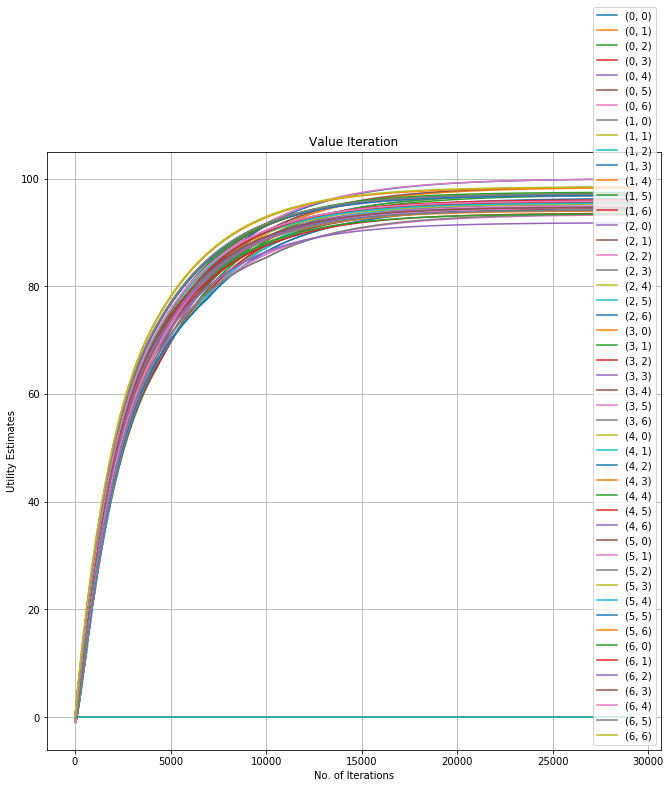

In [11]:
x = [i for i in range(num_iter)]

fig, ax = plt.subplots()
ax.plot(x, hist_0_0)
ax.plot(x, hist_0_1)
ax.plot(x, hist_0_2)
ax.plot(x, hist_0_3)
ax.plot(x, hist_0_4)
ax.plot(x, hist_0_5)
ax.plot(x, hist_0_6)

ax.plot(x, hist_1_0)
ax.plot(x, hist_1_1)
ax.plot(x, hist_1_2)
ax.plot(x, hist_1_3)
ax.plot(x, hist_1_4)
ax.plot(x, hist_1_5)
ax.plot(x, hist_1_6)

ax.plot(x, hist_2_0)
ax.plot(x, hist_2_1)
ax.plot(x, hist_2_2)
ax.plot(x, hist_2_3)
ax.plot(x, hist_2_4)
ax.plot(x, hist_2_5)
ax.plot(x, hist_2_6)

ax.plot(x, hist_3_0)
ax.plot(x, hist_3_1)
ax.plot(x, hist_3_2)
ax.plot(x, hist_3_3)
ax.plot(x, hist_3_4)
ax.plot(x, hist_3_5)
ax.plot(x, hist_3_6)

ax.plot(x, hist_4_0)
ax.plot(x, hist_4_1)
ax.plot(x, hist_4_2)
ax.plot(x, hist_4_3)
ax.plot(x, hist_4_4)
ax.plot(x, hist_4_5)
ax.plot(x, hist_4_6)

ax.plot(x, hist_5_0)
ax.plot(x, hist_5_1)
ax.plot(x, hist_5_2)
ax.plot(x, hist_5_3)
ax.plot(x, hist_5_4)
ax.plot(x, hist_5_5)
ax.plot(x, hist_5_6)

ax.plot(x, hist_6_0)
ax.plot(x, hist_6_1)
ax.plot(x, hist_6_2)
ax.plot(x, hist_6_3)
ax.plot(x, hist_6_4)
ax.plot(x, hist_6_5)
ax.plot(x, hist_6_6)

plt.legend(list_of_tuples, loc ="lower right")

ax.set(xlabel='No. of Iterations', ylabel='Utility Estimates', title='Value Iteration')
ax.grid()

fig.savefig("p2-e2-valueIter.png")
plt.show()

### Policy Iteration

In [12]:
SMALL_ENOUGH = 10e-4
GAMMA = 0.99
ALL_POSSIBLE_ACTIONS = ('U', 'D', 'L', 'R')

In [13]:
if __name__ == '__main__':
    
    grid = negative_grid()
    policy = {}
    
    for s in grid.actions.keys():
        policy[s] = np.random.choice(ALL_POSSIBLE_ACTIONS)
        
    hist = []
    
    V = {}
    states = grid.all_states()
    
    for s in states: 
        V[s] = 0
        
        if s in grid.actions:
            V[s] = 0
        
        else:
            V[s] = 0
            
    iter_no = 0
    
    while True:
        iter_no = iter_no + 1
        print("Iteration " + str(iter_no) + " :: ")
        
        # policy evaluation 
        while True:
            biggest_change = 0
            for s in states:
                old_v = V[s]
                
                if s in policy:
                    a = policy[s]
                    grid.set_state(s)
                    
                    try:
                        r = grid.move(a)
                    
                    except KeyError:
                        continue
                    
                    grid.set_state(s)
                    r = grid.rewards.get(grid.current_state(), 0)
                    _ = grid.move(a)
                    v_correct = V[grid.current_state()]
                    grid.set_state(s)
                    
                    if a == 'U':
                        r_clockwise = grid.move('R')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('L')
                    
                    elif a == 'R':
                        r_clockwise = grid.move('D')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('U')
                    
                    elif a == 'D':
                        r_clockwise = grid.move('L')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('R')
                    
                    elif a == 'L':
                        r_clockwise = grid.move('U')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('D')
                        
                    v_anticlockwise = V[grid.current_state()]
                    v = r + GAMMA * (0.8*v_correct + 0.1*v_clockwise + 0.1*v_anticlockwise)
                    V[s] = v
                    biggest_change = max(biggest_change, np.abs(old_v - V[s]))
                    
            if biggest_change < SMALL_ENOUGH:
                break
        
        print('Utilities:')
        print_values(True, V, grid)
        print('\n')
        
        #policy improvement
        is_policy_converged = True
        
        for s in states:
            
            if s in policy:
                old_a = policy[s]
                new_a = None
                best_value = float('-inf')
                
                for a in ALL_POSSIBLE_ACTIONS:
                    grid.set_state(s)
                    
                    try:
                        r = grid.move(a)
                        
                    except KeyError:
                        continue
                    
                    grid.set_state(s)
                    r = grid.rewards.get(grid.current_state(), 0)
                    _ = grid.move(a)
                    v_correct = V[grid.current_state()]
                    grid.set_state(s)
                    
                    if a == 'U':
                        r_clockwise = grid.move('R')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('L')
                    
                    elif a == 'R':
                        r_clockwise = grid.move('D')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('U')
                    
                    elif a == 'D':
                        r_clockwise = grid.move('L')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('R')
                    
                    elif a == 'L':
                        r_clockwise = grid.move('U')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('D')
                        
                    v_anticlockwise = V[grid.current_state()]  
                    v = r + GAMMA * (0.8*v_correct + 0.1*v_clockwise + 0.1*v_anticlockwise)
                    
                    if v > best_value:
                        best_value = v
                        new_a = a
            
            policy[s] = new_a
            
            if new_a != old_a:
                is_policy_converged = False
        
        if is_policy_converged:
            break
            
    print('Optimal Utilities:')
    print_values(True, V, grid)
    print('\n')
    print('Optimal Policy:')
    print_policy(policy, grid)
    print('\n')

Iteration 1 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+------------+
 99.90168  |   0.00000  |  11.38163  |   8.91414  |   9.83166  |  10.00632  |  10.12179  | 
+----------+------------+------------+------------+------------+------------+------------+
 44.37066  |   0.40016  |   2.43038  |   2.87858  |   0.00000  |  -0.00759  |   1.04328  | 
+----------+------------+------------+------------+------------+------------+------------+
 -6.27046  |  -5.70013  |  -9.45698  |  -9.38149  |   0.37995  |   0.07884  |   0.88134  | 
+----------+------------+------------+------------+------------+------------+------------+
 -6.37042  |  -7.40944  |  -8.79279  |  -10.66018 |  -13.73280 |  -10.03040 |  -0.37181  | 
+----------+------------+------------+------------+------------+------------+------------+
  5.23131  |   0.00000  |   0.00000  |   0.00000  |  -14.70257 |  -1.63454  |  -0.55083  | 
+----------+------------+------------+------------+-------

### Plot of utility estimates as a function of the number of iterations

In [14]:
num_iter = int(len(hist)/49)
print('Number of Iterations: ' + str(num_iter + 1))

Number of Iterations: 10


In [15]:
hist_0_0 = []
hist_0_1 = []
hist_0_2 = []
hist_0_3 = [] 
hist_0_4 = [] 
hist_0_5 = []
hist_0_6 = []

hist_1_0 = []
hist_1_1 = [] 
hist_1_2 = []
hist_1_3 = [] 
hist_1_4 = [] 
hist_1_5 = []
hist_1_6 = []

hist_2_0 = []
hist_2_1 = []
hist_2_2 = []
hist_2_3 = []
hist_2_4 = []
hist_2_5 = []
hist_2_6 = []

hist_3_0 = []
hist_3_1 = []
hist_3_2 = []
hist_3_3 = []
hist_3_4 = []
hist_3_5 = []
hist_3_6 = []

hist_4_0 = []
hist_4_1 = []
hist_4_2 = []
hist_4_3 = []
hist_4_4 = []
hist_4_5 = []
hist_4_6 = []

hist_5_0 = []
hist_5_1 = []
hist_5_2 = []
hist_5_3 = []
hist_5_4 = []
hist_5_5 = []
hist_5_6 = []

hist_6_0 = []
hist_6_1 = []
hist_6_2 = []
hist_6_3 = []
hist_6_4 = []
hist_6_5 = []
hist_6_6 = []

for i in range(num_iter):
    hist_0_0.append(hist[0+i*49])
    hist_1_0.append(hist[1+i*49])
    hist_2_0.append(hist[2+i*49])
    hist_3_0.append(hist[3+i*49]) 
    hist_4_0.append(hist[4+i*49])
    hist_5_0.append(hist[5+i*49]) 
    hist_6_0.append(hist[6+i*49]) 

    hist_0_1.append(hist[7+i*49])
    hist_1_1.append(hist[8+i*49]) 
    hist_2_1.append(hist[9+i*49]) 
    hist_3_1.append(hist[10+i*49]) 
    hist_4_1.append(hist[11+i*49]) 
    hist_5_1.append(hist[12+i*49]) 
    hist_6_1.append(hist[13+i*49]) 
    
    hist_0_2.append(hist[14+i*49])
    hist_1_2.append(hist[15+i*49]) 
    hist_2_2.append(hist[16+i*49])
    hist_3_2.append(hist[17+i*49])
    hist_4_2.append(hist[18+i*49])
    hist_5_2.append(hist[19+i*49])
    hist_6_2.append(hist[20+i*49])
    
    hist_0_3.append(hist[21+i*49])
    hist_1_3.append(hist[22+i*49]) 
    hist_2_3.append(hist[23+i*49])
    hist_3_3.append(hist[24+i*49])
    hist_4_3.append(hist[25+i*49])
    hist_5_3.append(hist[26+i*49])
    hist_6_3.append(hist[27+i*49])
    
    hist_0_4.append(hist[28+i*49])
    hist_1_4.append(hist[29+i*49]) 
    hist_2_4.append(hist[30+i*49])
    hist_3_4.append(hist[31+i*49])
    hist_4_4.append(hist[32+i*49])
    hist_5_4.append(hist[33+i*49])
    hist_6_4.append(hist[34+i*49])
    
    hist_0_5.append(hist[35+i*49])
    hist_1_5.append(hist[36+i*49]) 
    hist_2_5.append(hist[37+i*49])
    hist_3_5.append(hist[38+i*49])
    hist_4_5.append(hist[39+i*49])
    hist_5_5.append(hist[40+i*49])
    hist_6_5.append(hist[41+i*49])
    
    hist_0_6.append(hist[42+i*49])
    hist_1_6.append(hist[43+i*49]) 
    hist_2_6.append(hist[44+i*49])
    hist_3_6.append(hist[45+i*49])
    hist_4_6.append(hist[46+i*49])
    hist_5_6.append(hist[47+i*49])
    hist_6_6.append(hist[48+i*49])

In [16]:
list_of_tuples = [str((i,j)) for i in range(7) for j in range (7)]

In [17]:
from matplotlib.pyplot import figure

plt.rcParams["figure.figsize"]=11,11

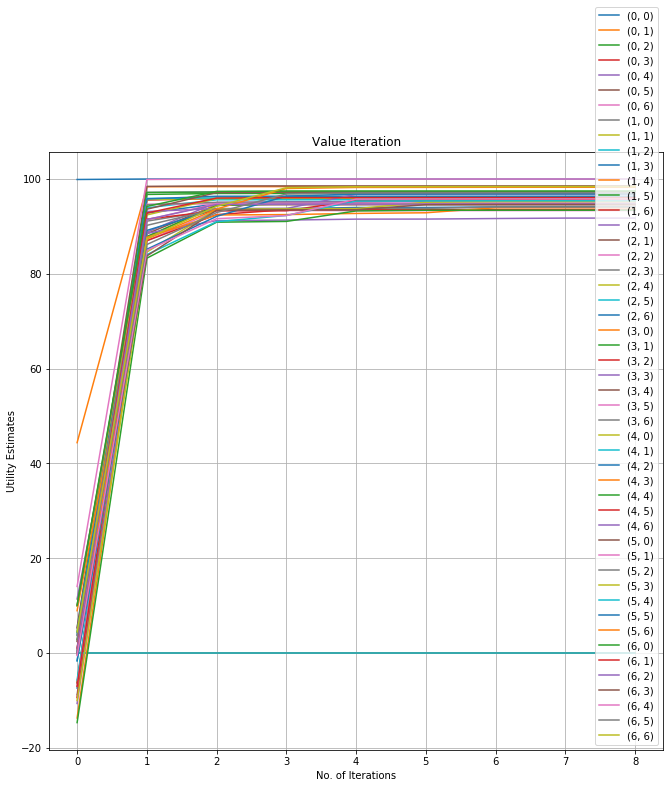

In [18]:
x = [i for i in range(num_iter)]

fig, ax = plt.subplots()
ax.plot(x, hist_0_0)
ax.plot(x, hist_0_1)
ax.plot(x, hist_0_2)
ax.plot(x, hist_0_3)
ax.plot(x, hist_0_4)
ax.plot(x, hist_0_5)
ax.plot(x, hist_0_6)

ax.plot(x, hist_1_0)
ax.plot(x, hist_1_1)
ax.plot(x, hist_1_2)
ax.plot(x, hist_1_3)
ax.plot(x, hist_1_4)
ax.plot(x, hist_1_5)
ax.plot(x, hist_1_6)

ax.plot(x, hist_2_0)
ax.plot(x, hist_2_1)
ax.plot(x, hist_2_2)
ax.plot(x, hist_2_3)
ax.plot(x, hist_2_4)
ax.plot(x, hist_2_5)
ax.plot(x, hist_2_6)

ax.plot(x, hist_3_0)
ax.plot(x, hist_3_1)
ax.plot(x, hist_3_2)
ax.plot(x, hist_3_3)
ax.plot(x, hist_3_4)
ax.plot(x, hist_3_5)
ax.plot(x, hist_3_6)

ax.plot(x, hist_4_0)
ax.plot(x, hist_4_1)
ax.plot(x, hist_4_2)
ax.plot(x, hist_4_3)
ax.plot(x, hist_4_4)
ax.plot(x, hist_4_5)
ax.plot(x, hist_4_6)

ax.plot(x, hist_5_0)
ax.plot(x, hist_5_1)
ax.plot(x, hist_5_2)
ax.plot(x, hist_5_3)
ax.plot(x, hist_5_4)
ax.plot(x, hist_5_5)
ax.plot(x, hist_5_6)

ax.plot(x, hist_6_0)
ax.plot(x, hist_6_1)
ax.plot(x, hist_6_2)
ax.plot(x, hist_6_3)
ax.plot(x, hist_6_4)
ax.plot(x, hist_6_5)
ax.plot(x, hist_6_6)

plt.legend(list_of_tuples, loc ="lower right")

ax.set(xlabel='No. of Iterations', ylabel='Utility Estimates', title='Value Iteration')
ax.grid()

fig.savefig("p2-e2-policyIter.png")
plt.show()